In [1]:
#Import tensorflow

import tensorflow as tf
tf.compat.v1.disable_v2_behavior()
gpu_devices = tf.config.experimental.list_physical_devices("GPU")
for device in gpu_devices:
    tf.config.experimental.set_memory_growth(device, True)

Instructions for updating:
non-resource variables are not supported in the long term


In [2]:
#Test if GPU is found

if tf.test.gpu_device_name():
    print('GPU found')
else:
    print("No GPU found")

GPU found


In [3]:
#Autosaving every 10s

%autosave 10

Autosaving every 10 seconds


In [4]:
#Training & Testing files

xtrain_file = "xtrain.csv"
ytrain_file = "ytrain.csv"
xval_file = "xval.csv"
yval_file = "yval.csv"
xtest_file = "xtest.csv"
ytest_file = "ytest.csv"

In [5]:
import pandas as pd
import numpy as np
import scipy.io
import tensorflow_probability as tfp
import matplotlib as plt
import matplotlib.pyplot as plt
import pickle
import scipy.io as spio
import pickle
from tensorflow.keras import optimizers, regularizers
from tensorflow.keras.models import Sequential, model_from_json, load_model
from tensorflow.keras.layers import Dense, LSTM, Dropout, Masking
tfd = tfp.distributions

In [6]:
# fix random seed for reproducibility

np.random.seed(0)

In [7]:
#load Training & Testing files into Pandas Dataframes

xtrain = pd.read_csv(xtrain_file, index_col=False)
ytrain = pd.read_csv(ytrain_file, index_col=False)
xval = pd.read_csv(xval_file, index_col=False)
yval = pd.read_csv(yval_file, index_col=False)
xtest = pd.read_csv(xtest_file, index_col=False)
ytest = pd.read_csv(ytest_file, index_col=False)

In [8]:
#Load Hyperparameters Obtained by BayesOpt

matlab_file = 'T4.mat'
mat = spio.loadmat(matlab_file, squeeze_me=True)
lr = mat['lr']
ep = mat['ep']
epochs = mat['epochs']
batch = mat['batch']
L2 = mat['L2'] 
unit1 = mat['unit'] 
size1 = mat['size']
drop1 = mat['drop']

C:\Users\Asus\anaconda3\lib\site-packages\scipy\io\matlab\mio.py:218: MatReadWarning: Duplicate variable name "None" in stream - replacing previous with new
Consider mio5.varmats_from_mat to split file into single variable files
  matfile_dict = MR.get_variables(variable_names)


In [9]:
#Xtrain to Numpy multidimensional array

xtrain = xtrain.to_numpy()
xtrain = xtrain.reshape(278,24,4)

In [10]:
#Ytrain to Numpy multidimensional array

ytrain = ytrain.to_numpy()
ytrain = ytrain.reshape(278,24,1)

In [11]:
#Xval to Numpy multidimensional array

xval = xval.to_numpy()
xval = xval.reshape(34,24,4)

In [12]:
#Yval to Numpy multidimensional array

yval = yval.to_numpy()
yval = yval.reshape(34,24,1)

In [13]:
#Xtest to Numpy multidimensional array

xtest = xtest.to_numpy()
xtest = xtest.reshape(34,24,4)

In [14]:
#Ground truth to Numpy multidimensional array

ytest = ytest.to_numpy()
ytest = ytest.reshape(34,24,1)

In [15]:
#Ytrain2 to Numpy multidimensional array - for SHAP

ytrain2 = np.zeros((278,1))
for i in range(278):
    ytrain2[i] =  ytrain[i][0]
    
ytrain2=ytrain2.reshape(278,)

In [16]:
#Yval2 to Numpy multidimensional array - for SHAP

yval2 = np.zeros((34,1))
for i in range(34):
    yval2[i] =  yval[i][0]
    
yval2 =yval2.reshape(34,)

In [17]:
#Set ytrain, yval for 3 outputs

x_train = xtrain
y_train = [ytrain,ytrain,ytrain2]
x_val = xval
y_val = [yval,yval,yval2]
x_test = xtest

In [18]:
import sklearn
import math
from tensorflow.keras import layers
from tensorflow.keras import activations
from tensorflow.keras import callbacks
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, Callback,ReduceLROnPlateau
from tensorflow.keras.layers import Flatten, Reshape
import warnings
from tensorflow.keras import backend as K
from tensorflow.keras.layers import Input, Lambda, concatenate
from tensorflow.keras.models import Model
from IPython.display import display
from sklearn import metrics

In [19]:
#Define trainable prior

def posterior_mean_field(kernel_size, bias_size=0, dtype=None):
  n = kernel_size + bias_size
  c = np.log(np.expm1(1.))
  return tf.keras.Sequential([
      tfp.layers.VariableLayer(2 * n, dtype=dtype),
      tfp.layers.DistributionLambda(lambda t: tfd.Independent(
          tfd.Normal(loc=t[..., :n],
                     scale=1e-5 + tf.nn.softplus(c + t[..., n:])),
          reinterpreted_batch_ndims=1)),
  ])

# Specify the prior over `keras.layers.Dense` `kernel` and `bias`.
def prior_trainable(kernel_size, bias_size=0, dtype=None):
  n = kernel_size + bias_size
  return tf.keras.Sequential([
      tfp.layers.VariableLayer(n, dtype=dtype),
      tfp.layers.DistributionLambda(lambda t: tfd.Independent(
          tfd.Normal(loc=t, scale=1),
          reinterpreted_batch_ndims=1)),
  ])

In [20]:
#Define probabilistic LSTM

#LSTM layers

inputs = tf.keras.Input(shape=(24,4),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)

#Output 1 = Aleatoric output layer

layer3 = Dense(1+1)(layer2)
layer4 = tfp.layers.DistributionLambda(lambda t: tfd.Normal(loc=t[..., :1],scale=1e-3 + tf.math.softplus(0.05 * t[..., 1:])),name='out1')(layer3) #aleatoric

#Output 2 = Epistemic output layer

layer5 = tfp.layers.DenseVariational(1, posterior_mean_field, prior_trainable)(layer2)
layer6 = tfp.layers.DistributionLambda(lambda t: tfd.Normal(loc=t, scale=1),name = 'out2')(layer5)

#Output 3 = Slicer output layer

layer7 = Dense(1)(layer2)
layer8 = Lambda(lambda t: t[:,-1],name='out3')(layer7)


model = tf.keras.Model(inputs=inputs, outputs=[layer4,layer6,layer8])
model.summary()

Model: "functional_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 24, 4)]      0                                            
__________________________________________________________________________________________________
lstm (LSTM)                     (None, 24, 972)      3798576     input_1[0][0]                    
__________________________________________________________________________________________________
dense (Dense)                   (None, 24, 377)      366821      lstm[0][0]                       
__________________________________________________________________________________________________
dense_1 (Dense)                 (None, 24, 2)        756         dense[0][0]                      
_______________________________________________________________________________________

In [21]:
#Define directory for best weights checkpoint

import os
checkpoint_path = "C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/Gas Turbine & Turbofan AD & PROGNOS/Real Gas Turbine/LSTM-T4_2/model checkpoint/T4_ckpt"
checkpoint_dir = os.path.dirname(checkpoint_path)

#Callback for best weights checkpoint

model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_path,
    save_weights_only=True,
    monitor='val_loss',
    mode='min',
    save_best_only=True,
    verbose = 1)

In [22]:
#Compile model

optimizers.Adam(learning_rate=lr, beta_1 = 0.9,beta_2 = 0.999, epsilon = ep, amsgrad = False, name = "Adam")
negloglik = lambda y, rv_y: -rv_y.log_prob(y)
model.compile(loss = {'out1': negloglik,'out2': negloglik,'out3':'mean_squared_error'},loss_weights=[0.5,0.5,0],optimizer= 'Adam')

In [23]:
#Set Tensorboard  

%load_ext tensorboard
import tensorboard
tensorboard.__version__
from datetime import datetime
from tensorflow import keras
# Define the Keras TensorBoard callback.
logdir="logs/fit/" + datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = keras.callbacks.TensorBoard(log_dir=logdir)

In [24]:
# Run training

history = model.fit(x_train, y_train, validation_data = (x_val, y_val), epochs = 10000, batch_size  = batch, verbose = 0, callbacks=[model_checkpoint_callback,tensorboard_callback])

Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.

Epoch 00001: val_loss improved from inf to 152626.09375, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/T4_3/model checkpoint\T4_ckpt

Epoch 00002: val_loss improved from 152626.09375 to 129672.33594, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/T4_3/model checkpoint\T4_ckpt

Epoch 00003: val_loss did not improve from 129672.33594

Epoch 00004: val_loss improved from 129672.33594 to 103209.01562, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/T4_3/model checkpoint\T4_ckpt

Epoch 00005: val_loss did not improve from 103209.01562

Epoch 00006: val_loss did not improve from 103209.01562

Epoch 00007: val_loss improved from 103209.01562 to 89047.27344, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/T4_3/model checkpoint\T4_ckpt

Epoch


Epoch 00100: val_loss improved from 3322.74756 to 3219.96460, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/T4_3/model checkpoint\T4_ckpt

Epoch 00101: val_loss did not improve from 3219.96460

Epoch 00102: val_loss did not improve from 3219.96460

Epoch 00103: val_loss did not improve from 3219.96460

Epoch 00104: val_loss did not improve from 3219.96460

Epoch 00105: val_loss did not improve from 3219.96460

Epoch 00106: val_loss did not improve from 3219.96460

Epoch 00107: val_loss did not improve from 3219.96460

Epoch 00108: val_loss did not improve from 3219.96460

Epoch 00109: val_loss did not improve from 3219.96460

Epoch 00110: val_loss did not improve from 3219.96460

Epoch 00111: val_loss did not improve from 3219.96460

Epoch 00112: val_loss did not improve from 3219.96460

Epoch 00113: val_loss did not improve from 3219.96460

Epoch 00114: val_loss did not improve from 3219.96460

Epoch 00115: val_loss did not improve from 3219.96460



Epoch 00224: val_loss did not improve from 844.10455

Epoch 00225: val_loss did not improve from 844.10455

Epoch 00226: val_loss did not improve from 844.10455

Epoch 00227: val_loss did not improve from 844.10455

Epoch 00228: val_loss did not improve from 844.10455

Epoch 00229: val_loss did not improve from 844.10455

Epoch 00230: val_loss did not improve from 844.10455

Epoch 00231: val_loss did not improve from 844.10455

Epoch 00232: val_loss did not improve from 844.10455

Epoch 00233: val_loss did not improve from 844.10455

Epoch 00234: val_loss did not improve from 844.10455

Epoch 00235: val_loss did not improve from 844.10455

Epoch 00236: val_loss did not improve from 844.10455

Epoch 00237: val_loss did not improve from 844.10455

Epoch 00238: val_loss did not improve from 844.10455

Epoch 00239: val_loss did not improve from 844.10455

Epoch 00240: val_loss did not improve from 844.10455

Epoch 00241: val_loss did not improve from 844.10455

Epoch 00242: val_loss did n


Epoch 00367: val_loss did not improve from 66.29479

Epoch 00368: val_loss did not improve from 66.29479

Epoch 00369: val_loss did not improve from 66.29479

Epoch 00370: val_loss did not improve from 66.29479

Epoch 00371: val_loss did not improve from 66.29479

Epoch 00372: val_loss did not improve from 66.29479

Epoch 00373: val_loss did not improve from 66.29479

Epoch 00374: val_loss did not improve from 66.29479

Epoch 00375: val_loss did not improve from 66.29479

Epoch 00376: val_loss did not improve from 66.29479

Epoch 00377: val_loss did not improve from 66.29479

Epoch 00378: val_loss did not improve from 66.29479

Epoch 00379: val_loss did not improve from 66.29479

Epoch 00380: val_loss improved from 66.29479 to 54.71072, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/T4_3/model checkpoint\T4_ckpt

Epoch 00381: val_loss did not improve from 54.71072

Epoch 00382: val_loss did not improve from 54.71072

Epoch 00383: val_loss did not imp


Epoch 00520: val_loss did not improve from 54.71072

Epoch 00521: val_loss did not improve from 54.71072

Epoch 00522: val_loss did not improve from 54.71072

Epoch 00523: val_loss did not improve from 54.71072

Epoch 00524: val_loss did not improve from 54.71072

Epoch 00525: val_loss did not improve from 54.71072

Epoch 00526: val_loss did not improve from 54.71072

Epoch 00527: val_loss did not improve from 54.71072

Epoch 00528: val_loss did not improve from 54.71072

Epoch 00529: val_loss did not improve from 54.71072

Epoch 00530: val_loss did not improve from 54.71072

Epoch 00531: val_loss did not improve from 54.71072

Epoch 00532: val_loss did not improve from 54.71072

Epoch 00533: val_loss did not improve from 54.71072

Epoch 00534: val_loss did not improve from 54.71072

Epoch 00535: val_loss did not improve from 54.71072

Epoch 00536: val_loss did not improve from 54.71072

Epoch 00537: val_loss did not improve from 54.71072

Epoch 00538: val_loss did not improve from 54


Epoch 00675: val_loss did not improve from 54.71072

Epoch 00676: val_loss did not improve from 54.71072

Epoch 00677: val_loss did not improve from 54.71072

Epoch 00678: val_loss did not improve from 54.71072

Epoch 00679: val_loss did not improve from 54.71072

Epoch 00680: val_loss did not improve from 54.71072

Epoch 00681: val_loss did not improve from 54.71072

Epoch 00682: val_loss did not improve from 54.71072

Epoch 00683: val_loss did not improve from 54.71072

Epoch 00684: val_loss did not improve from 54.71072

Epoch 00685: val_loss did not improve from 54.71072

Epoch 00686: val_loss did not improve from 54.71072

Epoch 00687: val_loss did not improve from 54.71072

Epoch 00688: val_loss did not improve from 54.71072

Epoch 00689: val_loss did not improve from 54.71072

Epoch 00690: val_loss did not improve from 54.71072

Epoch 00691: val_loss did not improve from 54.71072

Epoch 00692: val_loss did not improve from 54.71072

Epoch 00693: val_loss did not improve from 54


Epoch 00830: val_loss did not improve from 54.71072

Epoch 00831: val_loss did not improve from 54.71072

Epoch 00832: val_loss did not improve from 54.71072

Epoch 00833: val_loss did not improve from 54.71072

Epoch 00834: val_loss did not improve from 54.71072

Epoch 00835: val_loss did not improve from 54.71072

Epoch 00836: val_loss did not improve from 54.71072

Epoch 00837: val_loss did not improve from 54.71072

Epoch 00838: val_loss did not improve from 54.71072

Epoch 00839: val_loss did not improve from 54.71072

Epoch 00840: val_loss did not improve from 54.71072

Epoch 00841: val_loss did not improve from 54.71072

Epoch 00842: val_loss did not improve from 54.71072

Epoch 00843: val_loss did not improve from 54.71072

Epoch 00844: val_loss did not improve from 54.71072

Epoch 00845: val_loss did not improve from 54.71072

Epoch 00846: val_loss did not improve from 54.71072

Epoch 00847: val_loss did not improve from 54.71072

Epoch 00848: val_loss did not improve from 54


Epoch 00985: val_loss did not improve from 54.71072

Epoch 00986: val_loss did not improve from 54.71072

Epoch 00987: val_loss did not improve from 54.71072

Epoch 00988: val_loss did not improve from 54.71072

Epoch 00989: val_loss did not improve from 54.71072

Epoch 00990: val_loss did not improve from 54.71072

Epoch 00991: val_loss did not improve from 54.71072

Epoch 00992: val_loss did not improve from 54.71072

Epoch 00993: val_loss did not improve from 54.71072

Epoch 00994: val_loss did not improve from 54.71072

Epoch 00995: val_loss did not improve from 54.71072

Epoch 00996: val_loss did not improve from 54.71072

Epoch 00997: val_loss did not improve from 54.71072

Epoch 00998: val_loss did not improve from 54.71072

Epoch 00999: val_loss did not improve from 54.71072

Epoch 01000: val_loss did not improve from 54.71072

Epoch 01001: val_loss did not improve from 54.71072

Epoch 01002: val_loss did not improve from 54.71072

Epoch 01003: val_loss did not improve from 54


Epoch 01140: val_loss did not improve from 54.71072

Epoch 01141: val_loss did not improve from 54.71072

Epoch 01142: val_loss did not improve from 54.71072

Epoch 01143: val_loss did not improve from 54.71072

Epoch 01144: val_loss did not improve from 54.71072

Epoch 01145: val_loss did not improve from 54.71072

Epoch 01146: val_loss did not improve from 54.71072

Epoch 01147: val_loss did not improve from 54.71072

Epoch 01148: val_loss did not improve from 54.71072

Epoch 01149: val_loss did not improve from 54.71072

Epoch 01150: val_loss did not improve from 54.71072

Epoch 01151: val_loss did not improve from 54.71072

Epoch 01152: val_loss did not improve from 54.71072

Epoch 01153: val_loss did not improve from 54.71072

Epoch 01154: val_loss did not improve from 54.71072

Epoch 01155: val_loss did not improve from 54.71072

Epoch 01156: val_loss did not improve from 54.71072

Epoch 01157: val_loss did not improve from 54.71072

Epoch 01158: val_loss did not improve from 54


Epoch 01295: val_loss did not improve from 54.71072

Epoch 01296: val_loss did not improve from 54.71072

Epoch 01297: val_loss did not improve from 54.71072

Epoch 01298: val_loss did not improve from 54.71072

Epoch 01299: val_loss did not improve from 54.71072

Epoch 01300: val_loss did not improve from 54.71072

Epoch 01301: val_loss did not improve from 54.71072

Epoch 01302: val_loss did not improve from 54.71072

Epoch 01303: val_loss did not improve from 54.71072

Epoch 01304: val_loss did not improve from 54.71072

Epoch 01305: val_loss did not improve from 54.71072

Epoch 01306: val_loss did not improve from 54.71072

Epoch 01307: val_loss did not improve from 54.71072

Epoch 01308: val_loss did not improve from 54.71072

Epoch 01309: val_loss did not improve from 54.71072

Epoch 01310: val_loss did not improve from 54.71072

Epoch 01311: val_loss did not improve from 54.71072

Epoch 01312: val_loss did not improve from 54.71072

Epoch 01313: val_loss did not improve from 54


Epoch 01450: val_loss did not improve from 54.71072

Epoch 01451: val_loss did not improve from 54.71072

Epoch 01452: val_loss did not improve from 54.71072

Epoch 01453: val_loss did not improve from 54.71072

Epoch 01454: val_loss did not improve from 54.71072

Epoch 01455: val_loss did not improve from 54.71072

Epoch 01456: val_loss did not improve from 54.71072

Epoch 01457: val_loss did not improve from 54.71072

Epoch 01458: val_loss did not improve from 54.71072

Epoch 01459: val_loss did not improve from 54.71072

Epoch 01460: val_loss did not improve from 54.71072

Epoch 01461: val_loss did not improve from 54.71072

Epoch 01462: val_loss did not improve from 54.71072

Epoch 01463: val_loss did not improve from 54.71072

Epoch 01464: val_loss did not improve from 54.71072

Epoch 01465: val_loss did not improve from 54.71072

Epoch 01466: val_loss did not improve from 54.71072

Epoch 01467: val_loss did not improve from 54.71072

Epoch 01468: val_loss did not improve from 54


Epoch 01605: val_loss did not improve from 54.71072

Epoch 01606: val_loss did not improve from 54.71072

Epoch 01607: val_loss did not improve from 54.71072

Epoch 01608: val_loss did not improve from 54.71072

Epoch 01609: val_loss did not improve from 54.71072

Epoch 01610: val_loss did not improve from 54.71072

Epoch 01611: val_loss did not improve from 54.71072

Epoch 01612: val_loss did not improve from 54.71072

Epoch 01613: val_loss did not improve from 54.71072

Epoch 01614: val_loss did not improve from 54.71072

Epoch 01615: val_loss did not improve from 54.71072

Epoch 01616: val_loss did not improve from 54.71072

Epoch 01617: val_loss did not improve from 54.71072

Epoch 01618: val_loss did not improve from 54.71072

Epoch 01619: val_loss did not improve from 54.71072

Epoch 01620: val_loss did not improve from 54.71072

Epoch 01621: val_loss did not improve from 54.71072

Epoch 01622: val_loss did not improve from 54.71072

Epoch 01623: val_loss did not improve from 54


Epoch 01760: val_loss did not improve from 54.71072

Epoch 01761: val_loss did not improve from 54.71072

Epoch 01762: val_loss did not improve from 54.71072

Epoch 01763: val_loss did not improve from 54.71072

Epoch 01764: val_loss did not improve from 54.71072

Epoch 01765: val_loss did not improve from 54.71072

Epoch 01766: val_loss did not improve from 54.71072

Epoch 01767: val_loss did not improve from 54.71072

Epoch 01768: val_loss did not improve from 54.71072

Epoch 01769: val_loss did not improve from 54.71072

Epoch 01770: val_loss did not improve from 54.71072

Epoch 01771: val_loss did not improve from 54.71072

Epoch 01772: val_loss did not improve from 54.71072

Epoch 01773: val_loss did not improve from 54.71072

Epoch 01774: val_loss did not improve from 54.71072

Epoch 01775: val_loss did not improve from 54.71072

Epoch 01776: val_loss did not improve from 54.71072

Epoch 01777: val_loss did not improve from 54.71072

Epoch 01778: val_loss did not improve from 54


Epoch 01915: val_loss did not improve from 54.71072

Epoch 01916: val_loss did not improve from 54.71072

Epoch 01917: val_loss did not improve from 54.71072

Epoch 01918: val_loss did not improve from 54.71072

Epoch 01919: val_loss did not improve from 54.71072

Epoch 01920: val_loss did not improve from 54.71072

Epoch 01921: val_loss did not improve from 54.71072

Epoch 01922: val_loss did not improve from 54.71072

Epoch 01923: val_loss did not improve from 54.71072

Epoch 01924: val_loss did not improve from 54.71072

Epoch 01925: val_loss did not improve from 54.71072

Epoch 01926: val_loss did not improve from 54.71072

Epoch 01927: val_loss did not improve from 54.71072

Epoch 01928: val_loss did not improve from 54.71072

Epoch 01929: val_loss did not improve from 54.71072

Epoch 01930: val_loss did not improve from 54.71072

Epoch 01931: val_loss did not improve from 54.71072

Epoch 01932: val_loss did not improve from 54.71072

Epoch 01933: val_loss did not improve from 54


Epoch 02070: val_loss did not improve from 54.71072

Epoch 02071: val_loss did not improve from 54.71072

Epoch 02072: val_loss did not improve from 54.71072

Epoch 02073: val_loss did not improve from 54.71072

Epoch 02074: val_loss did not improve from 54.71072

Epoch 02075: val_loss did not improve from 54.71072

Epoch 02076: val_loss did not improve from 54.71072

Epoch 02077: val_loss did not improve from 54.71072

Epoch 02078: val_loss did not improve from 54.71072

Epoch 02079: val_loss did not improve from 54.71072

Epoch 02080: val_loss did not improve from 54.71072

Epoch 02081: val_loss did not improve from 54.71072

Epoch 02082: val_loss did not improve from 54.71072

Epoch 02083: val_loss did not improve from 54.71072

Epoch 02084: val_loss did not improve from 54.71072

Epoch 02085: val_loss did not improve from 54.71072

Epoch 02086: val_loss did not improve from 54.71072

Epoch 02087: val_loss did not improve from 54.71072

Epoch 02088: val_loss did not improve from 54


Epoch 02225: val_loss did not improve from 54.71072

Epoch 02226: val_loss did not improve from 54.71072

Epoch 02227: val_loss did not improve from 54.71072

Epoch 02228: val_loss did not improve from 54.71072

Epoch 02229: val_loss did not improve from 54.71072

Epoch 02230: val_loss did not improve from 54.71072

Epoch 02231: val_loss did not improve from 54.71072

Epoch 02232: val_loss did not improve from 54.71072

Epoch 02233: val_loss did not improve from 54.71072

Epoch 02234: val_loss did not improve from 54.71072

Epoch 02235: val_loss did not improve from 54.71072

Epoch 02236: val_loss did not improve from 54.71072

Epoch 02237: val_loss did not improve from 54.71072

Epoch 02238: val_loss did not improve from 54.71072

Epoch 02239: val_loss did not improve from 54.71072

Epoch 02240: val_loss did not improve from 54.71072

Epoch 02241: val_loss did not improve from 54.71072

Epoch 02242: val_loss did not improve from 54.71072

Epoch 02243: val_loss did not improve from 54


Epoch 02380: val_loss did not improve from 54.71072

Epoch 02381: val_loss did not improve from 54.71072

Epoch 02382: val_loss did not improve from 54.71072

Epoch 02383: val_loss did not improve from 54.71072

Epoch 02384: val_loss did not improve from 54.71072

Epoch 02385: val_loss did not improve from 54.71072

Epoch 02386: val_loss did not improve from 54.71072

Epoch 02387: val_loss did not improve from 54.71072

Epoch 02388: val_loss did not improve from 54.71072

Epoch 02389: val_loss did not improve from 54.71072

Epoch 02390: val_loss did not improve from 54.71072

Epoch 02391: val_loss did not improve from 54.71072

Epoch 02392: val_loss did not improve from 54.71072

Epoch 02393: val_loss did not improve from 54.71072

Epoch 02394: val_loss did not improve from 54.71072

Epoch 02395: val_loss did not improve from 54.71072

Epoch 02396: val_loss did not improve from 54.71072

Epoch 02397: val_loss did not improve from 54.71072

Epoch 02398: val_loss did not improve from 54


Epoch 02535: val_loss did not improve from 54.71072

Epoch 02536: val_loss did not improve from 54.71072

Epoch 02537: val_loss did not improve from 54.71072

Epoch 02538: val_loss did not improve from 54.71072

Epoch 02539: val_loss did not improve from 54.71072

Epoch 02540: val_loss did not improve from 54.71072

Epoch 02541: val_loss did not improve from 54.71072

Epoch 02542: val_loss did not improve from 54.71072

Epoch 02543: val_loss did not improve from 54.71072

Epoch 02544: val_loss did not improve from 54.71072

Epoch 02545: val_loss did not improve from 54.71072

Epoch 02546: val_loss did not improve from 54.71072

Epoch 02547: val_loss did not improve from 54.71072

Epoch 02548: val_loss did not improve from 54.71072

Epoch 02549: val_loss did not improve from 54.71072

Epoch 02550: val_loss did not improve from 54.71072

Epoch 02551: val_loss did not improve from 54.71072

Epoch 02552: val_loss did not improve from 54.71072

Epoch 02553: val_loss did not improve from 54


Epoch 02690: val_loss did not improve from 54.71072

Epoch 02691: val_loss did not improve from 54.71072

Epoch 02692: val_loss did not improve from 54.71072

Epoch 02693: val_loss did not improve from 54.71072

Epoch 02694: val_loss did not improve from 54.71072

Epoch 02695: val_loss did not improve from 54.71072

Epoch 02696: val_loss did not improve from 54.71072

Epoch 02697: val_loss did not improve from 54.71072

Epoch 02698: val_loss did not improve from 54.71072

Epoch 02699: val_loss did not improve from 54.71072

Epoch 02700: val_loss did not improve from 54.71072

Epoch 02701: val_loss did not improve from 54.71072

Epoch 02702: val_loss did not improve from 54.71072

Epoch 02703: val_loss did not improve from 54.71072

Epoch 02704: val_loss did not improve from 54.71072

Epoch 02705: val_loss did not improve from 54.71072

Epoch 02706: val_loss did not improve from 54.71072

Epoch 02707: val_loss did not improve from 54.71072

Epoch 02708: val_loss did not improve from 54


Epoch 02845: val_loss did not improve from 54.71072

Epoch 02846: val_loss did not improve from 54.71072

Epoch 02847: val_loss did not improve from 54.71072

Epoch 02848: val_loss did not improve from 54.71072

Epoch 02849: val_loss did not improve from 54.71072

Epoch 02850: val_loss did not improve from 54.71072

Epoch 02851: val_loss did not improve from 54.71072

Epoch 02852: val_loss did not improve from 54.71072

Epoch 02853: val_loss did not improve from 54.71072

Epoch 02854: val_loss did not improve from 54.71072

Epoch 02855: val_loss did not improve from 54.71072

Epoch 02856: val_loss did not improve from 54.71072

Epoch 02857: val_loss did not improve from 54.71072

Epoch 02858: val_loss did not improve from 54.71072

Epoch 02859: val_loss did not improve from 54.71072

Epoch 02860: val_loss did not improve from 54.71072

Epoch 02861: val_loss did not improve from 54.71072

Epoch 02862: val_loss did not improve from 54.71072

Epoch 02863: val_loss did not improve from 54


Epoch 03000: val_loss did not improve from 54.71072

Epoch 03001: val_loss did not improve from 54.71072

Epoch 03002: val_loss did not improve from 54.71072

Epoch 03003: val_loss did not improve from 54.71072

Epoch 03004: val_loss did not improve from 54.71072

Epoch 03005: val_loss did not improve from 54.71072

Epoch 03006: val_loss did not improve from 54.71072

Epoch 03007: val_loss did not improve from 54.71072

Epoch 03008: val_loss did not improve from 54.71072

Epoch 03009: val_loss did not improve from 54.71072

Epoch 03010: val_loss did not improve from 54.71072

Epoch 03011: val_loss did not improve from 54.71072

Epoch 03012: val_loss did not improve from 54.71072

Epoch 03013: val_loss did not improve from 54.71072

Epoch 03014: val_loss did not improve from 54.71072

Epoch 03015: val_loss did not improve from 54.71072

Epoch 03016: val_loss did not improve from 54.71072

Epoch 03017: val_loss did not improve from 54.71072

Epoch 03018: val_loss did not improve from 54


Epoch 03155: val_loss did not improve from 54.71072

Epoch 03156: val_loss did not improve from 54.71072

Epoch 03157: val_loss did not improve from 54.71072

Epoch 03158: val_loss did not improve from 54.71072

Epoch 03159: val_loss did not improve from 54.71072

Epoch 03160: val_loss did not improve from 54.71072

Epoch 03161: val_loss did not improve from 54.71072

Epoch 03162: val_loss did not improve from 54.71072

Epoch 03163: val_loss did not improve from 54.71072

Epoch 03164: val_loss did not improve from 54.71072

Epoch 03165: val_loss did not improve from 54.71072

Epoch 03166: val_loss did not improve from 54.71072

Epoch 03167: val_loss did not improve from 54.71072

Epoch 03168: val_loss did not improve from 54.71072

Epoch 03169: val_loss did not improve from 54.71072

Epoch 03170: val_loss did not improve from 54.71072

Epoch 03171: val_loss did not improve from 54.71072

Epoch 03172: val_loss did not improve from 54.71072

Epoch 03173: val_loss did not improve from 54


Epoch 03310: val_loss did not improve from 54.71072

Epoch 03311: val_loss did not improve from 54.71072

Epoch 03312: val_loss did not improve from 54.71072

Epoch 03313: val_loss did not improve from 54.71072

Epoch 03314: val_loss did not improve from 54.71072

Epoch 03315: val_loss did not improve from 54.71072

Epoch 03316: val_loss did not improve from 54.71072

Epoch 03317: val_loss did not improve from 54.71072

Epoch 03318: val_loss did not improve from 54.71072

Epoch 03319: val_loss did not improve from 54.71072

Epoch 03320: val_loss did not improve from 54.71072

Epoch 03321: val_loss did not improve from 54.71072

Epoch 03322: val_loss did not improve from 54.71072

Epoch 03323: val_loss did not improve from 54.71072

Epoch 03324: val_loss did not improve from 54.71072

Epoch 03325: val_loss did not improve from 54.71072

Epoch 03326: val_loss did not improve from 54.71072

Epoch 03327: val_loss did not improve from 54.71072

Epoch 03328: val_loss did not improve from 54


Epoch 03465: val_loss did not improve from 54.71072

Epoch 03466: val_loss did not improve from 54.71072

Epoch 03467: val_loss did not improve from 54.71072

Epoch 03468: val_loss did not improve from 54.71072

Epoch 03469: val_loss did not improve from 54.71072

Epoch 03470: val_loss did not improve from 54.71072

Epoch 03471: val_loss did not improve from 54.71072

Epoch 03472: val_loss did not improve from 54.71072

Epoch 03473: val_loss did not improve from 54.71072

Epoch 03474: val_loss did not improve from 54.71072

Epoch 03475: val_loss did not improve from 54.71072

Epoch 03476: val_loss did not improve from 54.71072

Epoch 03477: val_loss did not improve from 54.71072

Epoch 03478: val_loss did not improve from 54.71072

Epoch 03479: val_loss did not improve from 54.71072

Epoch 03480: val_loss did not improve from 54.71072

Epoch 03481: val_loss did not improve from 54.71072

Epoch 03482: val_loss did not improve from 54.71072

Epoch 03483: val_loss did not improve from 54


Epoch 03620: val_loss did not improve from 54.71072

Epoch 03621: val_loss did not improve from 54.71072

Epoch 03622: val_loss did not improve from 54.71072

Epoch 03623: val_loss did not improve from 54.71072

Epoch 03624: val_loss did not improve from 54.71072

Epoch 03625: val_loss did not improve from 54.71072

Epoch 03626: val_loss did not improve from 54.71072

Epoch 03627: val_loss did not improve from 54.71072

Epoch 03628: val_loss did not improve from 54.71072

Epoch 03629: val_loss did not improve from 54.71072

Epoch 03630: val_loss did not improve from 54.71072

Epoch 03631: val_loss did not improve from 54.71072

Epoch 03632: val_loss did not improve from 54.71072

Epoch 03633: val_loss did not improve from 54.71072

Epoch 03634: val_loss did not improve from 54.71072

Epoch 03635: val_loss did not improve from 54.71072

Epoch 03636: val_loss did not improve from 54.71072

Epoch 03637: val_loss did not improve from 54.71072

Epoch 03638: val_loss did not improve from 54


Epoch 03775: val_loss did not improve from 54.71072

Epoch 03776: val_loss did not improve from 54.71072

Epoch 03777: val_loss did not improve from 54.71072

Epoch 03778: val_loss did not improve from 54.71072

Epoch 03779: val_loss did not improve from 54.71072

Epoch 03780: val_loss did not improve from 54.71072

Epoch 03781: val_loss did not improve from 54.71072

Epoch 03782: val_loss did not improve from 54.71072

Epoch 03783: val_loss did not improve from 54.71072

Epoch 03784: val_loss did not improve from 54.71072

Epoch 03785: val_loss did not improve from 54.71072

Epoch 03786: val_loss did not improve from 54.71072

Epoch 03787: val_loss did not improve from 54.71072

Epoch 03788: val_loss did not improve from 54.71072

Epoch 03789: val_loss did not improve from 54.71072

Epoch 03790: val_loss did not improve from 54.71072

Epoch 03791: val_loss did not improve from 54.71072

Epoch 03792: val_loss did not improve from 54.71072

Epoch 03793: val_loss did not improve from 54


Epoch 03930: val_loss did not improve from 54.71072

Epoch 03931: val_loss did not improve from 54.71072

Epoch 03932: val_loss did not improve from 54.71072

Epoch 03933: val_loss did not improve from 54.71072

Epoch 03934: val_loss did not improve from 54.71072

Epoch 03935: val_loss did not improve from 54.71072

Epoch 03936: val_loss did not improve from 54.71072

Epoch 03937: val_loss did not improve from 54.71072

Epoch 03938: val_loss did not improve from 54.71072

Epoch 03939: val_loss did not improve from 54.71072

Epoch 03940: val_loss did not improve from 54.71072

Epoch 03941: val_loss did not improve from 54.71072

Epoch 03942: val_loss did not improve from 54.71072

Epoch 03943: val_loss did not improve from 54.71072

Epoch 03944: val_loss did not improve from 54.71072

Epoch 03945: val_loss did not improve from 54.71072

Epoch 03946: val_loss did not improve from 54.71072

Epoch 03947: val_loss did not improve from 54.71072

Epoch 03948: val_loss did not improve from 54


Epoch 04085: val_loss did not improve from 54.71072

Epoch 04086: val_loss did not improve from 54.71072

Epoch 04087: val_loss did not improve from 54.71072

Epoch 04088: val_loss did not improve from 54.71072

Epoch 04089: val_loss did not improve from 54.71072

Epoch 04090: val_loss did not improve from 54.71072

Epoch 04091: val_loss did not improve from 54.71072

Epoch 04092: val_loss did not improve from 54.71072

Epoch 04093: val_loss did not improve from 54.71072

Epoch 04094: val_loss did not improve from 54.71072

Epoch 04095: val_loss did not improve from 54.71072

Epoch 04096: val_loss did not improve from 54.71072

Epoch 04097: val_loss did not improve from 54.71072

Epoch 04098: val_loss did not improve from 54.71072

Epoch 04099: val_loss did not improve from 54.71072

Epoch 04100: val_loss did not improve from 54.71072

Epoch 04101: val_loss did not improve from 54.71072

Epoch 04102: val_loss did not improve from 54.71072

Epoch 04103: val_loss did not improve from 54


Epoch 04240: val_loss did not improve from 54.71072

Epoch 04241: val_loss did not improve from 54.71072

Epoch 04242: val_loss did not improve from 54.71072

Epoch 04243: val_loss did not improve from 54.71072

Epoch 04244: val_loss did not improve from 54.71072

Epoch 04245: val_loss did not improve from 54.71072

Epoch 04246: val_loss did not improve from 54.71072

Epoch 04247: val_loss did not improve from 54.71072

Epoch 04248: val_loss did not improve from 54.71072

Epoch 04249: val_loss did not improve from 54.71072

Epoch 04250: val_loss did not improve from 54.71072

Epoch 04251: val_loss did not improve from 54.71072

Epoch 04252: val_loss did not improve from 54.71072

Epoch 04253: val_loss did not improve from 54.71072

Epoch 04254: val_loss did not improve from 54.71072

Epoch 04255: val_loss did not improve from 54.71072

Epoch 04256: val_loss did not improve from 54.71072

Epoch 04257: val_loss did not improve from 54.71072

Epoch 04258: val_loss did not improve from 54


Epoch 04395: val_loss did not improve from 54.71072

Epoch 04396: val_loss did not improve from 54.71072

Epoch 04397: val_loss did not improve from 54.71072

Epoch 04398: val_loss did not improve from 54.71072

Epoch 04399: val_loss did not improve from 54.71072

Epoch 04400: val_loss did not improve from 54.71072

Epoch 04401: val_loss did not improve from 54.71072

Epoch 04402: val_loss did not improve from 54.71072

Epoch 04403: val_loss did not improve from 54.71072

Epoch 04404: val_loss did not improve from 54.71072

Epoch 04405: val_loss did not improve from 54.71072

Epoch 04406: val_loss did not improve from 54.71072

Epoch 04407: val_loss did not improve from 54.71072

Epoch 04408: val_loss did not improve from 54.71072

Epoch 04409: val_loss did not improve from 54.71072

Epoch 04410: val_loss did not improve from 54.71072

Epoch 04411: val_loss did not improve from 54.71072

Epoch 04412: val_loss did not improve from 54.71072

Epoch 04413: val_loss did not improve from 54


Epoch 04550: val_loss did not improve from 54.71072

Epoch 04551: val_loss did not improve from 54.71072

Epoch 04552: val_loss did not improve from 54.71072

Epoch 04553: val_loss did not improve from 54.71072

Epoch 04554: val_loss did not improve from 54.71072

Epoch 04555: val_loss did not improve from 54.71072

Epoch 04556: val_loss did not improve from 54.71072

Epoch 04557: val_loss did not improve from 54.71072

Epoch 04558: val_loss did not improve from 54.71072

Epoch 04559: val_loss did not improve from 54.71072

Epoch 04560: val_loss did not improve from 54.71072

Epoch 04561: val_loss did not improve from 54.71072

Epoch 04562: val_loss did not improve from 54.71072

Epoch 04563: val_loss did not improve from 54.71072

Epoch 04564: val_loss did not improve from 54.71072

Epoch 04565: val_loss did not improve from 54.71072

Epoch 04566: val_loss did not improve from 54.71072

Epoch 04567: val_loss did not improve from 54.71072

Epoch 04568: val_loss did not improve from 54


Epoch 04705: val_loss did not improve from 54.71072

Epoch 04706: val_loss did not improve from 54.71072

Epoch 04707: val_loss did not improve from 54.71072

Epoch 04708: val_loss did not improve from 54.71072

Epoch 04709: val_loss did not improve from 54.71072

Epoch 04710: val_loss did not improve from 54.71072

Epoch 04711: val_loss did not improve from 54.71072

Epoch 04712: val_loss did not improve from 54.71072

Epoch 04713: val_loss did not improve from 54.71072

Epoch 04714: val_loss did not improve from 54.71072

Epoch 04715: val_loss did not improve from 54.71072

Epoch 04716: val_loss did not improve from 54.71072

Epoch 04717: val_loss did not improve from 54.71072

Epoch 04718: val_loss did not improve from 54.71072

Epoch 04719: val_loss did not improve from 54.71072

Epoch 04720: val_loss did not improve from 54.71072

Epoch 04721: val_loss did not improve from 54.71072

Epoch 04722: val_loss did not improve from 54.71072

Epoch 04723: val_loss did not improve from 54


Epoch 04860: val_loss did not improve from 54.71072

Epoch 04861: val_loss did not improve from 54.71072

Epoch 04862: val_loss did not improve from 54.71072

Epoch 04863: val_loss did not improve from 54.71072

Epoch 04864: val_loss did not improve from 54.71072

Epoch 04865: val_loss did not improve from 54.71072

Epoch 04866: val_loss did not improve from 54.71072

Epoch 04867: val_loss did not improve from 54.71072

Epoch 04868: val_loss did not improve from 54.71072

Epoch 04869: val_loss did not improve from 54.71072

Epoch 04870: val_loss did not improve from 54.71072

Epoch 04871: val_loss did not improve from 54.71072

Epoch 04872: val_loss did not improve from 54.71072

Epoch 04873: val_loss did not improve from 54.71072

Epoch 04874: val_loss did not improve from 54.71072

Epoch 04875: val_loss did not improve from 54.71072

Epoch 04876: val_loss did not improve from 54.71072

Epoch 04877: val_loss did not improve from 54.71072

Epoch 04878: val_loss did not improve from 54


Epoch 05015: val_loss did not improve from 54.71072

Epoch 05016: val_loss did not improve from 54.71072

Epoch 05017: val_loss did not improve from 54.71072

Epoch 05018: val_loss did not improve from 54.71072

Epoch 05019: val_loss did not improve from 54.71072

Epoch 05020: val_loss did not improve from 54.71072

Epoch 05021: val_loss did not improve from 54.71072

Epoch 05022: val_loss did not improve from 54.71072

Epoch 05023: val_loss did not improve from 54.71072

Epoch 05024: val_loss did not improve from 54.71072

Epoch 05025: val_loss did not improve from 54.71072

Epoch 05026: val_loss did not improve from 54.71072

Epoch 05027: val_loss did not improve from 54.71072

Epoch 05028: val_loss did not improve from 54.71072

Epoch 05029: val_loss did not improve from 54.71072

Epoch 05030: val_loss did not improve from 54.71072

Epoch 05031: val_loss did not improve from 54.71072

Epoch 05032: val_loss did not improve from 54.71072

Epoch 05033: val_loss did not improve from 54


Epoch 05170: val_loss did not improve from 54.71072

Epoch 05171: val_loss did not improve from 54.71072

Epoch 05172: val_loss did not improve from 54.71072

Epoch 05173: val_loss did not improve from 54.71072

Epoch 05174: val_loss did not improve from 54.71072

Epoch 05175: val_loss did not improve from 54.71072

Epoch 05176: val_loss did not improve from 54.71072

Epoch 05177: val_loss did not improve from 54.71072

Epoch 05178: val_loss did not improve from 54.71072

Epoch 05179: val_loss did not improve from 54.71072

Epoch 05180: val_loss did not improve from 54.71072

Epoch 05181: val_loss did not improve from 54.71072

Epoch 05182: val_loss did not improve from 54.71072

Epoch 05183: val_loss did not improve from 54.71072

Epoch 05184: val_loss did not improve from 54.71072

Epoch 05185: val_loss did not improve from 54.71072

Epoch 05186: val_loss did not improve from 54.71072

Epoch 05187: val_loss did not improve from 54.71072

Epoch 05188: val_loss did not improve from 54


Epoch 05325: val_loss did not improve from 54.71072

Epoch 05326: val_loss did not improve from 54.71072

Epoch 05327: val_loss did not improve from 54.71072

Epoch 05328: val_loss did not improve from 54.71072

Epoch 05329: val_loss did not improve from 54.71072

Epoch 05330: val_loss did not improve from 54.71072

Epoch 05331: val_loss did not improve from 54.71072

Epoch 05332: val_loss did not improve from 54.71072

Epoch 05333: val_loss did not improve from 54.71072

Epoch 05334: val_loss did not improve from 54.71072

Epoch 05335: val_loss did not improve from 54.71072

Epoch 05336: val_loss did not improve from 54.71072

Epoch 05337: val_loss did not improve from 54.71072

Epoch 05338: val_loss did not improve from 54.71072

Epoch 05339: val_loss did not improve from 54.71072

Epoch 05340: val_loss did not improve from 54.71072

Epoch 05341: val_loss did not improve from 54.71072

Epoch 05342: val_loss did not improve from 54.71072

Epoch 05343: val_loss did not improve from 54


Epoch 05480: val_loss did not improve from 54.71072

Epoch 05481: val_loss did not improve from 54.71072

Epoch 05482: val_loss did not improve from 54.71072

Epoch 05483: val_loss did not improve from 54.71072

Epoch 05484: val_loss did not improve from 54.71072

Epoch 05485: val_loss did not improve from 54.71072

Epoch 05486: val_loss did not improve from 54.71072

Epoch 05487: val_loss did not improve from 54.71072

Epoch 05488: val_loss did not improve from 54.71072

Epoch 05489: val_loss did not improve from 54.71072

Epoch 05490: val_loss did not improve from 54.71072

Epoch 05491: val_loss did not improve from 54.71072

Epoch 05492: val_loss did not improve from 54.71072

Epoch 05493: val_loss did not improve from 54.71072

Epoch 05494: val_loss did not improve from 54.71072

Epoch 05495: val_loss did not improve from 54.71072

Epoch 05496: val_loss did not improve from 54.71072

Epoch 05497: val_loss did not improve from 54.71072

Epoch 05498: val_loss did not improve from 54


Epoch 05635: val_loss did not improve from 54.71072

Epoch 05636: val_loss did not improve from 54.71072

Epoch 05637: val_loss did not improve from 54.71072

Epoch 05638: val_loss did not improve from 54.71072

Epoch 05639: val_loss did not improve from 54.71072

Epoch 05640: val_loss did not improve from 54.71072

Epoch 05641: val_loss did not improve from 54.71072

Epoch 05642: val_loss did not improve from 54.71072

Epoch 05643: val_loss did not improve from 54.71072

Epoch 05644: val_loss did not improve from 54.71072

Epoch 05645: val_loss did not improve from 54.71072

Epoch 05646: val_loss did not improve from 54.71072

Epoch 05647: val_loss did not improve from 54.71072

Epoch 05648: val_loss did not improve from 54.71072

Epoch 05649: val_loss did not improve from 54.71072

Epoch 05650: val_loss did not improve from 54.71072

Epoch 05651: val_loss did not improve from 54.71072

Epoch 05652: val_loss did not improve from 54.71072

Epoch 05653: val_loss did not improve from 54


Epoch 05790: val_loss did not improve from 54.71072

Epoch 05791: val_loss did not improve from 54.71072

Epoch 05792: val_loss did not improve from 54.71072

Epoch 05793: val_loss did not improve from 54.71072

Epoch 05794: val_loss did not improve from 54.71072

Epoch 05795: val_loss did not improve from 54.71072

Epoch 05796: val_loss did not improve from 54.71072

Epoch 05797: val_loss did not improve from 54.71072

Epoch 05798: val_loss did not improve from 54.71072

Epoch 05799: val_loss did not improve from 54.71072

Epoch 05800: val_loss did not improve from 54.71072

Epoch 05801: val_loss did not improve from 54.71072

Epoch 05802: val_loss did not improve from 54.71072

Epoch 05803: val_loss did not improve from 54.71072

Epoch 05804: val_loss did not improve from 54.71072

Epoch 05805: val_loss did not improve from 54.71072

Epoch 05806: val_loss did not improve from 54.71072

Epoch 05807: val_loss did not improve from 54.71072

Epoch 05808: val_loss did not improve from 54


Epoch 05945: val_loss did not improve from 54.71072

Epoch 05946: val_loss did not improve from 54.71072

Epoch 05947: val_loss did not improve from 54.71072

Epoch 05948: val_loss did not improve from 54.71072

Epoch 05949: val_loss did not improve from 54.71072

Epoch 05950: val_loss did not improve from 54.71072

Epoch 05951: val_loss did not improve from 54.71072

Epoch 05952: val_loss did not improve from 54.71072

Epoch 05953: val_loss did not improve from 54.71072

Epoch 05954: val_loss did not improve from 54.71072

Epoch 05955: val_loss did not improve from 54.71072

Epoch 05956: val_loss did not improve from 54.71072

Epoch 05957: val_loss did not improve from 54.71072

Epoch 05958: val_loss did not improve from 54.71072

Epoch 05959: val_loss did not improve from 54.71072

Epoch 05960: val_loss did not improve from 54.71072

Epoch 05961: val_loss did not improve from 54.71072

Epoch 05962: val_loss did not improve from 54.71072

Epoch 05963: val_loss did not improve from 54


Epoch 06100: val_loss did not improve from 54.71072

Epoch 06101: val_loss did not improve from 54.71072

Epoch 06102: val_loss did not improve from 54.71072

Epoch 06103: val_loss did not improve from 54.71072

Epoch 06104: val_loss did not improve from 54.71072

Epoch 06105: val_loss did not improve from 54.71072

Epoch 06106: val_loss did not improve from 54.71072

Epoch 06107: val_loss did not improve from 54.71072

Epoch 06108: val_loss did not improve from 54.71072

Epoch 06109: val_loss did not improve from 54.71072

Epoch 06110: val_loss did not improve from 54.71072

Epoch 06111: val_loss did not improve from 54.71072

Epoch 06112: val_loss did not improve from 54.71072

Epoch 06113: val_loss did not improve from 54.71072

Epoch 06114: val_loss did not improve from 54.71072

Epoch 06115: val_loss did not improve from 54.71072

Epoch 06116: val_loss did not improve from 54.71072

Epoch 06117: val_loss did not improve from 54.71072

Epoch 06118: val_loss did not improve from 54


Epoch 06255: val_loss did not improve from 54.71072

Epoch 06256: val_loss did not improve from 54.71072

Epoch 06257: val_loss did not improve from 54.71072

Epoch 06258: val_loss did not improve from 54.71072

Epoch 06259: val_loss did not improve from 54.71072

Epoch 06260: val_loss did not improve from 54.71072

Epoch 06261: val_loss did not improve from 54.71072

Epoch 06262: val_loss did not improve from 54.71072

Epoch 06263: val_loss did not improve from 54.71072

Epoch 06264: val_loss did not improve from 54.71072

Epoch 06265: val_loss did not improve from 54.71072

Epoch 06266: val_loss did not improve from 54.71072

Epoch 06267: val_loss did not improve from 54.71072

Epoch 06268: val_loss did not improve from 54.71072

Epoch 06269: val_loss did not improve from 54.71072

Epoch 06270: val_loss did not improve from 54.71072

Epoch 06271: val_loss did not improve from 54.71072

Epoch 06272: val_loss did not improve from 54.71072

Epoch 06273: val_loss did not improve from 54


Epoch 06410: val_loss did not improve from 54.71072

Epoch 06411: val_loss did not improve from 54.71072

Epoch 06412: val_loss did not improve from 54.71072

Epoch 06413: val_loss did not improve from 54.71072

Epoch 06414: val_loss did not improve from 54.71072

Epoch 06415: val_loss did not improve from 54.71072

Epoch 06416: val_loss did not improve from 54.71072

Epoch 06417: val_loss did not improve from 54.71072

Epoch 06418: val_loss did not improve from 54.71072

Epoch 06419: val_loss did not improve from 54.71072

Epoch 06420: val_loss did not improve from 54.71072

Epoch 06421: val_loss did not improve from 54.71072

Epoch 06422: val_loss did not improve from 54.71072

Epoch 06423: val_loss did not improve from 54.71072

Epoch 06424: val_loss did not improve from 54.71072

Epoch 06425: val_loss did not improve from 54.71072

Epoch 06426: val_loss did not improve from 54.71072

Epoch 06427: val_loss did not improve from 54.71072

Epoch 06428: val_loss did not improve from 54


Epoch 06565: val_loss did not improve from 54.71072

Epoch 06566: val_loss did not improve from 54.71072

Epoch 06567: val_loss did not improve from 54.71072

Epoch 06568: val_loss did not improve from 54.71072

Epoch 06569: val_loss did not improve from 54.71072

Epoch 06570: val_loss did not improve from 54.71072

Epoch 06571: val_loss did not improve from 54.71072

Epoch 06572: val_loss did not improve from 54.71072

Epoch 06573: val_loss did not improve from 54.71072

Epoch 06574: val_loss did not improve from 54.71072

Epoch 06575: val_loss did not improve from 54.71072

Epoch 06576: val_loss did not improve from 54.71072

Epoch 06577: val_loss did not improve from 54.71072

Epoch 06578: val_loss did not improve from 54.71072

Epoch 06579: val_loss did not improve from 54.71072

Epoch 06580: val_loss did not improve from 54.71072

Epoch 06581: val_loss did not improve from 54.71072

Epoch 06582: val_loss did not improve from 54.71072

Epoch 06583: val_loss did not improve from 54


Epoch 06720: val_loss did not improve from 54.71072

Epoch 06721: val_loss did not improve from 54.71072

Epoch 06722: val_loss did not improve from 54.71072

Epoch 06723: val_loss did not improve from 54.71072

Epoch 06724: val_loss did not improve from 54.71072

Epoch 06725: val_loss did not improve from 54.71072

Epoch 06726: val_loss did not improve from 54.71072

Epoch 06727: val_loss did not improve from 54.71072

Epoch 06728: val_loss did not improve from 54.71072

Epoch 06729: val_loss did not improve from 54.71072

Epoch 06730: val_loss did not improve from 54.71072

Epoch 06731: val_loss did not improve from 54.71072

Epoch 06732: val_loss did not improve from 54.71072

Epoch 06733: val_loss did not improve from 54.71072

Epoch 06734: val_loss did not improve from 54.71072

Epoch 06735: val_loss did not improve from 54.71072

Epoch 06736: val_loss did not improve from 54.71072

Epoch 06737: val_loss did not improve from 54.71072

Epoch 06738: val_loss did not improve from 54


Epoch 06875: val_loss did not improve from 54.71072

Epoch 06876: val_loss did not improve from 54.71072

Epoch 06877: val_loss did not improve from 54.71072

Epoch 06878: val_loss did not improve from 54.71072

Epoch 06879: val_loss did not improve from 54.71072

Epoch 06880: val_loss did not improve from 54.71072

Epoch 06881: val_loss did not improve from 54.71072

Epoch 06882: val_loss did not improve from 54.71072

Epoch 06883: val_loss did not improve from 54.71072

Epoch 06884: val_loss did not improve from 54.71072

Epoch 06885: val_loss did not improve from 54.71072

Epoch 06886: val_loss did not improve from 54.71072

Epoch 06887: val_loss did not improve from 54.71072

Epoch 06888: val_loss did not improve from 54.71072

Epoch 06889: val_loss did not improve from 54.71072

Epoch 06890: val_loss did not improve from 54.71072

Epoch 06891: val_loss did not improve from 54.71072

Epoch 06892: val_loss did not improve from 54.71072

Epoch 06893: val_loss did not improve from 54


Epoch 07030: val_loss did not improve from 54.71072

Epoch 07031: val_loss did not improve from 54.71072

Epoch 07032: val_loss did not improve from 54.71072

Epoch 07033: val_loss did not improve from 54.71072

Epoch 07034: val_loss did not improve from 54.71072

Epoch 07035: val_loss did not improve from 54.71072

Epoch 07036: val_loss did not improve from 54.71072

Epoch 07037: val_loss did not improve from 54.71072

Epoch 07038: val_loss did not improve from 54.71072

Epoch 07039: val_loss did not improve from 54.71072

Epoch 07040: val_loss did not improve from 54.71072

Epoch 07041: val_loss did not improve from 54.71072

Epoch 07042: val_loss did not improve from 54.71072

Epoch 07043: val_loss did not improve from 54.71072

Epoch 07044: val_loss did not improve from 54.71072

Epoch 07045: val_loss did not improve from 54.71072

Epoch 07046: val_loss did not improve from 54.71072

Epoch 07047: val_loss did not improve from 54.71072

Epoch 07048: val_loss did not improve from 54


Epoch 07185: val_loss did not improve from 54.71072

Epoch 07186: val_loss did not improve from 54.71072

Epoch 07187: val_loss did not improve from 54.71072

Epoch 07188: val_loss did not improve from 54.71072

Epoch 07189: val_loss did not improve from 54.71072

Epoch 07190: val_loss did not improve from 54.71072

Epoch 07191: val_loss did not improve from 54.71072

Epoch 07192: val_loss did not improve from 54.71072

Epoch 07193: val_loss did not improve from 54.71072

Epoch 07194: val_loss did not improve from 54.71072

Epoch 07195: val_loss did not improve from 54.71072

Epoch 07196: val_loss did not improve from 54.71072

Epoch 07197: val_loss did not improve from 54.71072

Epoch 07198: val_loss did not improve from 54.71072

Epoch 07199: val_loss did not improve from 54.71072

Epoch 07200: val_loss did not improve from 54.71072

Epoch 07201: val_loss did not improve from 54.71072

Epoch 07202: val_loss did not improve from 54.71072

Epoch 07203: val_loss did not improve from 54


Epoch 07340: val_loss did not improve from 54.71072

Epoch 07341: val_loss did not improve from 54.71072

Epoch 07342: val_loss did not improve from 54.71072

Epoch 07343: val_loss did not improve from 54.71072

Epoch 07344: val_loss did not improve from 54.71072

Epoch 07345: val_loss did not improve from 54.71072

Epoch 07346: val_loss did not improve from 54.71072

Epoch 07347: val_loss did not improve from 54.71072

Epoch 07348: val_loss did not improve from 54.71072

Epoch 07349: val_loss did not improve from 54.71072

Epoch 07350: val_loss did not improve from 54.71072

Epoch 07351: val_loss did not improve from 54.71072

Epoch 07352: val_loss did not improve from 54.71072

Epoch 07353: val_loss did not improve from 54.71072

Epoch 07354: val_loss did not improve from 54.71072

Epoch 07355: val_loss did not improve from 54.71072

Epoch 07356: val_loss did not improve from 54.71072

Epoch 07357: val_loss did not improve from 54.71072

Epoch 07358: val_loss did not improve from 54


Epoch 07495: val_loss did not improve from 54.71072

Epoch 07496: val_loss did not improve from 54.71072

Epoch 07497: val_loss did not improve from 54.71072

Epoch 07498: val_loss did not improve from 54.71072

Epoch 07499: val_loss did not improve from 54.71072

Epoch 07500: val_loss did not improve from 54.71072

Epoch 07501: val_loss did not improve from 54.71072

Epoch 07502: val_loss did not improve from 54.71072

Epoch 07503: val_loss did not improve from 54.71072

Epoch 07504: val_loss did not improve from 54.71072

Epoch 07505: val_loss did not improve from 54.71072

Epoch 07506: val_loss did not improve from 54.71072

Epoch 07507: val_loss did not improve from 54.71072

Epoch 07508: val_loss did not improve from 54.71072

Epoch 07509: val_loss did not improve from 54.71072

Epoch 07510: val_loss did not improve from 54.71072

Epoch 07511: val_loss did not improve from 54.71072

Epoch 07512: val_loss did not improve from 54.71072

Epoch 07513: val_loss did not improve from 54


Epoch 07650: val_loss did not improve from 54.71072

Epoch 07651: val_loss did not improve from 54.71072

Epoch 07652: val_loss did not improve from 54.71072

Epoch 07653: val_loss did not improve from 54.71072

Epoch 07654: val_loss did not improve from 54.71072

Epoch 07655: val_loss did not improve from 54.71072

Epoch 07656: val_loss did not improve from 54.71072

Epoch 07657: val_loss did not improve from 54.71072

Epoch 07658: val_loss did not improve from 54.71072

Epoch 07659: val_loss did not improve from 54.71072

Epoch 07660: val_loss did not improve from 54.71072

Epoch 07661: val_loss did not improve from 54.71072

Epoch 07662: val_loss did not improve from 54.71072

Epoch 07663: val_loss did not improve from 54.71072

Epoch 07664: val_loss did not improve from 54.71072

Epoch 07665: val_loss did not improve from 54.71072

Epoch 07666: val_loss did not improve from 54.71072

Epoch 07667: val_loss did not improve from 54.71072

Epoch 07668: val_loss did not improve from 54


Epoch 07805: val_loss did not improve from 54.71072

Epoch 07806: val_loss did not improve from 54.71072

Epoch 07807: val_loss did not improve from 54.71072

Epoch 07808: val_loss did not improve from 54.71072

Epoch 07809: val_loss did not improve from 54.71072

Epoch 07810: val_loss did not improve from 54.71072

Epoch 07811: val_loss did not improve from 54.71072

Epoch 07812: val_loss did not improve from 54.71072

Epoch 07813: val_loss did not improve from 54.71072

Epoch 07814: val_loss did not improve from 54.71072

Epoch 07815: val_loss did not improve from 54.71072

Epoch 07816: val_loss did not improve from 54.71072

Epoch 07817: val_loss did not improve from 54.71072

Epoch 07818: val_loss did not improve from 54.71072

Epoch 07819: val_loss did not improve from 54.71072

Epoch 07820: val_loss did not improve from 54.71072

Epoch 07821: val_loss did not improve from 54.71072

Epoch 07822: val_loss did not improve from 54.71072

Epoch 07823: val_loss did not improve from 54


Epoch 07960: val_loss did not improve from 54.71072

Epoch 07961: val_loss did not improve from 54.71072

Epoch 07962: val_loss did not improve from 54.71072

Epoch 07963: val_loss did not improve from 54.71072

Epoch 07964: val_loss did not improve from 54.71072

Epoch 07965: val_loss did not improve from 54.71072

Epoch 07966: val_loss did not improve from 54.71072

Epoch 07967: val_loss did not improve from 54.71072

Epoch 07968: val_loss did not improve from 54.71072

Epoch 07969: val_loss did not improve from 54.71072

Epoch 07970: val_loss did not improve from 54.71072

Epoch 07971: val_loss did not improve from 54.71072

Epoch 07972: val_loss did not improve from 54.71072

Epoch 07973: val_loss did not improve from 54.71072

Epoch 07974: val_loss did not improve from 54.71072

Epoch 07975: val_loss did not improve from 54.71072

Epoch 07976: val_loss did not improve from 54.71072

Epoch 07977: val_loss did not improve from 54.71072

Epoch 07978: val_loss did not improve from 54


Epoch 08115: val_loss did not improve from 54.71072

Epoch 08116: val_loss did not improve from 54.71072

Epoch 08117: val_loss did not improve from 54.71072

Epoch 08118: val_loss did not improve from 54.71072

Epoch 08119: val_loss did not improve from 54.71072

Epoch 08120: val_loss did not improve from 54.71072

Epoch 08121: val_loss did not improve from 54.71072

Epoch 08122: val_loss did not improve from 54.71072

Epoch 08123: val_loss did not improve from 54.71072

Epoch 08124: val_loss did not improve from 54.71072

Epoch 08125: val_loss did not improve from 54.71072

Epoch 08126: val_loss did not improve from 54.71072

Epoch 08127: val_loss did not improve from 54.71072

Epoch 08128: val_loss did not improve from 54.71072

Epoch 08129: val_loss did not improve from 54.71072

Epoch 08130: val_loss did not improve from 54.71072

Epoch 08131: val_loss did not improve from 54.71072

Epoch 08132: val_loss did not improve from 54.71072

Epoch 08133: val_loss did not improve from 54


Epoch 08270: val_loss did not improve from 54.71072

Epoch 08271: val_loss did not improve from 54.71072

Epoch 08272: val_loss did not improve from 54.71072

Epoch 08273: val_loss did not improve from 54.71072

Epoch 08274: val_loss did not improve from 54.71072

Epoch 08275: val_loss did not improve from 54.71072

Epoch 08276: val_loss did not improve from 54.71072

Epoch 08277: val_loss did not improve from 54.71072

Epoch 08278: val_loss did not improve from 54.71072

Epoch 08279: val_loss did not improve from 54.71072

Epoch 08280: val_loss did not improve from 54.71072

Epoch 08281: val_loss did not improve from 54.71072

Epoch 08282: val_loss did not improve from 54.71072

Epoch 08283: val_loss did not improve from 54.71072

Epoch 08284: val_loss did not improve from 54.71072

Epoch 08285: val_loss did not improve from 54.71072

Epoch 08286: val_loss did not improve from 54.71072

Epoch 08287: val_loss did not improve from 54.71072

Epoch 08288: val_loss did not improve from 54


Epoch 08425: val_loss did not improve from 54.71072

Epoch 08426: val_loss did not improve from 54.71072

Epoch 08427: val_loss did not improve from 54.71072

Epoch 08428: val_loss did not improve from 54.71072

Epoch 08429: val_loss did not improve from 54.71072

Epoch 08430: val_loss did not improve from 54.71072

Epoch 08431: val_loss did not improve from 54.71072

Epoch 08432: val_loss did not improve from 54.71072

Epoch 08433: val_loss did not improve from 54.71072

Epoch 08434: val_loss did not improve from 54.71072

Epoch 08435: val_loss did not improve from 54.71072

Epoch 08436: val_loss did not improve from 54.71072

Epoch 08437: val_loss did not improve from 54.71072

Epoch 08438: val_loss did not improve from 54.71072

Epoch 08439: val_loss did not improve from 54.71072

Epoch 08440: val_loss did not improve from 54.71072

Epoch 08441: val_loss did not improve from 54.71072

Epoch 08442: val_loss did not improve from 54.71072

Epoch 08443: val_loss did not improve from 54


Epoch 08580: val_loss did not improve from 54.71072

Epoch 08581: val_loss did not improve from 54.71072

Epoch 08582: val_loss did not improve from 54.71072

Epoch 08583: val_loss did not improve from 54.71072

Epoch 08584: val_loss did not improve from 54.71072

Epoch 08585: val_loss did not improve from 54.71072

Epoch 08586: val_loss did not improve from 54.71072

Epoch 08587: val_loss did not improve from 54.71072

Epoch 08588: val_loss did not improve from 54.71072

Epoch 08589: val_loss did not improve from 54.71072

Epoch 08590: val_loss did not improve from 54.71072

Epoch 08591: val_loss did not improve from 54.71072

Epoch 08592: val_loss did not improve from 54.71072

Epoch 08593: val_loss did not improve from 54.71072

Epoch 08594: val_loss did not improve from 54.71072

Epoch 08595: val_loss did not improve from 54.71072

Epoch 08596: val_loss did not improve from 54.71072

Epoch 08597: val_loss did not improve from 54.71072

Epoch 08598: val_loss did not improve from 54


Epoch 08735: val_loss did not improve from 54.71072

Epoch 08736: val_loss did not improve from 54.71072

Epoch 08737: val_loss did not improve from 54.71072

Epoch 08738: val_loss did not improve from 54.71072

Epoch 08739: val_loss did not improve from 54.71072

Epoch 08740: val_loss did not improve from 54.71072

Epoch 08741: val_loss did not improve from 54.71072

Epoch 08742: val_loss did not improve from 54.71072

Epoch 08743: val_loss did not improve from 54.71072

Epoch 08744: val_loss did not improve from 54.71072

Epoch 08745: val_loss did not improve from 54.71072

Epoch 08746: val_loss did not improve from 54.71072

Epoch 08747: val_loss did not improve from 54.71072

Epoch 08748: val_loss did not improve from 54.71072

Epoch 08749: val_loss did not improve from 54.71072

Epoch 08750: val_loss did not improve from 54.71072

Epoch 08751: val_loss did not improve from 54.71072

Epoch 08752: val_loss did not improve from 54.71072

Epoch 08753: val_loss did not improve from 54


Epoch 08890: val_loss did not improve from 54.71072

Epoch 08891: val_loss did not improve from 54.71072

Epoch 08892: val_loss did not improve from 54.71072

Epoch 08893: val_loss did not improve from 54.71072

Epoch 08894: val_loss did not improve from 54.71072

Epoch 08895: val_loss did not improve from 54.71072

Epoch 08896: val_loss did not improve from 54.71072

Epoch 08897: val_loss did not improve from 54.71072

Epoch 08898: val_loss did not improve from 54.71072

Epoch 08899: val_loss did not improve from 54.71072

Epoch 08900: val_loss did not improve from 54.71072

Epoch 08901: val_loss did not improve from 54.71072

Epoch 08902: val_loss did not improve from 54.71072

Epoch 08903: val_loss did not improve from 54.71072

Epoch 08904: val_loss did not improve from 54.71072

Epoch 08905: val_loss did not improve from 54.71072

Epoch 08906: val_loss did not improve from 54.71072

Epoch 08907: val_loss did not improve from 54.71072

Epoch 08908: val_loss did not improve from 54


Epoch 09045: val_loss did not improve from 54.71072

Epoch 09046: val_loss did not improve from 54.71072

Epoch 09047: val_loss did not improve from 54.71072

Epoch 09048: val_loss did not improve from 54.71072

Epoch 09049: val_loss did not improve from 54.71072

Epoch 09050: val_loss did not improve from 54.71072

Epoch 09051: val_loss did not improve from 54.71072

Epoch 09052: val_loss did not improve from 54.71072

Epoch 09053: val_loss did not improve from 54.71072

Epoch 09054: val_loss did not improve from 54.71072

Epoch 09055: val_loss did not improve from 54.71072

Epoch 09056: val_loss did not improve from 54.71072

Epoch 09057: val_loss did not improve from 54.71072

Epoch 09058: val_loss did not improve from 54.71072

Epoch 09059: val_loss did not improve from 54.71072

Epoch 09060: val_loss did not improve from 54.71072

Epoch 09061: val_loss did not improve from 54.71072

Epoch 09062: val_loss did not improve from 54.71072

Epoch 09063: val_loss did not improve from 54


Epoch 09200: val_loss did not improve from 54.71072

Epoch 09201: val_loss did not improve from 54.71072

Epoch 09202: val_loss did not improve from 54.71072

Epoch 09203: val_loss did not improve from 54.71072

Epoch 09204: val_loss did not improve from 54.71072

Epoch 09205: val_loss did not improve from 54.71072

Epoch 09206: val_loss did not improve from 54.71072

Epoch 09207: val_loss did not improve from 54.71072

Epoch 09208: val_loss did not improve from 54.71072

Epoch 09209: val_loss did not improve from 54.71072

Epoch 09210: val_loss did not improve from 54.71072

Epoch 09211: val_loss did not improve from 54.71072

Epoch 09212: val_loss did not improve from 54.71072

Epoch 09213: val_loss did not improve from 54.71072

Epoch 09214: val_loss did not improve from 54.71072

Epoch 09215: val_loss did not improve from 54.71072

Epoch 09216: val_loss did not improve from 54.71072

Epoch 09217: val_loss did not improve from 54.71072

Epoch 09218: val_loss did not improve from 54


Epoch 09355: val_loss did not improve from 54.71072

Epoch 09356: val_loss did not improve from 54.71072

Epoch 09357: val_loss did not improve from 54.71072

Epoch 09358: val_loss did not improve from 54.71072

Epoch 09359: val_loss did not improve from 54.71072

Epoch 09360: val_loss did not improve from 54.71072

Epoch 09361: val_loss did not improve from 54.71072

Epoch 09362: val_loss did not improve from 54.71072

Epoch 09363: val_loss did not improve from 54.71072

Epoch 09364: val_loss did not improve from 54.71072

Epoch 09365: val_loss did not improve from 54.71072

Epoch 09366: val_loss did not improve from 54.71072

Epoch 09367: val_loss did not improve from 54.71072

Epoch 09368: val_loss did not improve from 54.71072

Epoch 09369: val_loss did not improve from 54.71072

Epoch 09370: val_loss did not improve from 54.71072

Epoch 09371: val_loss did not improve from 54.71072

Epoch 09372: val_loss did not improve from 54.71072

Epoch 09373: val_loss did not improve from 54


Epoch 09510: val_loss did not improve from 54.71072

Epoch 09511: val_loss did not improve from 54.71072

Epoch 09512: val_loss did not improve from 54.71072

Epoch 09513: val_loss did not improve from 54.71072

Epoch 09514: val_loss did not improve from 54.71072

Epoch 09515: val_loss did not improve from 54.71072

Epoch 09516: val_loss did not improve from 54.71072

Epoch 09517: val_loss did not improve from 54.71072

Epoch 09518: val_loss did not improve from 54.71072

Epoch 09519: val_loss did not improve from 54.71072

Epoch 09520: val_loss did not improve from 54.71072

Epoch 09521: val_loss did not improve from 54.71072

Epoch 09522: val_loss did not improve from 54.71072

Epoch 09523: val_loss did not improve from 54.71072

Epoch 09524: val_loss did not improve from 54.71072

Epoch 09525: val_loss did not improve from 54.71072

Epoch 09526: val_loss did not improve from 54.71072

Epoch 09527: val_loss did not improve from 54.71072

Epoch 09528: val_loss did not improve from 54


Epoch 09665: val_loss did not improve from 54.71072

Epoch 09666: val_loss did not improve from 54.71072

Epoch 09667: val_loss did not improve from 54.71072

Epoch 09668: val_loss did not improve from 54.71072

Epoch 09669: val_loss did not improve from 54.71072

Epoch 09670: val_loss did not improve from 54.71072

Epoch 09671: val_loss did not improve from 54.71072

Epoch 09672: val_loss did not improve from 54.71072

Epoch 09673: val_loss did not improve from 54.71072

Epoch 09674: val_loss did not improve from 54.71072

Epoch 09675: val_loss did not improve from 54.71072

Epoch 09676: val_loss did not improve from 54.71072

Epoch 09677: val_loss did not improve from 54.71072

Epoch 09678: val_loss did not improve from 54.71072

Epoch 09679: val_loss did not improve from 54.71072

Epoch 09680: val_loss did not improve from 54.71072

Epoch 09681: val_loss did not improve from 54.71072

Epoch 09682: val_loss did not improve from 54.71072

Epoch 09683: val_loss did not improve from 54


Epoch 09820: val_loss did not improve from 54.71072

Epoch 09821: val_loss did not improve from 54.71072

Epoch 09822: val_loss did not improve from 54.71072

Epoch 09823: val_loss did not improve from 54.71072

Epoch 09824: val_loss did not improve from 54.71072

Epoch 09825: val_loss did not improve from 54.71072

Epoch 09826: val_loss did not improve from 54.71072

Epoch 09827: val_loss did not improve from 54.71072

Epoch 09828: val_loss did not improve from 54.71072

Epoch 09829: val_loss did not improve from 54.71072

Epoch 09830: val_loss did not improve from 54.71072

Epoch 09831: val_loss did not improve from 54.71072

Epoch 09832: val_loss did not improve from 54.71072

Epoch 09833: val_loss did not improve from 54.71072

Epoch 09834: val_loss did not improve from 54.71072

Epoch 09835: val_loss did not improve from 54.71072

Epoch 09836: val_loss did not improve from 54.71072

Epoch 09837: val_loss did not improve from 54.71072

Epoch 09838: val_loss did not improve from 54


Epoch 09975: val_loss did not improve from 54.71072

Epoch 09976: val_loss did not improve from 54.71072

Epoch 09977: val_loss did not improve from 54.71072

Epoch 09978: val_loss did not improve from 54.71072

Epoch 09979: val_loss did not improve from 54.71072

Epoch 09980: val_loss did not improve from 54.71072

Epoch 09981: val_loss did not improve from 54.71072

Epoch 09982: val_loss did not improve from 54.71072

Epoch 09983: val_loss did not improve from 54.71072

Epoch 09984: val_loss did not improve from 54.71072

Epoch 09985: val_loss did not improve from 54.71072

Epoch 09986: val_loss did not improve from 54.71072

Epoch 09987: val_loss did not improve from 54.71072

Epoch 09988: val_loss did not improve from 54.71072

Epoch 09989: val_loss did not improve from 54.71072

Epoch 09990: val_loss did not improve from 54.71072

Epoch 09991: val_loss did not improve from 54.71072

Epoch 09992: val_loss did not improve from 54.71072

Epoch 09993: val_loss did not improve from 54

In [34]:
#Load best weights into model

import os
os.listdir(checkpoint_dir)
model.load_weights(checkpoint_path)

In [35]:
#SHAP cannot be used with model with probabilistic layers. So, transfer learned weights of probabilistic LSTM to a new LSTM without probabilistic layers
#Define New LSTM without probabilistic layers for explanation

inputs = tf.keras.Input(shape=(24,4),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)
layer3 = Dense(1)(layer2)
layer4 = Lambda(lambda t: t[:,-1],name='out2')(layer3)
model2 = tf.keras.Model(inputs=inputs, outputs=layer4)
model2.summary()

Model: "functional_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 24, 4)]           0         
_________________________________________________________________
lstm_2 (LSTM)                (None, 24, 972)           3798576   
_________________________________________________________________
dense_5 (Dense)              (None, 24, 377)           366821    
_________________________________________________________________
dense_6 (Dense)              (None, 24, 1)             378       
_________________________________________________________________
out2 (Lambda)                (None, 1)                 0         
Total params: 4,165,775
Trainable params: 4,165,775
Non-trainable params: 0
_________________________________________________________________


In [36]:
#Transfer weights from old LSTM to new LSTM

model2.layers[0].set_weights(model.layers[0].get_weights())
model2.layers[1].set_weights(model.layers[1].get_weights())
model2.layers[2].set_weights(model.layers[2].get_weights())
model2.layers[3].set_weights(model.layers[5].get_weights())
model2.layers[4].set_weights(model.layers[8].get_weights())

In [37]:
#Prediction with new LSTM

preds2 = model2(x_test)
y3 = preds2
y3 = tf.keras.backend.get_value(y3)
tens_draw3 = y3

In [38]:
#Import SHAP & initialized JS

import shap
shap.initjs()

In [39]:
#Extract Feature Names

features = pd.read_csv(xtrain_file, index_col=False)
features = np.array(list(features.columns))
features

array(['P1', 'T1', 'N2', 'MF'], dtype='<U2')

In [40]:
#load Training Files into Pandas Dataframes for SHAP Plots

xtrain = pd.read_csv(xtrain_file, index_col=False)

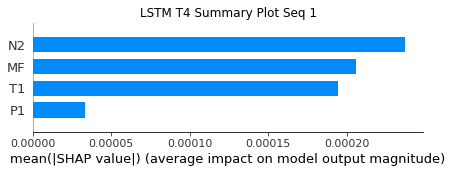

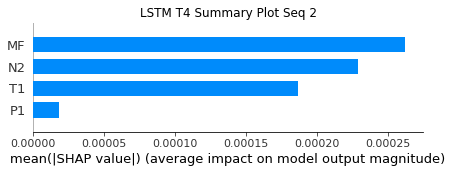

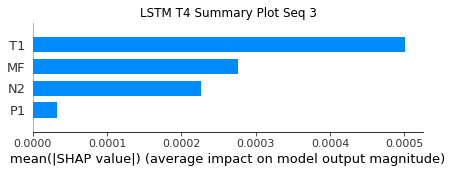

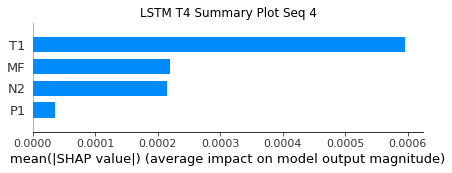

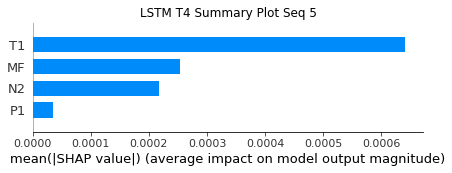

...

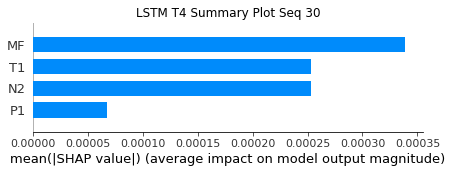

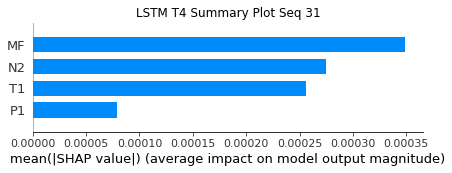

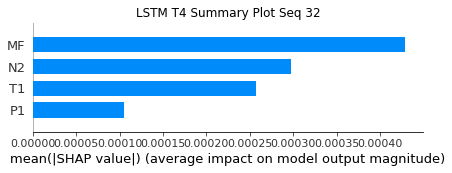

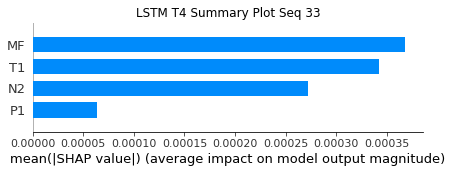

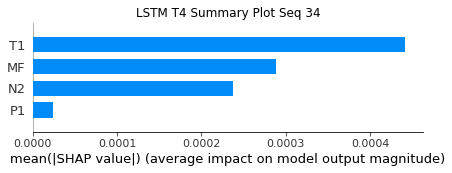

In [41]:
#SHAP Summmary Plot

instance = x_train
instance2 = x_test
explainer = shap.DeepExplainer(model2,instance)
shap_values = explainer.shap_values(instance2)
for i in range(34):
    shap.summary_plot(shap_values[0][i],feature_names=xtrain.columns,show=False,plot_size=(7, 2),plot_type="bar")
    plt.title("LSTM T4 Summary Plot Seq %i" %(i+1),fontsize=12)
    plt.savefig("Sum_Plot %i" %i+'.tiff')
    plt.figure
    plt.show()

Contribution: [-0.00059942 -0.00265166  0.00252425  0.0018752 ]


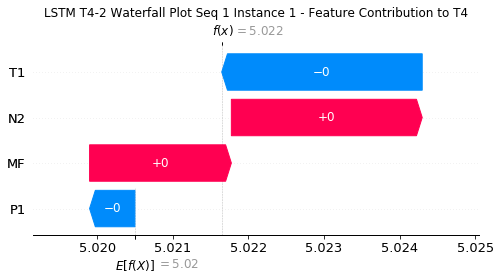

None

Contribution: [-3.20280240e-05 -4.42094852e-04  9.39500393e-04  8.45366167e-04]


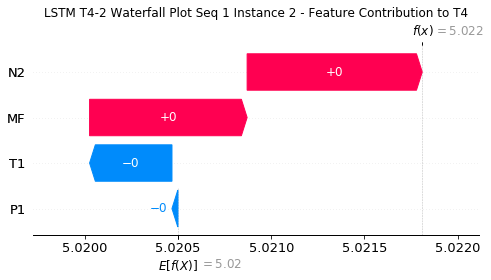

None

Contribution: [-1.64456925e-06 -6.24118911e-05  1.94024119e-04  1.85508496e-04]


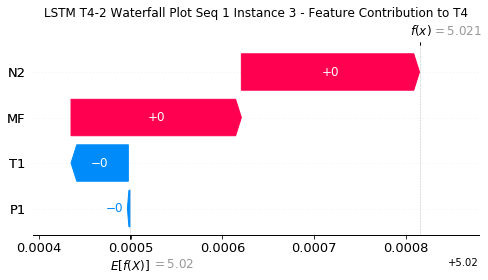

None

Contribution: [-5.65573081e-06 -2.61558291e-05  4.45641474e-05  4.14106072e-05]


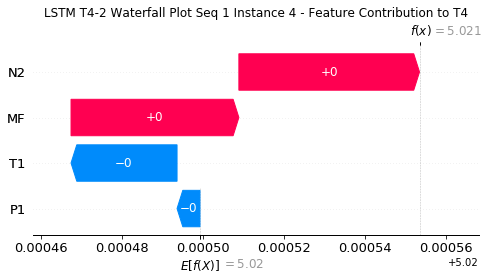

None

Contribution: [-3.25348750e-06 -2.60423186e-05  3.90744384e-05  3.53820836e-05]


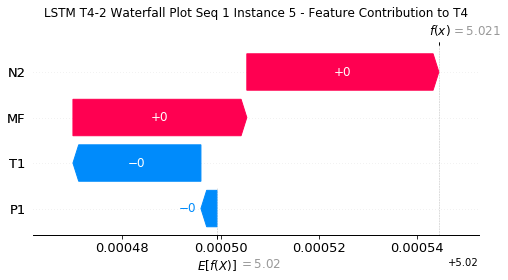

None

Contribution: [-4.17455604e-06 -2.28537718e-05  3.54206825e-05  3.35236545e-05]


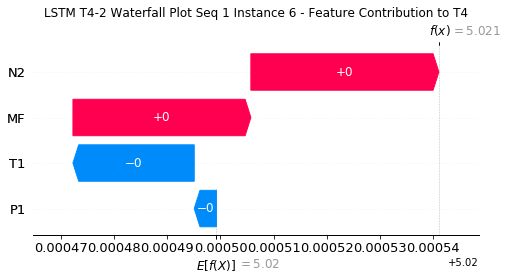

None

Contribution: [-3.38528242e-06 -2.15652554e-05  3.62580226e-05  3.92014195e-05]


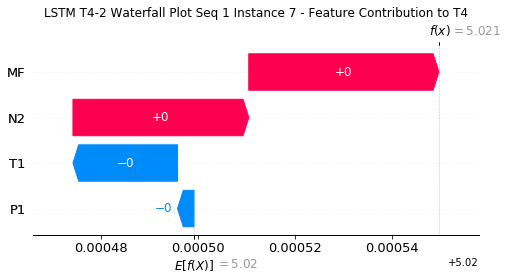

None

Contribution: [-6.62564125e-06 -1.63250277e-05  3.40587453e-05  2.92401670e-05]


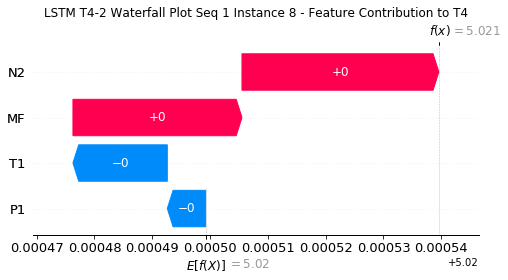

None

Contribution: [-4.45820217e-06 -1.82703230e-05  3.51912134e-05  3.91680862e-05]


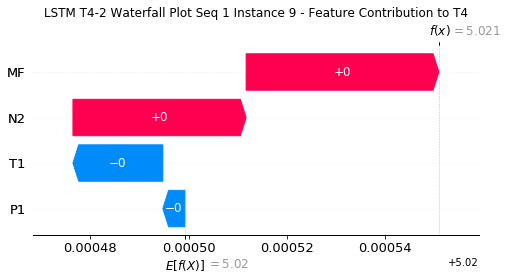

None

Contribution: [-5.05820249e-06 -2.45622574e-05  3.30379501e-05  3.26997047e-05]


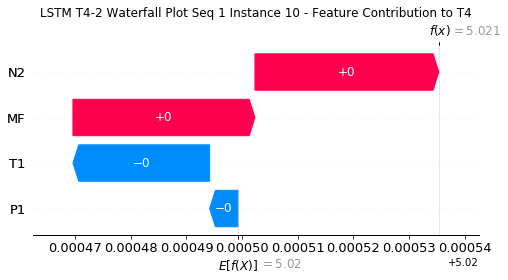

None

Contribution: [-2.94592900e-06 -2.68050616e-05  3.21385068e-05  3.04016425e-05]


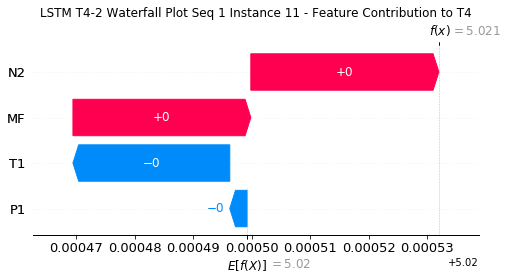

None

Contribution: [-4.27840283e-07 -3.18732191e-05  3.22824273e-05  3.00518862e-05]


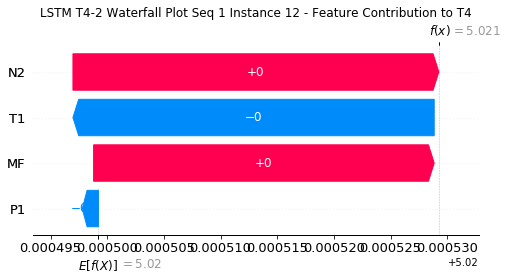

None

Contribution: [-2.65980703e-06 -2.78421614e-05  3.16850983e-05  3.09984553e-05]


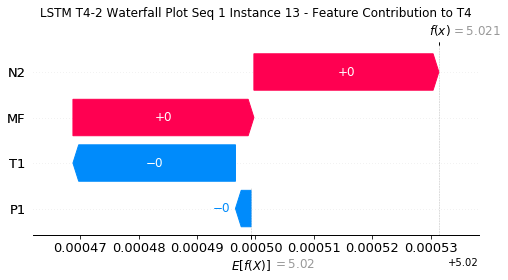

None

Contribution: [-9.45686984e-06 -2.97399832e-05  3.09325089e-05  2.64437916e-05]


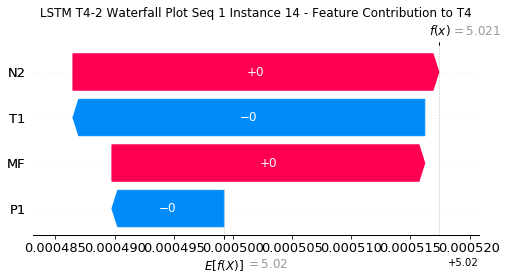

None

Contribution: [-2.41555484e-06 -3.00011489e-05  3.09970794e-05  3.08879672e-05]


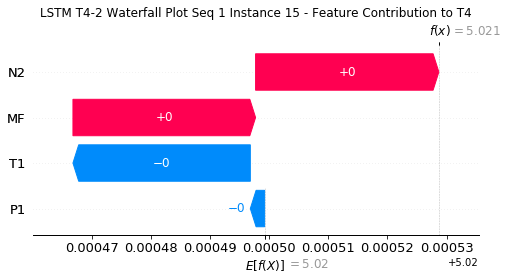

None

Contribution: [-2.31912902e-06 -2.87693711e-05  3.03572296e-05  3.14541162e-05]


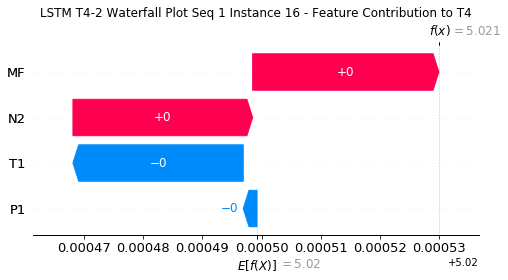

None

Contribution: [-6.95954090e-06 -2.79748212e-05  3.22176607e-05  3.82257415e-05]


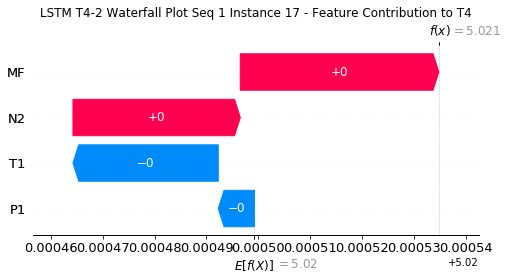

None

Contribution: [-1.31376079e-06 -2.91011442e-05  3.06697317e-05  3.25269727e-05]


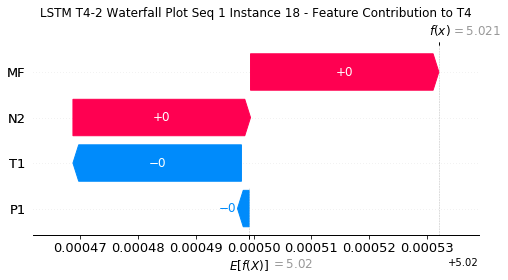

None

Contribution: [-1.32275426e-06 -3.04471857e-05  3.06410951e-05  3.27313857e-05]


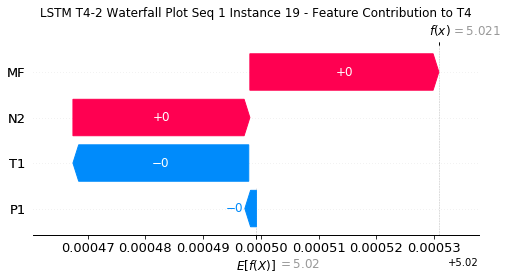

None

Contribution: [-1.93687563e-06 -3.14862646e-05  3.12500484e-05  3.35890016e-05]


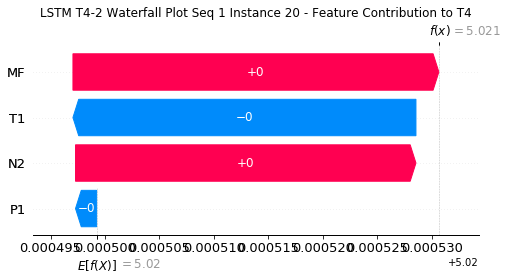

None

Contribution: [-5.50308873e-06 -3.75257233e-05  3.39167760e-05  3.87216149e-05]


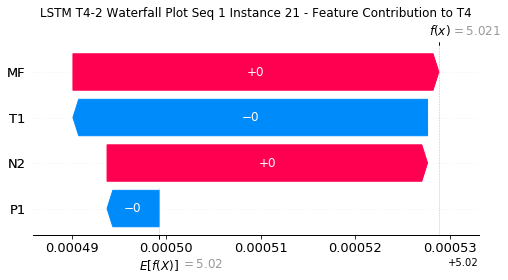

None

Contribution: [-6.96065034e-06 -7.08904998e-05  4.87640072e-05  6.14888567e-05]


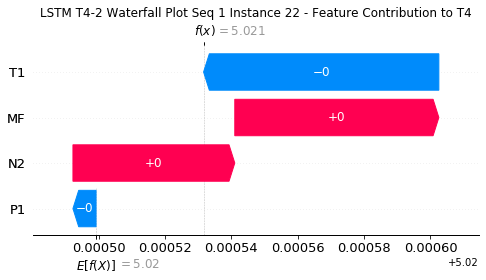

None

Contribution: [-2.80700343e-05 -1.69746414e-04  1.64864776e-04  2.23586140e-04]


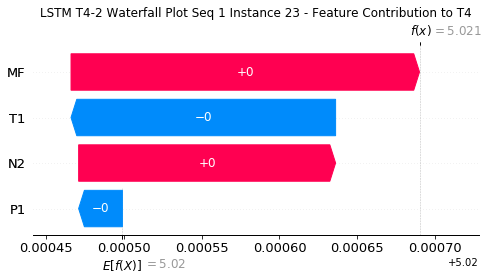

None

Contribution: [-6.85428280e-05 -7.81604109e-04  1.21242248e-03  1.15072101e-03]


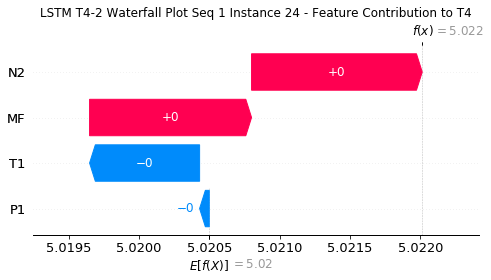

None

Contribution: [-4.58211615e-05 -1.77993015e-03  2.52724815e-03  2.57001309e-03]


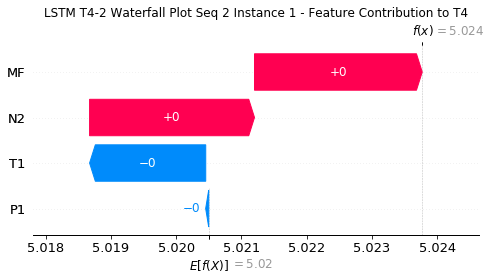

None

Contribution: [ 7.21381545e-05 -1.36363596e-04  9.00226386e-04  1.08805309e-03]


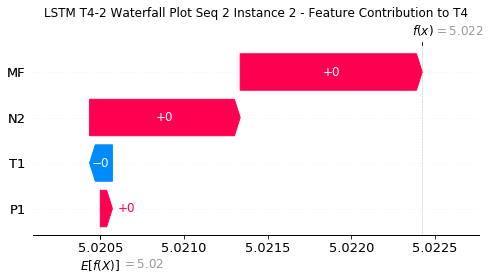

None

Contribution: [ 1.89742083e-05 -1.12064663e-05  1.88044705e-04  2.24045897e-04]


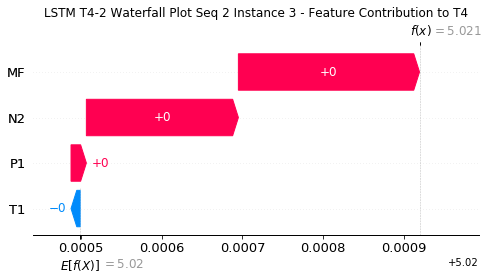

None

Contribution: [ 3.14643067e-07 -8.48386682e-06  4.18467592e-05  5.00405071e-05]


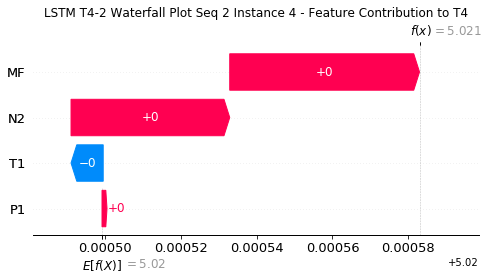

None

Contribution: [ 3.07886953e-07 -1.11403432e-05  3.22793080e-05  4.13126044e-05]


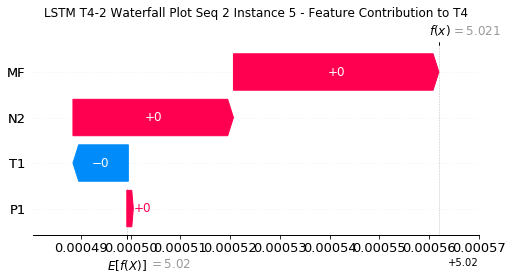

None

Contribution: [-4.81315953e-08 -9.75401924e-06  3.23470937e-05  3.93411966e-05]


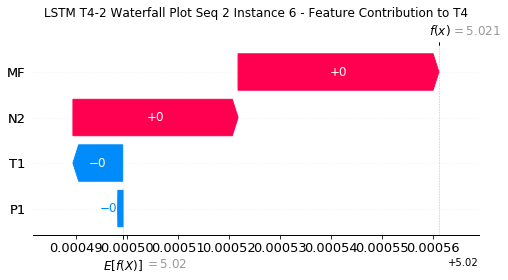

None

Contribution: [-2.53772725e-06 -1.53578855e-05  3.01969842e-05  4.03209832e-05]


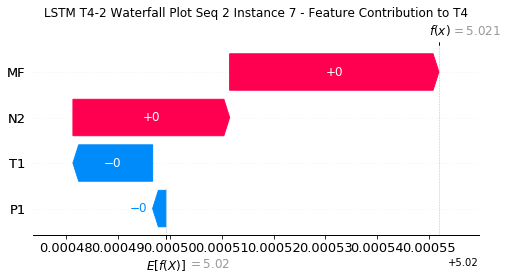

None

Contribution: [-3.56994216e-06 -1.48444375e-05  2.84355463e-05  3.17721577e-05]


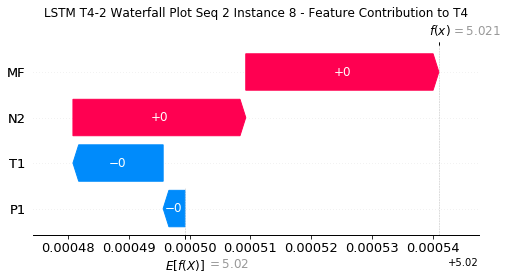

None

Contribution: [-3.09689495e-07 -1.70698391e-05  2.89299903e-05  3.56805233e-05]


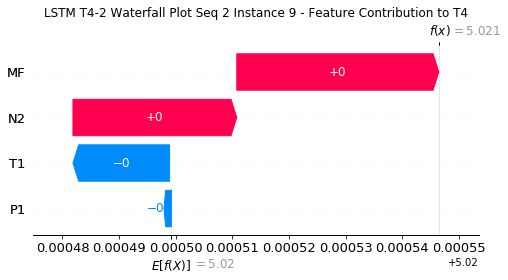

None

Contribution: [-2.59159706e-06 -1.14350908e-05  2.90362870e-05  3.54079332e-05]


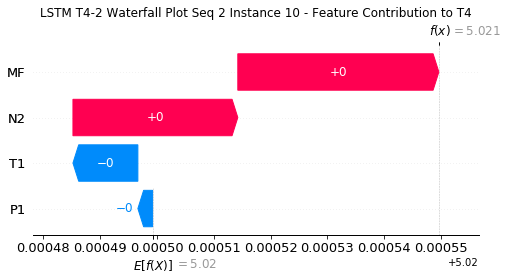

None

Contribution: [-1.22100995e-06 -1.30471307e-05  2.82852907e-05  3.38304627e-05]


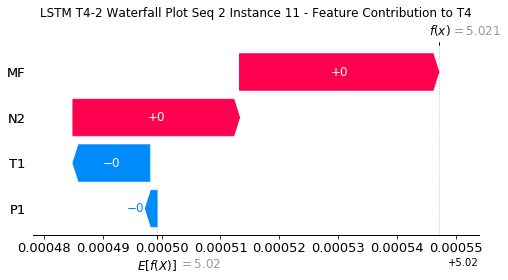

None

Contribution: [-4.00457064e-07 -2.27838320e-05  2.81572674e-05  3.55101035e-05]


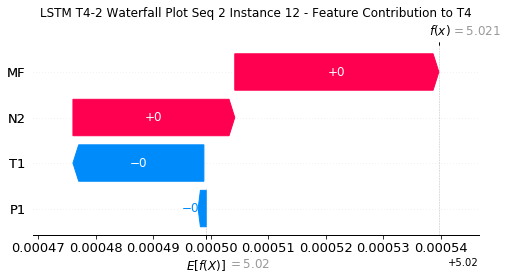

None

Contribution: [-1.12524744e-06 -1.69161309e-05  2.76246592e-05  3.35195046e-05]


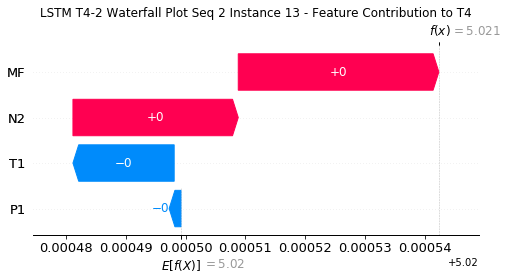

None

Contribution: [-7.59085011e-06 -1.77389665e-05  2.77660748e-05  3.60387916e-05]


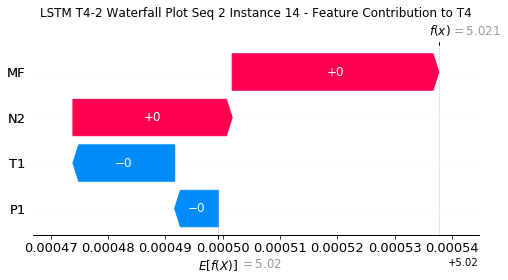

None

Contribution: [-2.03243284e-06 -1.83809699e-05  2.66025578e-05  3.18397454e-05]


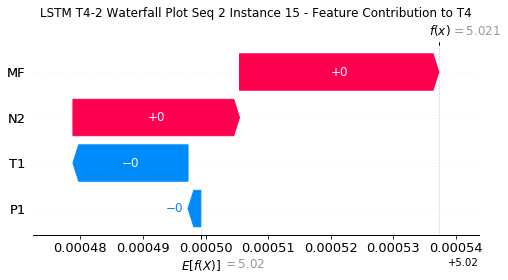

None

Contribution: [-1.79467764e-06 -1.59698109e-05  2.59178838e-05  3.13659157e-05]


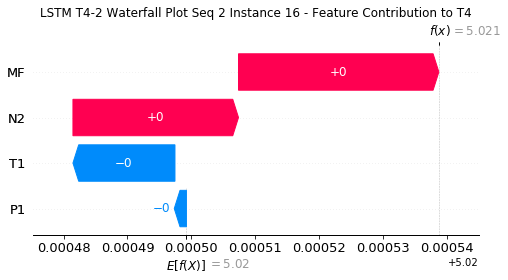

None

Contribution: [-7.88340293e-06 -2.21546197e-05  2.63537283e-05  2.30497236e-05]


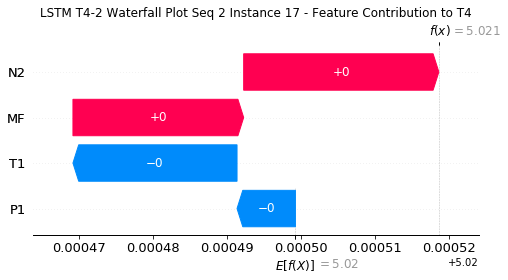

None

Contribution: [-1.44695140e-06 -2.01166896e-05  2.68646937e-05  3.40535605e-05]


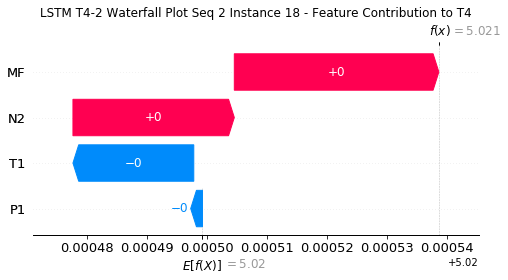

None

Contribution: [-1.24609605e-06 -2.13161201e-05  2.67340951e-05  3.43489689e-05]


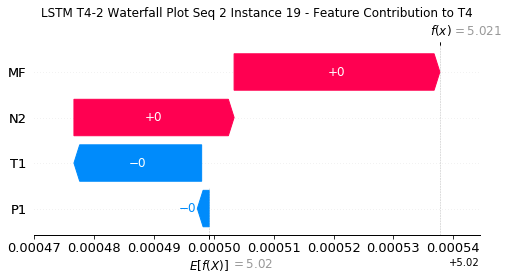

None

Contribution: [-1.59328352e-06 -2.57106384e-05  2.74099947e-05  3.59372470e-05]


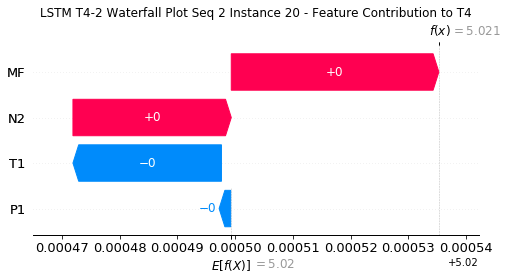

None

Contribution: [-4.80750008e-06 -2.88236364e-05  2.86333445e-05  3.77719339e-05]


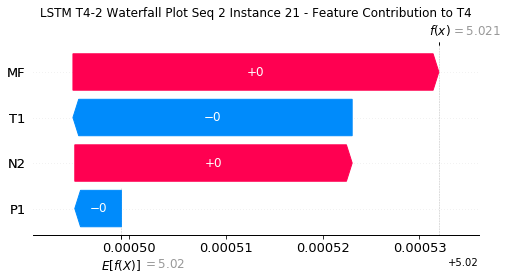

None

Contribution: [-5.12266310e-06 -4.70585321e-05  3.81095325e-05  4.93741319e-05]


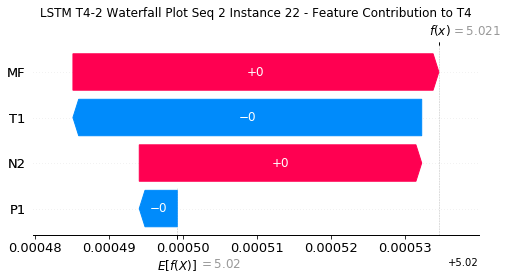

None

Contribution: [-5.28486958e-05 -1.90983480e-04  1.24147598e-04  1.30268671e-04]


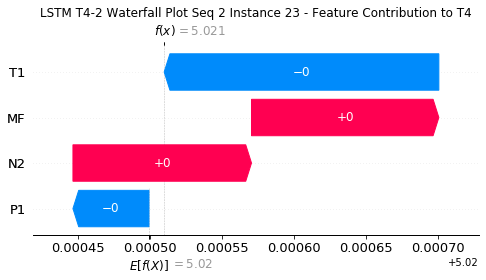

None

Contribution: [-0.00020841 -0.00200175  0.00119137  0.00158044]


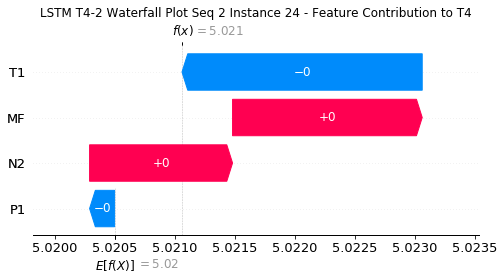

None

Contribution: [-0.0003841  -0.00521785  0.0025312   0.00343482]


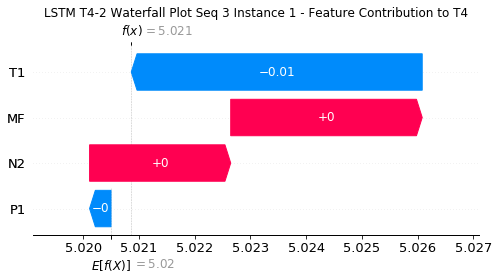

None

Contribution: [ 5.82983412e-06 -8.99004076e-04  9.27930664e-04  1.16485467e-03]


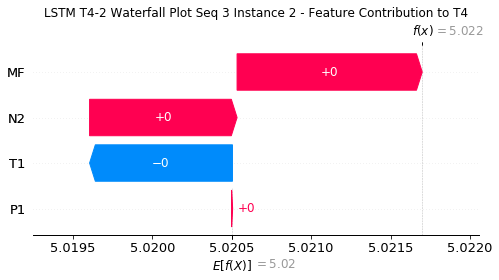

None

Contribution: [ 5.28181114e-06 -2.23699191e-04  1.85914140e-04  2.12581271e-04]


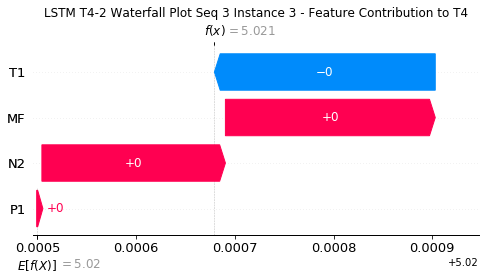

None

Contribution: [-3.88144615e-06 -7.96406335e-05  4.14877417e-05  4.75490485e-05]


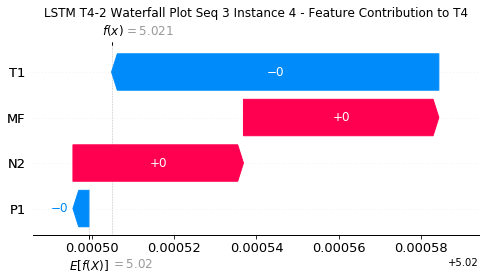

None

Contribution: [-3.50626881e-06 -7.29541108e-05  3.70809196e-05  4.12927118e-05]


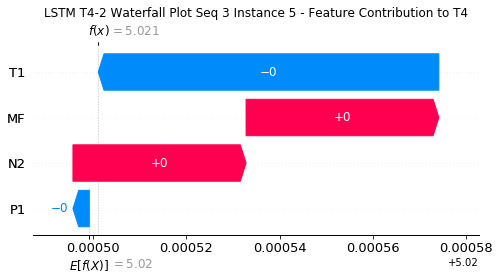

None

Contribution: [-3.83134266e-06 -6.82693405e-05  3.21739404e-05  3.67850669e-05]


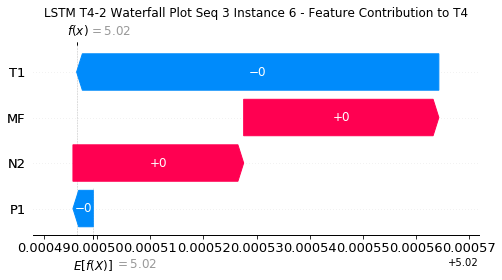

None

Contribution: [-9.13365558e-06 -6.82395911e-05  2.91247225e-05  3.57662184e-05]


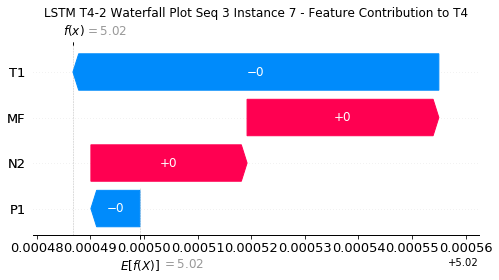

None

Contribution: [-3.52189665e-06 -7.74053240e-05  2.77542619e-05  2.81221136e-05]


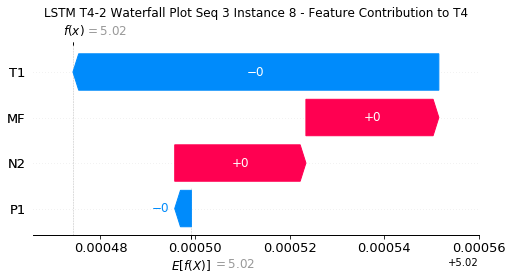

None

Contribution: [-7.00201139e-06 -7.11320383e-05  2.84902930e-05  3.16452942e-05]


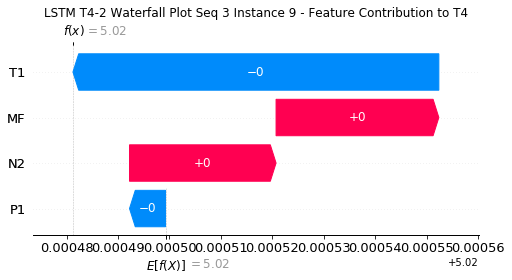

None

Contribution: [-5.74540274e-06 -6.82812860e-05  2.95540434e-05  3.31012821e-05]


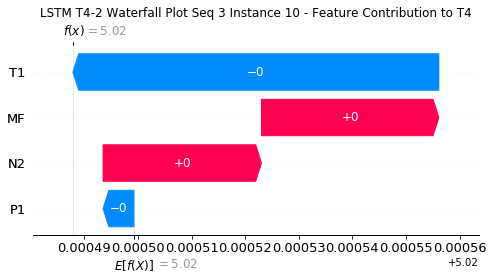

None

Contribution: [-4.35894884e-06 -6.95590571e-05  2.85897095e-05  3.13460826e-05]


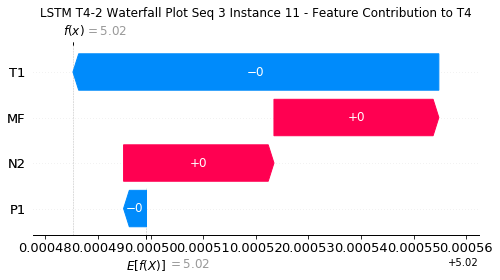

None

Contribution: [-4.01335905e-06 -7.52018294e-05  2.72231607e-05  2.74747093e-05]


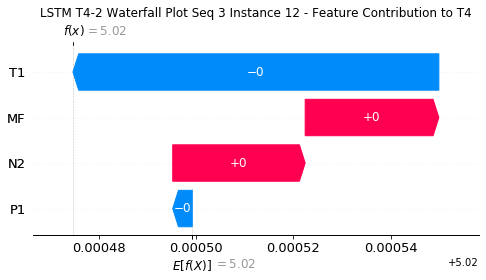

None

Contribution: [-4.76605648e-06 -7.13480161e-05  2.78874952e-05  3.00977192e-05]


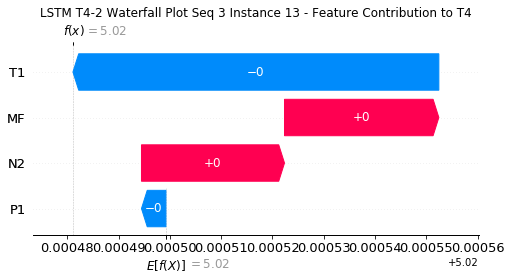

None

Contribution: [-6.41035872e-06 -7.05979857e-05  2.71746623e-05  2.97342295e-05]


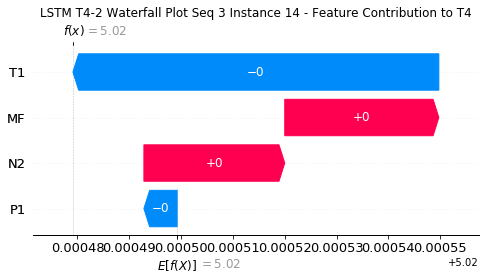

None

Contribution: [-5.71213823e-06 -7.44139489e-05  2.71939011e-05  2.93279923e-05]


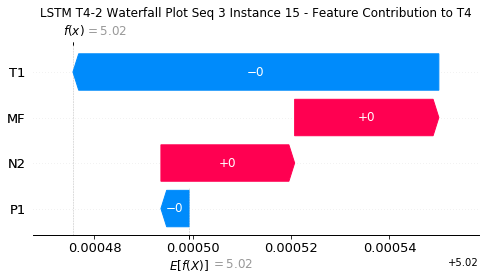

None

Contribution: [-5.31064539e-06 -7.50775039e-05  2.66626520e-05  2.95385820e-05]


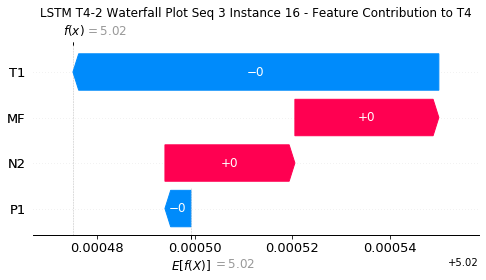

None

Contribution: [-6.44156803e-06 -7.47904701e-05  2.65916302e-05  2.97389548e-05]


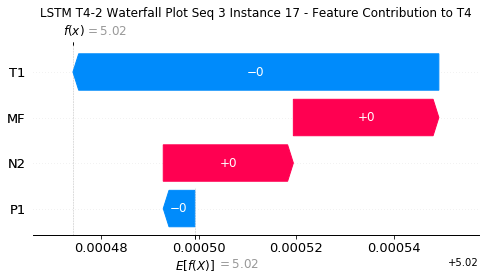

None

Contribution: [-5.76839055e-06 -7.39759926e-05  2.69108139e-05  3.05638322e-05]


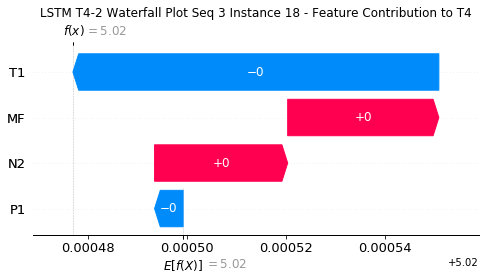

None

Contribution: [-5.68485301e-06 -7.71613032e-05  2.68342113e-05  3.03831611e-05]


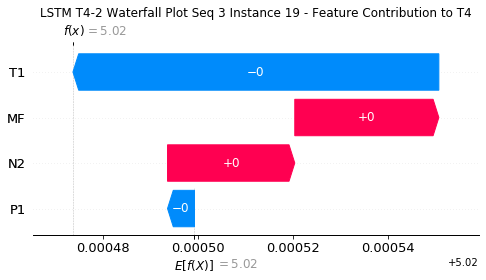

None

Contribution: [-6.63903583e-06 -7.96597125e-05  2.70128136e-05  3.00011079e-05]


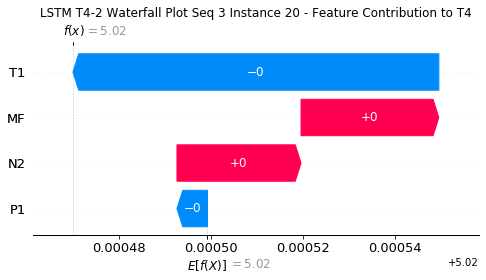

None

Contribution: [-1.01092658e-05 -9.68620579e-05  2.89487236e-05  3.26999569e-05]


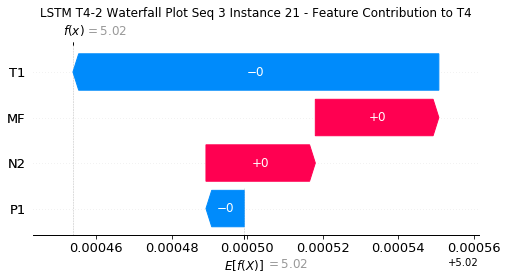

None

Contribution: [-1.34621919e-05 -1.76557934e-04  4.00662309e-05  4.78570475e-05]


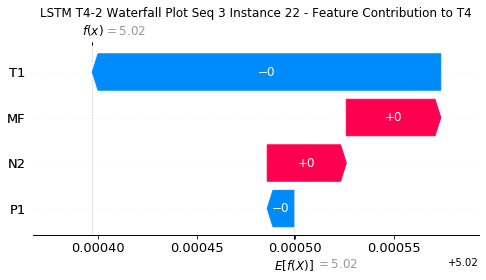

None

Contribution: [-3.91619709e-05 -6.23398125e-04  1.32567641e-04  1.59055164e-04]


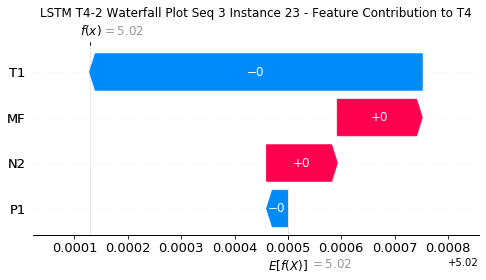

None

Contribution: [-0.00022647 -0.00352573  0.00108527  0.00102786]


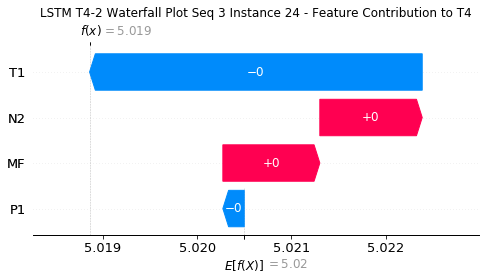

None

Contribution: [-0.00054146 -0.00717298  0.00222019  0.00210079]


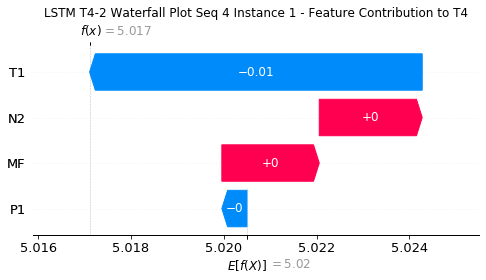

None

Contribution: [-3.54573988e-05 -1.25375347e-03  8.79656842e-04  9.62330690e-04]


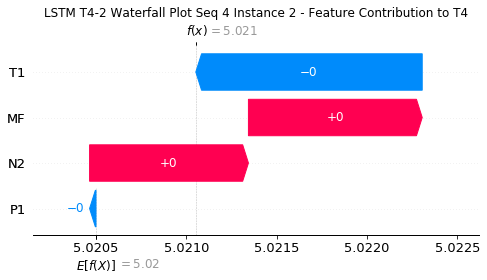

None

Contribution: [ 5.97569235e-06 -2.29065606e-04  1.78819135e-04  1.79093433e-04]


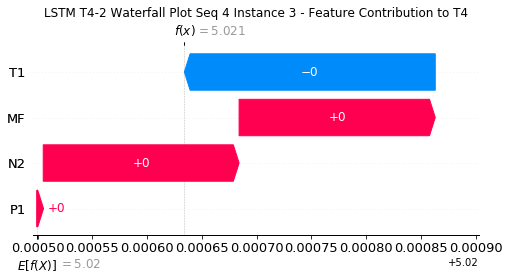

None

Contribution: [-4.14480781e-06 -8.03223631e-05  3.97026223e-05  3.94102447e-05]


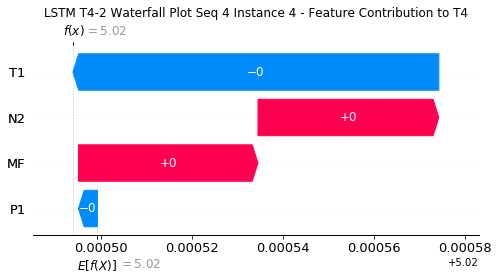

None

Contribution: [-2.28564218e-06 -6.14070021e-05  3.39172515e-05  3.42219455e-05]


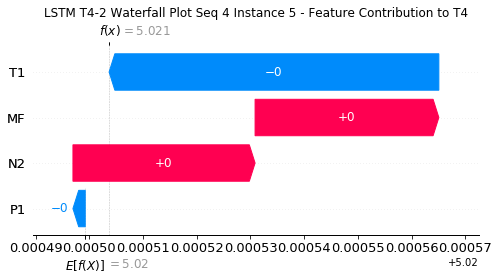

None

Contribution: [-3.43172659e-06 -6.81689258e-05  3.13357871e-05  3.11454116e-05]


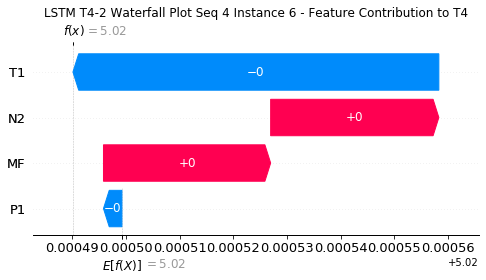

None

Contribution: [-3.30466379e-06 -6.96765488e-05  3.06937152e-05  3.11145081e-05]


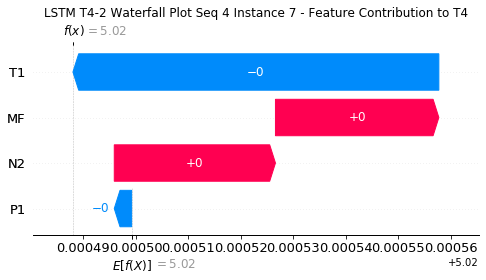

None

Contribution: [-4.48383092e-06 -7.10662018e-05  2.98620257e-05  2.78981462e-05]


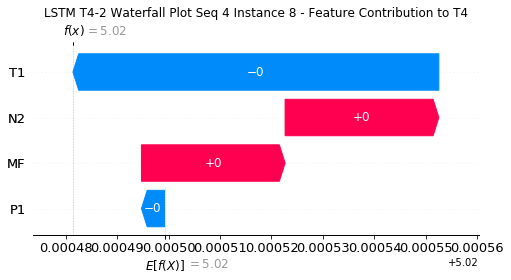

None

Contribution: [-6.61938412e-06 -6.62477097e-05  2.99884433e-05  3.10208801e-05]


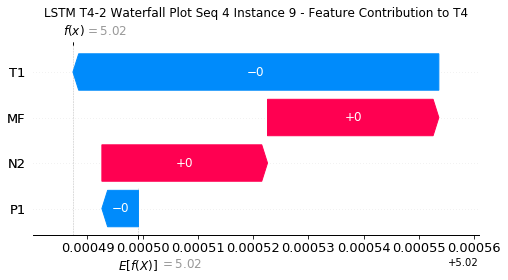

None

Contribution: [-4.78677838e-06 -6.82874856e-05  3.00151985e-05  3.35515637e-05]


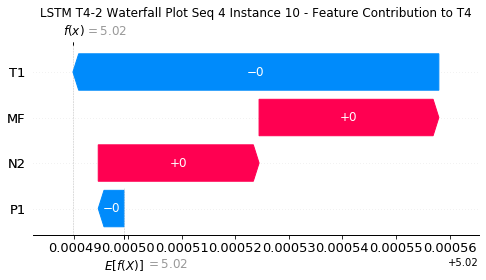

None

Contribution: [-2.49818974e-06 -7.13938979e-05  2.91276300e-05  3.09631471e-05]


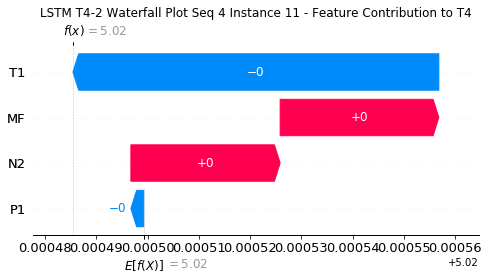

None

Contribution: [-1.00269662e-05 -8.12329635e-05  2.80208885e-05  2.59474538e-05]


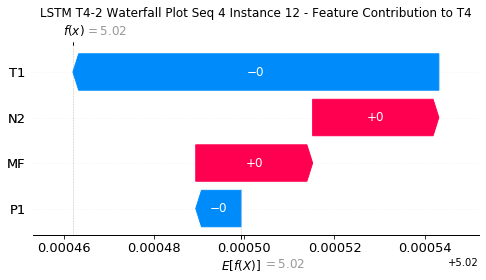

None

Contribution: [-3.31499095e-06 -7.42285160e-05  2.86175449e-05  3.07388588e-05]


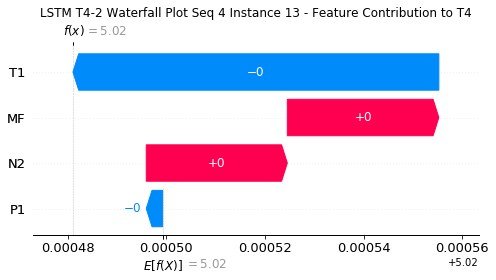

None

Contribution: [-3.98560006e-06 -7.94023156e-05  2.95058499e-05  3.14476229e-05]


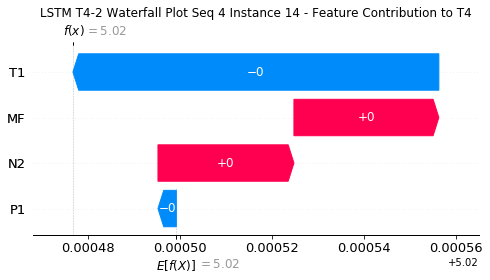

None

Contribution: [-3.33462417e-06 -7.89974303e-05  2.82723683e-05  3.02290761e-05]


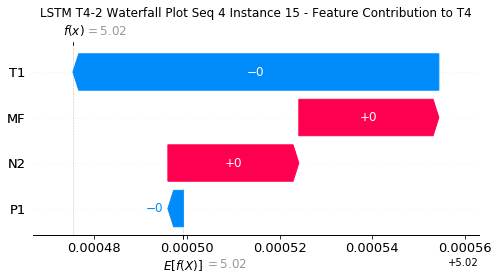

None

Contribution: [-3.70827720e-06 -7.87733371e-05  2.78957657e-05  3.02095287e-05]


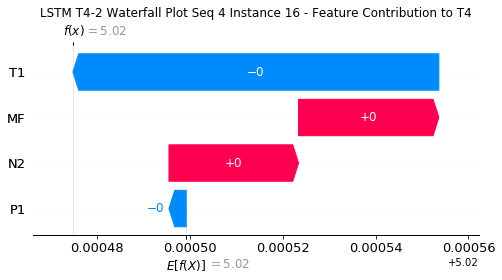

None

Contribution: [-3.17326457e-06 -7.93184880e-05  2.85142061e-05  3.06344716e-05]


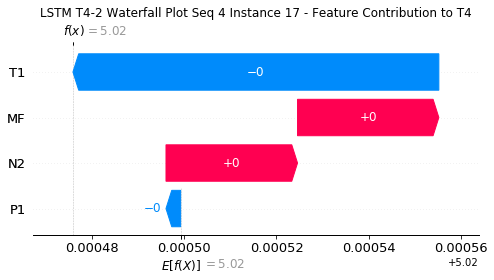

None

Contribution: [-3.20773960e-06 -8.11203396e-05  2.77781426e-05  2.84922229e-05]


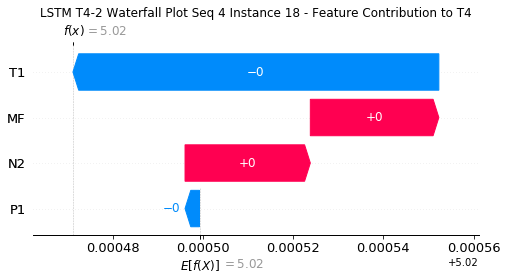

None

Contribution: [-3.80134010e-06 -8.32157654e-05  2.78584682e-05  2.87378697e-05]


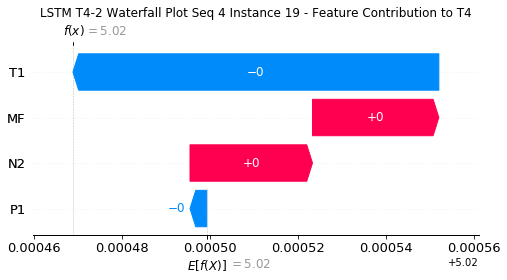

None

Contribution: [-5.23188093e-06 -8.63148434e-05  2.80155135e-05  2.87181690e-05]


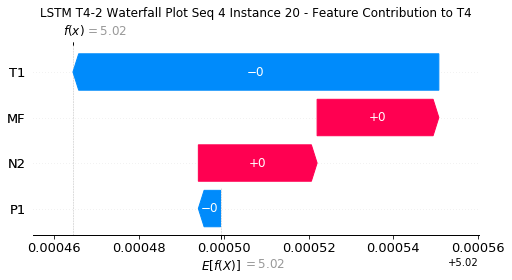

None

Contribution: [-9.76646692e-06 -1.01817760e-04  3.06644826e-05  3.38142494e-05]


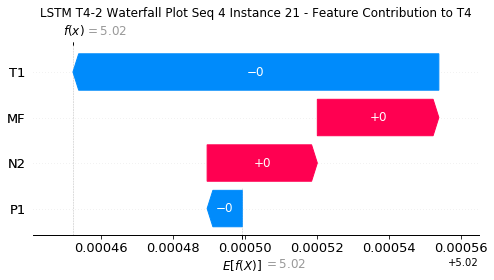

None

Contribution: [-1.41998961e-05 -1.83558678e-04  4.12209677e-05  4.53572020e-05]


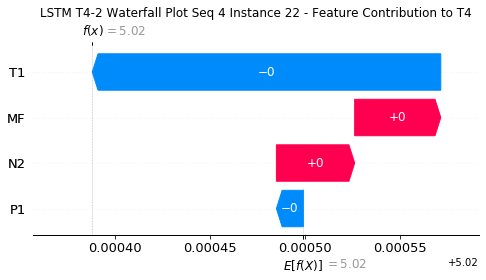

None

Contribution: [-3.08350869e-05 -5.72458780e-04  1.33514520e-04  1.66843293e-04]


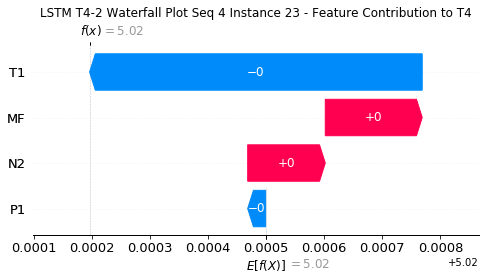

None

Contribution: [-0.00015589 -0.00349757  0.00115648  0.00124802]


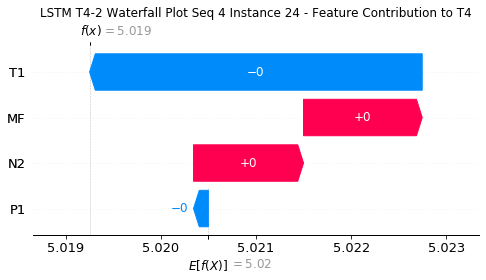

None

Contribution: [-0.00032362 -0.00775304  0.00230937  0.00254945]


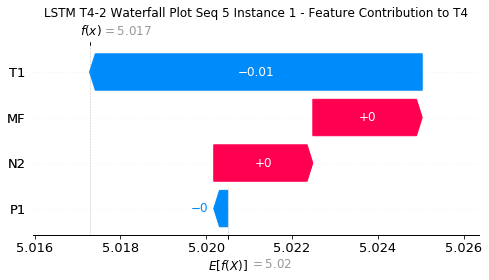

None

Contribution: [ 1.52187385e-05 -1.49835287e-03  8.78753037e-04  1.04253464e-03]


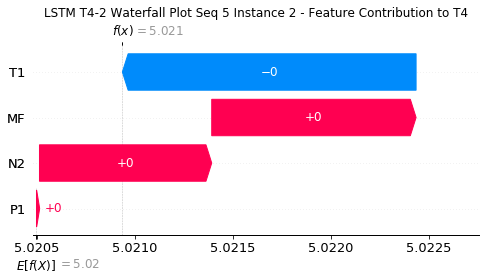

None

Contribution: [ 4.46703824e-06 -2.94466652e-04  1.84007861e-04  2.17565555e-04]


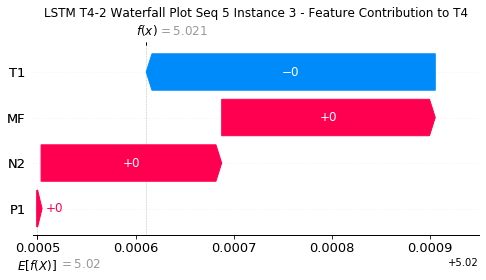

None

Contribution: [-3.80253982e-06 -9.85455470e-05  4.11720251e-05  5.08733712e-05]


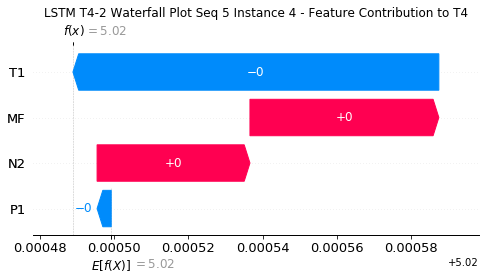

None

Contribution: [-4.55593980e-07 -9.13913975e-05  3.43238941e-05  4.29087737e-05]


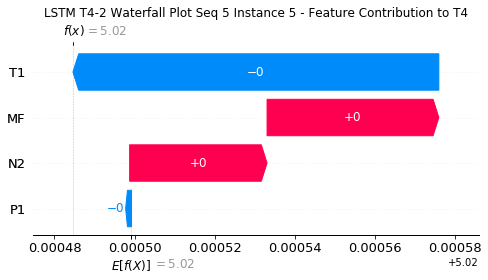

None

Contribution: [-3.49702095e-06 -8.25928959e-05  3.23290251e-05  3.92824766e-05]


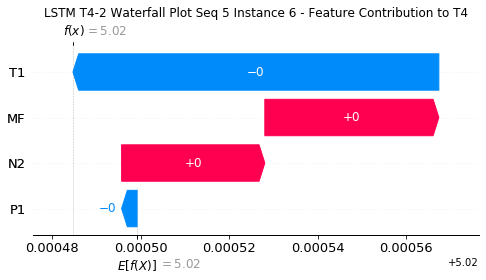

None

Contribution: [-4.81949090e-06 -8.12069812e-05  3.15445593e-05  3.50778895e-05]


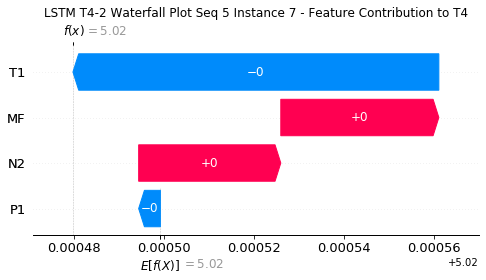

None

Contribution: [-8.58446135e-06 -7.97811403e-05  2.92173728e-05  2.70680235e-05]


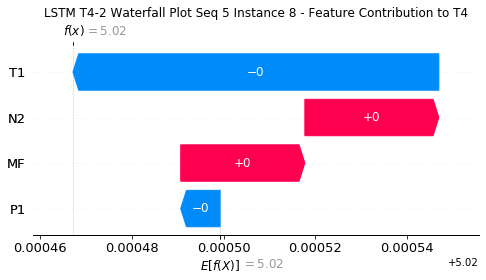

None

Contribution: [-5.26651488e-06 -7.41720162e-05  3.09309271e-05  4.00173623e-05]


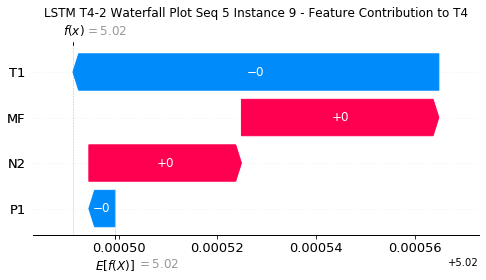

None

Contribution: [-3.46837695e-06 -7.58140196e-05  3.07381770e-05  3.94520221e-05]


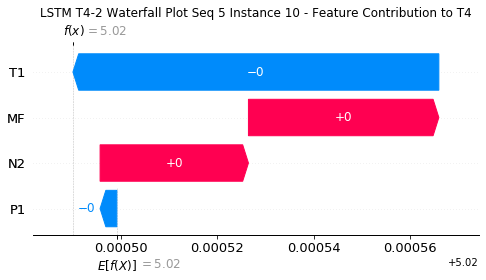

None

Contribution: [-1.91436939e-06 -7.91088869e-05  2.98013256e-05  3.58569878e-05]


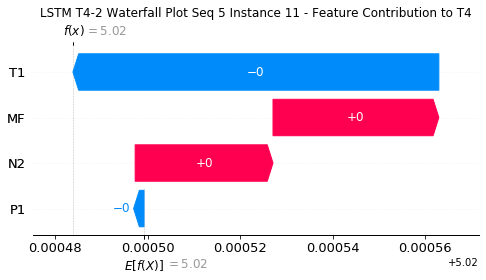

None

Contribution: [-6.43720483e-06 -7.93816527e-05  2.93321445e-05  3.44546786e-05]


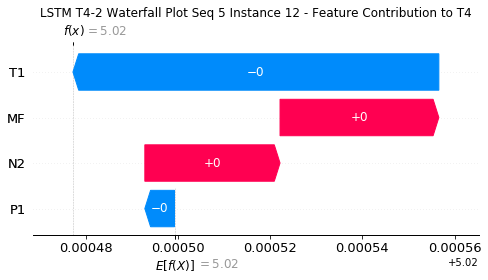

None

Contribution: [-2.21892283e-06 -7.94507928e-05  2.93265078e-05  3.63323851e-05]


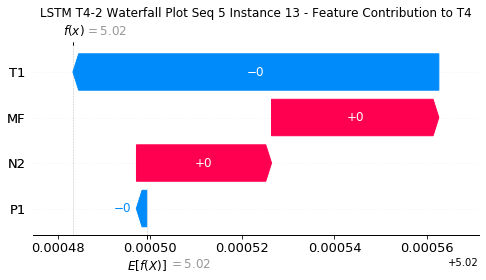

None

Contribution: [-3.20504599e-06 -7.95581835e-05  2.84807051e-05  2.68250609e-05]


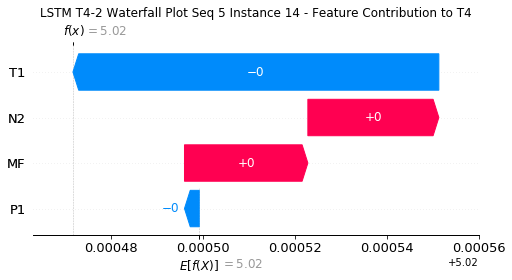

None

Contribution: [-2.62680562e-06 -8.37693173e-05  2.87707666e-05  3.45111838e-05]


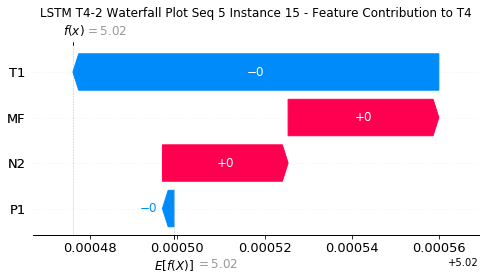

None

Contribution: [-3.48586585e-06 -8.42223008e-05  2.81826051e-05  3.42370969e-05]


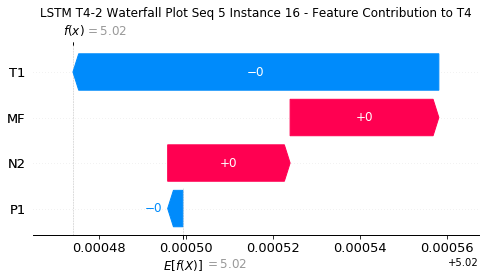

None

Contribution: [-8.67137344e-06 -8.81365681e-05  2.78540470e-05  3.49513283e-05]


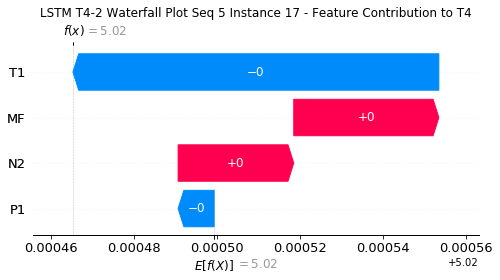

None

Contribution: [-4.67690520e-06 -8.73461676e-05  2.81075649e-05  3.26160701e-05]


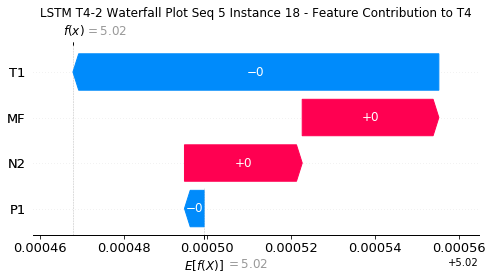

None

Contribution: [-5.28501044e-06 -8.92054096e-05  2.81025123e-05  3.28684581e-05]


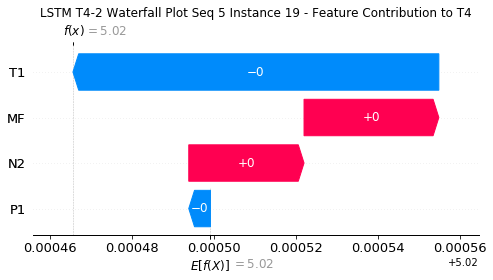

None

Contribution: [-6.72099337e-06 -9.05226383e-05  2.84439468e-05  3.40990978e-05]


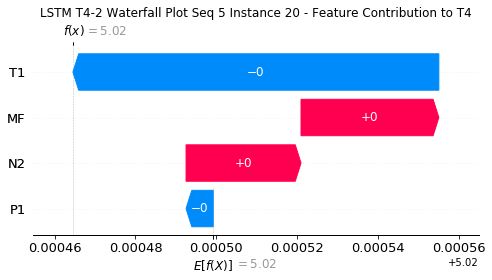

None

Contribution: [-1.04480283e-05 -1.05262450e-04  3.08849222e-05  3.98537515e-05]


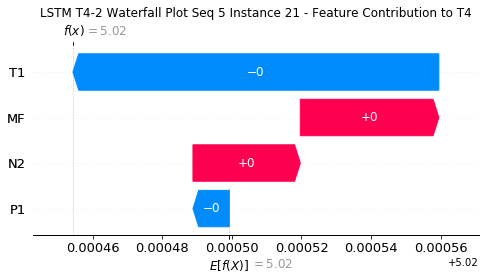

None

Contribution: [-1.62418009e-05 -1.89070725e-04  4.15974217e-05  5.71099298e-05]


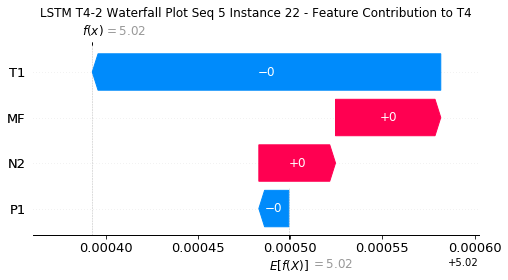

None

Contribution: [-6.24685345e-05 -5.72153843e-04  1.29970931e-04  1.81923093e-04]


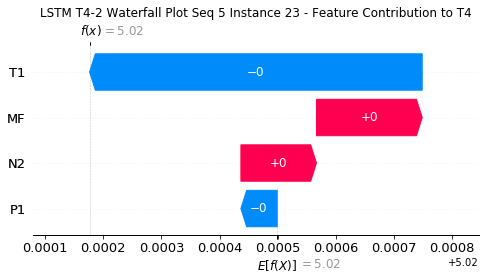

None

Contribution: [-0.00031649 -0.00353253  0.0011467   0.00139334]


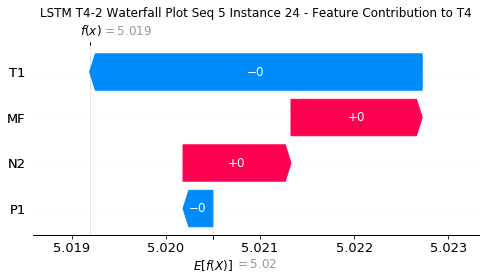

None

Contribution: [-0.0005554  -0.00721876  0.00235711  0.0031623 ]


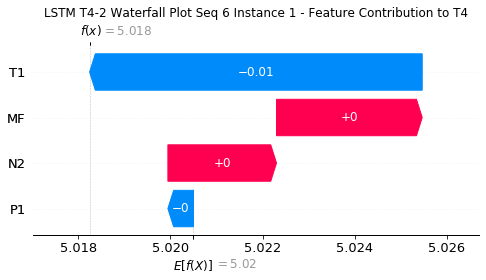

None

Contribution: [ 8.43530377e-06 -1.37385001e-03  8.94418984e-04  1.29650375e-03]


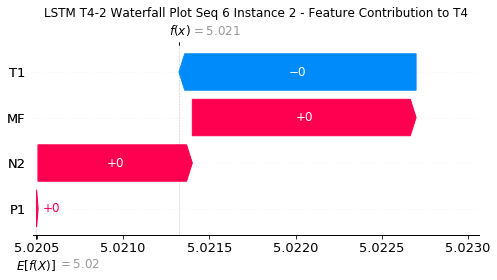

None

Contribution: [-2.09267784e-06 -2.50099518e-04  1.76297180e-04  2.00608321e-04]


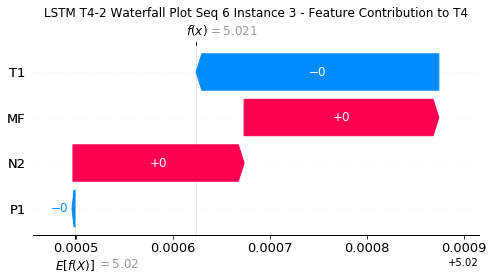

None

Contribution: [-5.02324948e-06 -8.62519417e-05  3.92765717e-05  4.67381150e-05]


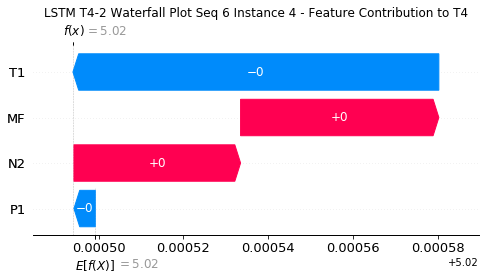

None

Contribution: [-8.97802049e-06 -7.75684454e-05  3.21804051e-05  3.62019480e-05]


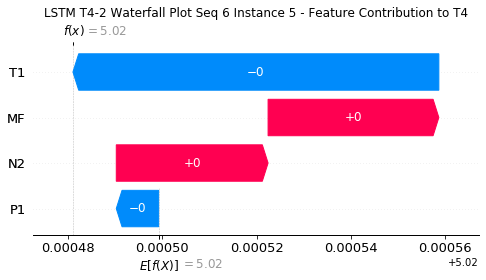

None

Contribution: [-4.31356247e-06 -7.21154919e-05  3.10454709e-05  3.65448961e-05]


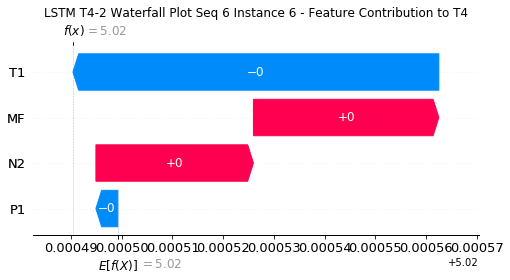

None

Contribution: [-7.70007453e-06 -7.23433940e-05  2.96419619e-05  2.96138480e-05]


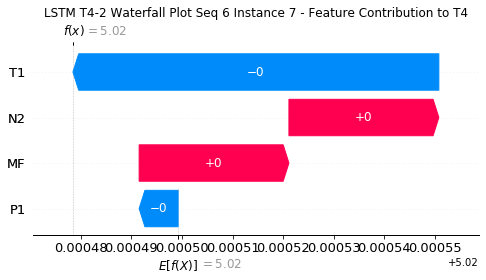

None

Contribution: [-1.05716946e-05 -6.73643742e-05  3.01476313e-05  3.61138721e-05]


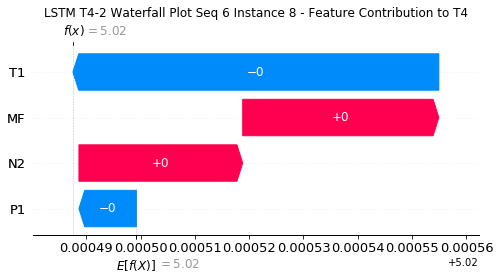

None

Contribution: [-5.78030775e-06 -6.90431168e-05  3.10676659e-05  3.61111042e-05]


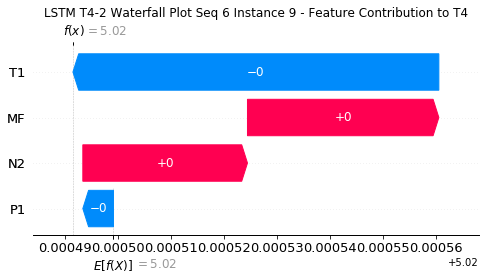

None

Contribution: [-5.05076792e-06 -6.95691293e-05  3.06674716e-05  4.07147266e-05]


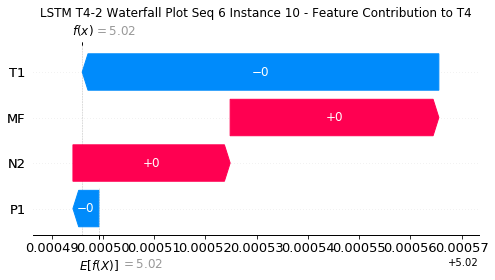

None

Contribution: [-3.40056321e-06 -7.17935132e-05  2.94244740e-05  3.68703176e-05]


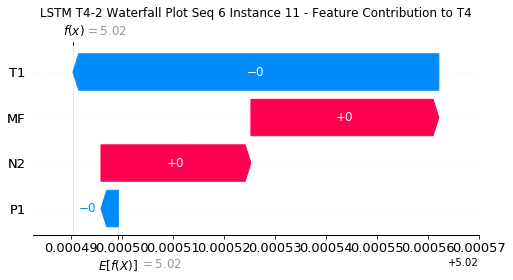

None

Contribution: [-5.54433311e-08 -7.38150264e-05  2.88262691e-05  3.86716827e-05]


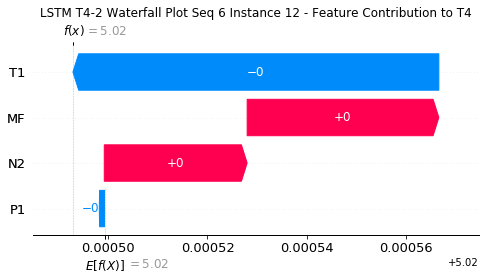

None

Contribution: [-3.38083376e-06 -7.26915853e-05  2.93128628e-05  3.71311717e-05]


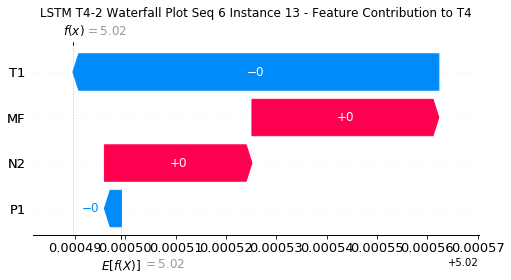

None

Contribution: [-4.93704321e-06 -7.66674478e-05  2.66689874e-05  3.25833147e-05]


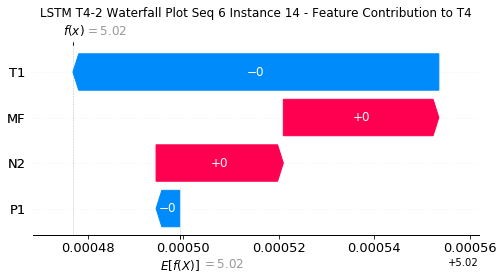

None

Contribution: [-3.47573148e-06 -7.62917413e-05  2.86491060e-05  3.44461544e-05]


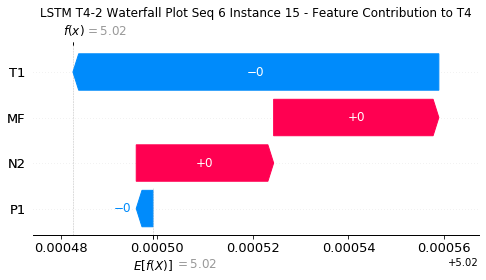

None

Contribution: [-2.49954375e-06 -7.54496887e-05  2.83674736e-05  3.47658821e-05]


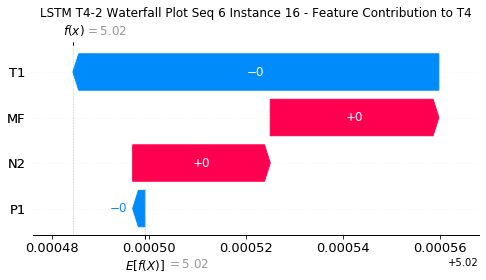

None

Contribution: [-7.28792576e-06 -7.37944223e-05  2.84999140e-05  3.35967257e-05]


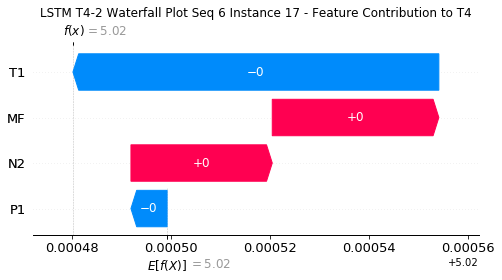

None

Contribution: [-3.09596334e-06 -7.48503312e-05  2.79660736e-05  3.07548588e-05]


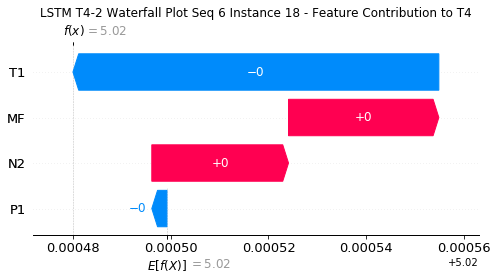

None

Contribution: [-2.61964242e-06 -7.62604985e-05  2.83565465e-05  3.20669668e-05]


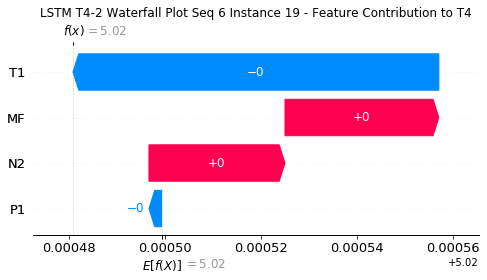

None

Contribution: [-3.80671423e-06 -7.70946315e-05  2.91707763e-05  3.37553276e-05]


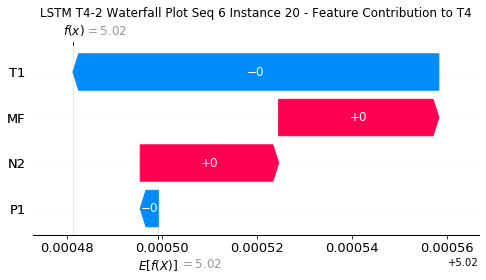

None

Contribution: [-6.19812678e-06 -9.15436502e-05  3.24470087e-05  4.12377582e-05]


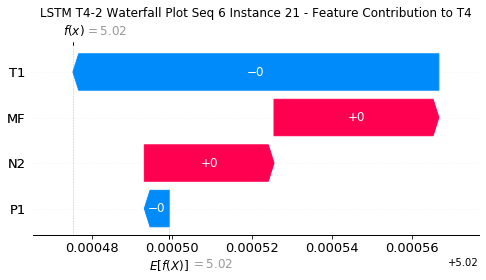

None

Contribution: [-9.42008487e-06 -1.64495098e-04  4.42038609e-05  5.50381200e-05]


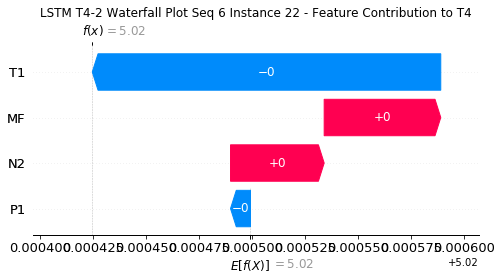

None

Contribution: [-4.67842058e-05 -5.16337382e-04  1.40597880e-04  1.39506745e-04]


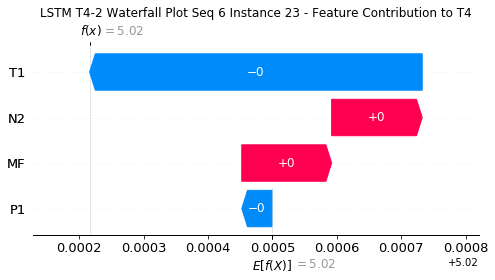

None

Contribution: [-0.00012952 -0.00302119  0.00121346  0.001314  ]


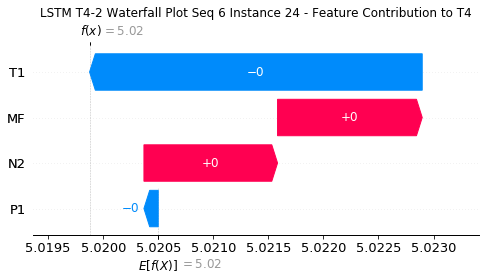

None

Contribution: [-0.00043811 -0.00645409  0.00247206  0.00261294]


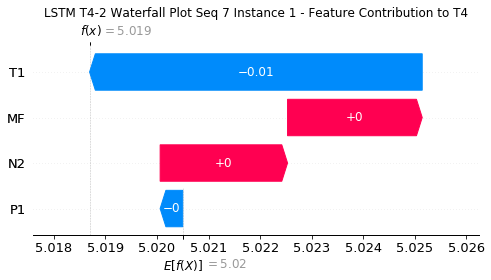

None

Contribution: [-7.79153001e-06 -1.29658692e-03  8.92324263e-04  8.94418850e-04]


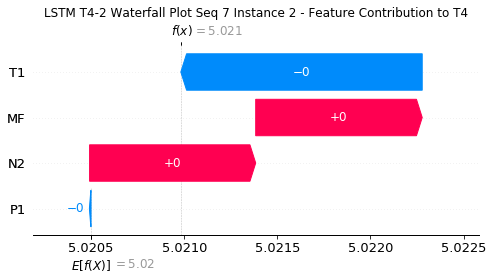

None

Contribution: [ 5.47060144e-06 -2.71266910e-04  1.79909598e-04  1.88973161e-04]


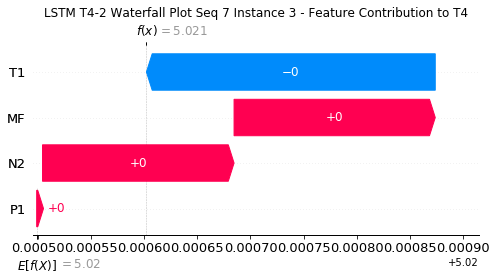

None

Contribution: [-3.46083530e-06 -9.44531489e-05  4.01720140e-05  4.12045322e-05]


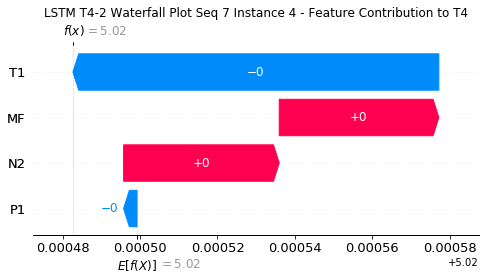

None

Contribution: [-5.42089351e-06 -8.15352088e-05  3.36968106e-05  3.92033780e-05]


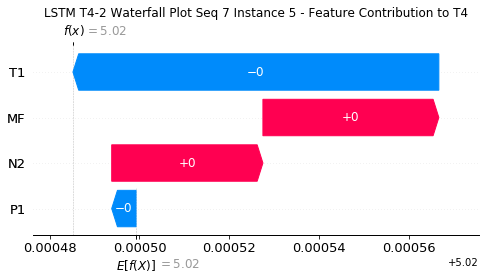

None

Contribution: [-3.44670312e-06 -8.10482554e-05  3.11646097e-05  3.19483506e-05]


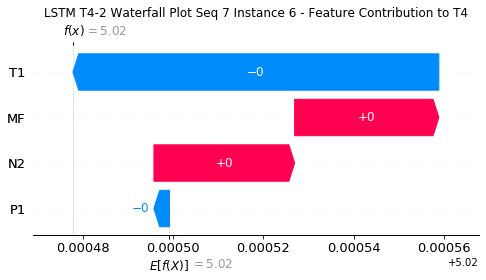

None

Contribution: [-7.30042177e-06 -8.70376230e-05  2.62112443e-05  2.91937618e-05]


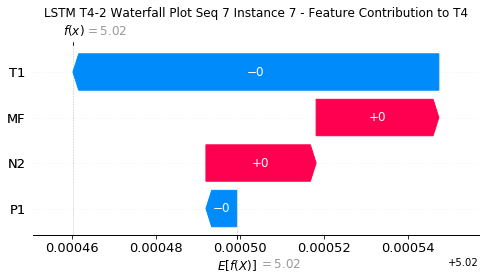

None

Contribution: [-4.53719790e-06 -7.46251481e-05  2.62364858e-05  2.75779296e-05]


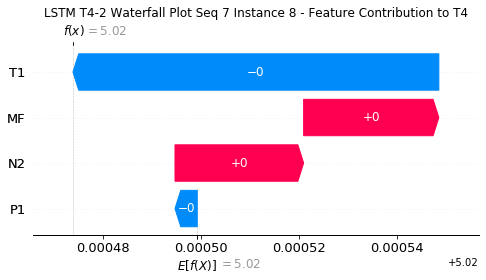

None

Contribution: [-6.17403700e-06 -7.61762583e-05  2.61563728e-05  2.98756517e-05]


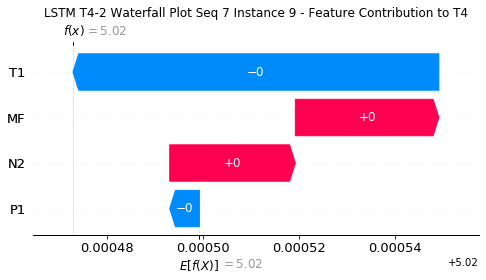

None

Contribution: [-4.49116888e-06 -8.30435811e-05  2.99043571e-05  3.24821788e-05]


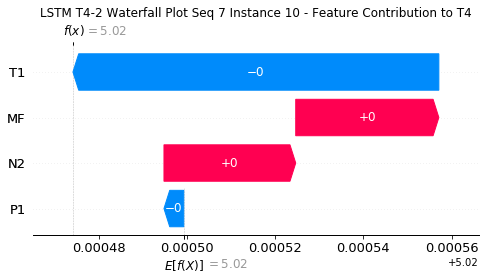

None

Contribution: [-3.02108198e-06 -8.75127422e-05  2.90143451e-05  2.96479187e-05]


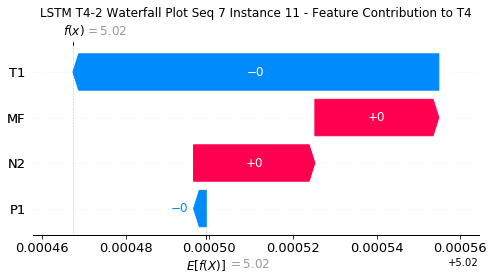

None

Contribution: [-2.37756024e-06 -9.93763241e-05  2.90960435e-05  2.65747638e-05]


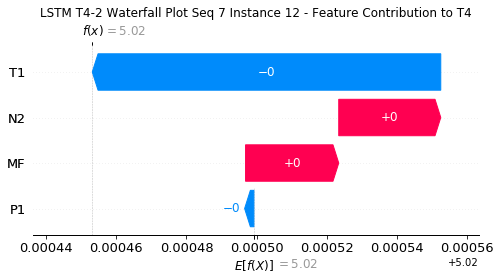

None

Contribution: [-3.75059603e-06 -9.02029961e-05  2.84512285e-05  2.94990847e-05]


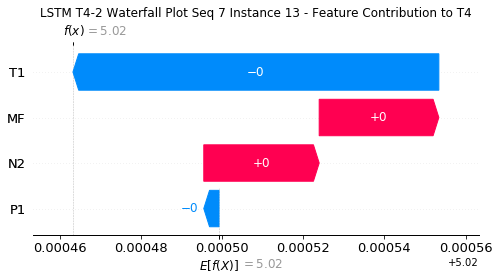

None

Contribution: [-5.16129758e-06 -9.67451377e-05  3.00148733e-05  2.94496618e-05]


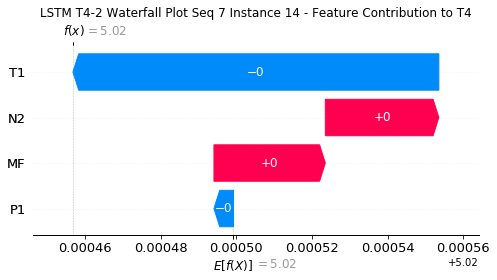

None

Contribution: [-4.75006330e-06 -9.68342599e-05  2.83011872e-05  2.82117975e-05]


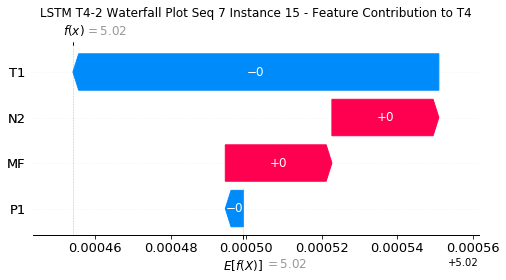

None

Contribution: [-4.49802432e-06 -9.67630087e-05  2.84427971e-05  2.78990295e-05]


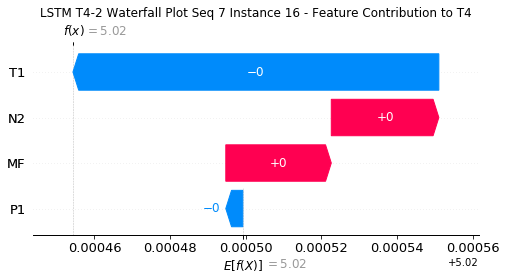

None

Contribution: [-6.09035213e-06 -1.00433007e-04  2.78048546e-05  2.31022200e-05]


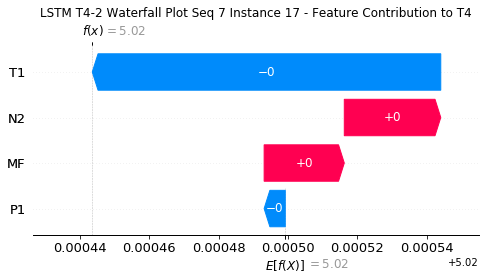

None

Contribution: [-5.88756508e-06 -9.97117459e-05  2.82228388e-05  2.70490366e-05]


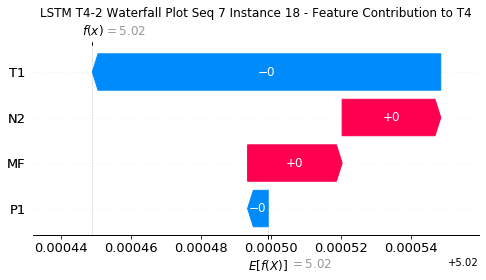

None

Contribution: [-5.83404104e-06 -1.01965477e-04  2.85604153e-05  2.73758753e-05]


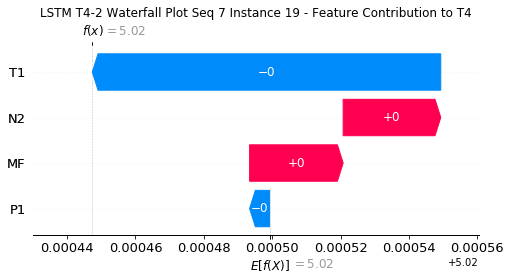

None

Contribution: [-7.10925611e-06 -1.04698917e-04  2.84889888e-05  2.79332118e-05]


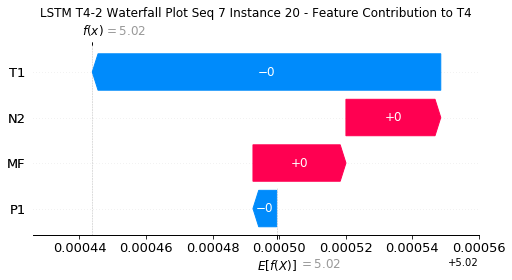

None

Contribution: [-1.03861935e-05 -1.23108971e-04  3.15055213e-05  3.18044167e-05]


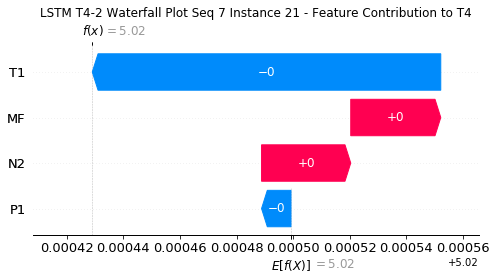

None

Contribution: [-1.59826870e-05 -2.18167074e-04  4.23051803e-05  4.30141389e-05]


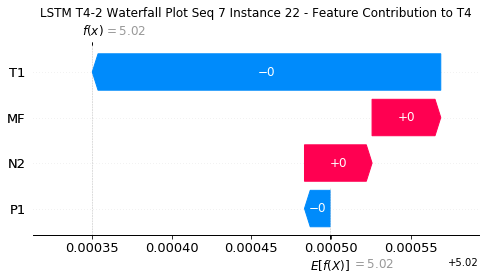

None

Contribution: [-4.31998909e-05 -7.08762001e-04  1.33998064e-04  1.88465265e-04]


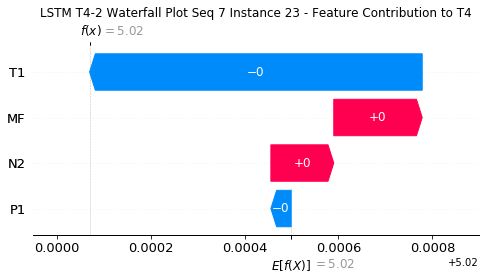

None

Contribution: [-0.00019955 -0.00433998  0.00121347  0.00144262]


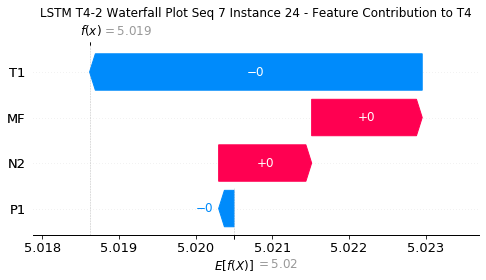

None

Contribution: [-0.00056356 -0.00923738  0.00232071  0.003061  ]


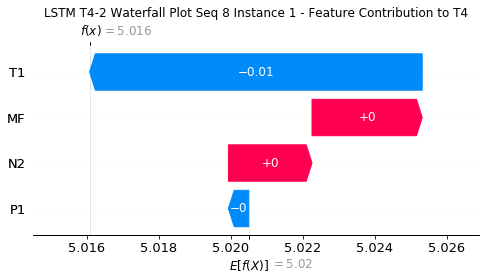

None

Contribution: [-7.66427448e-05 -1.66561446e-03  8.92543910e-04  1.17469143e-03]


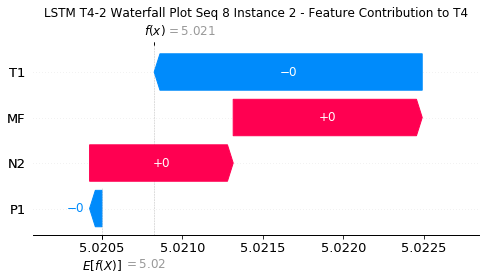

None

Contribution: [ 9.74724999e-06 -3.72010561e-04  1.70495977e-04  1.89761223e-04]


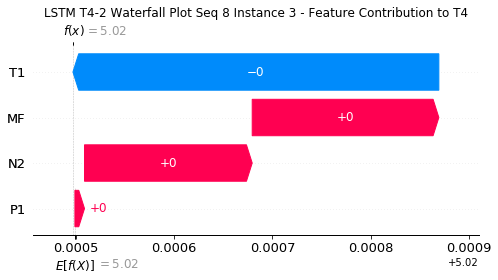

None

Contribution: [-5.71054319e-06 -1.24088216e-04  3.67914220e-05  3.83369477e-05]


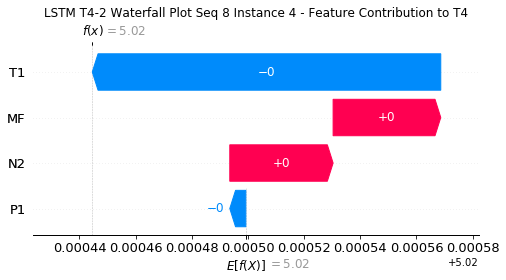

None

Contribution: [-3.18666608e-06 -9.59046121e-05  3.24973729e-05  3.93903994e-05]


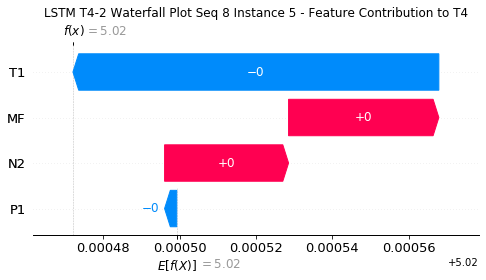

None

Contribution: [-5.85292618e-06 -1.00896352e-04  2.89226233e-05  2.86793919e-05]


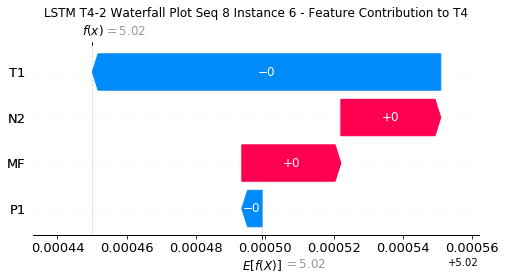

None

Contribution: [-7.48402572e-06 -8.97110314e-05  2.96933899e-05  3.64517350e-05]


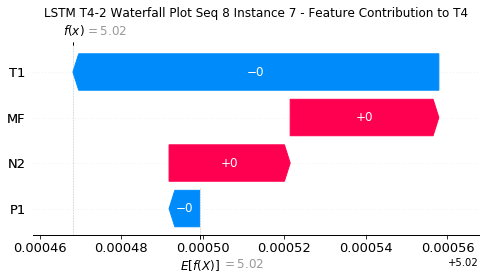

None

Contribution: [-8.56262315e-06 -9.43122471e-05  2.84397499e-05  3.34801012e-05]


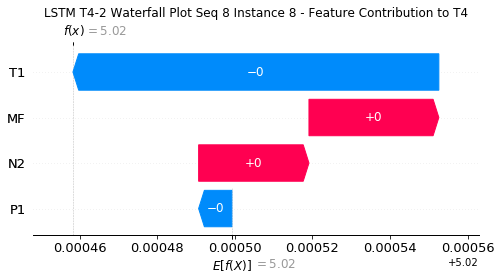

None

Contribution: [-9.26898700e-06 -8.36808299e-05  2.91163304e-05  3.36019638e-05]


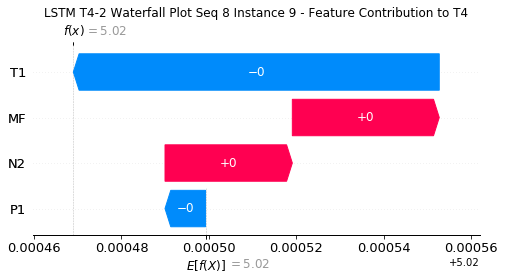

None

Contribution: [-5.67909016e-06 -9.20425179e-05  2.94754168e-05  3.34094941e-05]


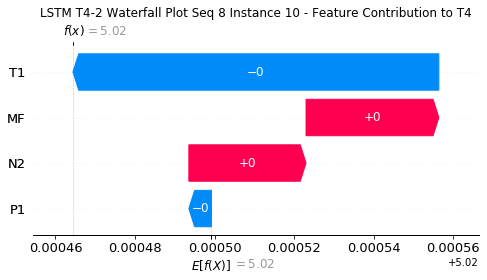

None

Contribution: [-3.96437127e-06 -9.54146029e-05  2.85765305e-05  3.06183405e-05]


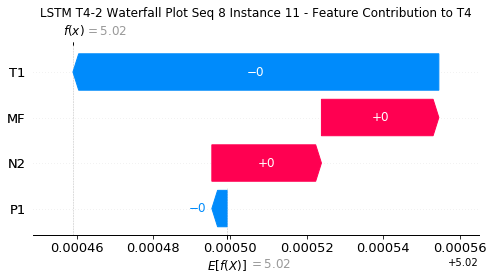

None

Contribution: [-7.18345759e-06 -9.98195180e-05  2.84510199e-05  2.54535617e-05]


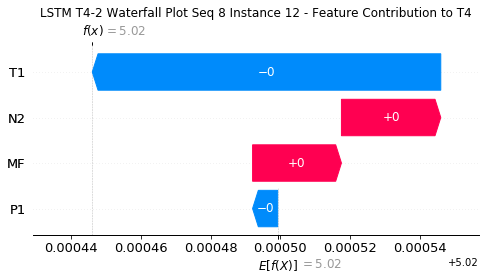

None

Contribution: [-2.47073293e-06 -9.43010737e-05  2.94641044e-05  3.46054779e-05]


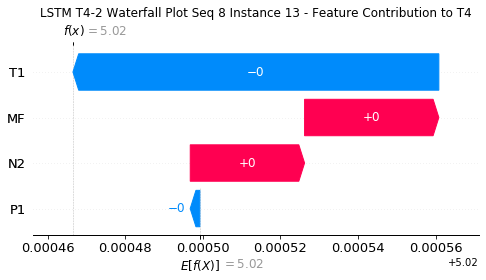

None

Contribution: [-3.57993127e-06 -1.01303470e-04  3.05344374e-05  3.33235152e-05]


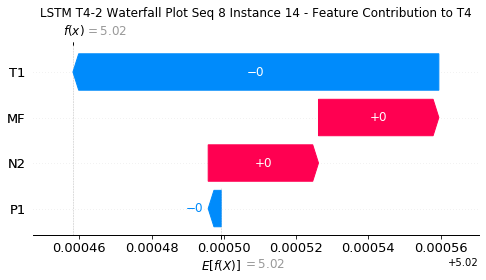

None

Contribution: [-5.40232914e-06 -9.94311853e-05  2.90973457e-05  3.08146216e-05]


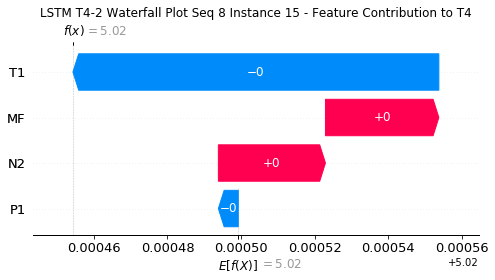

None

Contribution: [-9.28285337e-06 -1.01279253e-04  2.73447644e-05  2.26303357e-05]


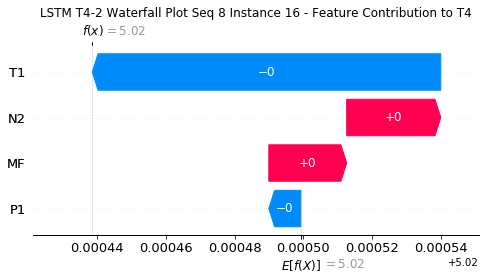

None

Contribution: [-1.10680655e-05 -9.98445760e-05  2.87292923e-05  3.03754340e-05]


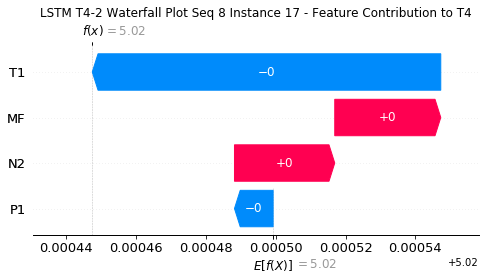

None

Contribution: [-6.35394351e-06 -1.01256207e-04  2.83273533e-05  2.62534045e-05]


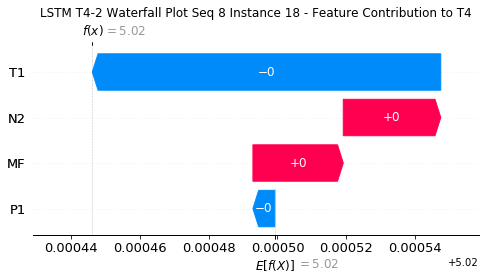

None

Contribution: [-7.91352123e-06 -1.03244195e-04  2.77762843e-05  2.23854863e-05]


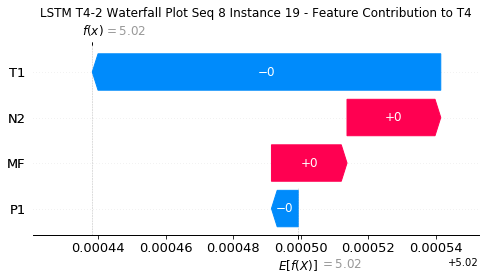

None

Contribution: [-4.81580807e-06 -1.02266227e-04  2.94337894e-05  2.94874494e-05]


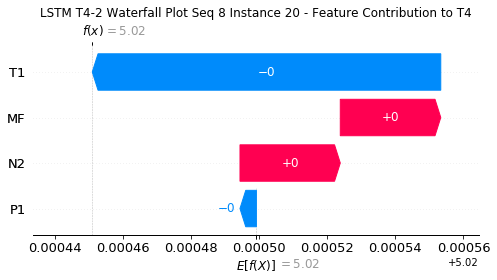

None

Contribution: [-1.25421369e-05 -1.20612247e-04  3.15470991e-05  2.81055633e-05]


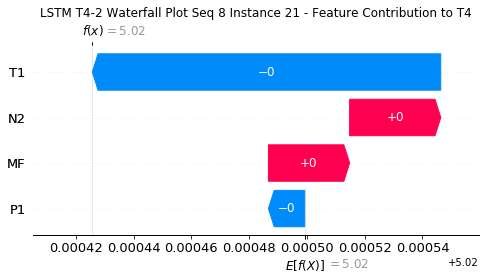

None

Contribution: [-1.06992320e-05 -2.17254699e-04  4.83484308e-05  6.96682544e-05]


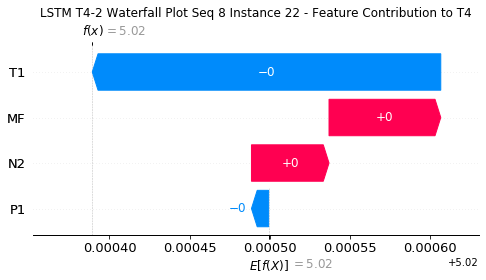

None

Contribution: [-7.37244863e-05 -7.33996205e-04  1.39283693e-04  1.91093521e-04]


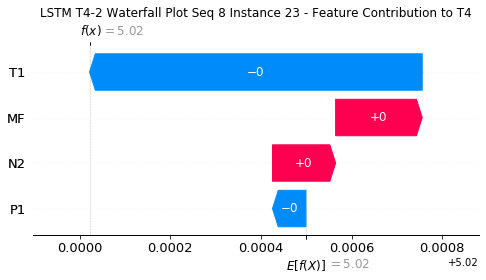

None

Contribution: [-0.00072207 -0.00438976  0.00086695 -0.00083351]


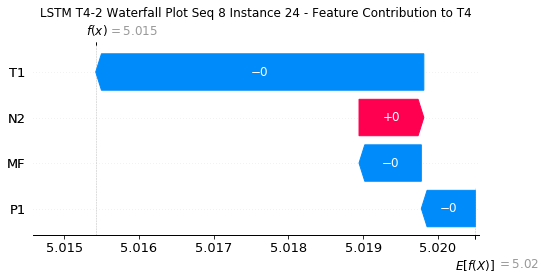

None

Contribution: [-0.00024457 -0.00854734  0.00227627  0.00146649]


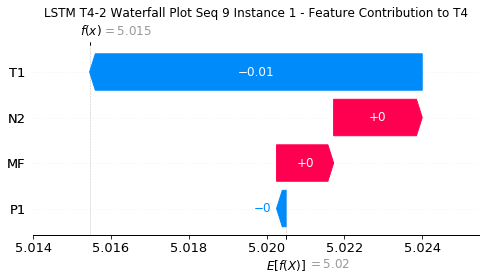

None

Contribution: [-5.05355463e-05 -1.86113125e-03  9.12682987e-04  8.94363135e-04]


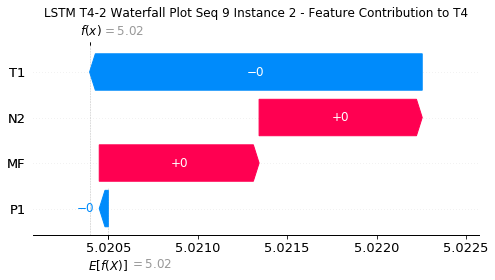

None

Contribution: [-3.54278877e-05 -3.22880507e-04  1.92429189e-04  2.16514128e-04]


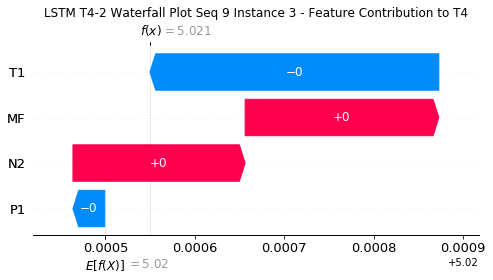

None

Contribution: [-1.18046960e-05 -1.02182115e-04  4.43001678e-05  5.28054776e-05]


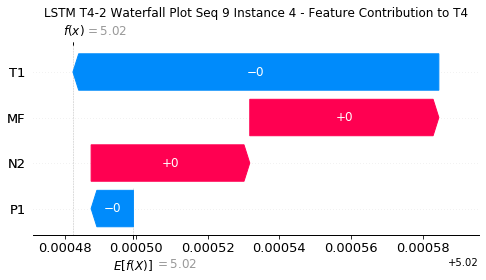

None

Contribution: [-2.34388607e-05 -1.04070798e-04  3.53100058e-05  2.23280283e-05]


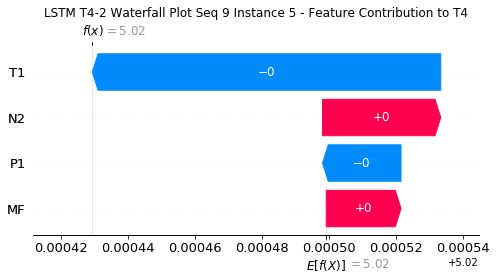

None

Contribution: [-8.20740332e-06 -8.03878563e-05  3.49649656e-05  4.11518764e-05]


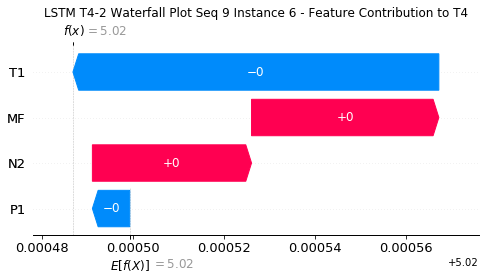

None

Contribution: [-6.48158050e-06 -5.73057504e-05  3.32228853e-05  3.84000708e-05]


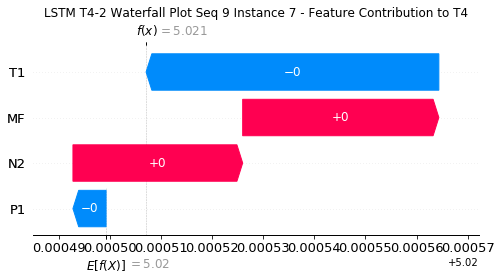

None

Contribution: [-4.06574568e-06 -4.76917030e-05  3.35886117e-05  4.14450959e-05]


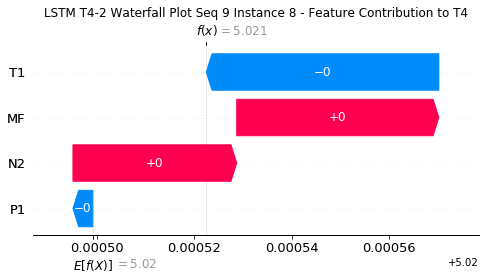

None

Contribution: [-2.24999722e-06 -6.05342648e-05  3.36603836e-05  4.45272833e-05]


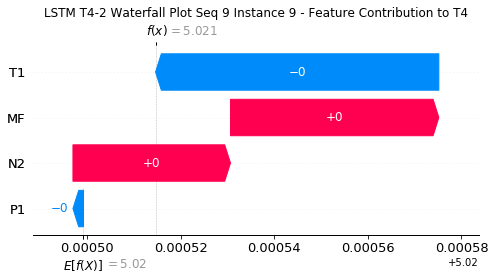

None

Contribution: [-1.97504692e-06 -6.83813391e-05  3.32573028e-05  4.26749167e-05]


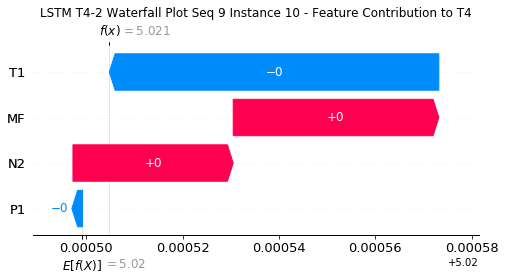

None

Contribution: [-6.28734029e-07 -6.84830467e-05  3.21828907e-05  3.89338510e-05]


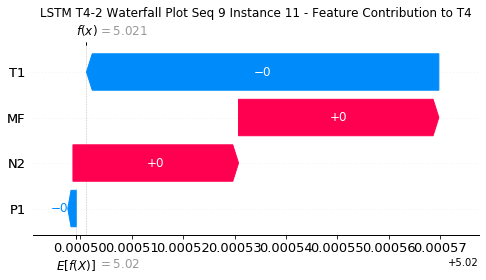

None

Contribution: [-3.38196856e-06 -6.89367851e-05  3.04161994e-05  3.11899293e-05]


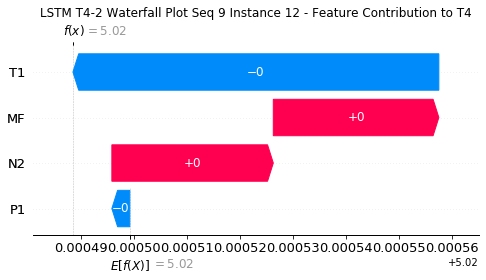

None

Contribution: [-1.47653558e-07 -6.86724477e-05  3.14206450e-05  3.65256116e-05]


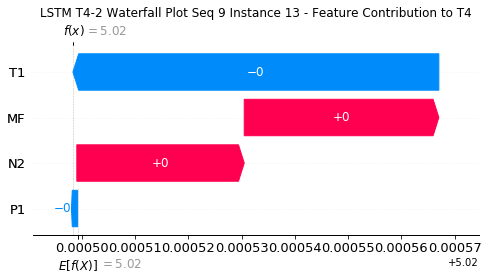

None

Contribution: [-1.34669355e-06 -7.30583342e-05  3.19993153e-05  3.46652863e-05]


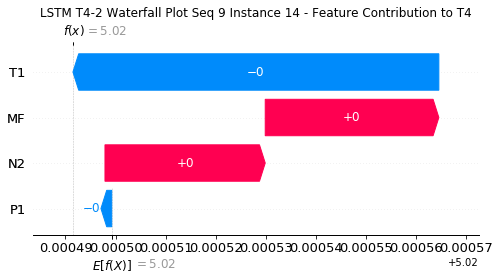

None

Contribution: [ 9.70409736e-07 -6.59781248e-05  3.10220036e-05  3.47473009e-05]


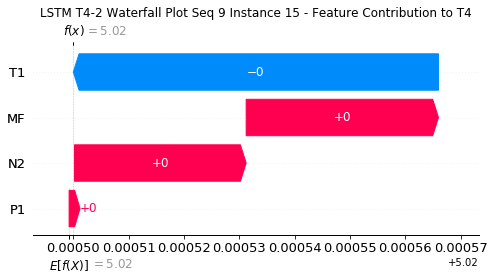

None

Contribution: [ 2.27706473e-06 -6.35430743e-05  3.10272507e-05  3.68118671e-05]


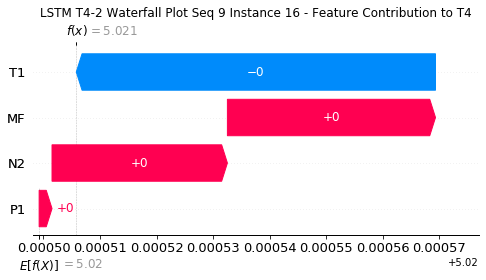

None

Contribution: [-7.10812173e-06 -5.97151360e-05  3.07892079e-05  3.11823425e-05]


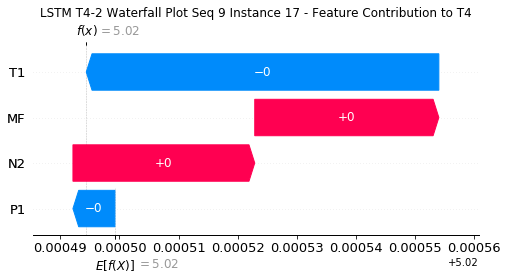

None

Contribution: [-1.69534353e-06 -6.51599672e-05  3.01909682e-05  2.95024868e-05]


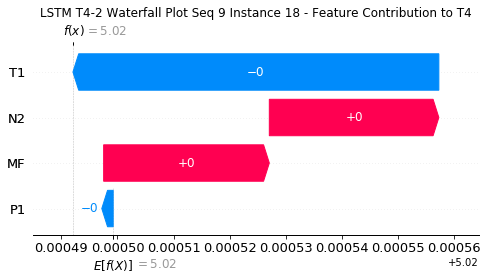

None

Contribution: [-6.46797235e-07 -6.64611316e-05  3.04494458e-05  3.09819193e-05]


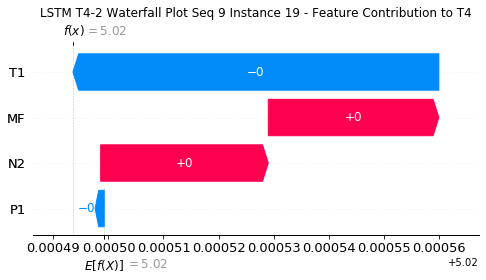

None

Contribution: [-2.23361555e-06 -7.00338771e-05  3.03130361e-05  2.90264427e-05]


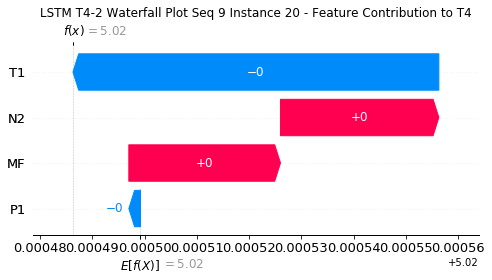

None

Contribution: [-1.23402031e-06 -7.87663692e-05  3.38284781e-05  3.74907528e-05]


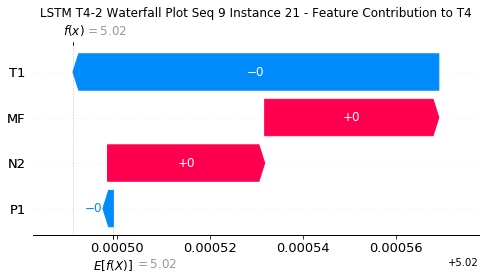

None

Contribution: [-5.70330642e-06 -1.48069600e-04  4.50089763e-05  3.99875827e-05]


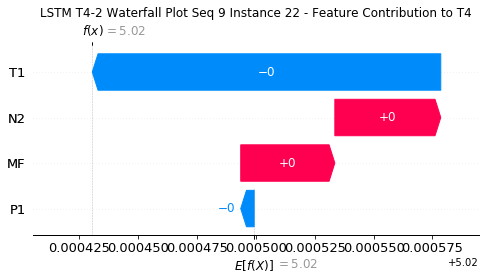

None

Contribution: [-5.81432740e-05 -3.88563763e-04  1.26104794e-04  1.21516923e-04]


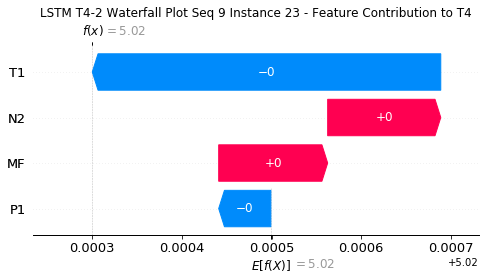

None

Contribution: [-0.00010468 -0.00227737  0.00119093  0.00160685]


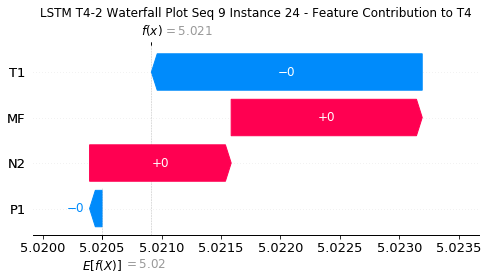

None

Contribution: [-0.00060364 -0.00543833  0.00227497  0.00238633]


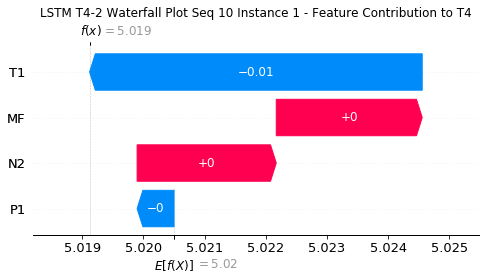

None

Contribution: [-7.66066464e-05 -1.00697127e-03  8.86961158e-04  1.00477655e-03]


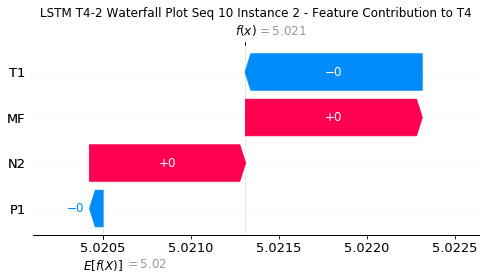

None

Contribution: [ 1.94487862e-05 -2.05958169e-04  1.79067797e-04  1.97628424e-04]


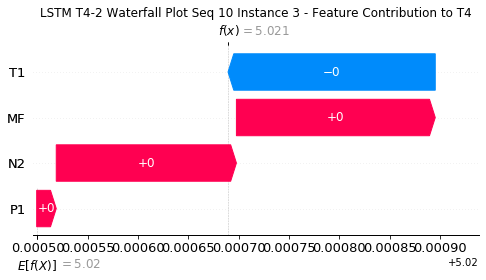

None

Contribution: [ 1.41960105e-06 -7.22687026e-05  4.05023736e-05  4.63276625e-05]


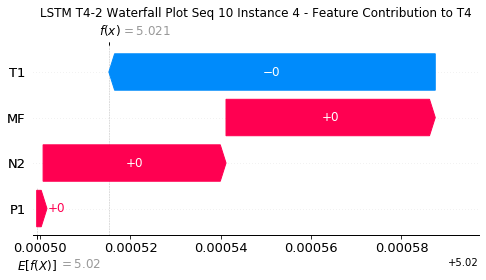

None

Contribution: [-8.80148730e-07 -5.90383163e-05  3.48690882e-05  5.19462736e-05]


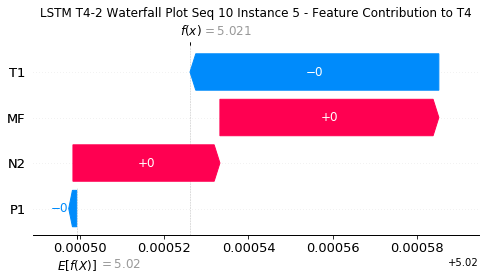

None

Contribution: [ 4.13089355e-07 -6.20145623e-05  3.21407050e-05  3.68906957e-05]


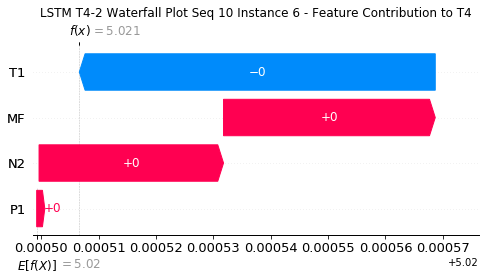

None

Contribution: [-7.60440312e-06 -6.39014137e-05  2.99789782e-05  2.47851003e-05]


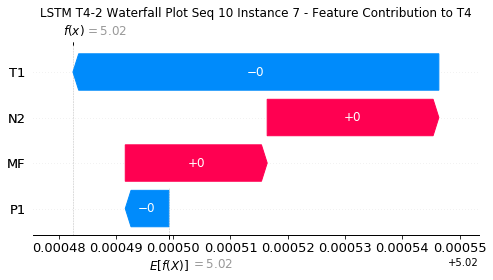

None

Contribution: [ 3.80989408e-06 -5.91107772e-05  3.30013315e-05  4.71116411e-05]


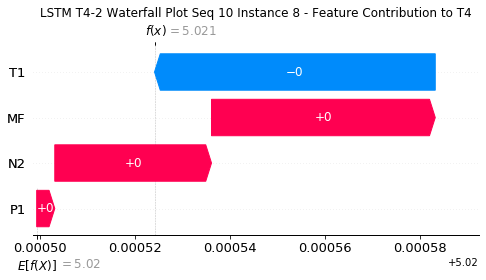

None

Contribution: [-2.94955565e-06 -6.03616510e-05  3.18828492e-05  3.99335763e-05]


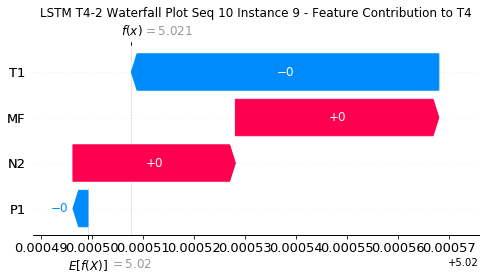

None

Contribution: [ 7.75291487e-07 -6.27639967e-05  3.22084217e-05  4.26128805e-05]


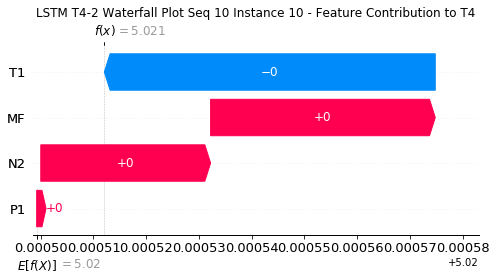

None

Contribution: [ 1.85325859e-06 -6.56062503e-05  3.08766302e-05  3.71198873e-05]


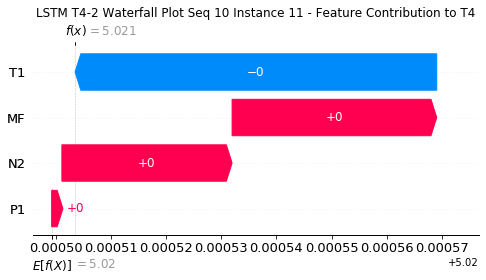

None

Contribution: [-2.23410742e-07 -7.59161190e-05  2.95429341e-05  3.04652338e-05]


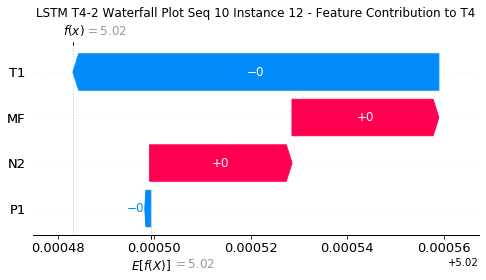

None

Contribution: [ 2.40692965e-06 -6.80308388e-05  3.09689635e-05  3.98528027e-05]


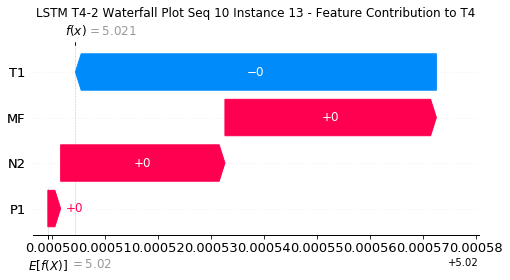

None

Contribution: [-1.57596642e-06 -6.42774445e-05  3.16193430e-05  4.37758647e-05]


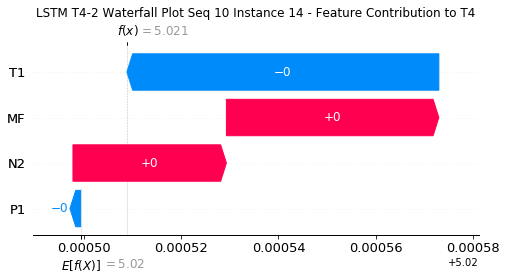

None

Contribution: [ 1.98256423e-06 -7.09523075e-05  3.05992281e-05  3.75934910e-05]


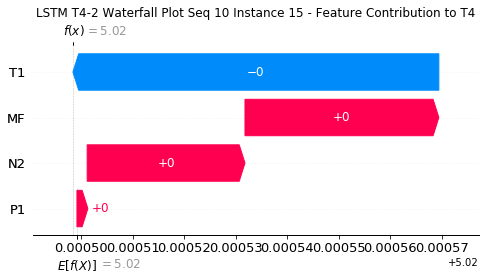

None

Contribution: [ 2.31939259e-06 -7.07505739e-05  3.03207061e-05  3.75937107e-05]


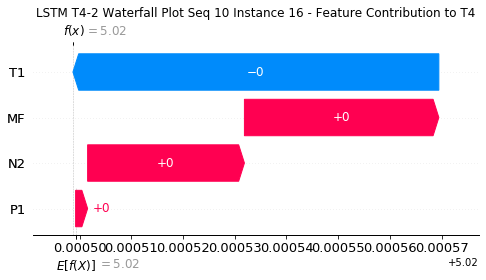

None

Contribution: [-1.71202786e-06 -7.36617587e-05  3.02905937e-05  3.52818925e-05]


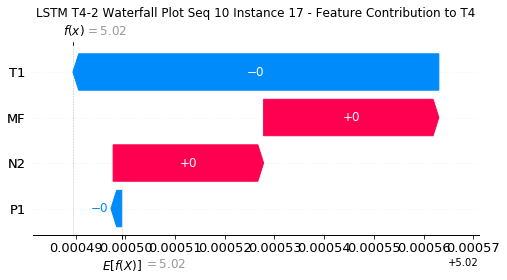

None

Contribution: [ 1.56752866e-06 -7.32958627e-05  2.96875187e-05  3.42044876e-05]


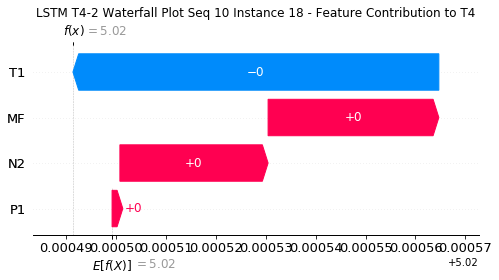

None

Contribution: [ 1.87231010e-06 -7.60372647e-05  3.00743530e-05  3.57706338e-05]


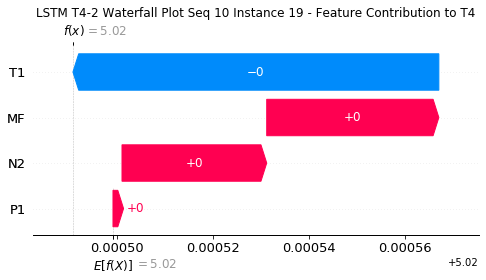

None

Contribution: [ 1.73433244e-06 -8.03914937e-05  3.07794286e-05  3.89072912e-05]


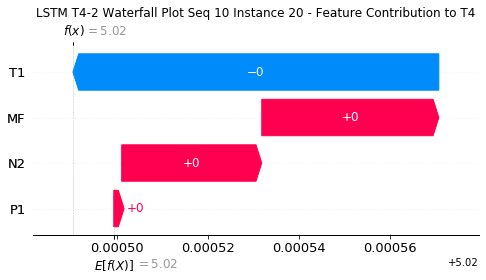

None

Contribution: [ 2.12356755e-07 -9.45599884e-05  3.46913049e-05  4.86655858e-05]


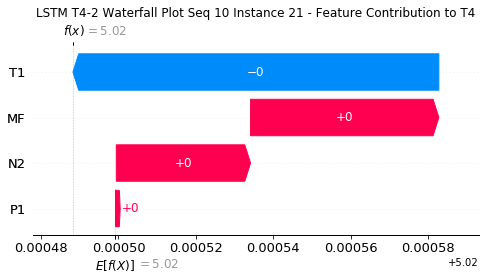

None

Contribution: [ 2.77371051e-06 -1.73133602e-04  4.77805710e-05  6.83584304e-05]


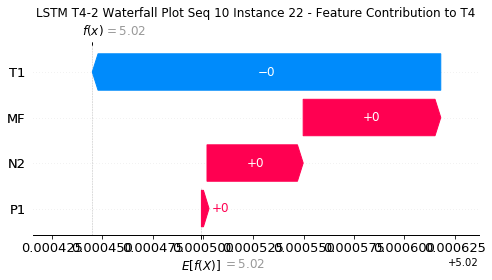

None

Contribution: [-5.58201287e-06 -4.99054648e-04  1.44855281e-04  1.41980148e-04]


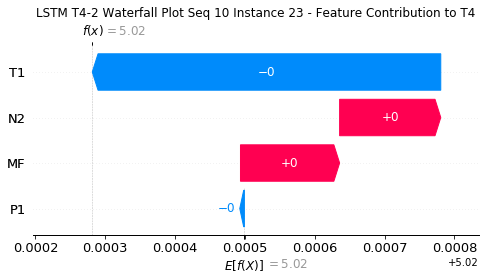

None

Contribution: [ 0.00013328 -0.00277825  0.00125661  0.00160182]


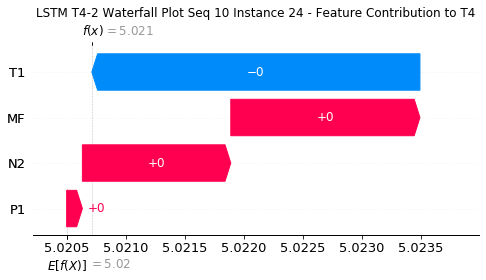

None

Contribution: [ 0.00042595 -0.00605782  0.00255924  0.00358754]


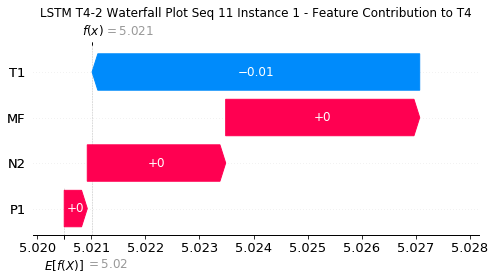

None

Contribution: [ 0.00025365 -0.00086964  0.00092992  0.00134895]


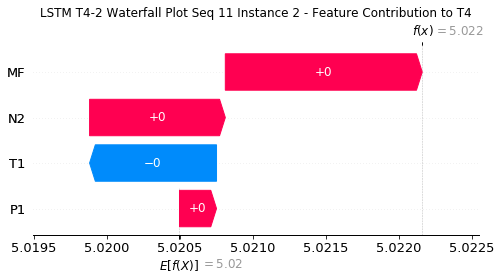

None

Contribution: [ 7.83054075e-05 -2.39532003e-04  1.87241756e-04  2.87665980e-04]


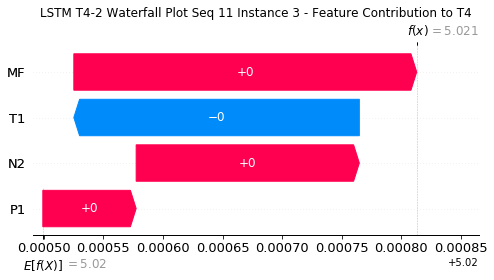

None

Contribution: [ 1.74988236e-05 -9.28698419e-05  4.27742361e-05  7.07611975e-05]


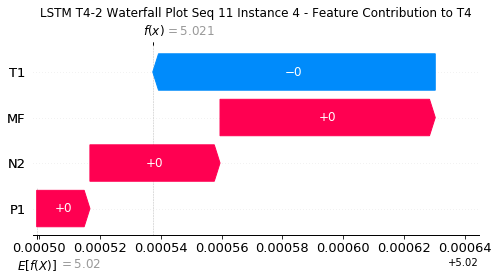

None

Contribution: [ 1.84346842e-05 -5.51202423e-05  3.69104411e-05  6.01532564e-05]


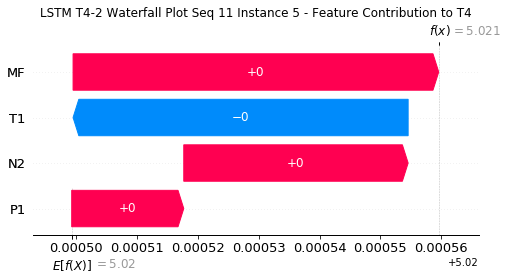

None

Contribution: [ 1.36916716e-05 -7.35536713e-05  3.40997156e-05  5.50162848e-05]


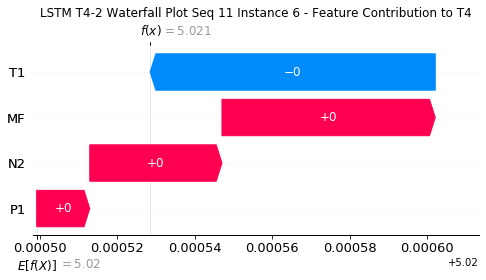

None

Contribution: [ 1.04519185e-05 -5.32530747e-05  3.51881966e-05  5.15004322e-05]


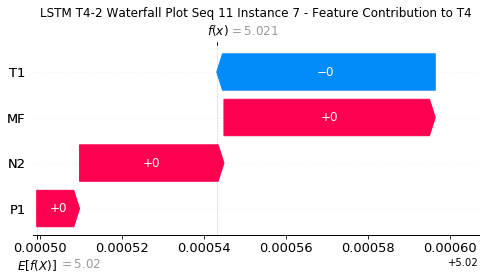

None

Contribution: [ 1.08021792e-05 -5.51845584e-05  3.46583625e-05  5.15011362e-05]


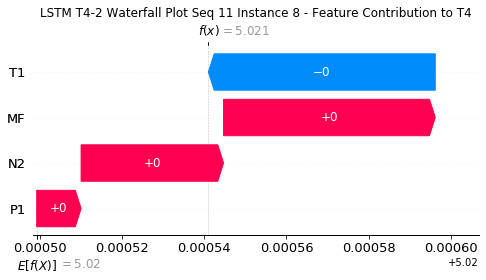

None

Contribution: [ 9.85265724e-06 -4.93482622e-05  3.44190592e-05  5.17788217e-05]


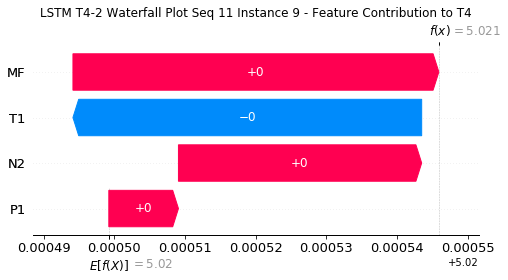

None

Contribution: [ 7.98368655e-06 -1.03954167e-04  3.28608057e-05  5.05172686e-05]


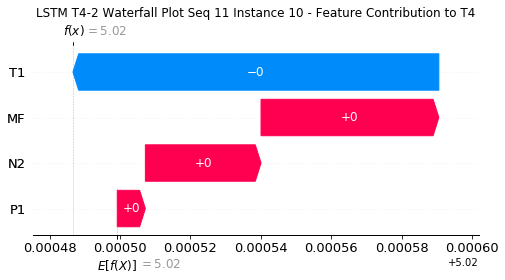

None

Contribution: [ 9.64296752e-06 -1.05333021e-04  3.18652972e-05  4.70649595e-05]


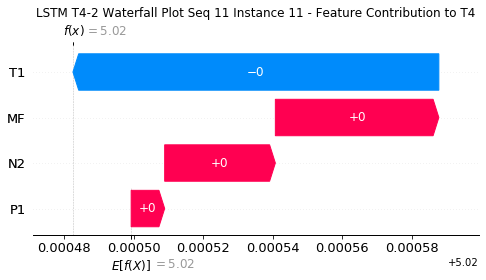

None

Contribution: [ 4.24085999e-06 -1.37266174e-04  3.15796828e-05  4.75307032e-05]


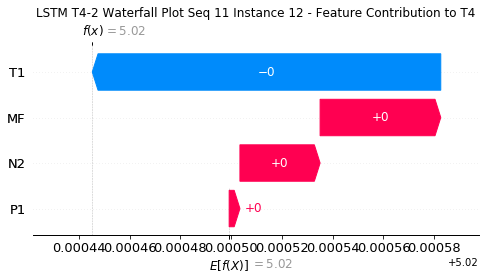

None

Contribution: [ 8.47914422e-06 -1.07979104e-04  3.13759393e-05  4.46257613e-05]


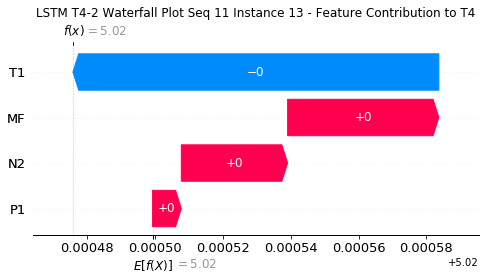

None

Contribution: [ 4.06100987e-06 -1.34343862e-04  3.45604037e-05  5.12188068e-05]


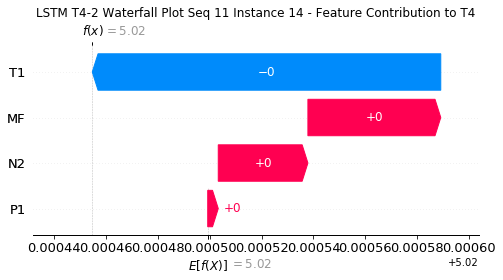

None

Contribution: [ 7.33529461e-06 -1.10299919e-04  3.08362176e-05  4.01140841e-05]


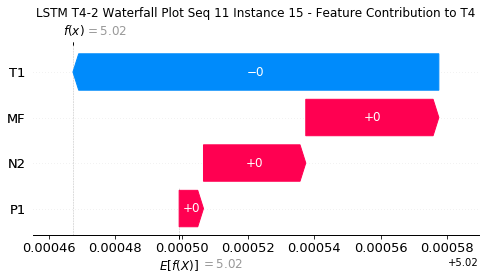

None

Contribution: [ 7.91900800e-06 -1.03328702e-04  3.01931216e-05  3.96618209e-05]


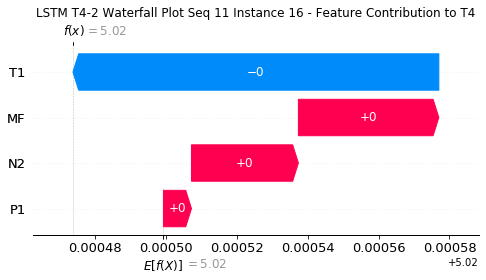

None

Contribution: [ 8.00808100e-06 -8.84697264e-05  3.20619433e-05  5.36437708e-05]


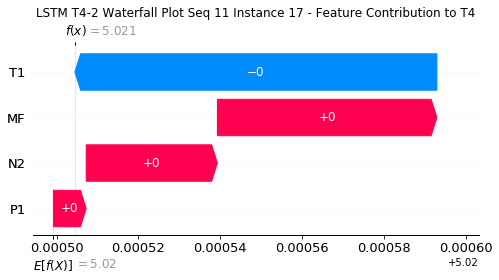

None

Contribution: [ 8.81659697e-06 -8.32355992e-05  2.96233947e-05  3.59919980e-05]


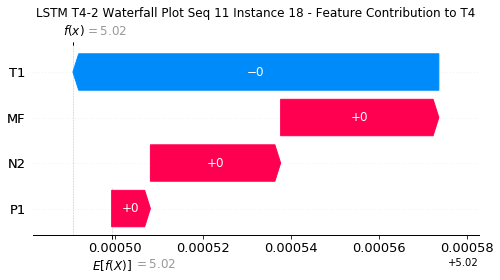

None

Contribution: [ 9.08712147e-06 -8.34762486e-05  2.96469272e-05  3.61942000e-05]


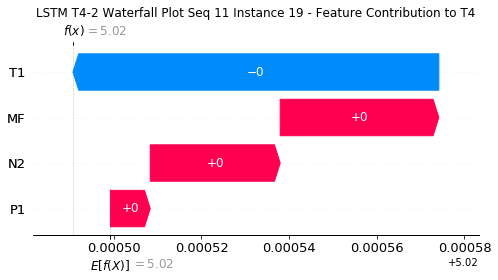

None

Contribution: [ 8.40306269e-06 -8.42735354e-05  2.99150860e-05  3.65259989e-05]


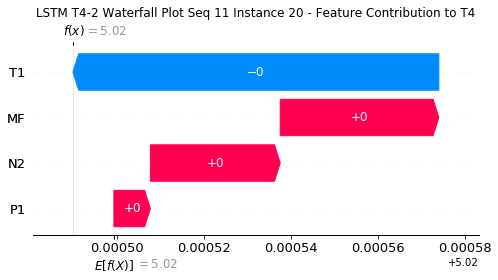

None

Contribution: [ 5.74055858e-06 -1.09309381e-04  3.30030871e-05  4.17839237e-05]


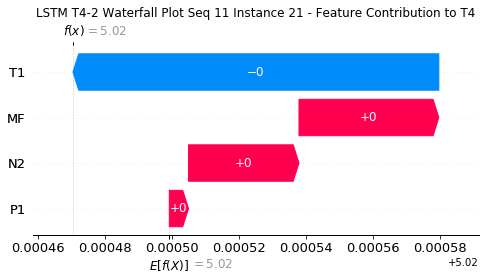

None

Contribution: [ 1.25807118e-05 -1.79098162e-04  4.45479009e-05  5.75762295e-05]


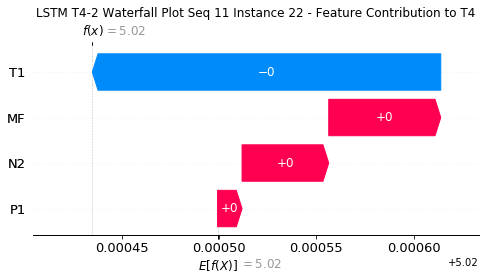

None

Contribution: [ 7.77286747e-05 -3.47444636e-04  1.60950450e-04  2.95119415e-04]


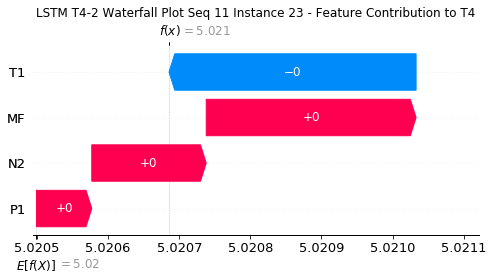

None

Contribution: [ 0.00054508 -0.00185946  0.00132911  0.0020745 ]


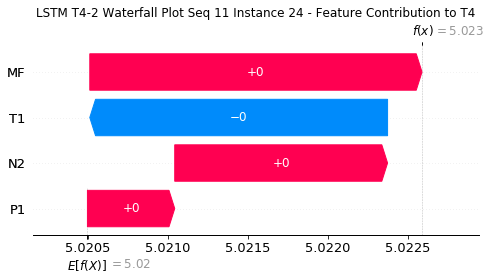

None

Contribution: [ 0.00101295 -0.00476896  0.00269618  0.00395569]


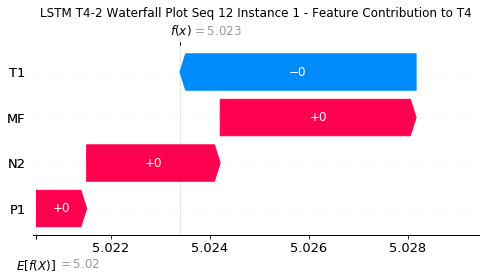

None

Contribution: [ 0.00027424 -0.00060472  0.00093688  0.00118748]


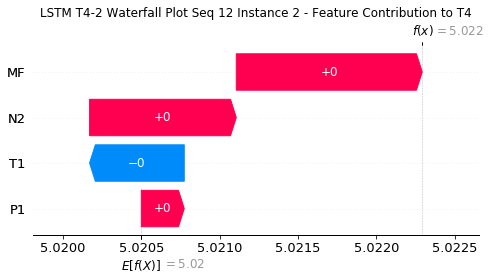

None

Contribution: [ 8.77275481e-05 -1.28923666e-04  1.93633532e-04  2.42467459e-04]


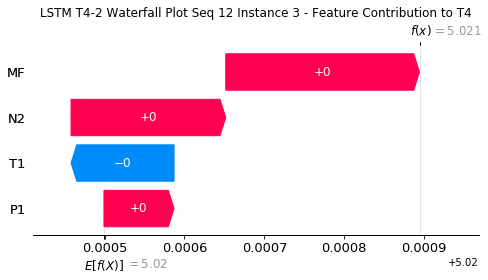

None

Contribution: [ 2.15053828e-05 -4.62785140e-05  4.41784487e-05  5.84638501e-05]


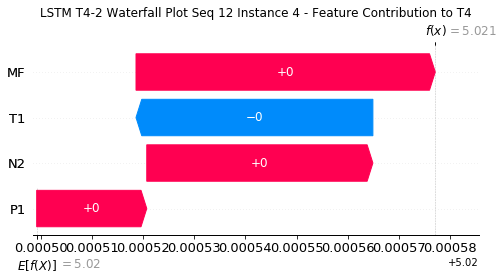

None

Contribution: [ 9.88652535e-06 -4.09701057e-05  3.72677784e-05  4.68728925e-05]


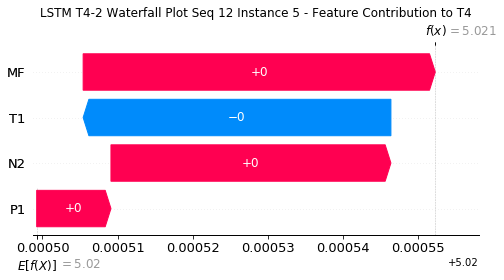

None

Contribution: [ 1.70177504e-05 -3.85482383e-05  3.50605539e-05  4.84369749e-05]


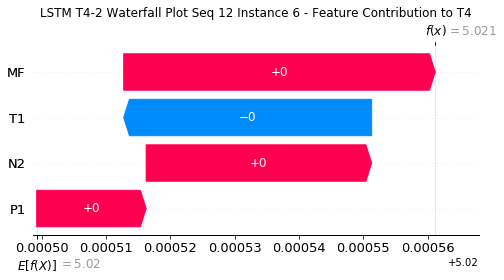

None

Contribution: [ 1.85921960e-05 -3.54987488e-05  3.67895993e-05  6.25116019e-05]


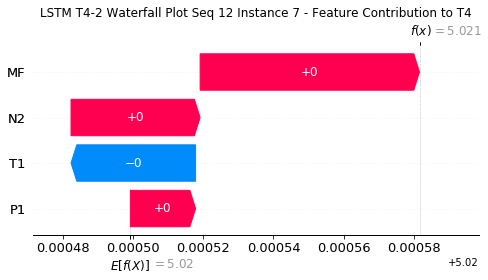

None

Contribution: [ 1.46718559e-05 -4.06862736e-05  3.35294563e-05  4.42315945e-05]


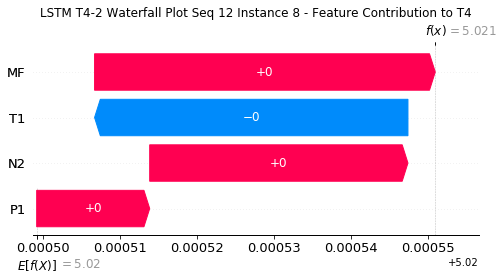

None

Contribution: [ 1.37882051e-05 -3.69656571e-05  3.44002434e-05  5.28907714e-05]


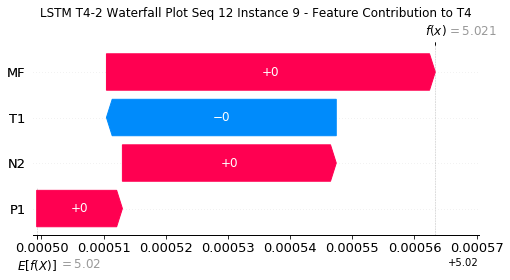

None

Contribution: [ 1.44815459e-05 -3.46395208e-05  3.24548497e-05  5.07169501e-05]


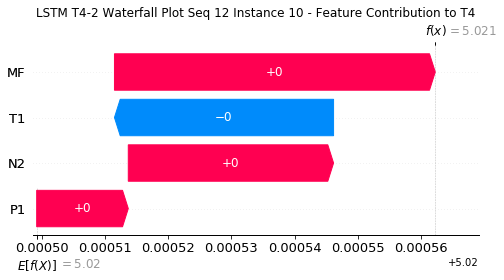

None

Contribution: [ 1.70205194e-05 -3.58827080e-05  3.17182711e-05  4.98308997e-05]


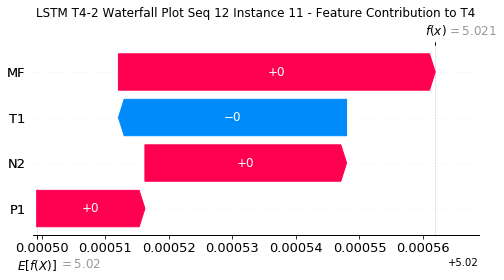

None

Contribution: [ 8.56211155e-06 -4.03860999e-05  2.72515702e-05  3.56994831e-05]


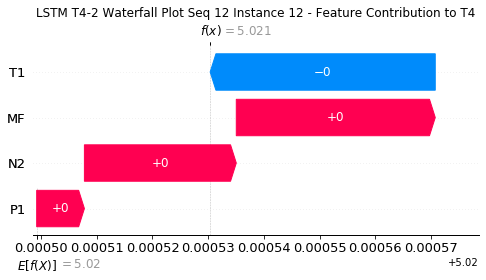

None

Contribution: [ 1.59106123e-05 -3.64079256e-05  3.07612327e-05  5.04920482e-05]


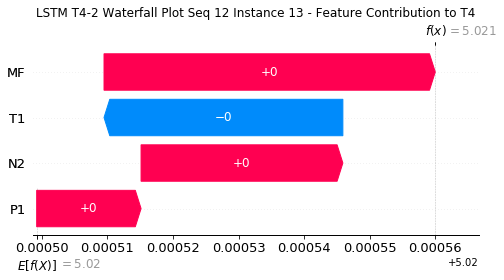

None

Contribution: [ 1.74000318e-05 -3.34855946e-05  3.22719914e-05  6.95729265e-05]


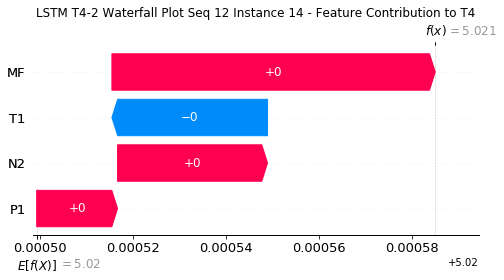

None

Contribution: [ 1.59174360e-05 -3.73955104e-05  3.02007323e-05  5.14888401e-05]


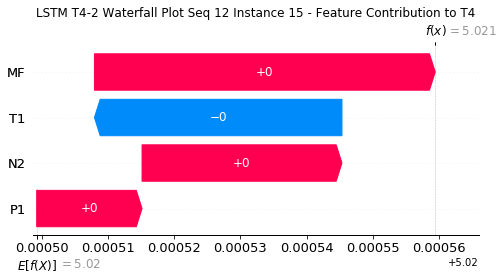

None

Contribution: [ 1.54753480e-05 -3.65176696e-05  2.93652901e-05  4.95185405e-05]


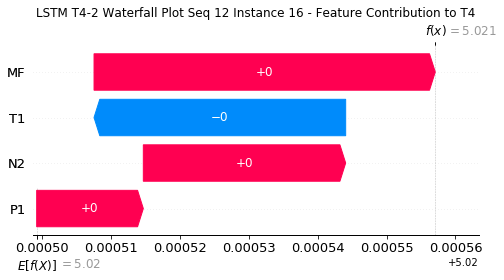

None

Contribution: [ 9.12151646e-06 -4.23747660e-05  2.81139911e-05  4.01268559e-05]


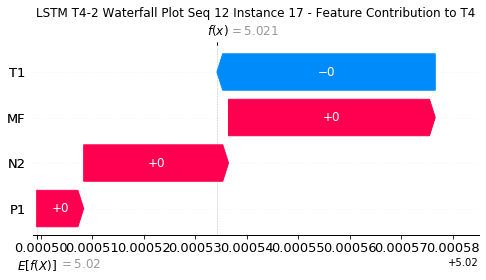

None

Contribution: [ 1.54239586e-05 -3.67273635e-05  2.94966333e-05  5.11024947e-05]


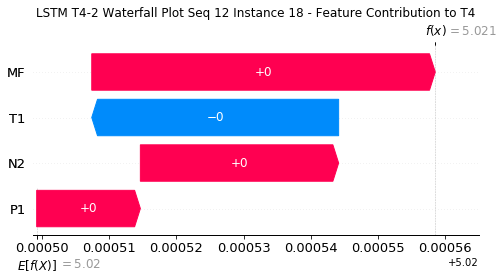

None

Contribution: [ 1.50406199e-05 -3.79412064e-05  2.93232521e-05  5.05724564e-05]


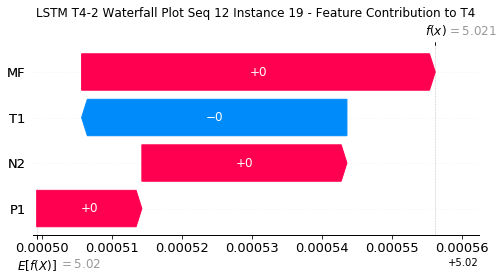

None

Contribution: [ 1.39584454e-05 -3.92220803e-05  2.93855817e-05  5.17850502e-05]


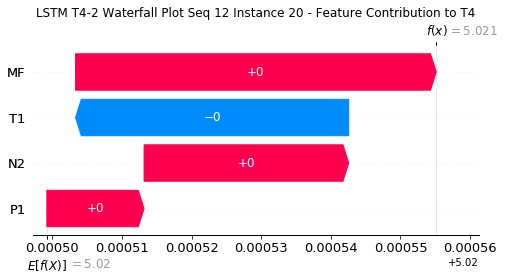

None

Contribution: [ 1.19689837e-05 -4.67983809e-05  3.13879638e-05  5.72793301e-05]


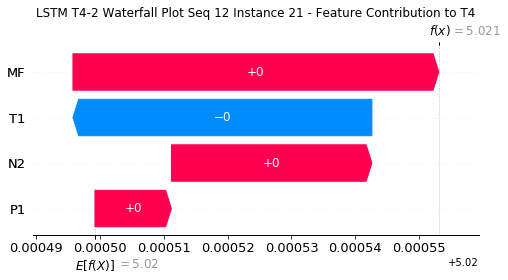

None

Contribution: [ 2.11200319e-05 -9.10257688e-05  4.12649383e-05  8.62405929e-05]


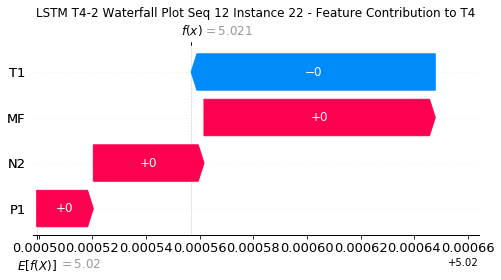

None

Contribution: [ 6.56649699e-05 -2.46030031e-04  1.37064302e-04  2.58531993e-04]


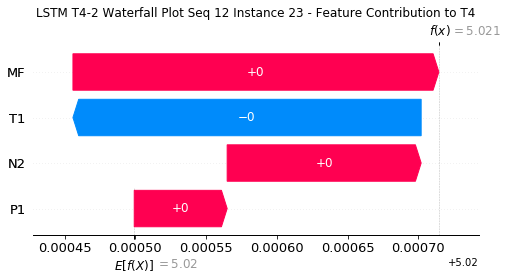

None

Contribution: [ 0.00049266 -0.00115216  0.00125983  0.00178849]


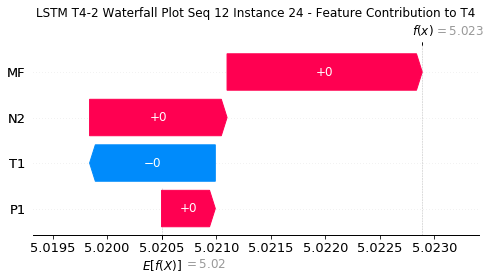

None

Contribution: [ 0.00109632 -0.00262211  0.00255019  0.00414568]


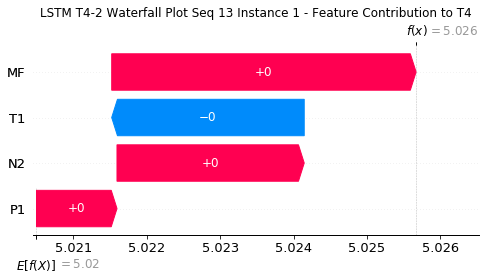

None

Contribution: [ 0.00034088 -0.00044565  0.00091778  0.00141238]


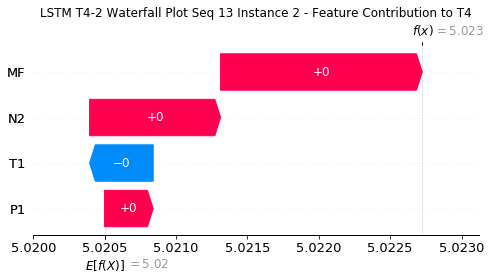

None

Contribution: [ 7.78927495e-05 -1.21612737e-04  1.88826177e-04  2.77007627e-04]


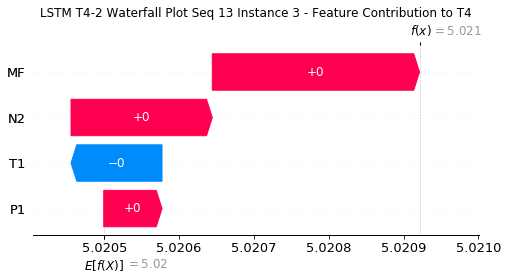

None

Contribution: [ 1.97392643e-05 -4.79469049e-05  4.34762874e-05  7.15422295e-05]


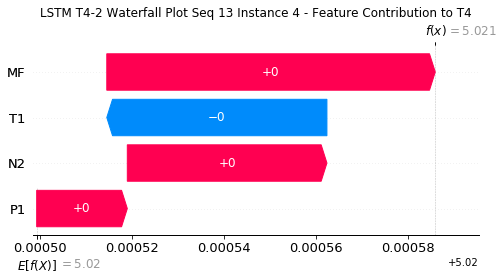

None

Contribution: [ 2.20828798e-05 -4.10980606e-05  3.75657567e-05  6.57328896e-05]


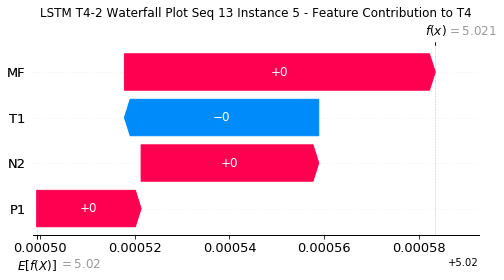

None

Contribution: [ 1.45434507e-05 -4.22438795e-05  3.40722293e-05  5.48182379e-05]


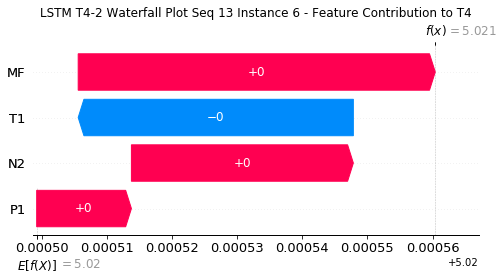

None

Contribution: [ 3.81664250e-06 -4.81763082e-05  3.02048896e-05  3.60867797e-05]


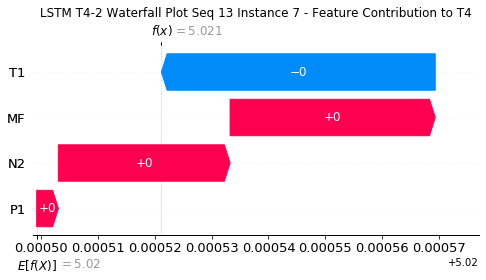

None

Contribution: [ 6.85852814e-06 -5.33044003e-05  3.03254335e-05  4.34576309e-05]


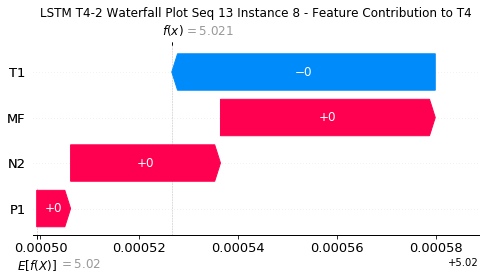

None

Contribution: [ 8.37543382e-06 -4.72065461e-05  3.06250938e-05  4.62899072e-05]


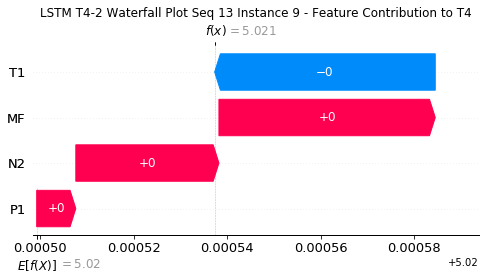

None

Contribution: [ 1.48684273e-05 -4.65931520e-05  3.31916850e-05  5.94499978e-05]


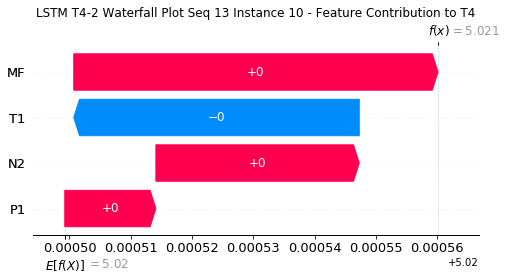

None

Contribution: [ 1.52919431e-05 -4.81812581e-05  3.20801116e-05  5.41878587e-05]


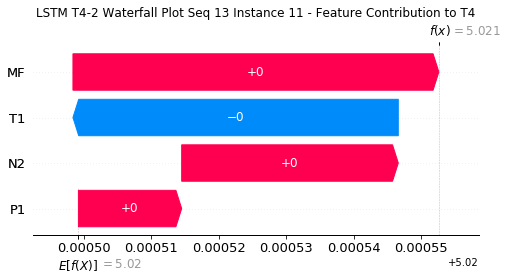

None

Contribution: [ 1.52353674e-05 -5.08758705e-05  3.15957644e-05  5.81585167e-05]


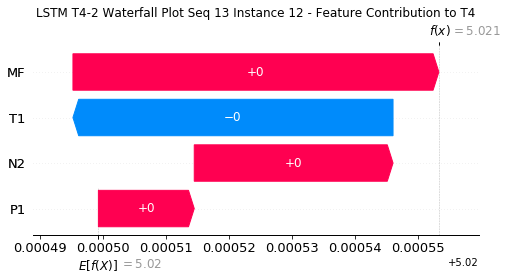

None

Contribution: [ 1.51886798e-05 -4.93891546e-05  3.17620857e-05  5.39515748e-05]


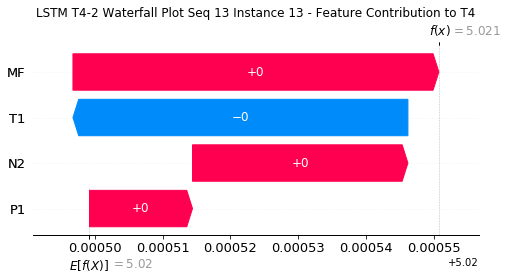

None

Contribution: [ 8.12857949e-06 -5.37823124e-05  3.10962585e-05  4.41696241e-05]


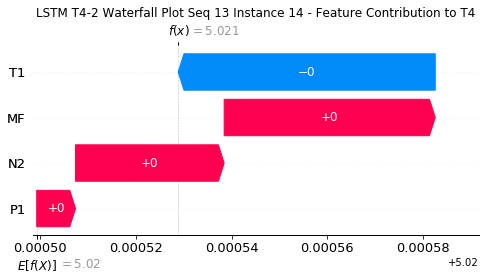

None

Contribution: [ 1.33820969e-05 -5.27928134e-05  3.11664846e-05  4.96634537e-05]


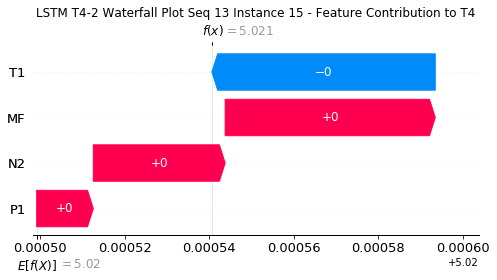

None

Contribution: [ 1.29632370e-05 -5.14953164e-05  3.08030765e-05  4.95129404e-05]


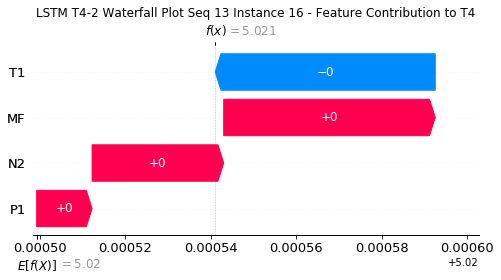

None

Contribution: [ 9.36551243e-06 -4.13076577e-05  3.16442372e-05  4.90353830e-05]


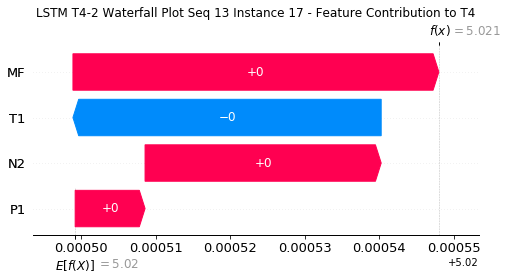

None

Contribution: [ 9.63246316e-06 -4.75775306e-05  3.03770643e-05  4.17181727e-05]


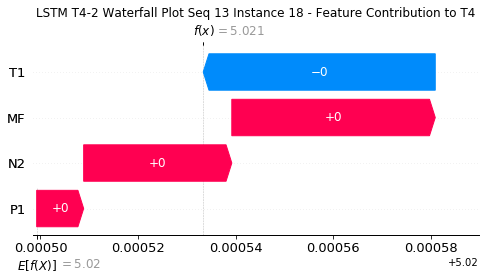

None

Contribution: [ 9.94226438e-06 -4.92300982e-05  3.06231971e-05  4.33175245e-05]


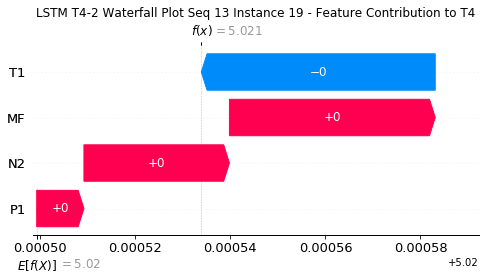

None

Contribution: [ 9.64166539e-06 -4.93060262e-05  3.11696150e-05  4.49394464e-05]


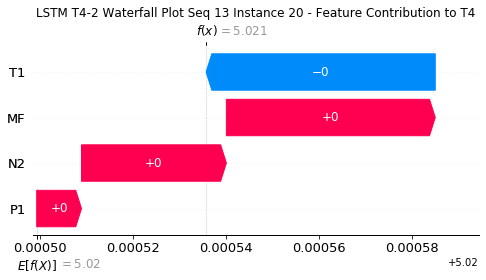

None

Contribution: [ 9.88357066e-06 -6.16139895e-05  3.45694510e-05  5.57968978e-05]


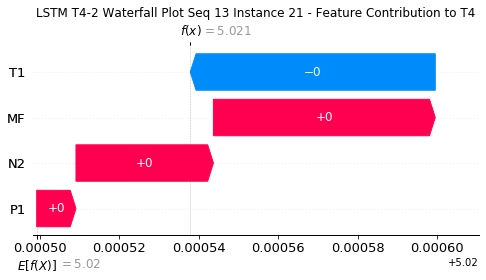

None

Contribution: [ 1.67365064e-05 -1.05044769e-04  4.74862109e-05  7.99988940e-05]


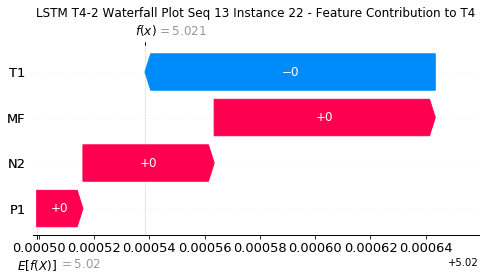

None

Contribution: [ 1.61969430e-05 -2.37147711e-04  1.44412462e-04  2.37506653e-04]


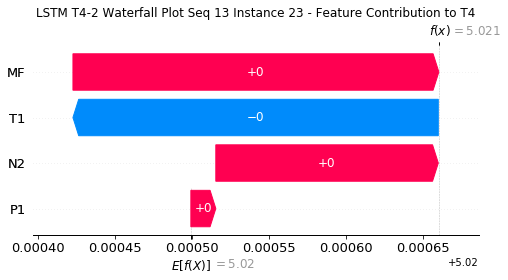

None

Contribution: [ 0.00025899 -0.00161405  0.00126878  0.0018037 ]


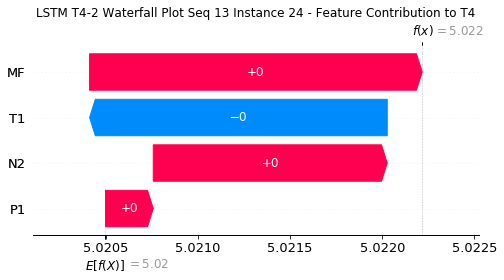

None

Contribution: [ 0.00058505 -0.00327856  0.00256179  0.00347033]


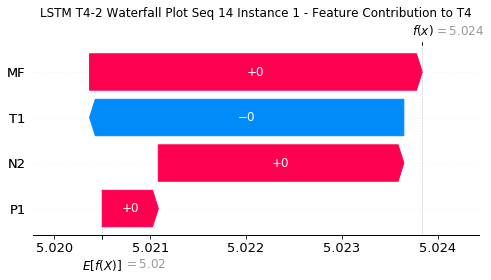

None

Contribution: [ 0.00018374 -0.00053969  0.00091105  0.00105622]


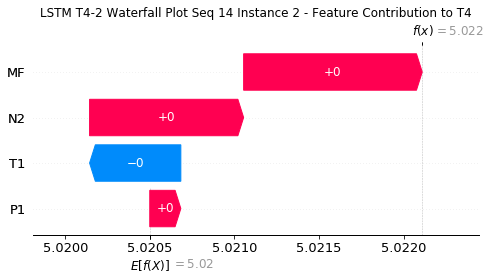

None

Contribution: [ 7.02343800e-05 -1.33979380e-04  1.94903100e-04  2.61033686e-04]


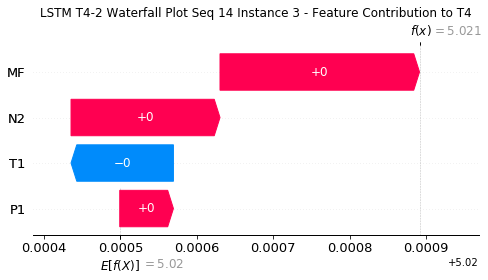

None

Contribution: [ 1.56243349e-05 -4.61984952e-05  4.49095700e-05  6.52128294e-05]


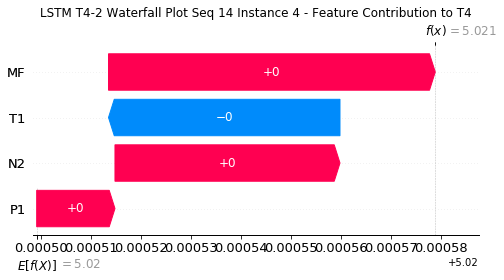

None

Contribution: [ 1.01641609e-05 -6.06163246e-05  3.62142591e-05  4.98499860e-05]


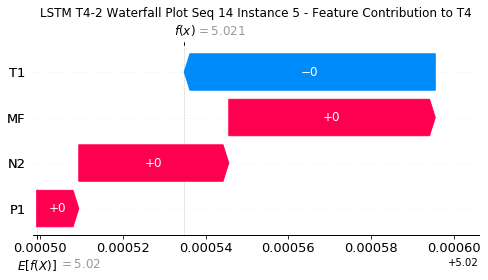

None

Contribution: [ 1.13096944e-05 -3.78483581e-05  3.54080394e-05  5.12500936e-05]


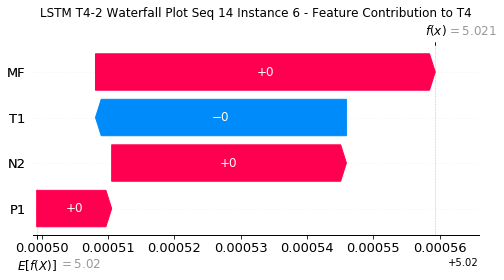

None

Contribution: [ 5.27957366e-06 -3.60904939e-05  3.36738046e-05  4.38443783e-05]


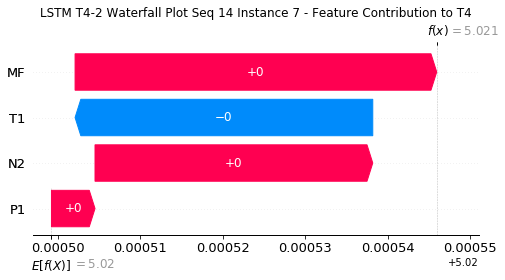

None

Contribution: [ 5.31753659e-06 -2.78793821e-05  3.32233797e-05  4.43415909e-05]


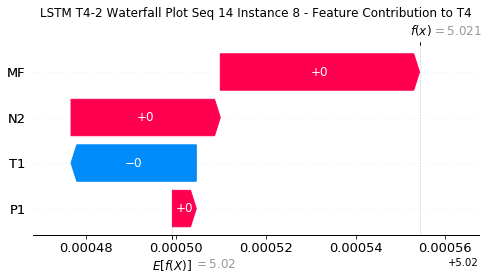

None

Contribution: [ 6.83353224e-06 -2.63725666e-05  3.35925091e-05  4.90874644e-05]


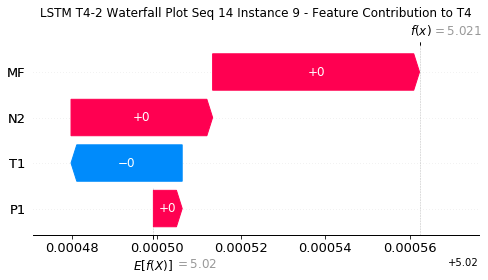

None

Contribution: [ 7.41145802e-06 -3.30881805e-05  3.28290466e-05  4.74272909e-05]


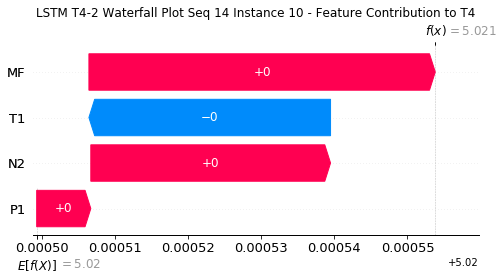

None

Contribution: [ 8.73507076e-06 -3.56666274e-05  3.19346920e-05  4.43885756e-05]


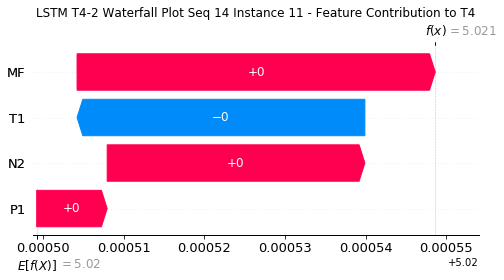

None

Contribution: [ 5.78997061e-06 -3.59417714e-05  3.28780984e-05  5.08633312e-05]


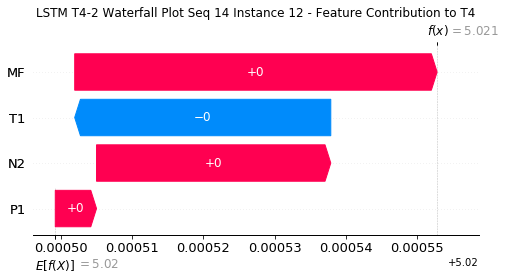

None

Contribution: [ 8.00115566e-06 -3.40209425e-05  3.15961745e-05  4.44677934e-05]


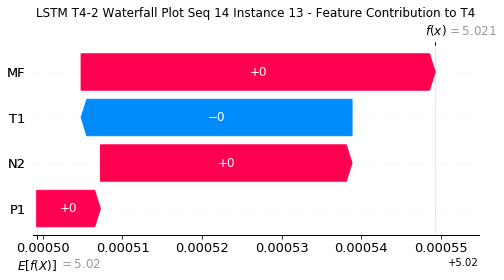

None

Contribution: [ 1.49390168e-06 -3.99590172e-05  3.22227878e-05  4.71053896e-05]


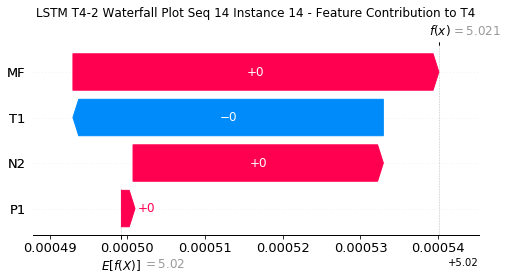

None

Contribution: [ 6.51846148e-06 -3.57062724e-05  3.09438415e-05  4.33278851e-05]


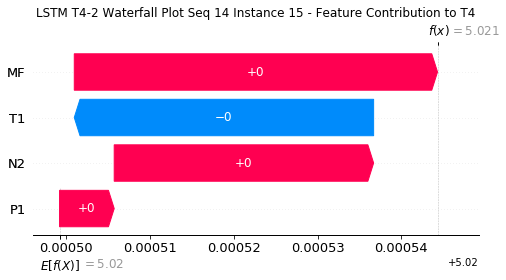

None

Contribution: [ 6.68329274e-06 -3.26897057e-05  3.07702070e-05  4.59252354e-05]


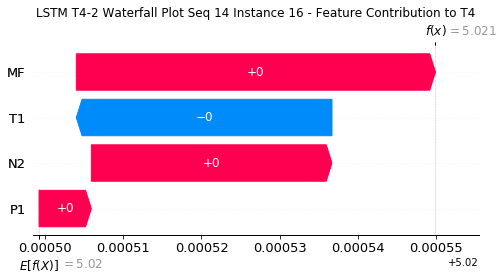

None

Contribution: [ 3.35301348e-06 -4.49046231e-05  3.16131632e-05  4.91199520e-05]


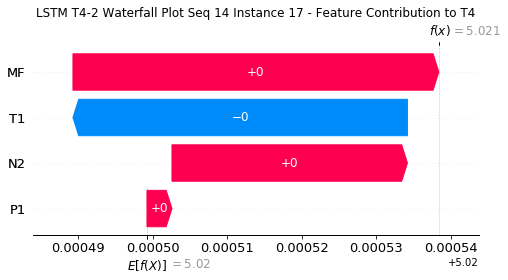

None

Contribution: [ 6.44303464e-06 -3.15607350e-05  3.13270765e-05  4.54973278e-05]


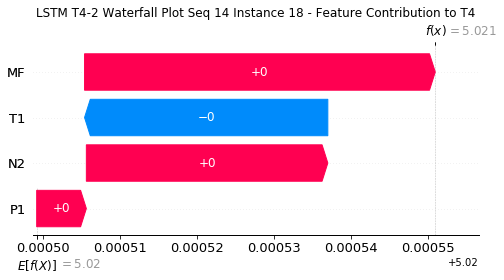

None

Contribution: [ 6.60527228e-06 -3.05376356e-05  3.15923854e-05  4.72232037e-05]


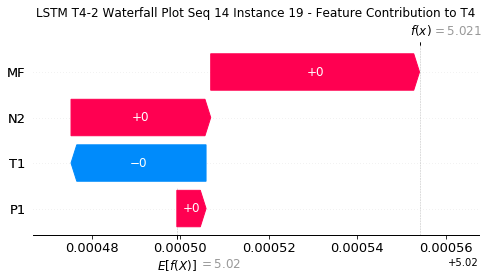

None

Contribution: [ 6.25452359e-06 -2.82524828e-05  3.23558221e-05  4.81685575e-05]


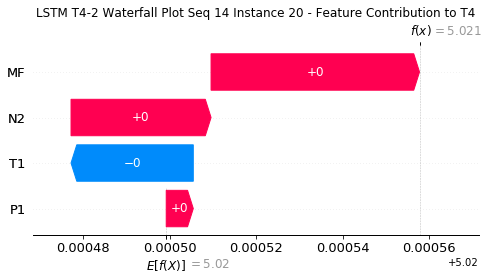

None

Contribution: [ 3.78617044e-06 -3.20922627e-05  3.53281068e-05  5.70906373e-05]


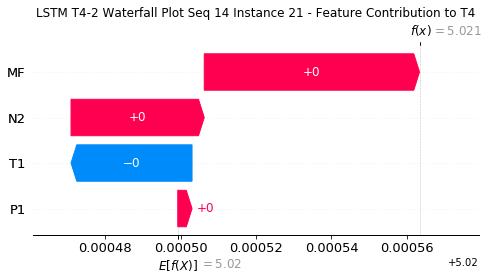

None

Contribution: [ 9.87262539e-06 -5.73808129e-05  5.08534498e-05  9.45205858e-05]


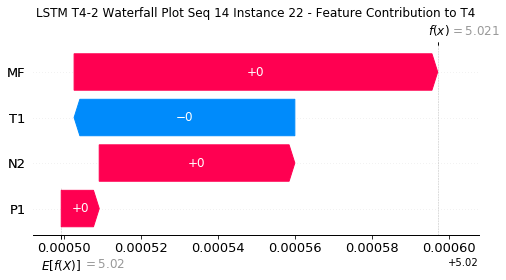

None

Contribution: [ 4.85051149e-05 -9.16654367e-05  1.60901625e-04  3.41265436e-04]


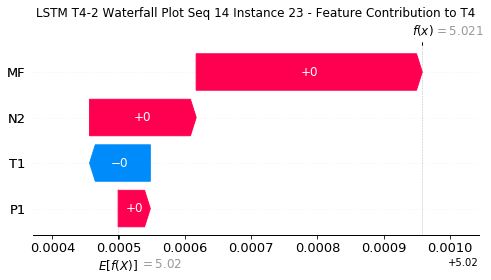

None

Contribution: [ 0.00032856 -0.00046553  0.00126017  0.00186179]


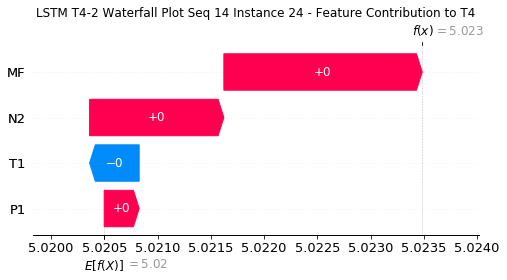

None

Contribution: [ 0.00074587 -0.00104058  0.00258343  0.00351445]


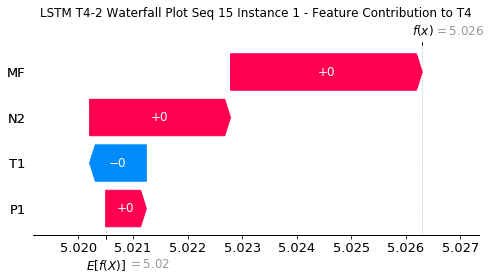

None

Contribution: [ 0.0002582  -0.00016672  0.00091373  0.00128017]


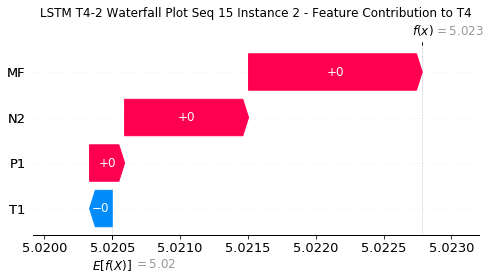

None

Contribution: [ 5.52359578e-05 -3.00693406e-05  1.86009470e-04  2.33233314e-04]


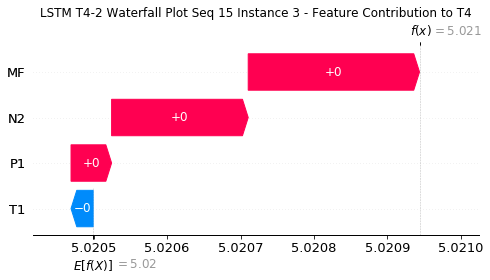

None

Contribution: [ 1.21800089e-05 -1.88422135e-05  4.25994466e-05  5.66867552e-05]


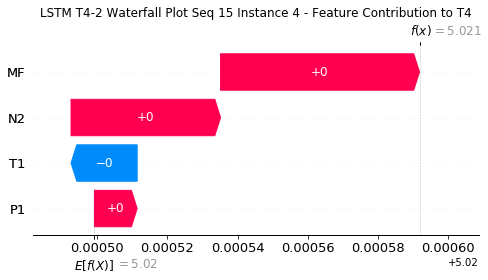

None

Contribution: [ 1.23901415e-05 -1.33260303e-05  3.62821069e-05  5.35181458e-05]


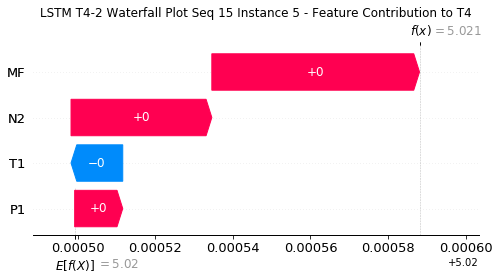

None

Contribution: [ 8.91425091e-06 -1.87973644e-05  3.35438139e-05  4.48090203e-05]


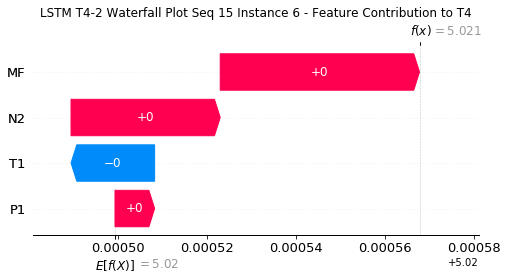

None

Contribution: [ 9.92534404e-07 -2.68381765e-05  3.12350745e-05  3.80371787e-05]


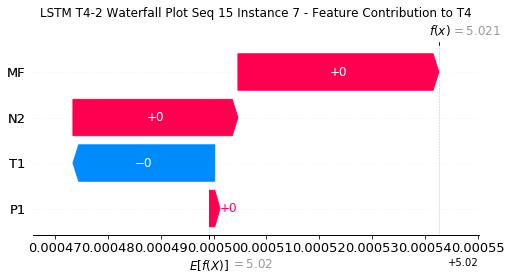

None

Contribution: [ 8.23086976e-06 -2.54693325e-05  3.22422427e-05  4.70936904e-05]


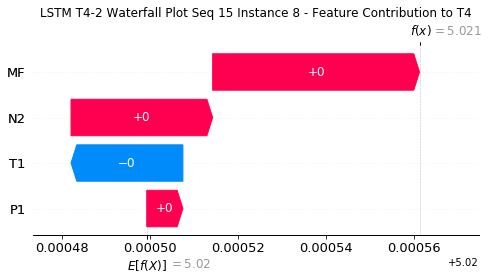

None

Contribution: [ 4.95646912e-06 -2.22317984e-05  3.11844597e-05  4.02555526e-05]


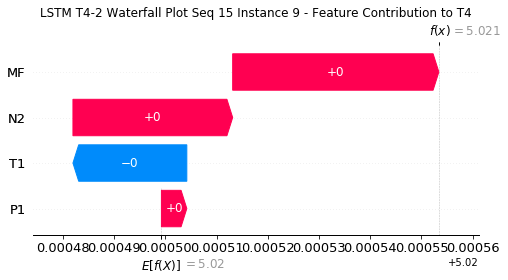

None

Contribution: [ 7.46233079e-06 -2.74709228e-05  3.24578195e-05  4.75072829e-05]


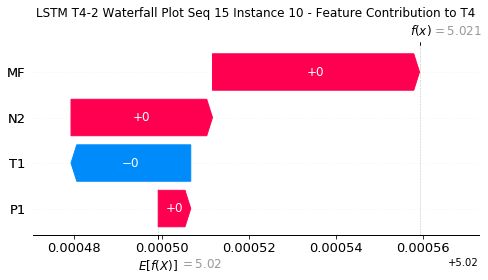

None

Contribution: [ 8.37904805e-06 -3.03525052e-05  3.14890092e-05  4.44850741e-05]


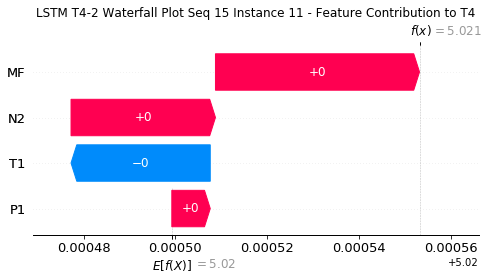

None

Contribution: [ 7.51894438e-06 -3.17694074e-05  3.21838099e-05  4.83249793e-05]


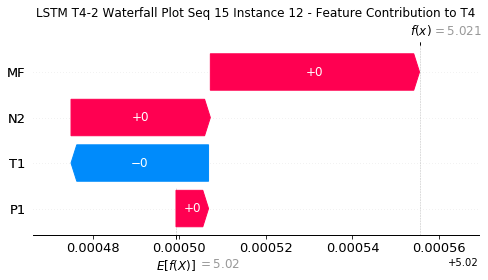

None

Contribution: [ 8.47201947e-06 -3.30457142e-05  3.12361309e-05  4.48782500e-05]


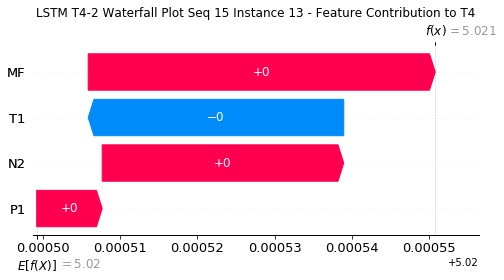

None

Contribution: [ 6.50049997e-06 -4.08794360e-05  3.31978639e-05  4.99173406e-05]


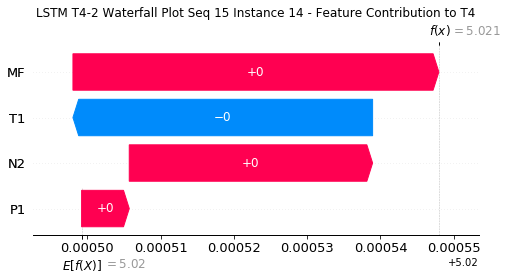

None

Contribution: [ 7.52250329e-06 -3.77416079e-05  3.08647079e-05  4.35637620e-05]


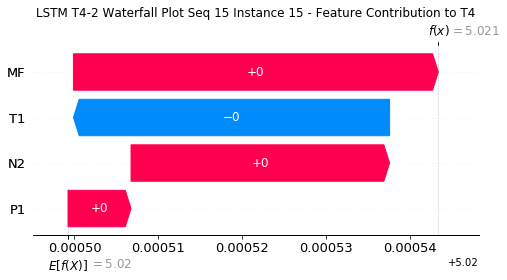

None

Contribution: [ 7.64806511e-06 -3.57569437e-05  3.04473902e-05  4.33859912e-05]


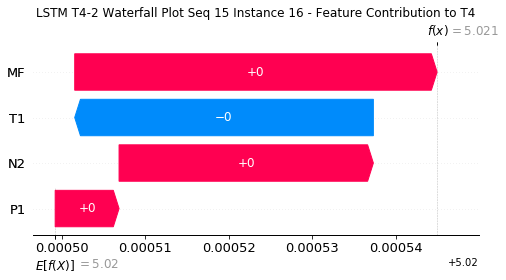

None

Contribution: [ 5.05693276e-06 -3.91344562e-05  3.08549915e-05  4.24245129e-05]


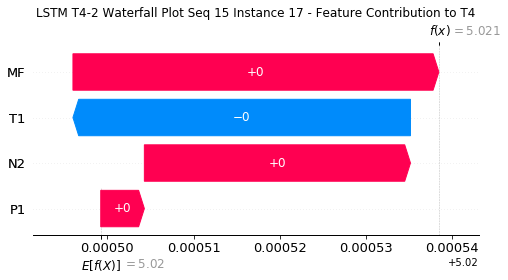

None

Contribution: [ 6.36591953e-06 -3.58577302e-05  3.02251124e-05  4.09334396e-05]


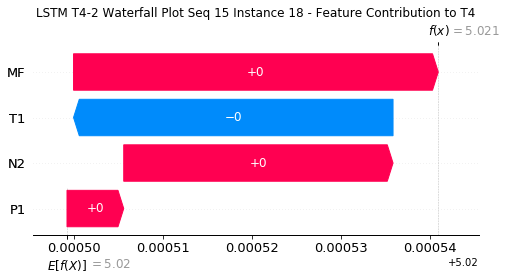

None

Contribution: [ 6.55229790e-06 -3.67418828e-05  3.03845144e-05  4.17336026e-05]


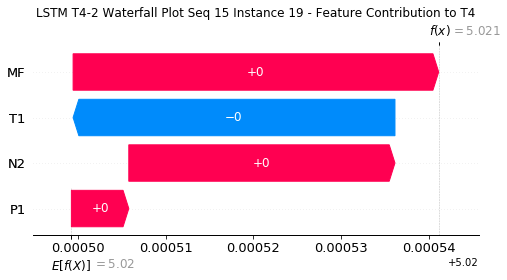

None

Contribution: [ 6.10069852e-06 -3.84437758e-05  3.08394374e-05  4.30048945e-05]


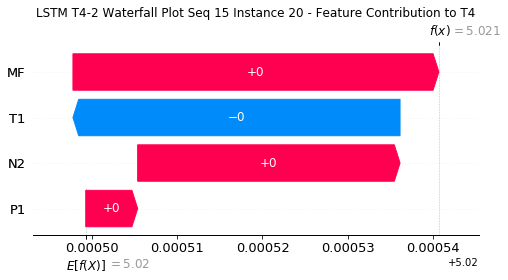

None

Contribution: [ 5.09166623e-06 -4.72755725e-05  3.40882162e-05  5.07690154e-05]


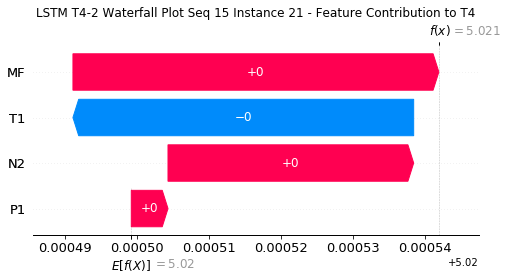

None

Contribution: [ 9.42184394e-06 -8.97762905e-05  4.66099937e-05  7.12525564e-05]


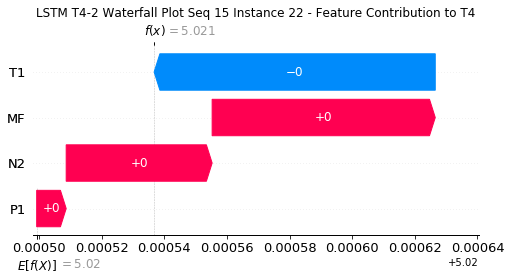

None

Contribution: [ 1.19992010e-05 -2.55347056e-04  1.49369397e-04  2.29228238e-04]


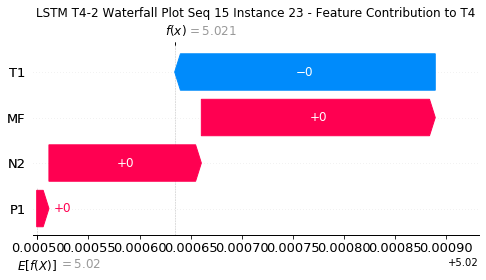

None

Contribution: [ 0.00031207 -0.00107112  0.00131331  0.00199032]


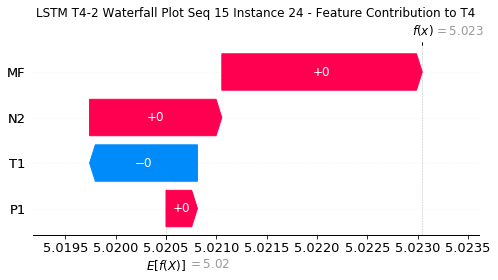

None

Contribution: [ 0.00073705 -0.00280112  0.00268306  0.00407494]


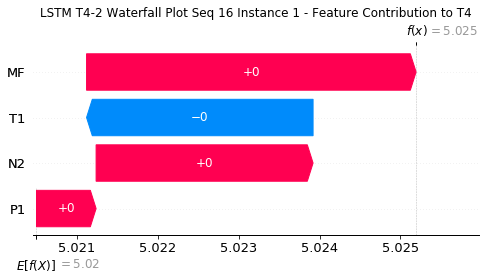

None

Contribution: [ 0.00030741 -0.00039647  0.00094881  0.00132244]


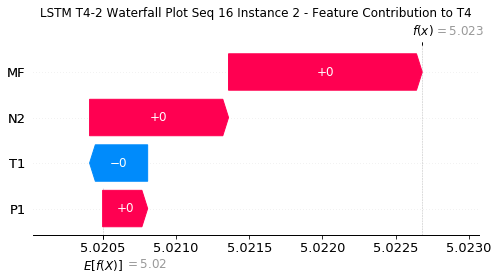

None

Contribution: [ 4.68644840e-05 -9.14730136e-05  1.89802098e-04  2.37727228e-04]


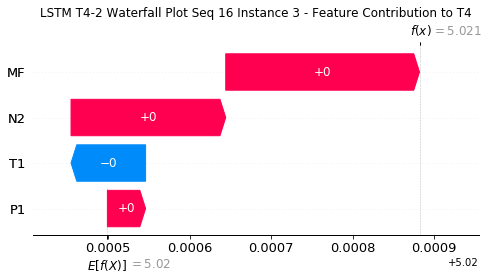

None

Contribution: [ 1.01564211e-05 -3.48707871e-05  4.38579619e-05  5.85693144e-05]


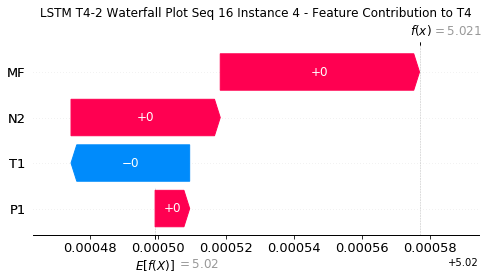

None

Contribution: [ 1.21581391e-05 -2.94084763e-05  3.75620781e-05  5.70077388e-05]


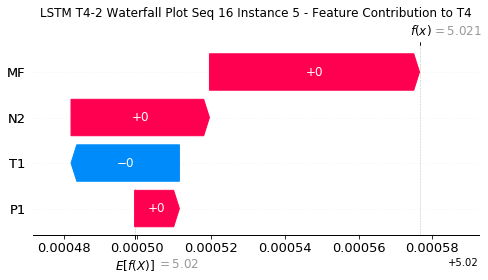

None

Contribution: [ 7.79046771e-06 -3.00828827e-05  3.46449053e-05  4.69838596e-05]


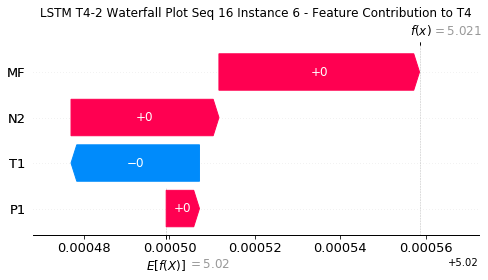

None

Contribution: [ 3.82088201e-06 -3.25397899e-05  3.36437930e-05  4.73098768e-05]


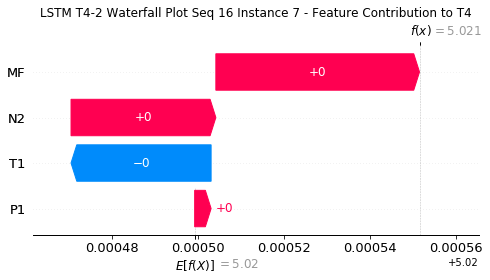

None

Contribution: [ 3.86567283e-06 -2.58135855e-05  3.21015373e-05  4.13894640e-05]


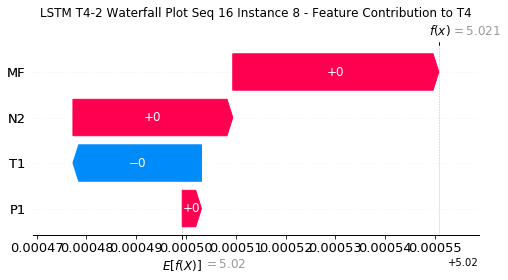

None

Contribution: [ 7.19157302e-06 -2.98380141e-05  3.36688721e-05  4.99155094e-05]


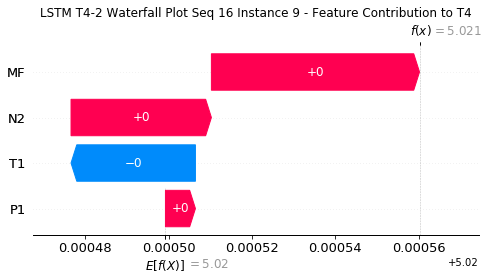

None

Contribution: [ 7.88106121e-06 -2.86085899e-05  3.33678581e-05  4.93525431e-05]


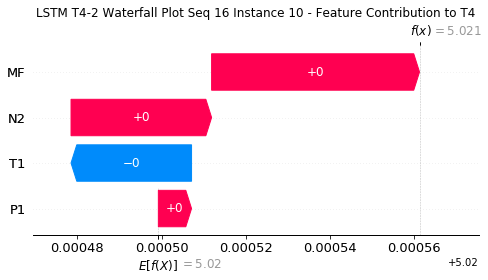

None

Contribution: [ 8.66318161e-06 -3.07633352e-05  3.23267868e-05  4.60862376e-05]


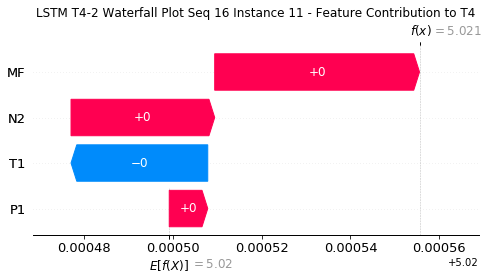

None

Contribution: [ 7.40137067e-06 -2.66113129e-05  3.14796712e-05  4.22281201e-05]


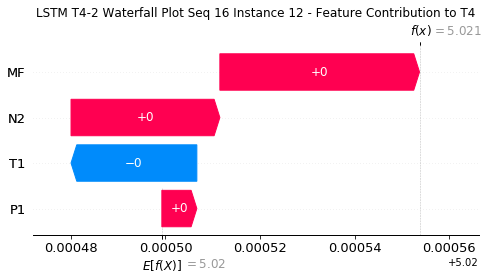

None

Contribution: [ 8.87397507e-06 -3.12920163e-05  3.21241451e-05  4.72554108e-05]


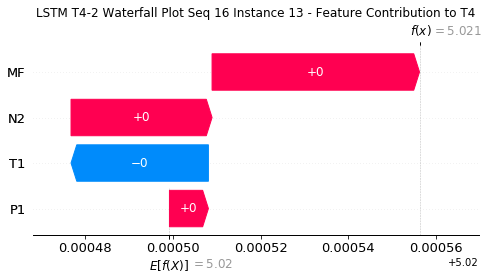

None

Contribution: [ 6.86194778e-06 -3.13578926e-05  3.22927730e-05  4.58532126e-05]


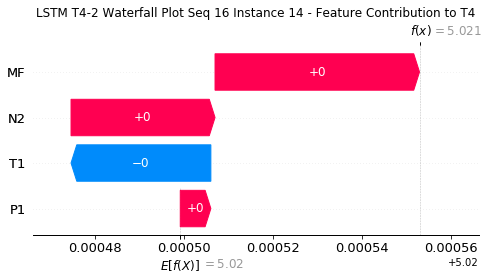

None

Contribution: [ 7.86288888e-06 -3.39290239e-05  3.17836690e-05  4.68152679e-05]


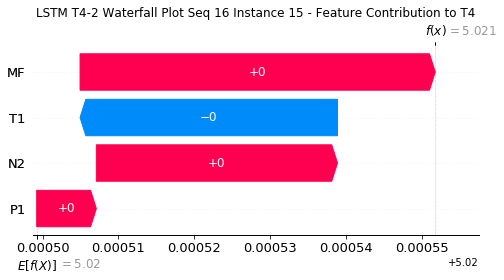

None

Contribution: [ 7.42552900e-06 -3.28297015e-05  3.11864857e-05  4.59358697e-05]


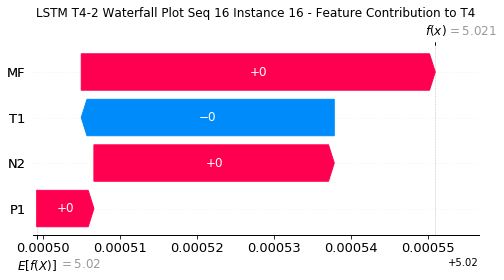

None

Contribution: [ 5.37524756e-06 -3.93257688e-05  3.14569991e-05  4.26459408e-05]


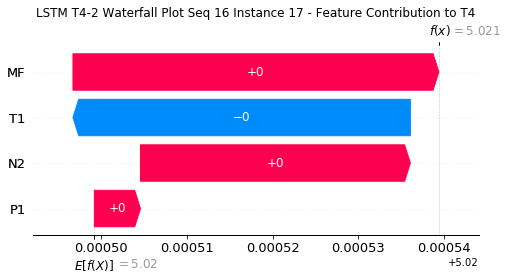

None

Contribution: [ 5.25015501e-06 -3.37157470e-05  3.09571665e-05  4.40579184e-05]


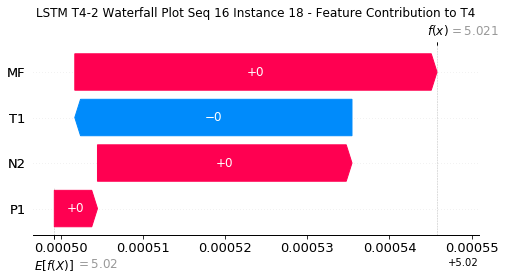

None

Contribution: [ 5.28530625e-06 -3.44802708e-05  3.09683024e-05  4.42420907e-05]


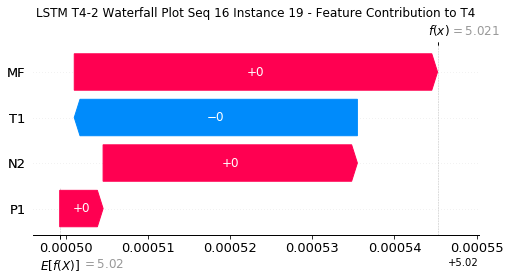

None

Contribution: [ 4.75901860e-06 -3.48436962e-05  3.14051576e-05  4.53890566e-05]


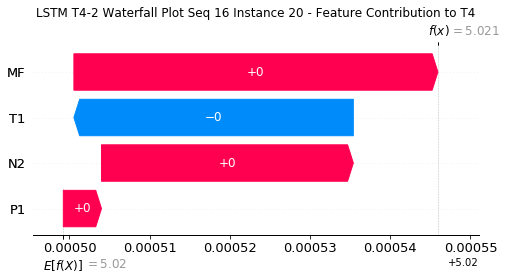

None

Contribution: [ 3.90629974e-06 -4.11075222e-05  3.46801489e-05  5.33600312e-05]


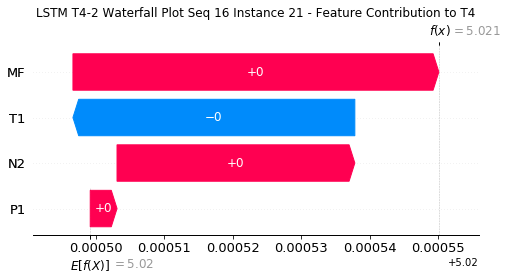

None

Contribution: [ 7.14746371e-06 -7.08898166e-05  4.81583479e-05  7.66661974e-05]


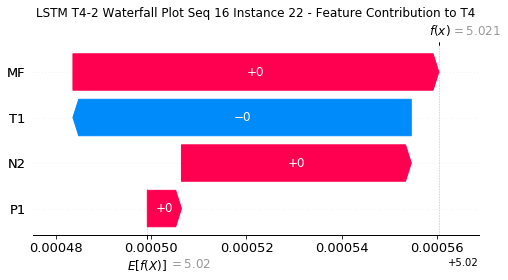

None

Contribution: [ 3.36043815e-05 -1.54792322e-04  1.50063754e-04  2.13380845e-04]


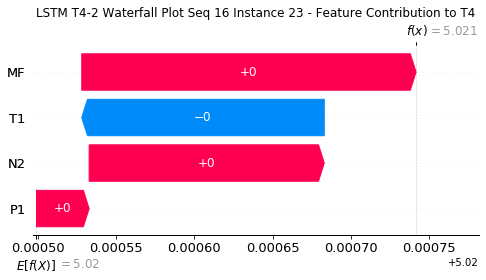

None

Contribution: [ 0.0003293  -0.00126915  0.00126894  0.00182272]


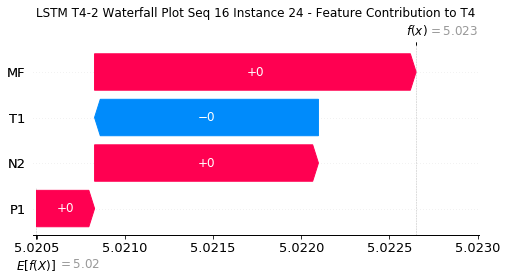

None

Contribution: [ 0.00082955 -0.00279097  0.00264806  0.00406461]


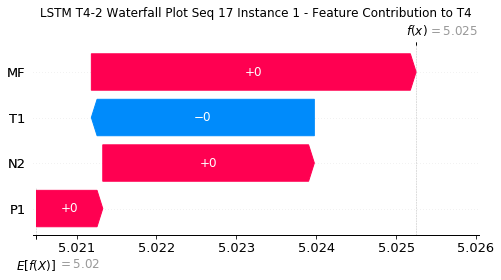

None

Contribution: [ 0.00030133 -0.00050969  0.00096645  0.00151488]


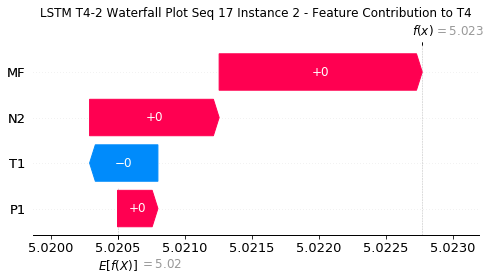

None

Contribution: [ 5.73586097e-05 -1.28801038e-04  1.89935204e-04  2.55020393e-04]


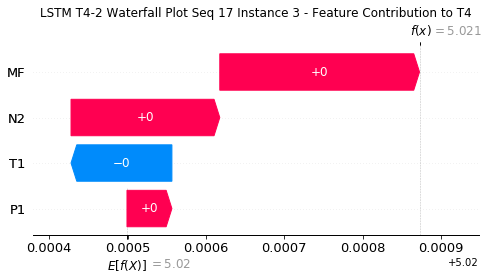

None

Contribution: [ 1.18685986e-05 -4.78131690e-05  4.36992539e-05  6.15786016e-05]


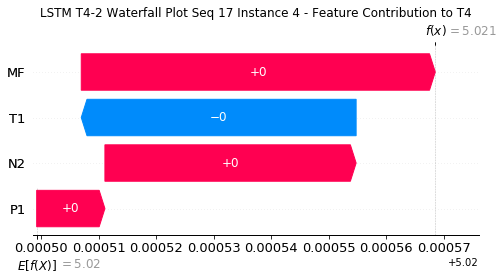

None

Contribution: [ 1.07812841e-05 -3.41915353e-05  3.70924568e-05  5.52471279e-05]


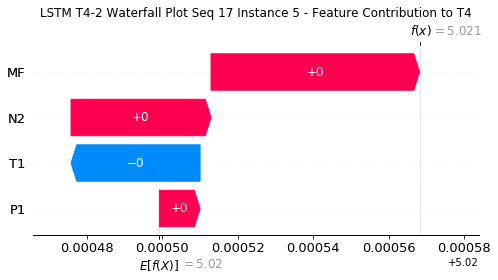

None

Contribution: [ 8.81530322e-06 -3.95482286e-05  3.44951465e-05  4.88484729e-05]


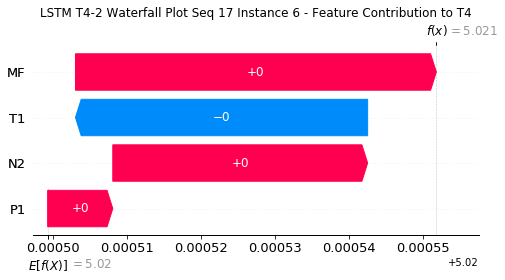

None

Contribution: [ 4.37872657e-06 -3.39423673e-05  3.31486767e-05  4.79294436e-05]


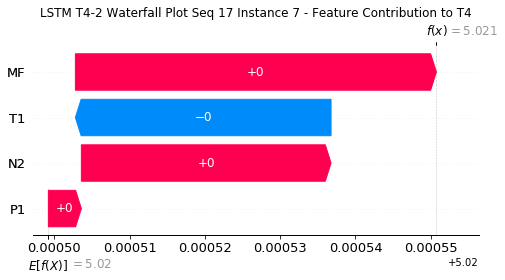

None

Contribution: [ 5.29013589e-06 -3.56006288e-05  3.40596277e-05  5.28332854e-05]


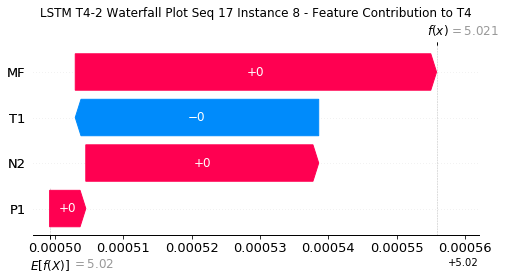

None

Contribution: [ 4.41900510e-06 -3.48667664e-05  3.27468782e-05  4.61625775e-05]


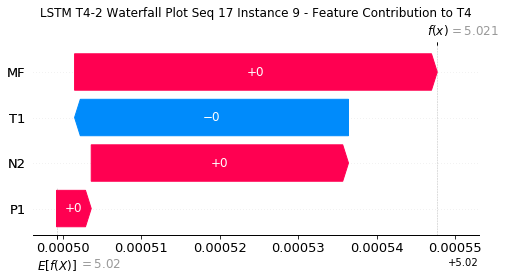

None

Contribution: [ 5.59834984e-06 -4.03599530e-05  3.22056335e-05  4.40200085e-05]


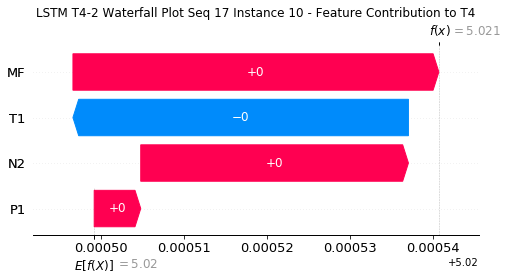

None

Contribution: [ 7.29814397e-06 -4.18183727e-05  3.12955183e-05  4.17516713e-05]


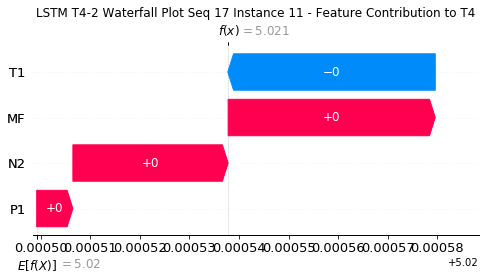

None

Contribution: [ 6.11767402e-06 -3.83183169e-05  3.15174111e-05  4.20261873e-05]


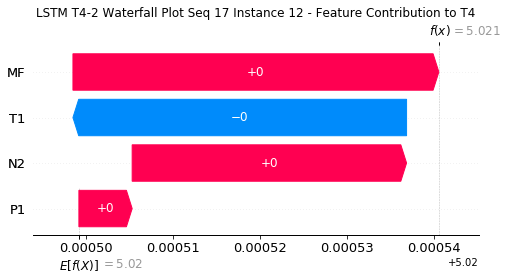

None

Contribution: [ 7.06597104e-06 -4.22904946e-05  3.07480489e-05  4.06078953e-05]


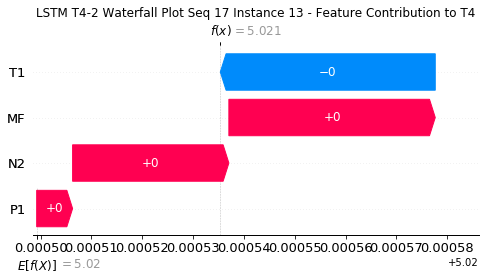

None

Contribution: [ 6.56331484e-06 -4.39841630e-05  3.14892543e-05  5.41145402e-05]


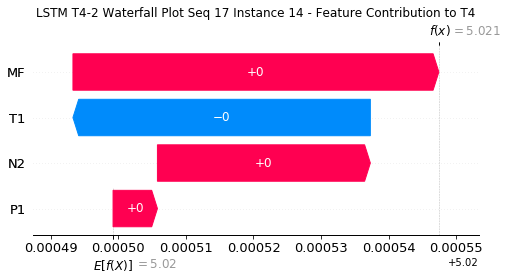

None

Contribution: [ 6.34415826e-06 -4.41115605e-05  3.03877454e-05  3.91805445e-05]


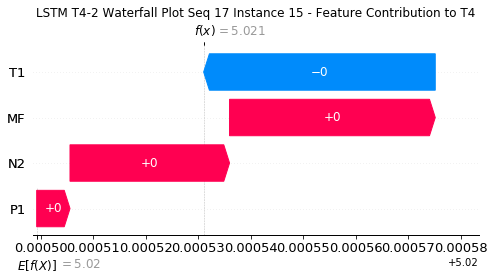

None

Contribution: [ 6.39967494e-06 -4.32785454e-05  3.02236074e-05  4.00719845e-05]


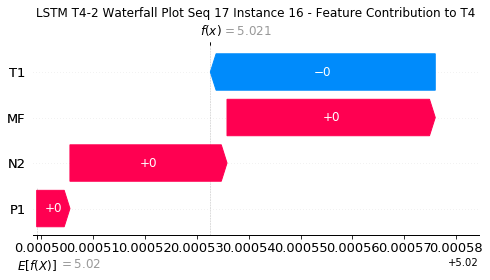

None

Contribution: [ 4.69611756e-06 -4.49076233e-05  2.92643862e-05  4.84780464e-05]


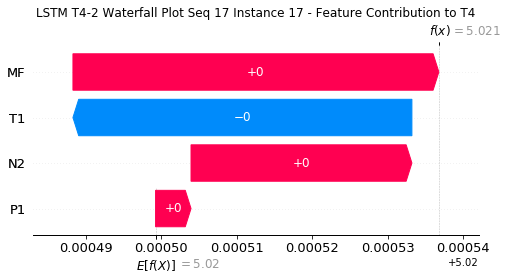

None

Contribution: [ 6.96335441e-06 -4.15358637e-05  3.02586015e-05  4.01741500e-05]


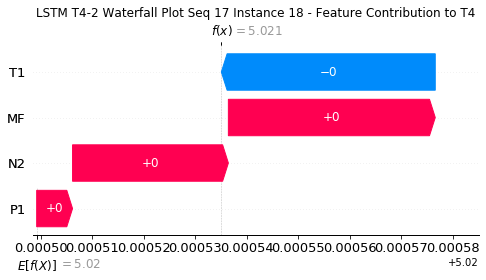

None

Contribution: [ 6.95043924e-06 -4.30620729e-05  3.04758177e-05  4.06382266e-05]


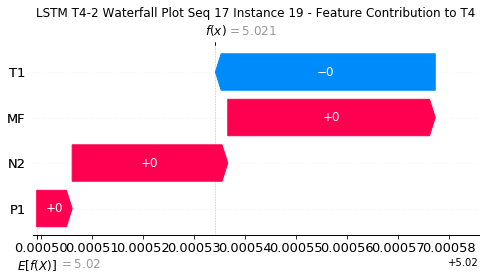

None

Contribution: [ 6.57282563e-06 -4.39555194e-05  3.07039896e-05  4.07872342e-05]


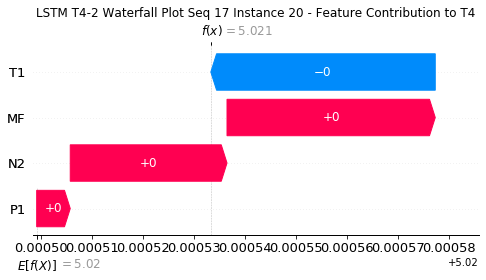

None

Contribution: [ 4.06565666e-06 -5.35351188e-05  3.37654130e-05  4.65733701e-05]


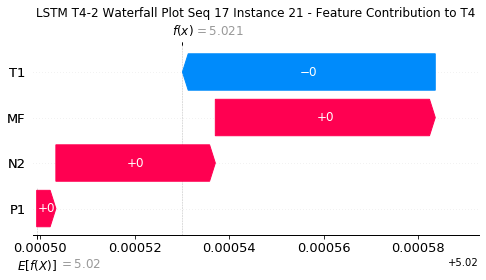

None

Contribution: [ 1.25155539e-05 -9.58254195e-05  4.85230625e-05  7.57183302e-05]


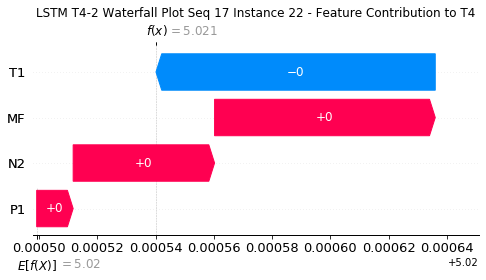

None

Contribution: [ 6.43159681e-05 -2.77940277e-04  1.66353241e-04  3.25947943e-04]


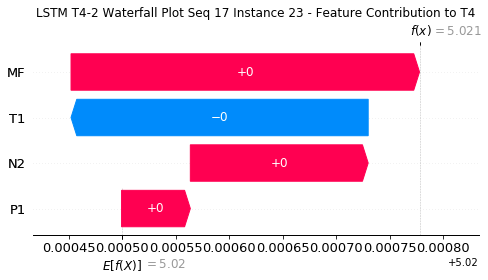

None

Contribution: [ 0.00028405 -0.00172577  0.00124366  0.001736  ]


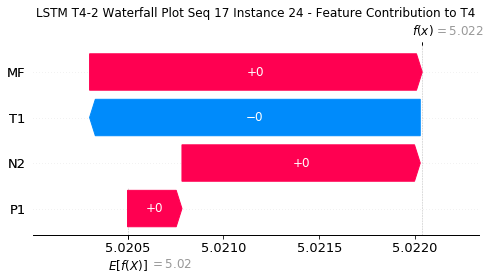

None

Contribution: [ 0.00073046 -0.00365496  0.00247766  0.00332735]


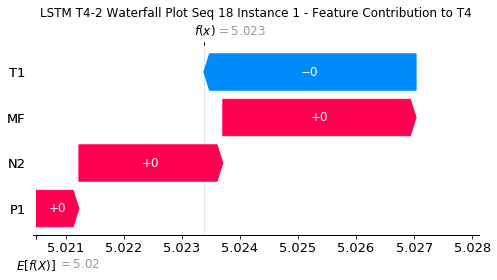

None

Contribution: [ 0.00026711 -0.0006336   0.00091166  0.00116935]


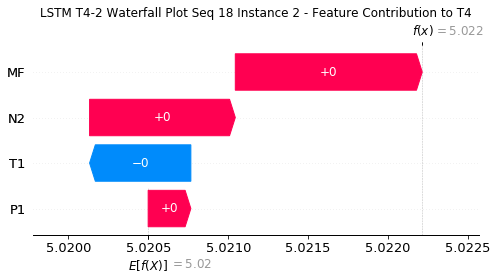

None

Contribution: [ 5.66082000e-05 -1.63331264e-04  1.88050643e-04  2.37840566e-04]


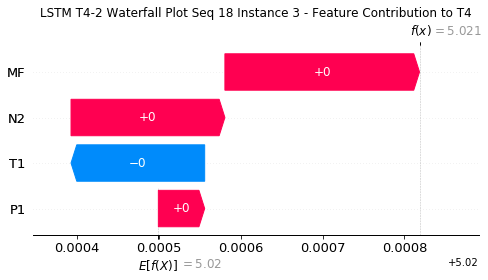

None

Contribution: [ 1.20015461e-05 -5.72496778e-05  4.28684050e-05  5.51495371e-05]


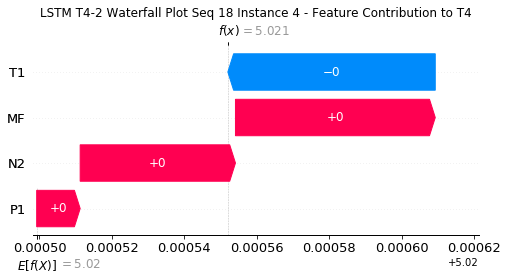

None

Contribution: [ 9.09190000e-06 -4.39663223e-05  3.80124857e-05  4.86524327e-05]


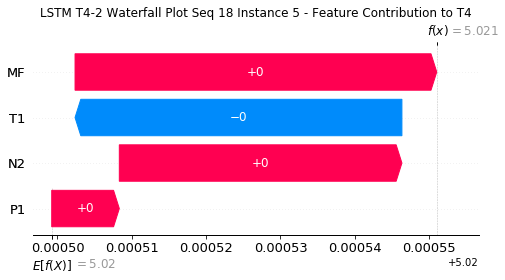

None

Contribution: [ 8.71448043e-06 -4.80122175e-05  3.39101030e-05  4.27306217e-05]


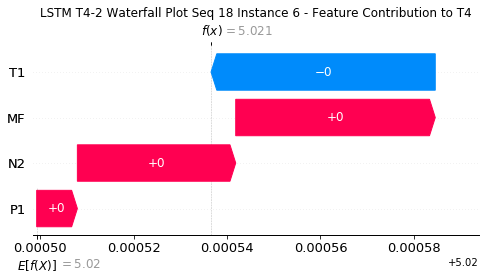

None

Contribution: [ 1.57416829e-06 -5.04758302e-05  3.20394848e-05  3.59848769e-05]


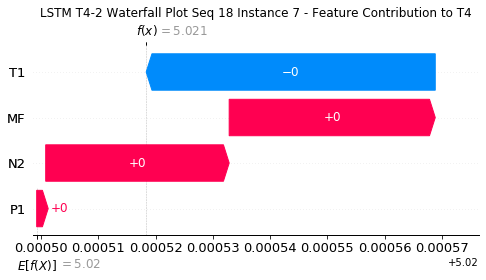

None

Contribution: [ 5.97939163e-06 -4.88498281e-05  3.31729128e-05  4.34567414e-05]


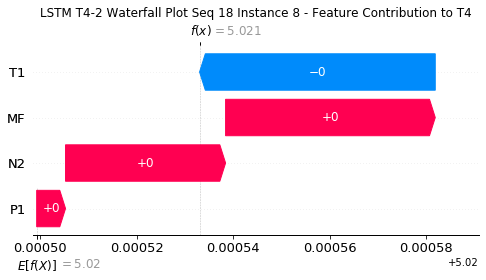

None

Contribution: [ 2.96790734e-06 -4.64755227e-05  3.18251121e-05  3.78488962e-05]


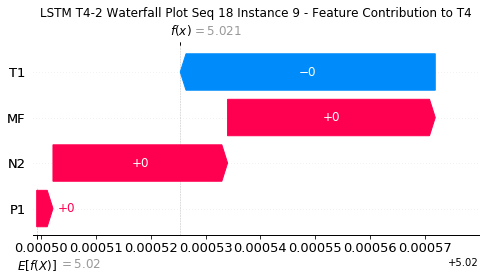

None

Contribution: [ 6.75837406e-06 -4.41681980e-05  3.30271783e-05  4.21973681e-05]


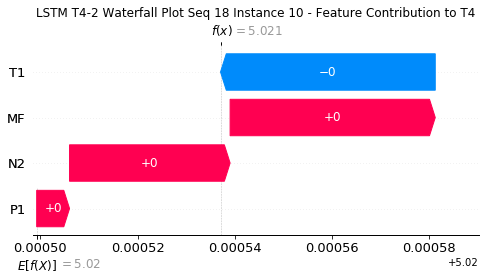

None

Contribution: [ 8.36811076e-06 -4.65264840e-05  3.20781063e-05  3.93222305e-05]


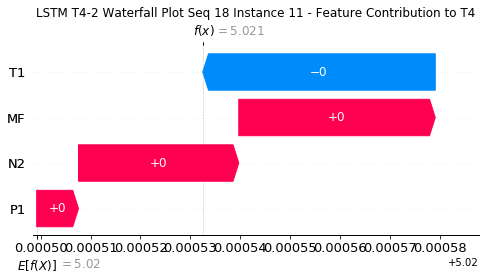

None

Contribution: [ 6.68088425e-06 -4.73702884e-05  2.97825015e-05  3.44117039e-05]


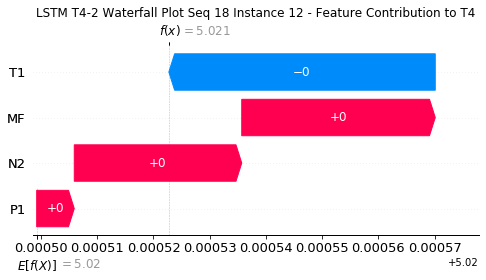

None

Contribution: [ 8.55056895e-06 -4.63276865e-05  3.20836974e-05  4.03550716e-05]


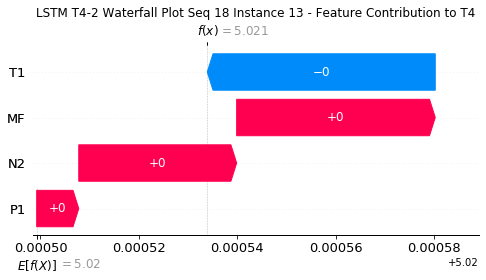

None

Contribution: [ 6.54113027e-06 -4.19485099e-05  3.26158984e-05  3.90206117e-05]


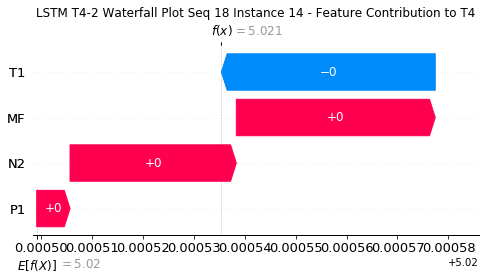

None

Contribution: [ 8.14826696e-06 -4.80597088e-05  3.17962170e-05  3.82492022e-05]


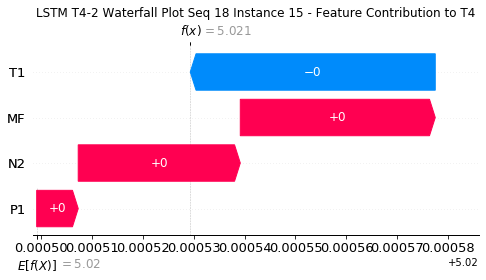

None

Contribution: [ 8.25321155e-06 -4.70639848e-05  3.11053577e-05  3.70602097e-05]


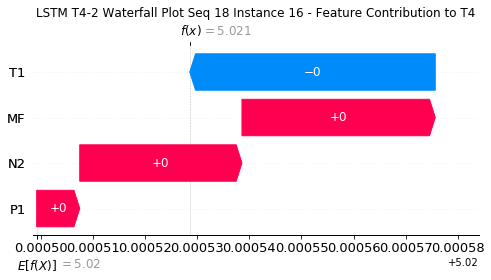

None

Contribution: [ 4.02508426e-06 -5.43937627e-05  3.10574702e-05  3.56870362e-05]


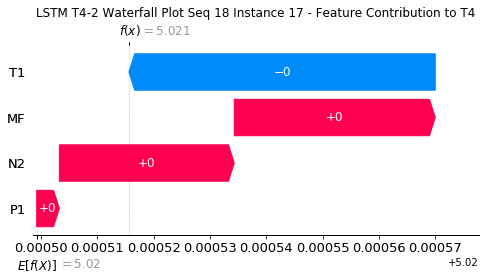

None

Contribution: [ 8.61652308e-06 -4.77366684e-05  3.15426106e-05  3.87514468e-05]


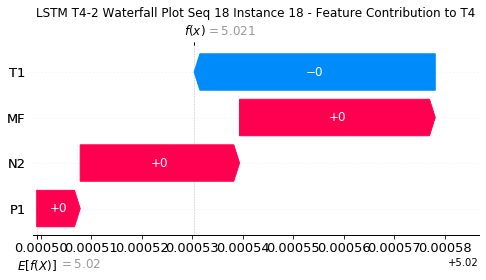

None

Contribution: [ 8.69519618e-06 -4.88023312e-05  3.16137353e-05  3.89103550e-05]


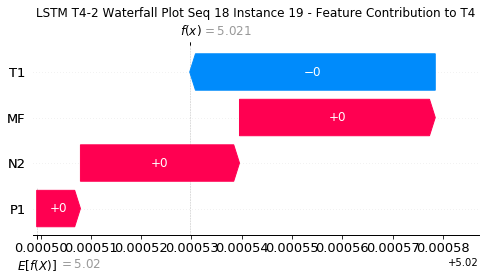

None

Contribution: [ 8.50842423e-06 -4.99142830e-05  3.24882880e-05  4.21682084e-05]


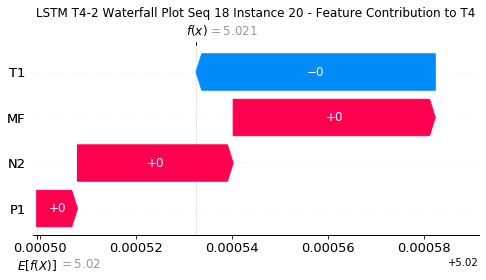

None

Contribution: [ 6.67923694e-06 -5.82696935e-05  3.55436808e-05  4.63957156e-05]


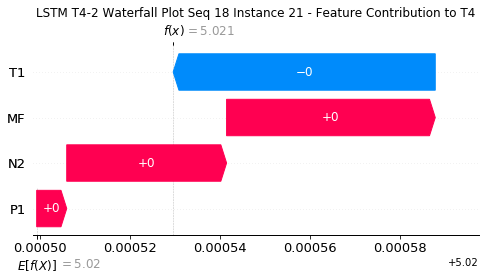

None

Contribution: [ 1.44138857e-05 -1.09165462e-04  5.00992833e-05  7.11990634e-05]


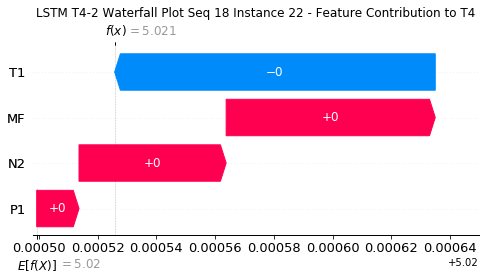

None

Contribution: [ 2.94833470e-05 -3.33940140e-04  1.57070339e-04  2.43057387e-04]


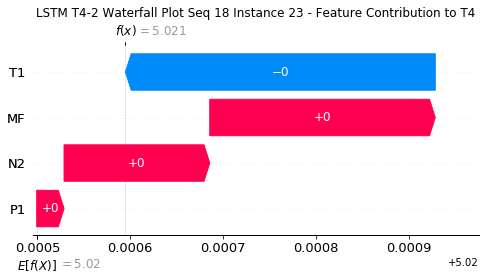

None

Contribution: [ 0.00031045 -0.00170846  0.00131696  0.0018338 ]


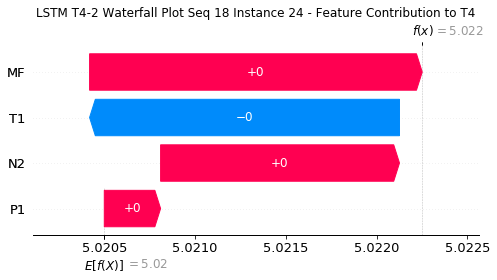

None

Contribution: [ 0.00083775 -0.00366501  0.00279648  0.00440412]


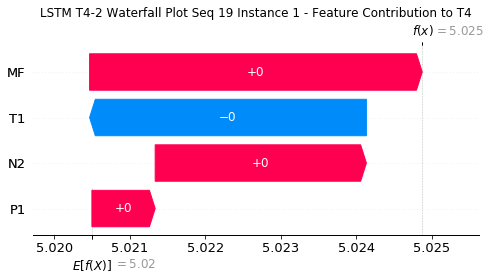

None

Contribution: [ 0.00033323 -0.00058435  0.00097918  0.00149735]


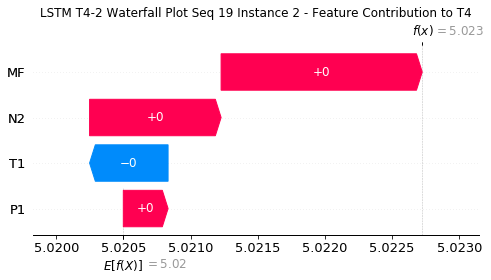

None

Contribution: [ 7.04726491e-05 -1.08918238e-04  1.94265093e-04  2.69811996e-04]


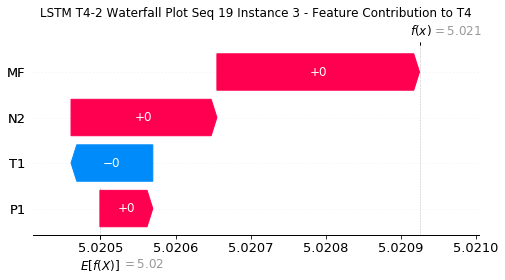

None

Contribution: [ 1.59170647e-05 -4.07217856e-05  4.49118507e-05  6.55829114e-05]


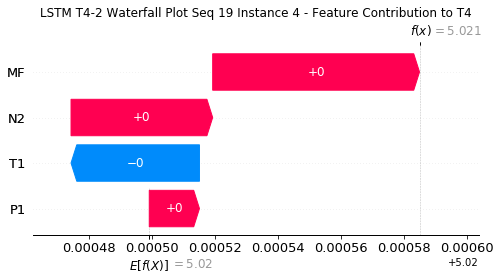

None

Contribution: [ 1.68236885e-05 -3.96488953e-05  3.76345546e-05  5.44743762e-05]


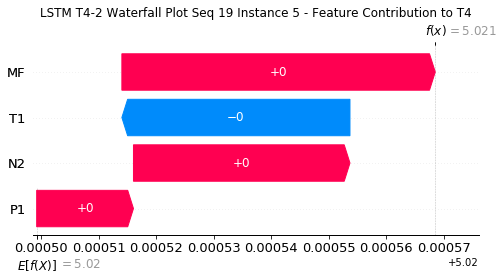

None

Contribution: [ 1.25297434e-05 -3.50543878e-05  3.56201590e-05  5.20628769e-05]


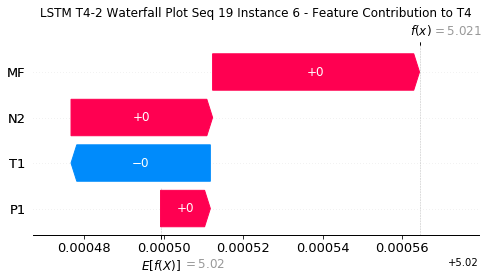

None

Contribution: [ 1.05203626e-05 -3.50035649e-05  3.57171331e-05  5.38700184e-05]


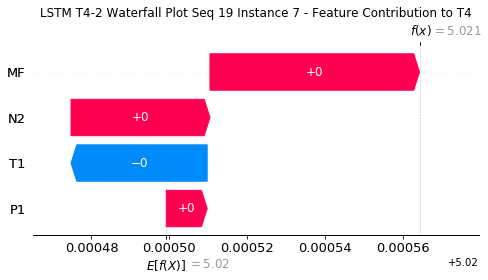

None

Contribution: [ 1.29887017e-05 -3.63967680e-05  3.63310007e-05  6.18532651e-05]


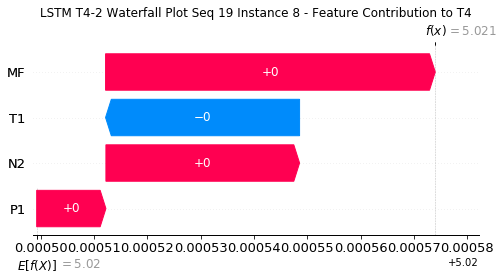

None

Contribution: [ 9.29804198e-06 -2.80825172e-05  3.41663636e-05  5.04400947e-05]


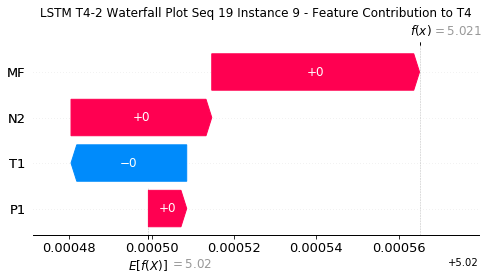

None

Contribution: [ 1.01171996e-05 -3.31121772e-05  3.34705177e-05  4.80472383e-05]


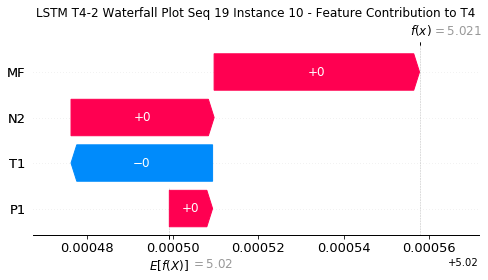

None

Contribution: [ 1.17931978e-05 -3.64832074e-05  3.27159956e-05  4.56650034e-05]


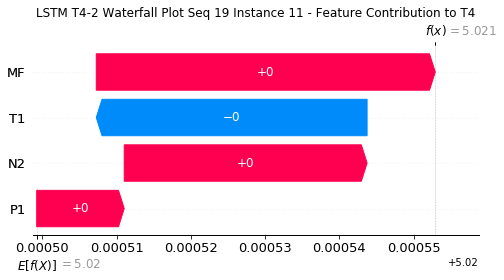

None

Contribution: [ 1.34867991e-05 -3.80811447e-05  3.38320752e-05  5.20727074e-05]


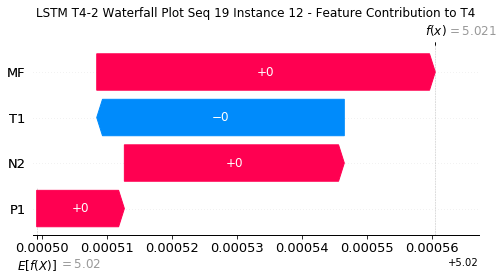

None

Contribution: [ 1.13437450e-05 -3.72337434e-05  3.20439919e-05  4.34482504e-05]


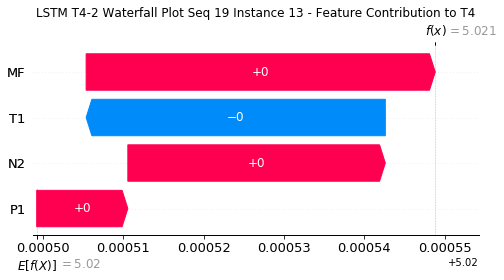

None

Contribution: [ 9.64183536e-06 -4.10552586e-05  3.35800014e-05  5.06599993e-05]


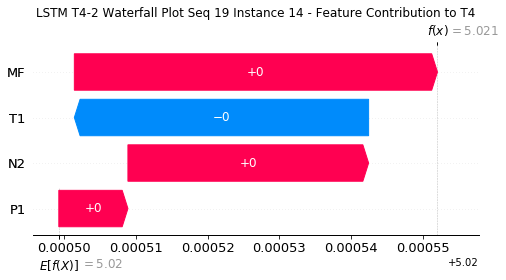

None

Contribution: [ 1.00842161e-05 -4.19405540e-05  3.14695968e-05  4.01100905e-05]


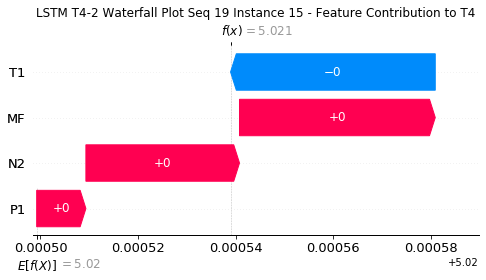

None

Contribution: [ 9.48635407e-06 -4.17184130e-05  3.09810394e-05  3.99024670e-05]


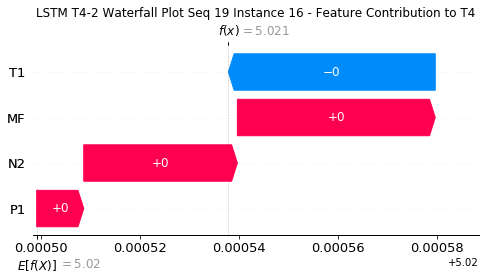

None

Contribution: [ 7.69800911e-06 -4.38687951e-05  3.37060385e-05  4.95125284e-05]


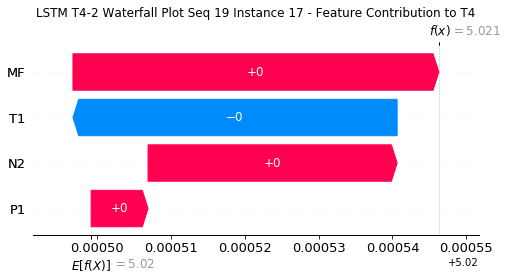

None

Contribution: [ 9.00744413e-06 -4.45871752e-05  3.09276738e-05  3.76548054e-05]


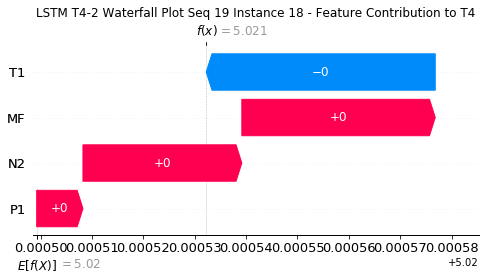

None

Contribution: [ 8.90691434e-06 -4.55467600e-05  3.09275526e-05  3.79507544e-05]


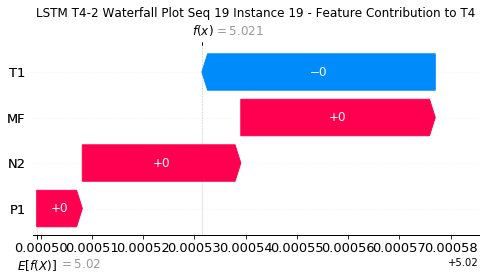

None

Contribution: [ 8.66142247e-06 -4.56043823e-05  3.12704855e-05  3.84022695e-05]


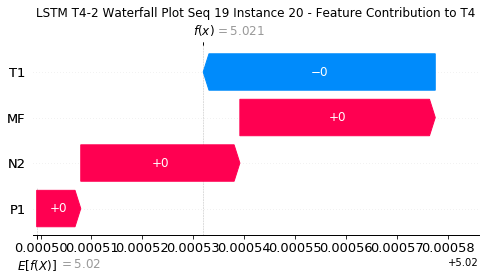

None

Contribution: [ 6.47199189e-06 -5.32465423e-05  3.41361940e-05  4.32882318e-05]


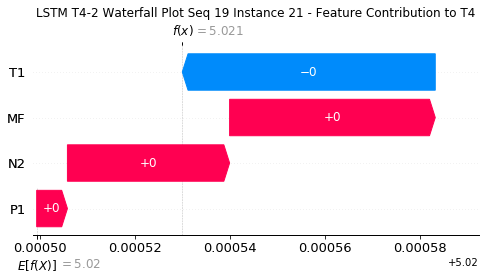

None

Contribution: [ 1.19552604e-05 -1.00137864e-04  4.71419674e-05  5.85035450e-05]


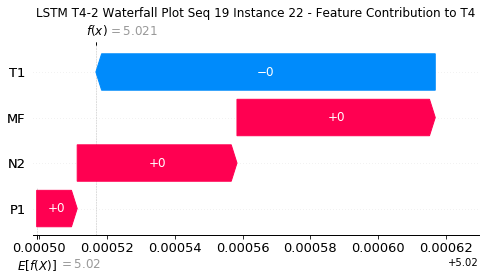

None

Contribution: [ 4.53428730e-05 -2.88144471e-04  1.63167080e-04  2.63939788e-04]


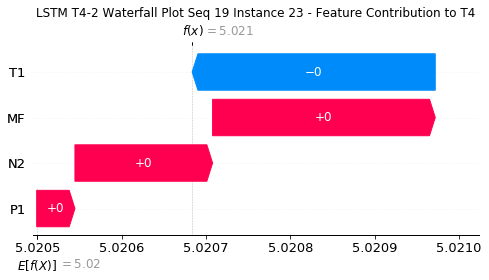

None

Contribution: [ 0.00041145 -0.00158286  0.00133653  0.00206585]


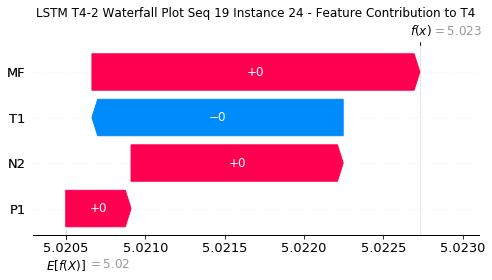

None

Contribution: [ 0.00098482 -0.00336475  0.00269579  0.00388015]


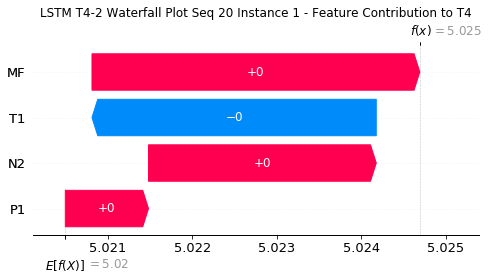

None

Contribution: [ 0.00023788 -0.00063609  0.00093013  0.00111052]


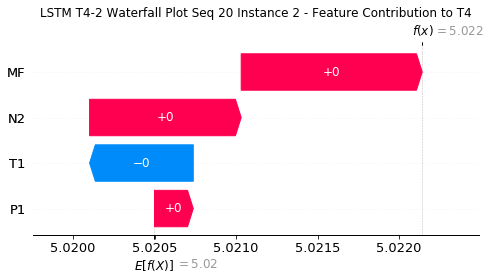

None

Contribution: [ 6.45291329e-05 -1.35771144e-04  1.91030548e-04  2.42971668e-04]


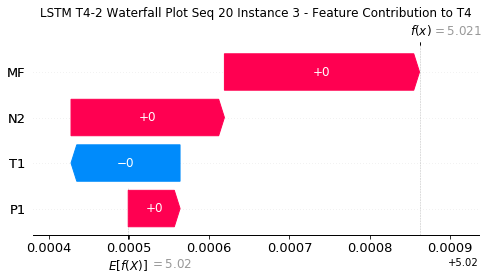

None

Contribution: [ 1.53719586e-05 -4.84334098e-05  4.40651187e-05  6.00909443e-05]


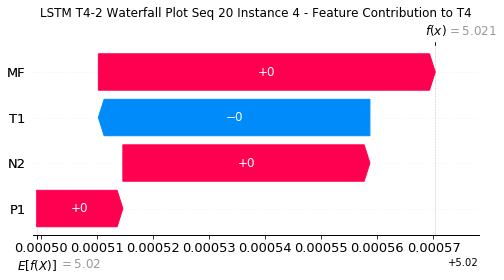

None

Contribution: [ 1.46237257e-05 -4.09285768e-05  3.73776816e-05  4.97565012e-05]


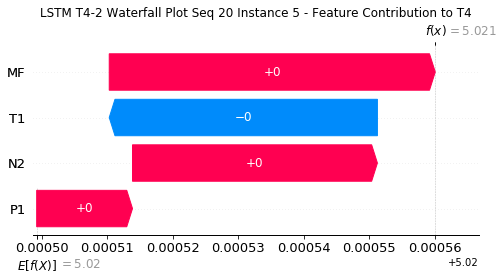

None

Contribution: [ 1.19145056e-05 -4.13778322e-05  3.48301419e-05  4.80764410e-05]


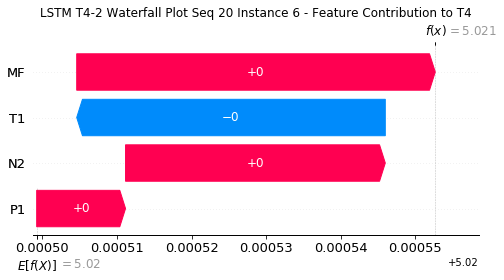

None

Contribution: [ 8.08525276e-06 -4.40137155e-05  3.45149151e-05  5.03523747e-05]


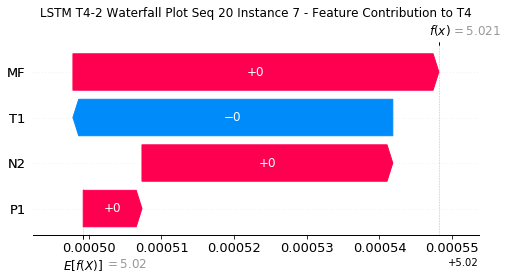

None

Contribution: [ 9.31998083e-06 -4.02773233e-05  3.38514514e-05  4.41440553e-05]


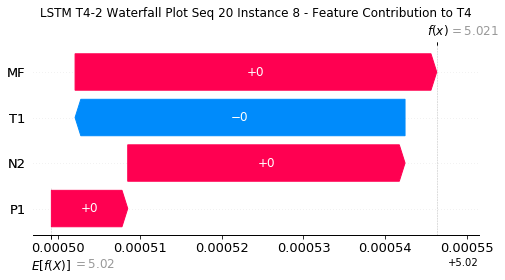

None

Contribution: [ 9.51072327e-06 -3.80305350e-05  3.46064435e-05  5.07032697e-05]


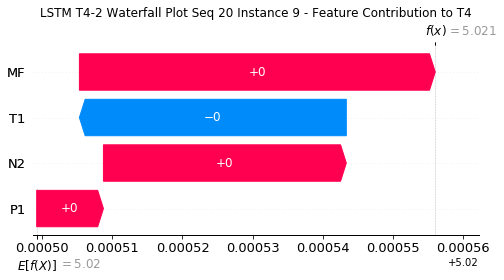

None

Contribution: [ 9.34887917e-06 -3.91862093e-05  3.22754234e-05  4.33607465e-05]


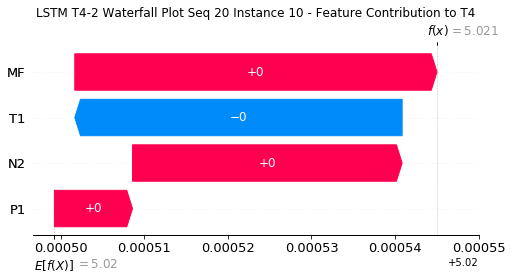

None

Contribution: [ 1.07843025e-05 -4.20498501e-05  3.11637917e-05  4.08761617e-05]


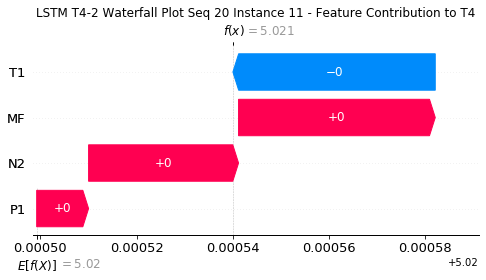

None

Contribution: [ 1.18431447e-05 -3.58330824e-05  2.88564571e-05  3.89462984e-05]


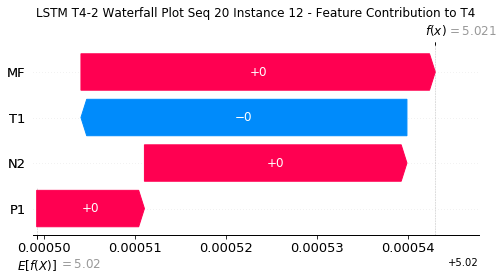

None

Contribution: [ 1.05774015e-05 -4.25567182e-05  3.03692423e-05  3.93493121e-05]


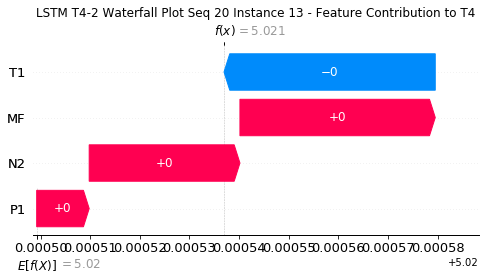

None

Contribution: [ 6.25464470e-06 -4.34873653e-05  3.03276525e-05  3.76776246e-05]


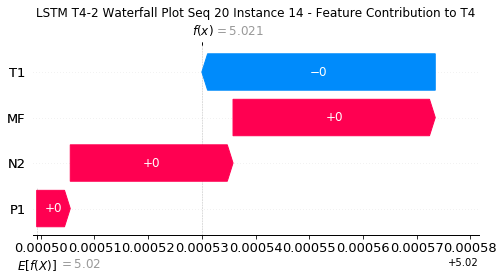

None

Contribution: [ 1.04908431e-05 -4.57882308e-05  3.00244688e-05  4.00904911e-05]


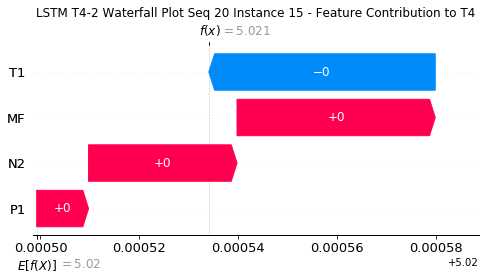

None

Contribution: [ 1.08796596e-05 -4.47620972e-05  2.98048973e-05  4.22536302e-05]


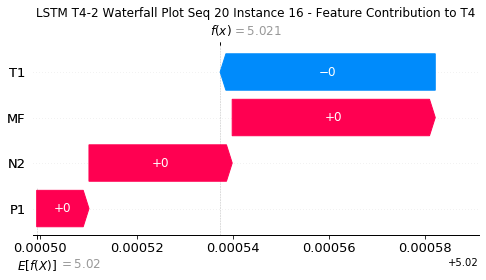

None

Contribution: [ 9.78378952e-06 -4.90965055e-05  2.91749403e-05  4.32487371e-05]


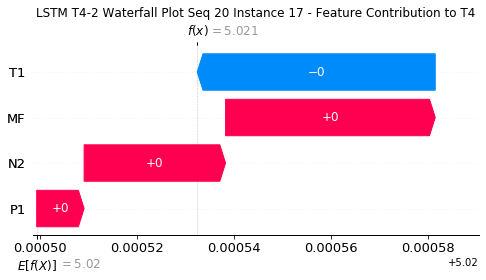

None

Contribution: [ 9.87401539e-06 -4.70794224e-05  2.92071507e-05  4.01827763e-05]


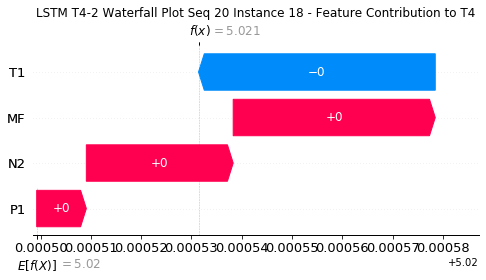

None

Contribution: [ 9.85761232e-06 -4.79381163e-05  2.92704816e-05  4.06734112e-05]


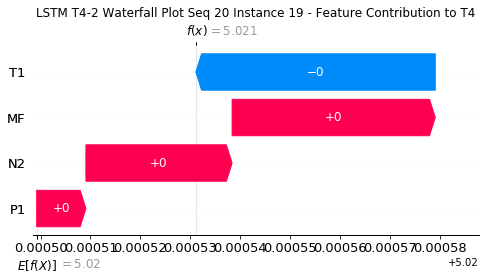

None

Contribution: [ 8.60997531e-06 -4.89454715e-05  2.89882901e-05  3.80369558e-05]


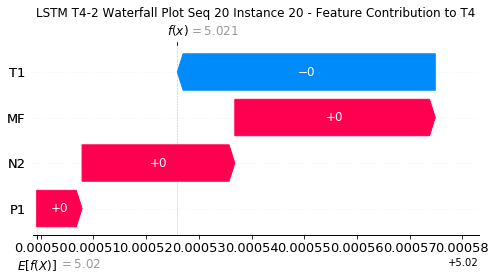

None

Contribution: [ 7.85922788e-06 -5.67072234e-05  3.20508936e-05  4.55845980e-05]


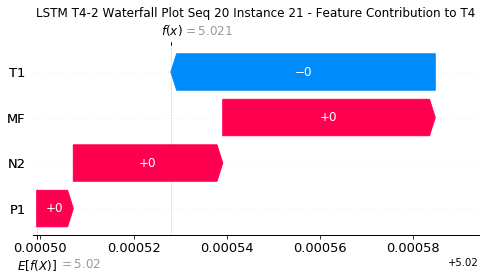

None

Contribution: [ 1.40197150e-05 -1.05397096e-04  4.27364640e-05  5.88289406e-05]


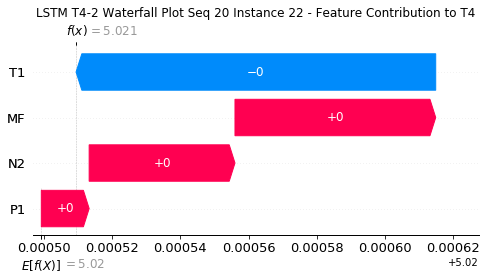

None

Contribution: [ 3.57468396e-05 -2.54908433e-04  1.44187016e-04  1.71508876e-04]


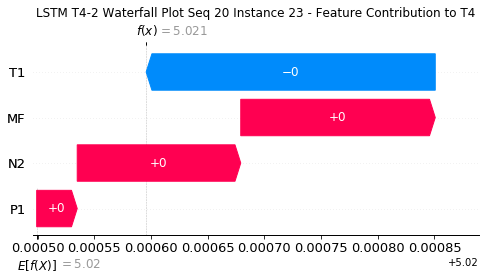

None

Contribution: [ 0.00039751 -0.00138403  0.00128438  0.00183129]


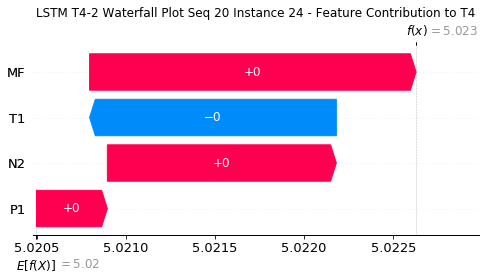

None

Contribution: [ 0.00083065 -0.00306697  0.00250869  0.00306731]


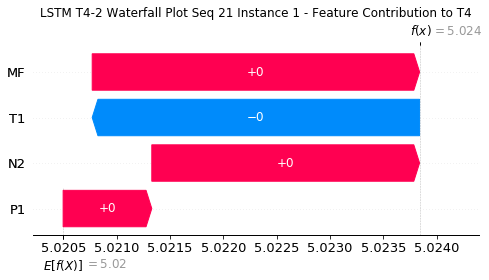

None

Contribution: [ 0.00036758 -0.0005118   0.00095689  0.00138885]


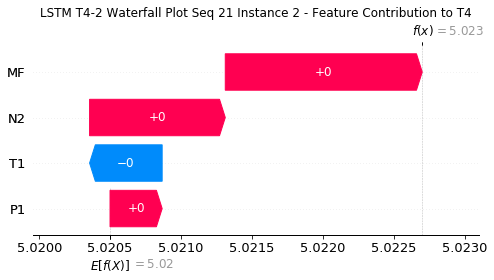

None

Contribution: [ 6.10604755e-05 -1.29971980e-04  1.89178811e-04  2.31726513e-04]


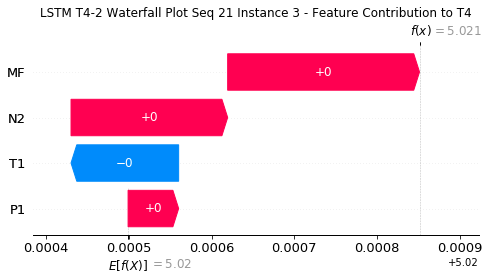

None

Contribution: [ 1.35101835e-05 -4.64043141e-05  4.36958980e-05  5.63841304e-05]


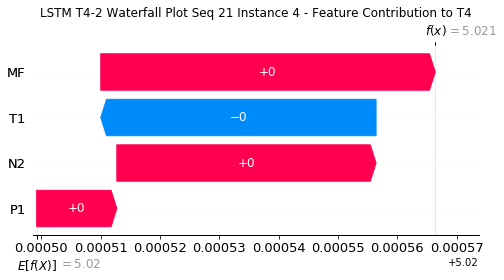

None

Contribution: [ 1.68433164e-05 -5.25911577e-05  3.53304691e-05  5.28756247e-05]


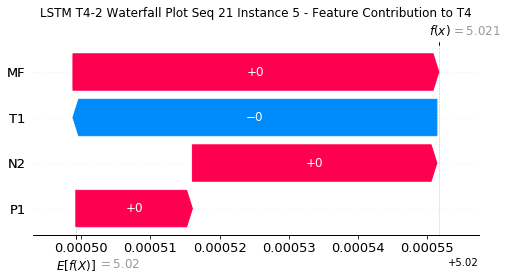

None

Contribution: [ 1.11266505e-05 -3.86417665e-05  3.42448727e-05  4.58536093e-05]


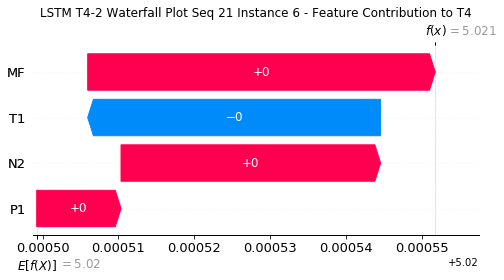

None

Contribution: [ 1.05625823e-05 -3.50413134e-05  3.26300336e-05  4.76993576e-05]


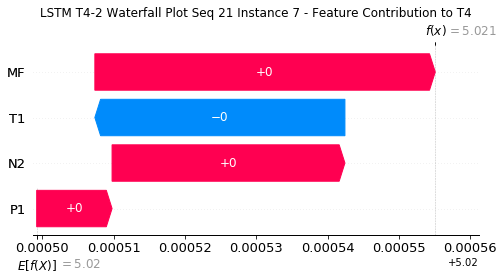

None

Contribution: [ 1.02515827e-05 -2.80141427e-05  3.25318390e-05  4.77559528e-05]


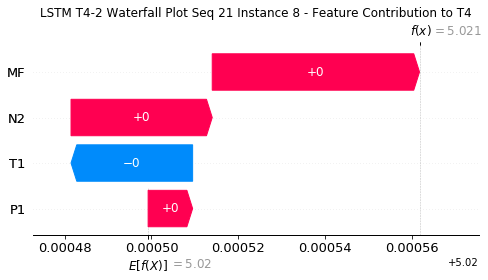

None

Contribution: [ 9.20541215e-06 -2.83438354e-05  3.26302336e-05  4.91412420e-05]


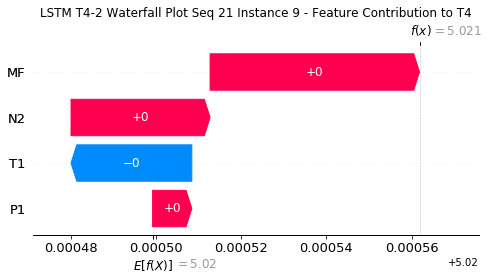

None

Contribution: [ 6.62615067e-06 -3.78842875e-05  3.24734124e-05  4.23088745e-05]


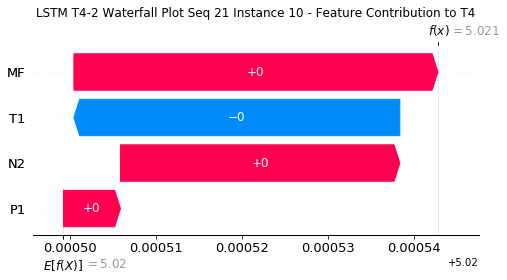

None

Contribution: [ 8.85095609e-06 -4.05072544e-05  3.14763738e-05  4.02410813e-05]


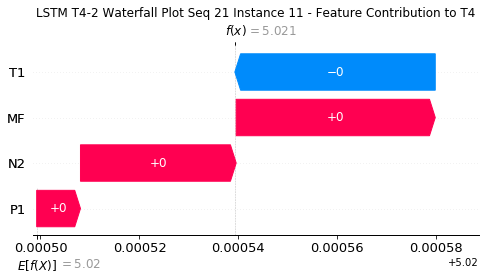

None

Contribution: [ 1.35544755e-05 -4.09133647e-05  3.33554038e-05  5.27688446e-05]


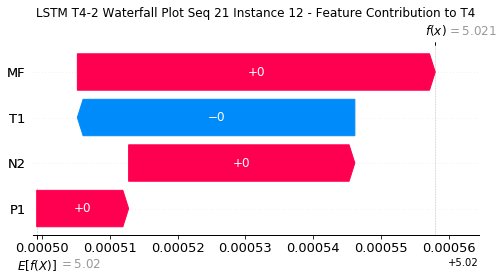

None

Contribution: [ 9.14593288e-06 -4.07164873e-05  3.09768388e-05  4.16246081e-05]


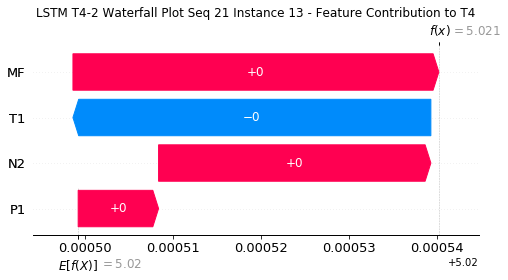

None

Contribution: [ 9.92194882e-06 -4.03214514e-05  3.23772046e-05  4.53480464e-05]


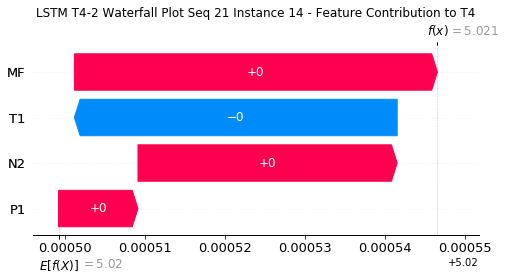

None

Contribution: [ 1.29532570e-05 -4.96400905e-05  3.24559919e-05  4.98888759e-05]


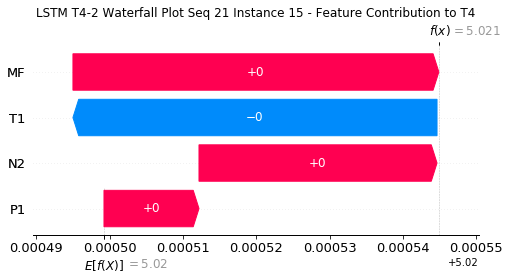

None

Contribution: [ 1.16754235e-05 -4.83558409e-05  3.20187407e-05  4.54772786e-05]


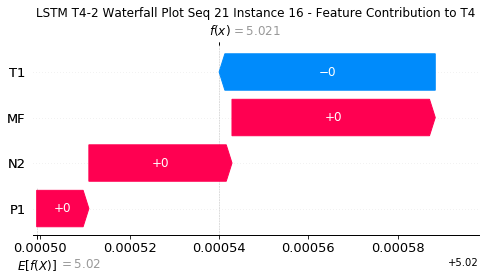

None

Contribution: [ 8.62055692e-06 -5.22211517e-05  3.23401867e-05  4.53965338e-05]


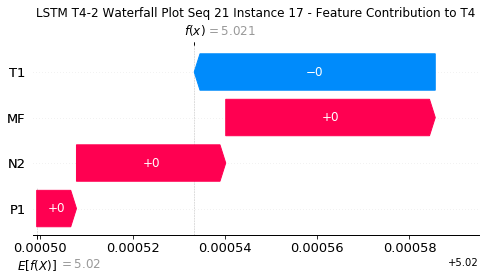

None

Contribution: [ 1.22753883e-05 -4.90013266e-05  3.22064492e-05  4.58825493e-05]


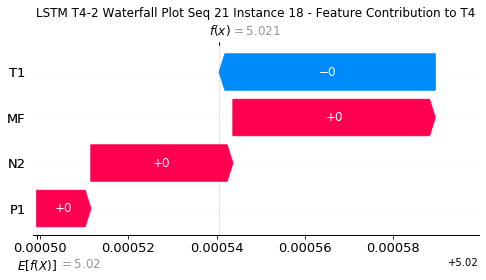

None

Contribution: [ 9.69757136e-06 -5.45188275e-05  3.11354528e-05  4.14241397e-05]


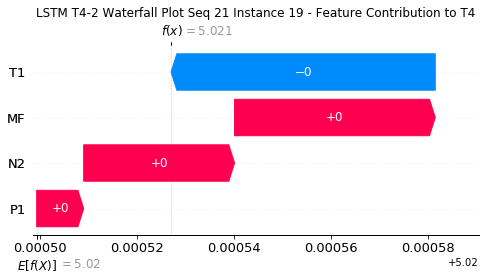

None

Contribution: [ 8.67137414e-06 -5.66997712e-05  3.20375424e-05  4.19725423e-05]


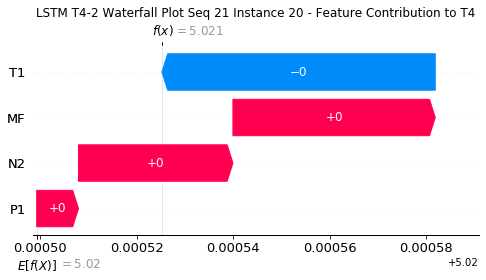

None

Contribution: [ 6.08529567e-06 -6.75384465e-05  3.40619958e-05  4.73521219e-05]


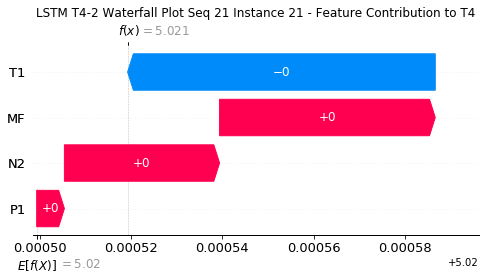

None

Contribution: [ 1.29730941e-05 -1.29741421e-04  4.87568644e-05  6.93908521e-05]


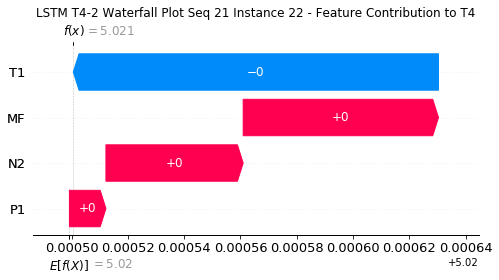

None

Contribution: [ 4.71642438e-05 -4.17808396e-04  1.58641063e-04  2.37931464e-04]


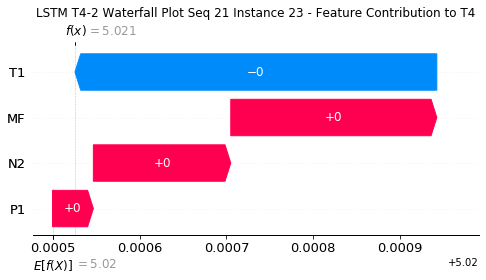

None

Contribution: [ 0.00052229 -0.00207627  0.00135921  0.00213636]


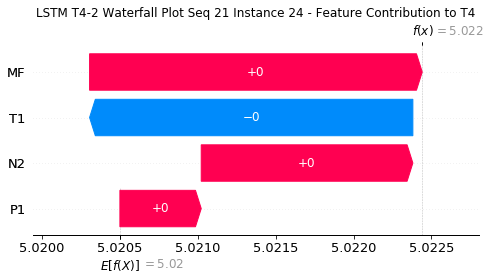

None

Contribution: [ 0.00087083 -0.00473271  0.00257276  0.00416428]


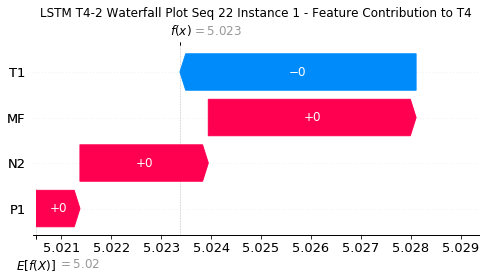

None

Contribution: [ 0.00031374 -0.00087958  0.00090286  0.00145386]


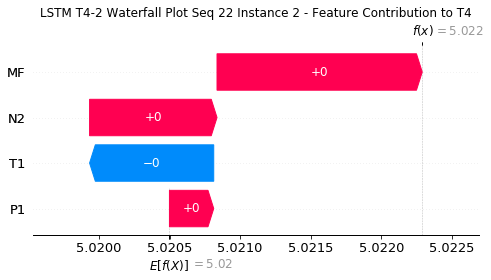

None

Contribution: [ 7.35006809e-05 -2.10323539e-04  1.77899805e-04  2.66306206e-04]


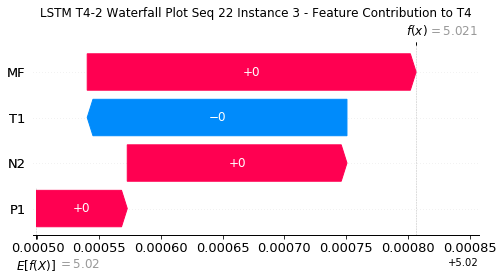

None

Contribution: [ 1.46581807e-05 -5.61696197e-05  3.92711621e-05  6.21507738e-05]


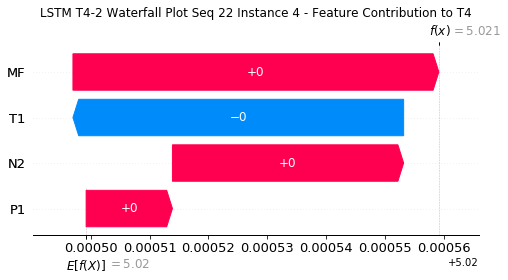

None

Contribution: [ 1.23134700e-05 -4.96184403e-05  3.32542132e-05  5.41451712e-05]


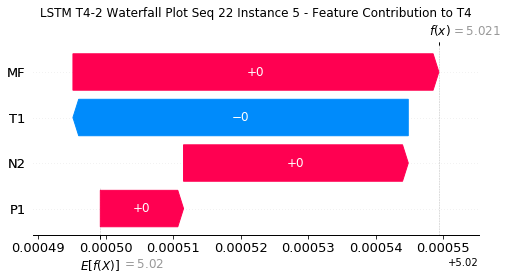

None

Contribution: [ 1.36100522e-05 -4.16764112e-05  3.19731665e-05  4.49792979e-05]


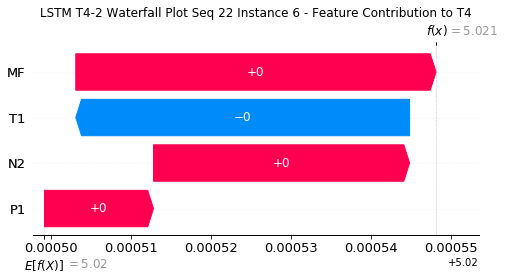

None

Contribution: [ 8.12591445e-06 -4.24859736e-05  3.14141227e-05  5.15235555e-05]


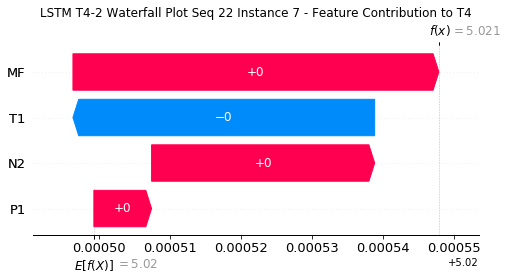

None

Contribution: [ 1.05050270e-05 -3.08704188e-05  3.26011895e-05  5.83007917e-05]


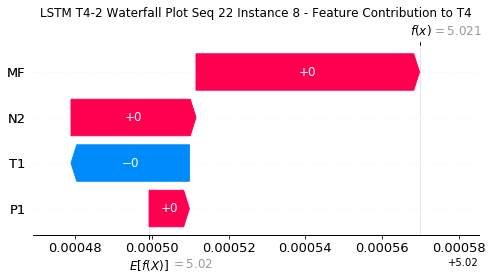

None

Contribution: [ 1.15999511e-05 -3.44977440e-05  3.22504915e-05  5.76995148e-05]


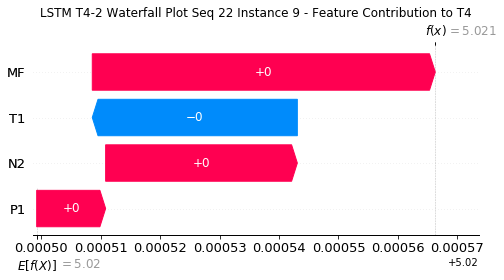

None

Contribution: [ 8.34432710e-06 -3.53453434e-05  3.21685783e-05  5.60758749e-05]


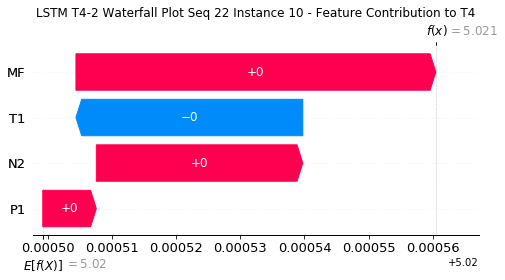

None

Contribution: [ 9.39518981e-06 -4.15925005e-05  3.03808736e-05  4.77653700e-05]


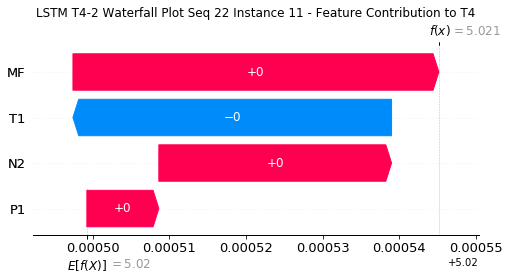

None

Contribution: [ 9.53862331e-06 -4.24694263e-05  3.09254935e-05  4.92451838e-05]


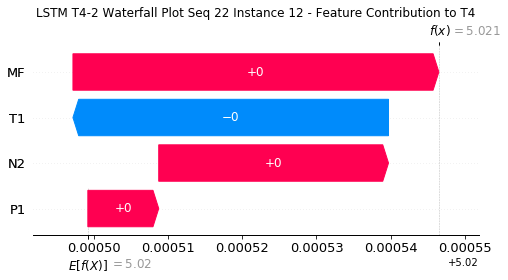

None

Contribution: [ 1.43258448e-05 -4.11681006e-05  3.34494359e-05  6.70598603e-05]


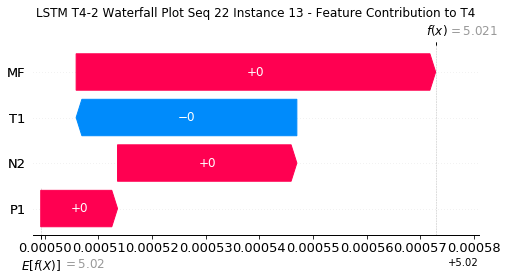

None

Contribution: [ 7.32314567e-06 -4.15210900e-05  3.17377034e-05  5.08542152e-05]


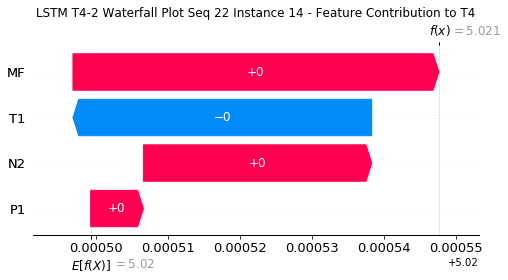

None

Contribution: [ 8.68327582e-06 -4.30985116e-05  3.05031985e-05  4.25886931e-05]


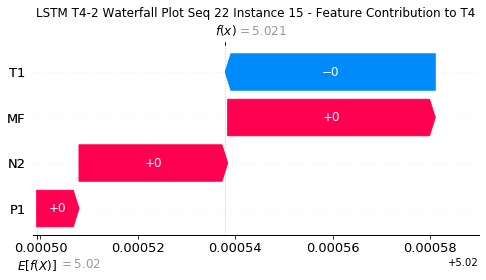

None

Contribution: [ 1.06718587e-05 -3.99343851e-05  3.14148481e-05  4.92634468e-05]


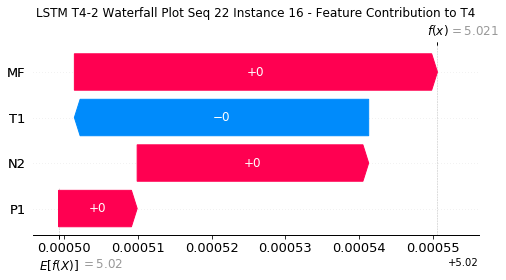

None

Contribution: [ 8.20734271e-06 -4.25855980e-05  3.16706245e-05  5.17817144e-05]


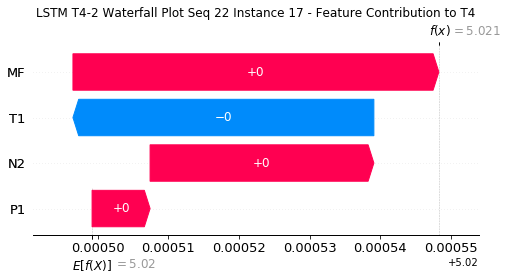

None

Contribution: [ 1.45594846e-05 -4.06262168e-05  3.07833490e-05  4.79015397e-05]


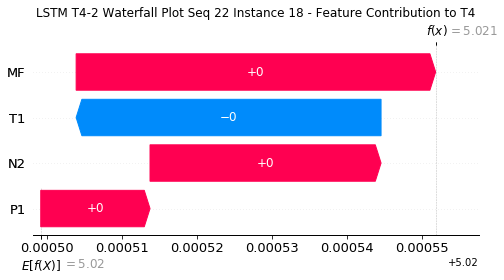

None

Contribution: [ 1.10477063e-05 -4.25970617e-05  3.13731484e-05  4.83920435e-05]


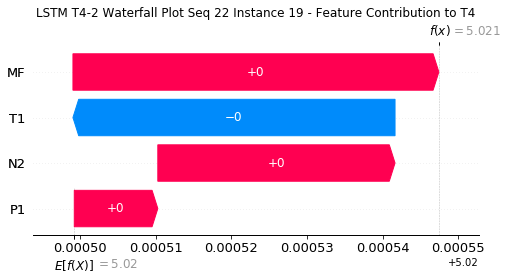

None

Contribution: [ 1.00388804e-05 -4.39516614e-05  3.22629331e-05  5.01665555e-05]


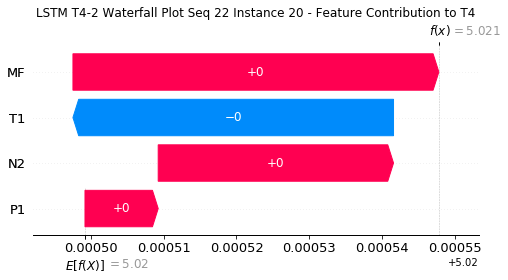

None

Contribution: [ 7.06715026e-06 -5.30968605e-05  3.46667088e-05  5.45263769e-05]


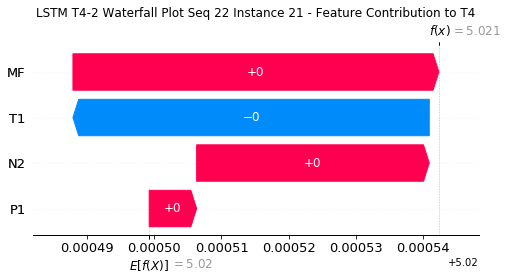

None

Contribution: [ 1.45290419e-05 -9.94229215e-05  4.95793428e-05  8.60896021e-05]


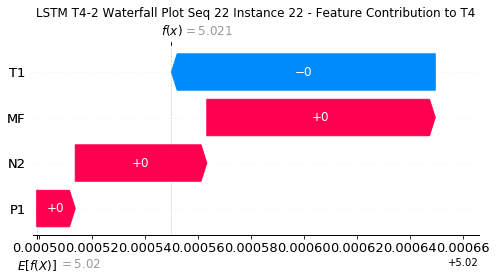

None

Contribution: [ 3.40154215e-05 -3.31693276e-04  1.55402664e-04  2.65476440e-04]


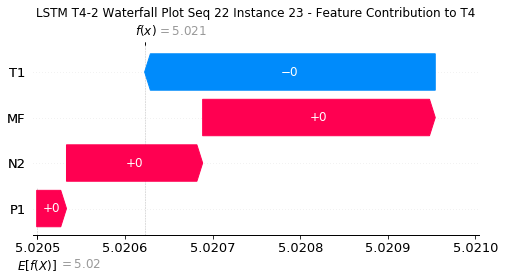

None

Contribution: [ 0.00011511 -0.00204554  0.00124741  0.00169358]


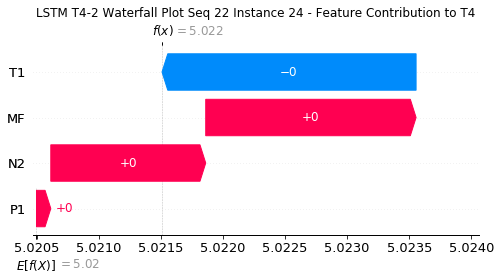

None

Contribution: [ 0.00099541 -0.00374447  0.00270522  0.00449654]


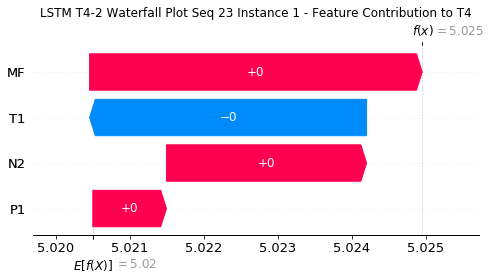

None

Contribution: [ 0.00032811 -0.00067402  0.00095748  0.00140596]


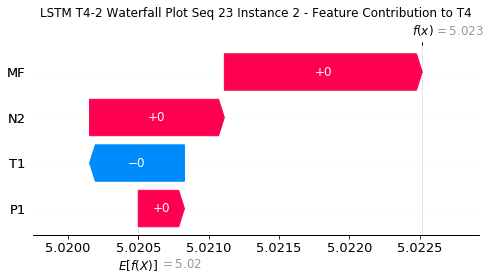

None

Contribution: [ 8.11707492e-05 -1.45933057e-04  1.93202129e-04  2.63500117e-04]


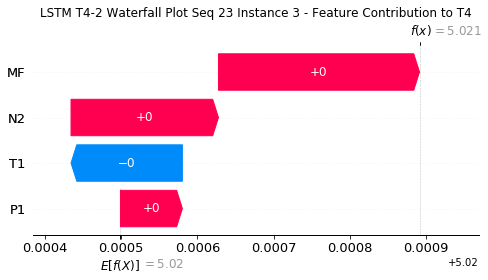

None

Contribution: [ 1.63141222e-05 -4.80836317e-05  4.48118339e-05  5.82953230e-05]


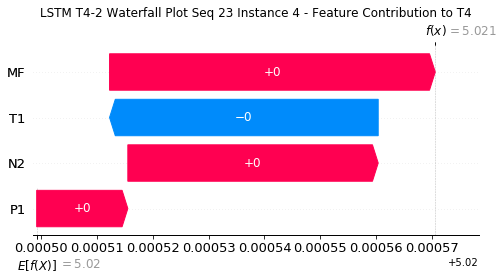

None

Contribution: [ 1.36090548e-05 -4.30162750e-05  3.76074963e-05  5.04200011e-05]


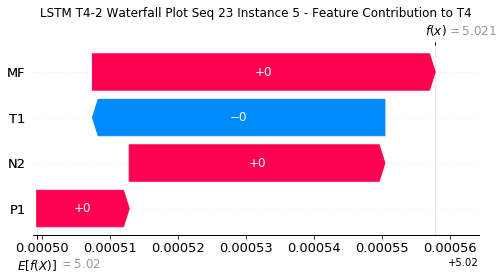

None

Contribution: [ 1.69102630e-05 -3.89566902e-05  3.61847341e-05  5.11265094e-05]


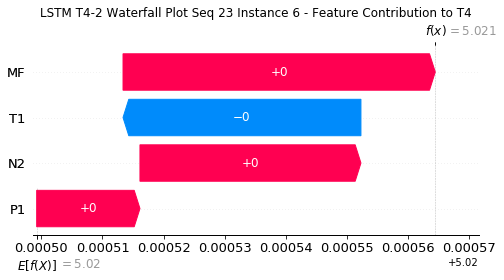

None

Contribution: [ 9.45288176e-06 -3.86554465e-05  3.48426459e-05  4.77167918e-05]


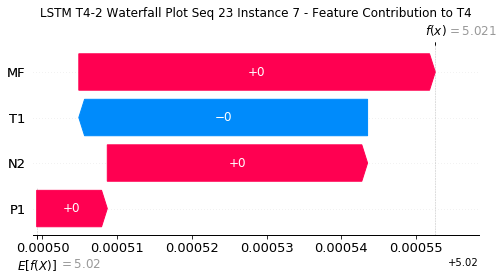

None

Contribution: [ 1.25449446e-05 -3.84938352e-05  3.47264949e-05  5.13881623e-05]


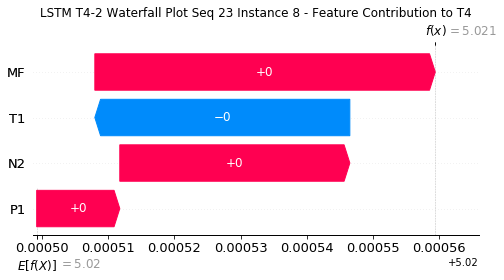

None

Contribution: [ 1.11659495e-05 -3.13429103e-05  3.40891702e-05  4.44708754e-05]


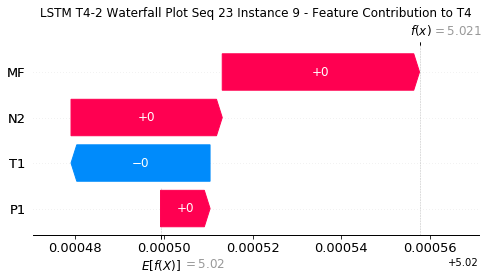

None

Contribution: [ 1.13962753e-05 -3.53875222e-05  3.50195681e-05  5.46163294e-05]


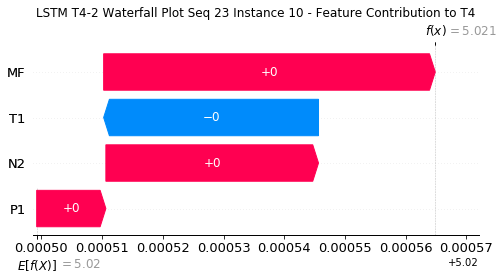

None

Contribution: [ 1.15881834e-05 -3.84374884e-05  3.29311585e-05  4.50627138e-05]


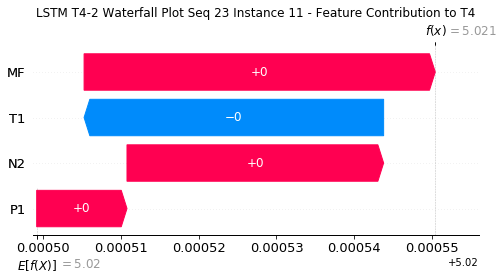

None

Contribution: [ 1.12839258e-05 -4.09475988e-05  3.31319703e-05  4.46573915e-05]


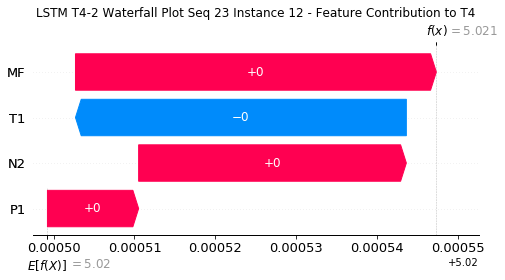

None

Contribution: [ 1.31073881e-05 -3.86666137e-05  3.24524649e-05  4.42589598e-05]


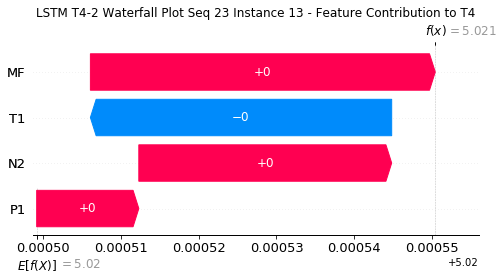

None

Contribution: [ 9.40104536e-06 -4.02351970e-05  3.35143212e-05  4.63157019e-05]


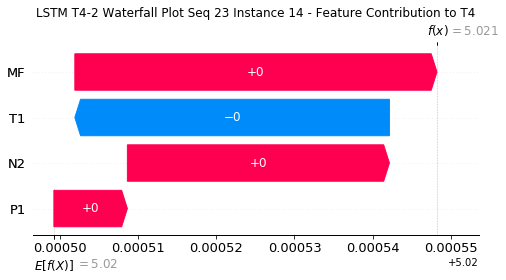

None

Contribution: [ 1.16827179e-05 -4.49835885e-05  3.03168726e-05  3.13889881e-05]


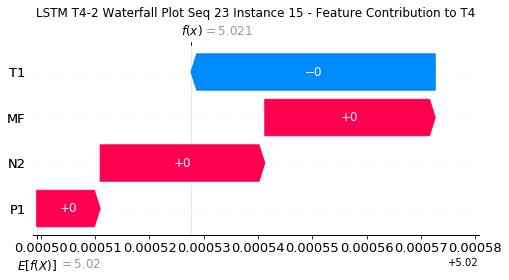

None

Contribution: [ 1.19466216e-05 -4.14131076e-05  3.24139249e-05  4.28762522e-05]


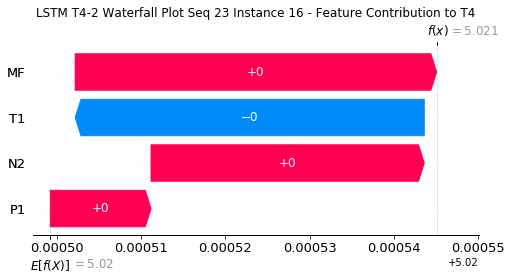

None

Contribution: [ 9.05555421e-06 -4.38933398e-05  3.24324259e-05  4.42926113e-05]


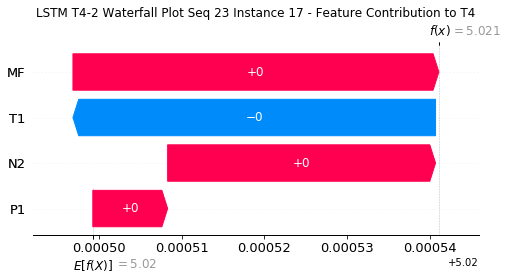

None

Contribution: [ 1.00765011e-05 -4.51691068e-05  3.08246411e-05  3.57628525e-05]


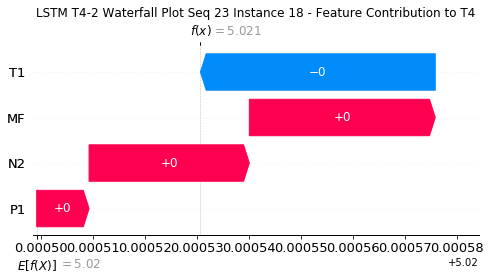

None

Contribution: [ 1.19685059e-05 -4.60456160e-05  3.18083471e-05  3.96709401e-05]


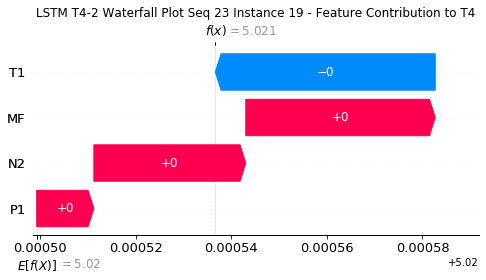

None

Contribution: [ 1.13633668e-05 -4.66766695e-05  3.26581977e-05  4.13183592e-05]


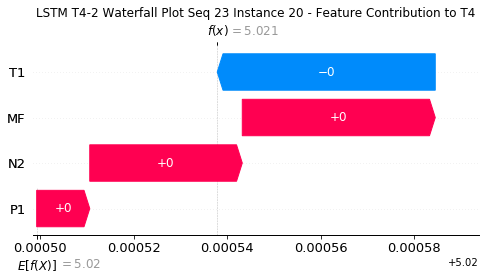

None

Contribution: [ 9.78785746e-06 -5.47374658e-05  3.52664431e-05  4.58097935e-05]


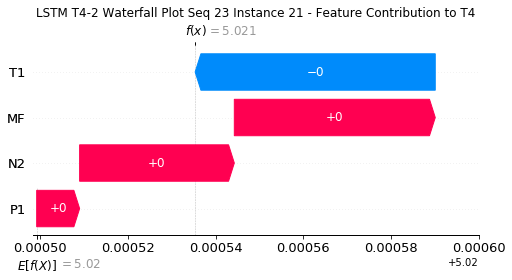

None

Contribution: [ 1.89556377e-05 -1.01003171e-04  5.01549415e-05  7.16118375e-05]


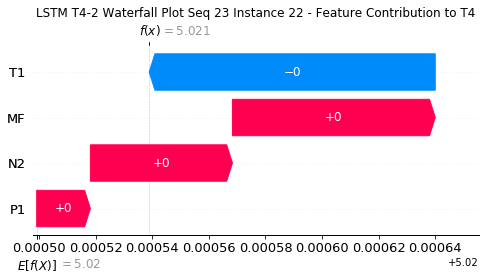

None

Contribution: [ 7.01881065e-05 -3.18350888e-04  1.63046833e-04  2.49288161e-04]


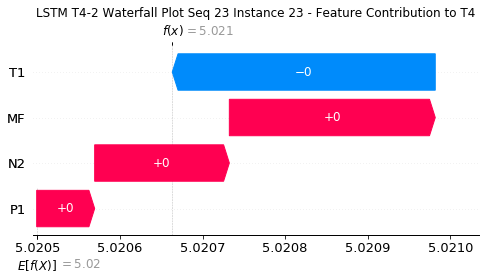

None

Contribution: [ 0.00059587 -0.00181245  0.00134738  0.00204574]


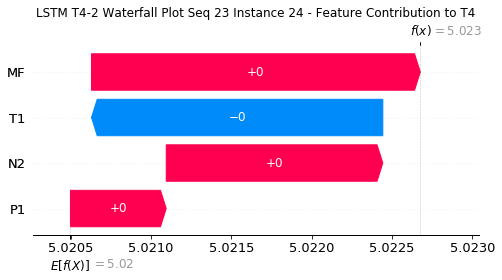

None

Contribution: [ 0.00109675 -0.00391819  0.0026739   0.00364567]


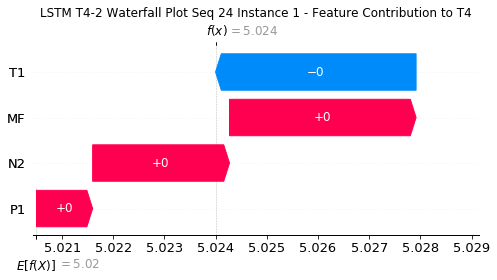

None

Contribution: [ 0.00038458 -0.00070428  0.00095659  0.00125702]


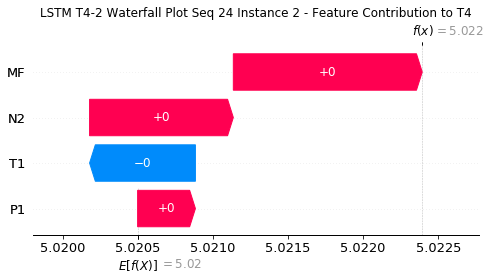

None

Contribution: [ 7.24379904e-05 -1.60459302e-04  1.91211094e-04  2.33226772e-04]


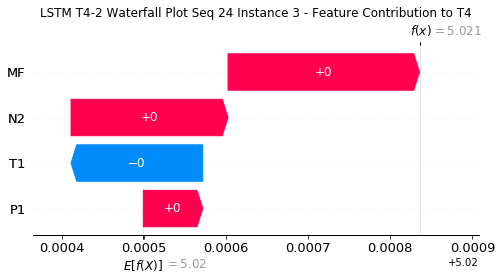

None

Contribution: [ 1.74550979e-05 -5.80159158e-05  4.55498010e-05  6.00362306e-05]


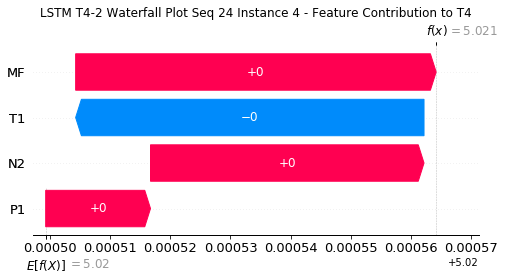

None

Contribution: [ 1.43673913e-05 -4.98310392e-05  3.79599236e-05  5.05210490e-05]


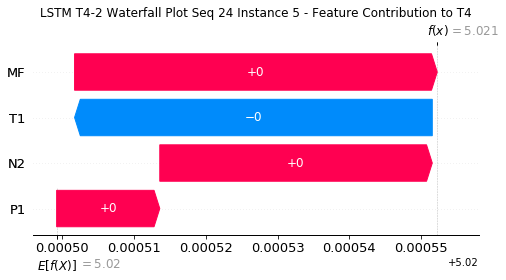

None

Contribution: [ 1.49569240e-05 -4.75483820e-05  3.58998126e-05  5.33724043e-05]


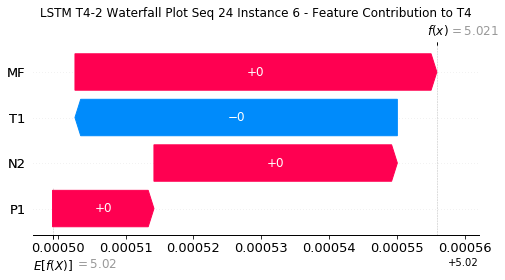

None

Contribution: [ 9.69765075e-06 -4.37652383e-05  3.49015828e-05  4.71906558e-05]


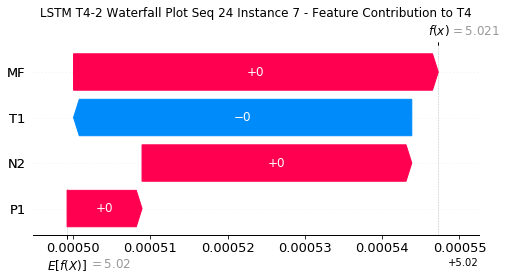

None

Contribution: [ 1.09214586e-05 -4.61420896e-05  3.47949211e-05  4.95221912e-05]


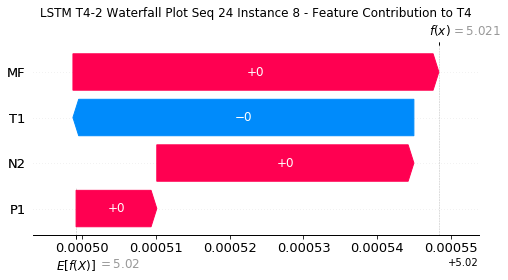

None

Contribution: [ 9.21887071e-06 -4.27390160e-05  3.40476561e-05  4.73000669e-05]


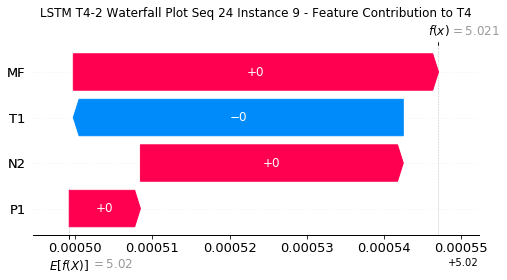

None

Contribution: [ 1.14056339e-05 -4.39121479e-05  3.41886700e-05  4.59189976e-05]


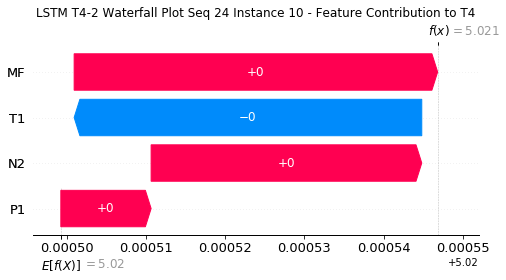

None

Contribution: [ 1.26413798e-05 -3.89908342e-05  3.32624639e-05  4.59974588e-05]


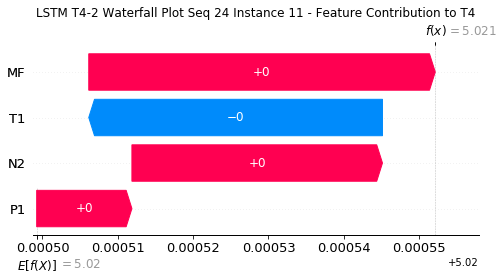

None

Contribution: [ 1.21145674e-05 -4.05212970e-05  3.36133477e-05  4.72368254e-05]


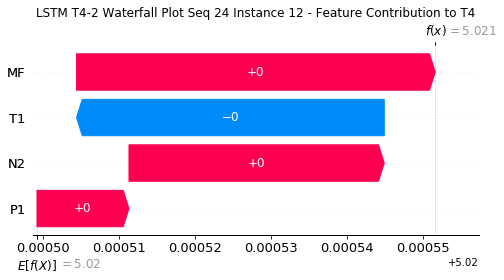

None

Contribution: [ 1.25805424e-05 -3.56009473e-05  3.23048571e-05  4.68439420e-05]


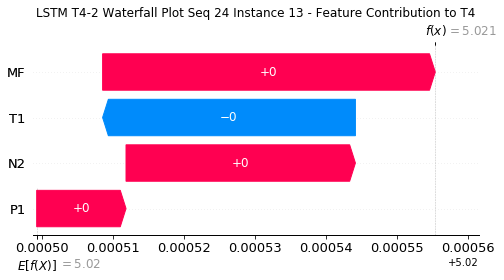

None

Contribution: [ 1.09501317e-05 -3.76021839e-05  3.42031254e-05  5.03367390e-05]


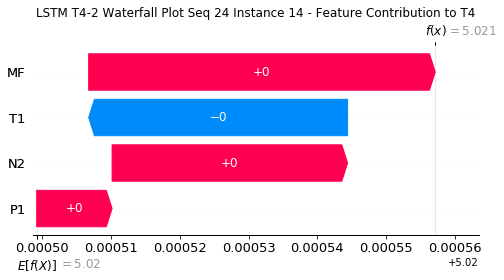

None

Contribution: [ 1.16535923e-05 -3.64441127e-05  3.47482471e-05  4.53982701e-05]


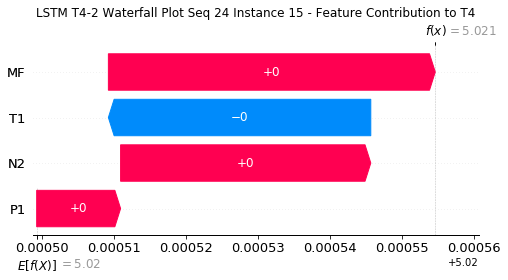

None

Contribution: [ 1.30502710e-05 -3.57252002e-05  3.30601299e-05  4.81311479e-05]


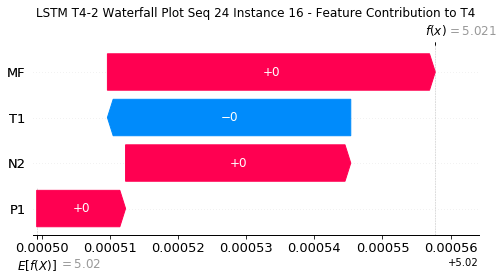

None

Contribution: [ 9.55459725e-06 -3.69525661e-05  3.24329498e-05  4.73273830e-05]


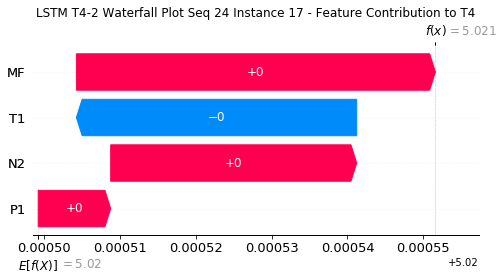

None

Contribution: [ 1.33186405e-05 -3.16873381e-05  3.08536299e-05  4.63989900e-05]


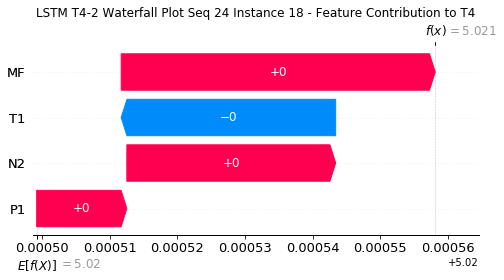

None

Contribution: [ 1.28301689e-05 -3.68127492e-05  3.20931224e-05  4.65582906e-05]


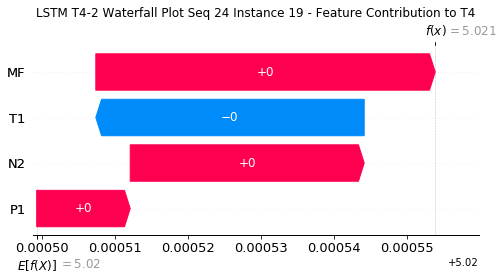

None

Contribution: [ 1.19325414e-05 -3.66569748e-05  3.25143866e-05  4.64099839e-05]


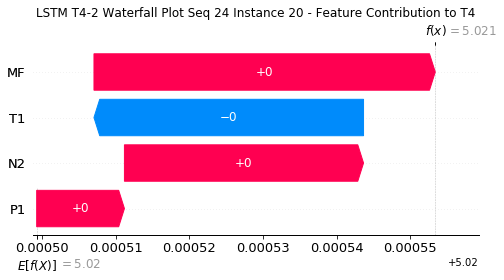

None

Contribution: [ 1.15078812e-05 -4.26146248e-05  3.53407975e-05  5.30085245e-05]


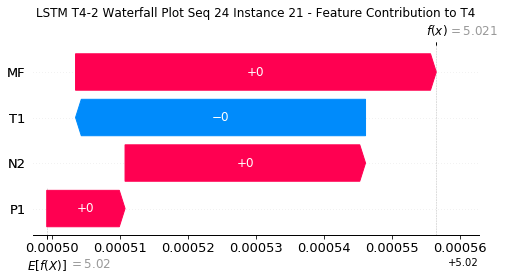

None

Contribution: [ 2.15852945e-05 -7.67908699e-05  4.93190247e-05  7.89915947e-05]


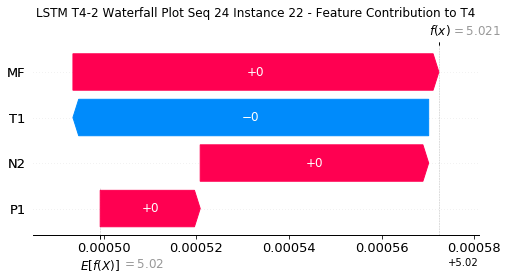

None

Contribution: [ 7.92164367e-05 -2.45378124e-04  1.63263485e-04  2.95975444e-04]


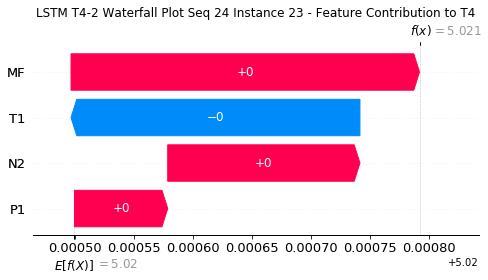

None

Contribution: [ 0.00025874 -0.00169777  0.0012715   0.00163784]


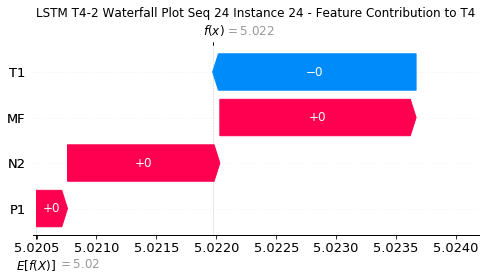

None

Contribution: [ 0.00049448 -0.00301919  0.00241395  0.00229925]


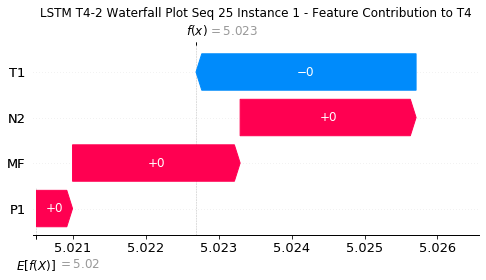

None

Contribution: [ 0.0003171  -0.00051207  0.00094367  0.00115569]


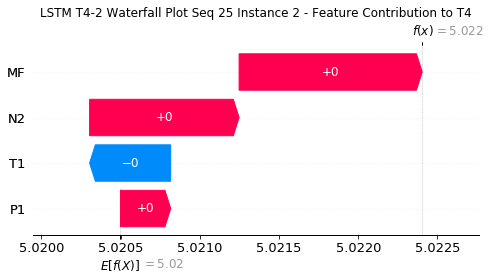

None

Contribution: [ 6.75367658e-05 -1.14453838e-04  1.93640593e-04  2.35758054e-04]


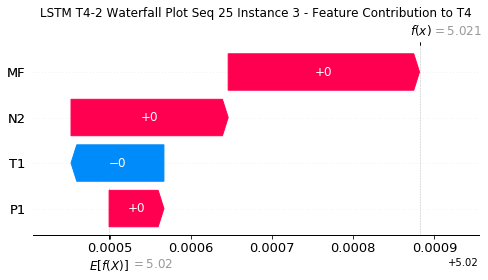

None

Contribution: [ 1.83951428e-05 -4.39077465e-05  4.64609696e-05  6.73734375e-05]


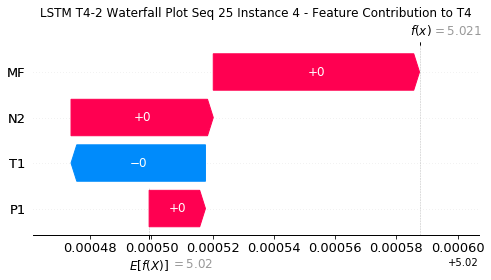

None

Contribution: [ 1.48176629e-05 -3.94972138e-05  3.85277645e-05  5.50045567e-05]


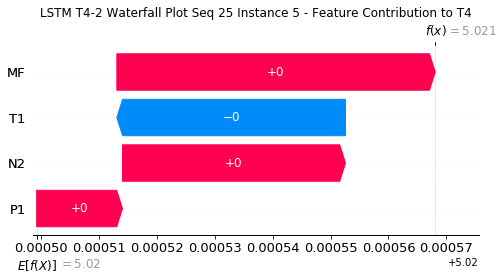

None

Contribution: [ 6.01649920e-06 -4.23745335e-05  3.41458715e-05  3.54544988e-05]


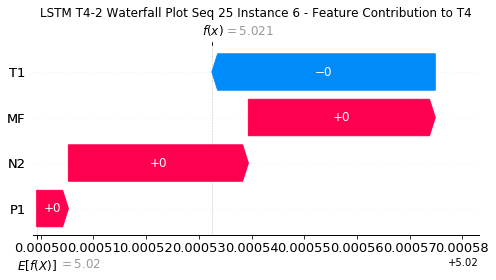

None

Contribution: [ 9.78986332e-06 -3.48300133e-05  3.54262547e-05  5.02846148e-05]


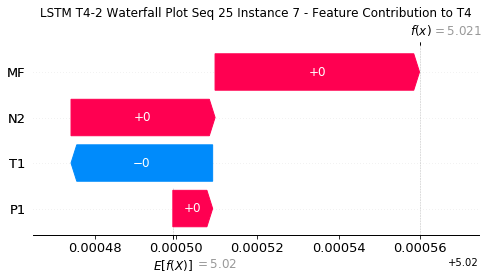

None

Contribution: [ 9.46307660e-06 -3.51210591e-05  3.45653741e-05  4.64472094e-05]


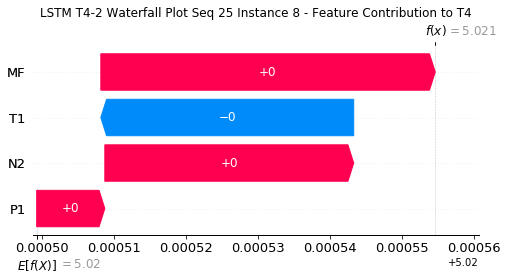

None

Contribution: [ 8.99321774e-06 -3.27523584e-05  3.41452871e-05  4.80362749e-05]


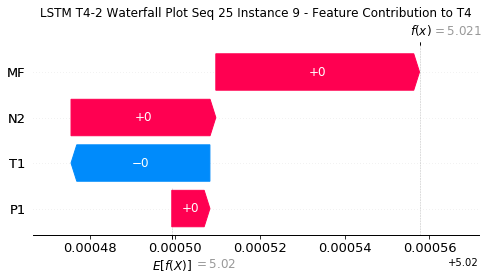

None

Contribution: [ 1.15666048e-05 -3.34369213e-05  3.41750362e-05  4.48519950e-05]


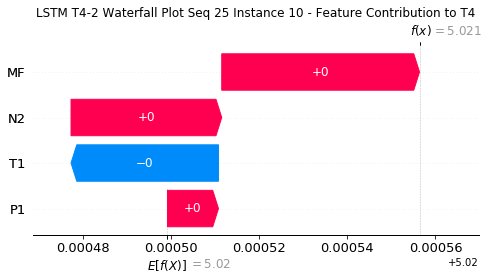

None

Contribution: [ 9.78726281e-06 -3.62651297e-05  3.23141142e-05  4.15975436e-05]


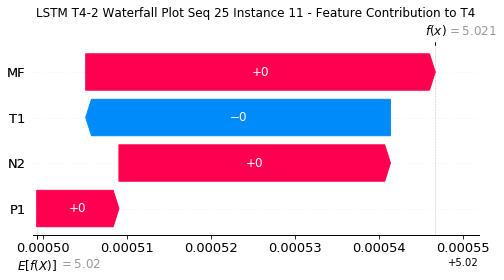

None

Contribution: [ 9.22769076e-06 -3.74983720e-05  3.28093610e-05  4.33445794e-05]


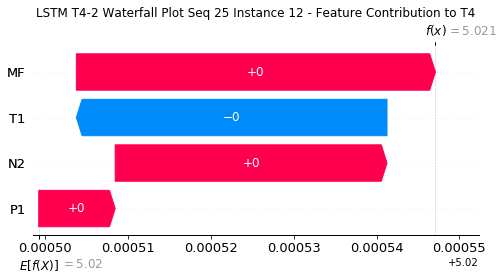

None

Contribution: [ 6.78832311e-06 -3.68713565e-05  3.18256481e-05  3.85512576e-05]


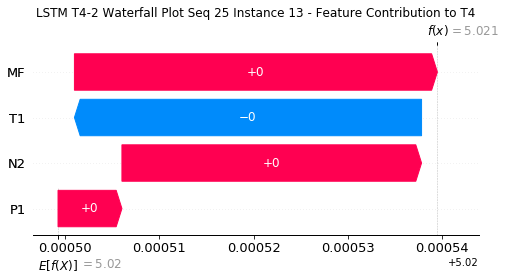

None

Contribution: [ 7.27698801e-06 -3.53134507e-05  3.31767311e-05  4.49286271e-05]


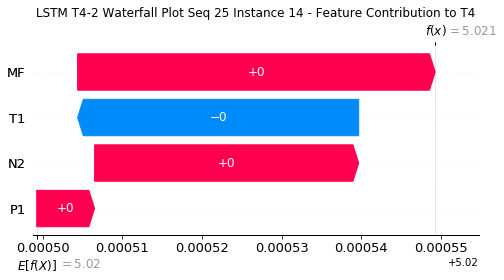

None

Contribution: [ 1.38363270e-05 -3.52871443e-05  3.32129128e-05  4.70759129e-05]


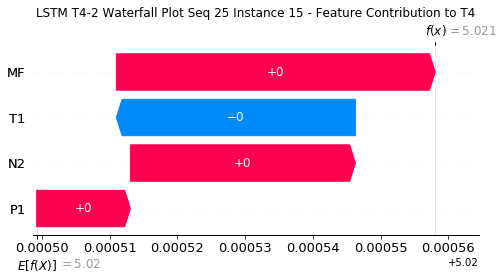

None

Contribution: [ 9.05822602e-06 -3.40264924e-05  3.20753364e-05  4.18768156e-05]


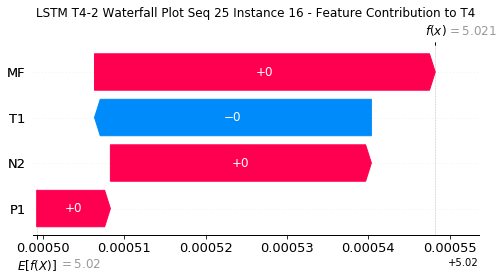

None

Contribution: [ 7.21181454e-06 -3.44934719e-05  3.23171420e-05  4.49208900e-05]


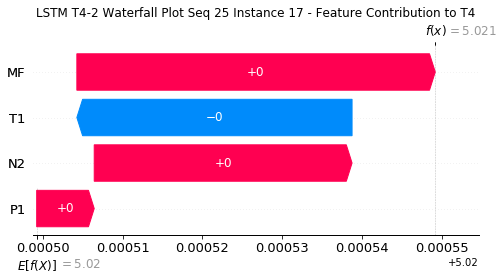

None

Contribution: [ 1.30934599e-05 -2.67279544e-05  3.30263255e-05  5.17242864e-05]


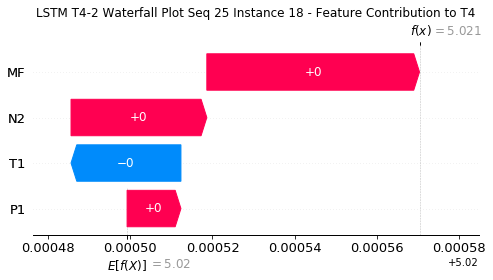

None

Contribution: [ 1.10617285e-05 -3.10380364e-05  3.28258772e-05  4.76326384e-05]


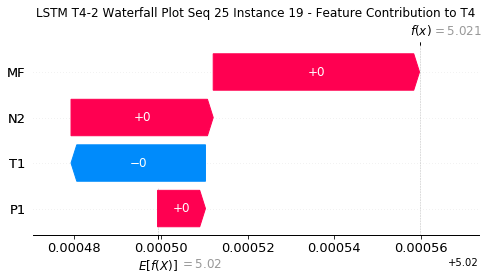

None

Contribution: [ 1.08927568e-05 -3.06837479e-05  3.36600872e-05  4.93521284e-05]


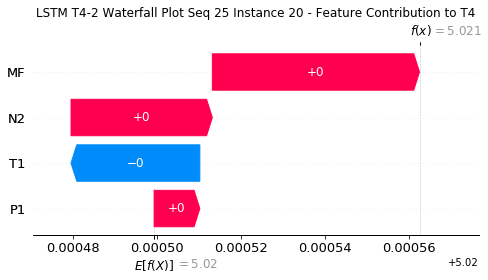

None

Contribution: [ 9.98264993e-06 -3.52688522e-05  3.66415057e-05  5.67290329e-05]


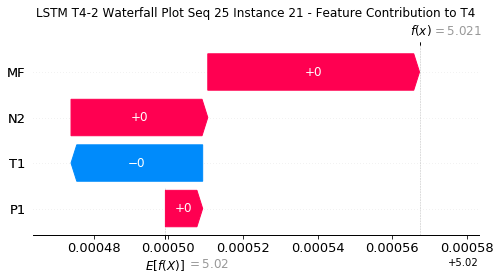

None

Contribution: [ 1.90975253e-05 -6.75431392e-05  5.12623376e-05  8.32637897e-05]


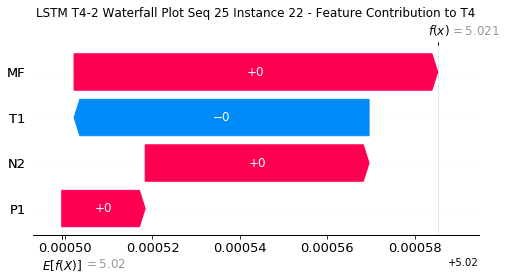

None

Contribution: [ 7.03002854e-05 -1.88207342e-04  1.69545775e-04  3.03490872e-04]


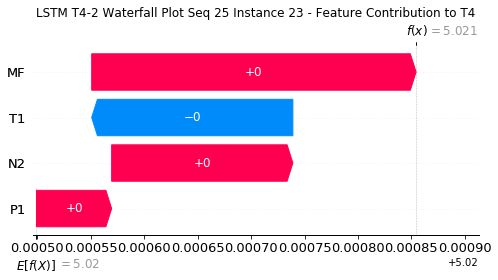

None

Contribution: [ 0.00044657 -0.0010339   0.00136458  0.0020043 ]


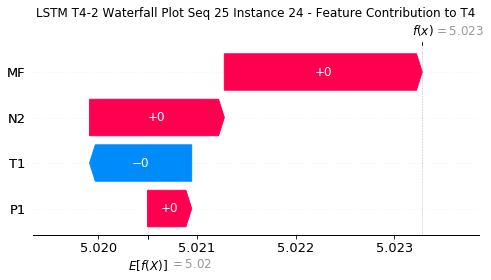

None

Contribution: [ 0.00109041 -0.00223608  0.00272237  0.0040155 ]


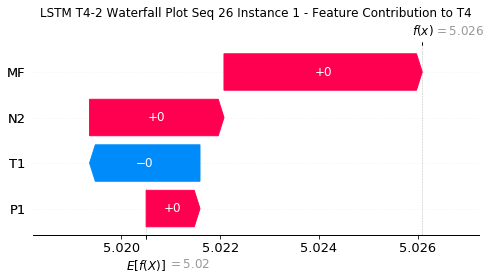

None

Contribution: [ 0.00036337 -0.00035052  0.00096813  0.00137874]


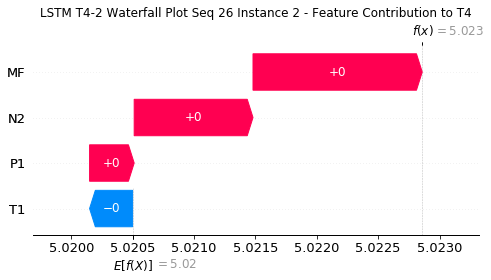

None

Contribution: [ 7.45357307e-05 -7.26139407e-05  1.95481922e-04  2.57971119e-04]


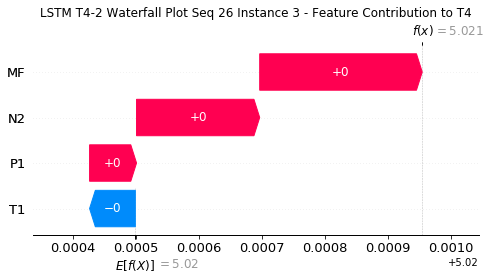

None

Contribution: [ 1.15351930e-05 -3.57747311e-05  4.47933676e-05  5.42057366e-05]


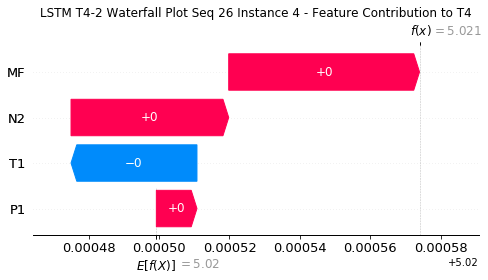

None

Contribution: [ 1.04223397e-05 -3.27566592e-05  3.75119734e-05  4.71439693e-05]


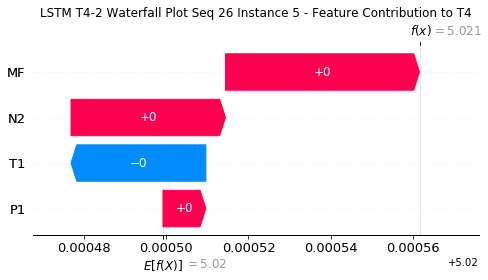

None

Contribution: [ 1.22212233e-05 -2.97140160e-05  3.62347507e-05  5.14952940e-05]


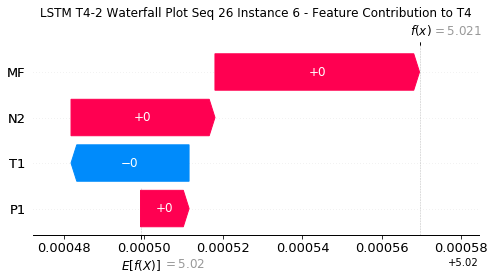

None

Contribution: [ 7.01364119e-06 -3.01668690e-05  3.46833412e-05  4.57051271e-05]


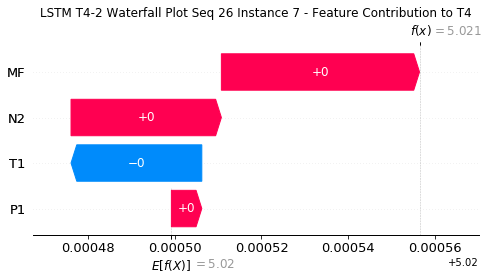

None

Contribution: [ 9.81686216e-06 -3.11706269e-05  3.50414408e-05  5.03674165e-05]


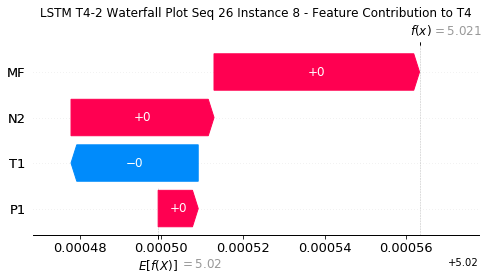

None

Contribution: [ 1.55531101e-05 -2.99048546e-05  3.63233410e-05  6.18923800e-05]


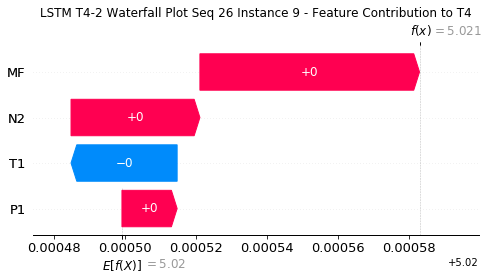

None

Contribution: [ 1.26903166e-05 -2.92586269e-05  3.49852465e-05  5.33895592e-05]


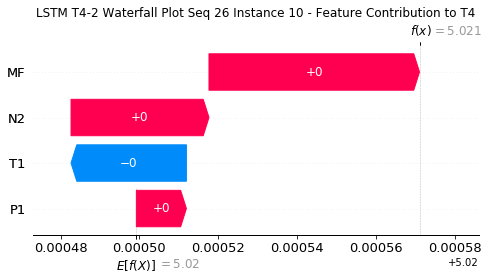

None

Contribution: [ 9.69530052e-06 -3.22521095e-05  3.25898911e-05  4.54052355e-05]


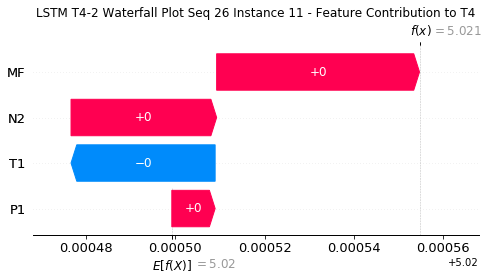

None

Contribution: [ 8.86982737e-06 -3.43002460e-05  3.28971808e-05  4.57719983e-05]


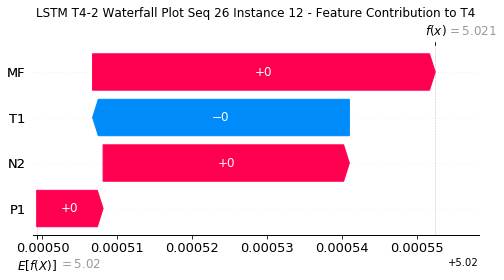

None

Contribution: [ 1.29672273e-05 -2.62688403e-05  3.33612229e-05  5.20978629e-05]


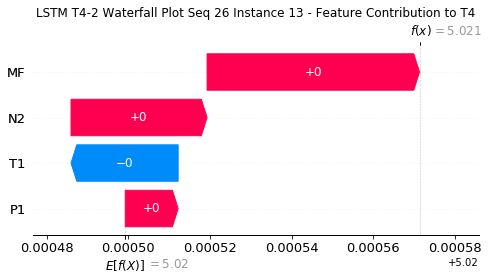

None

Contribution: [ 7.79313947e-06 -3.27669690e-05  3.34676857e-05  5.05256943e-05]


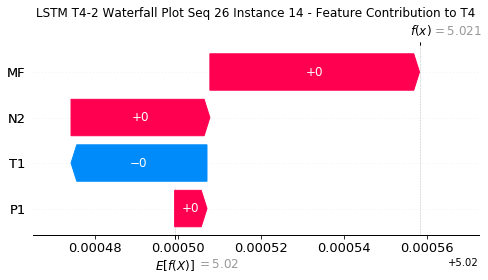

None

Contribution: [ 1.11502626e-05 -3.15036760e-05  3.19617723e-05  4.65131858e-05]


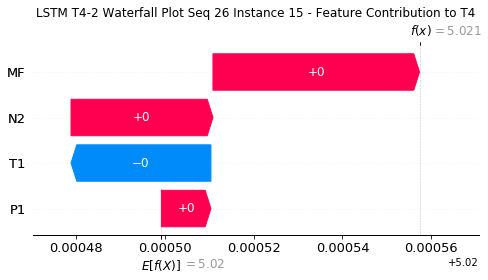

None

Contribution: [ 1.05078130e-05 -3.29876276e-05  3.24697878e-05  4.87635769e-05]


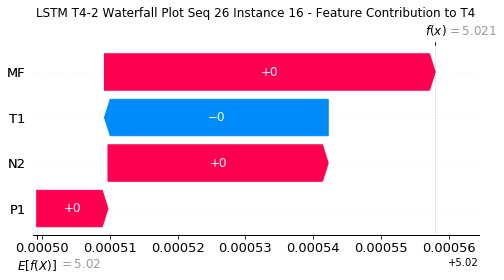

None

Contribution: [ 8.22874229e-06 -3.55678417e-05  3.22179925e-05  4.93219056e-05]


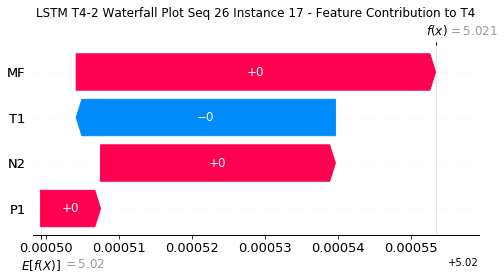

None

Contribution: [ 1.08395802e-05 -3.27955165e-05  3.10148359e-05  4.18027027e-05]


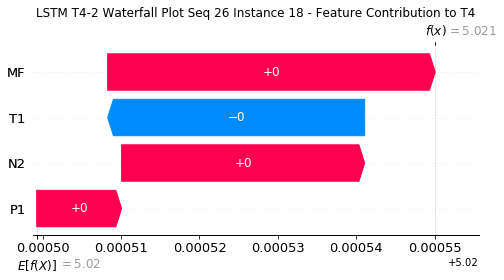

None

Contribution: [ 1.07241318e-05 -3.53740741e-05  3.18683194e-05  4.85358785e-05]


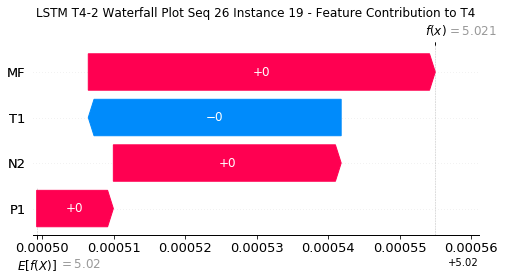

None

Contribution: [ 1.04457036e-05 -3.64092961e-05  3.24608202e-05  4.98808914e-05]


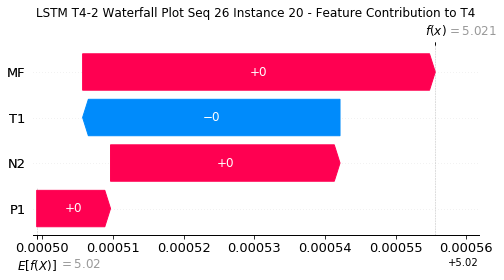

None

Contribution: [ 9.11712420e-06 -4.29927695e-05  3.51594505e-05  5.83205174e-05]


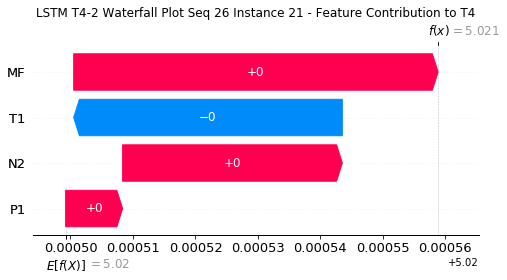

None

Contribution: [ 2.03044149e-05 -8.16117278e-05  4.96316820e-05  9.22840473e-05]


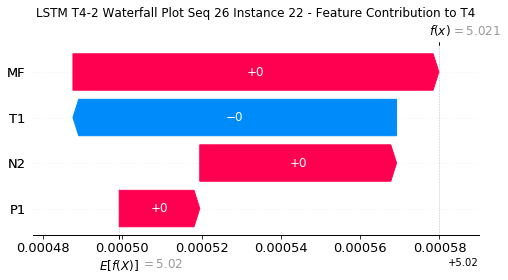

None

Contribution: [ 8.00661790e-05 -2.25893619e-04  1.66700051e-04  3.60289204e-04]


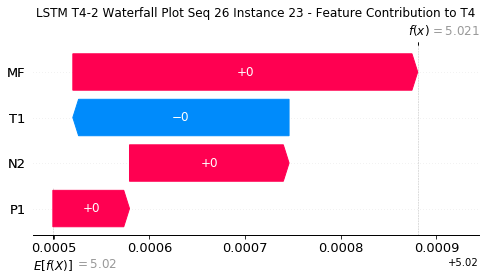

None

Contribution: [ 0.00045407 -0.00125167  0.00135088  0.00227132]


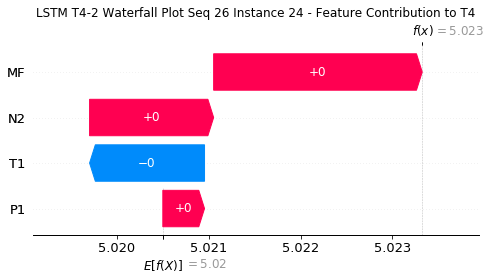

None

Contribution: [ 0.00066174 -0.00355149  0.00250412  0.00306316]


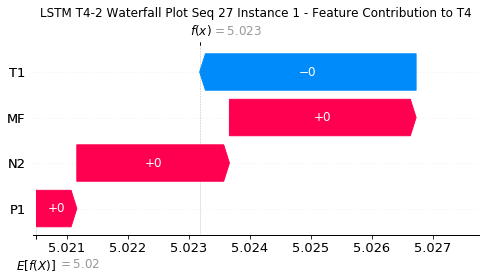

None

Contribution: [ 0.00028497 -0.00054147  0.00094581  0.00133184]


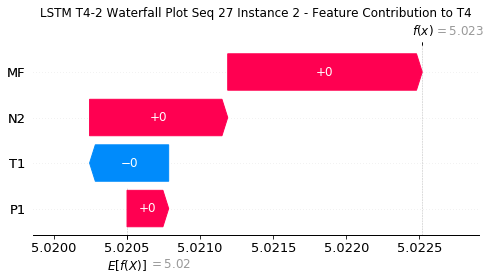

None

Contribution: [ 6.46752526e-05 -9.44925926e-05  1.94817602e-04  2.65879962e-04]


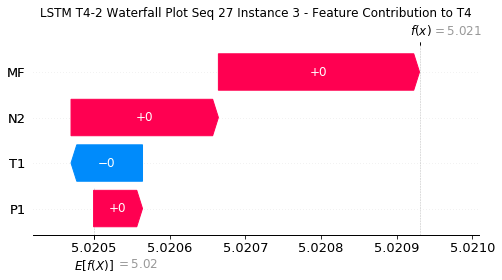

None

Contribution: [ 1.59982738e-05 -3.99065797e-05  4.45703663e-05  5.80392885e-05]


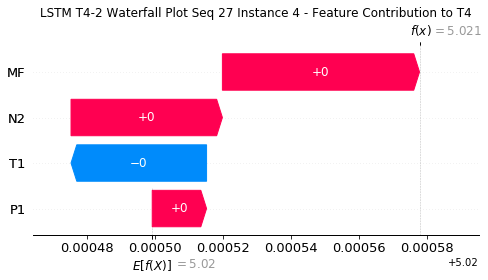

None

Contribution: [ 1.32584067e-05 -3.55385354e-05  3.71709631e-05  4.95606662e-05]


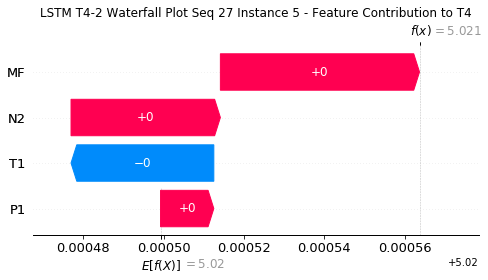

None

Contribution: [ 1.09852856e-05 -3.51501443e-05  3.47769634e-05  4.39656369e-05]


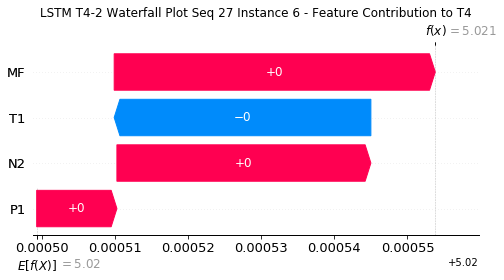

None

Contribution: [ 8.02837865e-06 -3.26450118e-05  3.40553091e-05  4.57220944e-05]


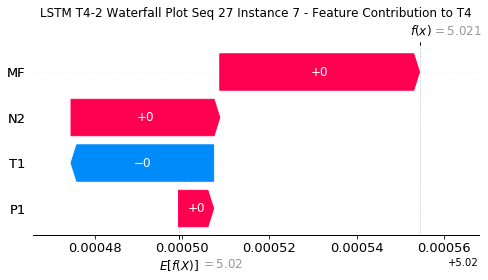

None

Contribution: [ 7.47810124e-06 -3.55057818e-05  3.31165583e-05  4.52107972e-05]


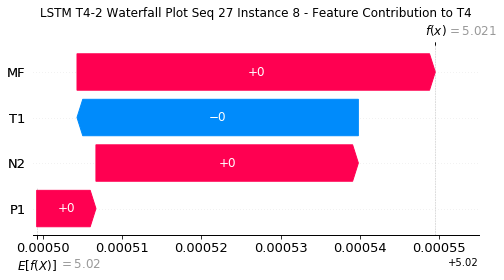

None

Contribution: [ 4.04770635e-06 -4.71192795e-05  3.15159275e-05  3.84784995e-05]


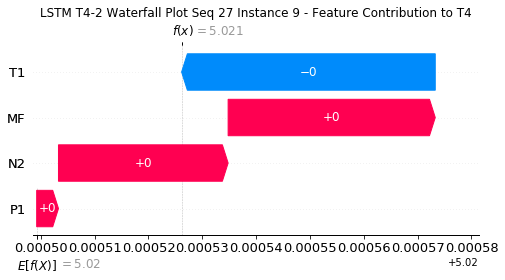

None

Contribution: [ 6.03297634e-06 -3.44362745e-05  3.25587772e-05  4.20637456e-05]


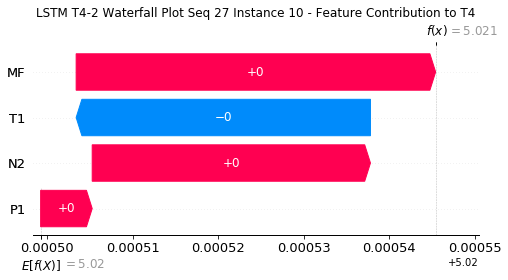

None

Contribution: [ 1.10693032e-05 -3.11946041e-05  3.20767460e-05  4.41832427e-05]


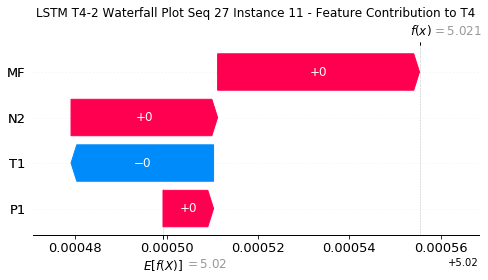

None

Contribution: [ 1.06387162e-05 -3.29627294e-05  3.23887080e-05  4.51923400e-05]


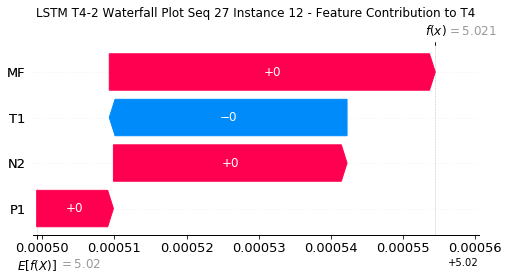

None

Contribution: [ 8.97363530e-06 -2.98565229e-05  3.03983934e-05  3.67200078e-05]


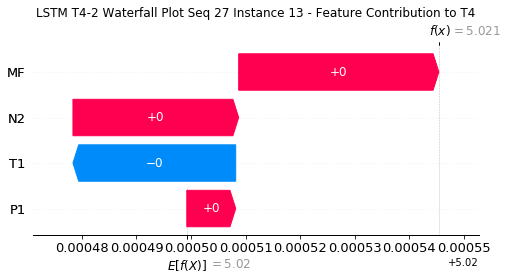

None

Contribution: [ 7.73519388e-06 -3.09602674e-05  3.24944399e-05  4.59625889e-05]


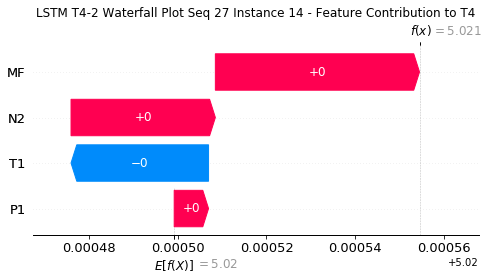

None

Contribution: [ 1.03681932e-05 -3.27228931e-05  3.03630628e-05  3.82397171e-05]


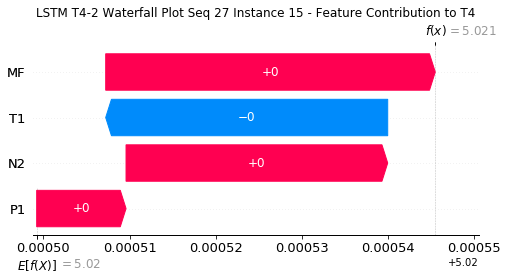

None

Contribution: [ 9.67216903e-06 -3.05892820e-05  3.13438579e-05  4.40092217e-05]


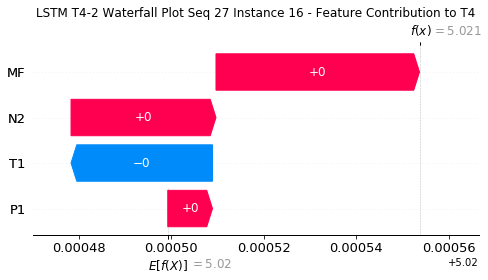

None

Contribution: [ 6.46577610e-06 -3.30151044e-05  3.10880778e-05  4.49292176e-05]


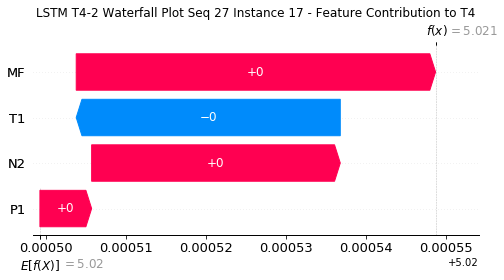

None

Contribution: [ 1.21332382e-05 -2.61117032e-05  3.26090531e-05  5.59558432e-05]


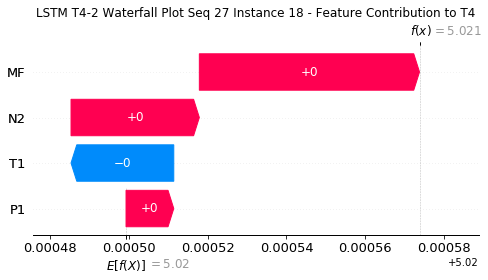

None

Contribution: [ 7.41495889e-06 -3.30065063e-05  3.03048595e-05  4.11173371e-05]


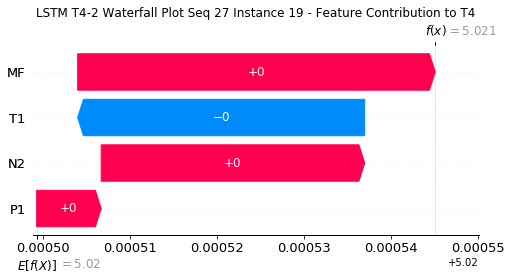

None

Contribution: [ 6.36104663e-06 -3.36847135e-05  3.07517691e-05  4.12629210e-05]


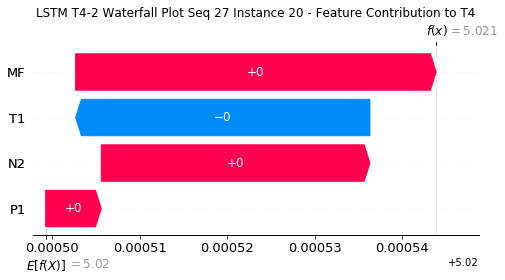

None

Contribution: [ 3.27119599e-06 -3.94721929e-05  3.28374677e-05  4.43131723e-05]


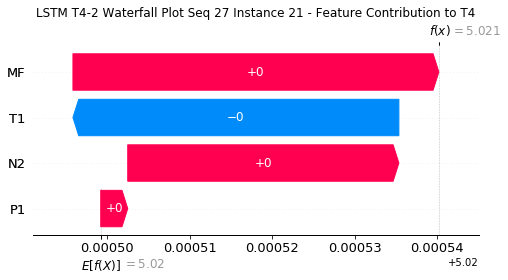

None

Contribution: [ 7.94894198e-06 -7.42100915e-05  4.55113549e-05  6.66777645e-05]


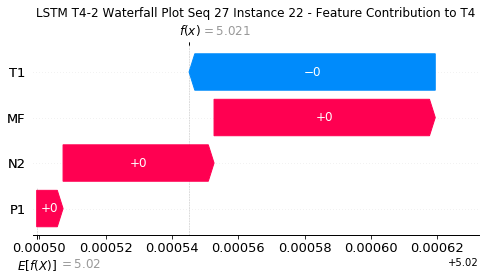

None

Contribution: [ 1.26955934e-05 -2.20727209e-04  1.44455895e-04  2.05685594e-04]


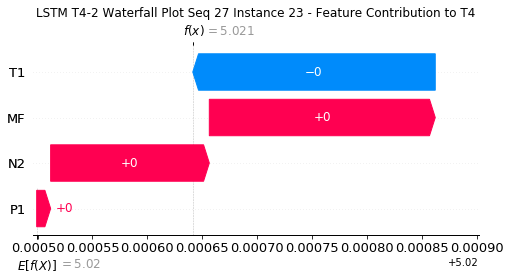

None

Contribution: [ 0.00046342 -0.00120733  0.00128455  0.00205983]


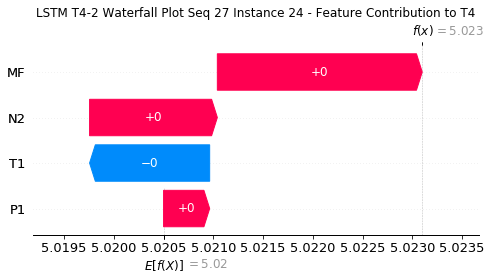

None

Contribution: [ 0.00145868 -0.00272567  0.00265338  0.00481452]


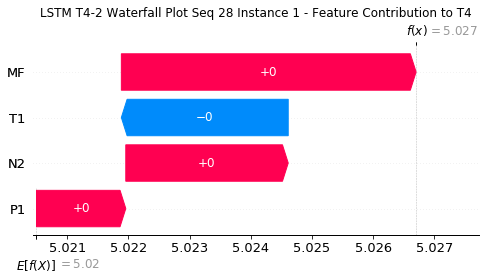

None

Contribution: [ 0.00043745 -0.00038667  0.00095257  0.00155785]


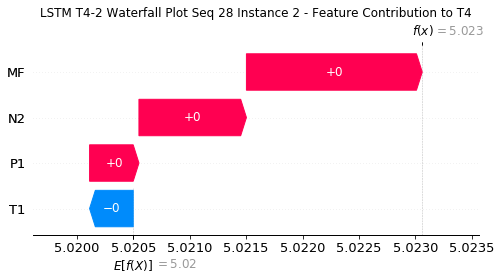

None

Contribution: [ 8.52456469e-05 -7.41954168e-05  1.96019451e-04  3.12575368e-04]


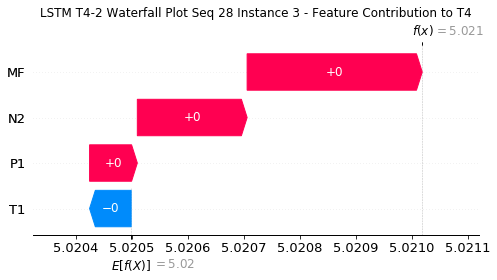

None

Contribution: [ 1.92313472e-05 -1.80566396e-05  4.66028358e-05  6.52080883e-05]


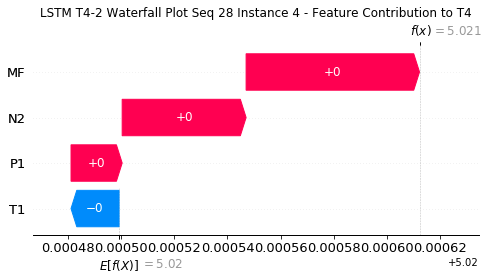

None

Contribution: [ 1.44142905e-05 -2.11566029e-05  3.82818004e-05  5.15392005e-05]


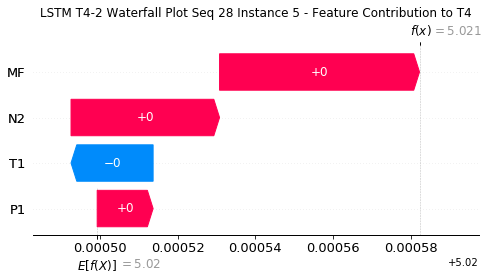

None

Contribution: [ 1.93666128e-05 -1.42279099e-05  3.79090619e-05  6.28228382e-05]


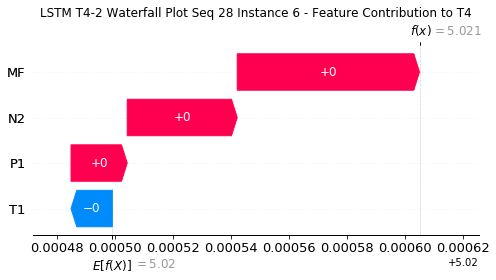

None

Contribution: [ 1.11577015e-05 -2.70798914e-05  3.52247497e-05  4.89894994e-05]


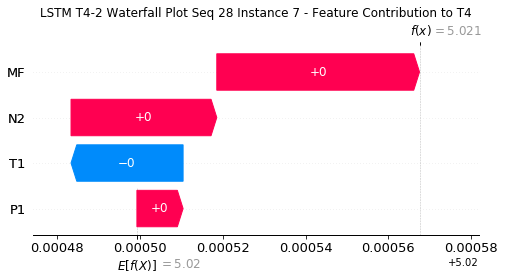

None

Contribution: [ 1.23099250e-05 -3.24605510e-05  3.39403920e-05  5.05586343e-05]


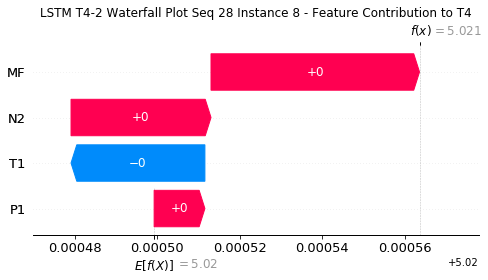

None

Contribution: [ 1.15186848e-05 -3.30777005e-05  3.43378832e-05  5.73860003e-05]


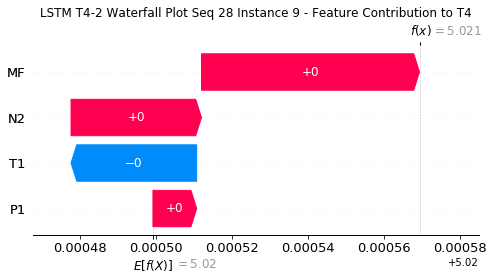

None

Contribution: [ 9.13650349e-06 -3.63269315e-05  3.33147208e-05  4.32133470e-05]


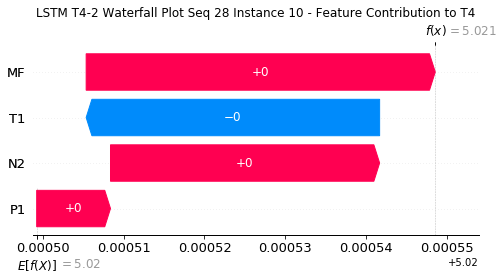

None

Contribution: [ 1.44078093e-05 -3.06764131e-05  3.32894919e-05  4.79824264e-05]


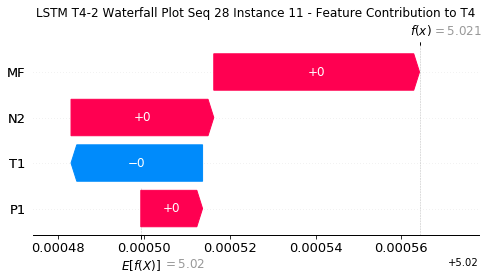

None

Contribution: [ 1.55700988e-05 -3.61382822e-05  3.37611271e-05  5.04348325e-05]


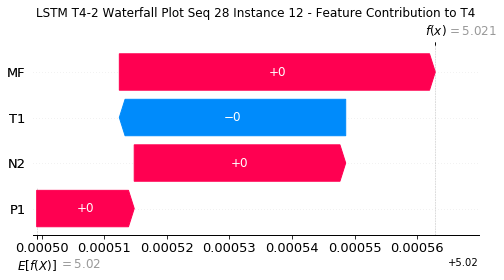

None

Contribution: [ 6.18302195e-06 -3.48590701e-05  3.08116034e-05  4.02364382e-05]


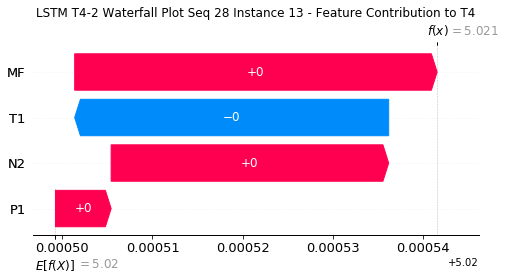

None

Contribution: [ 1.72673067e-05 -4.50451110e-05  3.49073027e-05  5.69249339e-05]


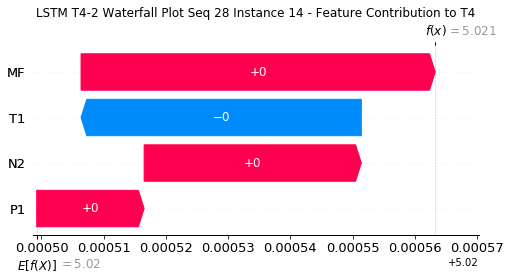

None

Contribution: [ 1.09957822e-05 -5.31511435e-05  3.18273459e-05  4.59308630e-05]


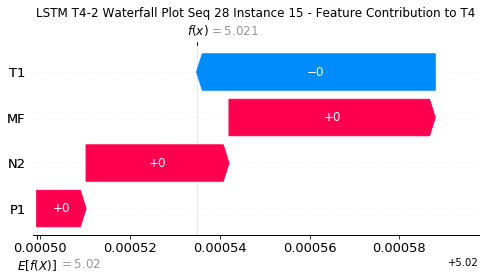

None

Contribution: [ 2.22736129e-05 -5.70534701e-05  3.38321133e-05  5.54871510e-05]


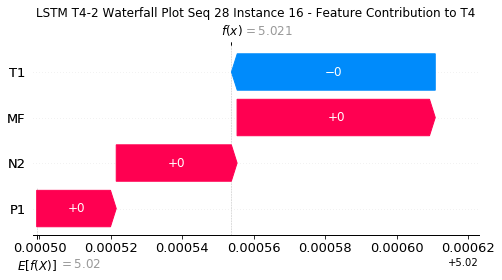

None

Contribution: [ 1.94175427e-05 -6.90248043e-05  3.31774315e-05  5.29976705e-05]


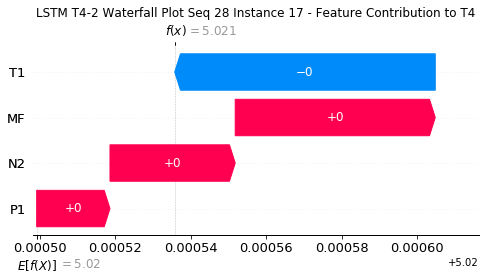

None

Contribution: [ 3.78366364e-06 -4.64115797e-05  2.87091990e-05  2.07933983e-05]


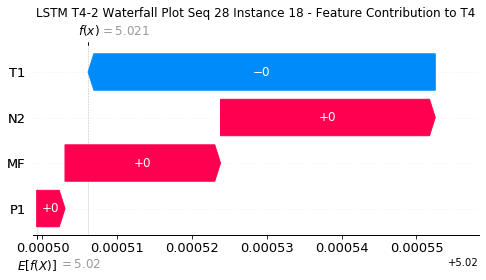

None

Contribution: [ 3.20938031e-05 -9.05656109e-05  3.47381400e-05  6.24884621e-05]


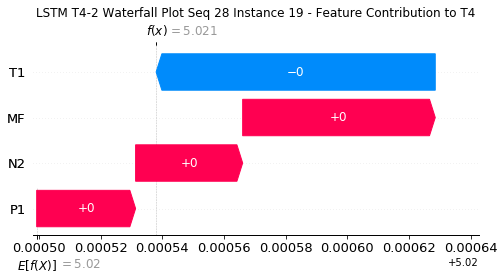

None

Contribution: [ 3.28018543e-05 -9.93636151e-05  3.54812632e-05  6.36103572e-05]


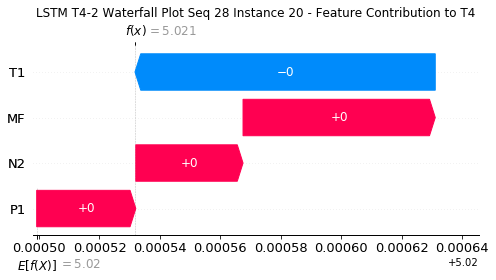

None

Contribution: [ 3.92394884e-05 -1.22965195e-04  3.99616694e-05  7.93306653e-05]


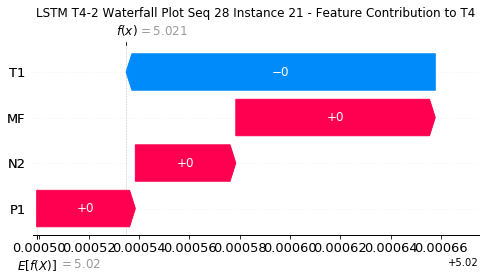

None

Contribution: [ 6.29429061e-05 -2.26887714e-04  5.56252145e-05  1.13819368e-04]


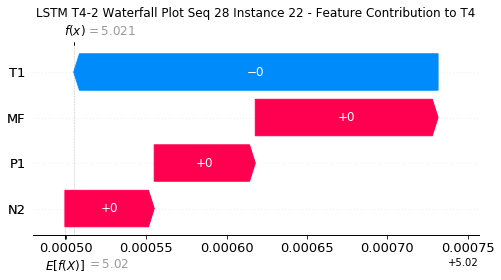

None

Contribution: [ 0.00026008 -0.00080419  0.000195    0.00047791]


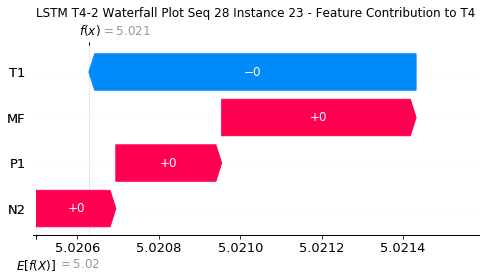

None

Contribution: [ 0.00156513 -0.00459695  0.00156031  0.00307803]


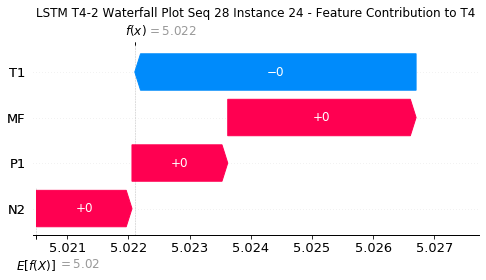

None

Contribution: [ 0.00291216 -0.01033173  0.00282953  0.00409736]


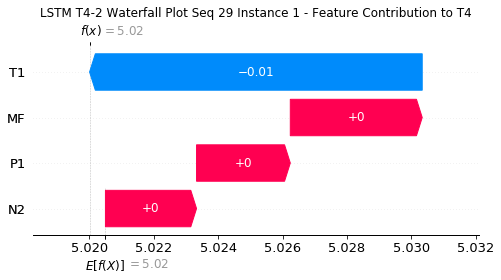

None

Contribution: [ 0.00104351 -0.00193831  0.00107369  0.00193177]


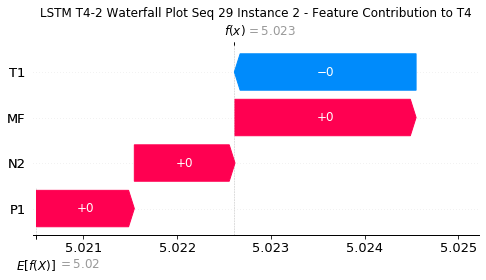

None

Contribution: [ 0.00020129 -0.00040812  0.00021535  0.0003448 ]


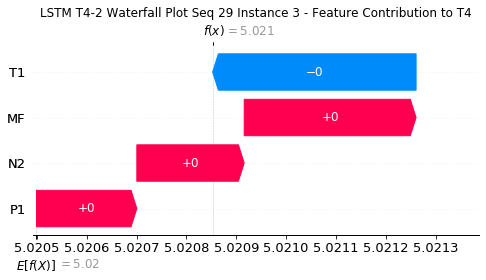

None

Contribution: [ 5.70017961e-05 -1.55009903e-04  5.17376176e-05  8.77204217e-05]


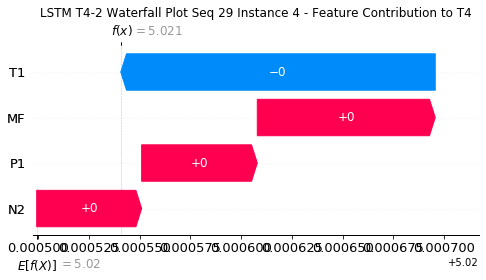

None

Contribution: [ 4.82740909e-05 -1.30038837e-04  4.32794570e-05  7.43442702e-05]


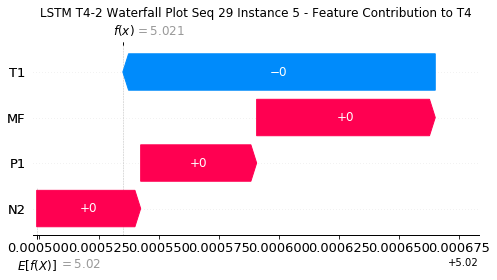

None

Contribution: [ 2.41763650e-05 -1.19598562e-04  3.62863799e-05  4.33609582e-05]


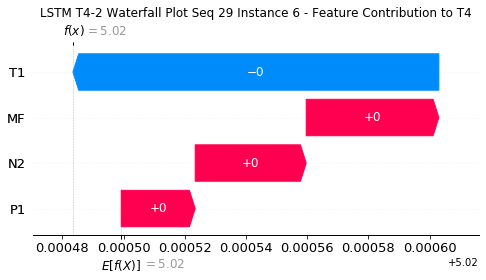

None

Contribution: [ 3.61082014e-05 -1.09736342e-04  3.92824473e-05  6.59576890e-05]


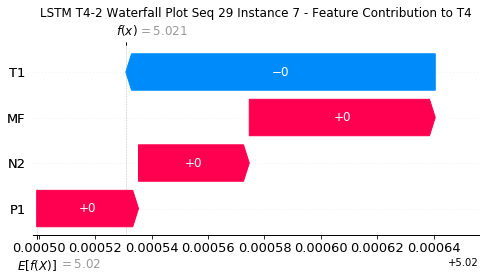

None

Contribution: [ 3.56664176e-05 -1.13202454e-04  3.84555653e-05  6.39523701e-05]


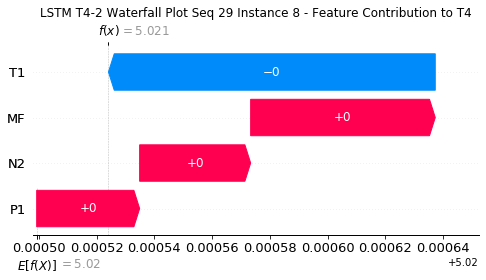

None

Contribution: [ 4.61429313e-05 -1.06840992e-04  4.13265820e-05  8.91221714e-05]


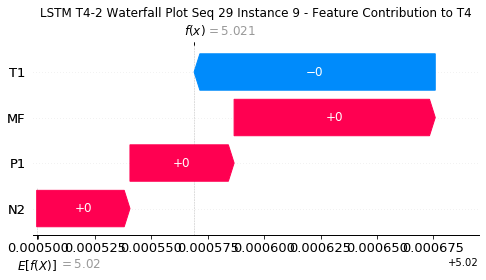

None

Contribution: [ 4.62999261e-05 -1.06815029e-04  3.99211294e-05  7.72563769e-05]


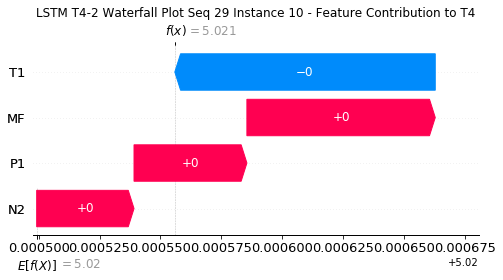

None

Contribution: [ 3.83686251e-05 -1.02437679e-04  3.69777567e-05  6.63575227e-05]


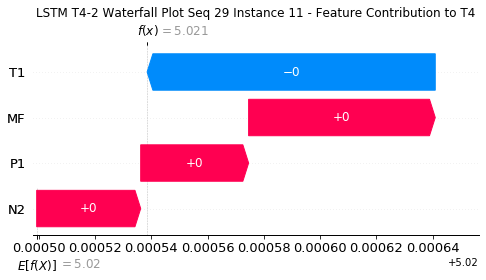

None

Contribution: [ 3.43593536e-05 -1.01250908e-04  3.68599996e-05  6.33922830e-05]


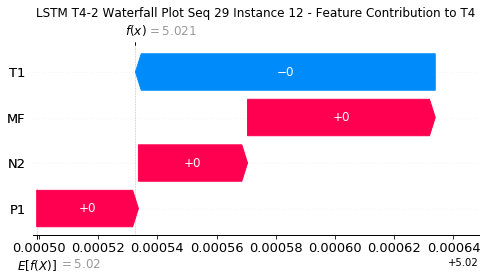

None

Contribution: [ 3.97940013e-05 -1.07214731e-04  3.79534859e-05  7.06021359e-05]


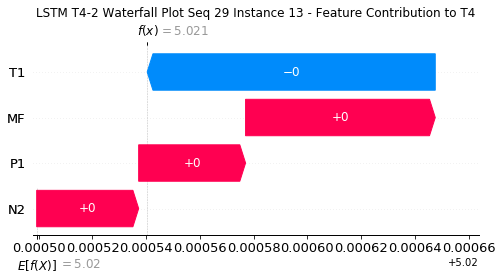

None

Contribution: [ 2.98537440e-05 -9.15356480e-05  3.69593094e-05  6.47784773e-05]


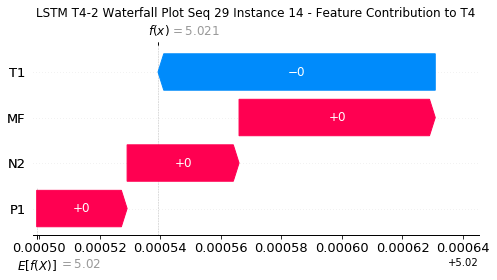

None

Contribution: [ 1.87781699e-05 -6.38923465e-05  3.18612004e-05  4.31833207e-05]


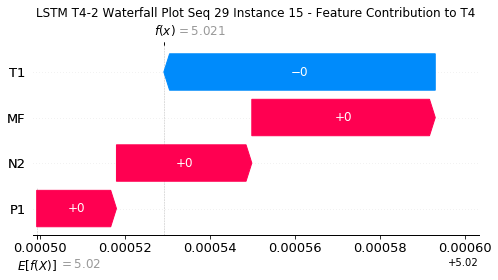

None

Contribution: [ 2.52375364e-05 -7.83630302e-05  3.47749067e-05  5.43985306e-05]


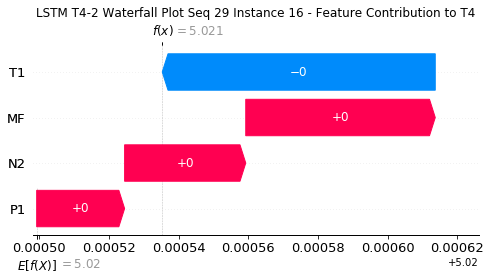

None

Contribution: [ 1.87288166e-05 -7.10334288e-05  3.42423921e-05  5.18305965e-05]


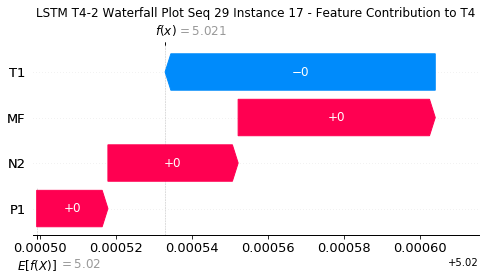

None

Contribution: [ 1.12638380e-06 -5.00672611e-05  2.95490053e-05  2.68204178e-05]


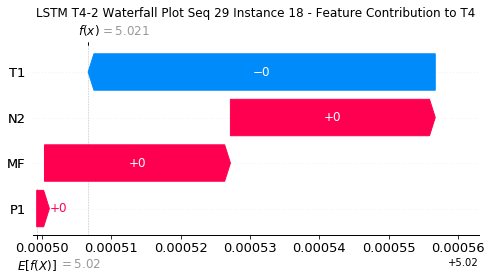

None

Contribution: [ 9.94055317e-06 -5.68589255e-05  3.26536890e-05  4.04588171e-05]


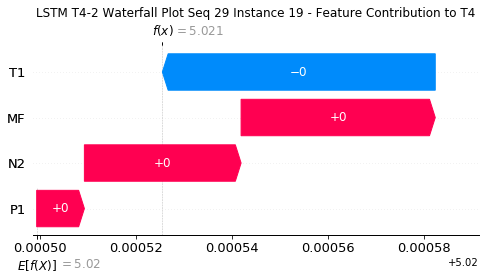

None

Contribution: [ 8.50413792e-06 -5.41483806e-05  3.33973403e-05  4.17895889e-05]


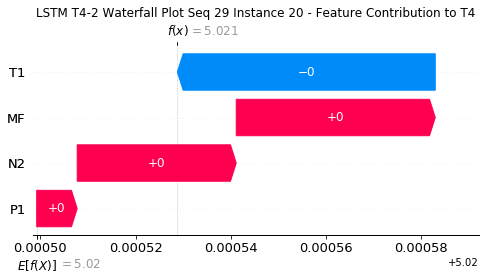

None

Contribution: [ 6.58894071e-06 -6.21081144e-05  3.64726120e-05  5.08129034e-05]


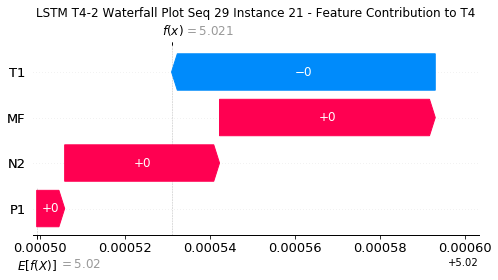

None

Contribution: [ 1.65901344e-05 -1.05688322e-04  5.15665490e-05  7.93019897e-05]


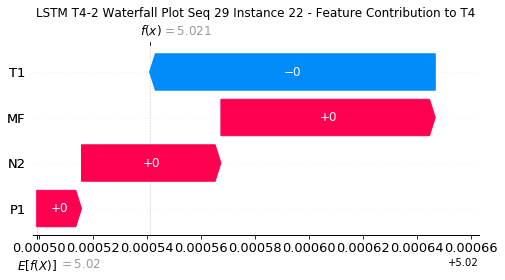

None

Contribution: [ 1.68700013e-05 -3.40419535e-04  1.62046258e-04  2.34792254e-04]


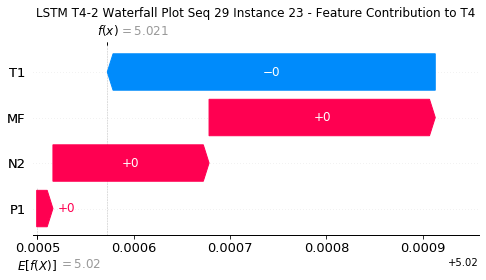

None

Contribution: [-0.00014044 -0.00265538  0.00125309  0.00118017]


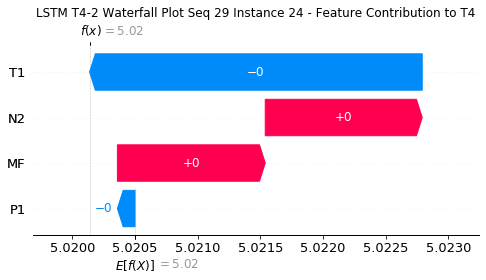

None

Contribution: [ 0.00076015 -0.0031861   0.00270534  0.00374459]


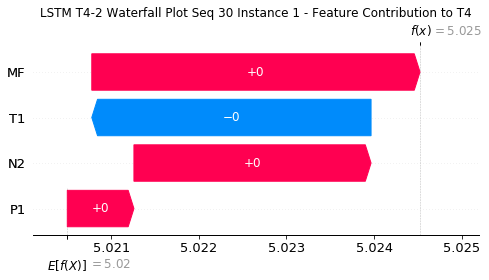

None

Contribution: [ 0.00037084 -0.00066549  0.00098308  0.00149694]


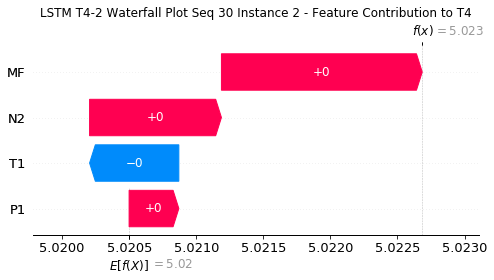

None

Contribution: [ 8.22442487e-05 -7.18749956e-05  1.97141201e-04  2.52599238e-04]


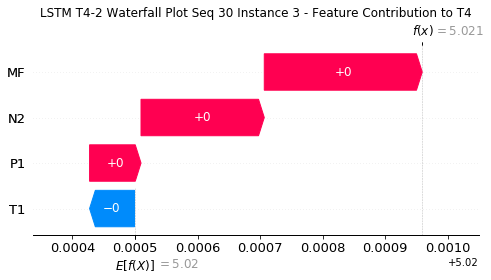

None

Contribution: [ 1.35062880e-05 -3.02648341e-05  4.50843127e-05  5.57695593e-05]


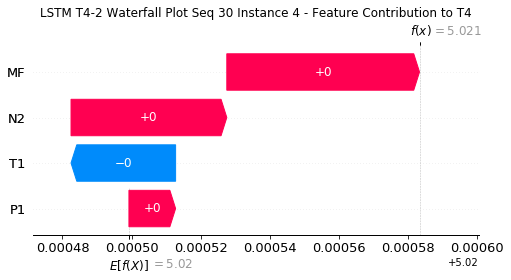

None

Contribution: [ 1.09962182e-05 -3.06757225e-05  3.72112526e-05  4.60976658e-05]


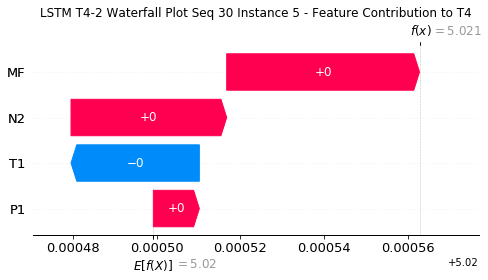

None

Contribution: [ 1.32888013e-05 -3.49482402e-05  3.57306512e-05  4.26201931e-05]


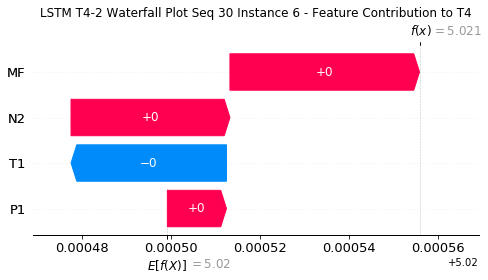

None

Contribution: [ 7.10290384e-06 -2.97351367e-05  3.45159622e-05  4.33156840e-05]


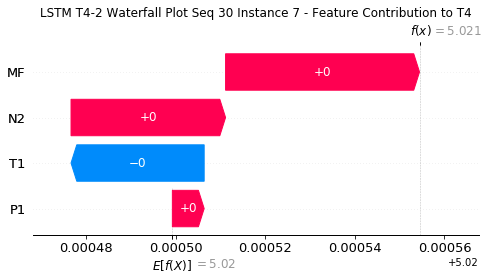

None

Contribution: [ 7.23020626e-06 -3.78152004e-05  3.32728942e-05  3.76057480e-05]


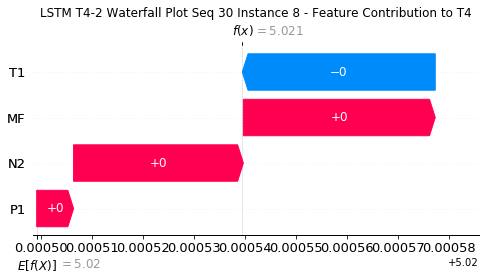

None

Contribution: [ 4.96277594e-06 -4.09204336e-05  3.33526928e-05  3.95979827e-05]


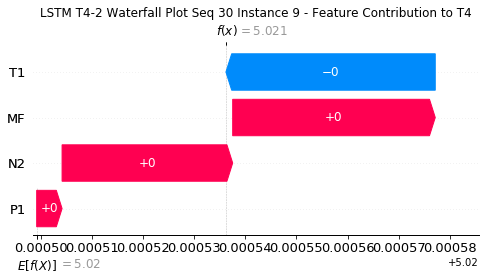

None

Contribution: [ 7.45165546e-06 -4.04958894e-05  3.27726168e-05  3.33915935e-05]


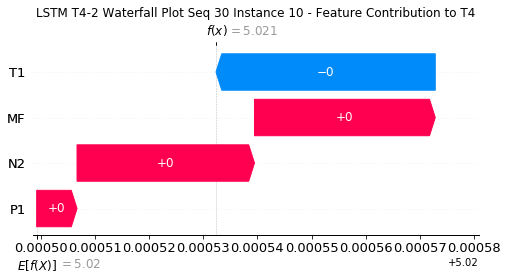

None

Contribution: [ 8.48043136e-06 -3.79920510e-05  3.18461445e-05  3.94044529e-05]


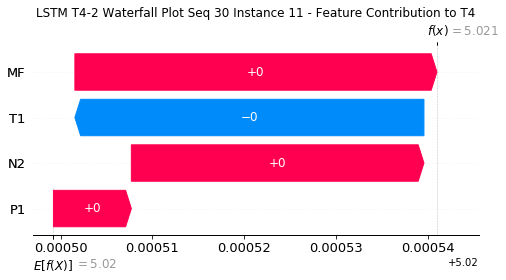

None

Contribution: [ 8.03951201e-06 -3.86768298e-05  3.23191120e-05  4.10840555e-05]


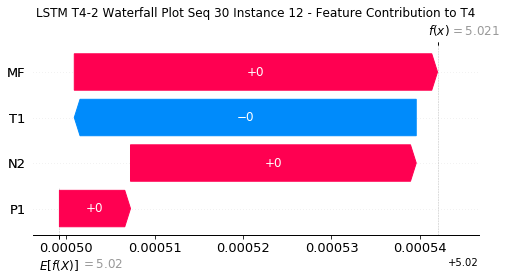

None

Contribution: [ 7.20988106e-06 -4.14003058e-05  3.04756961e-05  2.99230317e-05]


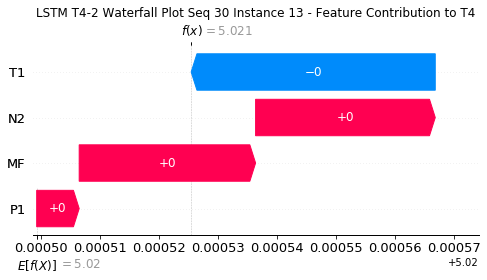

None

Contribution: [ 5.87280931e-06 -3.85253369e-05  3.27103814e-05  4.16436834e-05]


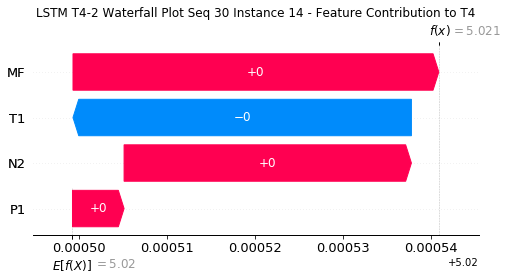

None

Contribution: [ 1.05126125e-05 -3.38190035e-05  3.15361174e-05  3.99746334e-05]


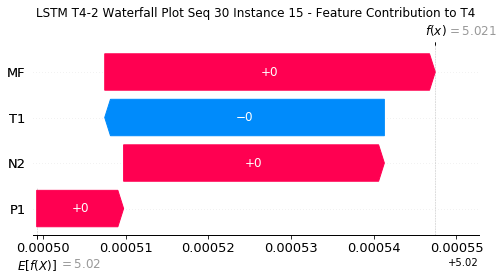

None

Contribution: [ 8.13761534e-06 -3.84289920e-05  3.15743847e-05  3.96043127e-05]


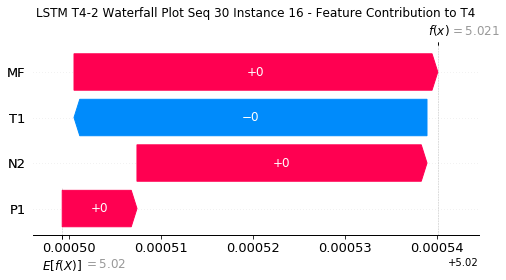

None

Contribution: [ 6.18987948e-06 -3.92962995e-05  3.18604571e-05  4.25272022e-05]


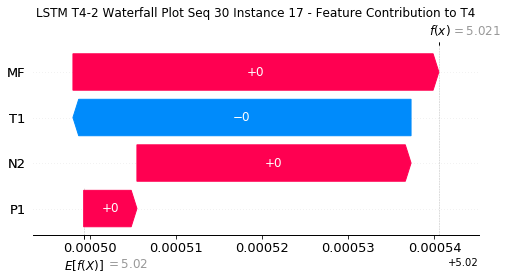

None

Contribution: [ 9.94113287e-06 -4.10727411e-05  3.02563696e-05  3.30018769e-05]


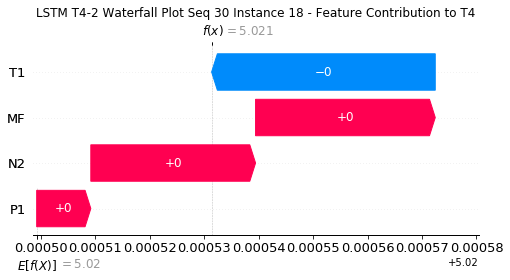

None

Contribution: [ 9.19645934e-06 -3.43306697e-05  3.25147109e-05  4.21999408e-05]


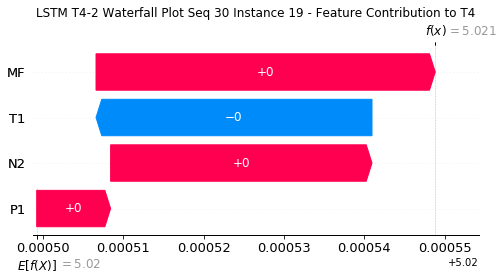

None

Contribution: [ 9.06938275e-06 -3.48801889e-05  3.36256656e-05  4.44749328e-05]


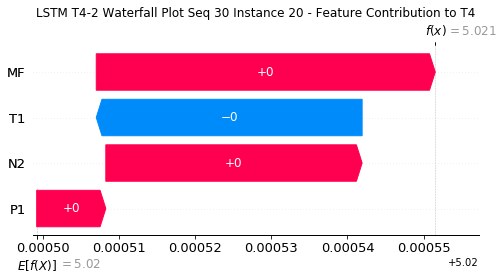

None

Contribution: [ 7.04670130e-06 -4.15708210e-05  3.68270979e-05  4.91754171e-05]


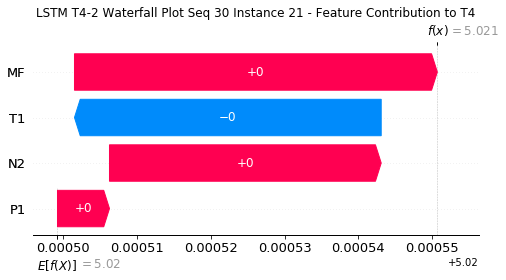

None

Contribution: [ 1.47447014e-05 -8.51304446e-05  5.14867181e-05  7.25675991e-05]


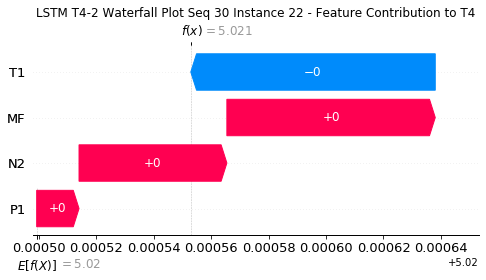

None

Contribution: [ 4.04326876e-05 -2.27551398e-04  1.64971578e-04  2.32825048e-04]


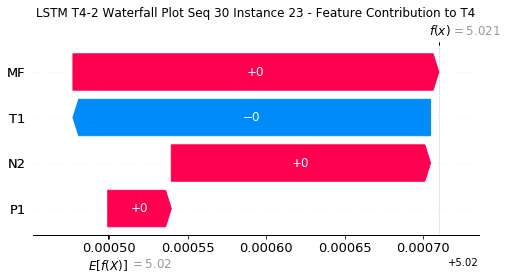

None

Contribution: [ 0.00019925 -0.0011753   0.00136217  0.00158056]


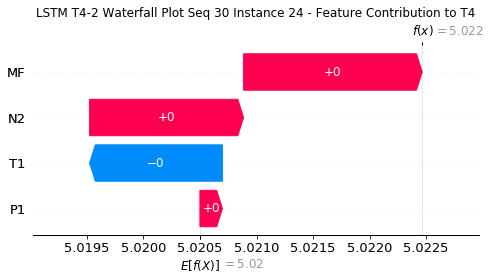

None

Contribution: [ 0.00095683 -0.00316174  0.00297535  0.00404379]


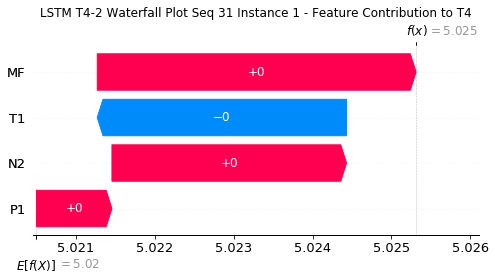

None

Contribution: [ 0.00027794 -0.00053465  0.00101044  0.00123038]


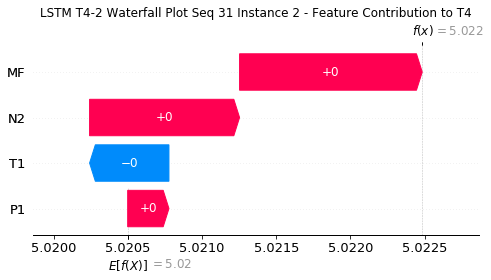

None

Contribution: [ 4.41683872e-05 -9.45081185e-05  1.94434531e-04  2.01970585e-04]


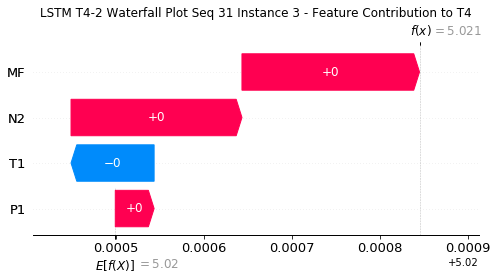

None

Contribution: [ 1.91926226e-05 -3.35089841e-05  4.98482291e-05  6.72110885e-05]


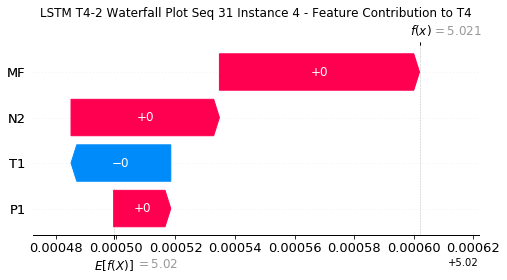

None

Contribution: [ 1.55626845e-05 -3.16013550e-05  4.10985373e-05  5.53791357e-05]


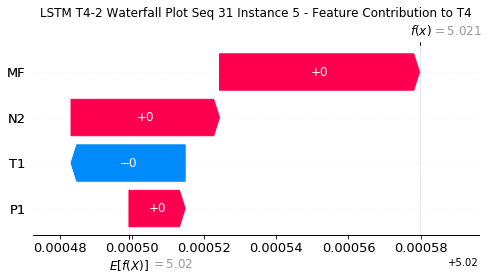

None

Contribution: [ 1.42924504e-05 -2.88634514e-05  3.68764170e-05  4.67959772e-05]


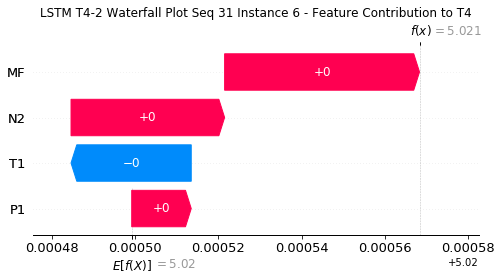

None

Contribution: [ 9.63771619e-06 -3.01690362e-05  3.70172807e-05  4.93983253e-05]


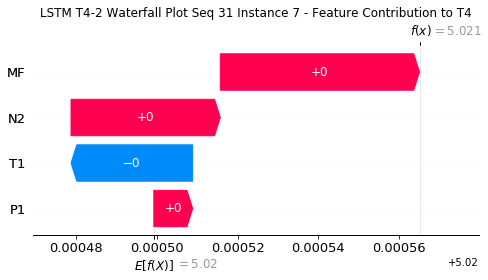

None

Contribution: [ 5.88901859e-06 -3.79745515e-05  3.36607539e-05  3.97373447e-05]


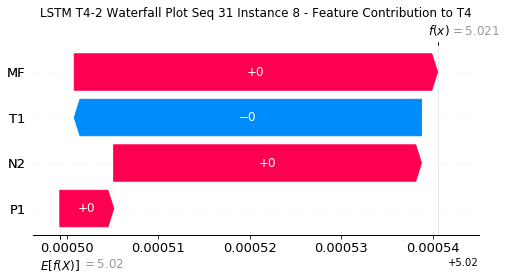

None

Contribution: [ 2.65333421e-06 -3.65214586e-05  3.22068523e-05  2.79823818e-05]


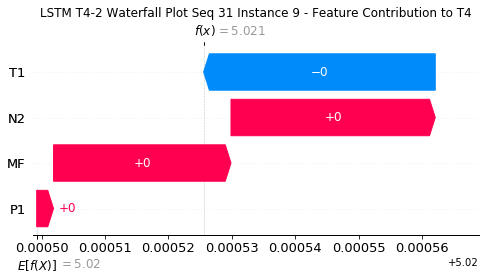

None

Contribution: [ 6.06226937e-06 -3.89628731e-05  3.40358056e-05  4.29790660e-05]


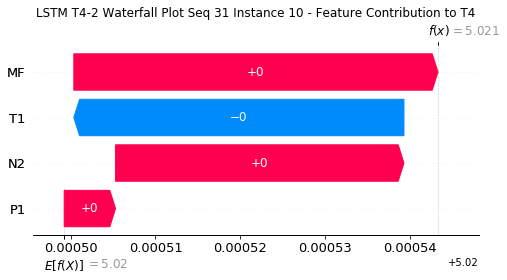

None

Contribution: [ 1.21553289e-05 -3.27998052e-05  3.41636814e-05  4.43959663e-05]


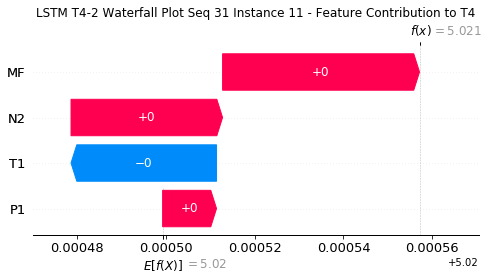

None

Contribution: [ 1.14511669e-05 -3.46554760e-05  3.42752595e-05  4.42897120e-05]


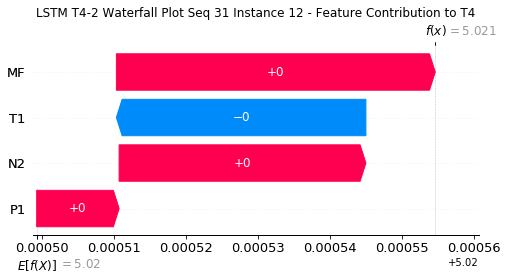

None

Contribution: [ 1.16000351e-05 -3.54085727e-05  3.35875843e-05  4.72064722e-05]


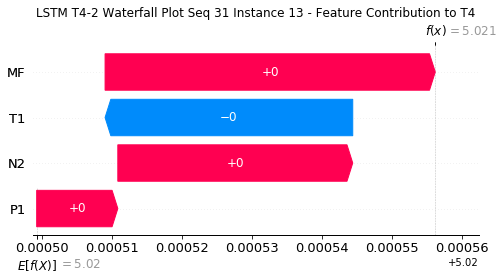

None

Contribution: [ 9.01250756e-06 -3.58699233e-05  3.45140081e-05  4.62151401e-05]


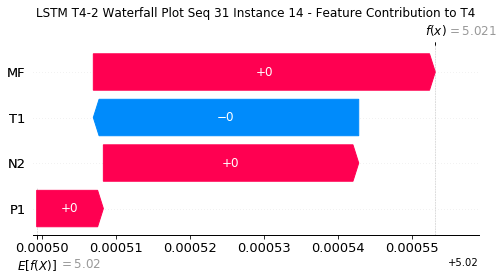

None

Contribution: [ 7.91441036e-06 -3.78332465e-05  3.34039400e-05  3.07165948e-05]


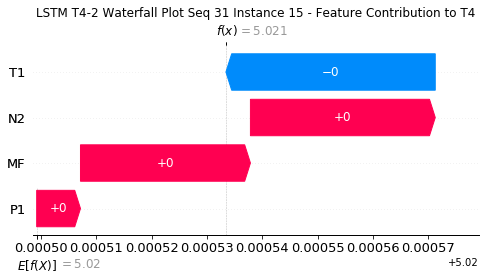

None

Contribution: [ 1.04106953e-05 -3.72289905e-05  3.25338895e-05  4.09300752e-05]


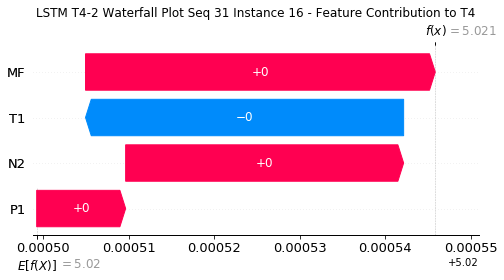

None

Contribution: [ 7.22531934e-06 -3.89230673e-05  3.21858954e-05  4.20708348e-05]


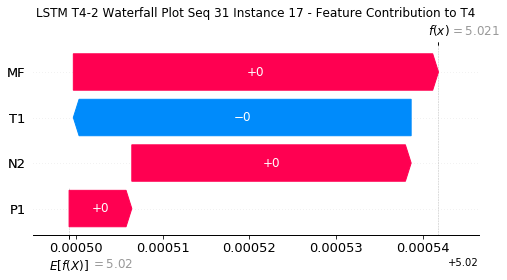

None

Contribution: [ 1.41129651e-05 -3.16266810e-05  3.34796847e-05  5.09516509e-05]


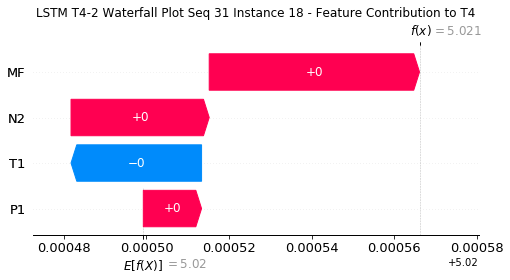

None

Contribution: [ 8.81765994e-06 -4.06807644e-05  3.18803873e-05  4.01932712e-05]


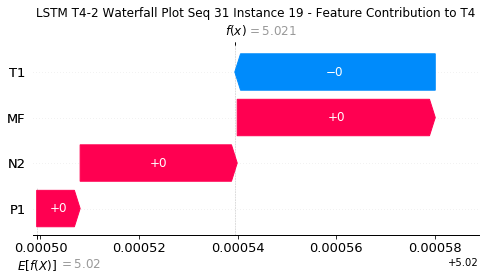

None

Contribution: [ 7.90699229e-06 -4.13450112e-05  3.25226134e-05  4.14024707e-05]


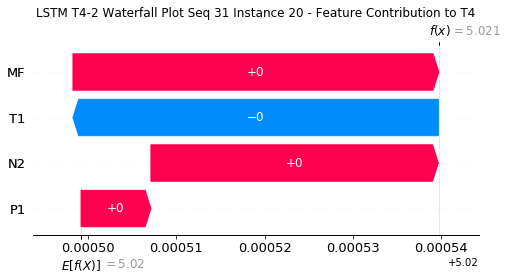

None

Contribution: [ 5.95518458e-06 -5.02832739e-05  3.57464079e-05  4.82271991e-05]


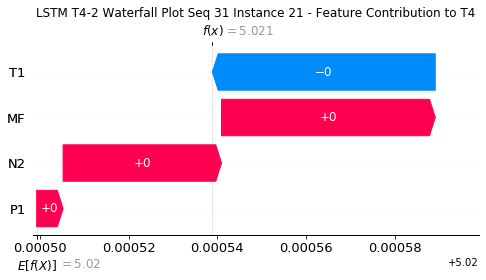

None

Contribution: [ 1.21225639e-05 -9.49499514e-05  4.93534763e-05  7.08214439e-05]


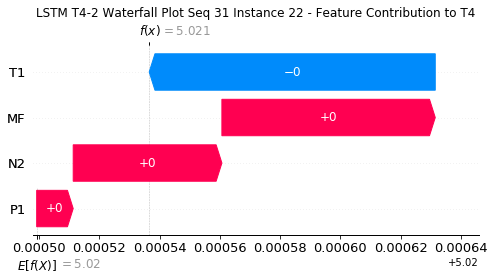

None

Contribution: [ 2.96931968e-05 -2.95830670e-04  1.59581050e-04  2.17860460e-04]


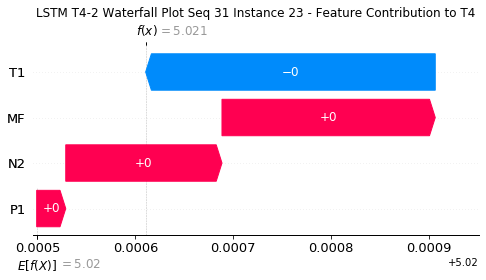

None

Contribution: [ 0.00039198 -0.00131049  0.00156435  0.00179216]


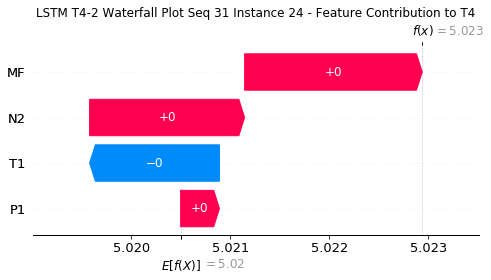

None

Contribution: [ 0.00138948 -0.00303058  0.00330419  0.00510468]


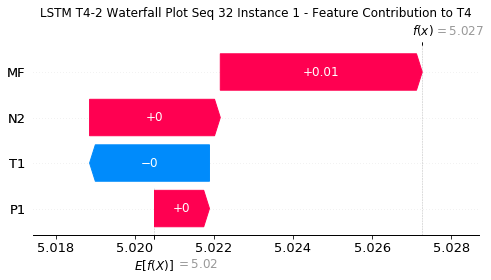

None

Contribution: [ 0.00045504 -0.00060748  0.0011159   0.00170985]


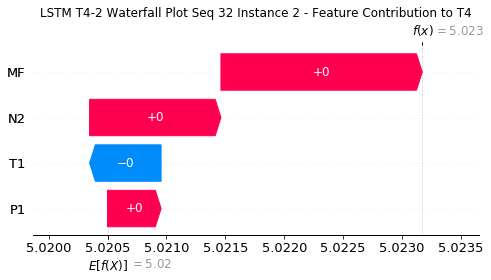

None

Contribution: [ 8.82812621e-05 -1.48543226e-04  2.25029943e-04  3.14093062e-04]


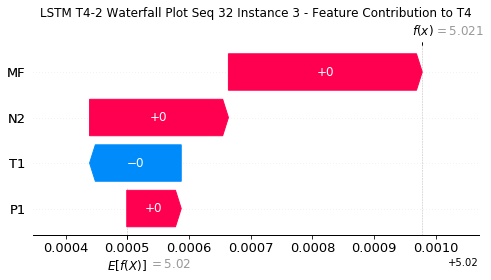

None

Contribution: [ 1.41084567e-05 -4.11976516e-05  4.99375630e-05  5.86983981e-05]


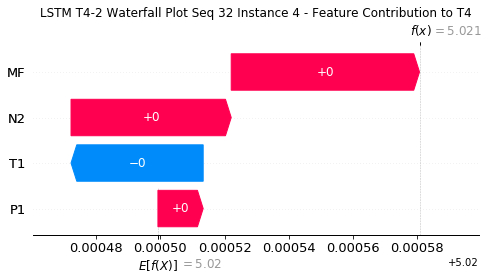

None

Contribution: [ 1.15546319e-05 -3.74910301e-05  4.17535833e-05  4.85837978e-05]


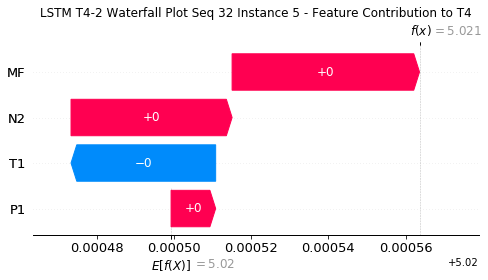

None

Contribution: [ 4.34523852e-06 -3.37699448e-05  3.35071335e-05  3.58425318e-05]


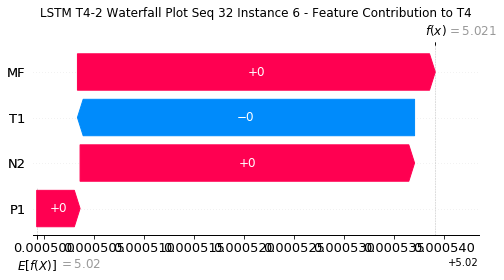

None

Contribution: [ 7.11871892e-06 -3.42722172e-05  3.84327416e-05  4.65408947e-05]


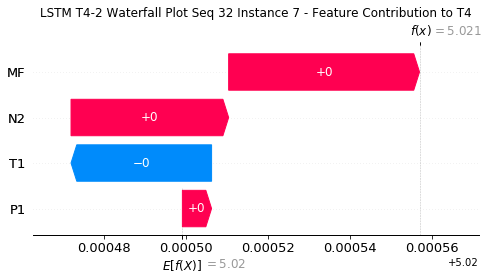

None

Contribution: [ 9.65729474e-06 -3.26283537e-05  3.91392519e-05  5.59504043e-05]


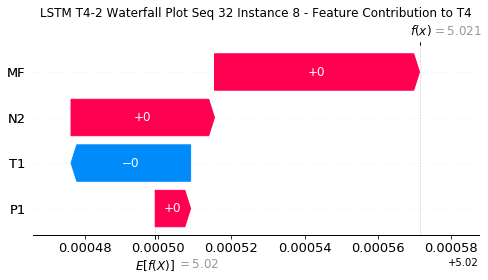

None

Contribution: [ 1.13853734e-05 -2.76224537e-05  3.94907618e-05  6.69756456e-05]


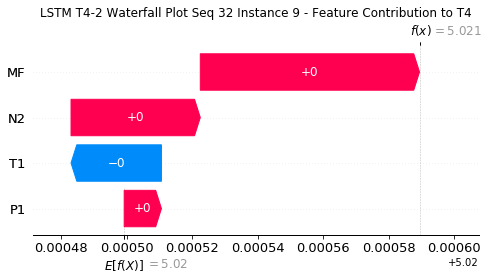

None

Contribution: [ 8.96919284e-06 -2.91466959e-05  3.89453320e-05  5.19865753e-05]


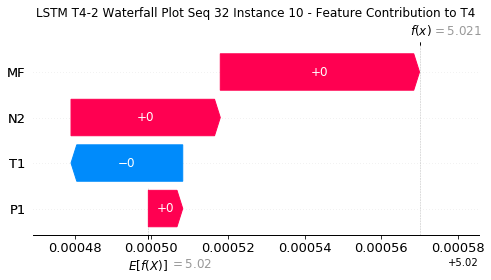

None

Contribution: [ 9.68374686e-06 -3.70387486e-05  3.63384475e-05  4.48247348e-05]


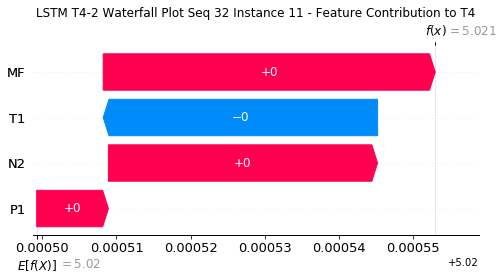

None

Contribution: [ 9.46479034e-06 -4.00234681e-05  3.68512970e-05  4.62948054e-05]


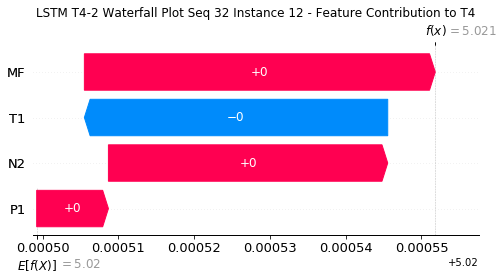

None

Contribution: [ 7.18361461e-06 -4.15581644e-05  3.50547705e-05  3.63940053e-05]


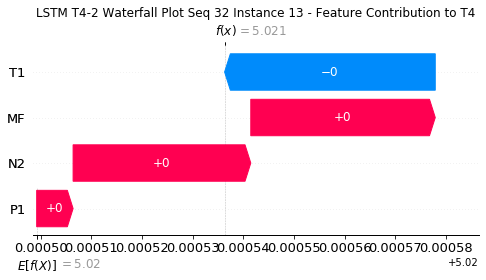

None

Contribution: [ 7.18349106e-06 -4.06971660e-05  3.73634650e-05  4.80975419e-05]


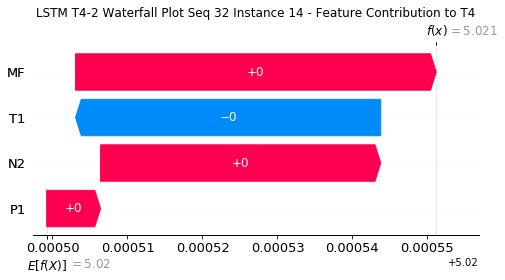

None

Contribution: [ 8.99068115e-07 -5.34262836e-05  3.22601947e-05  3.64379617e-05]


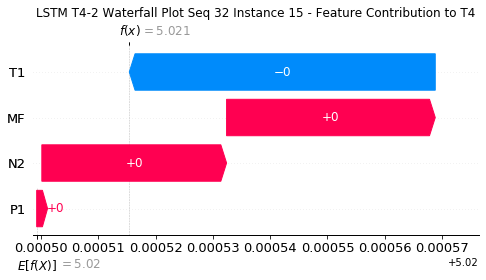

None

Contribution: [ 9.32996044e-06 -4.25664588e-05  3.61582938e-05  4.48445788e-05]


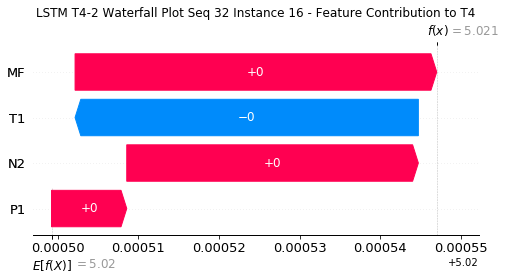

None

Contribution: [ 6.41365146e-06 -4.49470274e-05  3.61396633e-05  4.45773257e-05]


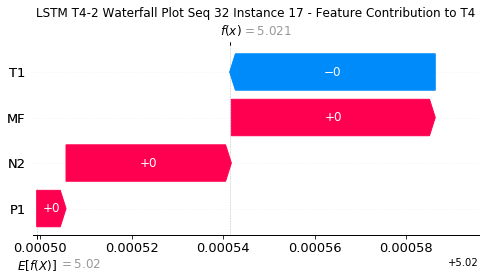

None

Contribution: [ 9.03467945e-06 -4.74197964e-05  3.72297598e-05  4.59261062e-05]


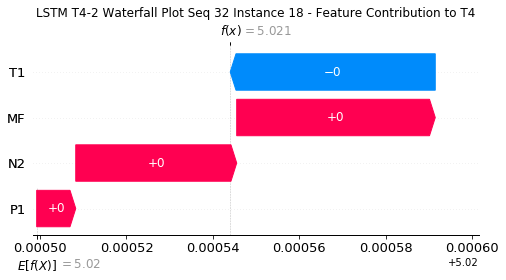

None

Contribution: [ 9.21004777e-06 -4.81475458e-05  3.66043145e-05  4.41889111e-05]


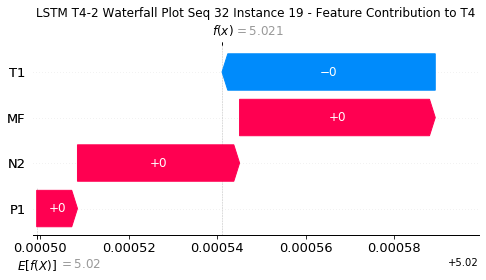

None

Contribution: [ 8.45232963e-06 -4.90829457e-05  3.75454009e-05  4.47793439e-05]


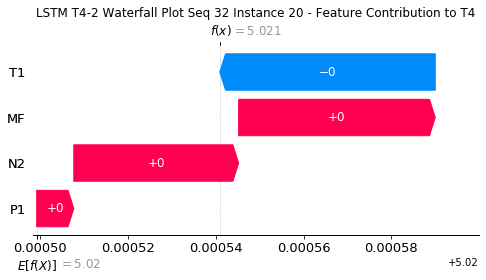

None

Contribution: [ 7.01569478e-06 -5.86571585e-05  4.16864975e-05  5.24241439e-05]


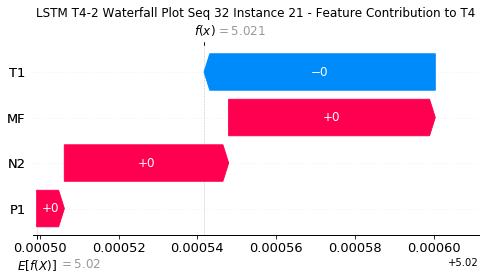

None

Contribution: [ 1.34954461e-05 -1.08808254e-04  5.99390339e-05  7.64666520e-05]


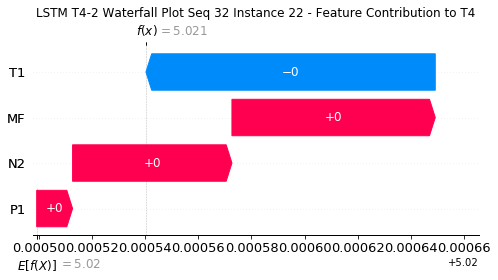

None

Contribution: [ 4.68088037e-05 -3.31229430e-04  1.98087650e-04  2.64653296e-04]


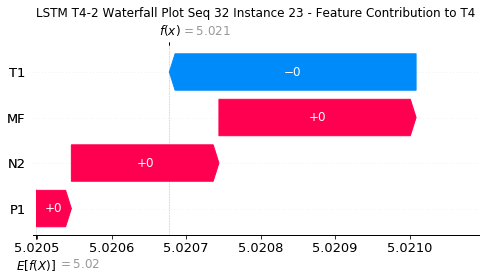

None

Contribution: [ 0.00038362 -0.00121653  0.00155818  0.00196126]


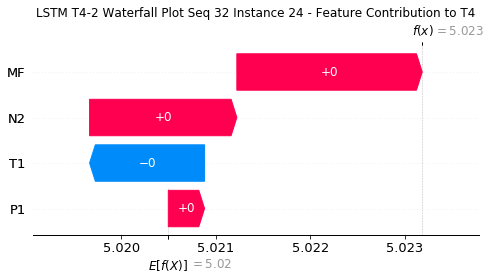

None

Contribution: [ 0.00086986 -0.00344523  0.00314333  0.00400386]


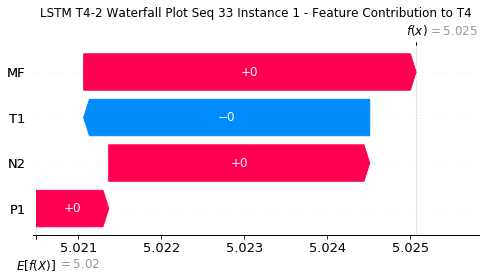

None

Contribution: [ 0.00034229 -0.00063189  0.00108288  0.00149592]


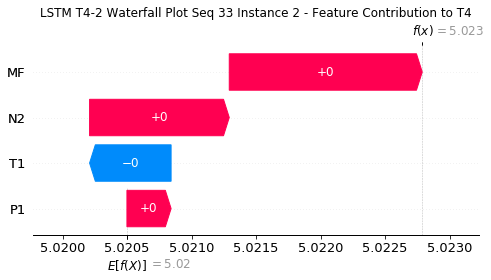

None

Contribution: [ 6.46628234e-05 -1.36158843e-04  2.15399919e-04  2.59545654e-04]


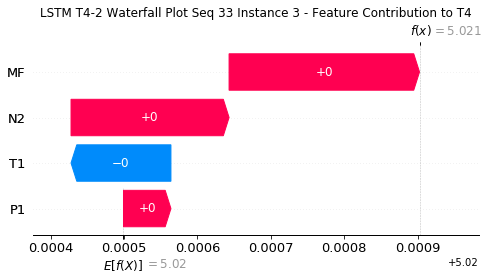

None

Contribution: [ 7.25529439e-06 -5.39243629e-05  4.84586170e-05  5.73393739e-05]


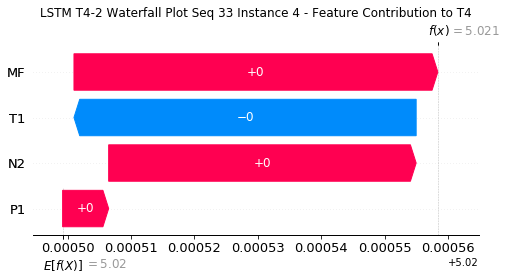

None

Contribution: [ 5.38220227e-06 -5.00617491e-05  3.95795325e-05  4.61627666e-05]


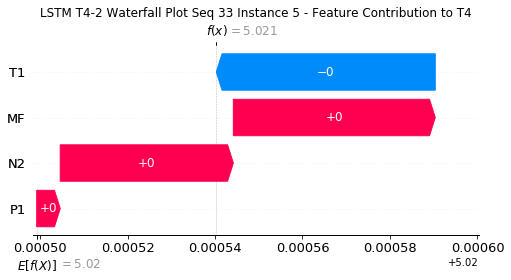

None

Contribution: [ 5.30256362e-06 -4.03470412e-05  3.40930553e-05  3.67885902e-05]


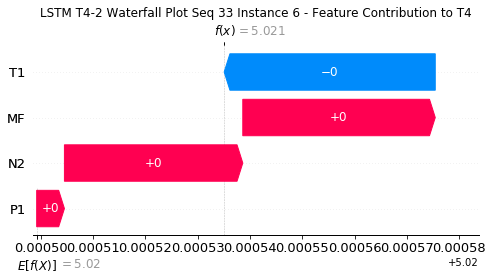

None

Contribution: [ 2.17040467e-06 -4.64007182e-05  3.58419787e-05  4.25056236e-05]


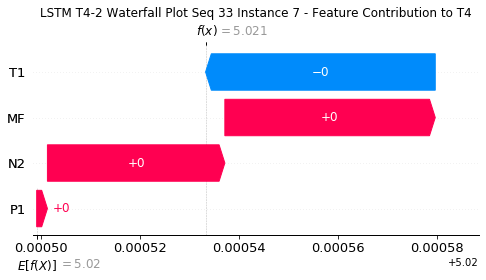

None

Contribution: [ 7.53703739e-06 -5.24365821e-05  3.42184558e-05  3.89061044e-05]


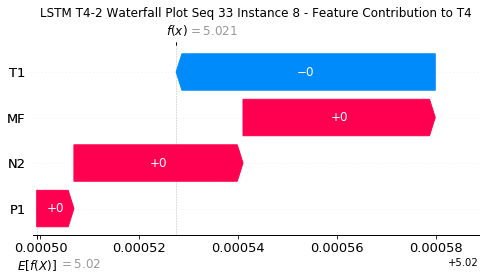

None

Contribution: [ 7.50535956e-06 -4.01600837e-05  3.33730888e-05  4.87540724e-05]


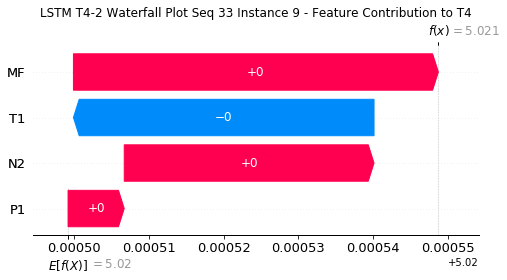

None

Contribution: [ 6.67419112e-06 -5.36838876e-05  3.34228541e-05  3.87268323e-05]


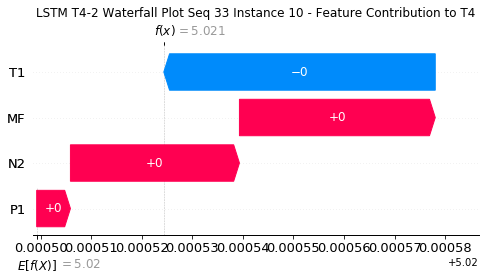

None

Contribution: [ 5.32666912e-06 -4.99816554e-05  3.22079182e-05  3.95876120e-05]


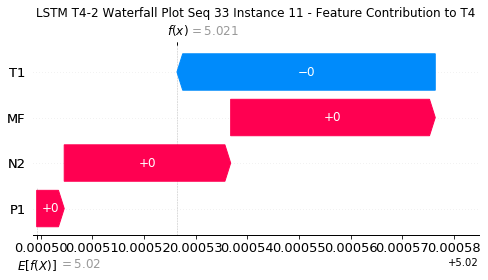

None

Contribution: [ 4.97556562e-06 -5.20124615e-05  3.26149728e-05  4.03615711e-05]


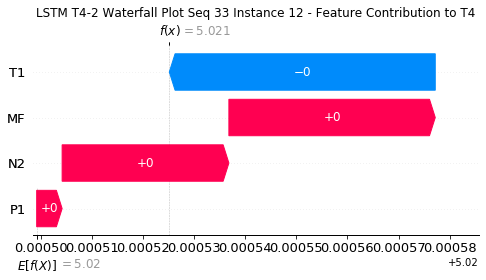

None

Contribution: [ 1.05515887e-05 -4.99185871e-05  3.19034291e-05  4.48899738e-05]


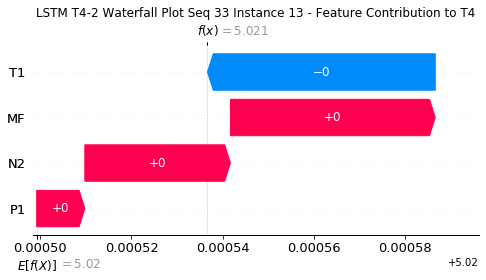

None

Contribution: [ 3.70057228e-06 -5.32513349e-05  3.26057603e-05  4.31416678e-05]


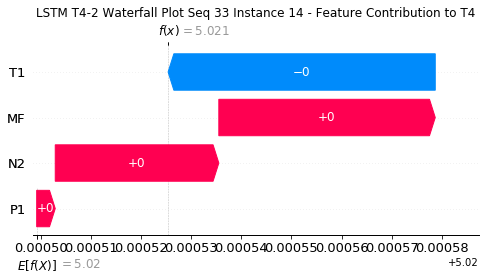

None

Contribution: [ 2.66587113e-06 -5.61699572e-05  2.90203364e-05  2.79929764e-05]


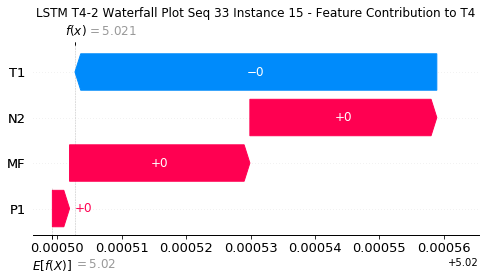

None

Contribution: [ 5.18189726e-06 -5.48934952e-05  3.05324375e-05  3.73521487e-05]


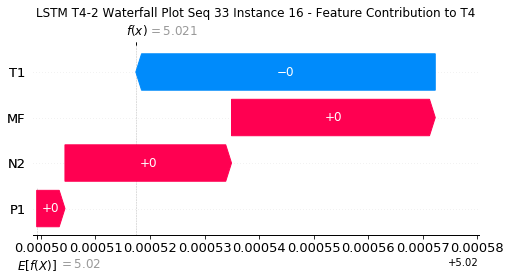

None

Contribution: [ 1.15819339e-06 -5.76854258e-05  3.02167324e-05  3.73308854e-05]


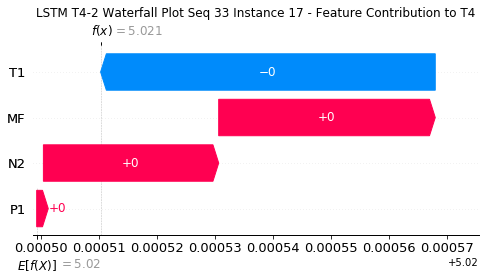

None

Contribution: [ 1.00337617e-05 -5.91306758e-05  3.17027636e-05  4.63028372e-05]


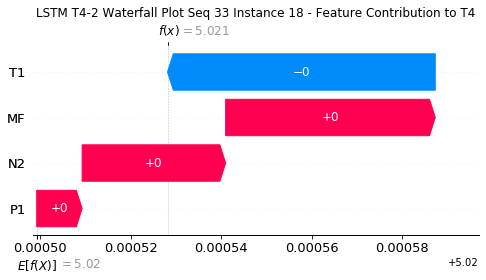

None

Contribution: [ 4.32158415e-06 -5.97941972e-05  3.05699854e-05  3.82770608e-05]


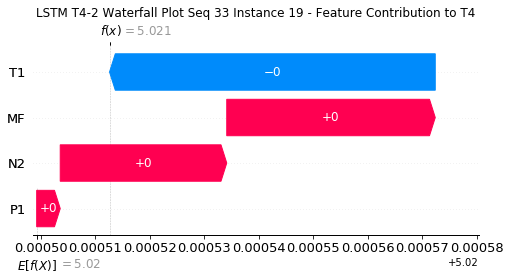

None

Contribution: [ 2.97927381e-06 -6.16860516e-05  3.11317532e-05  3.93527229e-05]


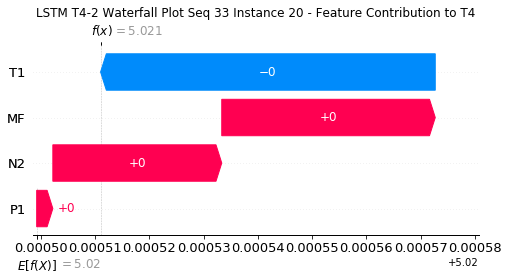

None

Contribution: [ 1.94870630e-06 -7.39224800e-05  3.42689011e-05  4.91863849e-05]


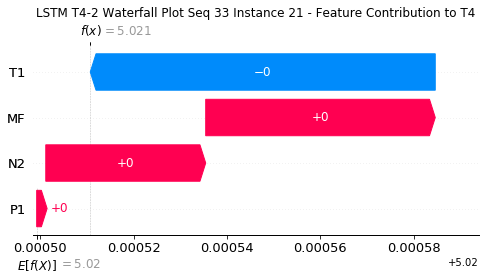

None

Contribution: [ 4.06731799e-06 -1.39025895e-04  4.60794078e-05  6.96347761e-05]


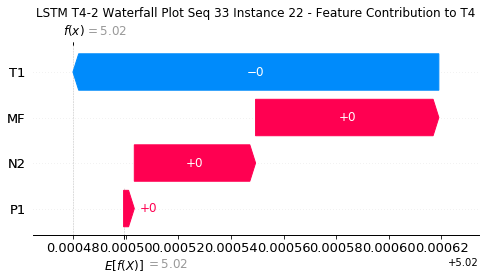

None

Contribution: [ 1.94724975e-05 -4.53142937e-04  1.54400608e-04  2.78238436e-04]


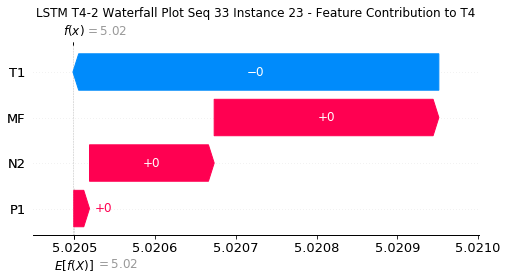

None

Contribution: [ 0.00014088 -0.00245128  0.00127831  0.00196386]


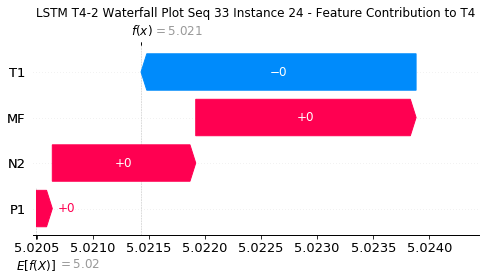

None

Contribution: [ 0.00011244 -0.00505954  0.00245434  0.00271882]


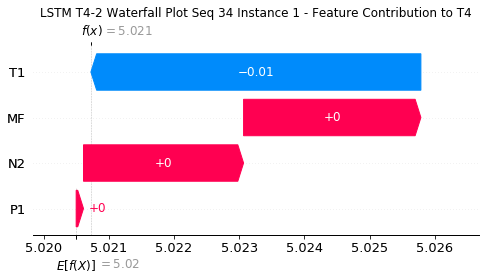

None

Contribution: [ 0.00024942 -0.00098035  0.00094126  0.00126152]


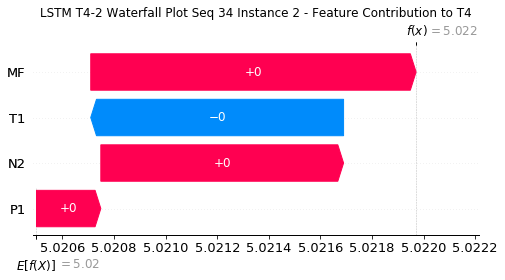

None

Contribution: [ 3.73190833e-05 -2.12092976e-04  1.80515970e-04  1.82033002e-04]


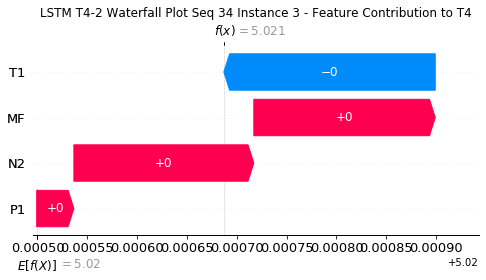

None

Contribution: [ 5.14543326e-06 -6.86308512e-05  4.62087145e-05  6.28657841e-05]


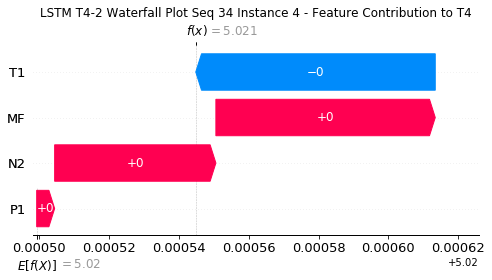

None

Contribution: [ 2.92311297e-06 -6.25467560e-05  3.81855863e-05  4.90598124e-05]


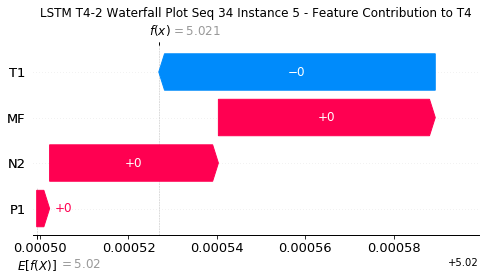

None

Contribution: [-3.32768266e-06 -6.21127739e-05  3.52966780e-05  4.26582848e-05]


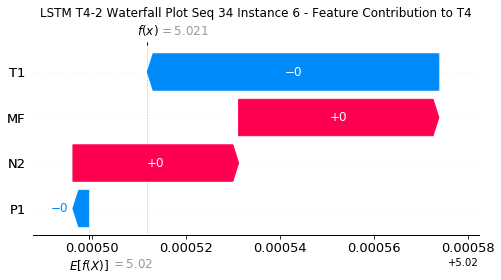

None

Contribution: [-1.53815803e-06 -5.65877357e-05  3.50254598e-05  4.46125135e-05]


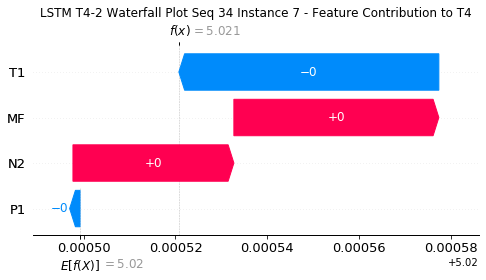

None

Contribution: [-4.52720337e-06 -5.48559091e-05  3.50231558e-05  4.63883679e-05]


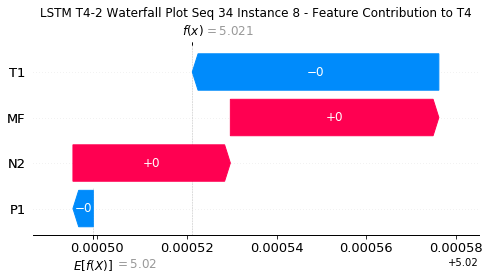

None

Contribution: [-1.21555431e-05 -5.66589838e-05  3.31991690e-05  3.58870521e-05]


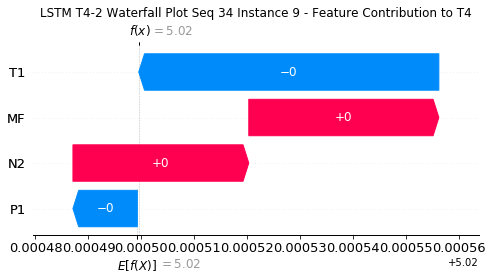

None

Contribution: [-8.57097652e-06 -5.66460987e-05  3.32530540e-05  3.16214665e-05]


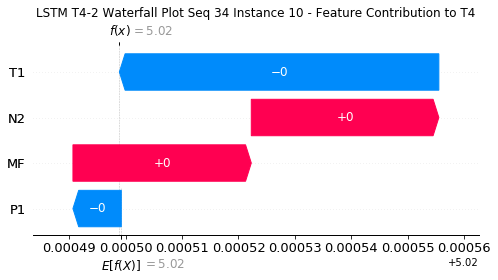

None

Contribution: [ 9.95937387e-07 -5.89681121e-05  3.24199388e-05  3.60570346e-05]


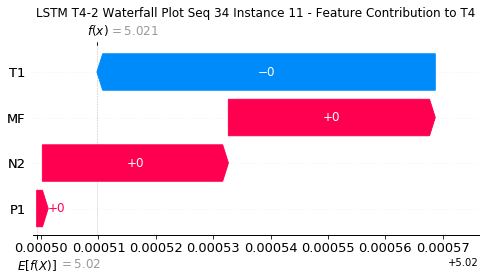

None

Contribution: [ 1.54416155e-06 -6.03878274e-05  3.29952158e-05  3.95339209e-05]


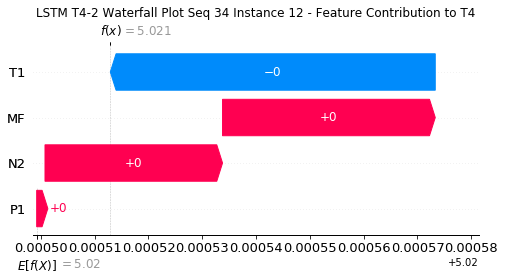

None

Contribution: [-5.27667976e-07 -5.44112747e-05  3.22664490e-05  3.35944939e-05]


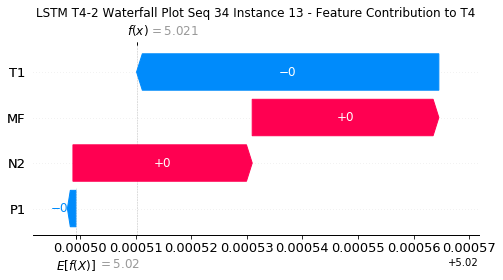

None

Contribution: [-6.14431039e-07 -6.01435074e-05  3.31121585e-05  3.96563366e-05]


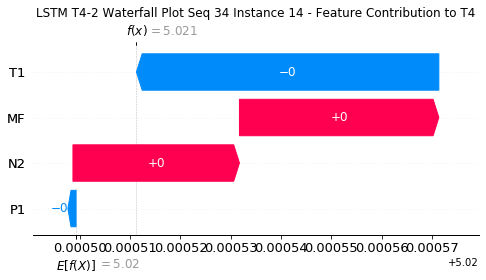

None

Contribution: [-3.23191943e-06 -6.57221798e-05  3.04686476e-05  2.87169699e-05]


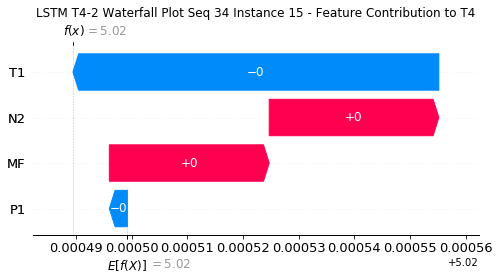

None

Contribution: [ 1.88225852e-06 -6.15986659e-05  3.18045798e-05  3.68731239e-05]


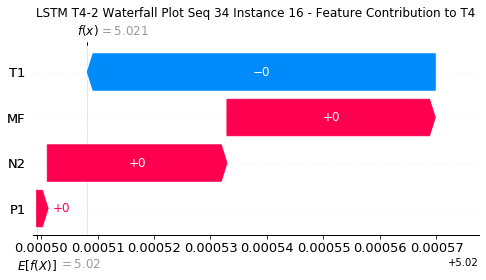

None

Contribution: [-1.19924262e-06 -6.44628177e-05  3.14447858e-05  3.67980876e-05]


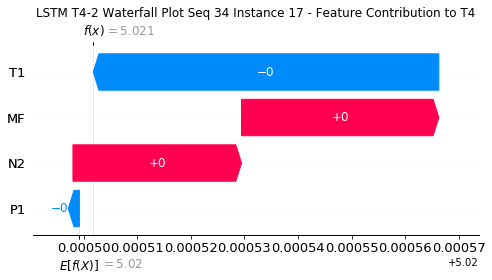

None

Contribution: [ 4.32958654e-06 -5.80169860e-05  3.20140148e-05  4.42261873e-05]


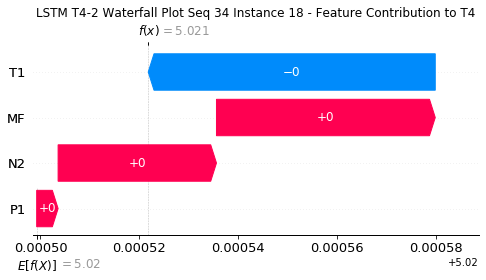

None

Contribution: [ 3.50429834e-06 -6.40063832e-05  3.14650320e-05  4.07959034e-05]


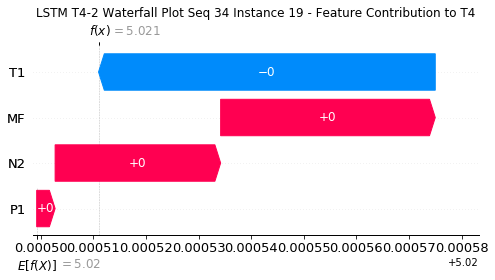

None

Contribution: [ 2.27114354e-06 -6.59238151e-05  3.19248385e-05  4.00884742e-05]


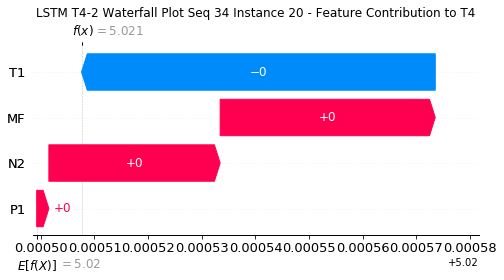

None

Contribution: [ 1.89433858e-07 -7.63676884e-05  3.45279188e-05  4.53414609e-05]


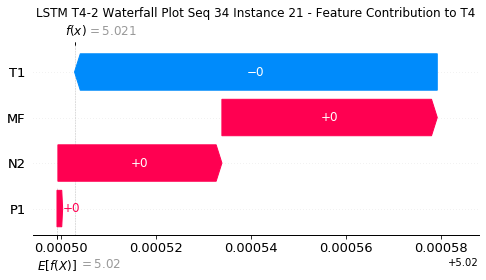

None

Contribution: [-9.92997413e-07 -1.44301927e-04  4.70972491e-05  5.62454669e-05]


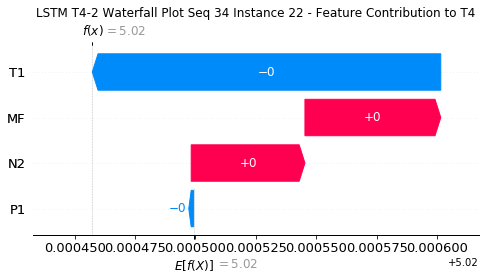

None

Contribution: [ 3.48053821e-06 -4.63576189e-04  1.55483943e-04  2.23659775e-04]


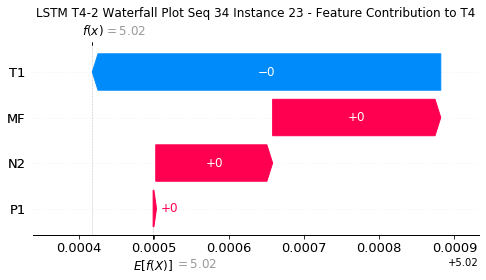

None

Contribution: [ 0.00011446 -0.00261975  0.00131191  0.00174837]


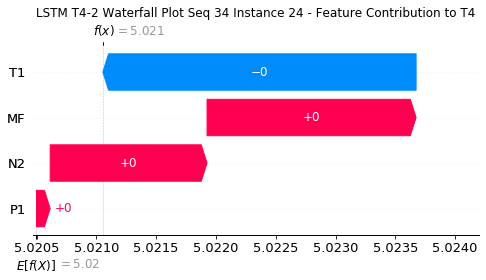

None

In [42]:
#Waterfall Plot for Local Accuracy & Consistency metrics
for s in range(0,34):
    instance=x_test[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    for j in range(24):
        print("Contribution:",shap_values[0][0][j])
        plt.title("LSTM T4-2 Waterfall Plot Seq %s " %(s+1)+"Instance %i - Feature Contribution to T4" %(j+1),fontsize=12)
        waterfall_display = shap.plots._waterfall.waterfall_legacy(e[0],shap_values[0][0][j],feature_names=features,show=True)
        display(waterfall_display)

In [43]:
#Define New LSTM without probabilistic layers for Consistency metrics

inputs = tf.keras.Input(shape=(24,3),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)
layer3 = Dense(1)(layer2)
layer4 = Lambda(lambda t: t[:,-1],name='out2')(layer3)
model3 = tf.keras.Model(inputs=inputs, outputs=layer4)
model3.summary()

Model: "functional_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         [(None, 24, 3)]           0         
_________________________________________________________________
lstm_3 (LSTM)                (None, 24, 972)           3794688   
_________________________________________________________________
dense_7 (Dense)              (None, 24, 377)           366821    
_________________________________________________________________
dense_8 (Dense)              (None, 24, 1)             378       
_________________________________________________________________
out2 (Lambda)                (None, 1)                 0         
Total params: 4,161,887
Trainable params: 4,161,887
Non-trainable params: 0
_________________________________________________________________


In [44]:
#Extract only weights for 3 variables excluding MF

a = model2.layers[1].get_weights()[0][0:3]
a = [a,model2.layers[1].get_weights()[1],model2.layers[1].get_weights()[2]]

In [45]:
#Transfer weights from previous LSTM to new LSTM with only Aleatoric Layer Output

model3.layers[0].set_weights(model2.layers[0].get_weights())
model3.layers[1].set_weights(a)
model3.layers[2].set_weights(model2.layers[2].get_weights())
model3.layers[3].set_weights(model2.layers[3].get_weights())
model3.layers[4].set_weights(model2.layers[4].get_weights())

In [46]:
#Load xtest and delete MF

xtrain_file = "xtrain.csv"
xtrain = pd.read_csv(xtrain_file, index_col=False)
xtrain = xtrain.drop(['MF'],axis=1)

#Load xtest and delete MF

xtest_file = "xtest.csv"
xtest = pd.read_csv(xtest_file, index_col=False)
xtest = xtest.drop(['MF'],axis=1)

#Xtest to Numpy multidimensional array

xtrain = xtrain.to_numpy()
xtrain = xtrain.reshape(278,24,3)

xtest = xtest.to_numpy()
xtest = xtest.reshape(34,24,3)

In [47]:
#Prediction with features excluding MF 

preds3 = model3(xtest)
y4 = preds3
y4 = tf.keras.backend.get_value(y4)
tens_draw4 = y4

In [48]:
#Extract Feature Names

features = pd.read_csv(xtrain_file, index_col=False)
features = features.drop(['MF'],axis=1)
features = np.array(list(features.columns))
features

array(['P1', 'T1', 'N2'], dtype='<U2')

Contribution: [-0.00064161 -0.002811    0.00257247]


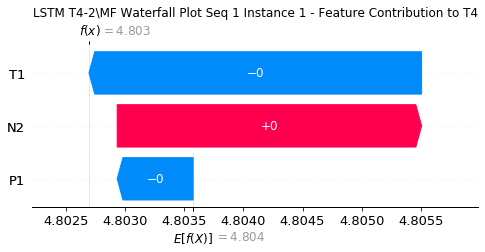

None

Contribution: [-0.00013681 -0.00084689  0.00133017]


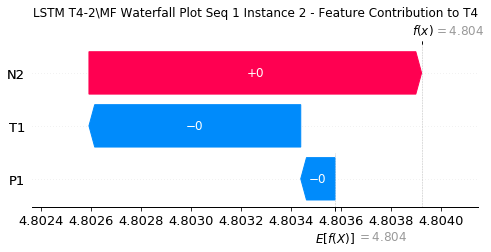

None

Contribution: [-9.34978285e-06 -9.21029749e-05  2.39978733e-04]


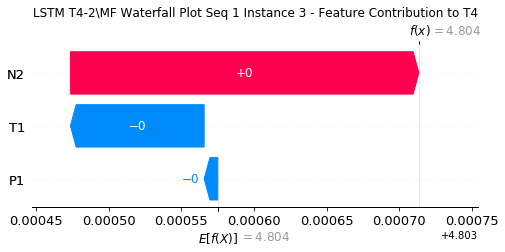

None

Contribution: [-7.36593650e-06 -3.04012159e-05  4.59238817e-05]


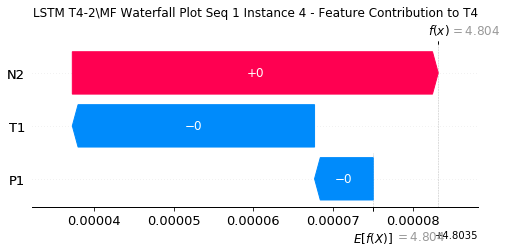

None

Contribution: [-4.60690712e-06 -3.01117471e-05  4.00368370e-05]


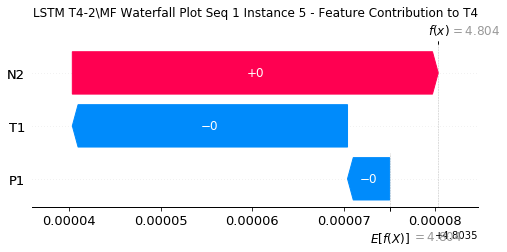

None

Contribution: [-5.60125453e-06 -2.66302465e-05  3.63223893e-05]


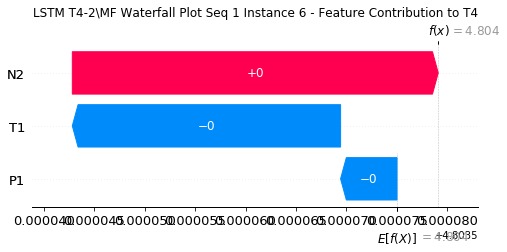

None

Contribution: [-5.17778276e-06 -2.57506890e-05  3.80872667e-05]


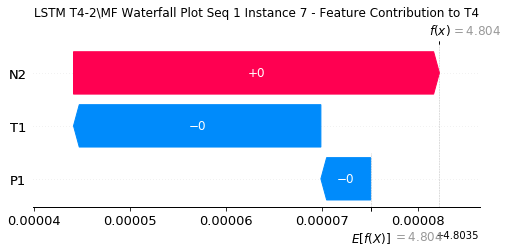

None

Contribution: [-9.04510707e-06 -2.01517646e-05  3.60149141e-05]


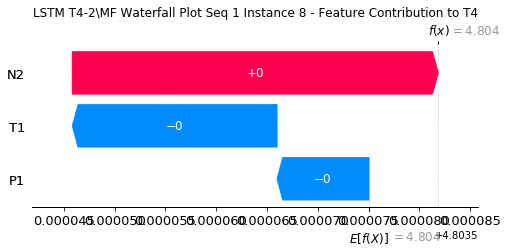

None

Contribution: [-6.57410513e-06 -2.25450798e-05  3.74092918e-05]


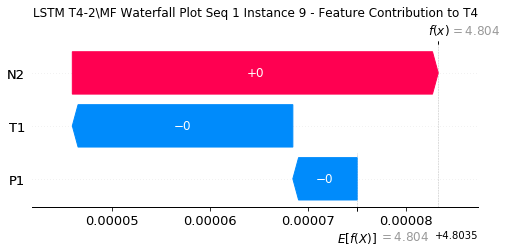

None

Contribution: [-7.25418964e-06 -2.99083112e-05  3.49782919e-05]


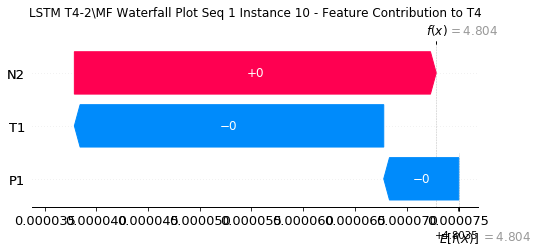

None

Contribution: [-4.54977010e-06 -3.27112977e-05  3.38355778e-05]


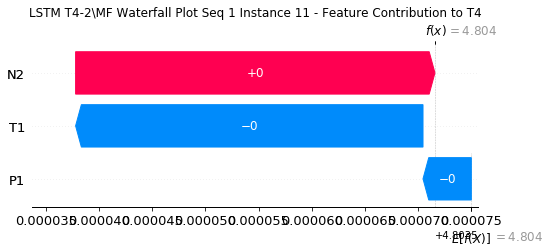

None

Contribution: [-1.61923463e-06 -3.87179544e-05  3.40301424e-05]


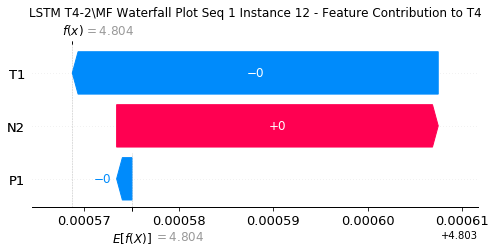

None

Contribution: [-4.22763498e-06 -3.39980711e-05  3.33262975e-05]


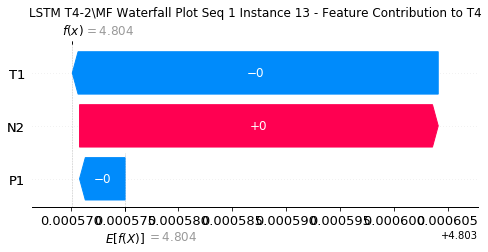

None

Contribution: [-1.24912029e-05 -3.62794518e-05  3.25997717e-05]


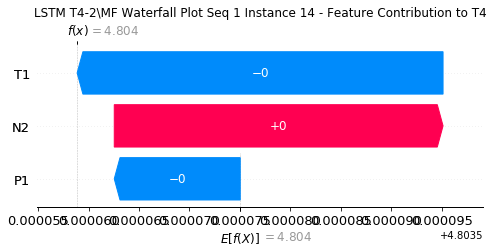

None

Contribution: [-3.95310800e-06 -3.66716916e-05  3.25387839e-05]


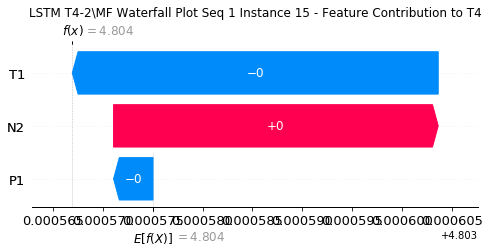

None

Contribution: [-3.84981842e-06 -3.51562968e-05  3.17683875e-05]


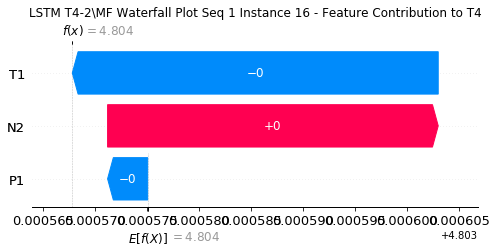

None

Contribution: [-9.53828314e-06 -3.42767209e-05  3.40183487e-05]


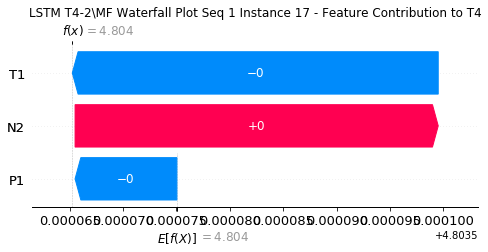

None

Contribution: [-2.65996501e-06 -3.55335774e-05  3.21088699e-05]


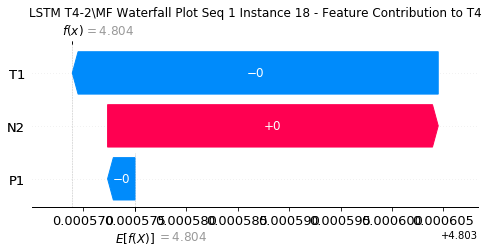

None

Contribution: [-2.65165957e-06 -3.69086443e-05  3.20109426e-05]


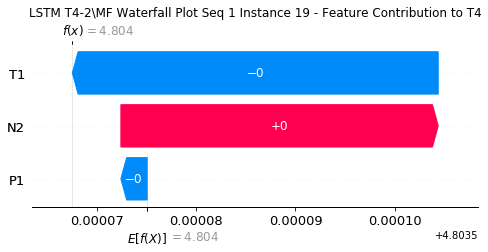

None

Contribution: [-3.26835012e-06 -3.73918849e-05  3.24963535e-05]


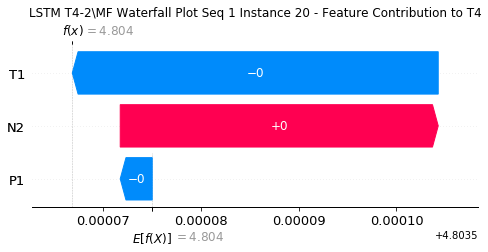

None

Contribution: [-6.92912603e-06 -4.10398712e-05  3.45344941e-05]


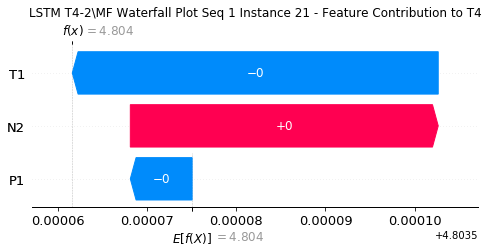

None

Contribution: [-5.99884521e-06 -6.23297680e-05  4.46261039e-05]


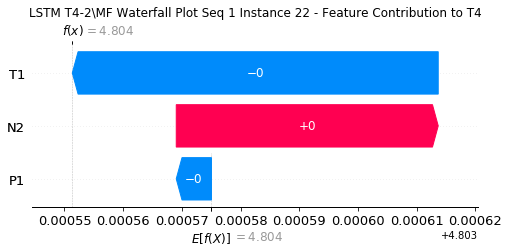

None

Contribution: [-1.92684196e-05 -1.24142606e-04  1.28196346e-04]


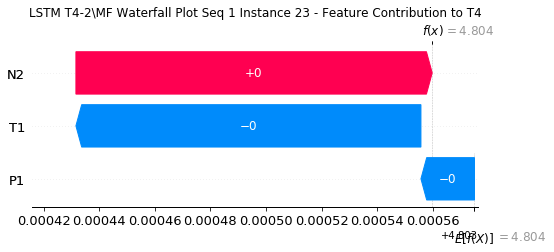

None

Contribution: [-9.20125153e-05 -8.56286389e-04  1.23319117e-03]


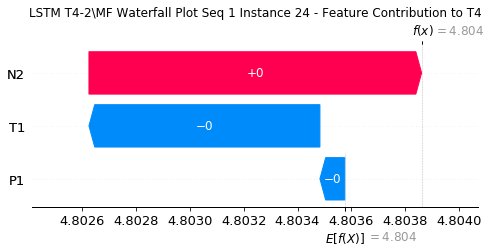

None

Contribution: [-7.03430538e-05 -1.90814904e-03  2.57679071e-03]


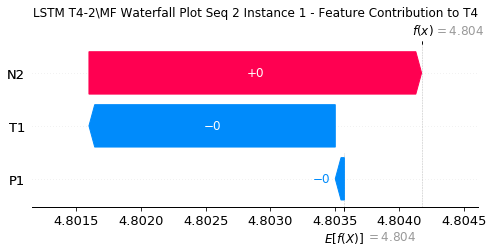

None

Contribution: [ 3.77207691e-05 -3.13521780e-04  1.26633342e-03]


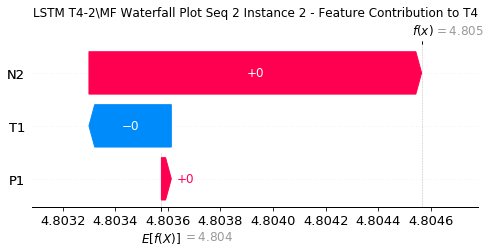

None

Contribution: [ 1.83635457e-05 -2.16785503e-05  2.31647843e-04]


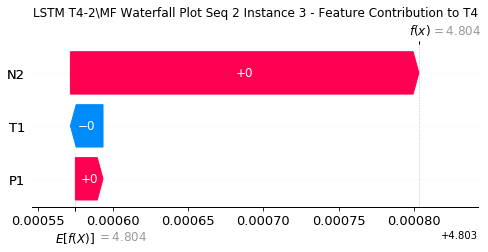

None

Contribution: [-7.68626194e-07 -1.07204881e-05  4.28710431e-05]


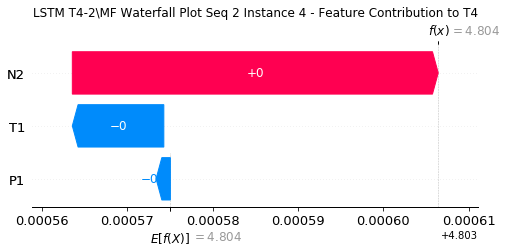

None

Contribution: [-6.62377828e-07 -1.35709032e-05  3.24605642e-05]


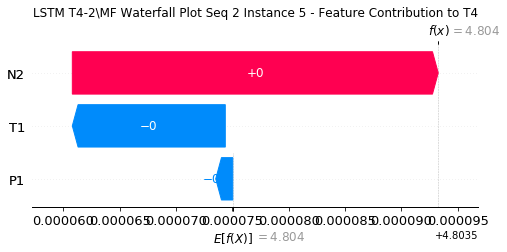

None

Contribution: [-1.00745631e-06 -1.20474320e-05  3.28931596e-05]


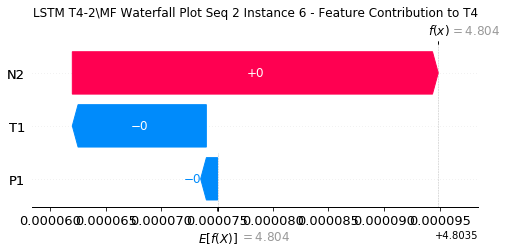

None

Contribution: [-4.18771312e-06 -1.86728285e-05  3.11756863e-05]


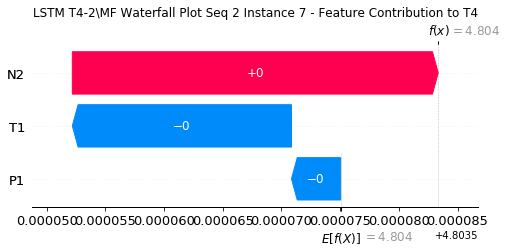

None

Contribution: [-5.49410985e-06 -1.84376421e-05  2.95146542e-05]


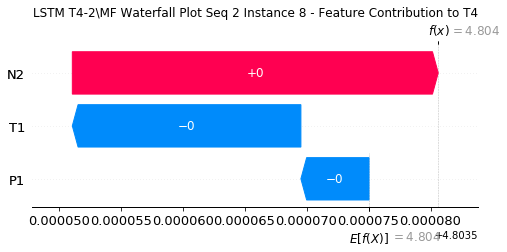

None

Contribution: [-1.72410252e-06 -2.11516468e-05  3.01694511e-05]


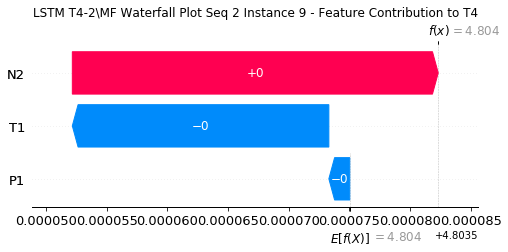

None

Contribution: [-4.36187170e-06 -1.46071658e-05  3.03369717e-05]


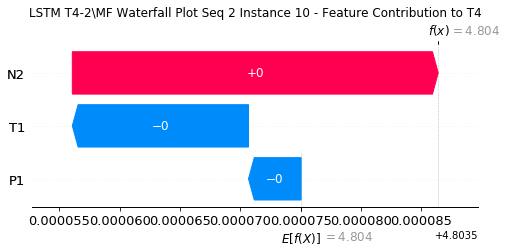

None

Contribution: [-2.53294345e-06 -1.66028018e-05  2.93461233e-05]


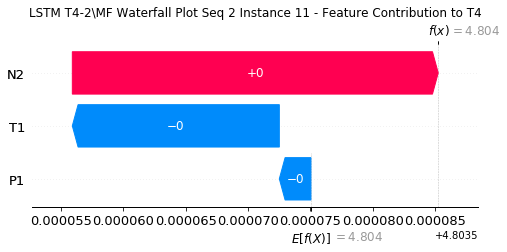

None

Contribution: [-1.58614621e-06 -2.80999070e-05  2.92024386e-05]


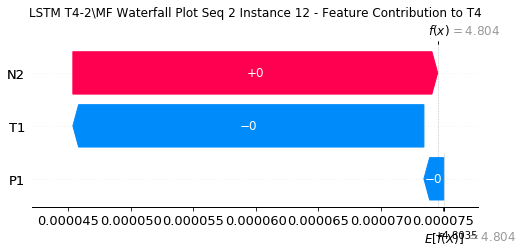

None

Contribution: [-2.43790039e-06 -2.12072168e-05  2.85923769e-05]


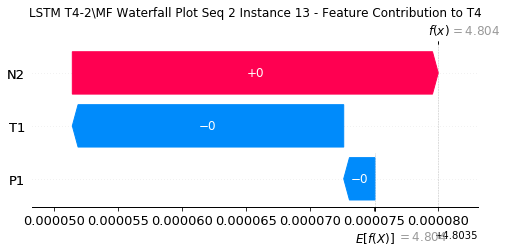

None

Contribution: [-1.03075160e-05 -2.21689221e-05  2.88718212e-05]


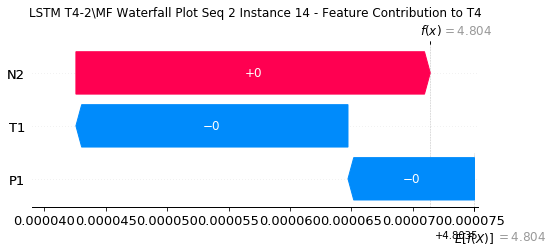

None

Contribution: [-3.51435292e-06 -2.30193066e-05  2.74014706e-05]


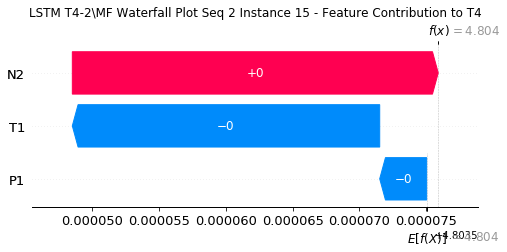

None

Contribution: [-3.23428110e-06 -2.01673094e-05  2.65916238e-05]


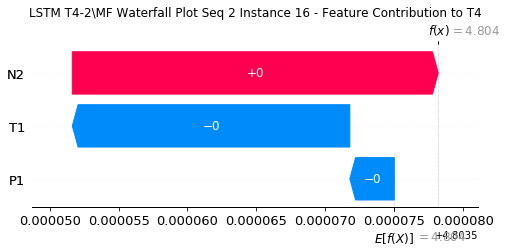

None

Contribution: [-1.06307485e-05 -2.75385381e-05  2.72448152e-05]


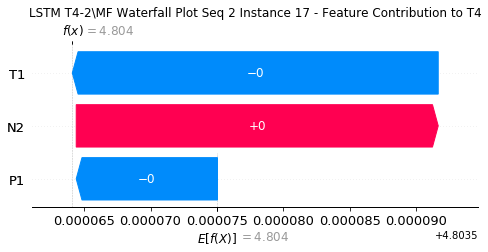

None

Contribution: [-2.84416197e-06 -2.50042957e-05  2.76763649e-05]


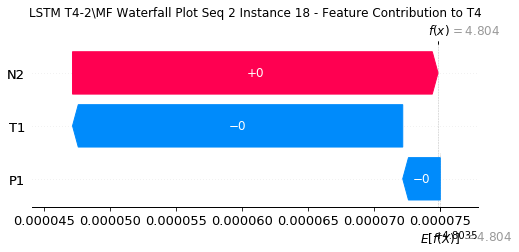

None

Contribution: [-2.55156022e-06 -2.63051553e-05  2.74833462e-05]


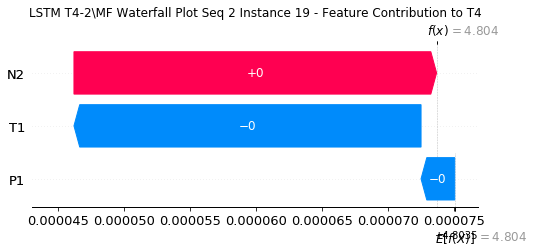

None

Contribution: [-2.87135416e-06 -3.07757402e-05  2.81072435e-05]


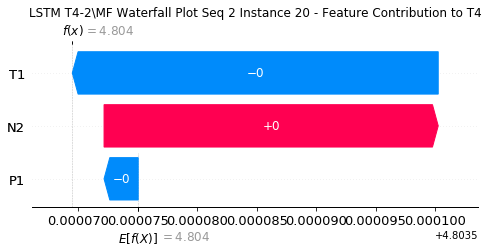

None

Contribution: [-6.17342820e-06 -3.17376648e-05  2.88240009e-05]


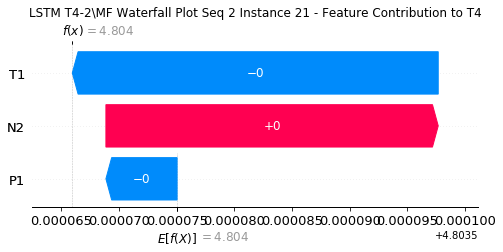

None

Contribution: [-4.36579107e-06 -4.13955875e-05  3.50647295e-05]


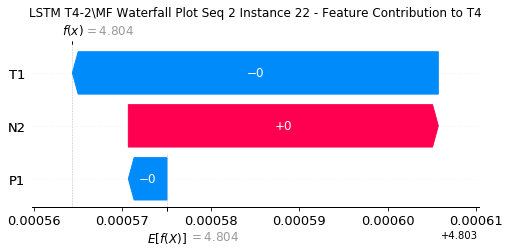

None

Contribution: [-3.76281520e-05 -1.39758228e-04  9.79431785e-05]


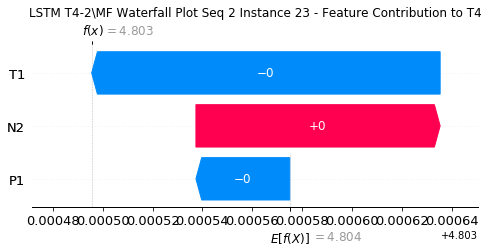

None

Contribution: [-0.00024202 -0.00215963  0.00121026]


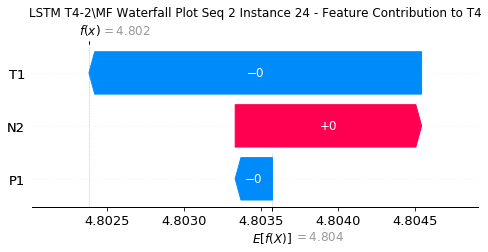

None

Contribution: [-0.00041889 -0.00547233  0.00257777]


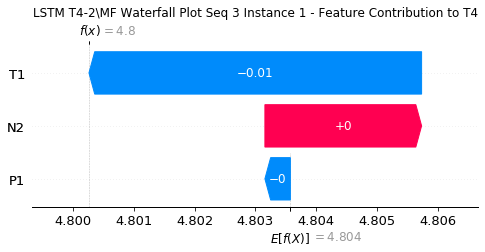

None

Contribution: [-7.32297594e-05 -1.65364968e-03  1.31561013e-03]


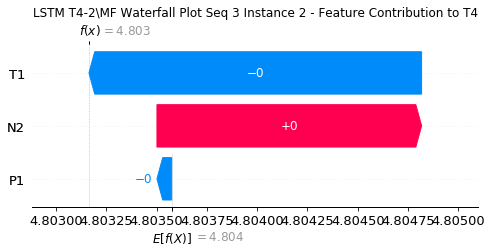

None

Contribution: [-7.57430125e-08 -3.14438285e-04  2.29167134e-04]


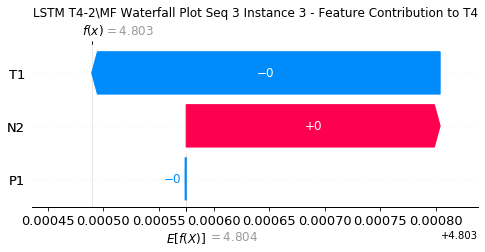

None

Contribution: [-5.37728596e-06 -8.99606093e-05  4.24726904e-05]


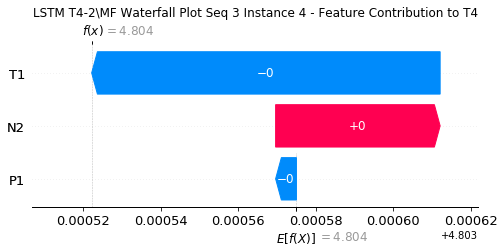

None

Contribution: [-4.88489592e-06 -8.22343930e-05  3.78056117e-05]


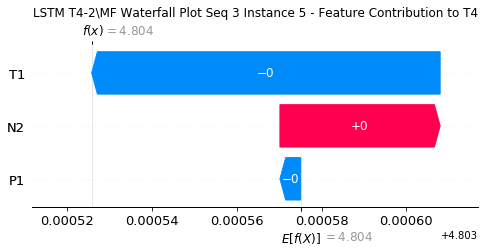

None

Contribution: [-5.20959244e-06 -7.74014177e-05  3.27027517e-05]


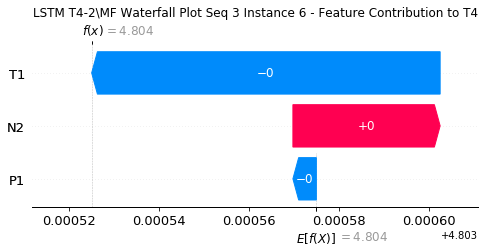

None

Contribution: [-1.17187842e-05 -7.92077103e-05  2.99686941e-05]


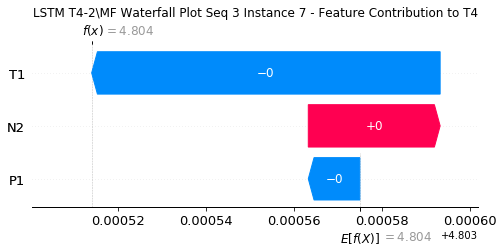

None

Contribution: [-5.43245577e-06 -9.11215877e-05  2.87258414e-05]


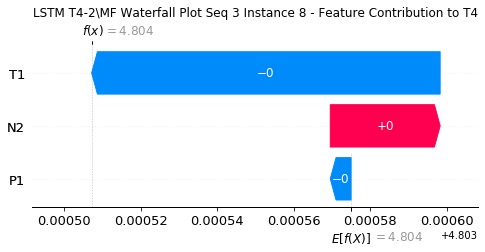

None

Contribution: [-9.54886700e-06 -8.42178062e-05  2.96548076e-05]


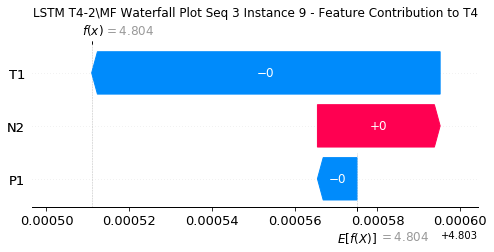

None

Contribution: [-8.04246876e-06 -8.10758827e-05  3.09446792e-05]


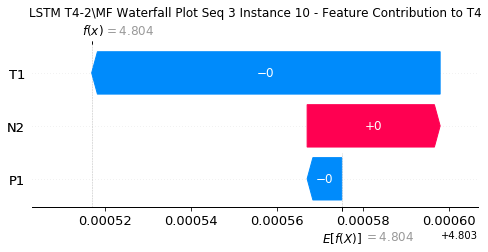

None

Contribution: [-6.21346788e-06 -8.27453882e-05  2.97009644e-05]


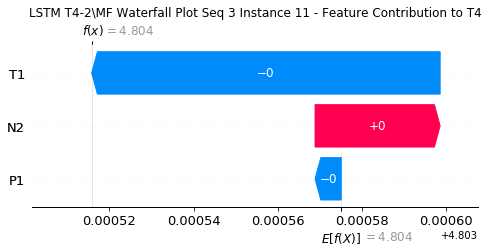

None

Contribution: [-5.82528217e-06 -8.95522051e-05  2.81270621e-05]


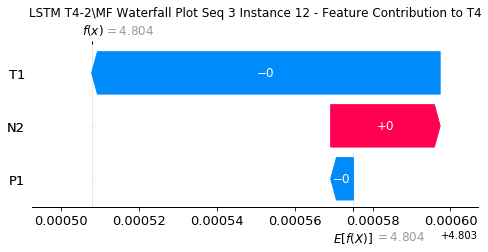

None

Contribution: [-6.70142156e-06 -8.50602022e-05  2.89032710e-05]


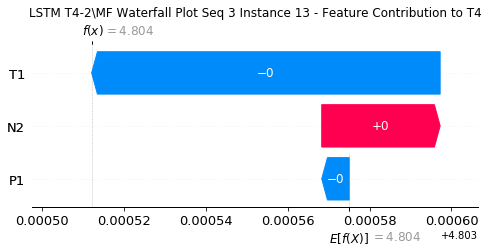

None

Contribution: [-8.92077063e-06 -8.42579205e-05  2.81832319e-05]


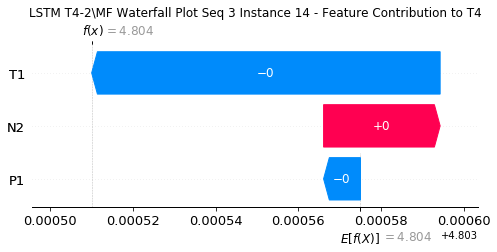

None

Contribution: [-7.82923454e-06 -8.88079260e-05  2.80908781e-05]


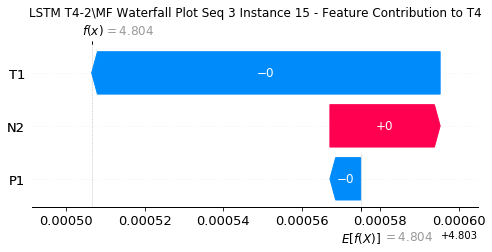

None

Contribution: [-7.36134850e-06 -8.95760551e-05  2.74651007e-05]


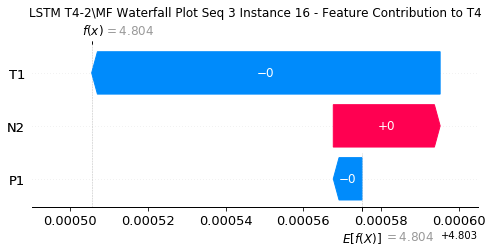

None

Contribution: [-8.92383581e-06 -8.93224066e-05  2.74676349e-05]


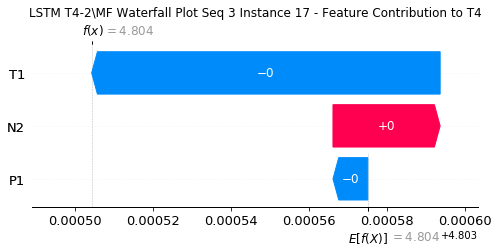

None

Contribution: [-7.90440613e-06 -8.81386528e-05  2.77212428e-05]


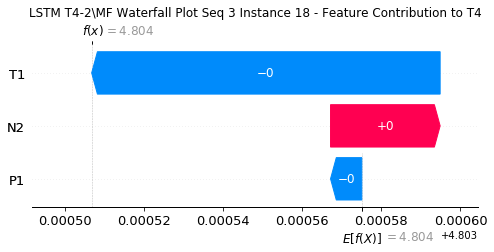

None

Contribution: [-7.75450871e-06 -9.14628201e-05  2.75986306e-05]


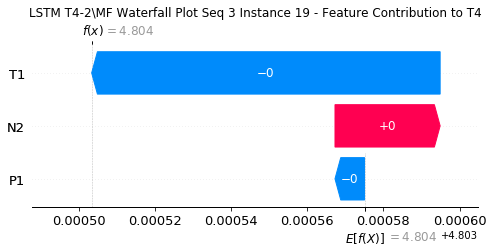

None

Contribution: [-8.67876870e-06 -9.27294596e-05  2.76594440e-05]


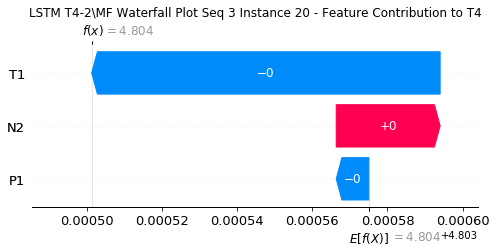

None

Contribution: [-1.19046952e-05 -1.04786298e-04  2.92085006e-05]


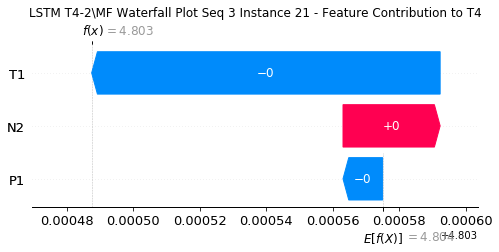

None

Contribution: [-1.17740349e-05 -1.55298675e-04  3.68333801e-05]


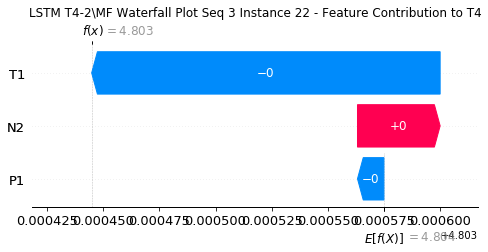

None

Contribution: [-2.74496312e-05 -4.56554926e-04  1.03910367e-04]


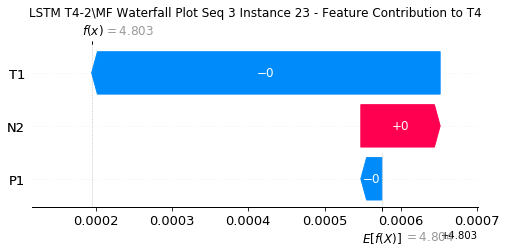

None

Contribution: [-0.00026105 -0.00378185  0.00109524]


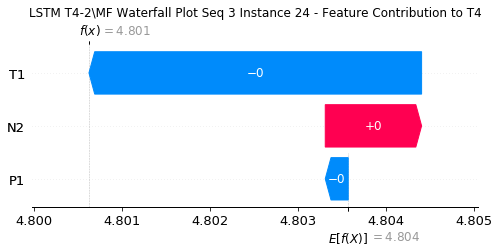

None

Contribution: [-0.00057834 -0.00748085  0.00224898]


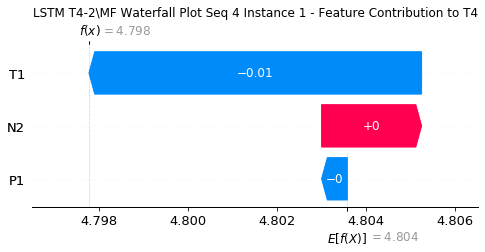

None

Contribution: [-0.00014453 -0.00227156  0.00122803]


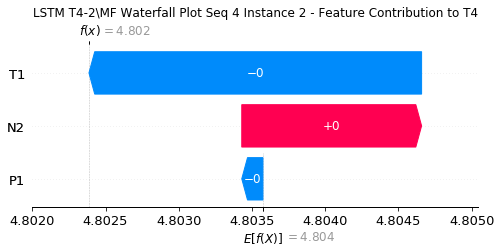

None

Contribution: [ 7.55306354e-07 -3.22026970e-04  2.19498501e-04]


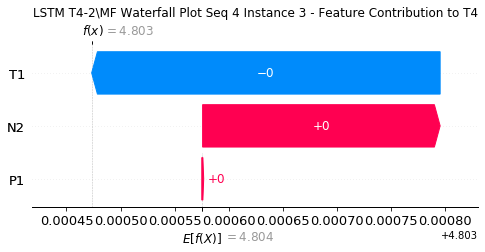

None

Contribution: [-5.68008708e-06 -9.06121994e-05  4.04520019e-05]


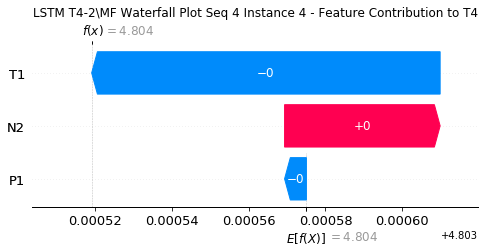

None

Contribution: [-3.51168287e-06 -6.93300507e-05  3.42365200e-05]


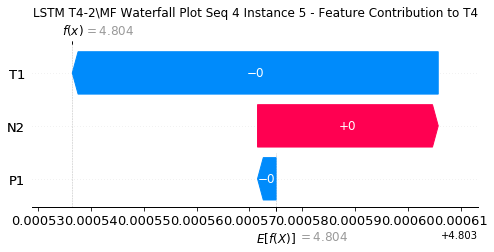

None

Contribution: [-4.76876467e-06 -7.71877688e-05  3.17217932e-05]


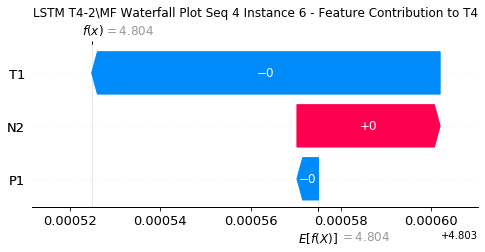

None

Contribution: [-5.05204090e-06 -8.07347546e-05  3.17251386e-05]


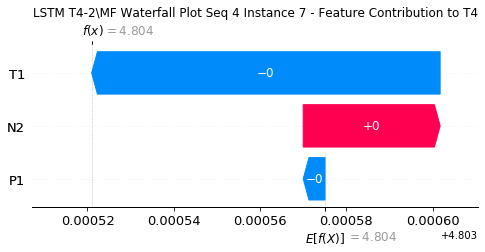

None

Contribution: [-6.53900325e-06 -8.36036311e-05  3.11113197e-05]


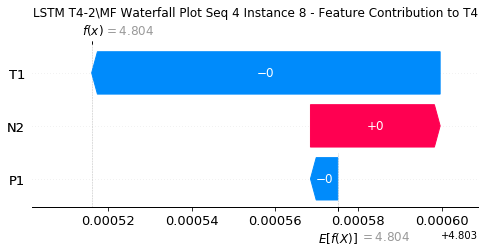

None

Contribution: [-9.08330110e-06 -7.83724819e-05  3.13390677e-05]


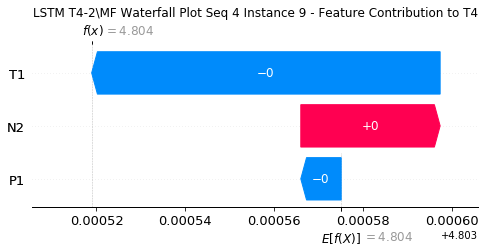

None

Contribution: [-6.91094078e-06 -8.08928250e-05  3.13985809e-05]


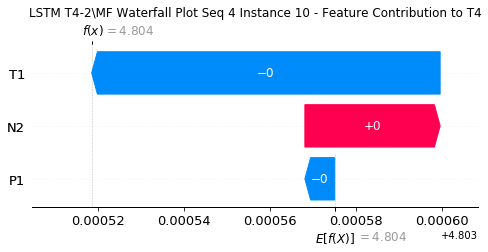

None

Contribution: [-4.01831157e-06 -8.47244192e-05  3.02566203e-05]


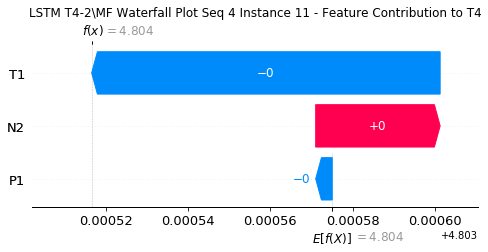

None

Contribution: [-1.28366766e-05 -9.64180035e-05  2.90136387e-05]


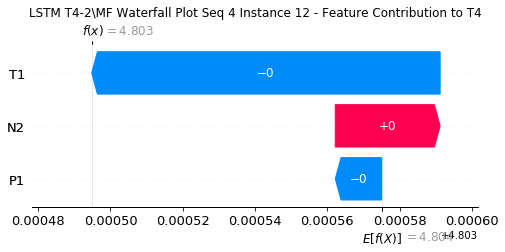

None

Contribution: [-5.01563864e-06 -8.81896867e-05  2.96729164e-05]


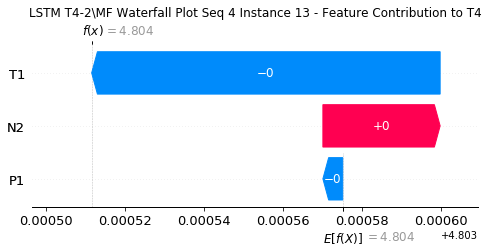

None

Contribution: [-6.06131153e-06 -9.43501953e-05  3.08404442e-05]


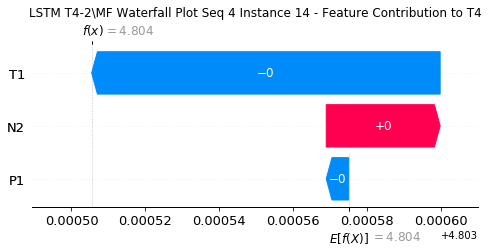

None

Contribution: [-5.03933288e-06 -9.39409032e-05  2.92846982e-05]


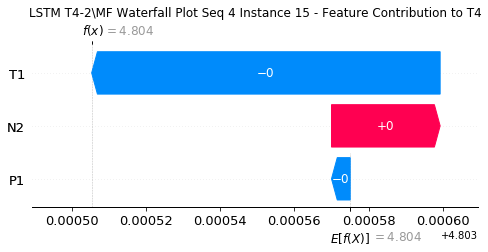

None

Contribution: [-5.44515185e-06 -9.37155890e-05  2.88524093e-05]


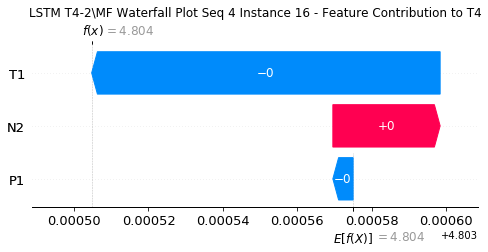

None

Contribution: [-5.06969366e-06 -9.44313309e-05  2.96612409e-05]


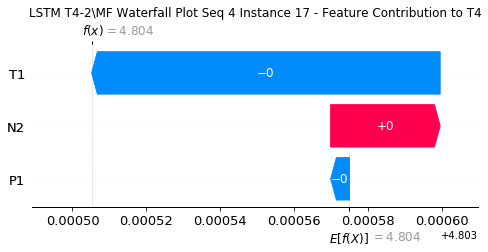

None

Contribution: [-4.84823054e-06 -9.63610887e-05  2.86963722e-05]


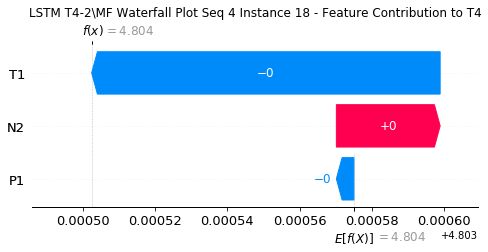

None

Contribution: [-5.54111472e-06 -9.83180472e-05  2.87419202e-05]


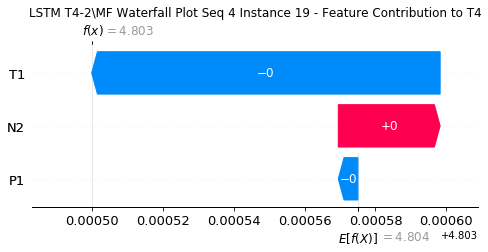

None

Contribution: [-7.06105214e-06 -1.00154823e-04  2.87607906e-05]


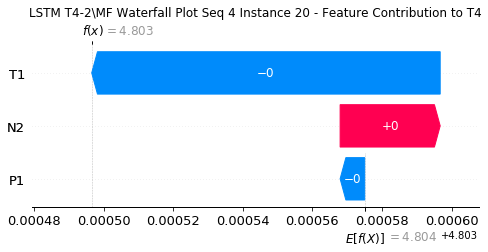

None

Contribution: [-1.15445433e-05 -1.09898476e-04  3.09940389e-05]


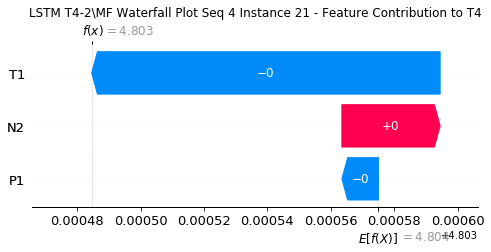

None

Contribution: [-1.24450879e-05 -1.61424290e-04  3.78531340e-05]


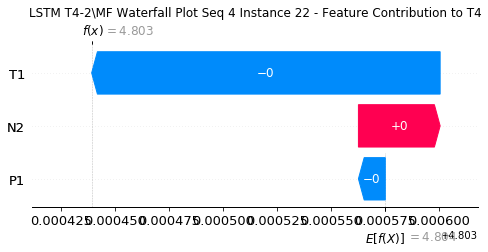

None

Contribution: [-2.12823533e-05 -4.19321805e-04  1.04664390e-04]


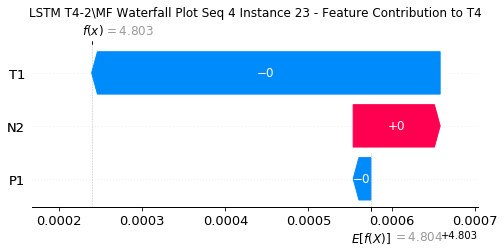

None

Contribution: [-0.00018577 -0.00375543  0.00117187]


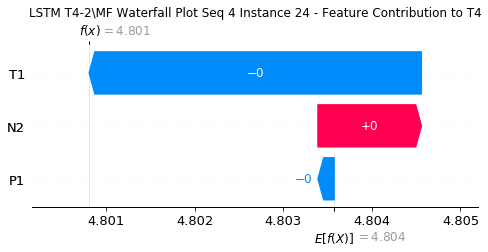

None

Contribution: [-0.00035401 -0.0080866   0.00234393]


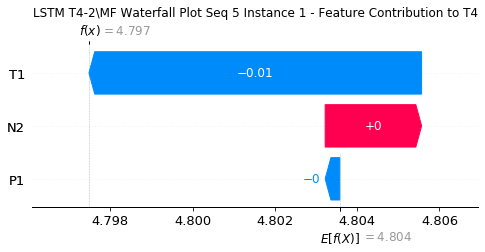

None

Contribution: [-5.89944613e-05 -2.70077309e-03  1.22745259e-03]


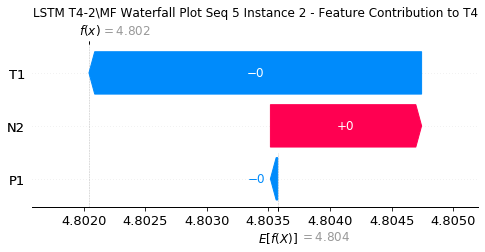

None

Contribution: [-1.20324173e-06 -4.12375703e-04  2.26680595e-04]


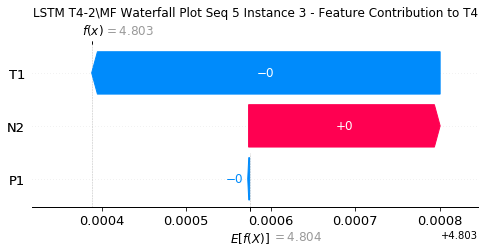

None

Contribution: [-5.29569870e-06 -1.10892273e-04  4.19330975e-05]


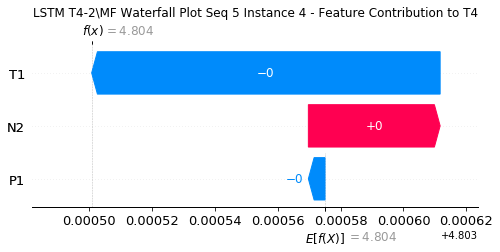

None

Contribution: [-1.48420788e-06 -1.02558981e-04  3.46794097e-05]


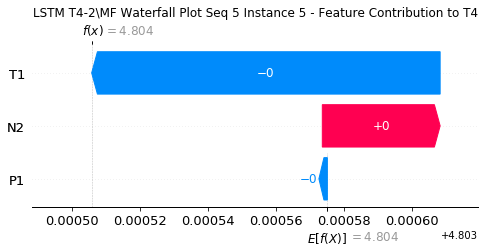

None

Contribution: [-4.82502736e-06 -9.32320318e-05  3.28259305e-05]


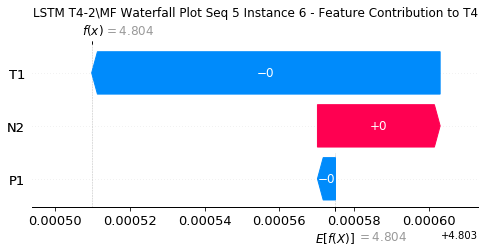

None

Contribution: [-6.76732982e-06 -9.39476610e-05  3.27120434e-05]


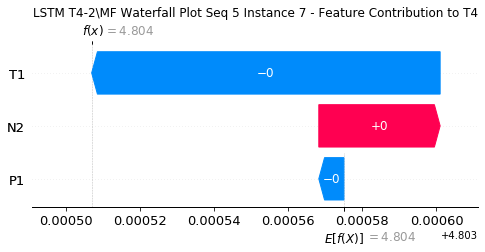

None

Contribution: [-1.12907855e-05 -9.37843846e-05  3.03953954e-05]


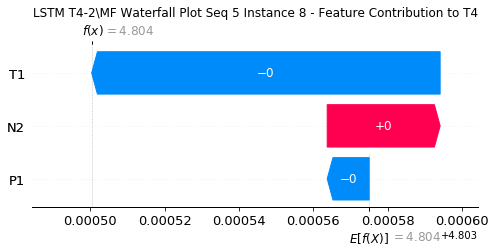

None

Contribution: [-7.48491774e-06 -8.76156727e-05  3.24241659e-05]


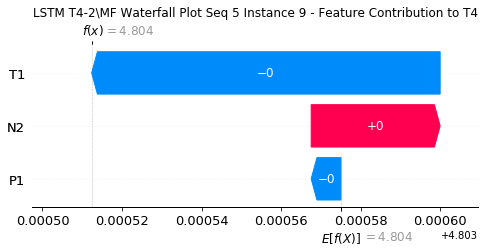

None

Contribution: [-5.37747003e-06 -8.96912901e-05  3.22424874e-05]


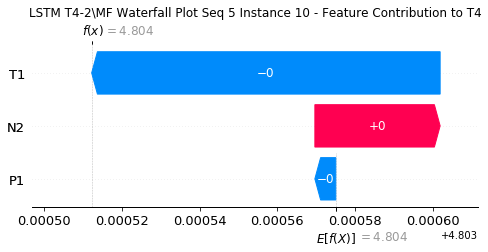

None

Contribution: [-3.32984113e-06 -9.37741181e-05  3.10502296e-05]


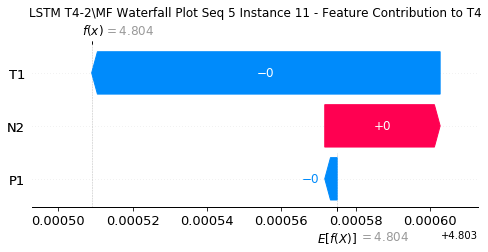

None

Contribution: [-8.60610681e-06 -9.42958173e-05  3.05278655e-05]


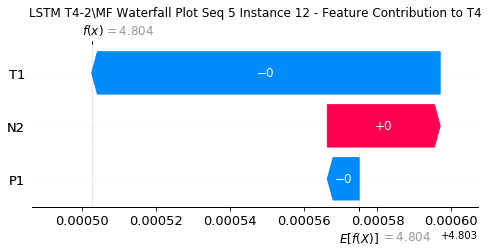

None

Contribution: [-3.71710042e-06 -9.43739153e-05  3.05163459e-05]


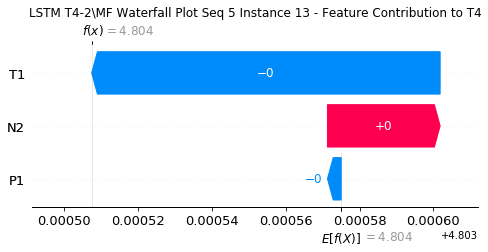

None

Contribution: [-5.13437678e-06 -9.46904757e-05  2.96903645e-05]


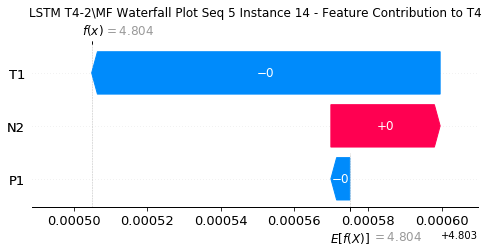

None

Contribution: [-4.21304650e-06 -9.95920007e-05  2.98726265e-05]


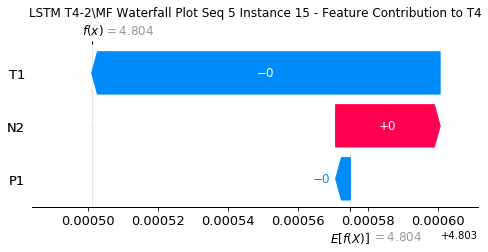

None

Contribution: [-5.20494959e-06 -1.00127451e-04  2.91842484e-05]


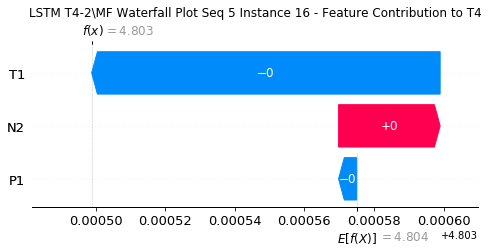

None

Contribution: [-1.15181245e-05 -1.04782869e-04  2.88912347e-05]


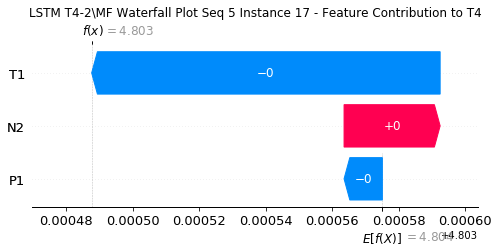

None

Contribution: [-6.60820176e-06 -1.03650280e-04  2.90851419e-05]


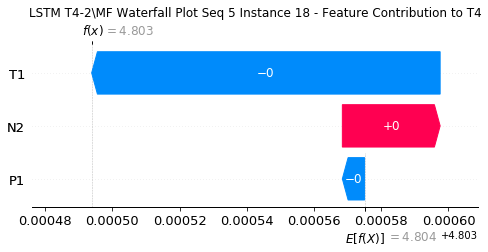

None

Contribution: [-7.25448807e-06 -1.05389206e-04  2.90350883e-05]


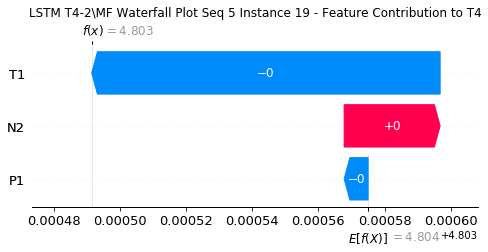

None

Contribution: [-8.76287446e-06 -1.05023079e-04  2.92495628e-05]


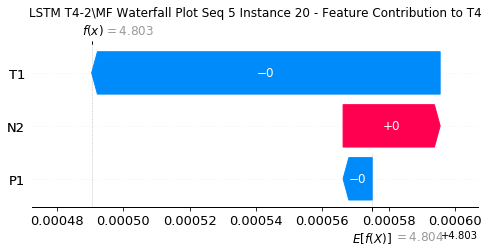

None

Contribution: [-1.22532428e-05 -1.13654223e-04  3.12405544e-05]


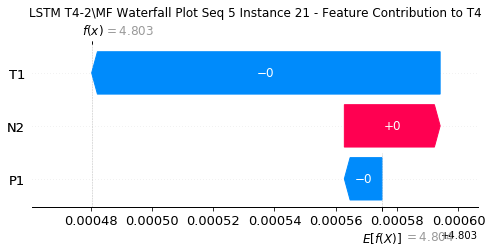

None

Contribution: [-1.42543340e-05 -1.66217238e-04  3.81760695e-05]


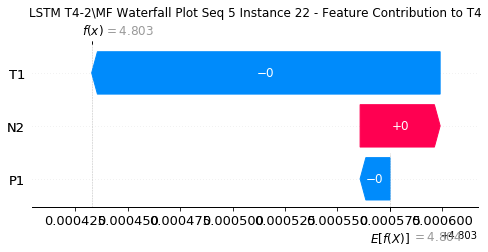

None

Contribution: [-4.46188348e-05 -4.18802540e-04  1.01940645e-04]


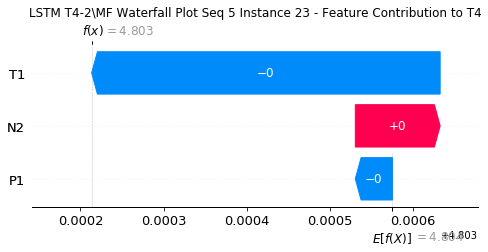

None

Contribution: [-0.00035798 -0.0037927   0.00116134]


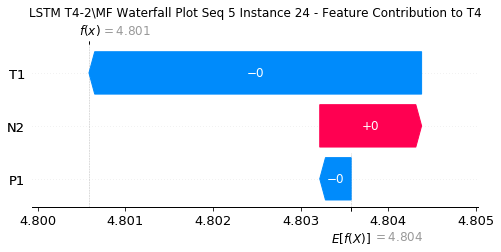

None

Contribution: [-0.00059291 -0.00753615  0.0023941 ]


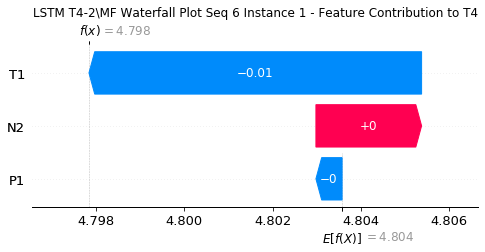

None

Contribution: [-6.93496635e-05 -2.49045350e-03  1.25700918e-03]


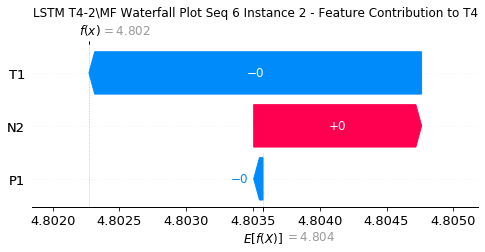

None

Contribution: [-1.00360588e-05 -3.51577617e-04  2.16368769e-04]


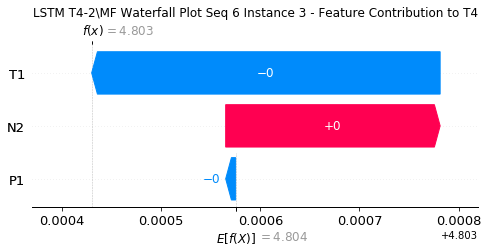

None

Contribution: [-6.64194473e-06 -9.73350451e-05  4.00045790e-05]


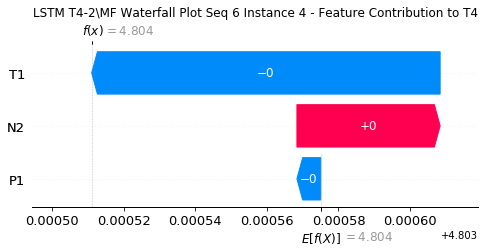

None

Contribution: [-1.09260869e-05 -8.73769959e-05  3.23470605e-05]


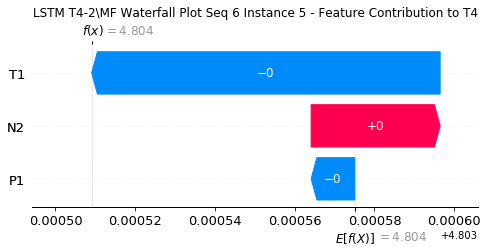

None

Contribution: [-5.73679674e-06 -8.17091543e-05  3.14304154e-05]


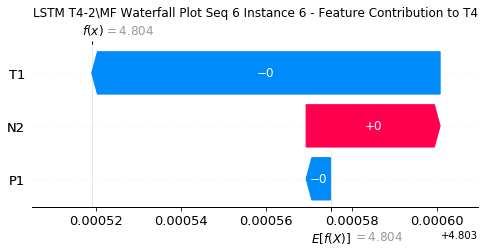

None

Contribution: [-1.00524871e-05 -8.39467125e-05  3.05850451e-05]


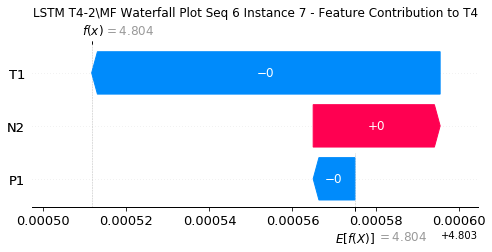

None

Contribution: [-1.36004903e-05 -7.94227376e-05  3.14681848e-05]


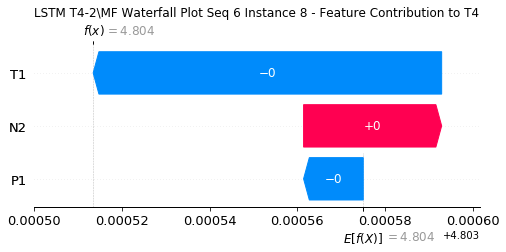

None

Contribution: [-8.10360435e-06 -8.17641437e-05  3.26295641e-05]


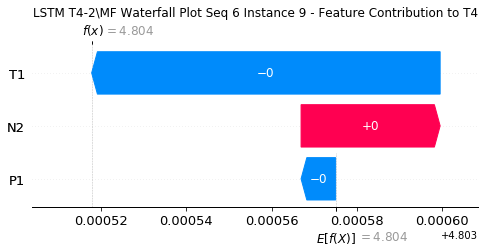

None

Contribution: [-7.22501325e-06 -8.25316188e-05  3.21916272e-05]


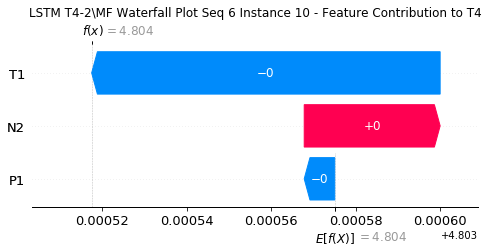

None

Contribution: [-5.07688374e-06 -8.53087082e-05  3.06369987e-05]


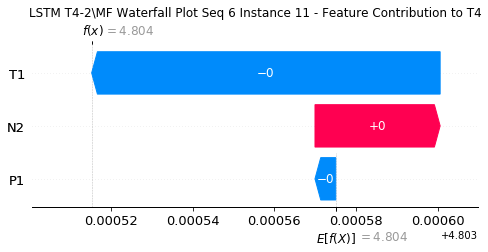

None

Contribution: [-1.17472678e-06 -8.78376444e-05  2.99510781e-05]


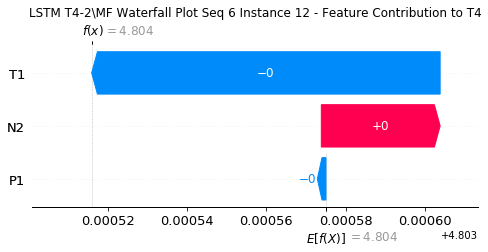

None

Contribution: [-5.07444844e-06 -8.65674094e-05  3.05298507e-05]


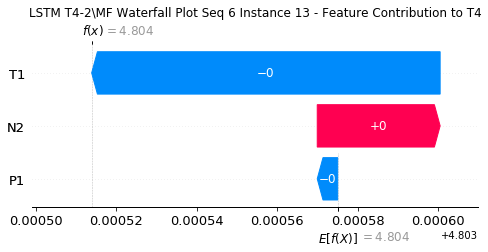

None

Contribution: [-7.17504126e-06 -9.13431561e-05  2.75677050e-05]


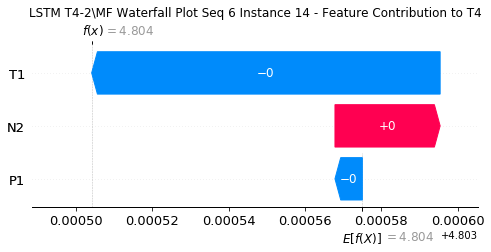

None

Contribution: [-5.22110078e-06 -9.09860790e-05  2.97754403e-05]


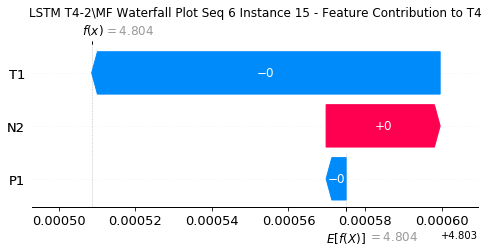

None

Contribution: [-4.04670785e-06 -8.99787010e-05  2.94380836e-05]


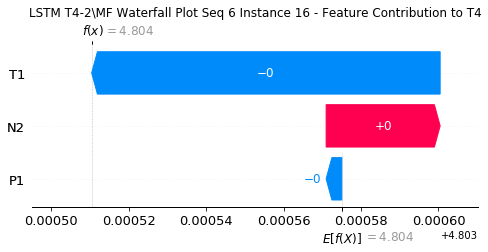

None

Contribution: [-9.93796405e-06 -8.81058277e-05  2.96870677e-05]


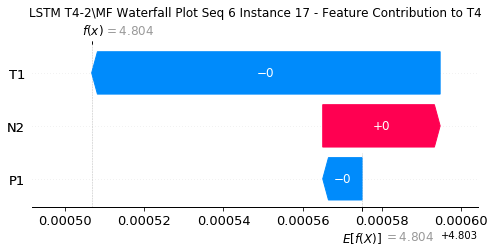

None

Contribution: [-4.74454224e-06 -8.91864904e-05  2.89568887e-05]


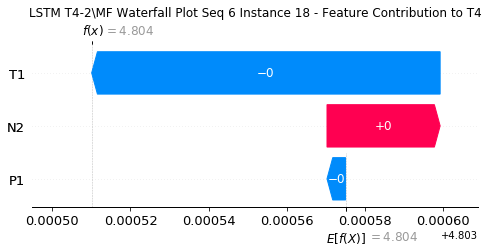

None

Contribution: [-4.15630507e-06 -9.04280894e-05  2.93630601e-05]


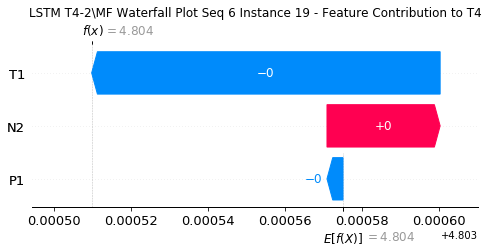

None

Contribution: [-5.42152128e-06 -8.97468784e-05  3.01211838e-05]


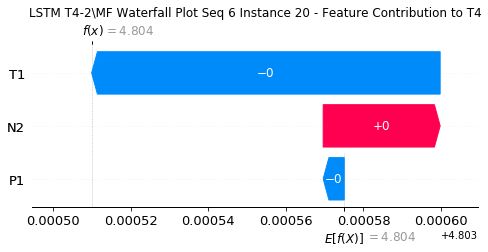

None

Contribution: [-7.69572995e-06 -9.89941066e-05  3.29548360e-05]


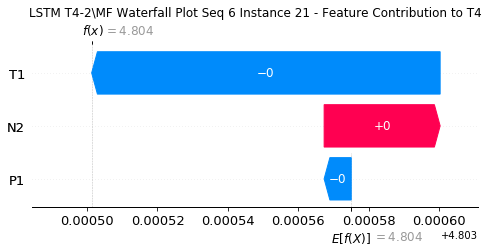

None

Contribution: [-8.19383390e-06 -1.44725838e-04  4.05561227e-05]


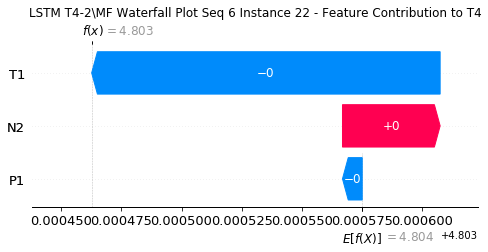

None

Contribution: [-3.30756692e-05 -3.78283833e-04  1.09939436e-04]


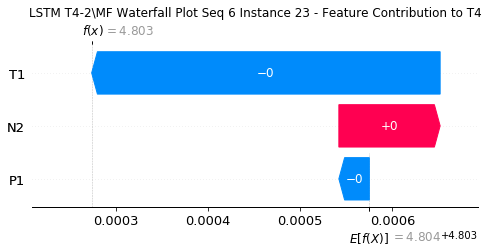

None

Contribution: [-0.00015734 -0.0032461   0.00123252]


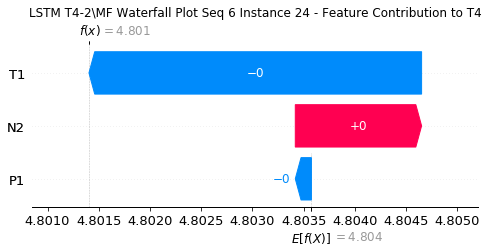

None

Contribution: [-0.00047336 -0.00674801  0.00251478]


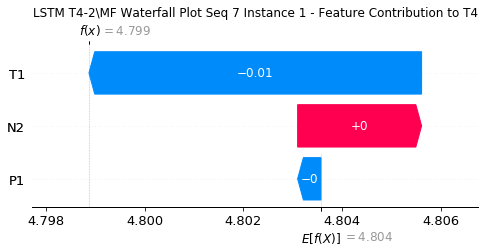

None

Contribution: [-9.64209735e-05 -2.34351079e-03  1.24962754e-03]


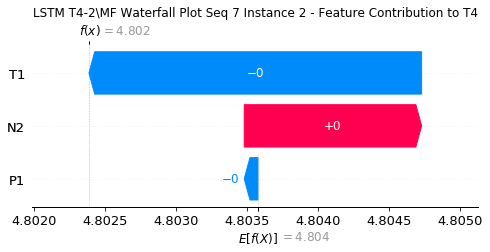

None

Contribution: [ 1.99631018e-07 -3.79677826e-04  2.20745632e-04]


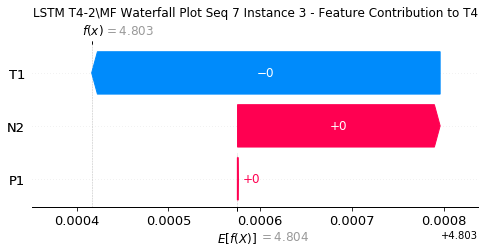

None

Contribution: [-4.91834549e-06 -1.06287621e-04  4.09618625e-05]


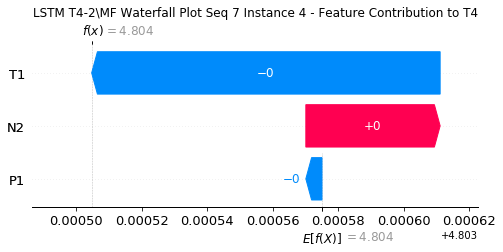

None

Contribution: [-7.00366191e-06 -9.15723306e-05  3.39699604e-05]


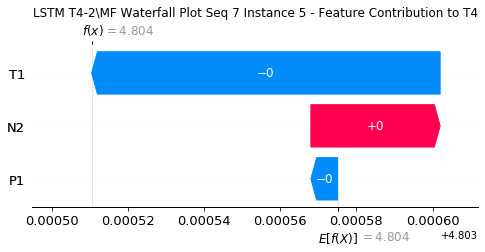

None

Contribution: [-4.74610295e-06 -9.16239202e-05  3.15496588e-05]


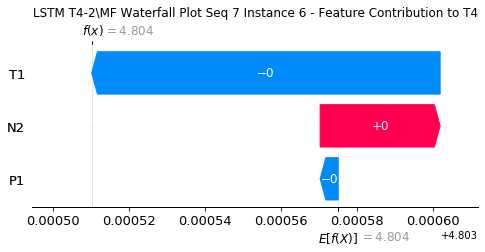

None

Contribution: [-9.60237728e-06 -1.00584768e-04  2.66075093e-05]


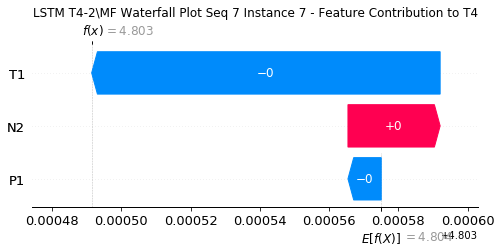

None

Contribution: [-6.60384579e-06 -8.77418339e-05  2.69093643e-05]


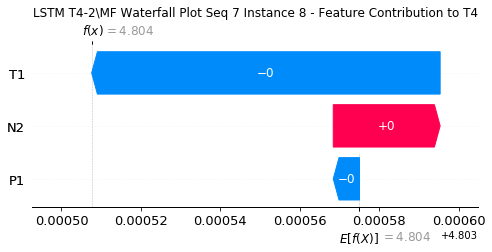

None

Contribution: [-8.54490161e-06 -8.99641526e-05  2.68745073e-05]


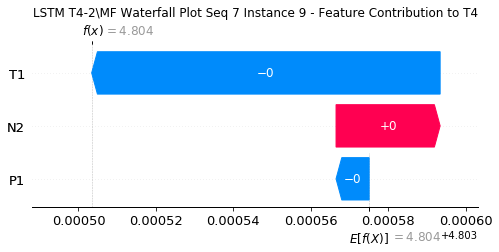

None

Contribution: [-6.57394078e-06 -9.81234915e-05  3.12812925e-05]


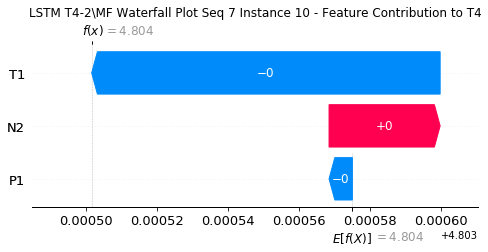

None

Contribution: [-4.62559017e-06 -1.03572213e-04  3.01439394e-05]


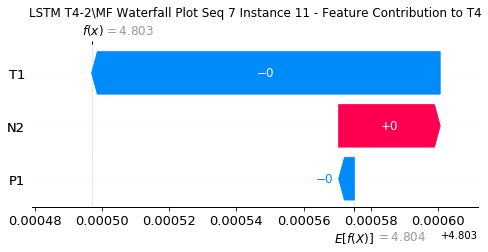

None

Contribution: [-3.88802391e-06 -1.17651191e-04  3.02798696e-05]


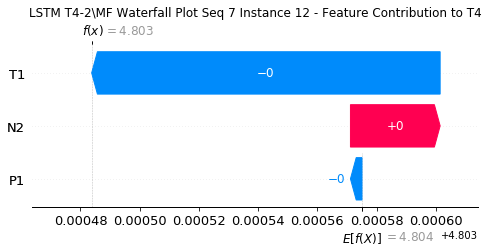

None

Contribution: [-5.49743967e-06 -1.06942108e-04  2.95073251e-05]


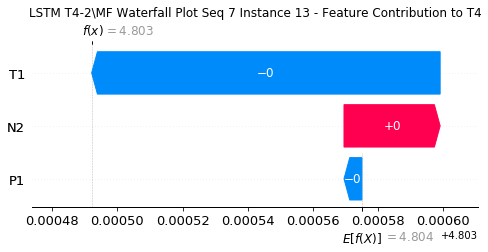

None

Contribution: [-7.43423533e-06 -1.14714413e-04  3.14709680e-05]


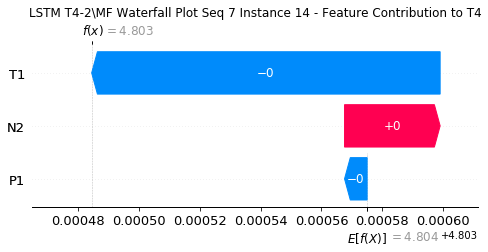

None

Contribution: [-6.66784463e-06 -1.14894432e-04  2.93477161e-05]


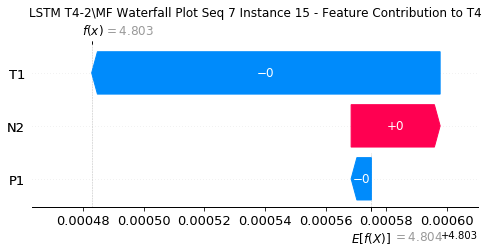

None

Contribution: [-6.38174901e-06 -1.14824752e-04  2.95116187e-05]


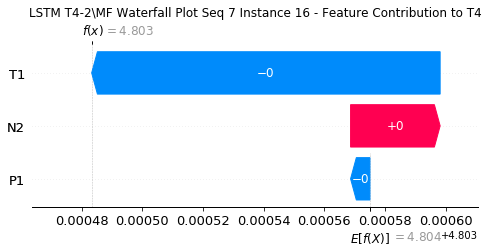

None

Contribution: [-8.35979014e-06 -1.19228875e-04  2.88313041e-05]


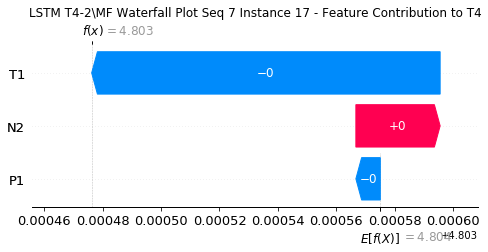

None

Contribution: [-8.00163697e-06 -1.18123979e-04  2.92314762e-05]


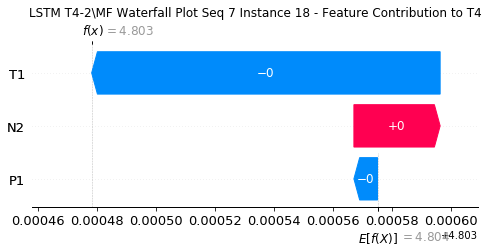

None

Contribution: [-7.89523435e-06 -1.20206930e-04  2.95806248e-05]


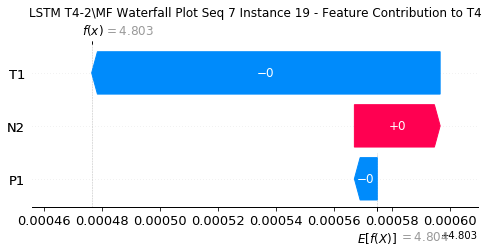

None

Contribution: [-9.20551497e-06 -1.21244366e-04  2.93181434e-05]


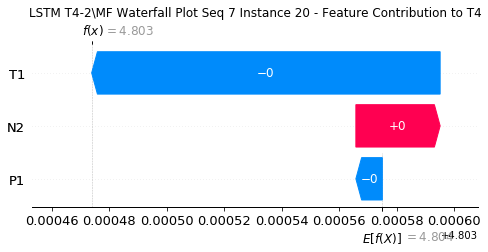

None

Contribution: [-1.22122045e-05 -1.32733402e-04  3.19313752e-05]


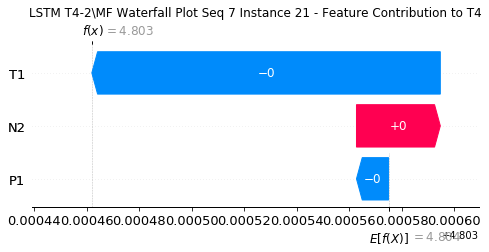

None

Contribution: [-1.40294809e-05 -1.91783101e-04  3.88235180e-05]


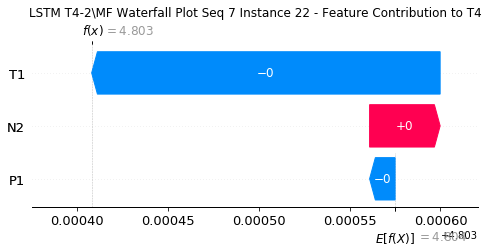

None

Contribution: [-3.04169170e-05 -5.18760249e-04  1.04869334e-04]


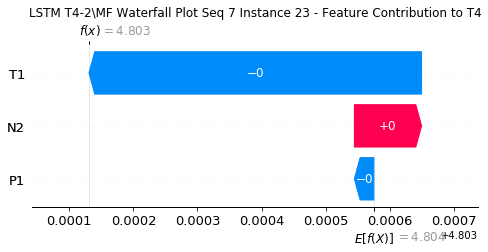

None

Contribution: [-0.00023258 -0.00465366  0.00123204]


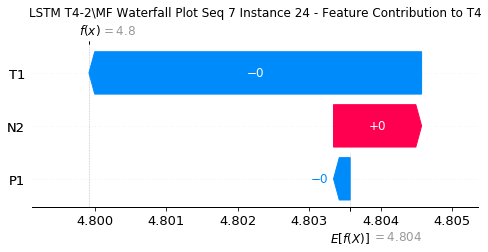

None

Contribution: [-0.00060033 -0.00961368  0.00235454]


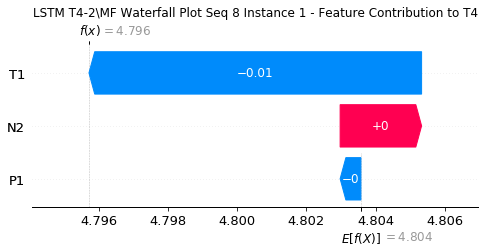

None

Contribution: [-0.00021336 -0.00300728  0.00125464]


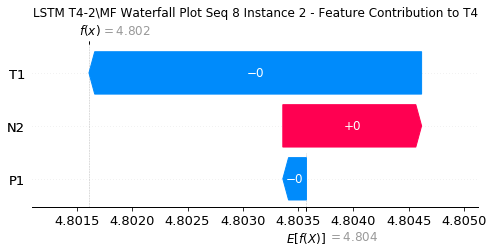

None

Contribution: [ 6.00028512e-06 -5.20033119e-04  2.08555616e-04]


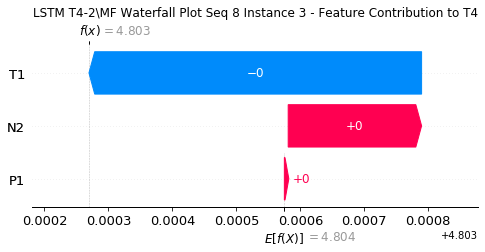

None

Contribution: [-7.40502575e-06 -1.39430458e-04  3.72457171e-05]


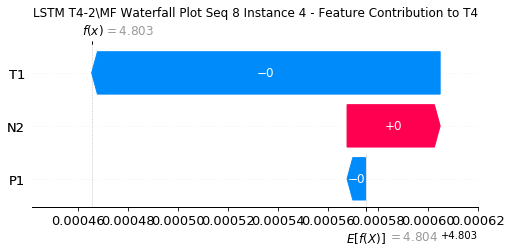

None

Contribution: [-4.51950831e-06 -1.07574815e-04  3.26629635e-05]


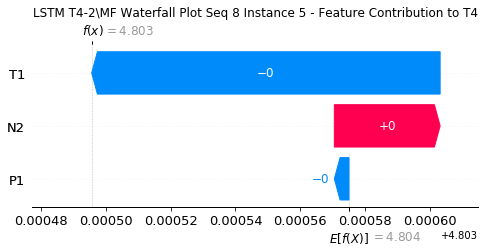

None

Contribution: [-7.44424307e-06 -1.13753656e-04  2.90669367e-05]


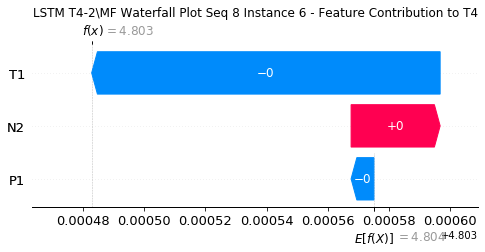

None

Contribution: [-9.81582712e-06 -1.03632660e-04  3.05985583e-05]


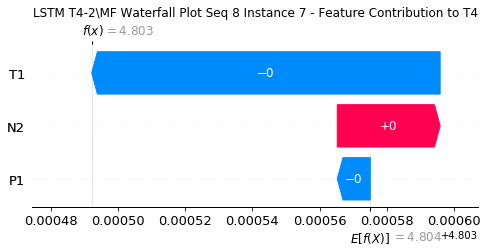

None

Contribution: [-1.12605808e-05 -1.10559946e-04  2.94721639e-05]


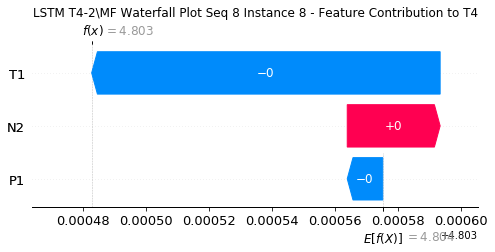

None

Contribution: [-1.21523727e-05 -9.87373725e-05  3.03411812e-05]


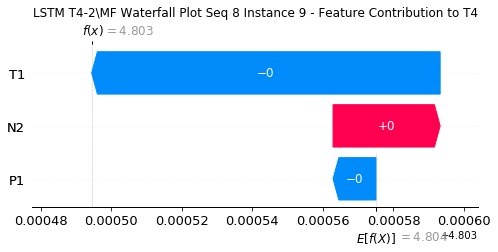

None

Contribution: [-7.95252622e-06 -1.08688735e-04  3.08066271e-05]


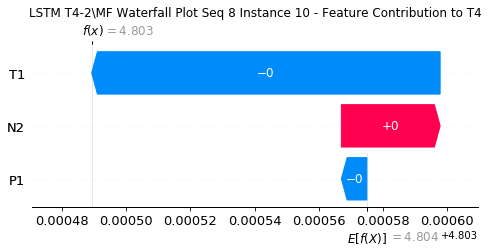

None

Contribution: [-5.73580569e-06 -1.12847540e-04  2.96537183e-05]


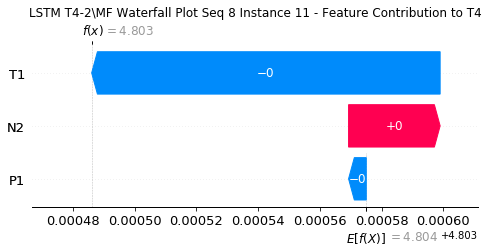

None

Contribution: [-9.50407128e-06 -1.18282152e-04  2.95495278e-05]


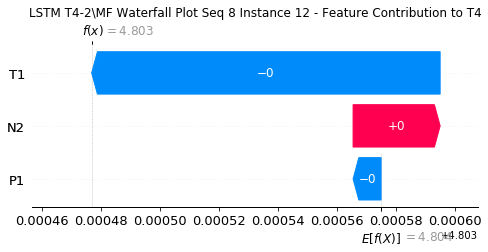

None

Contribution: [-4.01223163e-06 -1.11752048e-04  3.06871470e-05]


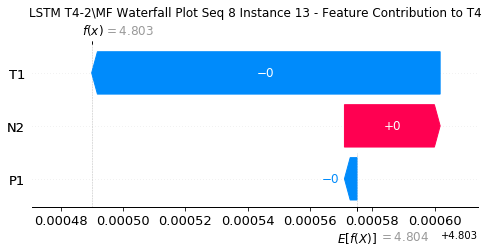

None

Contribution: [-5.58177159e-06 -1.20066708e-04  3.20780228e-05]


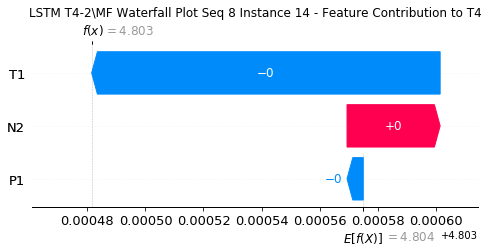

None

Contribution: [-7.45025925e-06 -1.17986411e-04  3.02912964e-05]


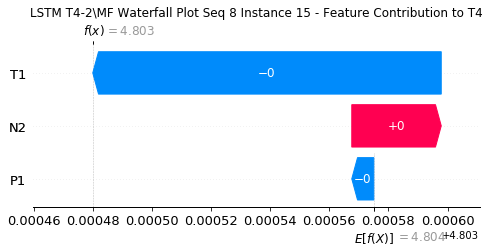

None

Contribution: [-1.20018083e-05 -1.20238693e-04  2.82655338e-05]


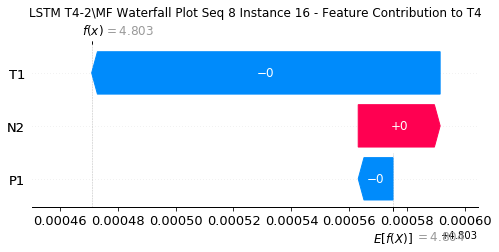

None

Contribution: [-1.43333808e-05 -1.18574483e-04  2.99505987e-05]


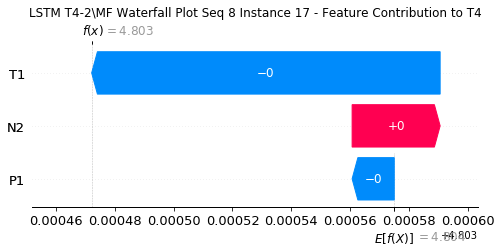

None

Contribution: [-8.55551497e-06 -1.20016587e-04  2.93763954e-05]


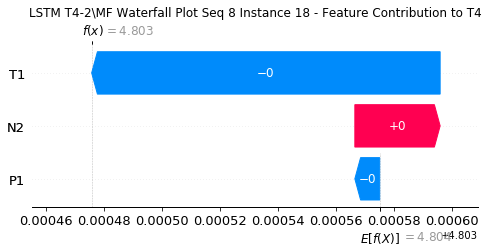

None

Contribution: [-1.03429997e-05 -1.21841579e-04  2.87081069e-05]


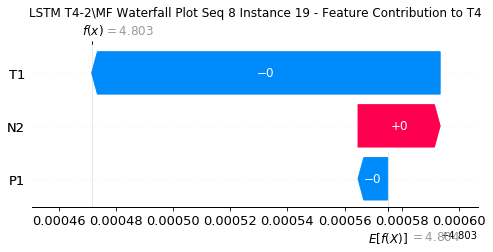

None

Contribution: [-6.57402794e-06 -1.18543802e-04  3.04175449e-05]


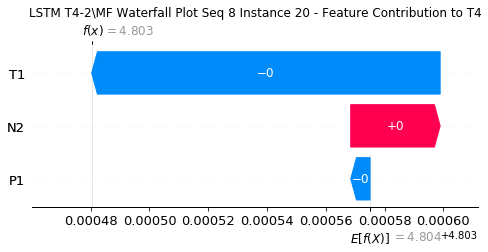

None

Contribution: [-1.45751994e-05 -1.30225141e-04  3.20105640e-05]


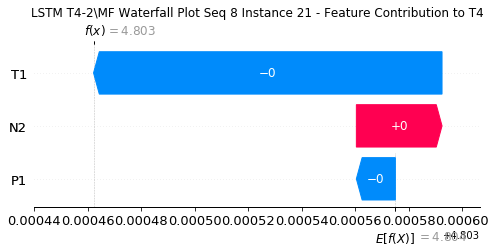

None

Contribution: [-9.34369273e-06 -1.91040208e-04  4.42646446e-05]


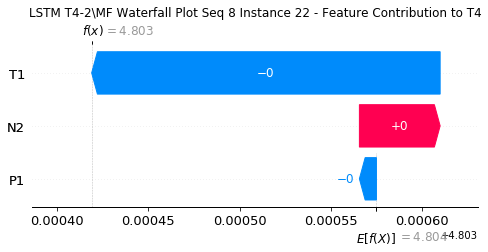

None

Contribution: [-5.29002509e-05 -5.37290777e-04  1.08794343e-04]


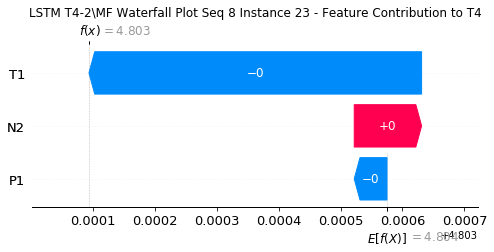

None

Contribution: [-0.00078897 -0.00468749  0.0008603 ]


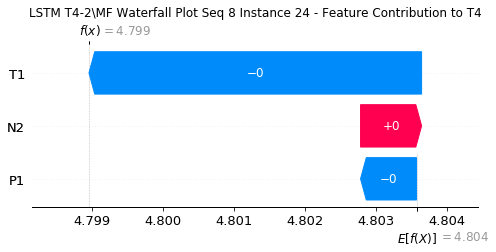

None

Contribution: [-0.00027094 -0.00890657  0.00231134]


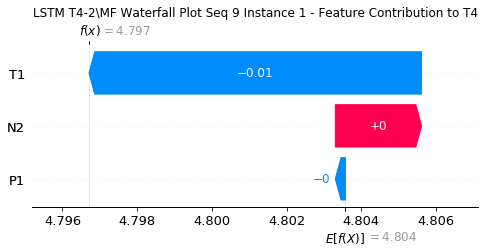

None

Contribution: [-0.00016776 -0.00332969  0.00128159]


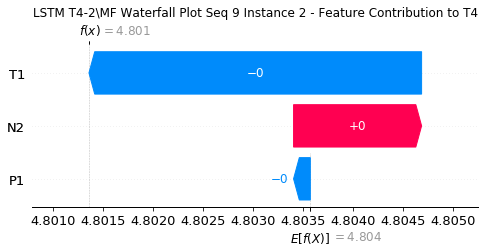

None

Contribution: [-5.47981216e-05 -4.51041408e-04  2.38274366e-04]


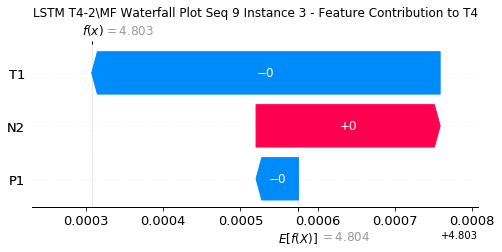

None

Contribution: [-1.41113136e-05 -1.14775261e-04  4.55423241e-05]


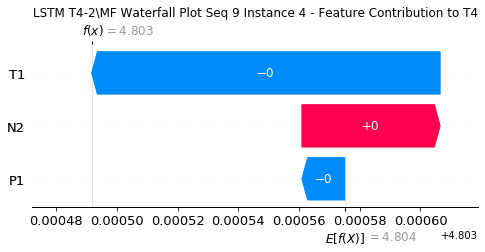

None

Contribution: [-2.68534646e-05 -1.16661650e-04  3.58478416e-05]


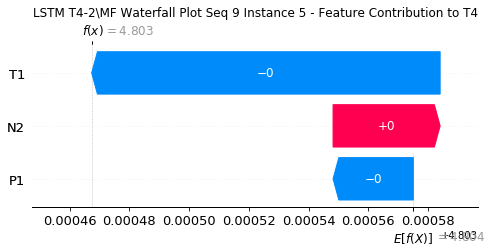

None

Contribution: [-1.00264095e-05 -9.06829156e-05  3.57372826e-05]


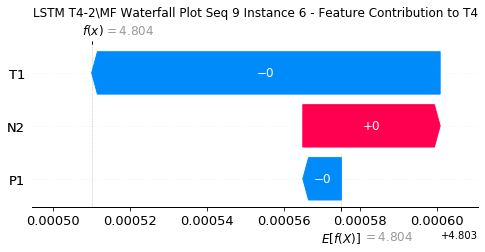

None

Contribution: [-8.67091004e-06 -6.65688909e-05  3.45706286e-05]


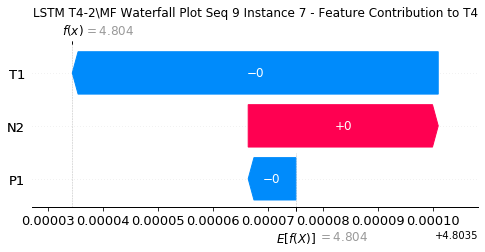

None

Contribution: [-6.03567371e-06 -5.64157247e-05  3.53437966e-05]


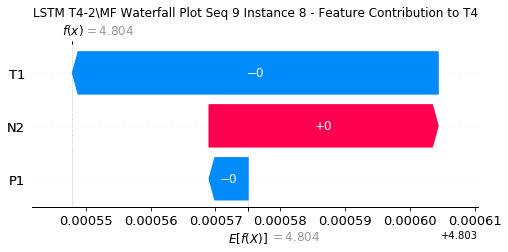

None

Contribution: [-3.97480255e-06 -7.16458793e-05  3.55256442e-05]


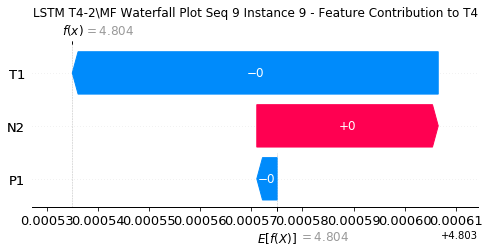

None

Contribution: [-3.61012977e-06 -8.09802052e-05  3.51298166e-05]


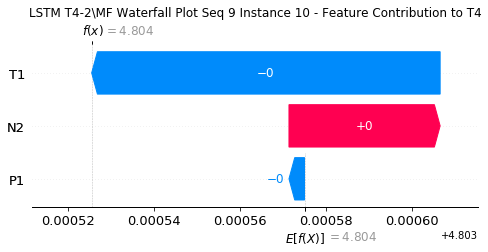

None

Contribution: [-1.83607452e-06 -8.12867448e-05  3.37786680e-05]


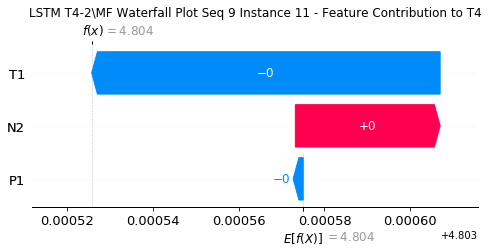

None

Contribution: [-5.02637368e-06 -8.20684813e-05  3.17761525e-05]


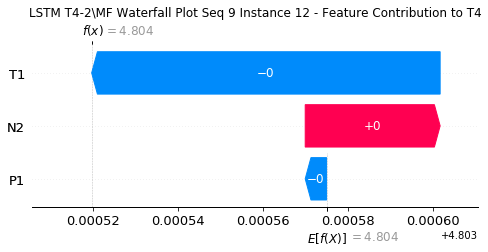

None

Contribution: [-1.28239781e-06 -8.17080325e-05  3.29296948e-05]


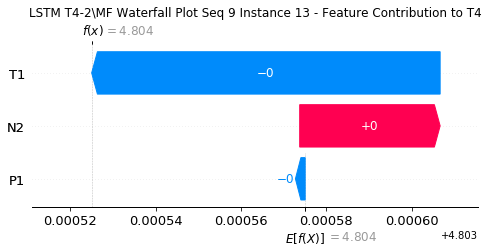

None

Contribution: [-2.96292491e-06 -8.68902190e-05  3.37459135e-05]


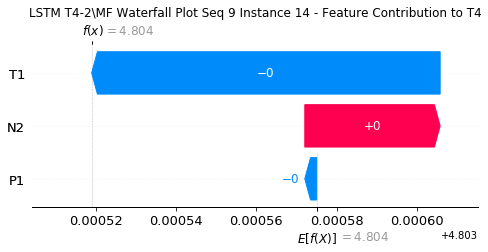

None

Contribution: [ 6.89687032e-09 -7.87157511e-05  3.24746582e-05]


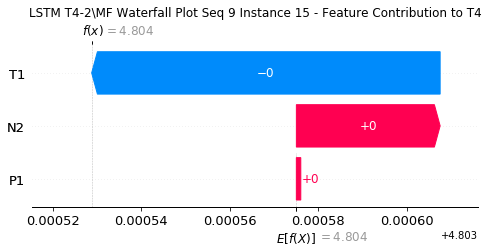

None

Contribution: [ 1.54309113e-06 -7.58241317e-05  3.24700308e-05]


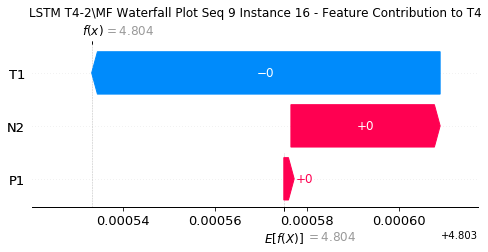

None

Contribution: [-9.69161592e-06 -7.14574682e-05  3.23119174e-05]


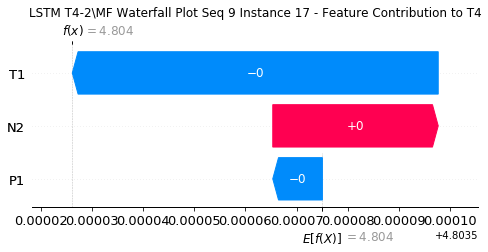

None

Contribution: [-3.09509176e-06 -7.76898860e-05  3.15010167e-05]


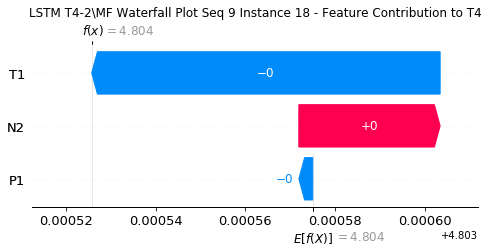

None

Contribution: [-1.83785887e-06 -7.88503708e-05  3.17425894e-05]


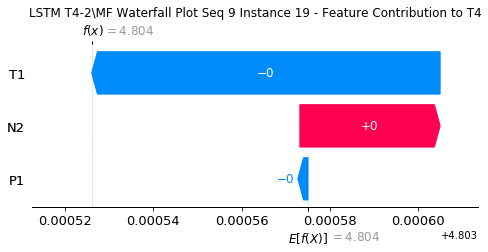

None

Contribution: [-3.59657211e-06 -8.15359747e-05  3.13877409e-05]


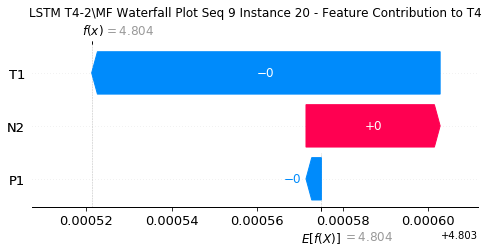

None

Contribution: [-2.30798660e-06 -8.52341912e-05  3.44126961e-05]


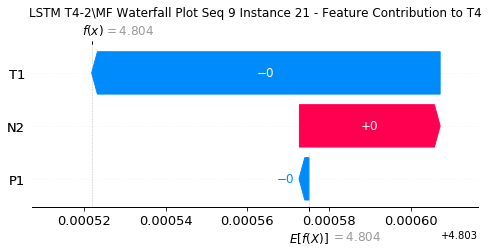

None

Contribution: [-4.89075952e-06 -1.30356168e-04  4.12981576e-05]


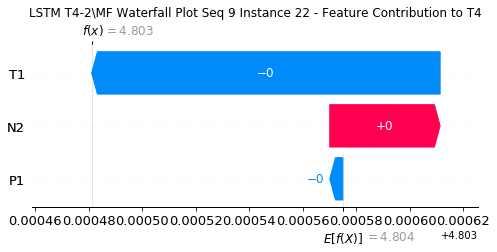

None

Contribution: [-4.15096008e-05 -2.84714971e-04  9.92832856e-05]


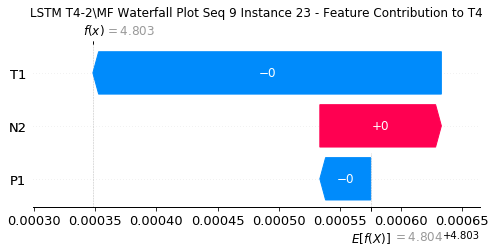

None

Contribution: [-0.00013084 -0.00245555  0.00121006]


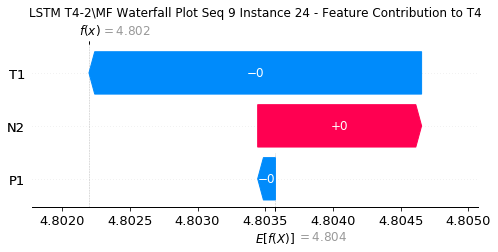

None

Contribution: [-0.00064492 -0.00569417  0.00230852]


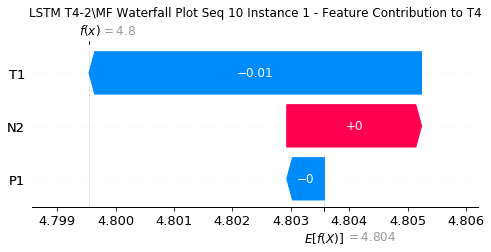

None

Contribution: [-0.00021099 -0.00184135  0.00124125]


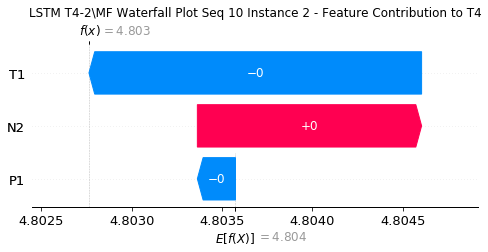

None

Contribution: [ 1.90286209e-05 -2.90062894e-04  2.19807511e-04]


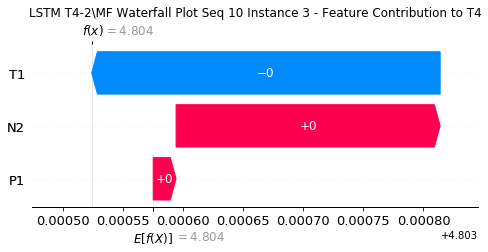

None

Contribution: [ 4.78130485e-07 -8.17104463e-05  4.13568382e-05]


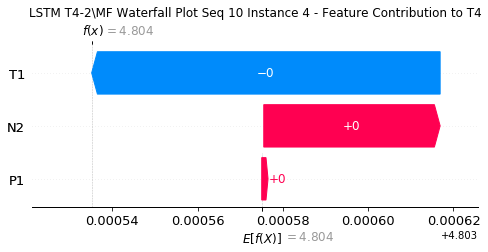

None

Contribution: [-1.97707101e-06 -6.66539887e-05  3.52628083e-05]


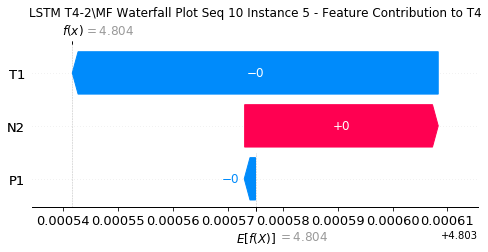

None

Contribution: [-4.86248391e-07 -7.03997431e-05  3.26422935e-05]


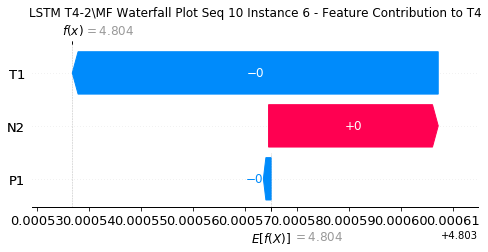

None

Contribution: [-9.99566446e-06 -7.42247681e-05  3.09658889e-05]


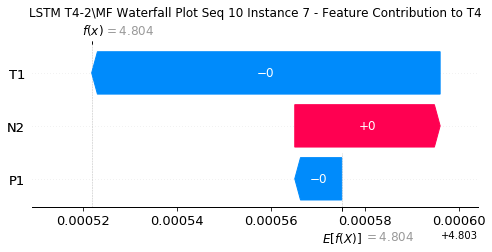

None

Contribution: [ 3.06551641e-06 -6.97252395e-05  3.47078037e-05]


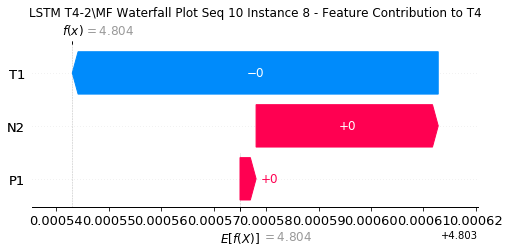

None

Contribution: [-4.80916333e-06 -7.16047607e-05  3.35532646e-05]


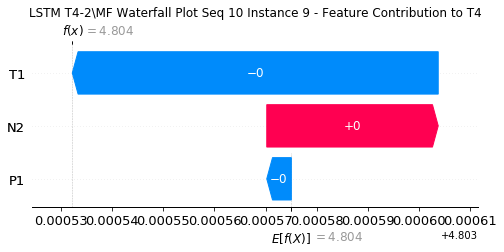

None

Contribution: [-4.09971975e-07 -7.45214478e-05  3.39700126e-05]


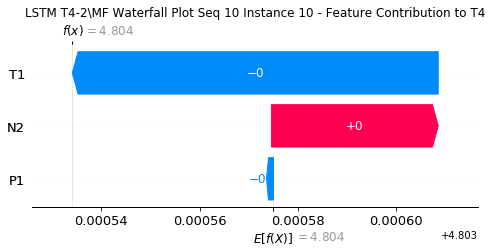

None

Contribution: [ 1.07015185e-06 -7.80395020e-05  3.23276847e-05]


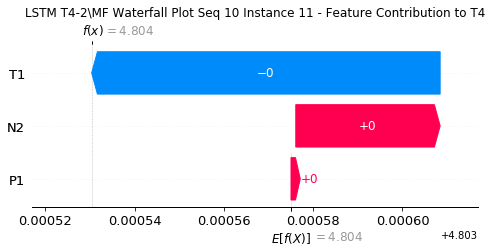

None

Contribution: [-1.37034648e-06 -9.02961942e-05  3.08109958e-05]


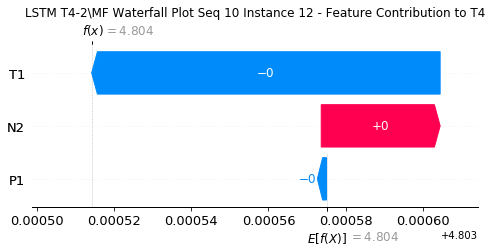

None

Contribution: [ 1.71817428e-06 -8.10443321e-05  3.24480256e-05]


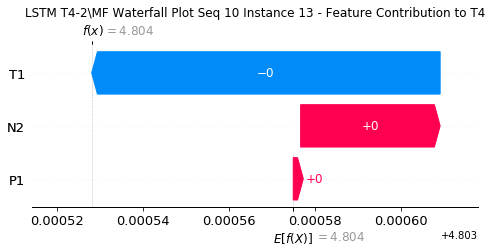

None

Contribution: [-3.23360428e-06 -7.66752750e-05  3.33177911e-05]


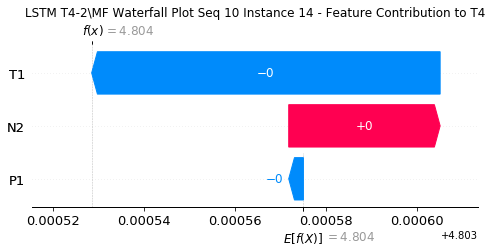

None

Contribution: [ 1.21218062e-06 -8.46164957e-05  3.20298478e-05]


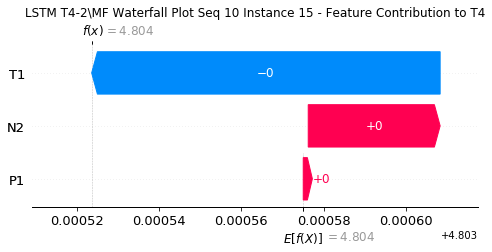

None

Contribution: [ 1.60303907e-06 -8.43683415e-05  3.17023744e-05]


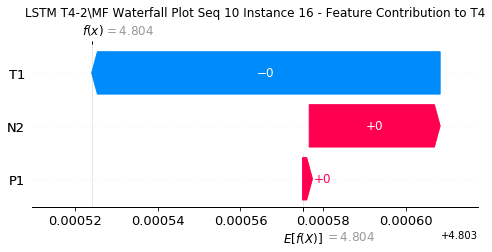

None

Contribution: [-3.35574434e-06 -8.78957142e-05  3.17732068e-05]


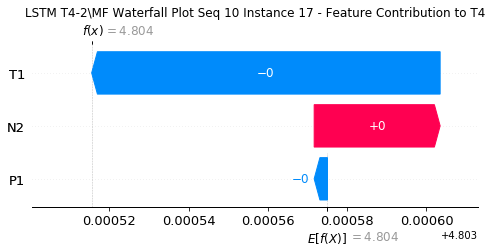

None

Contribution: [ 7.26069068e-07 -8.72817904e-05  3.09534600e-05]


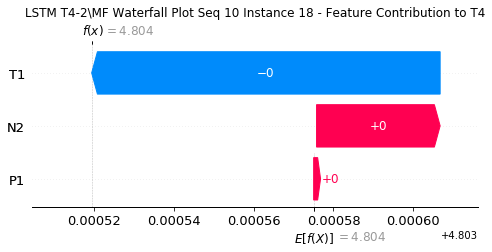

None

Contribution: [ 1.10778042e-06 -9.00778280e-05  3.13473805e-05]


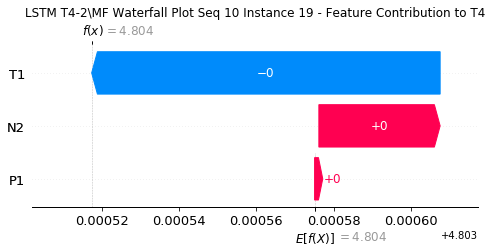

None

Contribution: [ 9.73542433e-07 -9.34263755e-05  3.19404700e-05]


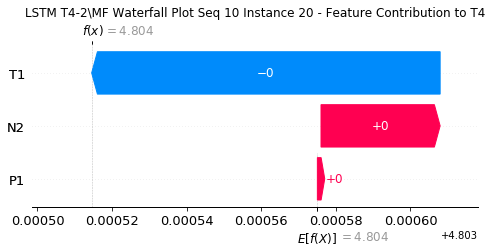

None

Contribution: [-7.46090223e-07 -1.02081005e-04  3.53465552e-05]


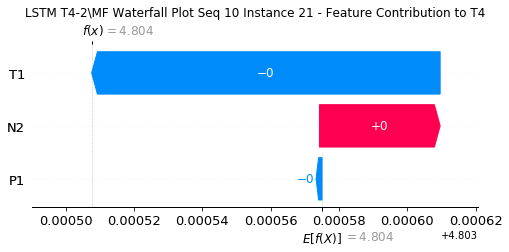

None

Contribution: [ 2.66991821e-06 -1.52174033e-04  4.37307756e-05]


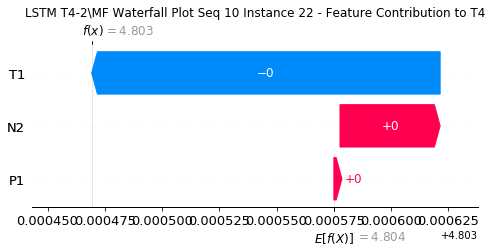

None

Contribution: [-2.68470405e-06 -3.65767932e-04  1.13169201e-04]


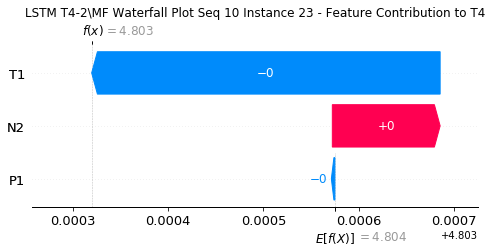

None

Contribution: [ 0.00012444 -0.00298951  0.00127965]


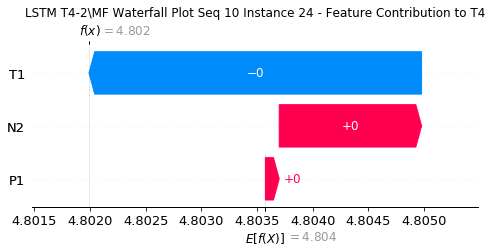

None

Contribution: [ 0.00041727 -0.00634063  0.00260635]


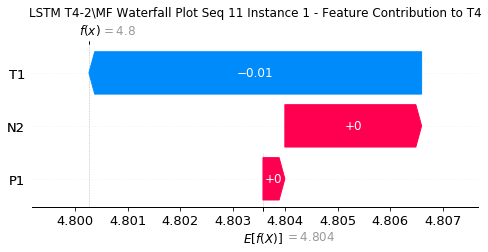

None

Contribution: [ 0.00034442 -0.0016072   0.00132093]


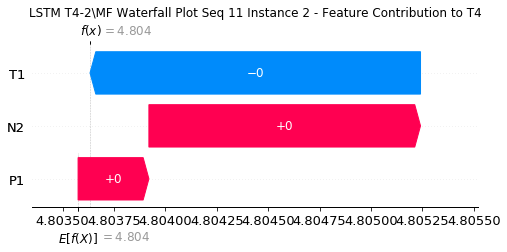

None

Contribution: [ 9.82600995e-05 -3.36156170e-04  2.30914827e-04]


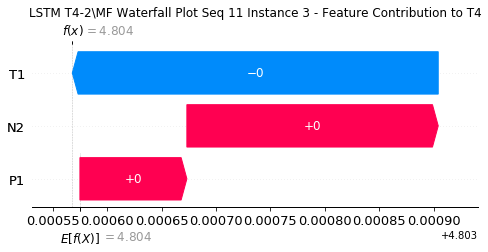

None

Contribution: [ 1.82490824e-05 -1.04659032e-04  4.38564358e-05]


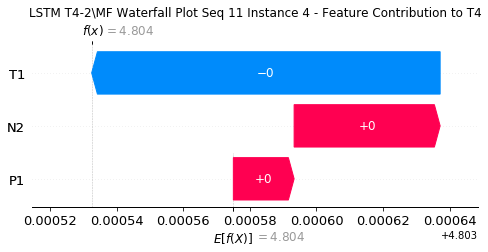

None

Contribution: [ 1.93701032e-05 -6.23990574e-05  3.75561854e-05]


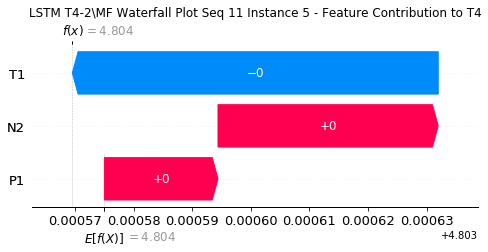

None

Contribution: [ 1.42786424e-05 -8.32853463e-05  3.48098751e-05]


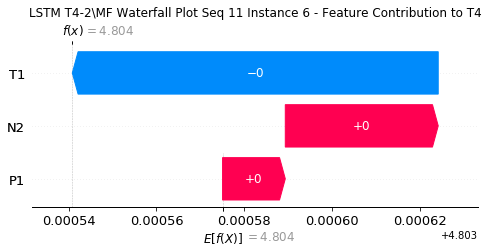

None

Contribution: [ 1.06562569e-05 -6.21747723e-05  3.68927207e-05]


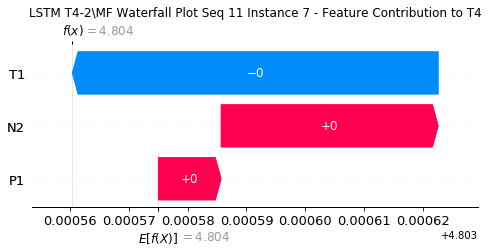

None

Contribution: [ 1.11839833e-05 -6.52881287e-05  3.66787609e-05]


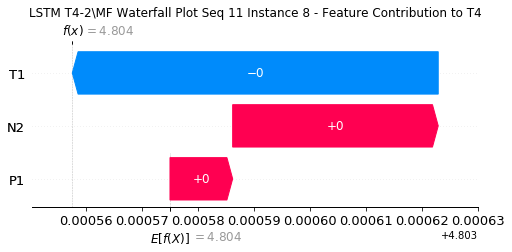

None

Contribution: [ 1.01292273e-05 -5.88366314e-05  3.65262254e-05]


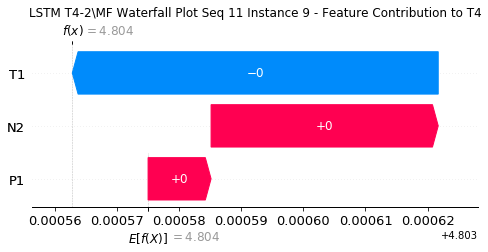

None

Contribution: [ 8.01181689e-06 -1.22756605e-04  3.47902091e-05]


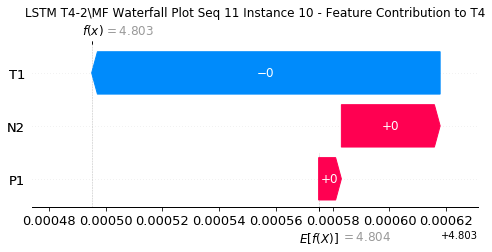

None

Contribution: [ 1.01917443e-05 -1.24639661e-04  3.35297415e-05]


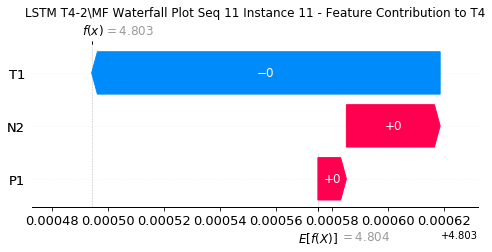

None

Contribution: [ 3.86885663e-06 -1.62152202e-04  3.32305482e-05]


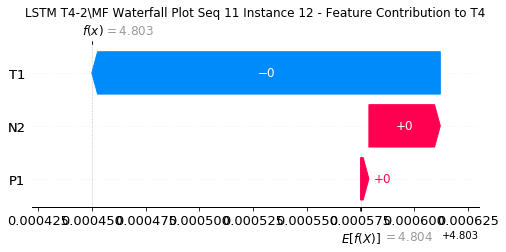

None

Contribution: [ 8.85104441e-06 -1.28042472e-04  3.30125362e-05]


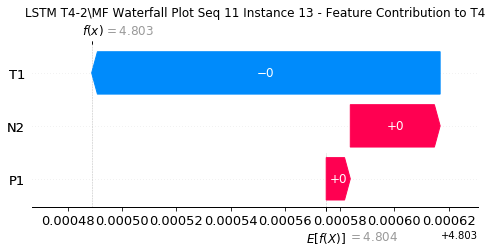

None

Contribution: [ 3.40032323e-06 -1.58966131e-04  3.68543726e-05]


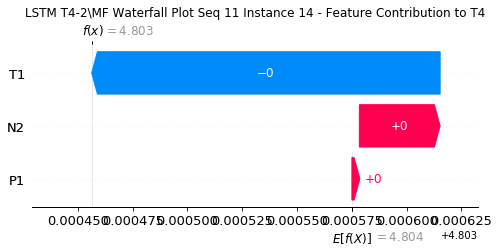

None

Contribution: [ 7.51208293e-06 -1.31025026e-04  3.23999323e-05]


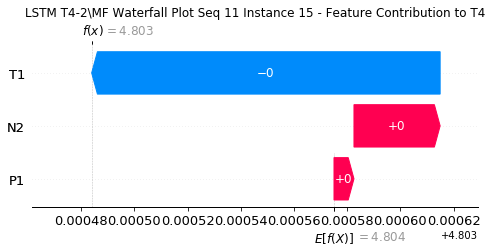

None

Contribution: [ 8.19799356e-06 -1.22837561e-04  3.16385931e-05]


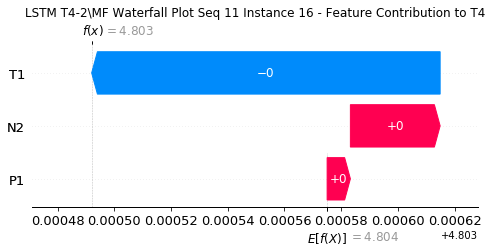

None

Contribution: [ 8.06468062e-06 -1.05382524e-04  3.38596042e-05]


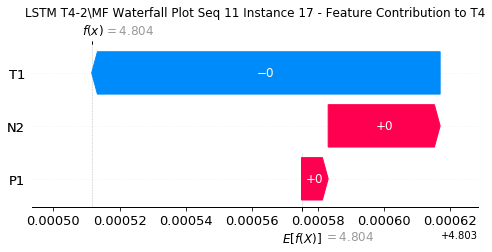

None

Contribution: [ 9.24726668e-06 -9.91527140e-05  3.09492348e-05]


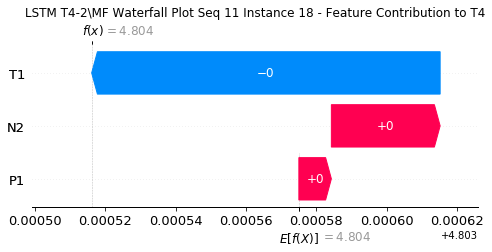

None

Contribution: [ 9.55243137e-06 -9.89916616e-05  3.09234804e-05]


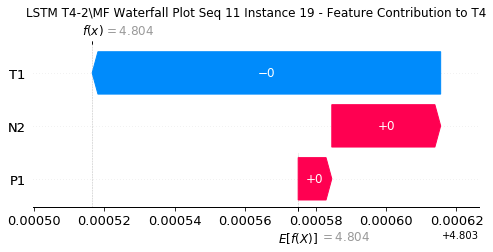

None

Contribution: [ 8.68019734e-06 -9.81928302e-05  3.10448053e-05]


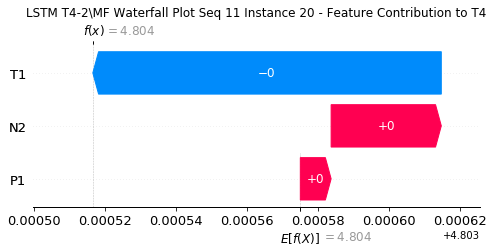

None

Contribution: [ 5.27124382e-06 -1.18178256e-04  3.36168494e-05]


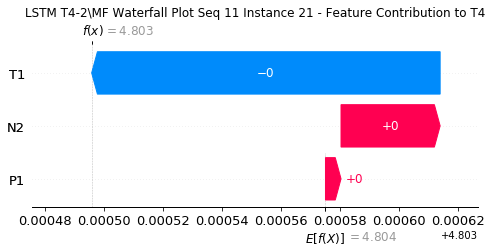

None

Contribution: [ 1.14112444e-05 -1.57555772e-04  4.08804104e-05]


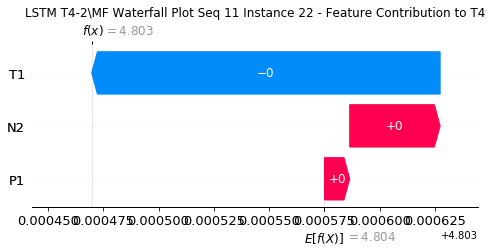

None

Contribution: [ 5.87810603e-05 -2.54324273e-04  1.25047588e-04]


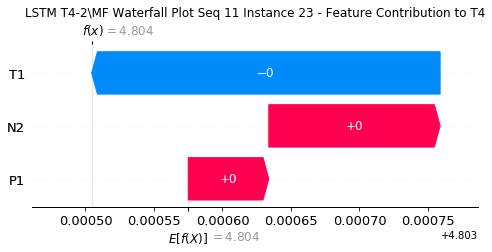

None

Contribution: [ 0.00056685 -0.00200917  0.00135813]


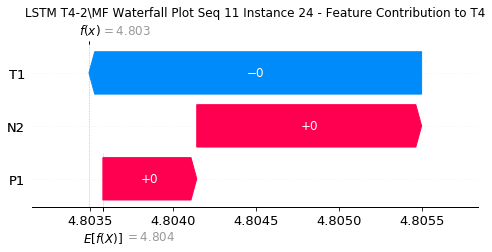

None

Contribution: [ 0.00102376 -0.0050134   0.00275231]


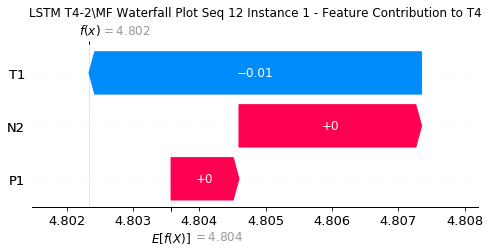

None

Contribution: [ 0.00037929 -0.00113826  0.00133379]


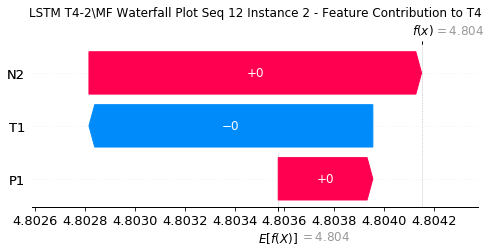

None

Contribution: [ 0.00011105 -0.00018408  0.00024   ]


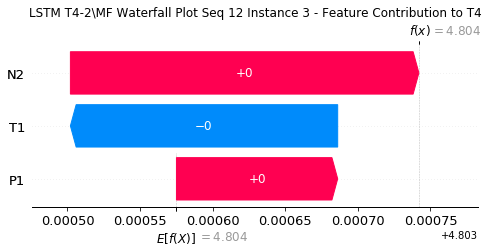

None

Contribution: [ 2.27060887e-05 -5.29181245e-05  4.55343865e-05]


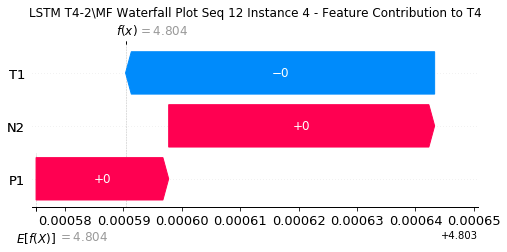

None

Contribution: [ 9.97126135e-06 -4.68676234e-05  3.81046231e-05]


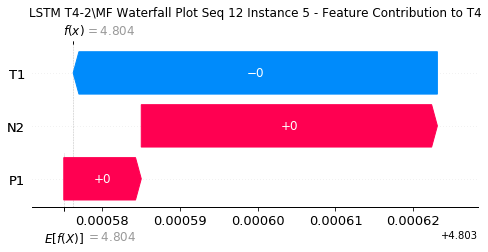

None

Contribution: [ 1.80133513e-05 -4.42576327e-05  3.59678252e-05]


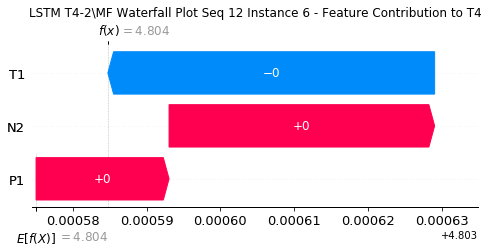

None

Contribution: [ 1.99245643e-05 -4.17424809e-05  3.86958026e-05]


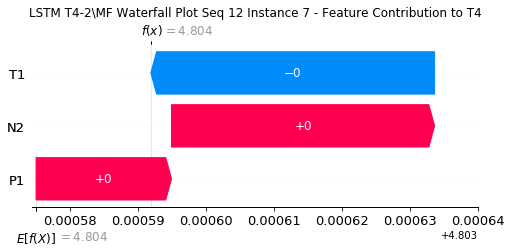

None

Contribution: [ 1.57219990e-05 -4.85394902e-05  3.54548917e-05]


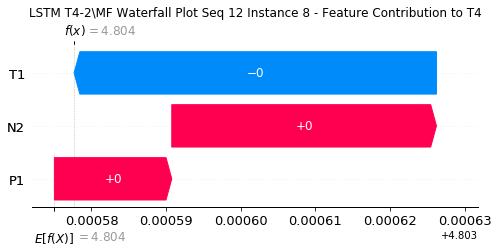

None

Contribution: [ 1.47420286e-05 -4.44279648e-05  3.65551079e-05]


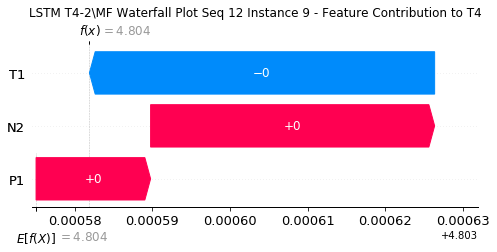

None

Contribution: [ 1.56136124e-05 -4.17593876e-05  3.43348744e-05]


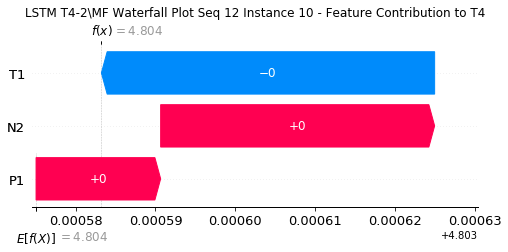

None

Contribution: [ 1.88587718e-05 -4.34480053e-05  3.33787690e-05]


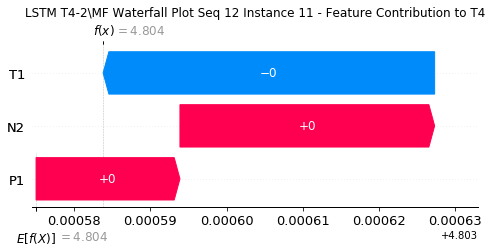

None

Contribution: [ 8.94299894e-06 -4.88177937e-05  2.82117979e-05]


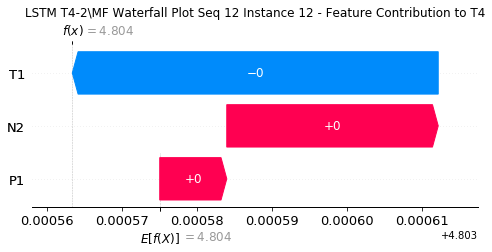

None

Contribution: [ 1.75797798e-05 -4.41764583e-05  3.22767792e-05]


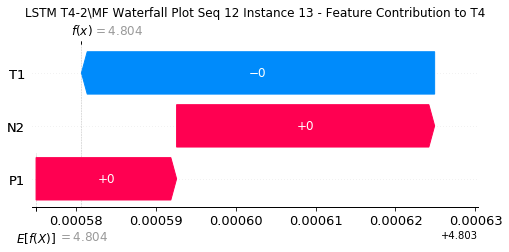

None

Contribution: [ 1.90118801e-05 -4.06507395e-05  3.40920176e-05]


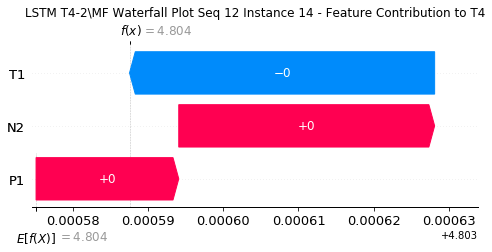

None

Contribution: [ 1.75697148e-05 -4.54106516e-05  3.16052081e-05]


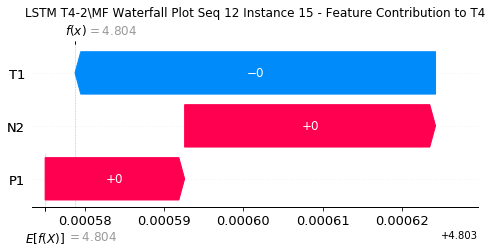

None

Contribution: [ 1.70881804e-05 -4.44405798e-05  3.06495193e-05]


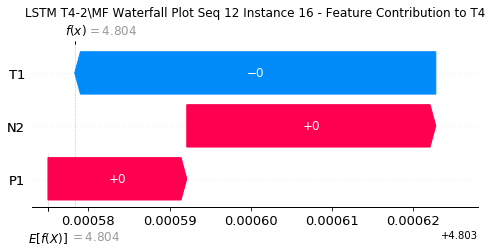

None

Contribution: [ 9.39886665e-06 -5.13944152e-05  2.93024045e-05]


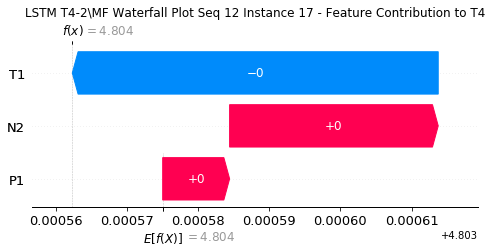

None

Contribution: [ 1.70017190e-05 -4.46079281e-05  3.07644292e-05]


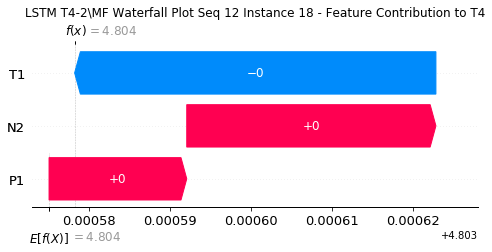

None

Contribution: [ 1.65227067e-05 -4.58107257e-05  3.05113532e-05]


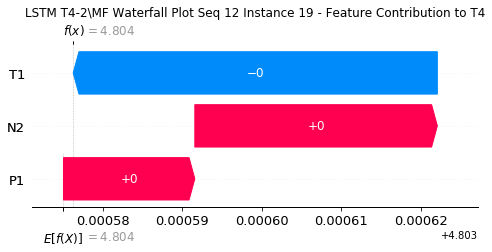

None

Contribution: [ 1.50854557e-05 -4.64384940e-05  3.03906351e-05]


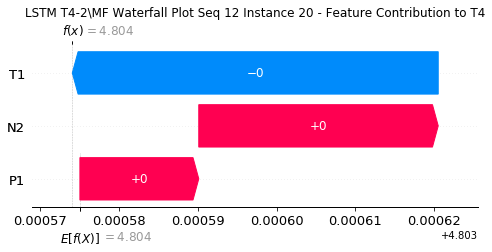

None

Contribution: [ 1.20000035e-05 -5.10200462e-05  3.18136746e-05]


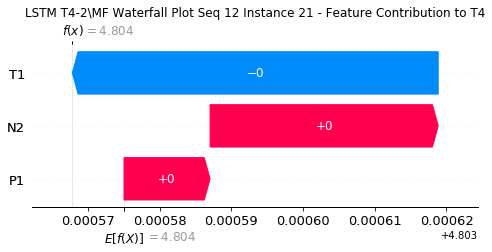

None

Contribution: [ 1.89901648e-05 -8.00282694e-05  3.78817368e-05]


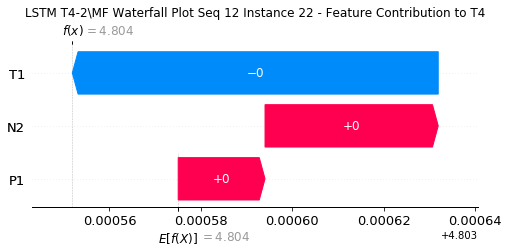

None

Contribution: [ 4.99001090e-05 -1.80098955e-04  1.07390391e-04]


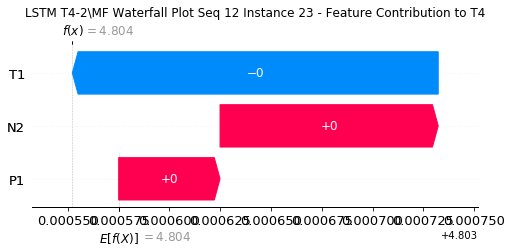

None

Contribution: [ 0.00051048 -0.00125205  0.0012842 ]


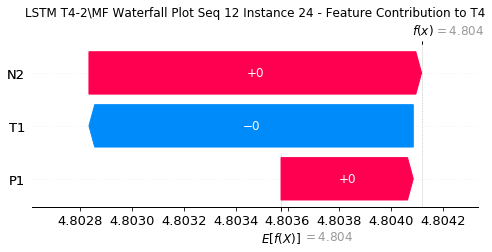

None

Contribution: [ 0.0011124  -0.00279396  0.00260359]


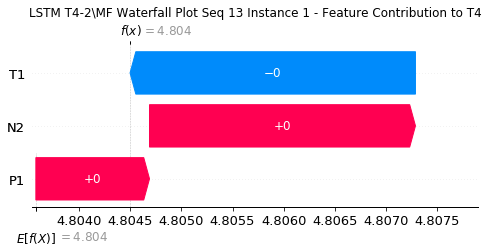

None

Contribution: [ 0.00049221 -0.00085442  0.00130099]


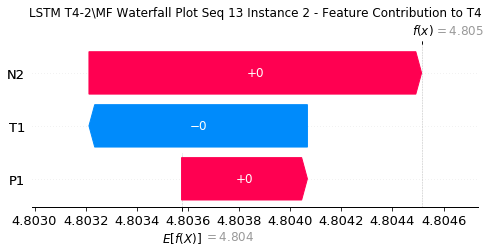

None

Contribution: [ 9.76444224e-05 -1.73522921e-04  2.33079902e-04]


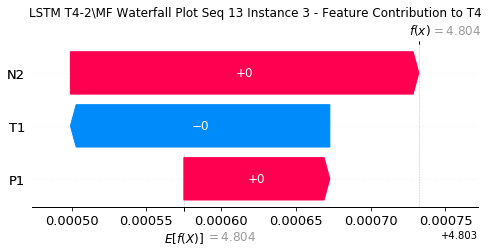

None

Contribution: [ 2.07457822e-05 -5.47682962e-05  4.47054361e-05]


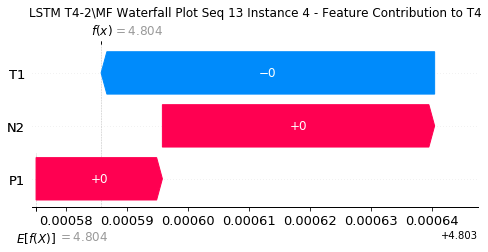

None

Contribution: [ 2.34723223e-05 -4.70023728e-05  3.83614888e-05]


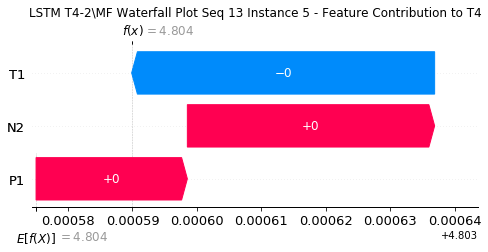

None

Contribution: [ 1.52600671e-05 -4.84371235e-05  3.48525833e-05]


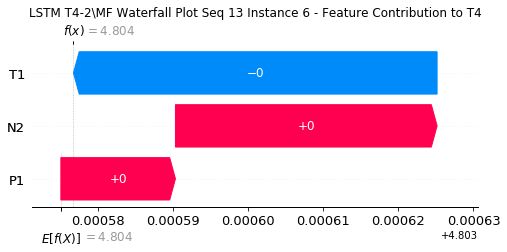

None

Contribution: [ 3.07955657e-06 -5.64511793e-05  3.13051271e-05]


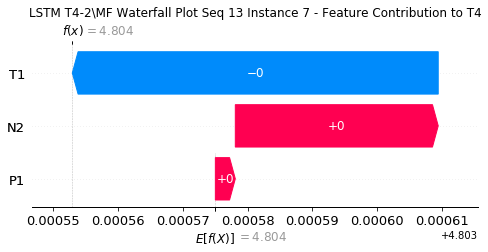

None

Contribution: [ 6.64359860e-06 -6.32775036e-05  3.17687289e-05]


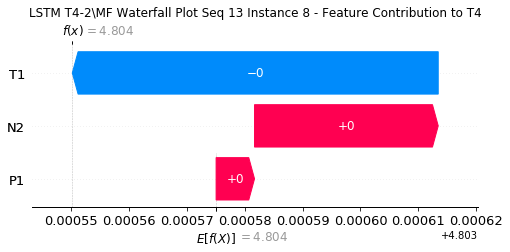

None

Contribution: [ 8.45871617e-06 -5.64990823e-05  3.22093976e-05]


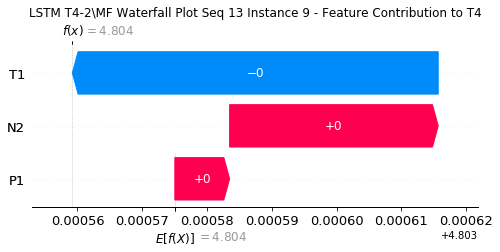

None

Contribution: [ 1.60457988e-05 -5.57684127e-05  3.51874855e-05]


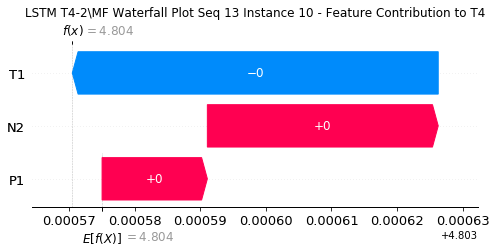

None

Contribution: [ 1.68535098e-05 -5.79820789e-05  3.38299363e-05]


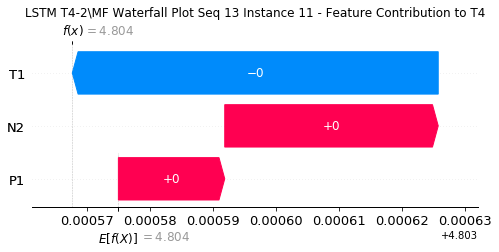

None

Contribution: [ 1.67540129e-05 -6.10956756e-05  3.32394404e-05]


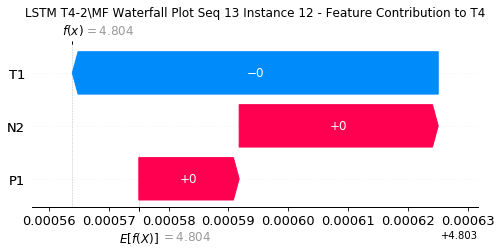

None

Contribution: [ 1.67323778e-05 -5.93974520e-05  3.34648546e-05]


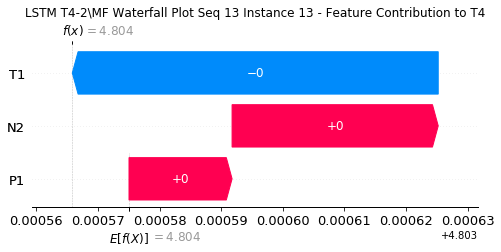

None

Contribution: [ 8.19167158e-06 -6.46718256e-05  3.28759621e-05]


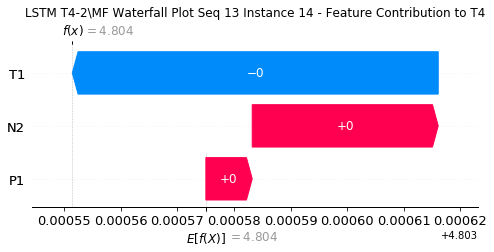

None

Contribution: [ 1.46209233e-05 -6.35358544e-05  3.27968360e-05]


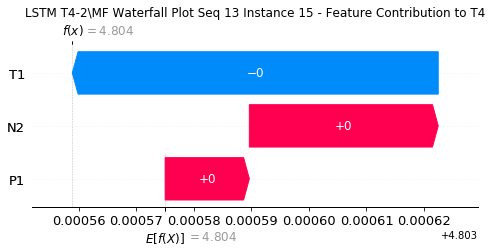

None

Contribution: [ 1.41299839e-05 -6.20027336e-05  3.23694679e-05]


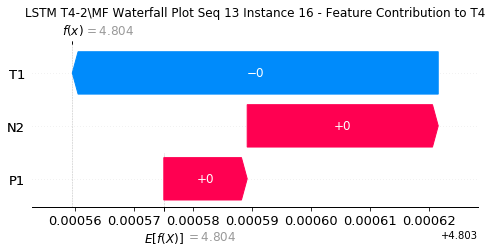

None

Contribution: [ 9.65788979e-06 -5.01050221e-05  3.34557922e-05]


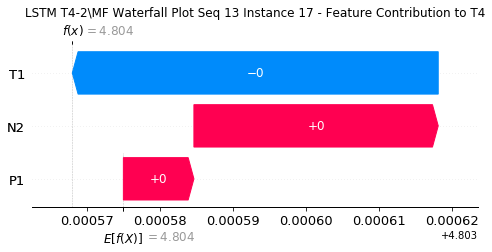

None

Contribution: [ 1.02238123e-05 -5.73988544e-05  3.18832779e-05]


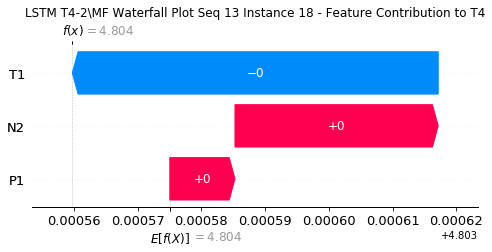

None

Contribution: [ 1.05755979e-05 -5.90480470e-05  3.21034283e-05]


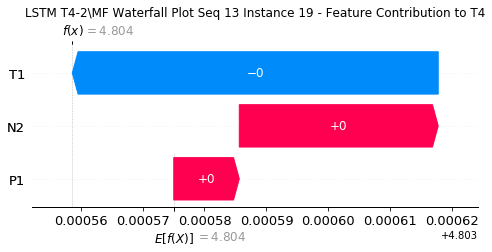

None

Contribution: [ 1.01008383e-05 -5.79861496e-05  3.25017425e-05]


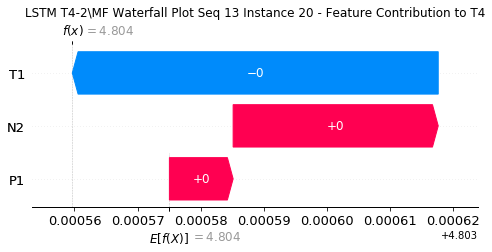

None

Contribution: [ 9.76020689e-06 -6.69860310e-05  3.53135359e-05]


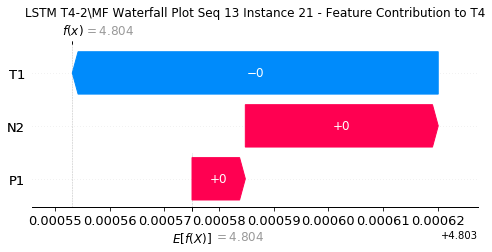

None

Contribution: [ 1.51006752e-05 -9.23498861e-05  4.35024068e-05]


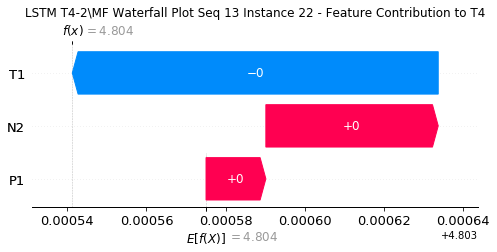

None

Contribution: [ 1.33976678e-05 -1.73543482e-04  1.12862514e-04]


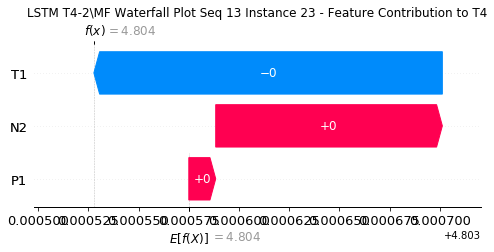

None

Contribution: [ 0.00025949 -0.00174525  0.00129294]


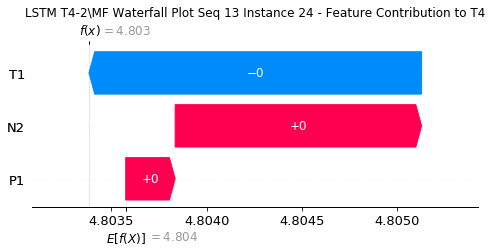

None

Contribution: [ 0.000582   -0.00346915  0.00261304]


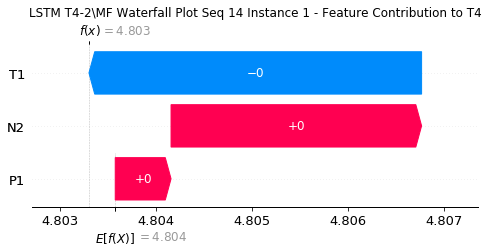

None

Contribution: [ 0.0002261  -0.00101815  0.00128564]


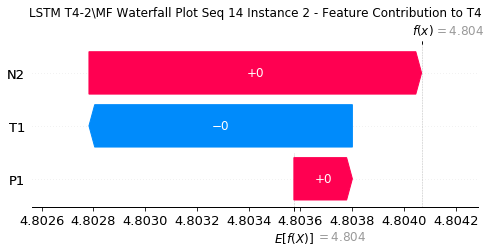

None

Contribution: [ 8.72822489e-05 -1.90648308e-04  2.41287586e-04]


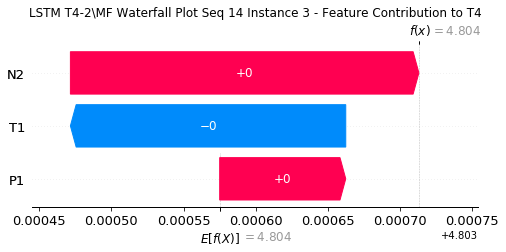

None

Contribution: [ 1.61891912e-05 -5.28402995e-05  4.63178512e-05]


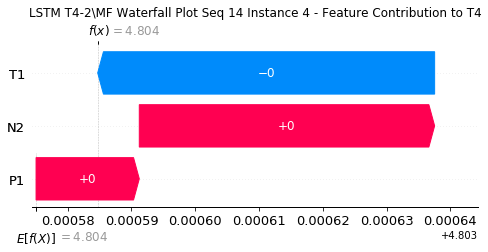

None

Contribution: [ 1.02851229e-05 -6.86477396e-05  3.69240284e-05]


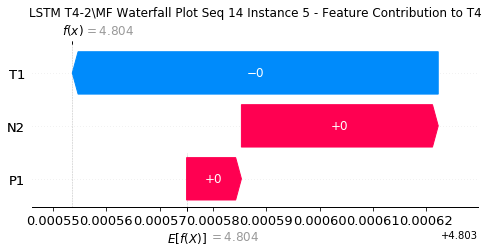

None

Contribution: [ 1.16600721e-05 -4.34709314e-05  3.63621473e-05]


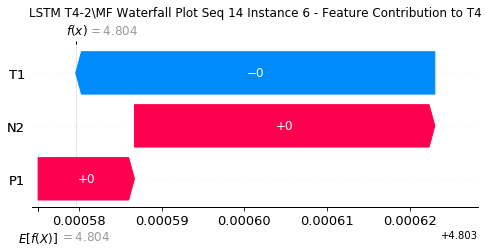

None

Contribution: [ 4.76408037e-06 -4.25099993e-05  3.52488609e-05]


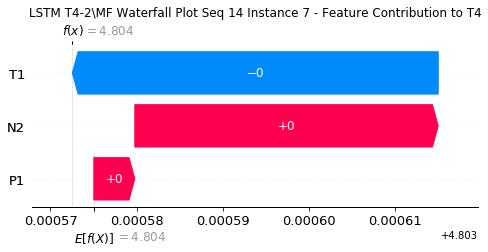

None

Contribution: [ 4.85792755e-06 -3.36619782e-05  3.51172485e-05]


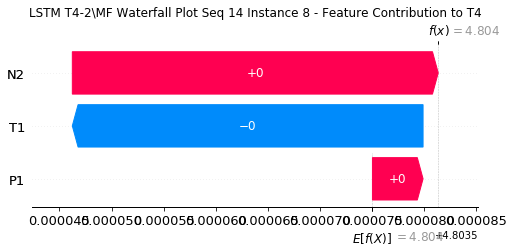

None

Contribution: [ 6.62225179e-06 -3.20324043e-05  3.56395130e-05]


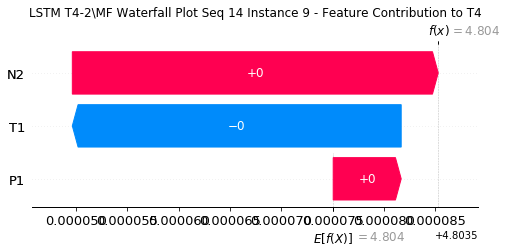

None

Contribution: [ 7.34207102e-06 -4.00310528e-05  3.47856331e-05]


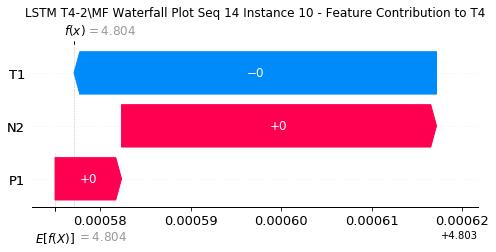

None

Contribution: [ 9.14051365e-06 -4.31579348e-05  3.36366953e-05]


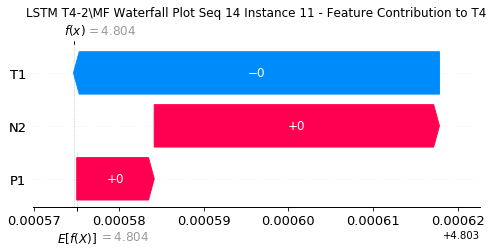

None

Contribution: [ 5.66462526e-06 -4.35713582e-05  3.47461312e-05]


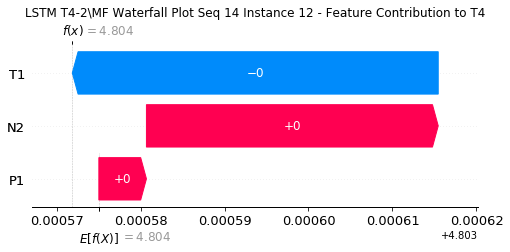

None

Contribution: [ 8.28775493e-06 -4.13376250e-05  3.32680356e-05]


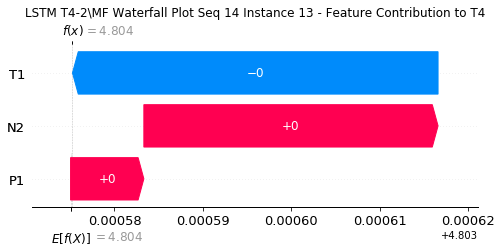

None

Contribution: [ 3.68009452e-07 -4.83296863e-05  3.41269901e-05]


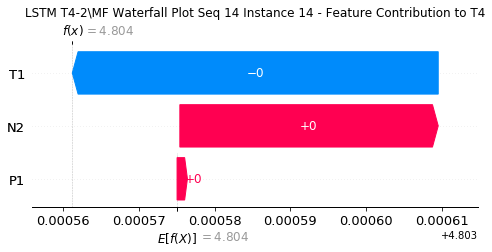

None

Contribution: [ 6.53456964e-06 -4.34037495e-05  3.25151044e-05]


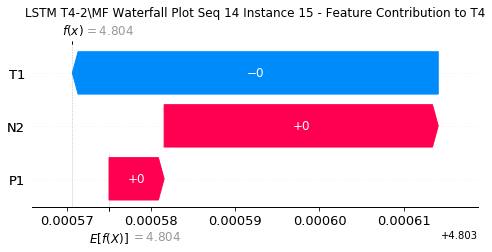

None

Contribution: [ 6.72298200e-06 -3.98199078e-05  3.22919945e-05]


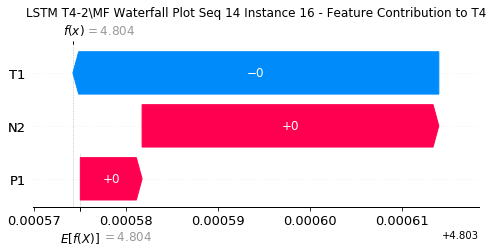

None

Contribution: [ 2.58066590e-06 -5.42421059e-05  3.33700906e-05]


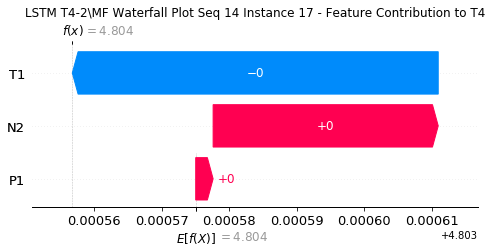

None

Contribution: [ 6.44487076e-06 -3.85176093e-05  3.29298615e-05]


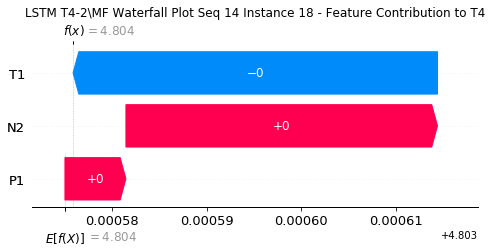

None

Contribution: [ 6.63286807e-06 -3.71366042e-05  3.31740886e-05]


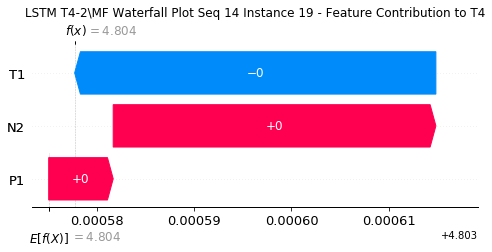

None

Contribution: [ 6.18160841e-06 -3.38008349e-05  3.38201255e-05]


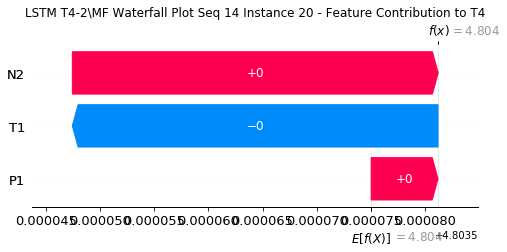

None

Contribution: [ 3.11567849e-06 -3.52835220e-05  3.60880385e-05]


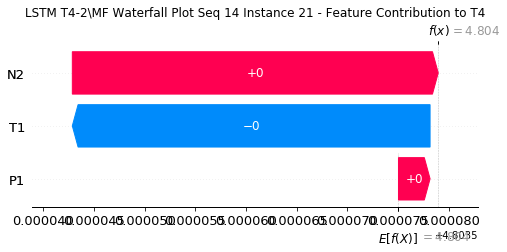

None

Contribution: [ 8.96344249e-06 -5.04435402e-05  4.64803448e-05]


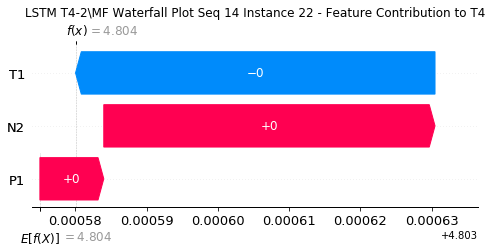

None

Contribution: [ 3.72266633e-05 -6.67857847e-05  1.25106626e-04]


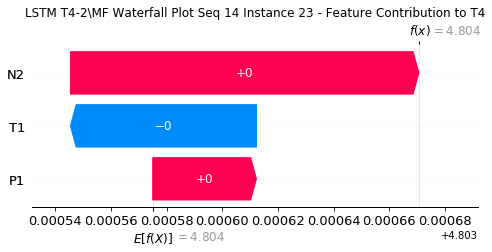

None

Contribution: [ 0.00033432 -0.00051778  0.00128505]


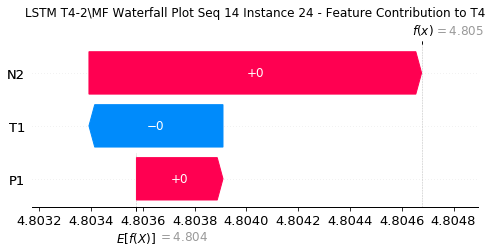

None

Contribution: [ 0.00075037 -0.00114461  0.00263957]


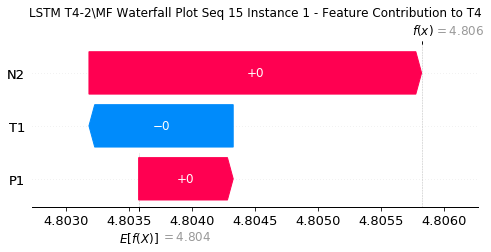

None

Contribution: [ 0.00035175 -0.0003649   0.0012915 ]


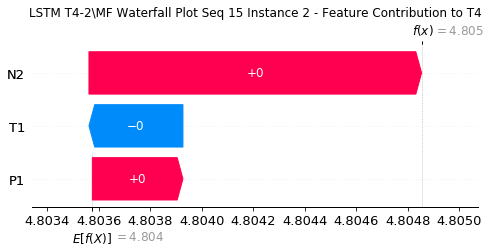

None

Contribution: [ 6.71640426e-05 -4.80889686e-05  2.29069389e-04]


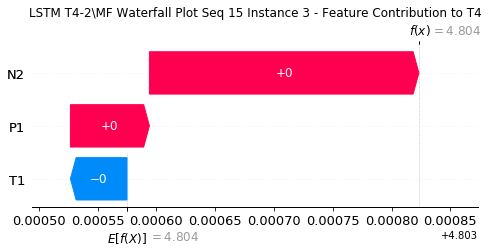

None

Contribution: [ 1.23636529e-05 -2.22894613e-05  4.37487396e-05]


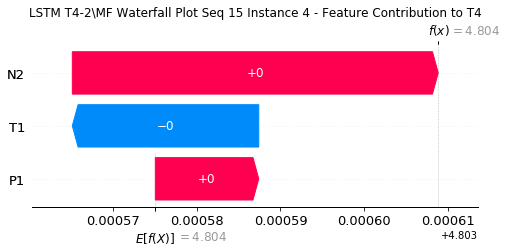

None

Contribution: [ 1.26979933e-05 -1.60183704e-05  3.69474512e-05]


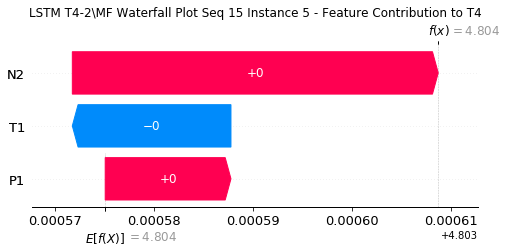

None

Contribution: [ 8.97566755e-06 -2.21686179e-05  3.42701617e-05]


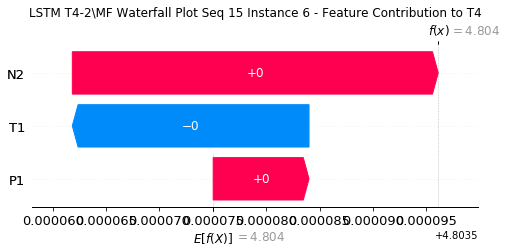

None

Contribution: [-1.68929149e-07 -3.18763274e-05  3.24444896e-05]


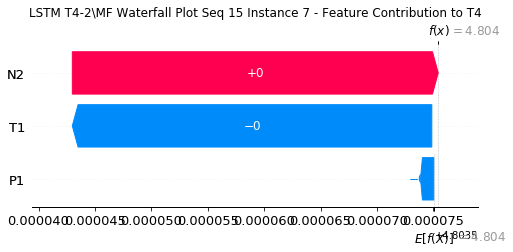

None

Contribution: [ 8.21310950e-06 -3.07758648e-05  3.39400943e-05]


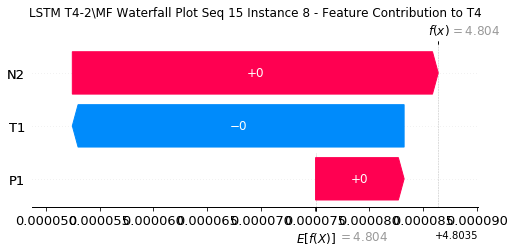

None

Contribution: [ 4.44209945e-06 -2.72065012e-05  3.28470660e-05]


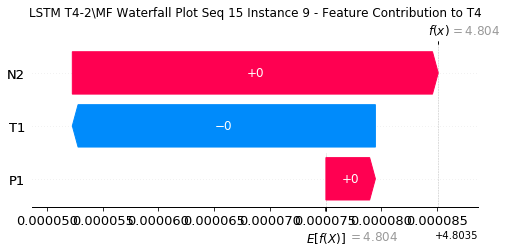

None

Contribution: [ 7.42252904e-06 -3.33988385e-05  3.43673842e-05]


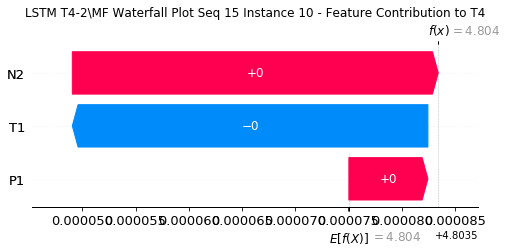

None

Contribution: [ 8.73172236e-06 -3.69063715e-05  3.31311435e-05]


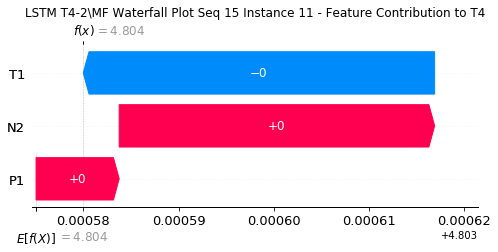

None

Contribution: [ 7.70819062e-06 -3.86616636e-05  3.39531672e-05]


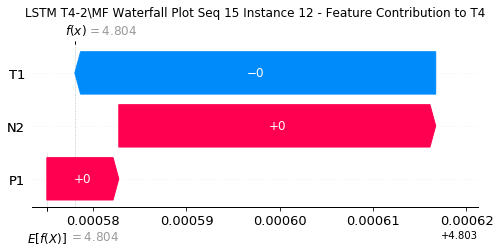

None

Contribution: [ 8.86251855e-06 -4.02838613e-05  3.28796238e-05]


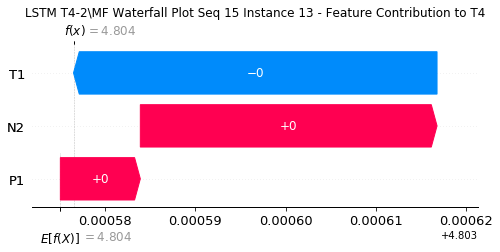

None

Contribution: [ 6.26523163e-06 -4.93911129e-05  3.52796441e-05]


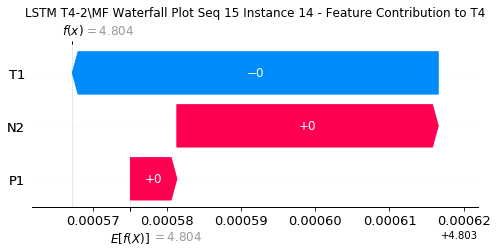

None

Contribution: [ 7.72165655e-06 -4.57945662e-05  3.24405369e-05]


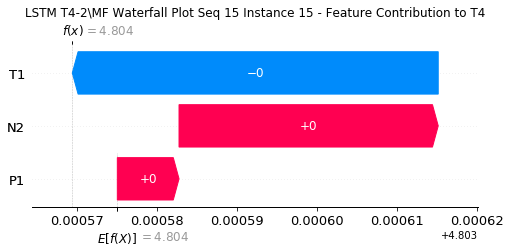

None

Contribution: [ 7.88519473e-06 -4.34686823e-05  3.19536743e-05]


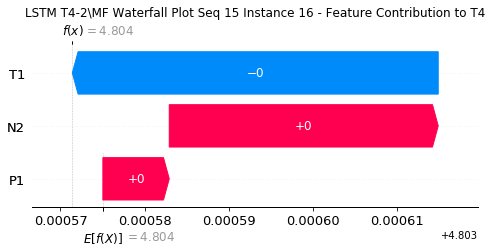

None

Contribution: [ 4.62455757e-06 -4.75406606e-05  3.25347140e-05]


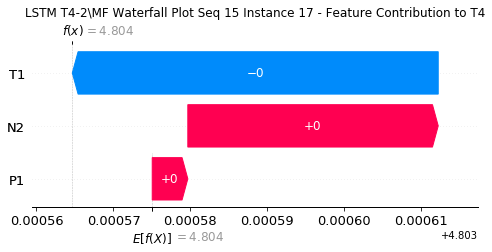

None

Contribution: [ 6.34318080e-06 -4.34642852e-05  3.16672626e-05]


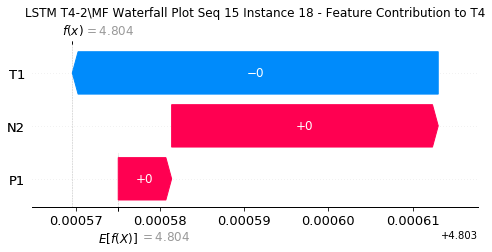

None

Contribution: [ 6.59395384e-06 -4.43431586e-05  3.17983723e-05]


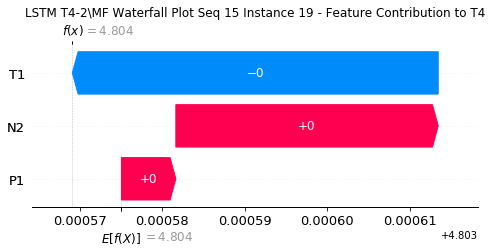

None

Contribution: [ 6.02580210e-06 -4.54982267e-05  3.21120004e-05]


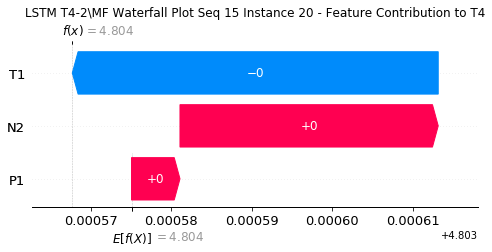

None

Contribution: [ 4.55408574e-06 -5.15451661e-05  3.47719550e-05]


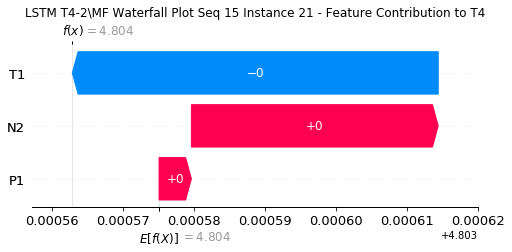

None

Contribution: [ 8.57860825e-06 -7.88701454e-05  4.27072761e-05]


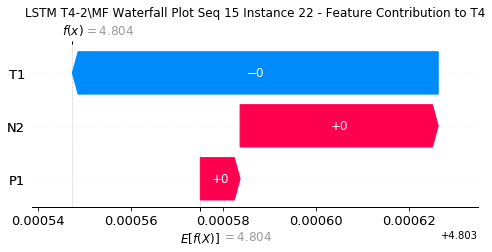

None

Contribution: [ 1.03161044e-05 -1.86957317e-04  1.16577282e-04]


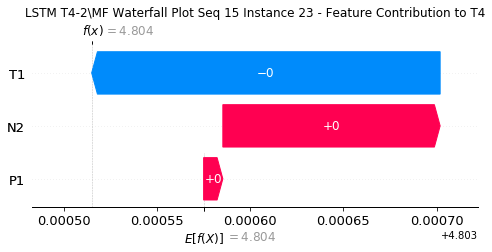

None

Contribution: [ 0.00031666 -0.00116605  0.00134133]


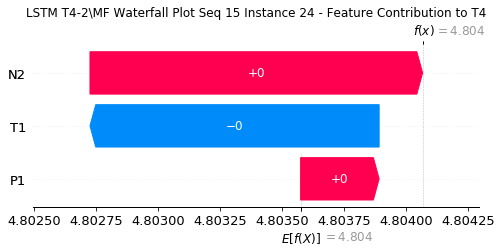

None

Contribution: [ 0.00073968 -0.00297199  0.00274162]


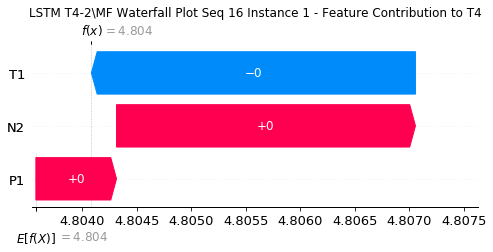

None

Contribution: [ 0.00043504 -0.00077216  0.00135454]


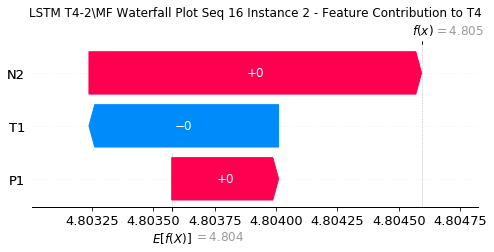

None

Contribution: [ 5.59212376e-05 -1.32535168e-04  2.34617619e-04]


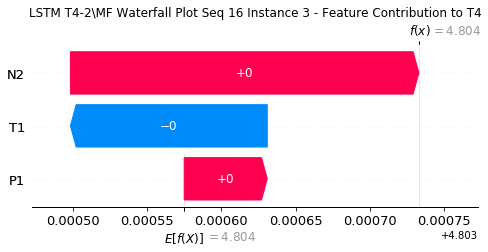

None

Contribution: [ 1.01537791e-05 -4.02126116e-05  4.51925128e-05]


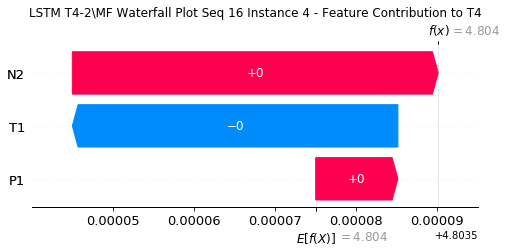

None

Contribution: [ 1.24742772e-05 -3.39854355e-05  3.83934533e-05]


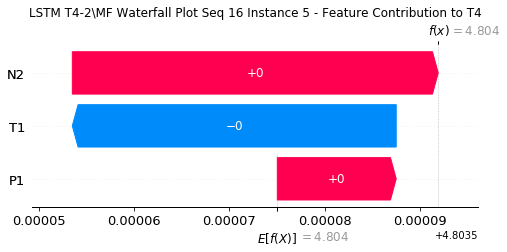

None

Contribution: [ 7.73376518e-06 -3.48485462e-05  3.55251571e-05]


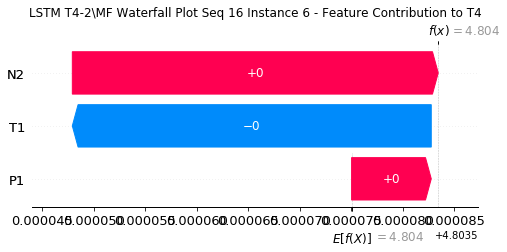

None

Contribution: [ 3.08752650e-06 -3.84771473e-05  3.51945050e-05]


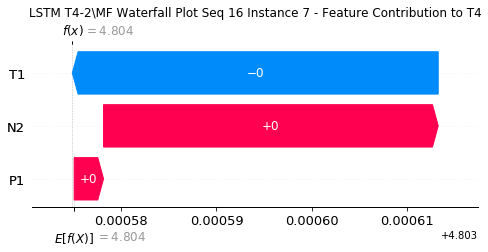

None

Contribution: [ 3.15377293e-06 -3.12719424e-05  3.38206506e-05]


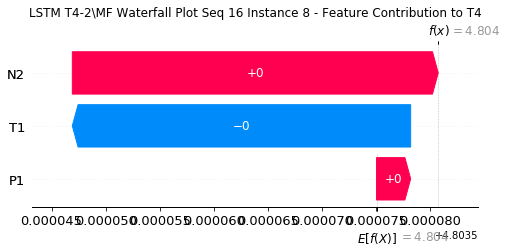

None

Contribution: [ 7.04923330e-06 -3.61418919e-05  3.57343826e-05]


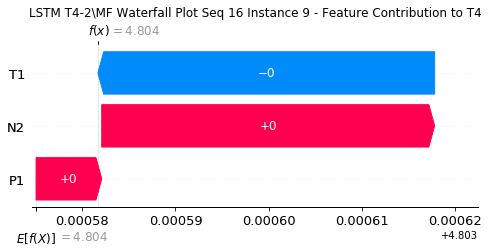

None

Contribution: [ 7.88302875e-06 -3.47262127e-05  3.54357775e-05]


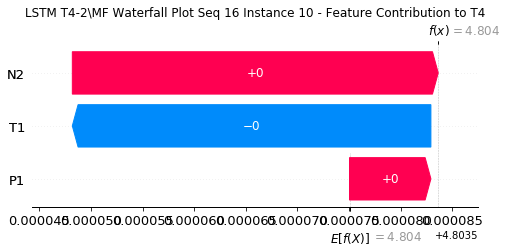

None

Contribution: [ 9.04861469e-06 -3.74358885e-05  3.41211165e-05]


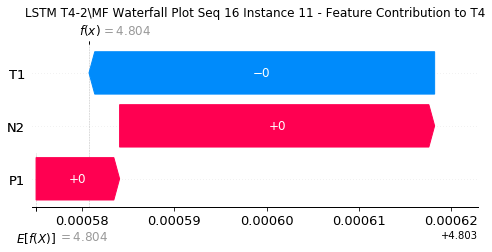

None

Contribution: [ 7.57297898e-06 -3.26470441e-05  3.31628767e-05]


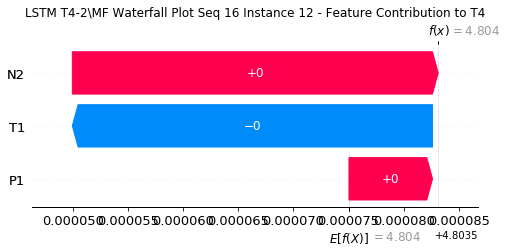

None

Contribution: [ 9.31474397e-06 -3.81796494e-05  3.39063713e-05]


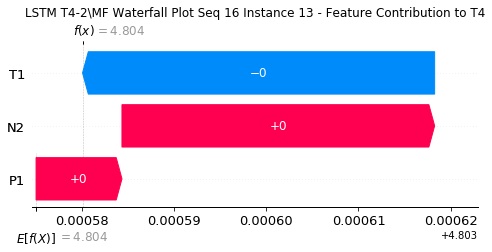

None

Contribution: [ 6.69269219e-06 -3.82445767e-05  3.42343858e-05]


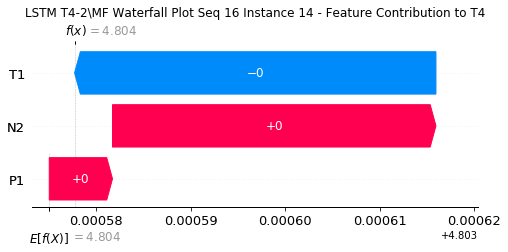

None

Contribution: [ 8.12405884e-06 -4.13408440e-05  3.35167258e-05]


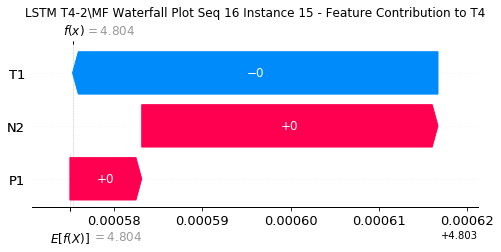

None

Contribution: [ 7.61499398e-06 -4.00306658e-05  3.28167150e-05]


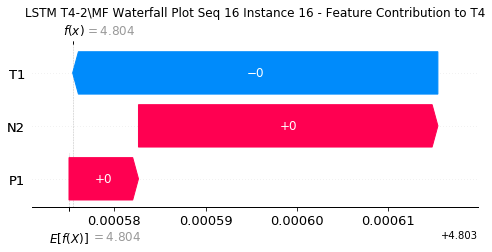

None

Contribution: [ 4.98528934e-06 -4.77744855e-05  3.32491028e-05]


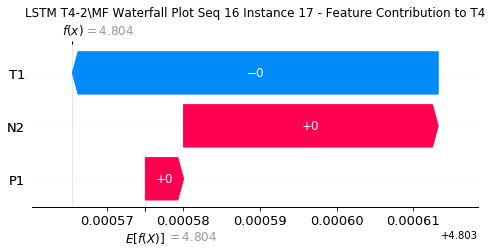

None

Contribution: [ 5.04495158e-06 -4.10710565e-05  3.25313530e-05]


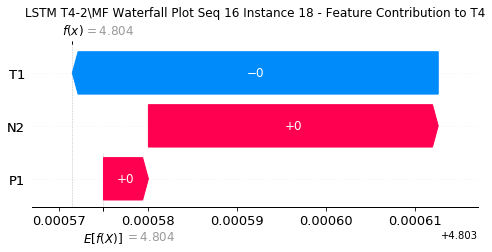

None

Contribution: [ 5.10255614e-06 -4.17672415e-05  3.24863058e-05]


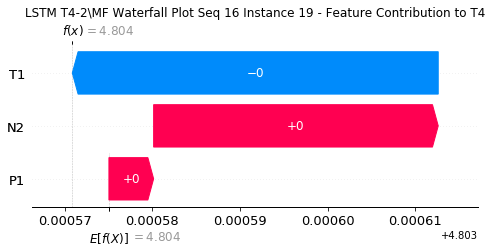

None

Contribution: [ 4.46217153e-06 -4.13838547e-05  3.27634171e-05]


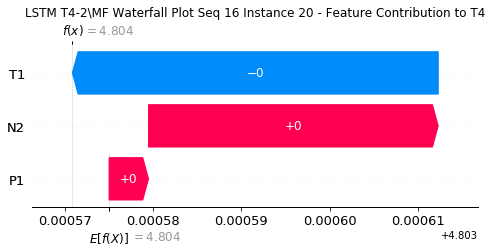

None

Contribution: [ 3.22873403e-06 -4.49023195e-05  3.54146686e-05]


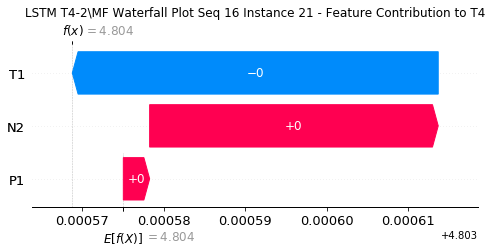

None

Contribution: [ 6.54972703e-06 -6.23117830e-05  4.41112488e-05]


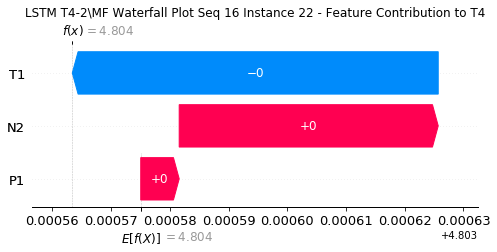

None

Contribution: [ 2.62554292e-05 -1.13025446e-04  1.17155140e-04]


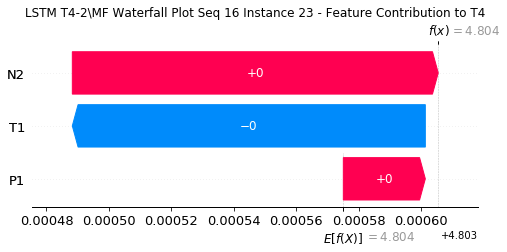

None

Contribution: [ 0.00033498 -0.0013776   0.0012936 ]


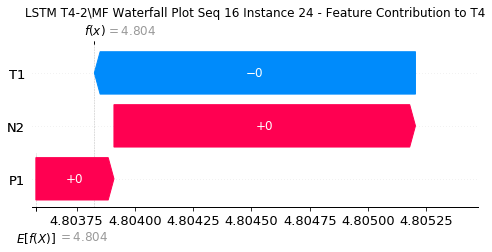

None

Contribution: [ 0.00083601 -0.00296459  0.00270684]


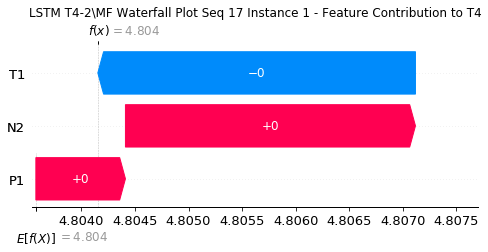

None

Contribution: [ 0.0004252  -0.00097093  0.00138555]


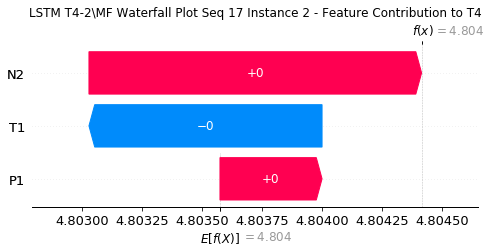

None

Contribution: [ 7.00083715e-05 -1.83897471e-04  2.34814202e-04]


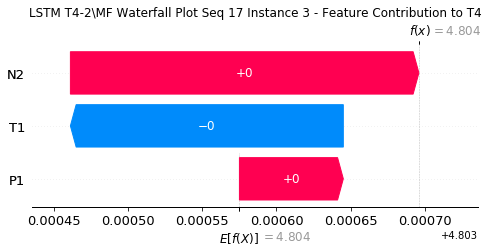

None

Contribution: [ 1.20462754e-05 -5.46824749e-05  4.49985132e-05]


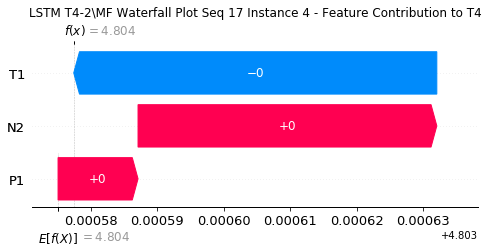

None

Contribution: [ 1.09409306e-05 -3.92813802e-05  3.78703674e-05]


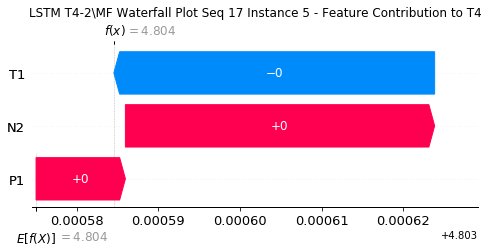

None

Contribution: [ 8.87214974e-06 -4.54573803e-05  3.53479717e-05]


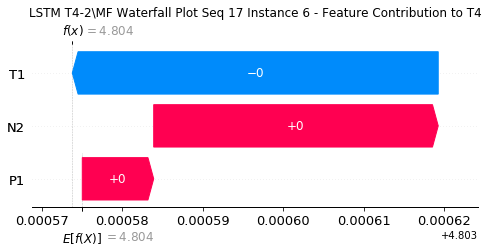

None

Contribution: [ 3.70512900e-06 -4.00612293e-05  3.46088970e-05]


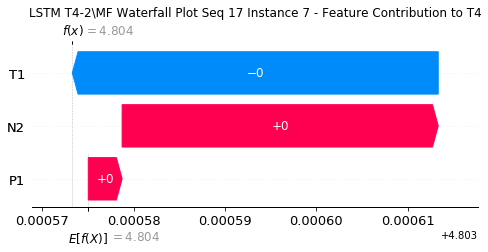

None

Contribution: [ 4.81122843e-06 -4.27391494e-05  3.60586729e-05]


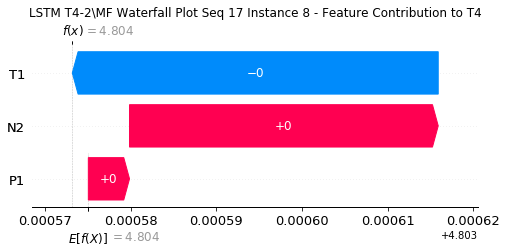

None

Contribution: [ 3.79425419e-06 -4.20499764e-05  3.46666287e-05]


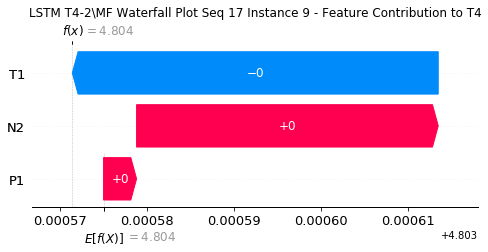

None

Contribution: [ 5.24362580e-06 -4.86329873e-05  3.41078113e-05]


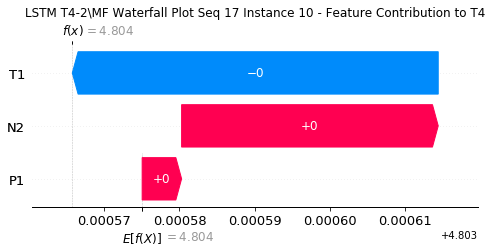

None

Contribution: [ 7.46719870e-06 -5.04866886e-05  3.29449505e-05]


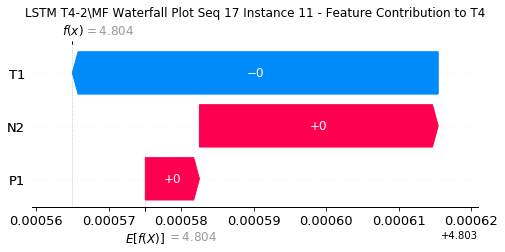

None

Contribution: [ 6.07008007e-06 -4.65549140e-05  3.32283056e-05]


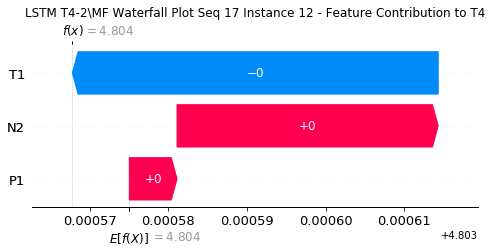

None

Contribution: [ 7.19712419e-06 -5.11815523e-05  3.23321645e-05]


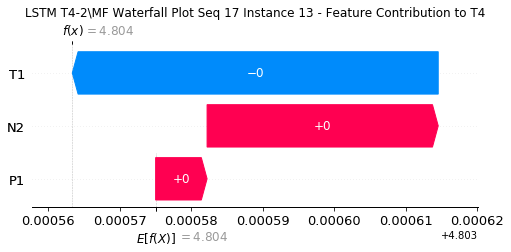

None

Contribution: [ 6.35332083e-06 -5.31987929e-05  3.32728808e-05]


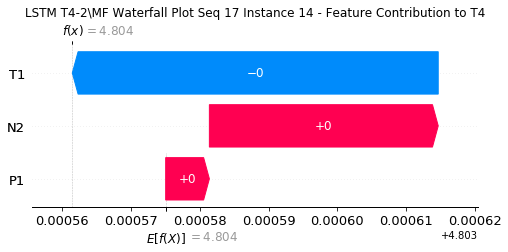

None

Contribution: [ 6.34598496e-06 -5.34398867e-05  3.19205628e-05]


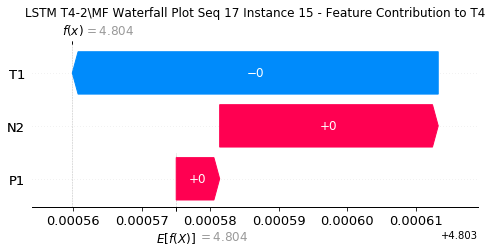

None

Contribution: [ 6.41777494e-06 -5.24601609e-05  3.17229862e-05]


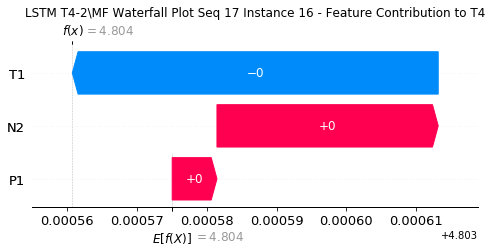

None

Contribution: [ 4.16523176e-06 -5.44083129e-05  3.06387833e-05]


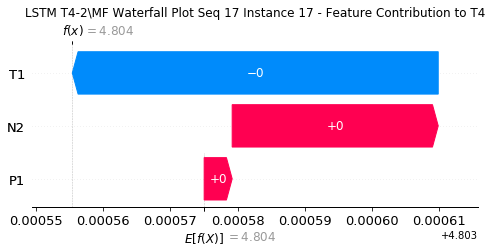

None

Contribution: [ 7.07858707e-06 -5.03497995e-05  3.17357069e-05]


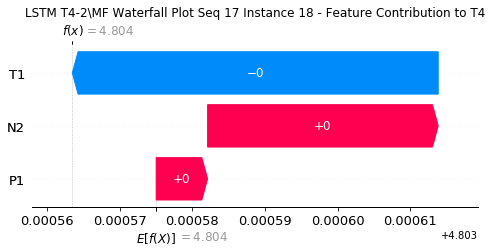

None

Contribution: [ 7.04757733e-06 -5.18602681e-05  3.19297631e-05]


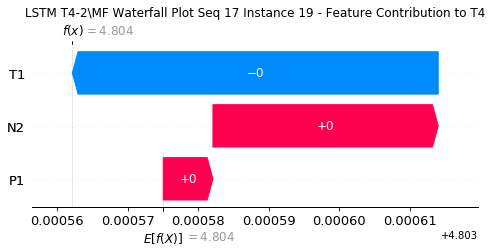

None

Contribution: [ 6.56131639e-06 -5.19604092e-05  3.19821257e-05]


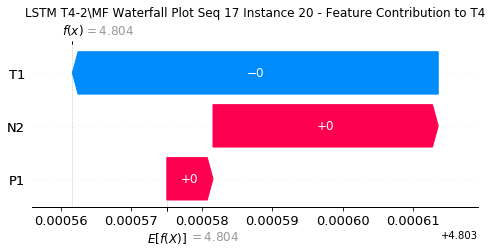

None

Contribution: [ 3.46351853e-06 -5.83531702e-05  3.44659394e-05]


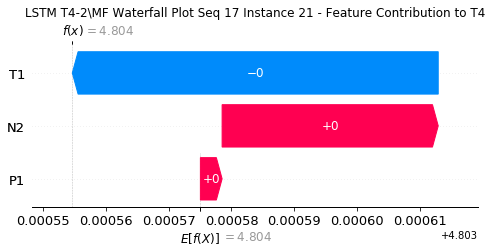

None

Contribution: [ 1.13318792e-05 -8.42144598e-05  4.44354660e-05]


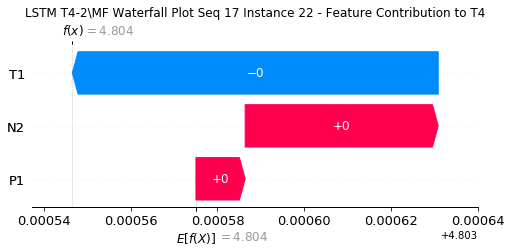

None

Contribution: [ 4.88749220e-05 -2.03373883e-04  1.29037930e-04]


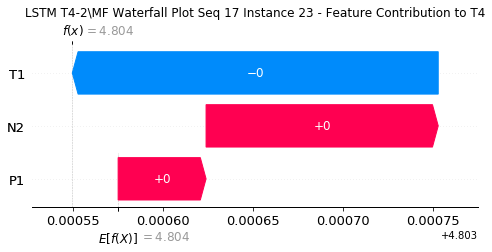

None

Contribution: [ 0.00028624 -0.00186425  0.00126591]


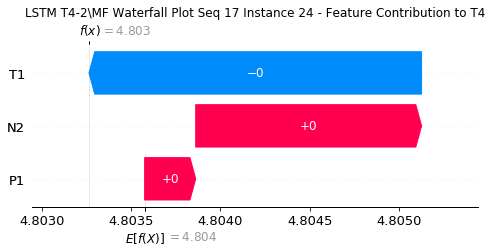

None

Contribution: [ 0.00073266 -0.00385823  0.00252444]


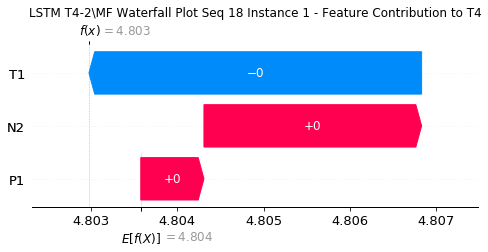

None

Contribution: [ 0.00036638 -0.00118573  0.00128704]


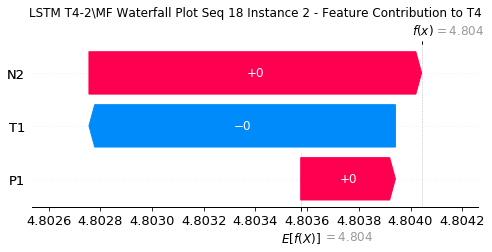

None

Contribution: [ 6.90100983e-05 -2.31016417e-04  2.31940088e-04]


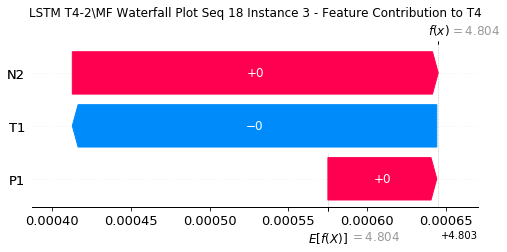

None

Contribution: [ 1.21844775e-05 -6.50683489e-05  4.40243398e-05]


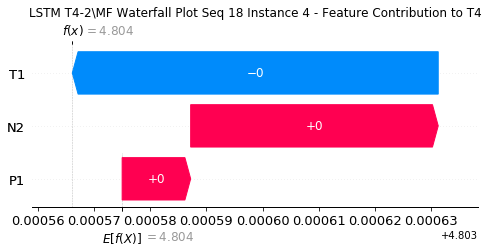

None

Contribution: [ 9.06272514e-06 -5.01437829e-05  3.88767740e-05]


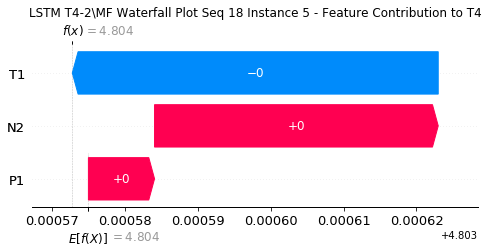

None

Contribution: [ 8.74071243e-06 -5.48009849e-05  3.46518438e-05]


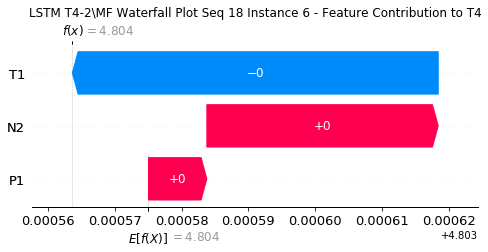

None

Contribution: [ 5.21270894e-07 -5.89907206e-05  3.33525038e-05]


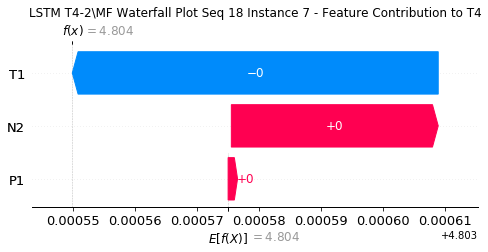

None

Contribution: [ 5.59804508e-06 -5.79839405e-05  3.50062265e-05]


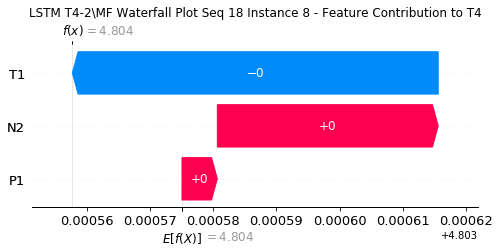

None

Contribution: [ 2.10518514e-06 -5.55340766e-05  3.35744361e-05]


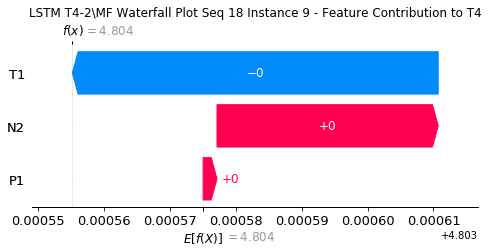

None

Contribution: [ 6.58645006e-06 -5.29364315e-05  3.50148940e-05]


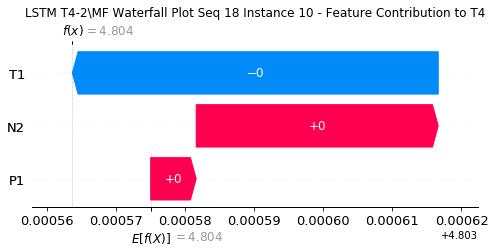

None

Contribution: [ 8.71100638e-06 -5.58881099e-05  3.38133126e-05]


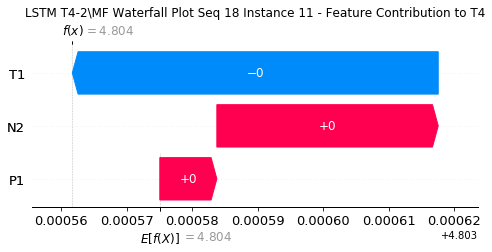

None

Contribution: [ 6.73099883e-06 -5.69924151e-05  3.11498202e-05]


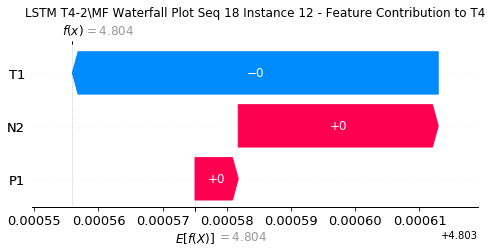

None

Contribution: [ 8.93311327e-06 -5.57677929e-05  3.38382080e-05]


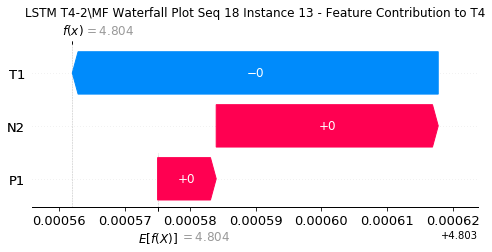

None

Contribution: [ 6.32427843e-06 -5.07056105e-05  3.45977392e-05]


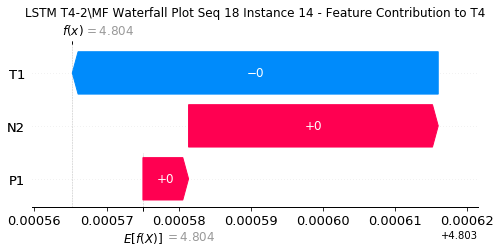

None

Contribution: [ 8.45567169e-06 -5.79223716e-05  3.35129942e-05]


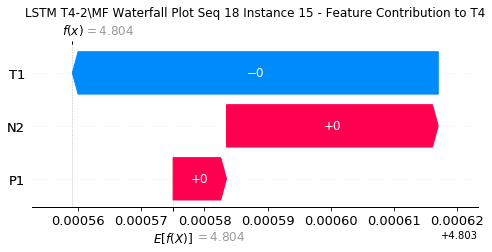

None

Contribution: [ 8.59607171e-06 -5.67904409e-05  3.27152307e-05]


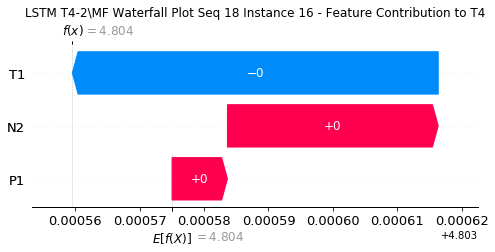

None

Contribution: [ 3.38489751e-06 -6.54511235e-05  3.27537670e-05]


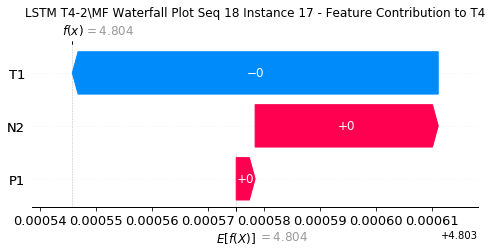

None

Contribution: [ 9.01465664e-06 -5.74662186e-05  3.31846286e-05]


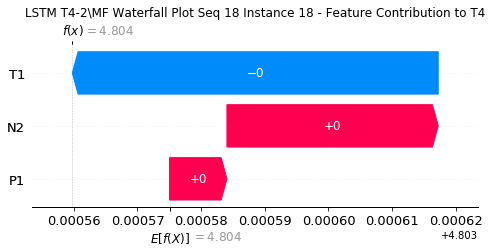

None

Contribution: [ 9.08407015e-06 -5.84323693e-05  3.32036340e-05]


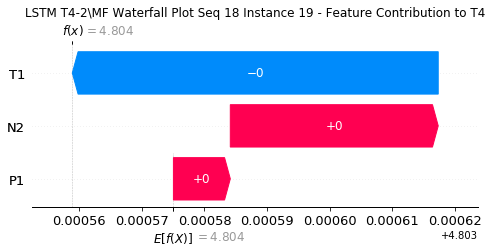

None

Contribution: [ 8.78883561e-06 -5.86304362e-05  3.39695050e-05]


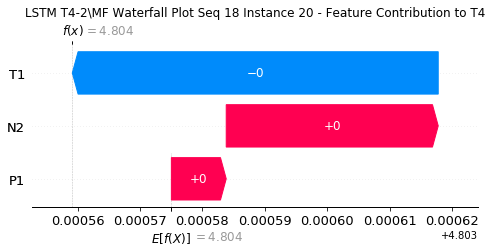

None

Contribution: [ 6.27988807e-06 -6.33427546e-05  3.63426919e-05]


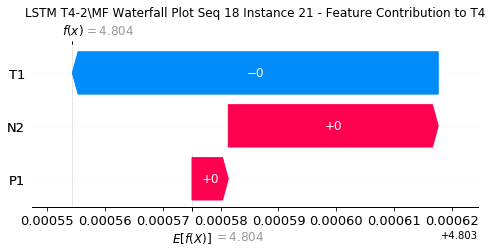

None

Contribution: [ 1.30148945e-05 -9.59422045e-05  4.58392944e-05]


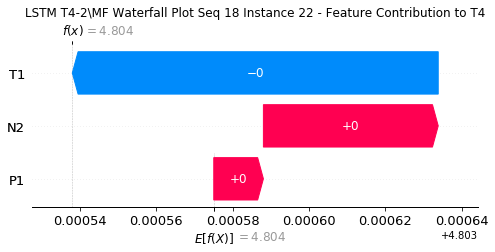

None

Contribution: [ 2.32063789e-05 -2.44655795e-04  1.22255835e-04]


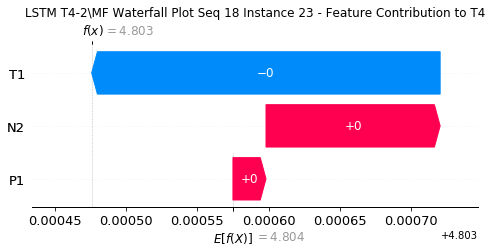

None

Contribution: [ 0.00031493 -0.00184733  0.00134475]


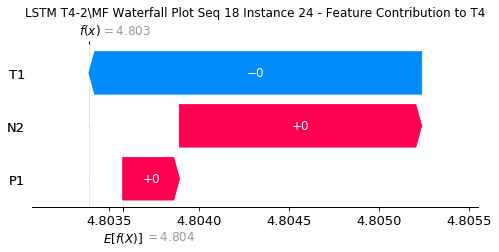

None

Contribution: [ 0.0008449  -0.00387413  0.0028616 ]


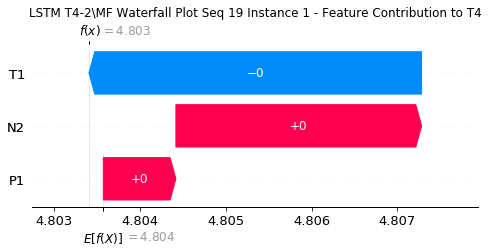

None

Contribution: [ 0.00047911 -0.00110551  0.00140897]


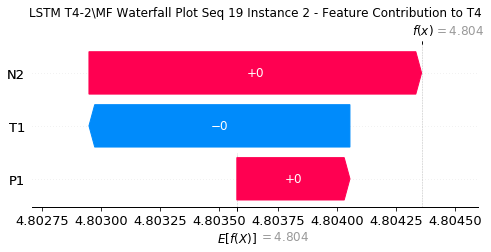

None

Contribution: [ 8.78012797e-05 -1.56856559e-04  2.40847078e-04]


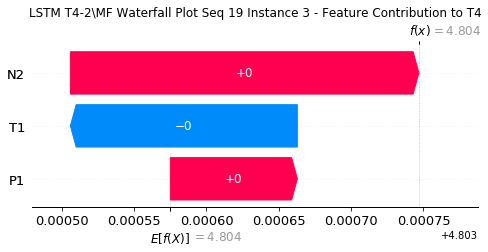

None

Contribution: [ 1.65354151e-05 -4.67595063e-05  4.63529360e-05]


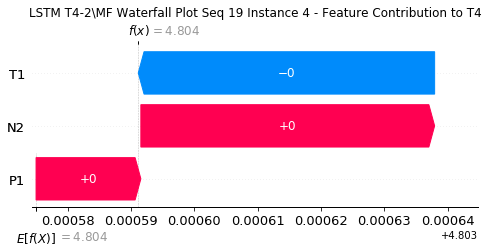

None

Contribution: [ 1.76588752e-05 -4.54176433e-05  3.84971751e-05]


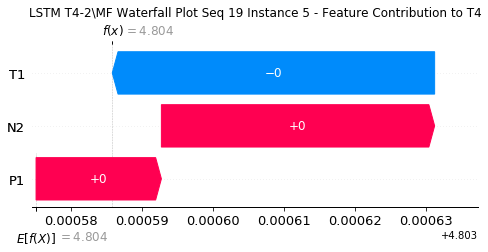

None

Contribution: [ 1.30204724e-05 -4.04509995e-05  3.66066368e-05]


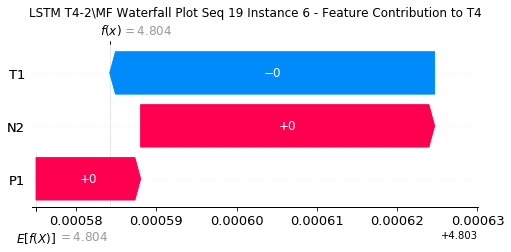

None

Contribution: [ 1.07357141e-05 -4.12694112e-05  3.75446494e-05]


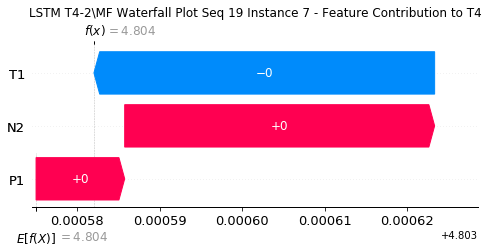

None

Contribution: [ 1.37273040e-05 -4.35633660e-05  3.86538606e-05]


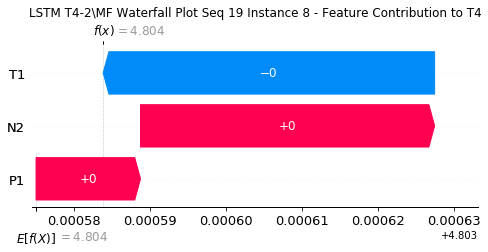

None

Contribution: [ 9.50575347e-06 -3.41060135e-05  3.63197748e-05]


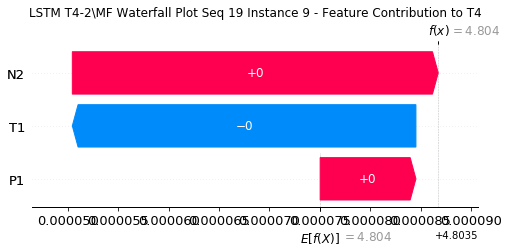

None

Contribution: [ 1.05396095e-05 -4.01247565e-05  3.55840125e-05]


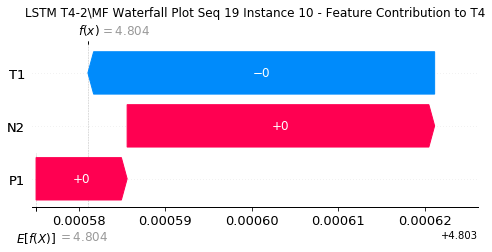

None

Contribution: [ 1.27522951e-05 -4.42396919e-05  3.46001585e-05]


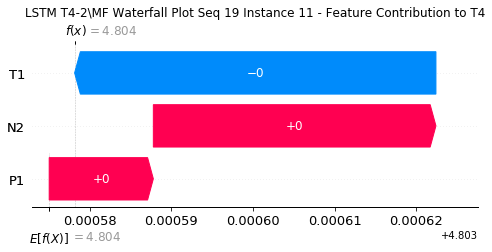

None

Contribution: [ 1.47185961e-05 -4.62164637e-05  3.59052854e-05]


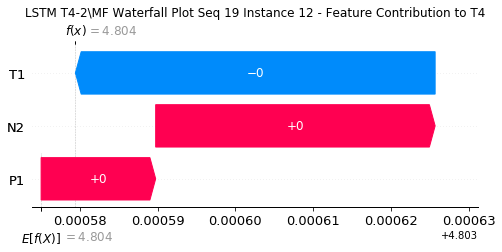

None

Contribution: [ 1.22396520e-05 -4.52273890e-05  3.38469062e-05]


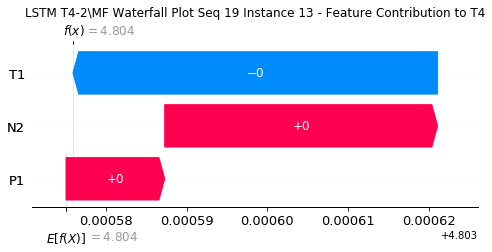

None

Contribution: [ 9.98191970e-06 -4.97660576e-05  3.57599168e-05]


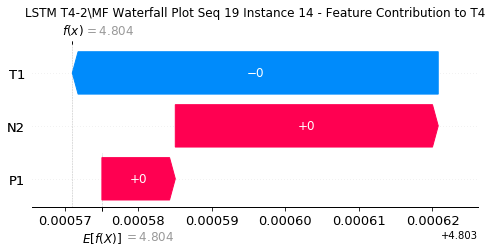

None

Contribution: [ 1.07580887e-05 -5.08669527e-05  3.31997439e-05]


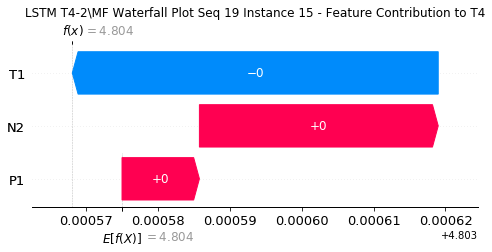

None

Contribution: [ 1.00505622e-05 -5.05503585e-05  3.26213949e-05]


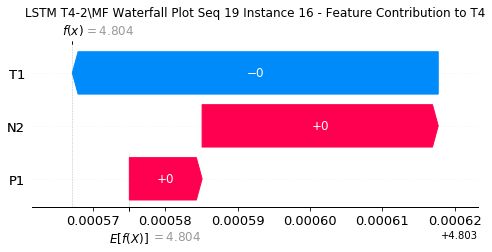

None

Contribution: [ 7.71415018e-06 -5.31534527e-05  3.58861898e-05]


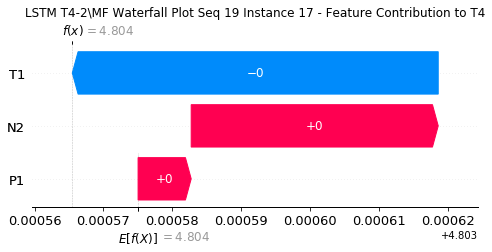

None

Contribution: [ 9.49240626e-06 -5.39057992e-05  3.25437303e-05]


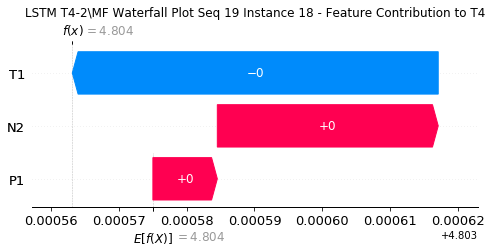

None

Contribution: [ 9.35787527e-06 -5.48131098e-05  3.24955059e-05]


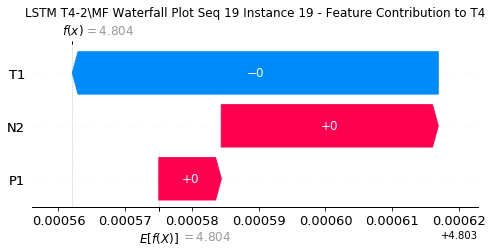

None

Contribution: [ 8.98730273e-06 -5.38102669e-05  3.26556391e-05]


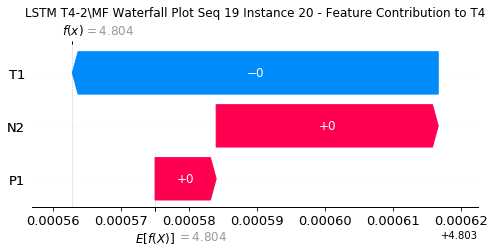

None

Contribution: [ 6.05759866e-06 -5.80535346e-05  3.48895231e-05]


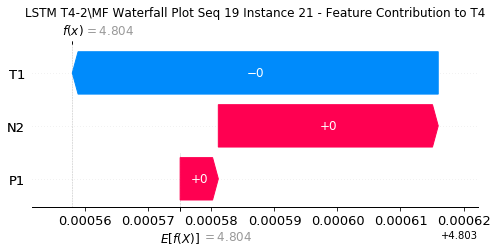

None

Contribution: [ 1.08582947e-05 -8.81135530e-05  4.32427012e-05]


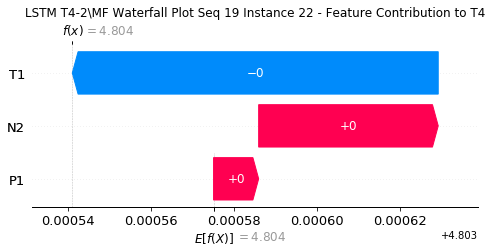

None

Contribution: [ 3.48744640e-05 -2.10960059e-04  1.26750982e-04]


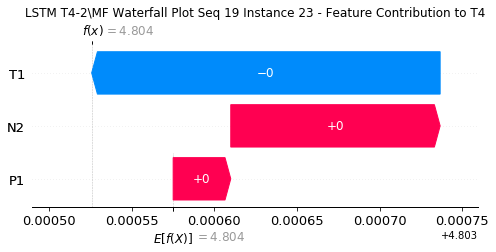

None

Contribution: [ 0.00042322 -0.00171291  0.0013658 ]


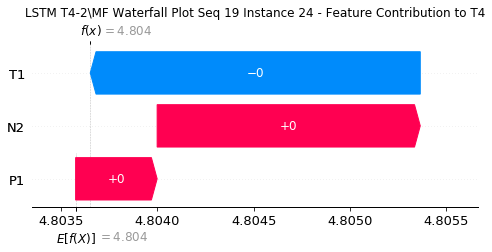

None

Contribution: [ 0.00099551 -0.00355949  0.0027559 ]


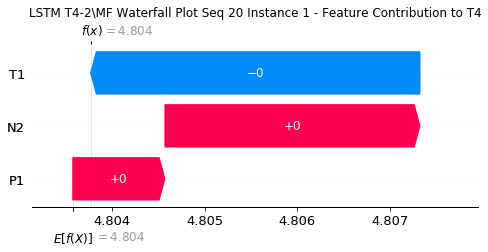

None

Contribution: [ 0.00031777 -0.00119047  0.00131945]


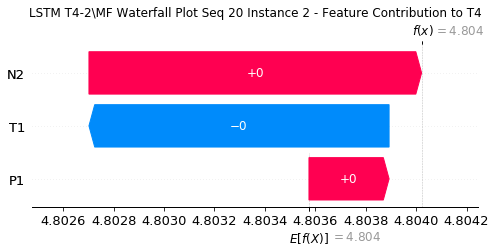

None

Contribution: [ 7.96371564e-05 -1.92709980e-04  2.36038157e-04]


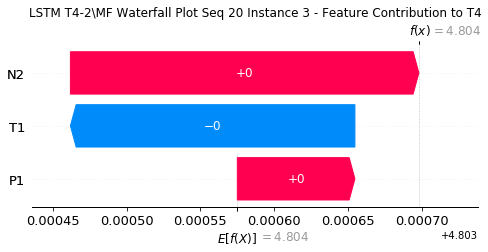

None

Contribution: [ 1.59184759e-05 -5.52731571e-05  4.53797376e-05]


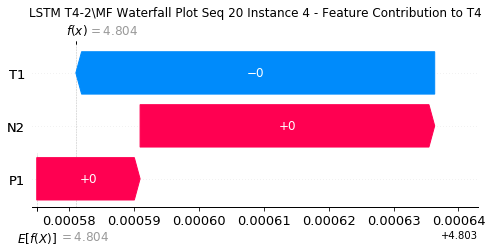

None

Contribution: [ 1.52000008e-05 -4.67439643e-05  3.81789519e-05]


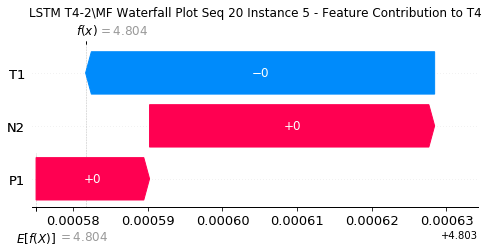

None

Contribution: [ 1.23147355e-05 -4.74224325e-05  3.56953439e-05]


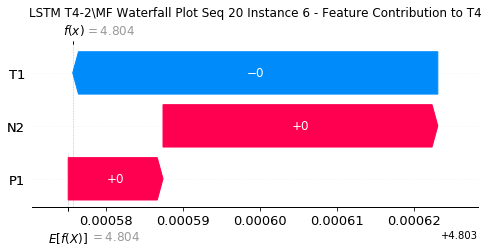

None

Contribution: [ 7.95263157e-06 -5.15175592e-05  3.61443211e-05]


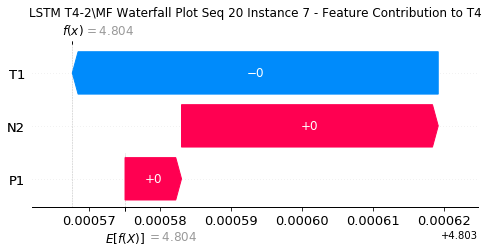

None

Contribution: [ 9.50442151e-06 -4.80759111e-05  3.58228159e-05]


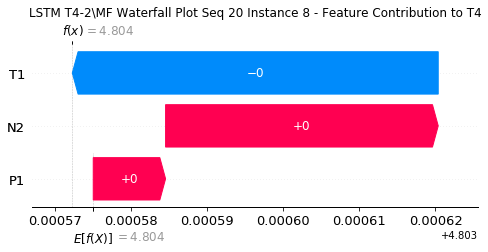

None

Contribution: [ 9.74630695e-06 -4.56241300e-05  3.67889915e-05]


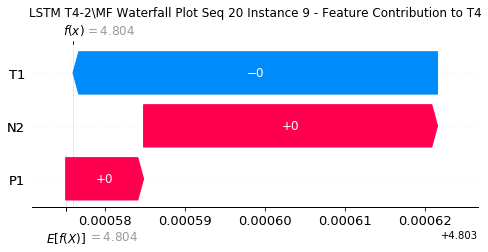

None

Contribution: [ 9.62838883e-06 -4.71044958e-05  3.41480921e-05]


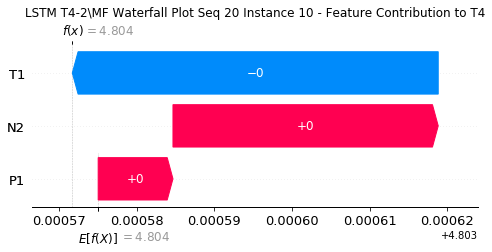

None

Contribution: [ 1.15627820e-05 -5.07199056e-05  3.27650553e-05]


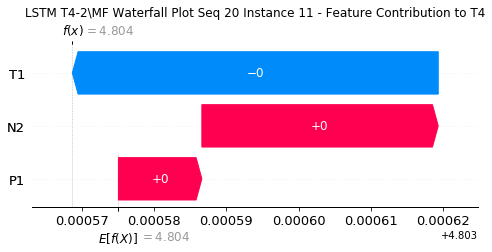

None

Contribution: [ 1.27978861e-05 -4.34794882e-05  3.00698190e-05]


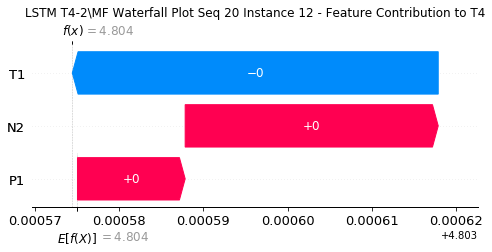

None

Contribution: [ 1.13053480e-05 -5.13500164e-05  3.18439840e-05]


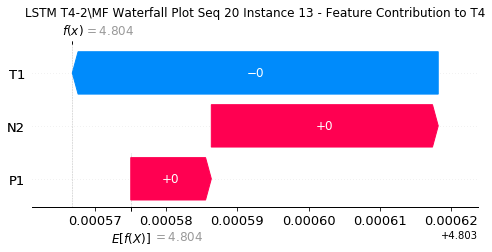

None

Contribution: [ 5.98454490e-06 -5.25327979e-05  3.19391714e-05]


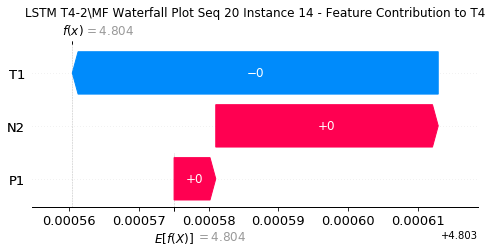

None

Contribution: [ 1.12009759e-05 -5.52448128e-05  3.14521942e-05]


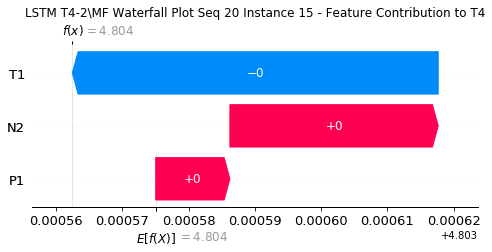

None

Contribution: [ 1.16631872e-05 -5.40500248e-05  3.11708304e-05]


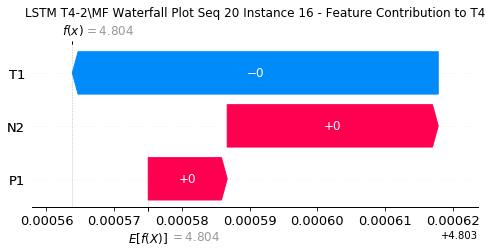

None

Contribution: [ 1.01720195e-05 -5.92648749e-05  3.05267812e-05]


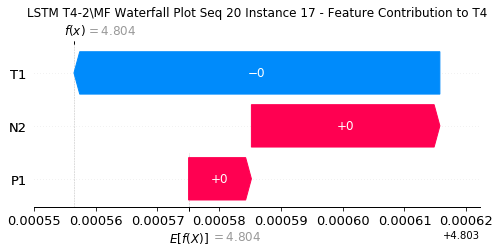

None

Contribution: [ 1.04957484e-05 -5.67367630e-05  3.04610264e-05]


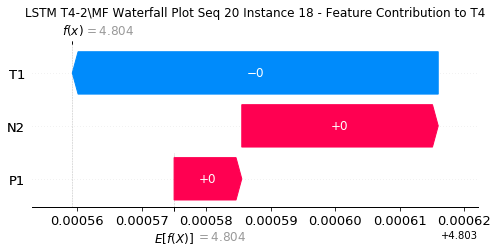

None

Contribution: [ 1.04671846e-05 -5.75122235e-05  3.04844132e-05]


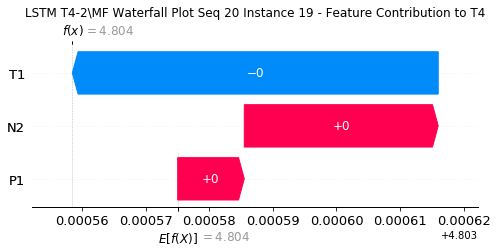

None

Contribution: [ 8.91576328e-06 -5.75730916e-05  2.99737539e-05]


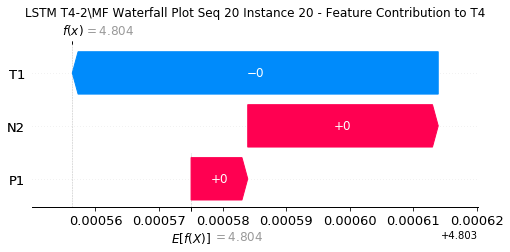

None

Contribution: [ 7.56888310e-06 -6.16968555e-05  3.25725943e-05]


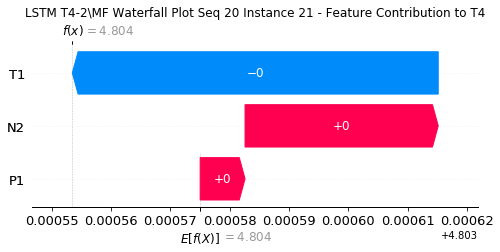

None

Contribution: [ 1.26944824e-05 -9.27341507e-05  3.92459055e-05]


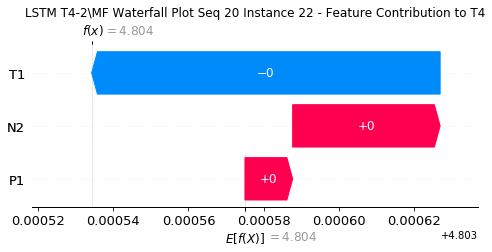

None

Contribution: [ 2.78443480e-05 -1.86742734e-04  1.12798721e-04]


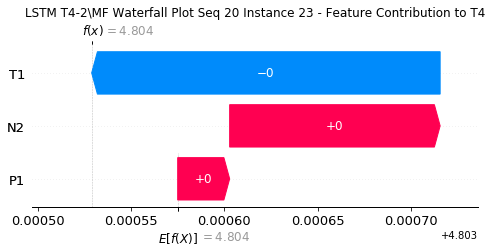

None

Contribution: [ 0.00040816 -0.00149991  0.0013102 ]


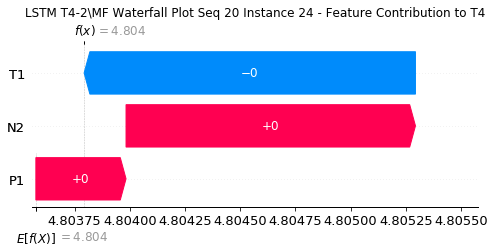

None

Contribution: [ 0.00083747 -0.00324855  0.00255868]


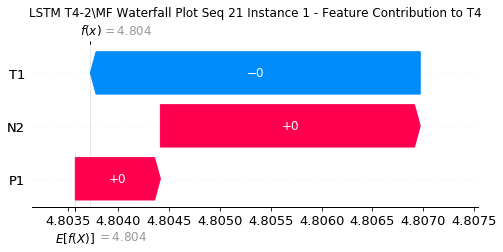

None

Contribution: [ 0.00053462 -0.00097231  0.00136565]


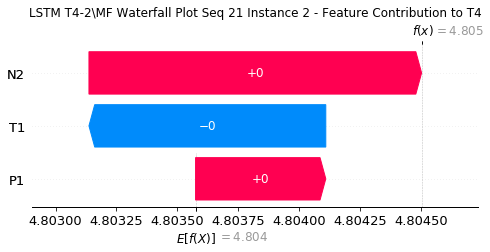

None

Contribution: [ 7.49002303e-05 -1.85407068e-04  2.33630785e-04]


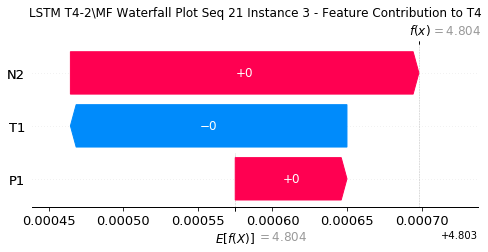

None

Contribution: [ 1.38395539e-05 -5.29962403e-05  4.49645680e-05]


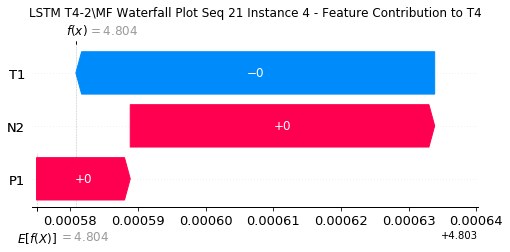

None

Contribution: [ 1.76538868e-05 -5.97013890e-05  3.58690126e-05]


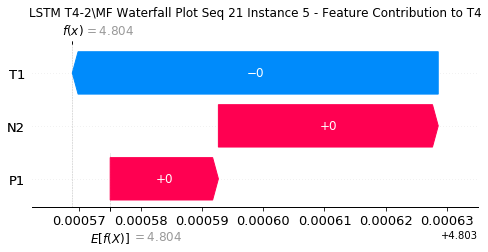

None

Contribution: [ 1.14411969e-05 -4.43952614e-05  3.50457401e-05]


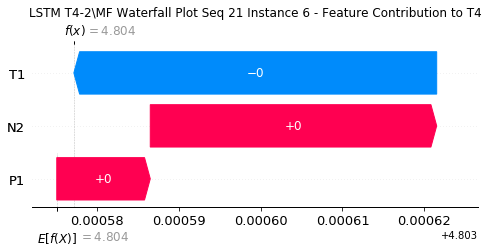

None

Contribution: [ 1.07780429e-05 -4.12515994e-05  3.39774938e-05]


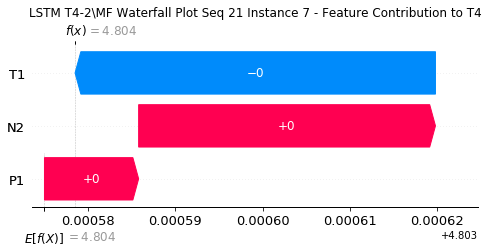

None

Contribution: [ 1.05527695e-05 -3.37563242e-05  3.42430774e-05]


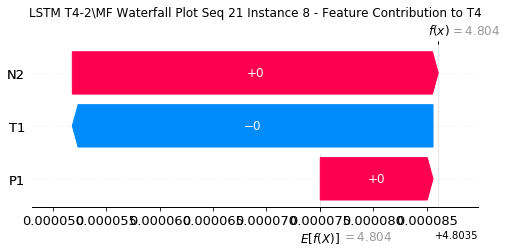

None

Contribution: [ 9.37914378e-06 -3.43473847e-05  3.44642935e-05]


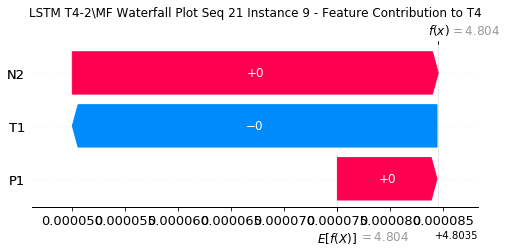

None

Contribution: [ 6.45937236e-06 -4.56969919e-05  3.43925331e-05]


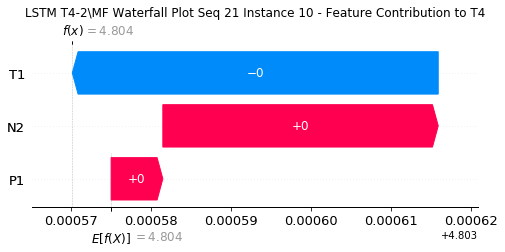

None

Contribution: [ 9.27690175e-06 -4.88214422e-05  3.31114202e-05]


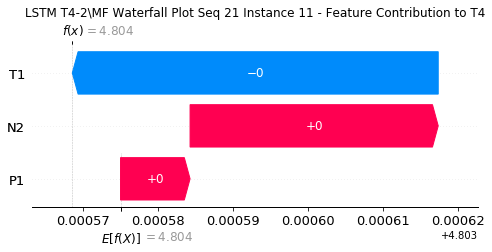

None

Contribution: [ 1.47870516e-05 -4.94126968e-05  3.52806351e-05]


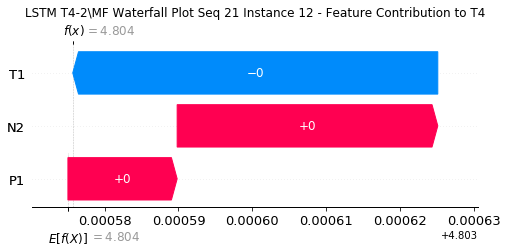

None

Contribution: [ 9.63167125e-06 -4.91784736e-05  3.25398458e-05]


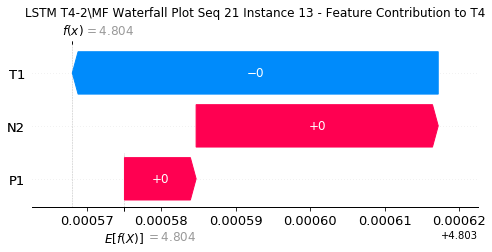

None

Contribution: [ 1.02854514e-05 -4.87542484e-05  3.43023795e-05]


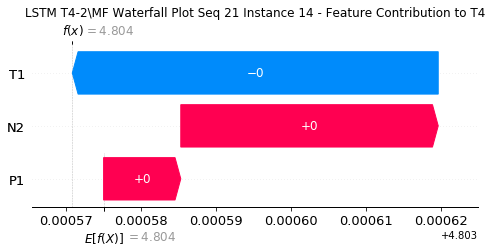

None

Contribution: [ 1.40925002e-05 -5.97432827e-05  3.42543447e-05]


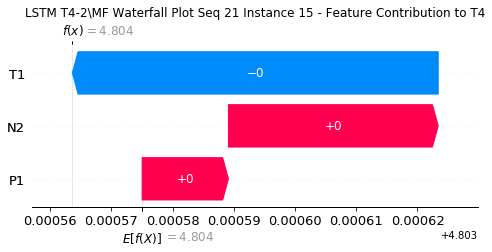

None

Contribution: [ 1.26081058e-05 -5.82426197e-05  3.37591796e-05]


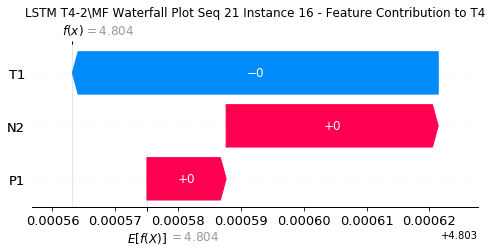

None

Contribution: [ 8.80054096e-06 -6.28822102e-05  3.42430010e-05]


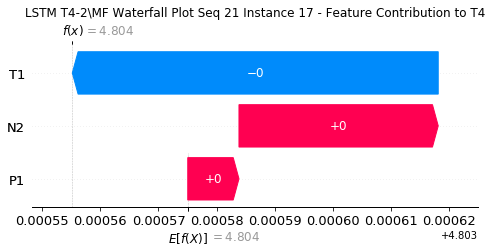

None

Contribution: [ 1.33077144e-05 -5.89340868e-05  3.39520751e-05]


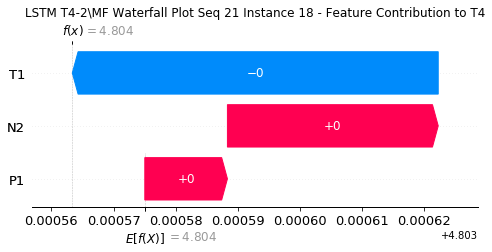

None

Contribution: [ 1.02752550e-05 -6.51516770e-05  3.26565063e-05]


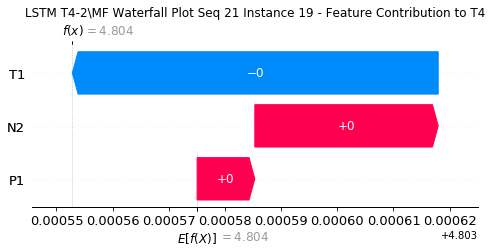

None

Contribution: [ 8.96856173e-06 -6.64188049e-05  3.34675511e-05]


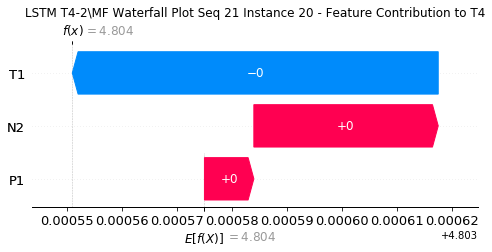

None

Contribution: [ 5.62497821e-06 -7.32578247e-05  3.47477043e-05]


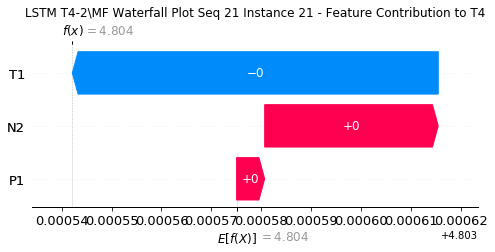

None

Contribution: [ 1.17449170e-05 -1.14023638e-04  4.46384444e-05]


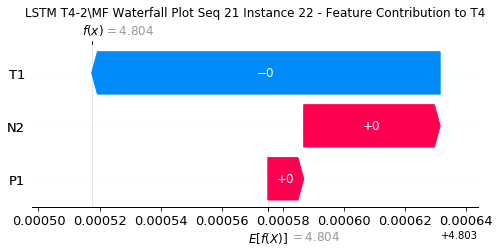

None

Contribution: [ 3.62431838e-05 -3.06069645e-04  1.23365045e-04]


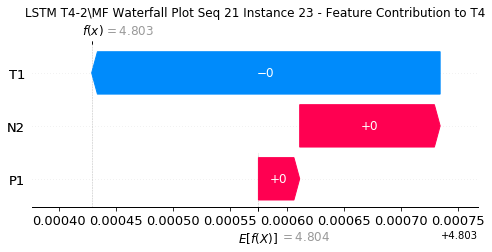

None

Contribution: [ 0.0005424  -0.0022411   0.00139021]


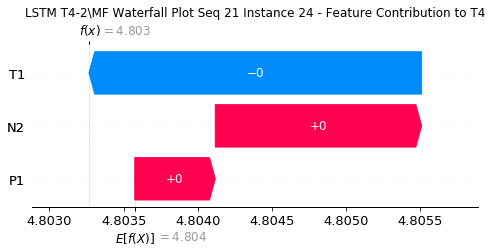

None

Contribution: [ 0.00087817 -0.00498136  0.00262605]


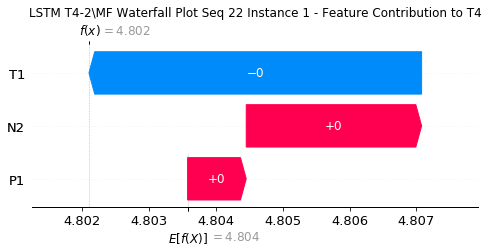

None

Contribution: [ 0.00044625 -0.00162263  0.0012759 ]


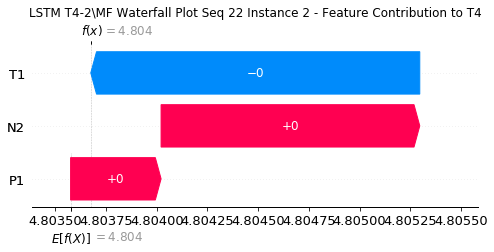

None

Contribution: [ 9.19290048e-05 -2.96464259e-04  2.18490833e-04]


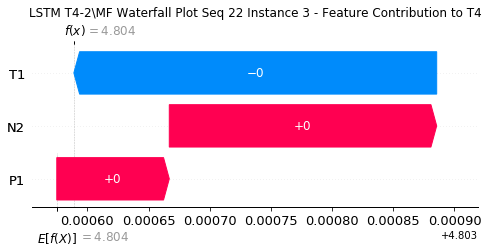

None

Contribution: [ 1.51614621e-05 -6.40051306e-05  4.00428966e-05]


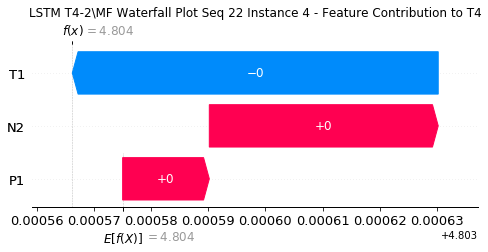

None

Contribution: [ 1.26470737e-05 -5.64634610e-05  3.35915868e-05]


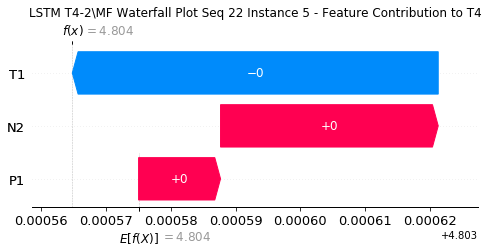

None

Contribution: [ 1.42296873e-05 -4.78216441e-05  3.25331264e-05]


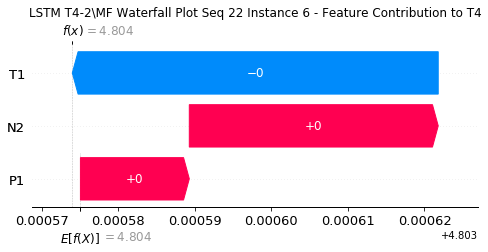

None

Contribution: [ 8.00280154e-06 -4.99044955e-05  3.26267577e-05]


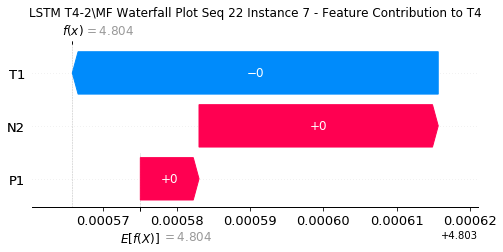

None

Contribution: [ 1.08516807e-05 -3.71291025e-05  3.43263569e-05]


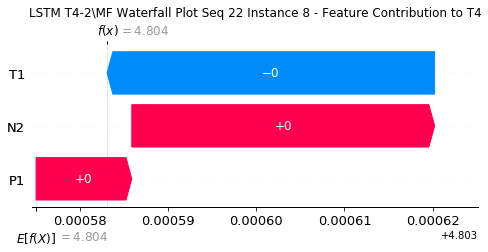

None

Contribution: [ 1.21892409e-05 -4.15743274e-05  3.40324990e-05]


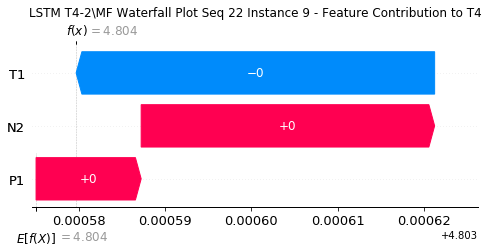

None

Contribution: [ 8.44093929e-06 -4.26758656e-05  3.39999521e-05]


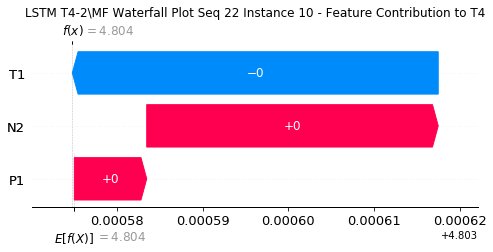

None

Contribution: [ 9.92945816e-06 -5.01805650e-05  3.18371774e-05]


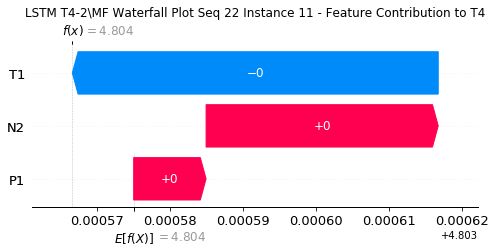

None

Contribution: [ 1.00944695e-05 -5.13037848e-05  3.24914876e-05]


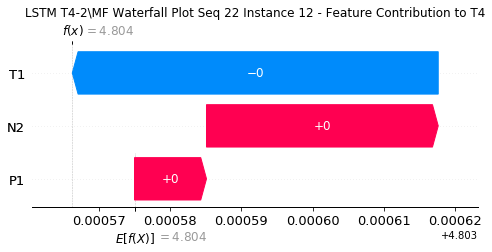

None

Contribution: [ 1.56944038e-05 -4.97566535e-05  3.53775160e-05]


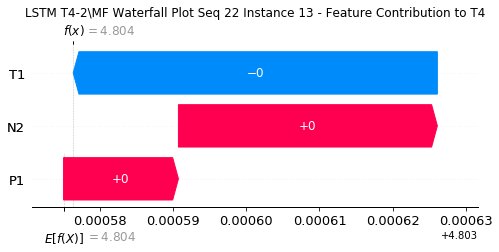

None

Contribution: [ 7.23287712e-06 -5.02128435e-05  3.35667029e-05]


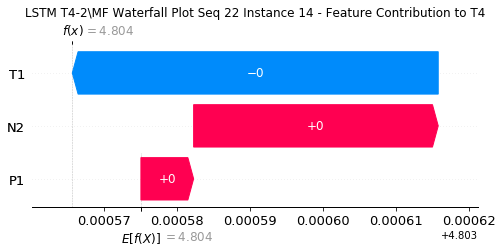

None

Contribution: [ 9.10149325e-06 -5.21957418e-05  3.20361543e-05]


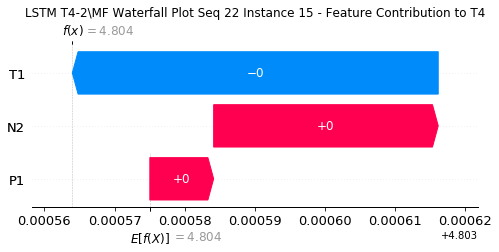

None

Contribution: [ 1.14299028e-05 -4.84022440e-05  3.30751995e-05]


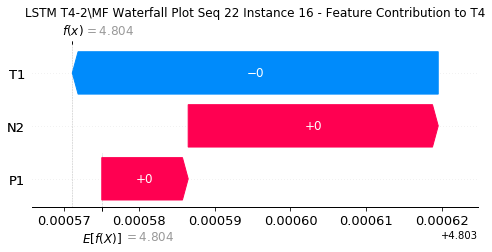

None

Contribution: [ 8.29928605e-06 -5.16024227e-05  3.34583812e-05]


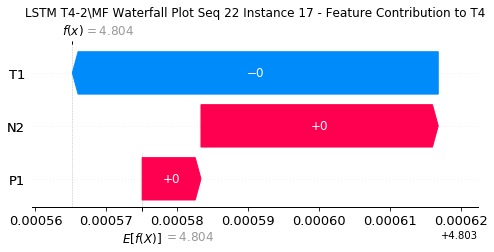

None

Contribution: [ 1.60191323e-05 -4.92042536e-05  3.23117394e-05]


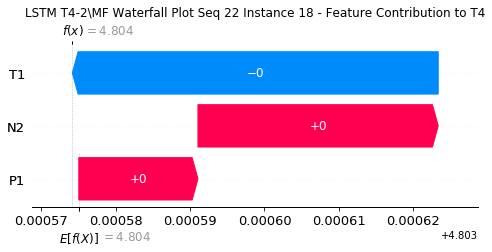

None

Contribution: [ 1.18522159e-05 -5.13003810e-05  3.29460184e-05]


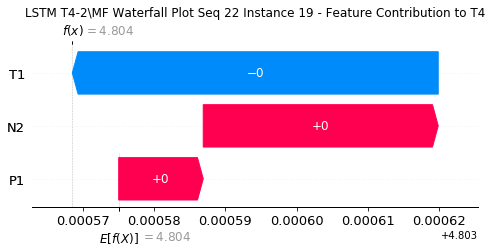

None

Contribution: [ 1.05529708e-05 -5.18238169e-05  3.37327539e-05]


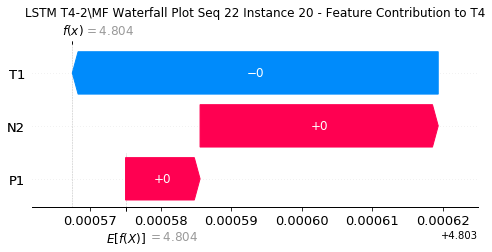

None

Contribution: [ 6.68764004e-06 -5.77981229e-05  3.54128983e-05]


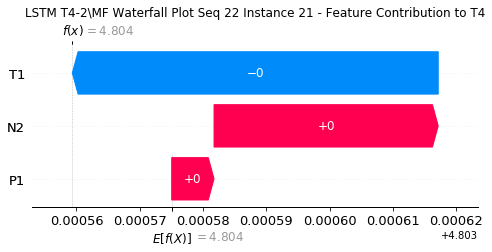

None

Contribution: [ 1.31320028e-05 -8.74330336e-05  4.53818771e-05]


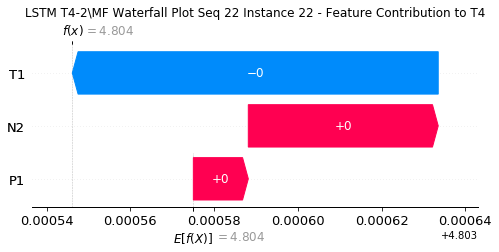

None

Contribution: [ 2.65065513e-05 -2.42801286e-04  1.20923195e-04]


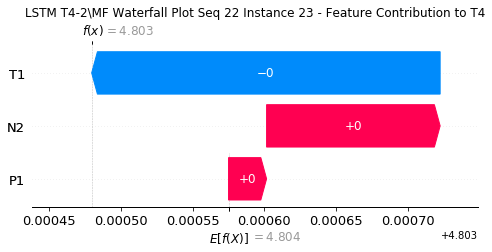

None

Contribution: [ 0.00010511 -0.00220534  0.00126962]


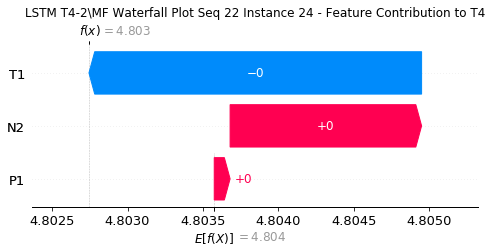

None

Contribution: [ 0.00100596 -0.00395345  0.00276538]


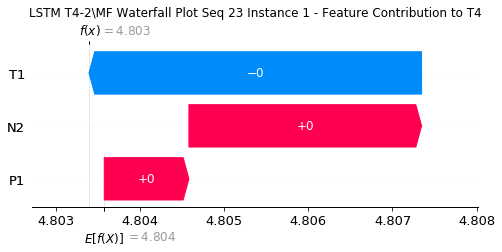

None

Contribution: [ 0.00047071 -0.00126072  0.00137021]


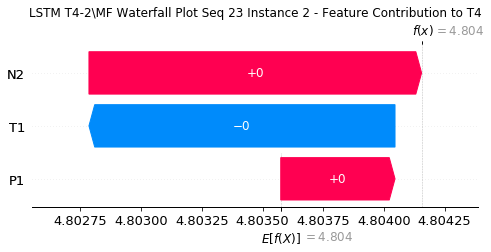

None

Contribution: [ 0.0001022  -0.00020734  0.00023928]


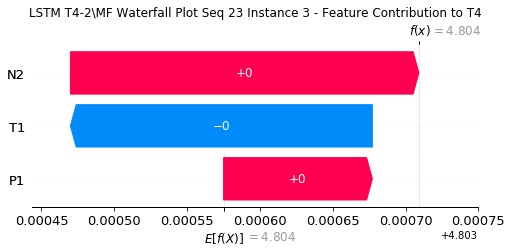

None

Contribution: [ 1.69619044e-05 -5.49394602e-05  4.62570528e-05]


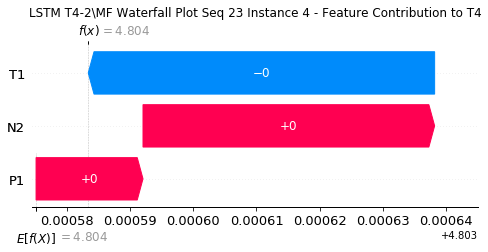

None

Contribution: [ 1.40768498e-05 -4.91625072e-05  3.84836402e-05]


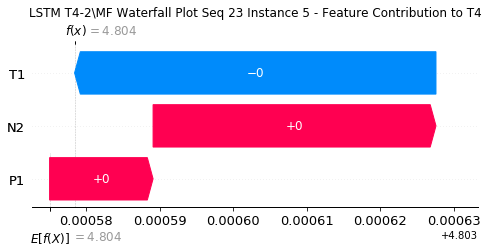

None

Contribution: [ 1.79145225e-05 -4.48461217e-05  3.72495739e-05]


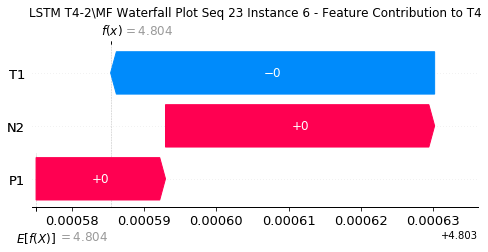

None

Contribution: [ 9.50704831e-06 -4.54536010e-05  3.65643038e-05]


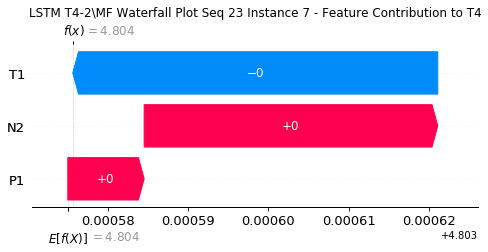

None

Contribution: [ 1.32362042e-05 -4.60544398e-05  3.68400390e-05]


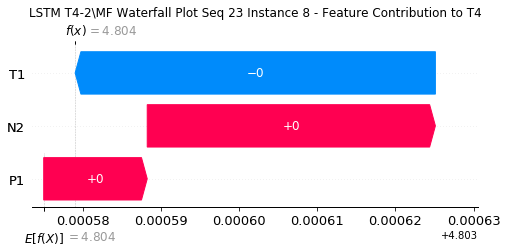

None

Contribution: [ 1.17135933e-05 -3.79874462e-05  3.62586119e-05]


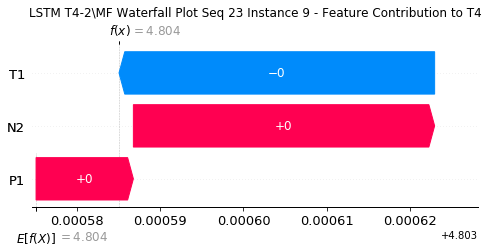

None

Contribution: [ 1.20173656e-05 -4.27156764e-05  3.73492223e-05]


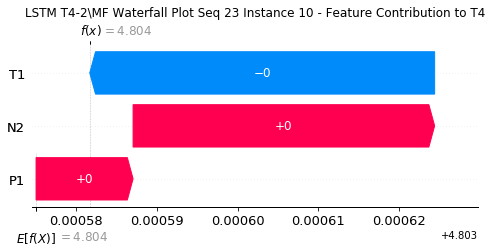

None

Contribution: [ 1.24893338e-05 -4.64517406e-05  3.48372507e-05]


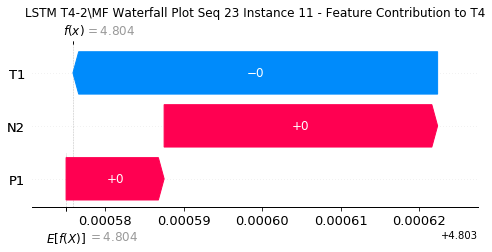

None

Contribution: [ 1.21548497e-05 -4.95691879e-05  3.51118460e-05]


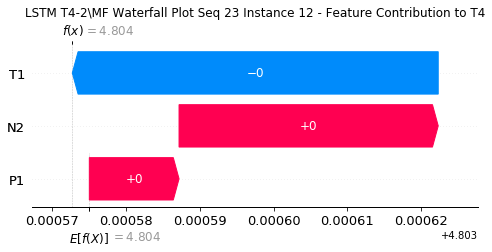

None

Contribution: [ 1.43182341e-05 -4.69938706e-05  3.43381769e-05]


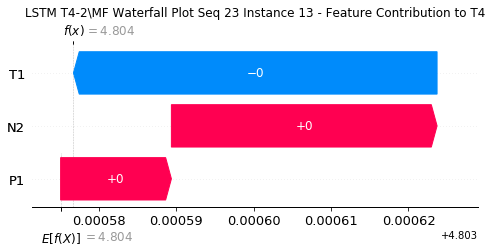

None

Contribution: [ 9.68126205e-06 -4.87439250e-05  3.56890480e-05]


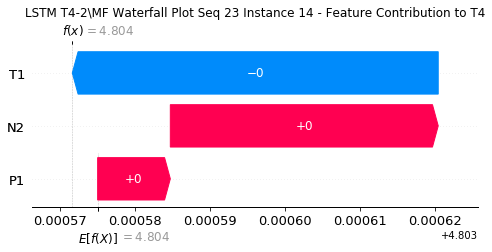

None

Contribution: [ 1.26433252e-05 -5.44518469e-05  3.18710131e-05]


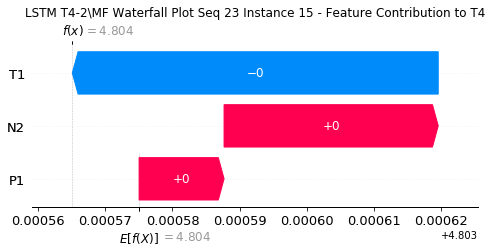

None

Contribution: [ 1.29565558e-05 -5.02176209e-05  3.42941315e-05]


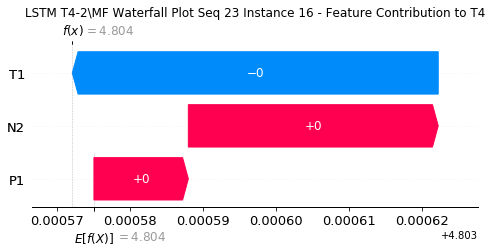

None

Contribution: [ 9.34807829e-06 -5.32244020e-05  3.43990288e-05]


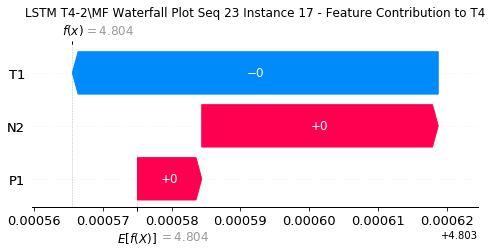

None

Contribution: [ 1.07754167e-05 -5.46291017e-05  3.24333324e-05]


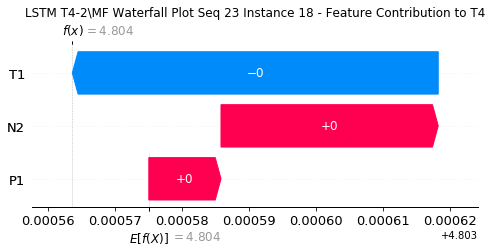

None

Contribution: [ 1.29462959e-05 -5.53371022e-05  3.35028356e-05]


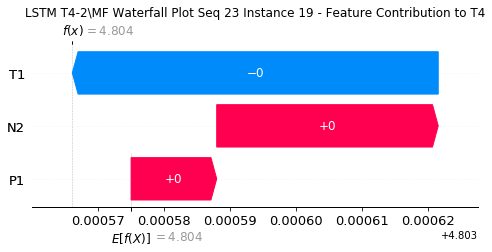

None

Contribution: [ 1.21250761e-05 -5.50411732e-05  3.42378913e-05]


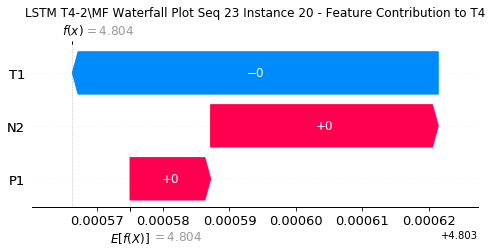

None

Contribution: [ 9.66032380e-06 -5.96338520e-05  3.61041911e-05]


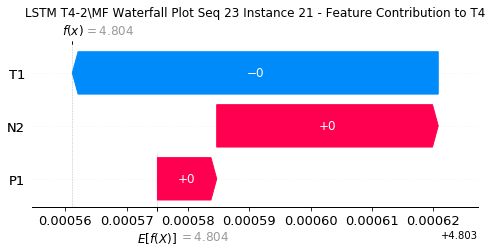

None

Contribution: [ 1.70822164e-05 -8.88266968e-05  4.59218183e-05]


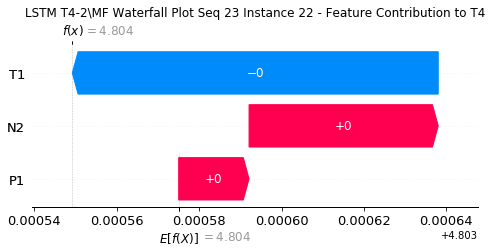

None

Contribution: [ 5.32071762e-05 -2.33135163e-04  1.26664754e-04]


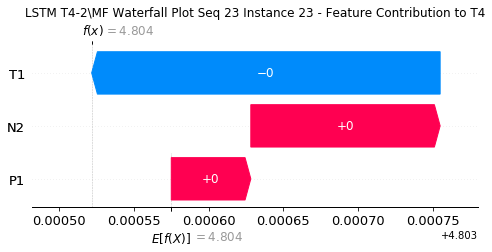

None

Contribution: [ 0.00062116 -0.00195807  0.00137711]


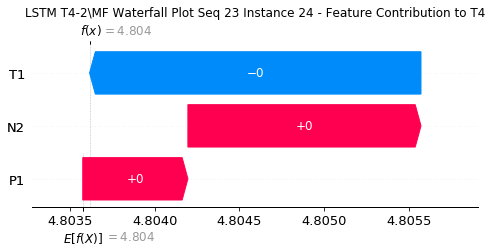

None

Contribution: [ 0.00111304 -0.00413913  0.00273294]


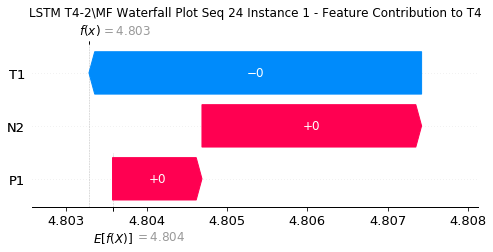

None

Contribution: [ 0.00056346 -0.00130802  0.00136587]


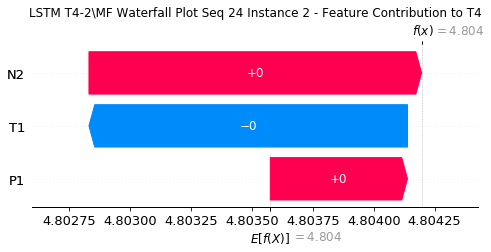

None

Contribution: [ 9.03671649e-05 -2.27469364e-04  2.36596579e-04]


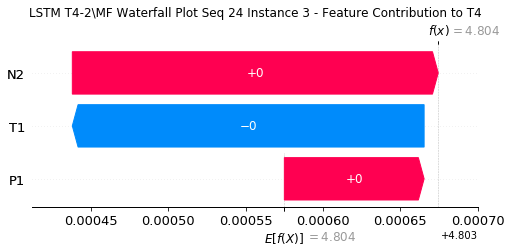

None

Contribution: [ 1.82260620e-05 -6.59524829e-05  4.70692196e-05]


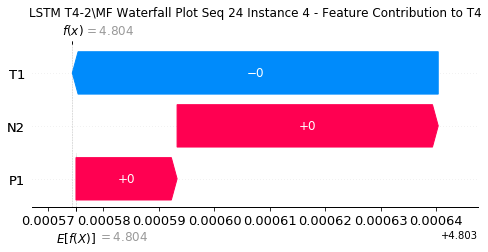

None

Contribution: [ 1.49471015e-05 -5.66758487e-05  3.88518641e-05]


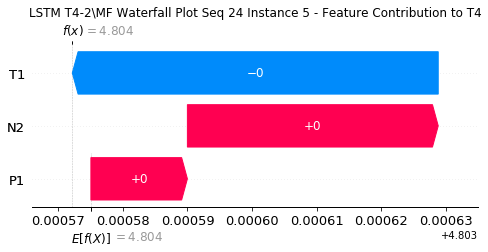

None

Contribution: [ 1.57083964e-05 -5.43307573e-05  3.68917813e-05]


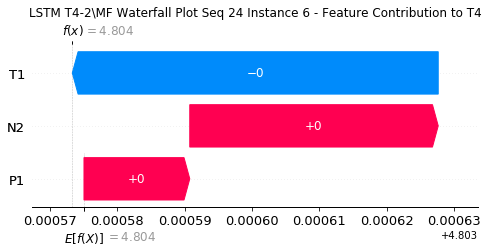

None

Contribution: [ 9.80027909e-06 -5.12416930e-05  3.66103032e-05]


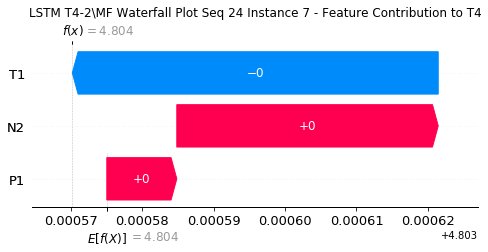

None

Contribution: [ 1.13403786e-05 -5.47752782e-05  3.68972076e-05]


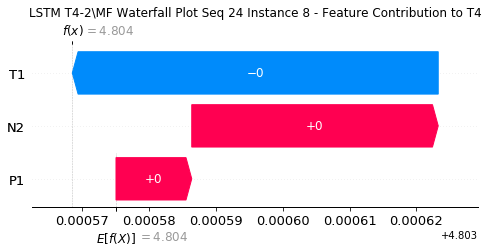

None

Contribution: [ 9.44593738e-06 -5.12516629e-05  3.61816926e-05]


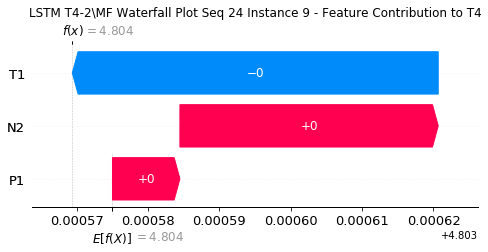

None

Contribution: [ 1.20386252e-05 -5.26199976e-05  3.63960613e-05]


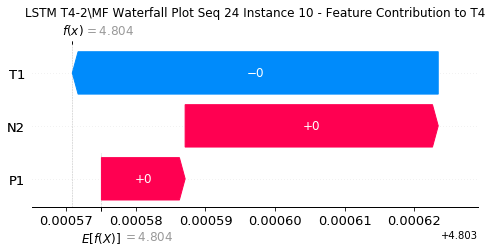

None

Contribution: [ 1.37269099e-05 -4.70451047e-05  3.52049780e-05]


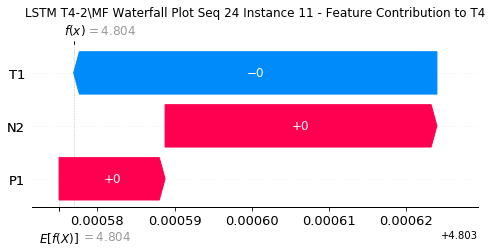

None

Contribution: [ 1.31091392e-05 -4.89104800e-05  3.56342482e-05]


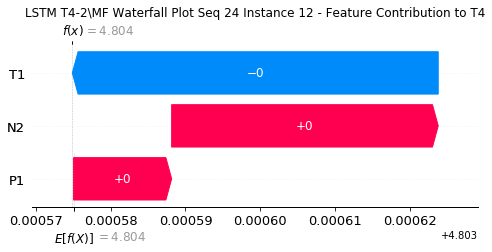

None

Contribution: [ 1.36547565e-05 -4.31411005e-05  3.40892741e-05]


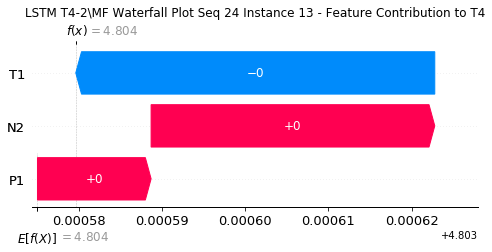

None

Contribution: [ 1.14541626e-05 -4.55602071e-05  3.64700216e-05]


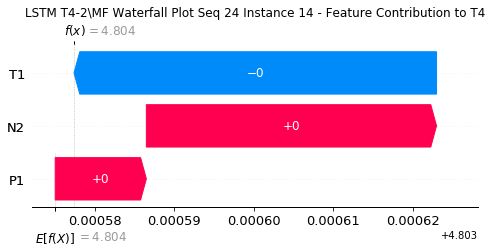

None

Contribution: [ 1.25823092e-05 -4.42398306e-05  3.69815962e-05]


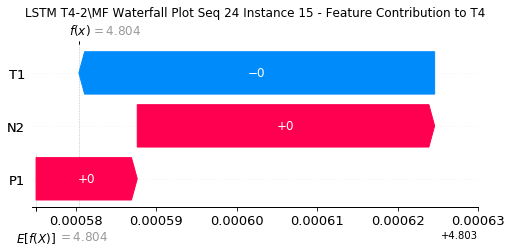

None

Contribution: [ 1.42272660e-05 -4.34719769e-05  3.50035598e-05]


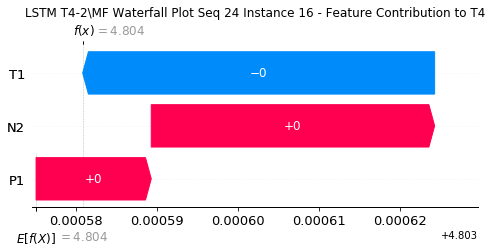

None

Contribution: [ 9.90374614e-06 -4.49490788e-05  3.43592293e-05]


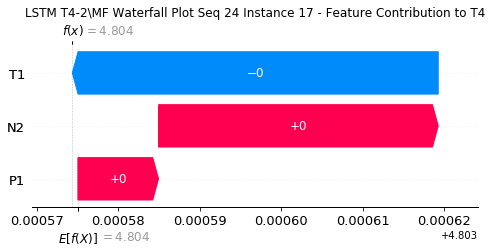

None

Contribution: [ 1.45441220e-05 -3.86619555e-05  3.23749373e-05]


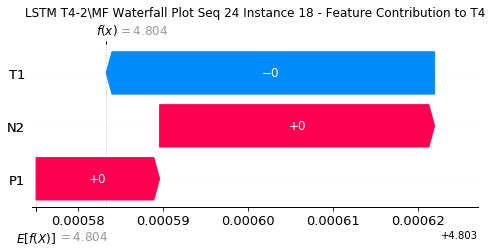

None

Contribution: [ 1.39282197e-05 -4.44030565e-05  3.37649389e-05]


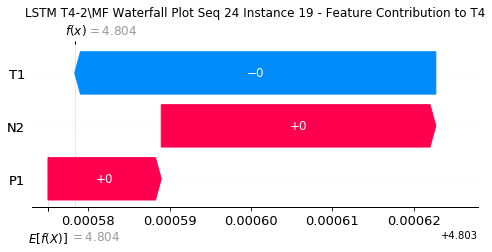

None

Contribution: [ 1.27482369e-05 -4.34014710e-05  3.40156172e-05]


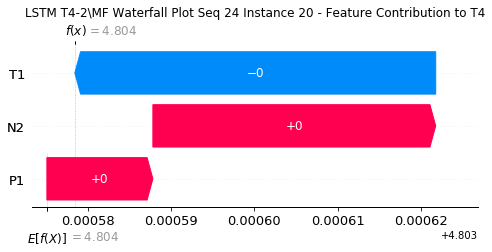

None

Contribution: [ 1.15090636e-05 -4.65454364e-05  3.61309720e-05]


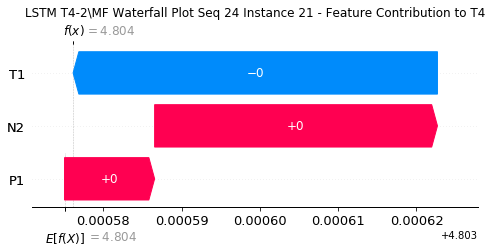

None

Contribution: [ 1.94235843e-05 -6.75192125e-05  4.51505908e-05]


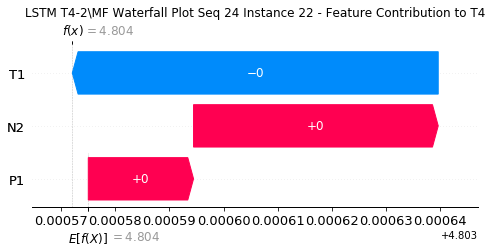

None

Contribution: [ 5.98908185e-05 -1.79627885e-04  1.26847173e-04]


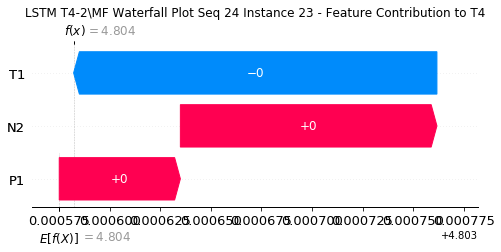

None

Contribution: [ 0.00025917 -0.00183434  0.0012957 ]


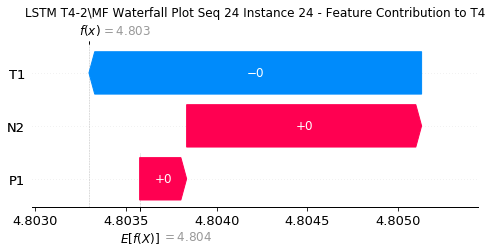

None

Contribution: [ 0.00048953 -0.00319024  0.00245735]


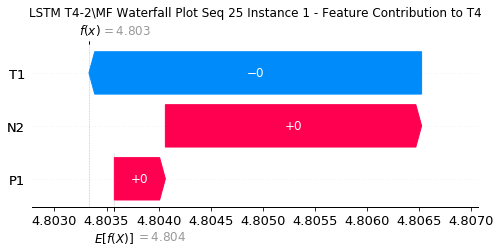

None

Contribution: [ 0.00044897 -0.00097836  0.00134076]


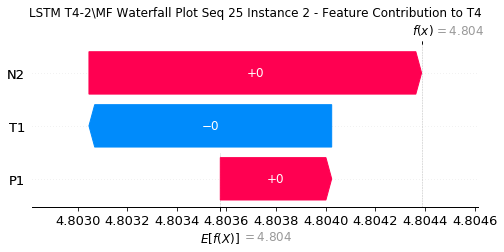

None

Contribution: [ 8.36566327e-05 -1.63776458e-04  2.39584333e-04]


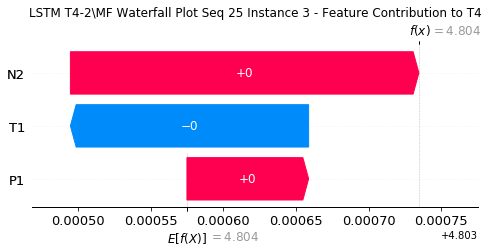

None

Contribution: [ 1.92358620e-05 -5.01913061e-05  4.80031085e-05]


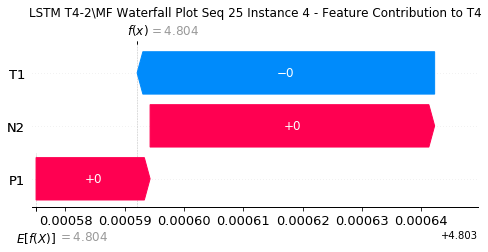

None

Contribution: [ 1.53847695e-05 -4.50634656e-05  3.94098572e-05]


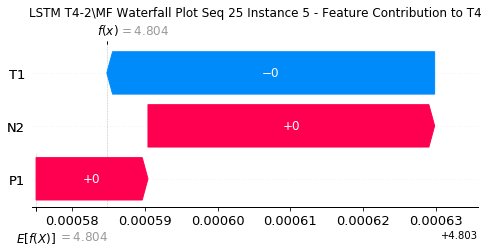

None

Contribution: [ 5.75398543e-06 -4.85004609e-05  3.49587444e-05]


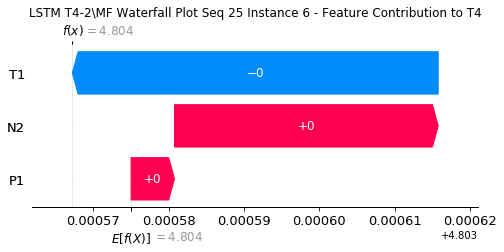

None

Contribution: [ 9.87326317e-06 -4.09489628e-05  3.71575398e-05]


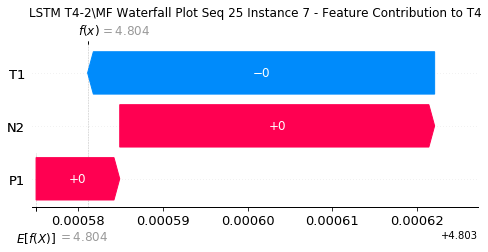

None

Contribution: [ 9.61889642e-06 -4.19267117e-05  3.65867171e-05]


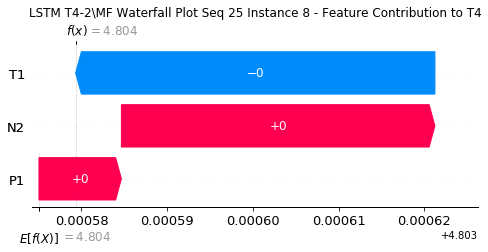

None

Contribution: [ 9.14228306e-06 -3.94803333e-05  3.62298428e-05]


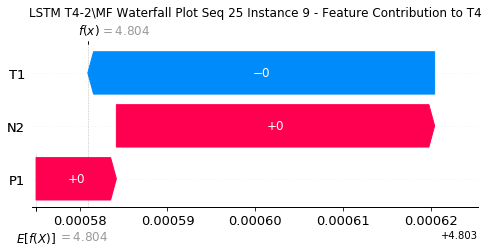

None

Contribution: [ 1.21973478e-05 -4.02993583e-05  3.63274145e-05]


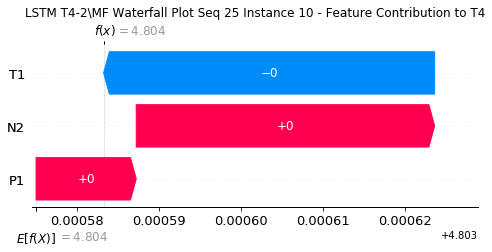

None

Contribution: [ 1.03791217e-05 -4.38626671e-05  3.40692577e-05]


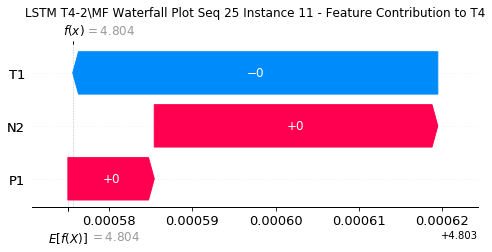

None

Contribution: [ 9.70481251e-06 -4.53558556e-05  3.46633262e-05]


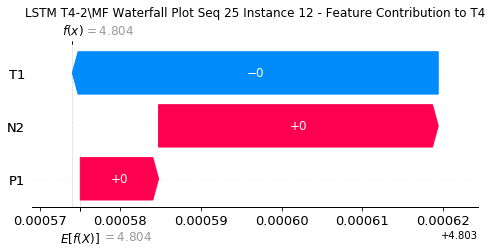

None

Contribution: [ 6.85382166e-06 -4.46263790e-05  3.35340217e-05]


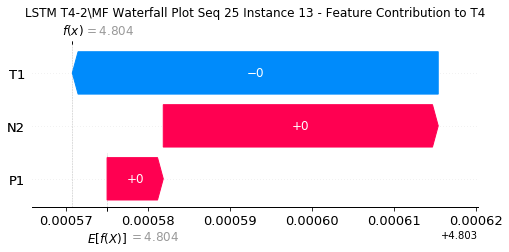

None

Contribution: [ 7.17150677e-06 -4.28221269e-05  3.52235987e-05]


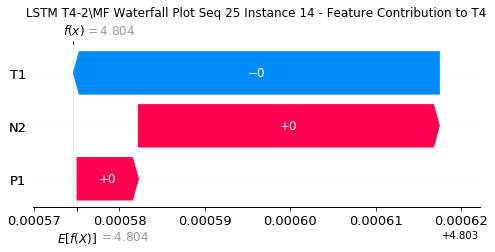

None

Contribution: [ 1.50980846e-05 -4.28111000e-05  3.51287964e-05]


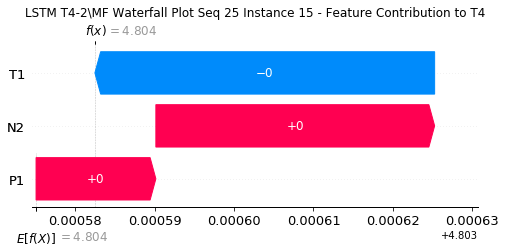

None

Contribution: [ 9.51046588e-06 -4.13269189e-05  3.38037977e-05]


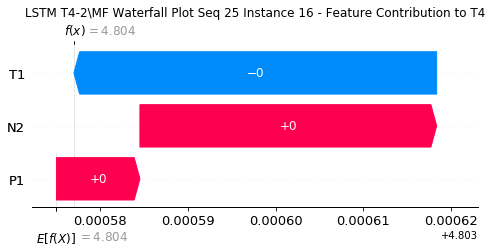

None

Contribution: [ 7.11660944e-06 -4.19560483e-05  3.41750613e-05]


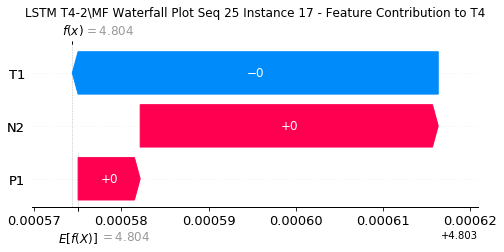

None

Contribution: [ 1.42211053e-05 -3.27590422e-05  3.48451071e-05]


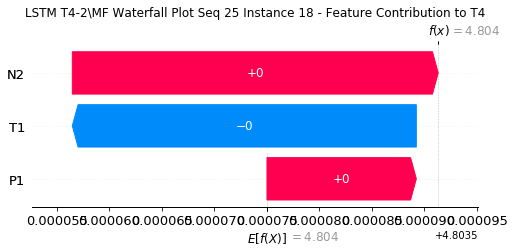

None

Contribution: [ 1.18502318e-05 -3.76696979e-05  3.45752708e-05]


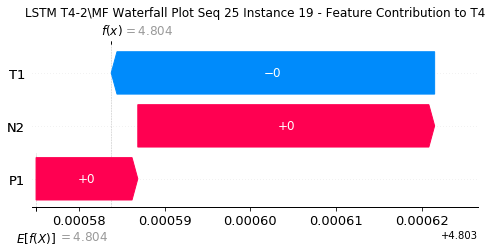

None

Contribution: [ 1.15257455e-05 -3.65305990e-05  3.52809864e-05]


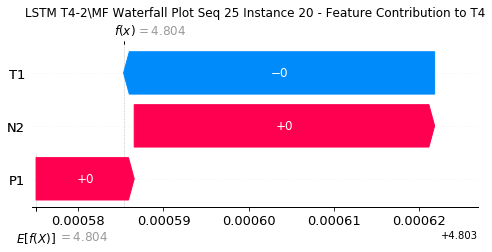

None

Contribution: [ 9.83313772e-06 -3.86375754e-05  3.74800703e-05]


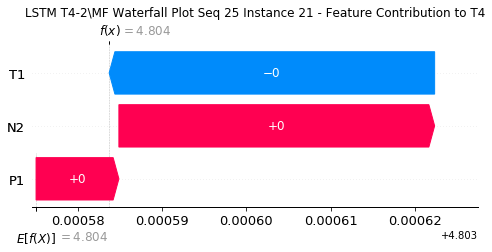

None

Contribution: [ 1.71894256e-05 -5.94141669e-05  4.68639759e-05]


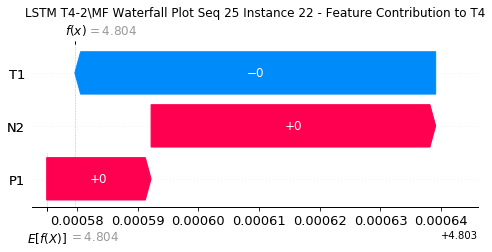

None

Contribution: [ 5.33478134e-05 -1.37764441e-04  1.31591580e-04]


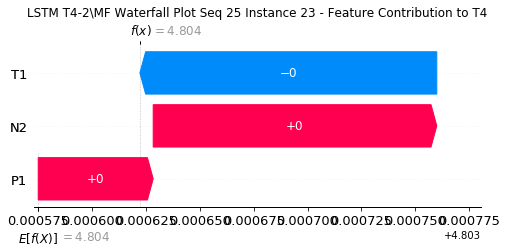

None

Contribution: [ 0.0004614  -0.00112681  0.00139669]


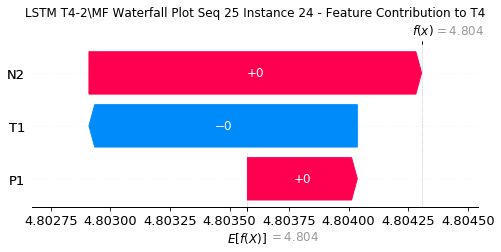

None

Contribution: [ 0.00110654 -0.00238841  0.00278514]


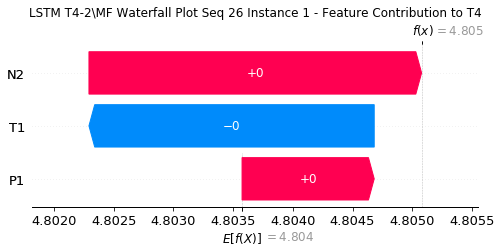

None

Contribution: [ 0.00052944 -0.00068997  0.00138776]


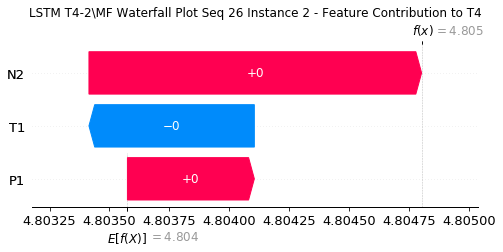

None

Contribution: [ 9.31230593e-05 -1.06055231e-04  2.42274046e-04]


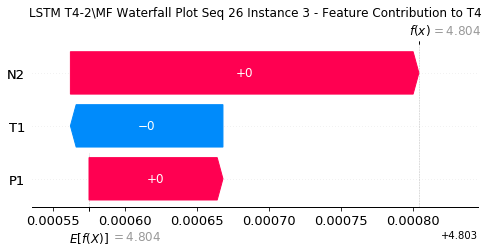

None

Contribution: [ 1.16845587e-05 -4.12602988e-05  4.62865568e-05]


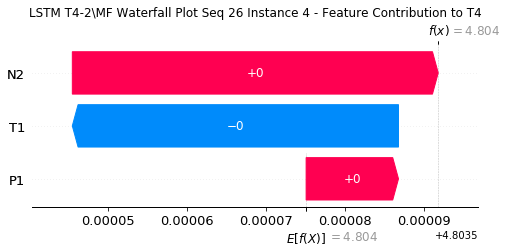

None

Contribution: [ 1.05530359e-05 -3.76656227e-05  3.83883189e-05]


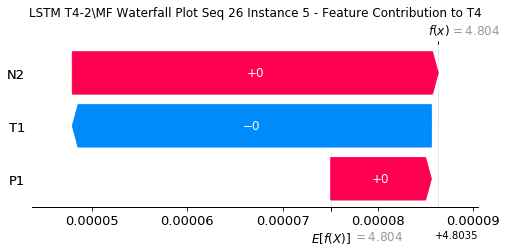

None

Contribution: [ 1.26426150e-05 -3.43467722e-05  3.72773538e-05]


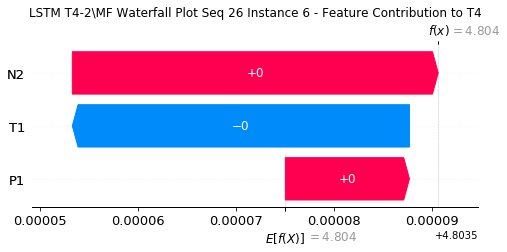

None

Contribution: [ 6.72840372e-06 -3.57072772e-05  3.63998354e-05]


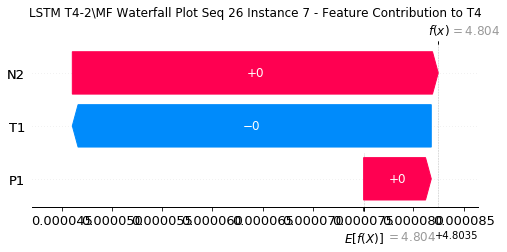

None

Contribution: [ 1.00507014e-05 -3.74489111e-05  3.72113856e-05]


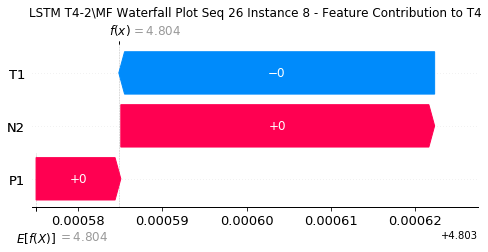

None

Contribution: [ 1.67869272e-05 -3.61405036e-05  3.87754886e-05]


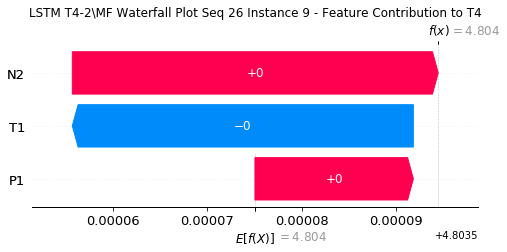

None

Contribution: [ 1.35355204e-05 -3.55383944e-05  3.73221423e-05]


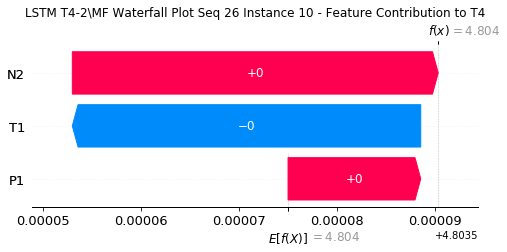

None

Contribution: [ 1.02944455e-05 -3.92924140e-05  3.44716028e-05]


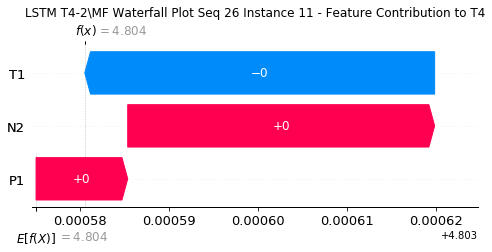

None

Contribution: [ 9.33359862e-06 -4.17723899e-05  3.48414291e-05]


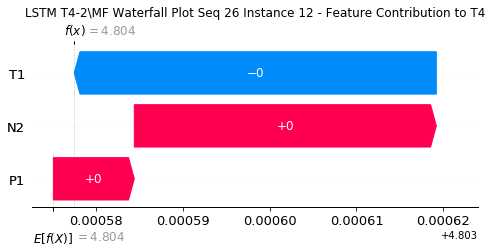

None

Contribution: [ 1.41272415e-05 -3.23554410e-05  3.53647446e-05]


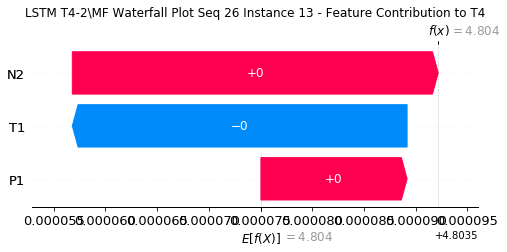

None

Contribution: [ 7.79572483e-06 -3.99469682e-05  3.56319951e-05]


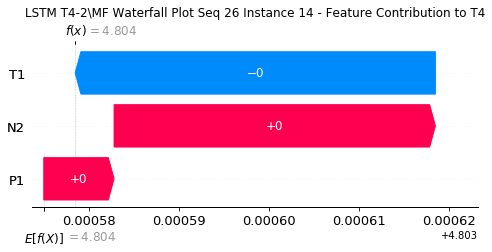

None

Contribution: [ 1.20169283e-05 -3.86262439e-05  3.37576455e-05]


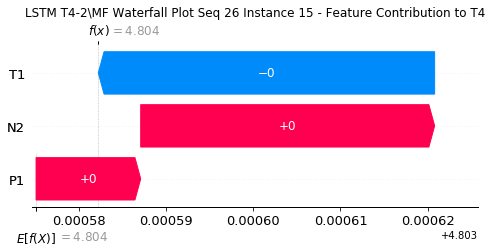

None

Contribution: [ 1.12440552e-05 -4.02954842e-05  3.43441942e-05]


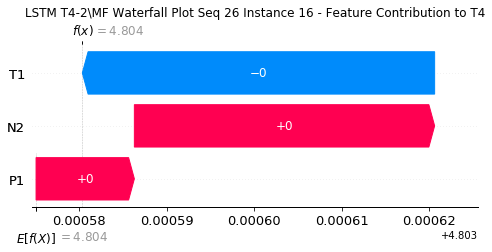

None

Contribution: [ 8.33514585e-06 -4.33654136e-05  3.41304865e-05]


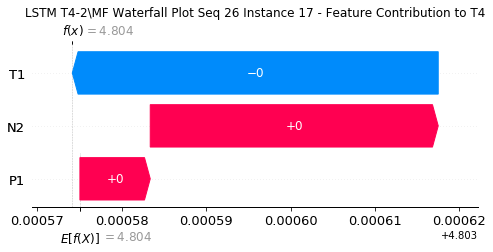

None

Contribution: [ 1.16444855e-05 -4.00649415e-05  3.26336801e-05]


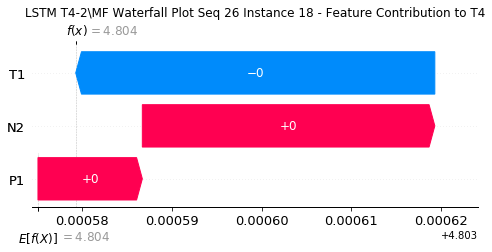

None

Contribution: [ 1.14841542e-05 -4.28771382e-05  3.35422240e-05]


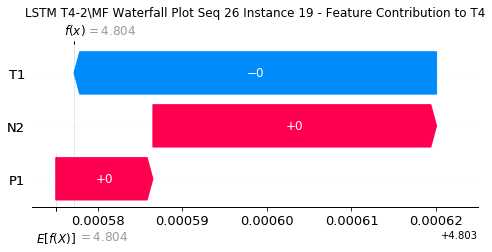

None

Contribution: [ 1.10331854e-05 -4.32151510e-05  3.39837652e-05]


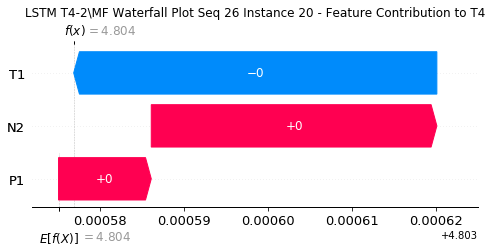

None

Contribution: [ 8.92289464e-06 -4.69557762e-05  3.59346627e-05]


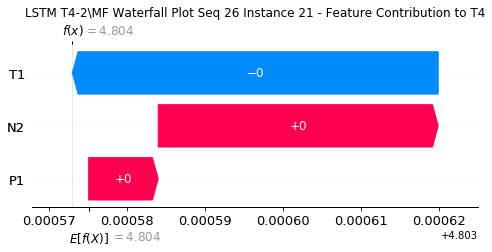

None

Contribution: [ 1.82602030e-05 -7.16997412e-05  4.53927679e-05]


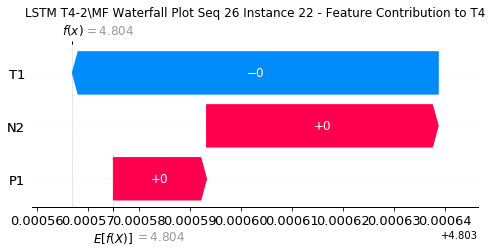

None

Contribution: [ 6.04719338e-05 -1.65166266e-04  1.29274115e-04]


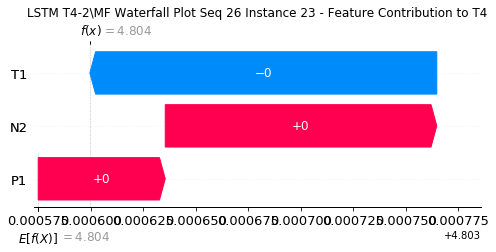

None

Contribution: [ 0.00046927 -0.00135976  0.00138179]


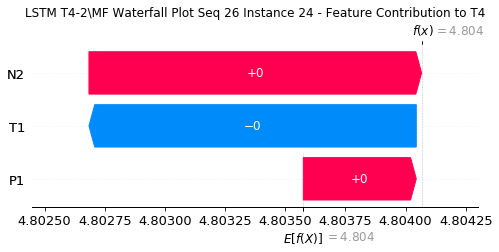

None

Contribution: [ 0.00066124 -0.00374745  0.00255218]


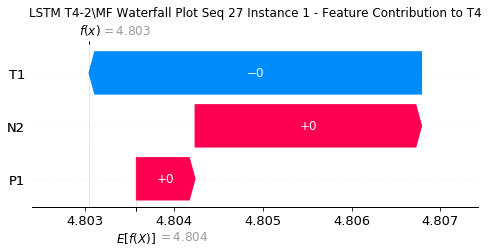

None

Contribution: [ 0.0003963  -0.00102734  0.00134713]


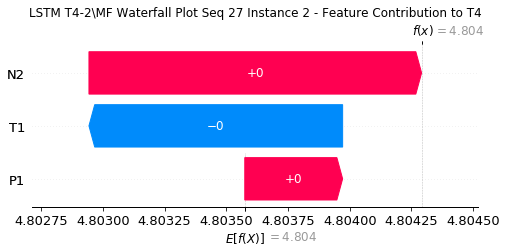

None

Contribution: [ 7.98673057e-05 -1.36402983e-04  2.41283037e-04]


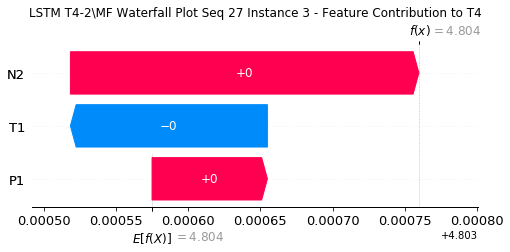

None

Contribution: [ 1.66186635e-05 -4.58469546e-05  4.59585985e-05]


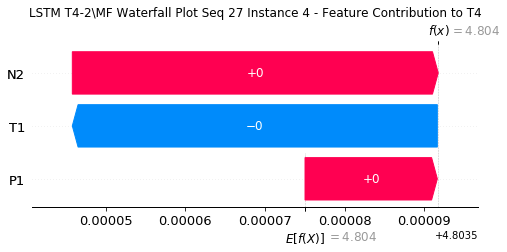

None

Contribution: [ 1.36750889e-05 -4.07479625e-05  3.79424573e-05]


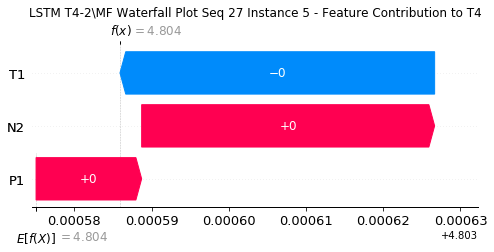

None

Contribution: [ 1.12699679e-05 -4.04463672e-05  3.56464180e-05]


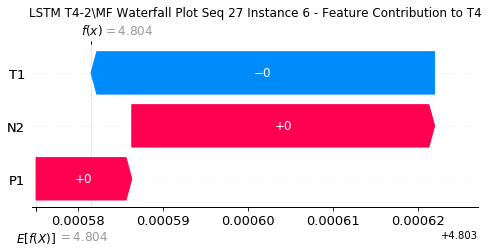

None

Contribution: [ 7.87450642e-06 -3.85202051e-05  3.56271562e-05]


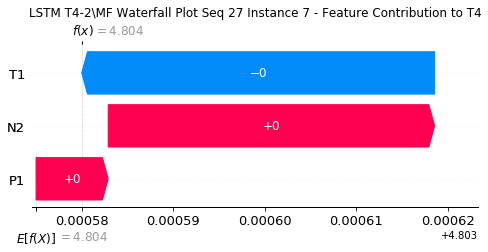

None

Contribution: [ 7.33615985e-06 -4.25113670e-05  3.49493594e-05]


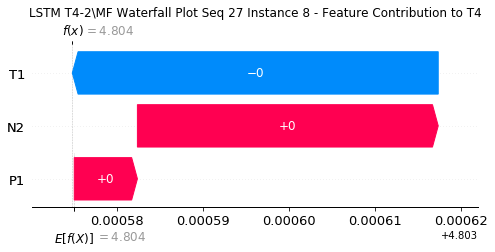

None

Contribution: [ 3.36243082e-06 -5.63169654e-05  3.32300205e-05]


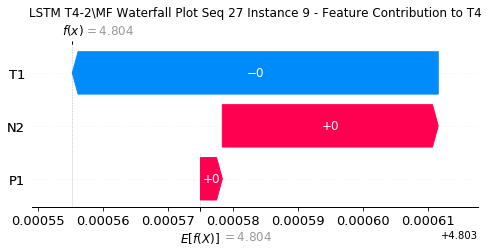

None

Contribution: [ 5.69906779e-06 -4.15072832e-05  3.44792212e-05]


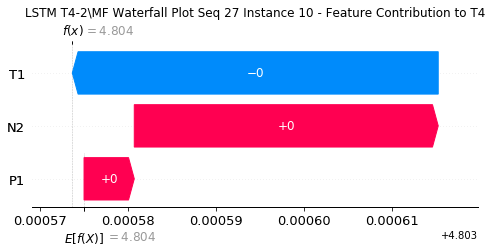

None

Contribution: [ 1.18618282e-05 -3.79096423e-05  3.37966664e-05]


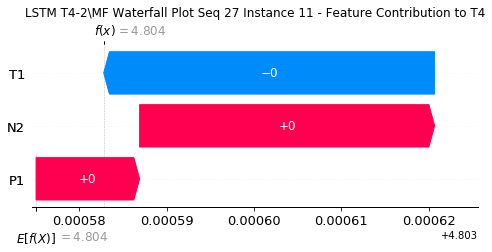

None

Contribution: [ 1.13404934e-05 -4.01082144e-05  3.41817505e-05]


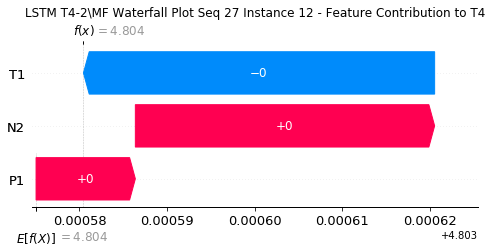

None

Contribution: [ 9.41262634e-06 -3.64249943e-05  3.18770992e-05]


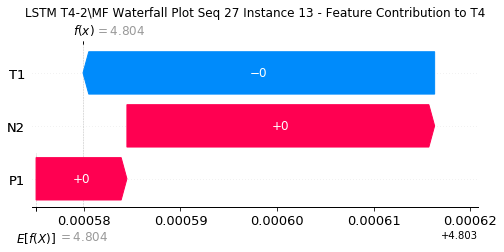

None

Contribution: [ 7.68875364e-06 -3.77936481e-05  3.44501546e-05]


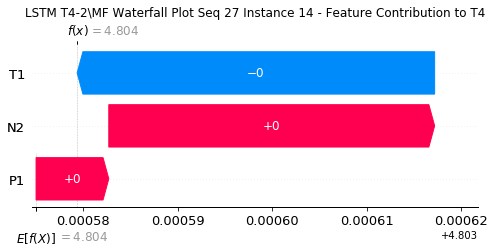

None

Contribution: [ 1.10561741e-05 -3.98667725e-05  3.18355543e-05]


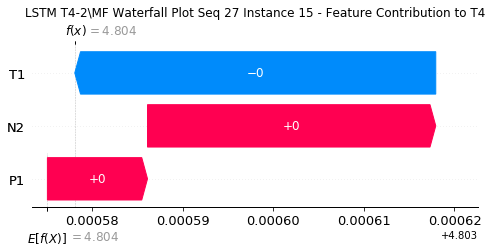

None

Contribution: [ 1.02348123e-05 -3.73718411e-05  3.29576821e-05]


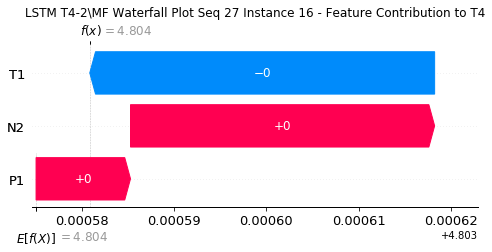

None

Contribution: [ 6.23200308e-06 -4.03019364e-05  3.27556940e-05]


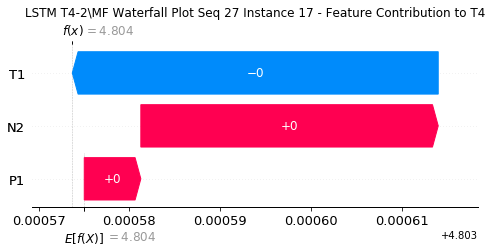

None

Contribution: [ 1.31085645e-05 -3.21158006e-05  3.43639141e-05]


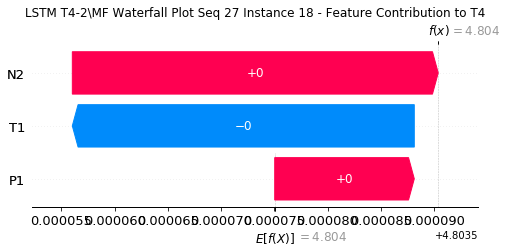

None

Contribution: [ 7.57001005e-06 -3.99671543e-05  3.16697490e-05]


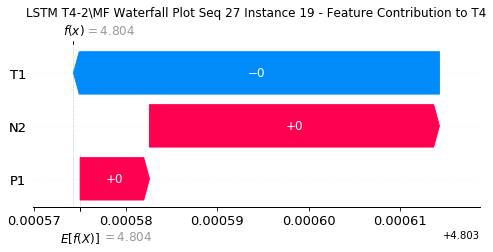

None

Contribution: [ 6.30036922e-06 -3.99914484e-05  3.19810583e-05]


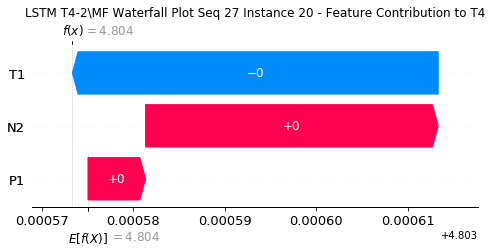

None

Contribution: [ 2.58121614e-06 -4.32013755e-05  3.34218198e-05]


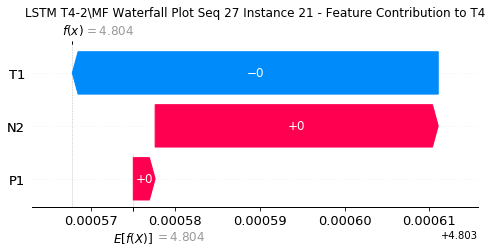

None

Contribution: [ 7.28404171e-06 -6.52624635e-05  4.17367755e-05]


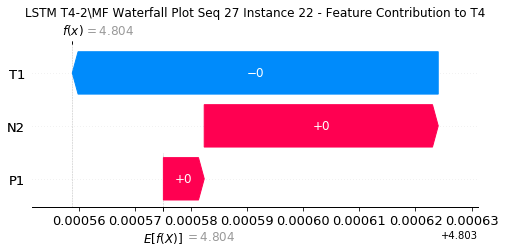

None

Contribution: [ 1.08199028e-05 -1.61570205e-04  1.12963960e-04]


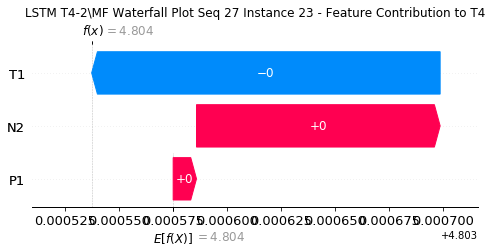

None

Contribution: [ 0.00047945 -0.00131229  0.00131112]


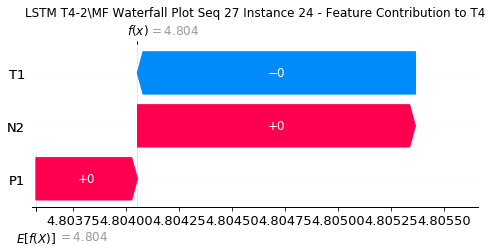

None

Contribution: [ 0.00148759 -0.00289754  0.0027119 ]


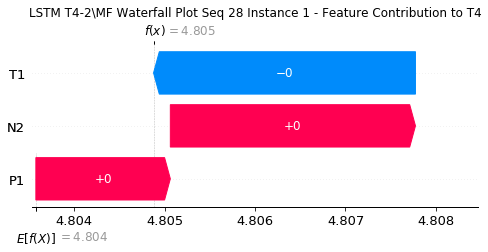

None

Contribution: [ 0.00065579 -0.0007605   0.00136482]


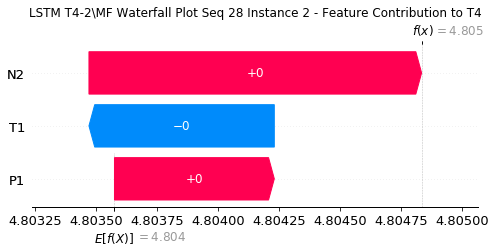

None

Contribution: [ 0.00010754 -0.00010854  0.0002429 ]


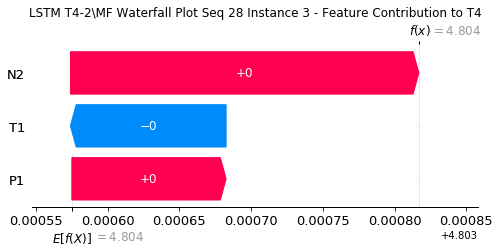

None

Contribution: [ 2.01958060e-05 -2.15127426e-05  4.82741724e-05]


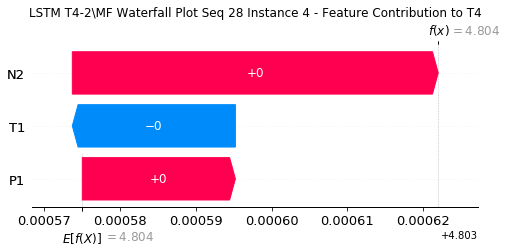

None

Contribution: [ 1.49793750e-05 -2.48375863e-05  3.92604055e-05]


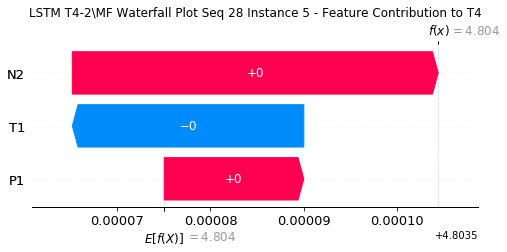

None

Contribution: [ 2.06124326e-05 -1.71378006e-05  3.91472153e-05]


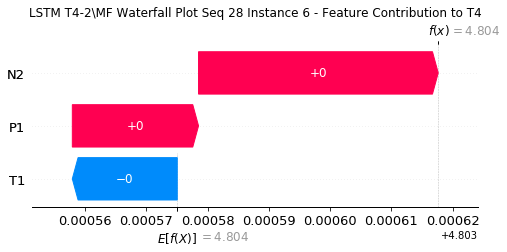

None

Contribution: [ 1.14689181e-05 -3.22440544e-05  3.70291488e-05]


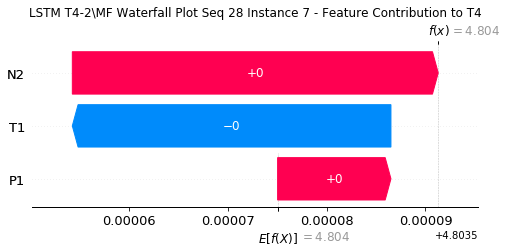

None

Contribution: [ 1.29763597e-05 -3.90858624e-05  3.59630616e-05]


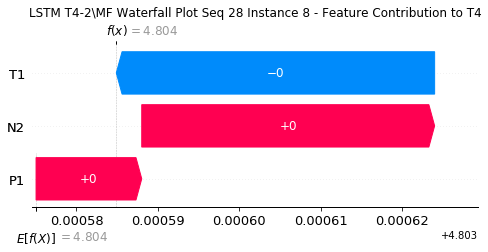

None

Contribution: [ 1.21044140e-05 -4.01126225e-05  3.65348898e-05]


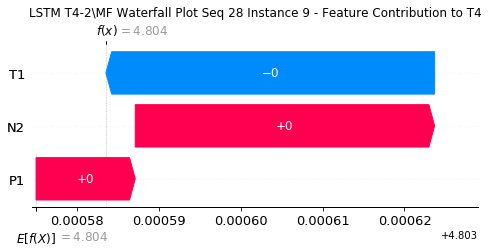

None

Contribution: [ 9.38620219e-06 -4.39525411e-05  3.54504616e-05]


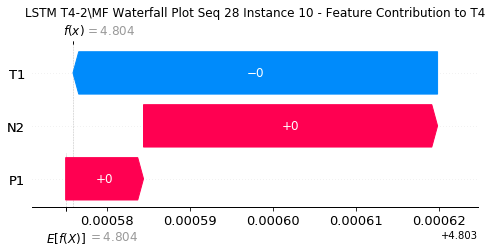

None

Contribution: [ 1.58206045e-05 -3.74770936e-05  3.53057026e-05]


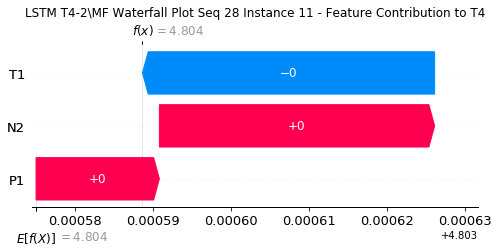

None

Contribution: [ 1.71878226e-05 -4.39921183e-05  3.58669455e-05]


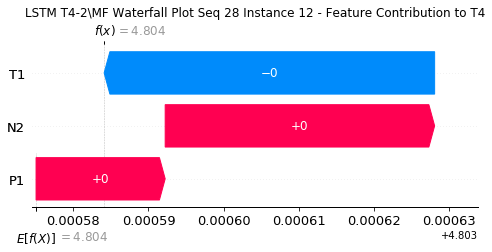

None

Contribution: [ 6.16505061e-06 -4.25045502e-05  3.24470872e-05]


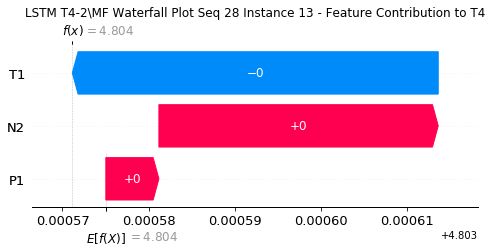

None

Contribution: [ 1.89701496e-05 -5.45086770e-05  3.73374128e-05]


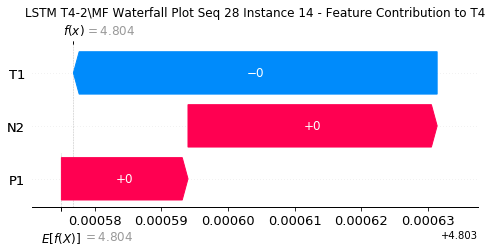

None

Contribution: [ 1.18385356e-05 -6.41560113e-05  3.36353828e-05]


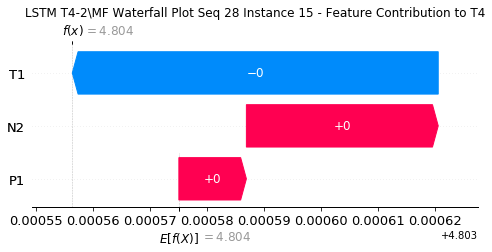

None

Contribution: [ 2.51336320e-05 -6.87141731e-05  3.59580687e-05]


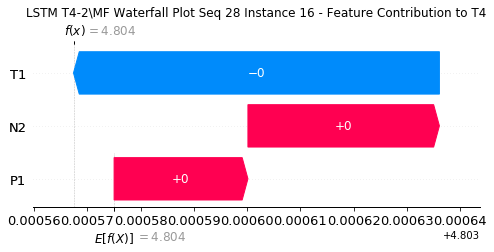

None

Contribution: [ 2.15412010e-05 -8.28631731e-05  3.52908268e-05]


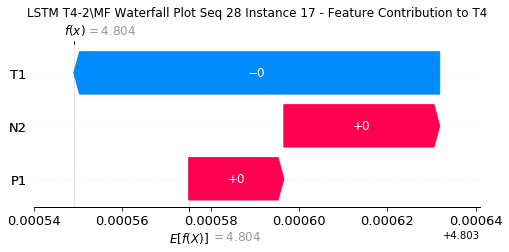

None

Contribution: [ 3.35067433e-06 -5.62335185e-05  3.00412926e-05]


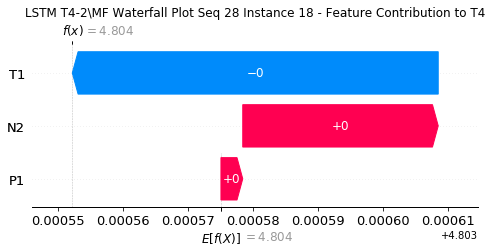

None

Contribution: [ 3.65046364e-05 -1.07392240e-04  3.68918631e-05]


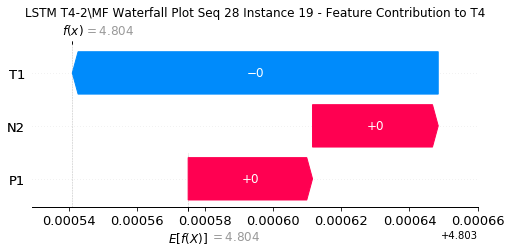

None

Contribution: [ 3.68443899e-05 -1.15531090e-04  3.74469170e-05]


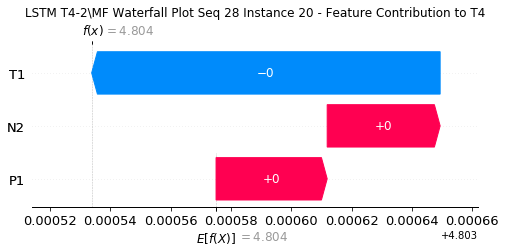

None

Contribution: [ 4.15620734e-05 -1.32685922e-04  4.11081075e-05]


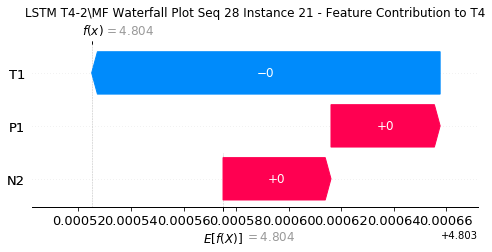

None

Contribution: [ 5.60745894e-05 -1.98957086e-04  5.07014531e-05]


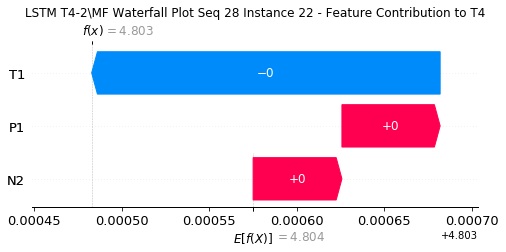

None

Contribution: [ 0.0001926  -0.00058751  0.00014972]


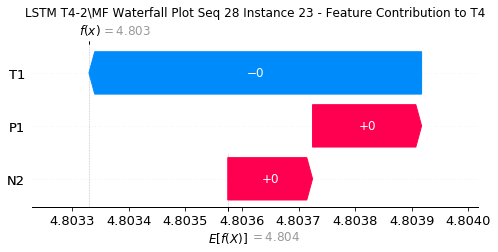

None

Contribution: [ 0.0016628  -0.0049392   0.00160474]


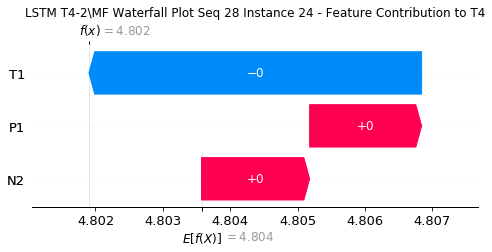

None

Contribution: [ 0.00298241 -0.01077472  0.00289387]


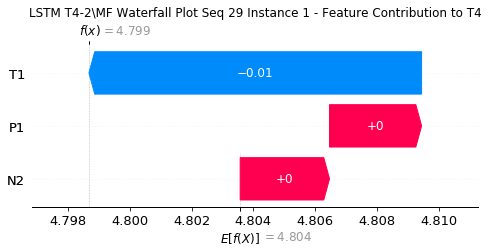

None

Contribution: [ 0.00168704 -0.00351118  0.00157766]


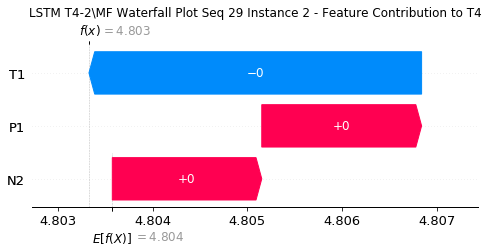

None

Contribution: [ 0.00026484 -0.00057075  0.00027066]


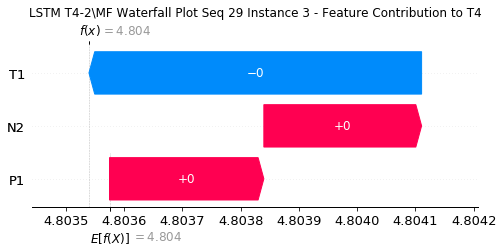

None

Contribution: [ 6.19347955e-05 -1.73870459e-04  5.39387410e-05]


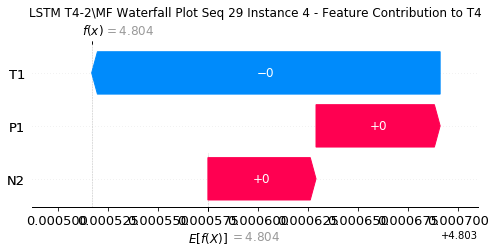

None

Contribution: [ 5.24609217e-05 -1.45820630e-04  4.47290301e-05]


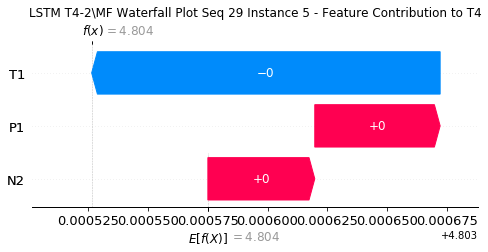

None

Contribution: [ 2.60032577e-05 -1.35066497e-04  3.74275710e-05]


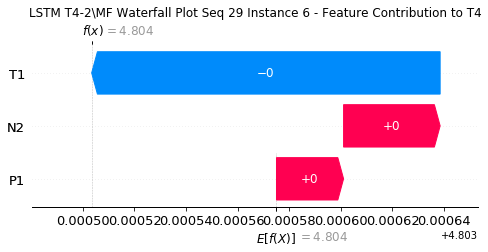

None

Contribution: [ 3.99808600e-05 -1.26836108e-04  4.16133457e-05]


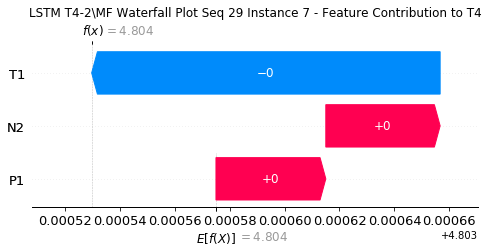

None

Contribution: [ 4.00711660e-05 -1.32753516e-04  4.11391658e-05]


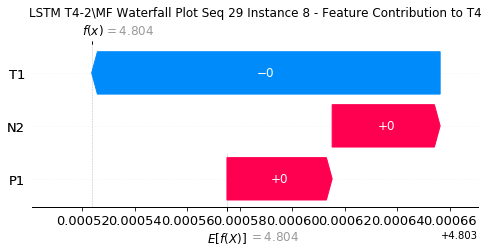

None

Contribution: [ 5.23924857e-05 -1.25819215e-04  4.44898359e-05]


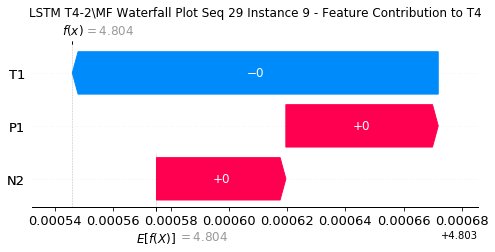

None

Contribution: [ 5.28039197e-05 -1.26147068e-04  4.29919709e-05]


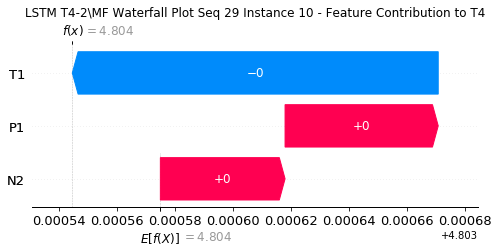

None

Contribution: [ 4.38504234e-05 -1.21344748e-04  3.95060618e-05]


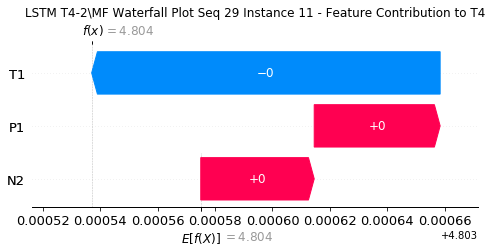

None

Contribution: [ 3.92053134e-05 -1.20217540e-04  3.94200014e-05]


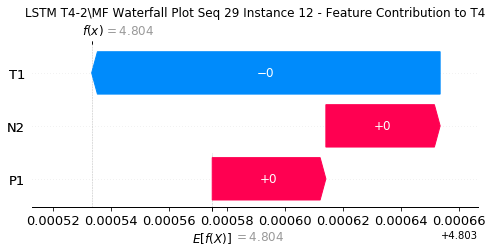

None

Contribution: [ 4.55779737e-05 -1.27161765e-04  4.06740530e-05]


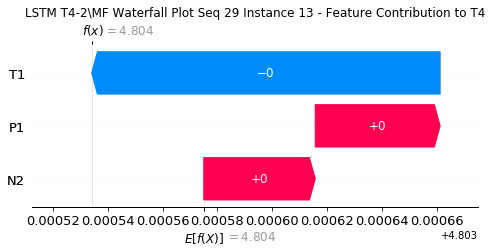

None

Contribution: [ 3.37158528e-05 -1.09001220e-04  3.96785091e-05]


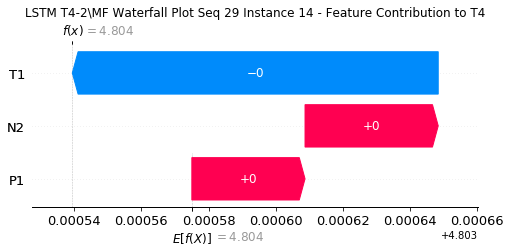

None

Contribution: [ 2.10028503e-05 -7.67334673e-05  3.36561181e-05]


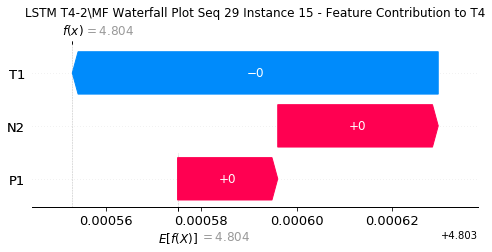

None

Contribution: [ 2.86055245e-05 -9.37038530e-05  3.70452241e-05]


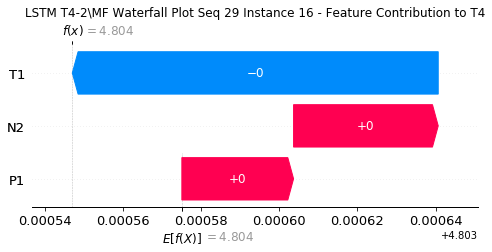

None

Contribution: [ 2.07460152e-05 -8.51957156e-05  3.65246633e-05]


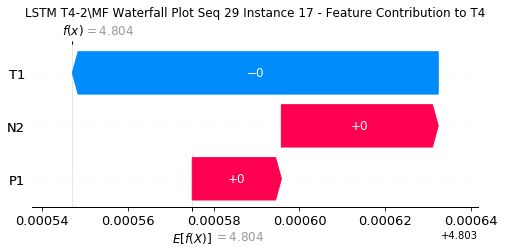

None

Contribution: [ 2.08113011e-07 -6.04635683e-05  3.09802729e-05]


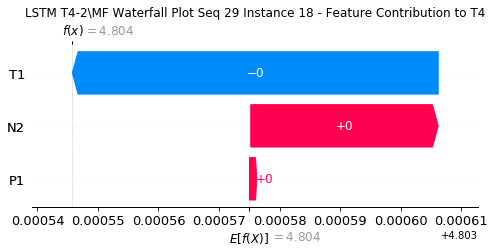

None

Contribution: [ 1.05793369e-05 -6.80812529e-05  3.45176445e-05]


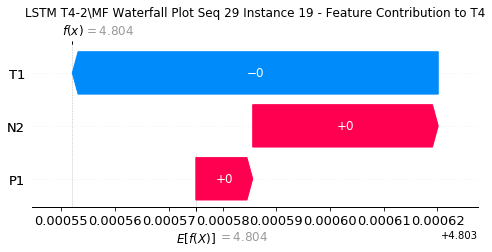

None

Contribution: [ 8.80587479e-06 -6.36929226e-05  3.51177186e-05]


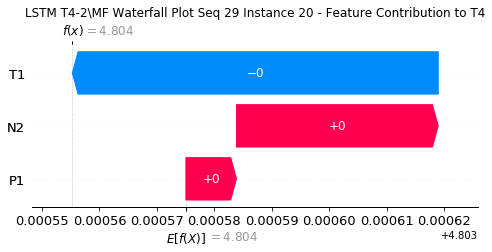

None

Contribution: [ 6.18420443e-06 -6.76684219e-05  3.74419331e-05]


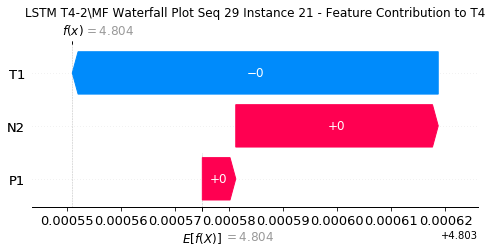

None

Contribution: [ 1.49830127e-05 -9.30499165e-05  4.72334201e-05]


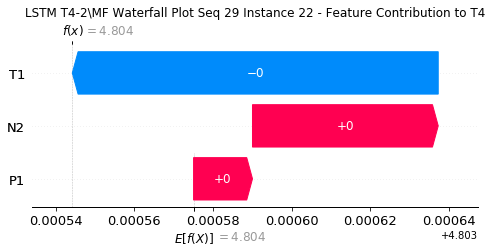

None

Contribution: [ 1.38744736e-05 -2.49175496e-04  1.25890713e-04]


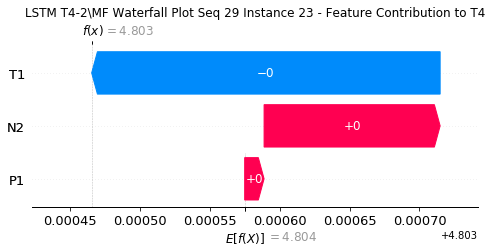

None

Contribution: [-0.00016891 -0.00285404  0.00127406]


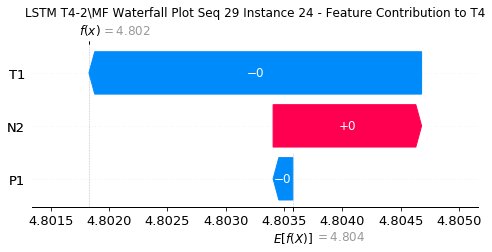

None

Contribution: [ 0.00076359 -0.0033736   0.00276632]


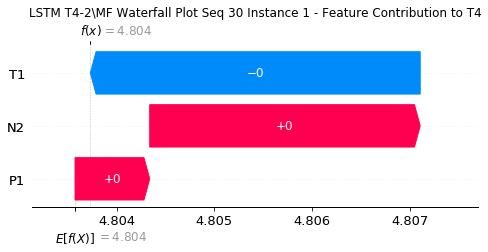

None

Contribution: [ 0.00054222 -0.00124431  0.00141346]


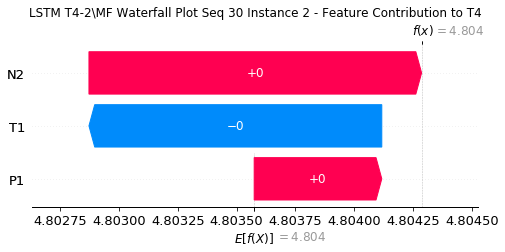

None

Contribution: [ 0.00010359 -0.00010533  0.00024467]


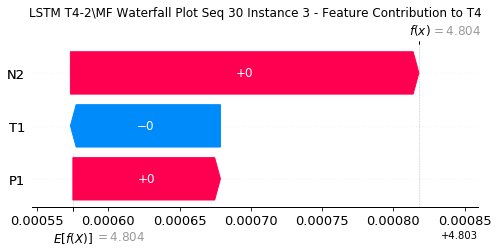

None

Contribution: [ 1.38596181e-05 -3.50283331e-05  4.65482210e-05]


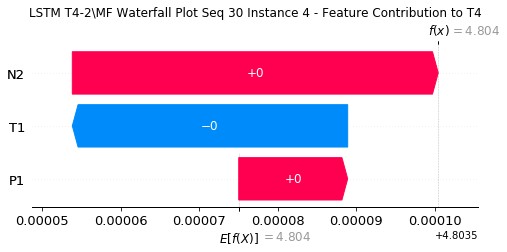

None

Contribution: [ 1.11915544e-05 -3.53589748e-05  3.80299040e-05]


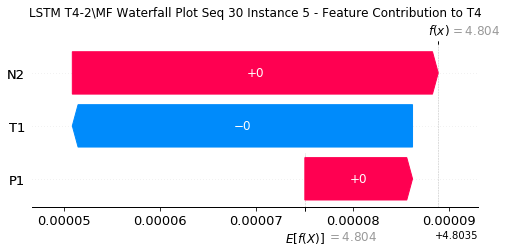

None

Contribution: [ 1.38859864e-05 -4.03338517e-05  3.67603928e-05]


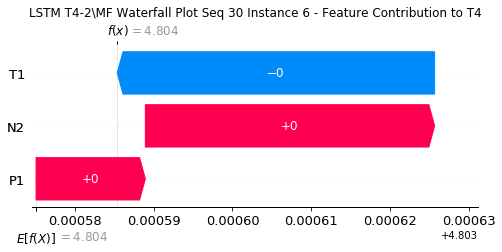

None

Contribution: [ 6.81481121e-06 -3.51890106e-05  3.61913050e-05]


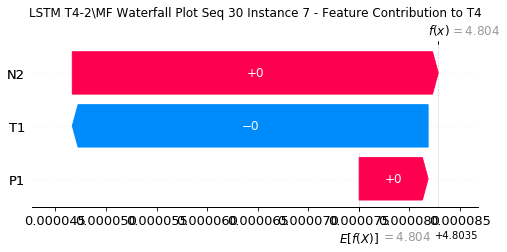

None

Contribution: [ 7.05861240e-06 -4.51943445e-05  3.51855781e-05]


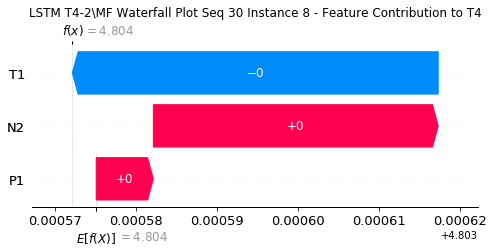

None

Contribution: [ 4.43794551e-06 -4.90795406e-05  3.53990964e-05]


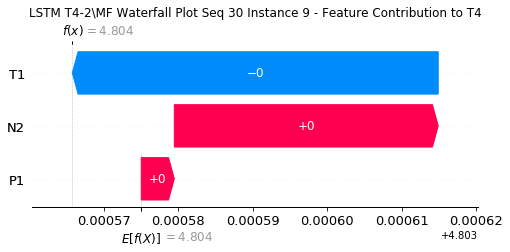

None

Contribution: [ 7.42899903e-06 -4.87441705e-05  3.48124087e-05]


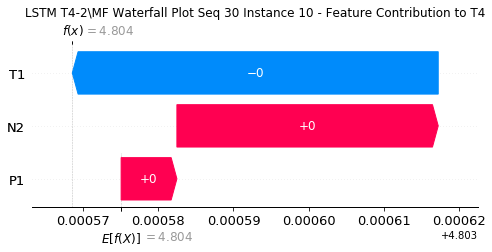

None

Contribution: [ 8.85973201e-06 -4.59290269e-05  3.35865838e-05]


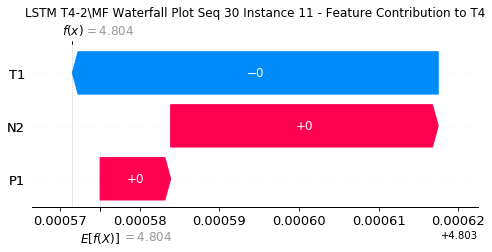

None

Contribution: [ 8.33044972e-06 -4.68194773e-05  3.41543364e-05]


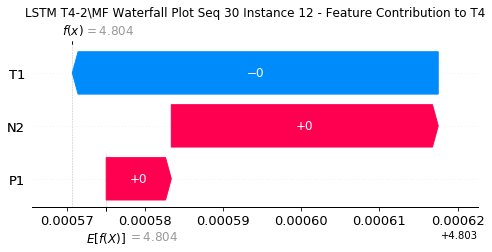

None

Contribution: [ 7.37591539e-06 -5.00741808e-05  3.20426462e-05]


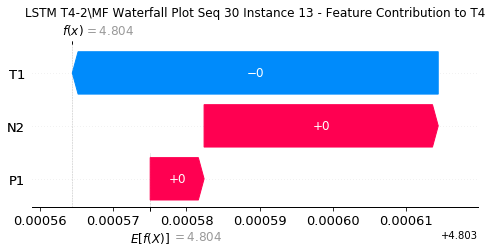

None

Contribution: [ 5.52560517e-06 -4.67143339e-05  3.47484748e-05]


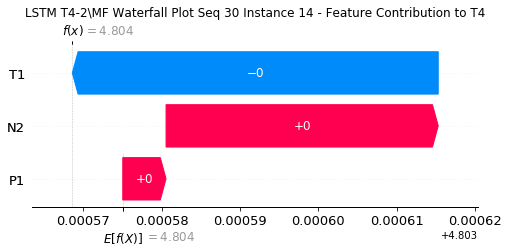

None

Contribution: [ 1.12429299e-05 -4.12055287e-05  3.32414840e-05]


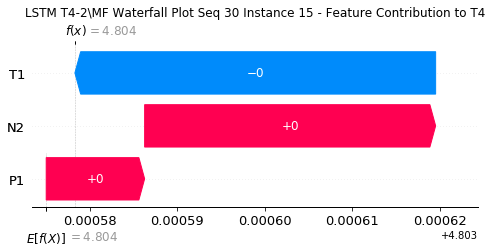

None

Contribution: [ 8.46519736e-06 -4.66361537e-05  3.32944910e-05]


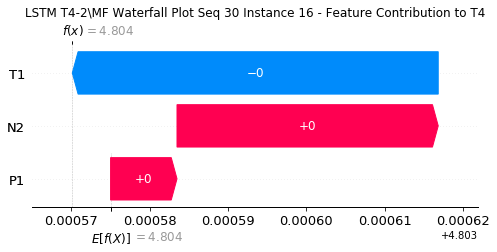

None

Contribution: [ 5.93035517e-06 -4.77481399e-05  3.37149179e-05]


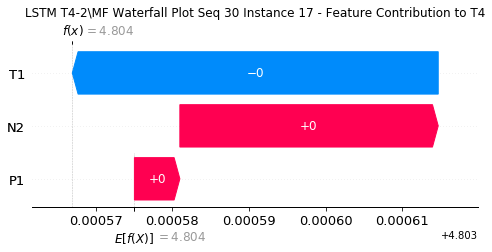

None

Contribution: [ 1.05766773e-05 -4.97210735e-05  3.17431377e-05]


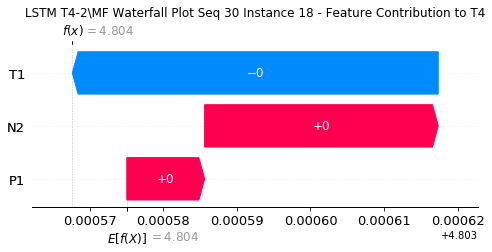

None

Contribution: [ 9.68165156e-06 -4.15758521e-05  3.42947415e-05]


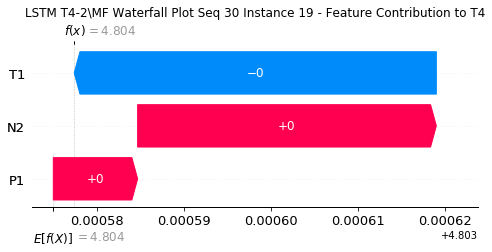

None

Contribution: [ 9.43242606e-06 -4.13879601e-05  3.53112791e-05]


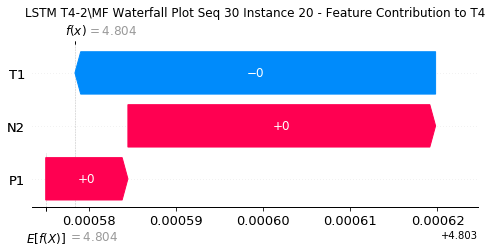

None

Contribution: [ 6.61771906e-06 -4.53278846e-05  3.77642558e-05]


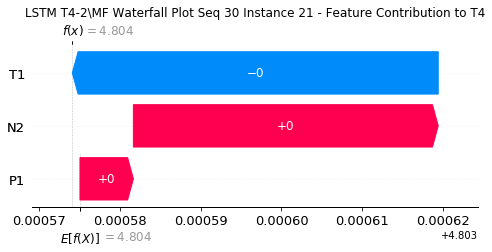

None

Contribution: [ 1.33079350e-05 -7.48268639e-05  4.71066101e-05]


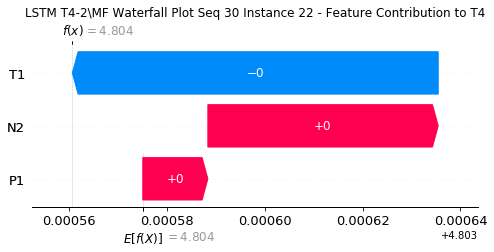

None

Contribution: [ 3.12956835e-05 -1.66490705e-04  1.28194090e-04]


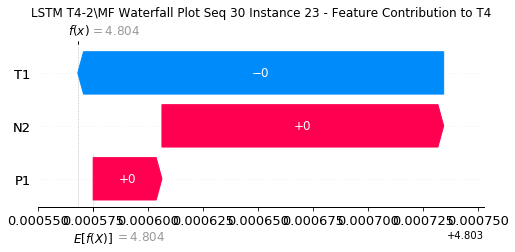

None

Contribution: [ 0.00019545 -0.00127619  0.00139238]


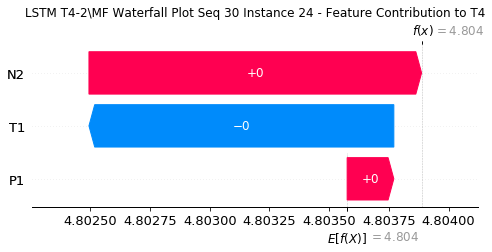

None

Contribution: [ 0.00096714 -0.00334937  0.0030504 ]


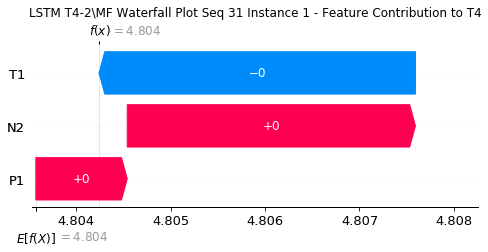

None

Contribution: [ 0.0003849  -0.00101206  0.00145982]


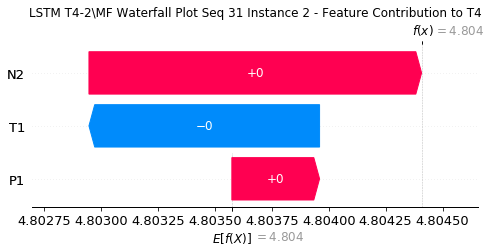

None

Contribution: [ 5.22936717e-05 -1.36700366e-04  2.41043456e-04]


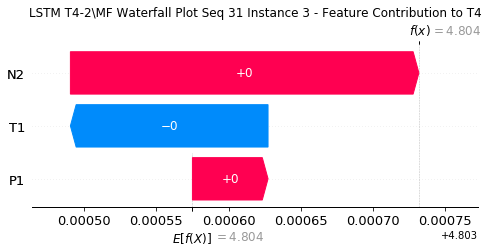

None

Contribution: [ 2.01342161e-05 -3.86619128e-05  5.18454600e-05]


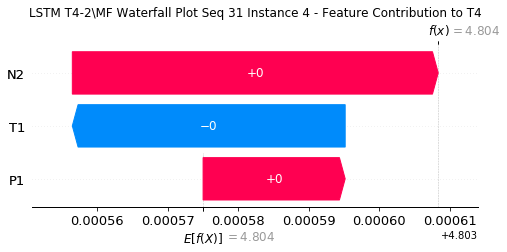

None

Contribution: [ 1.62226745e-05 -3.63896933e-05  4.23251570e-05]


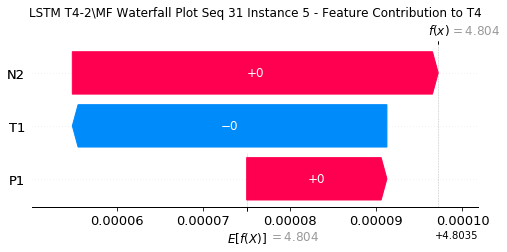

None

Contribution: [ 1.49537272e-05 -3.34311699e-05  3.80027185e-05]


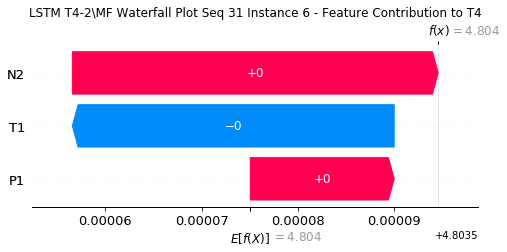

None

Contribution: [ 9.71698933e-06 -3.56896727e-05  3.90279368e-05]


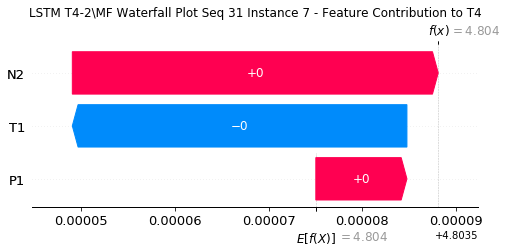

None

Contribution: [ 5.50332134e-06 -4.53928285e-05  3.56319462e-05]


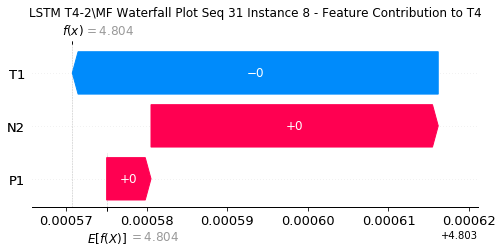

None

Contribution: [ 1.76564488e-06 -4.40261638e-05  3.41226843e-05]


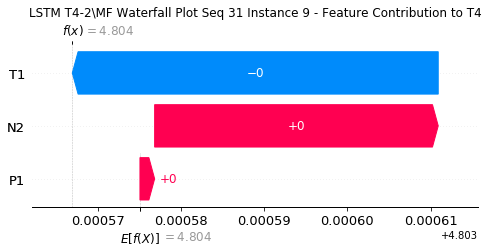

None

Contribution: [ 5.78609184e-06 -4.69375273e-05  3.62439144e-05]


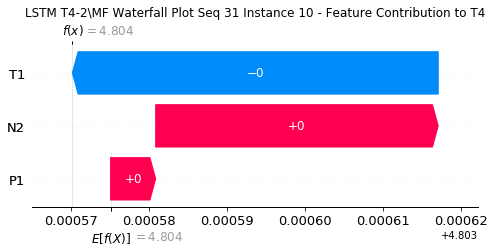

None

Contribution: [ 1.31589647e-05 -3.98513658e-05  3.62810827e-05]


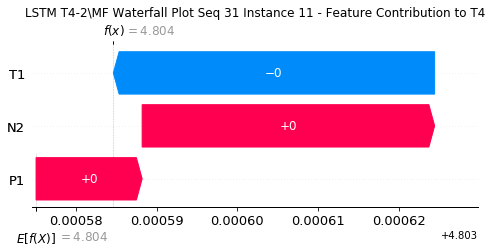

None

Contribution: [ 1.23009391e-05 -4.21090670e-05  3.64181124e-05]


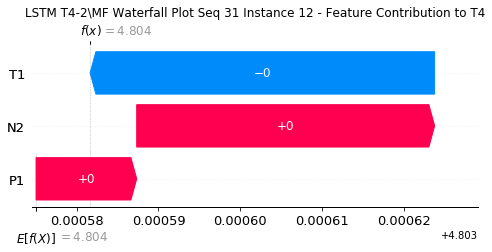

None

Contribution: [ 1.25254842e-05 -4.30622080e-05  3.56194081e-05]


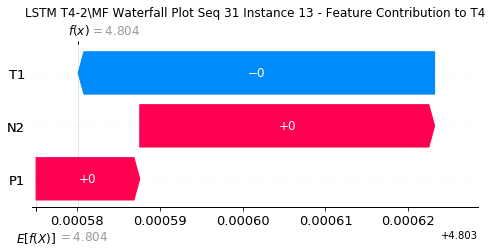

None

Contribution: [ 9.22157926e-06 -4.35786568e-05  3.68454060e-05]


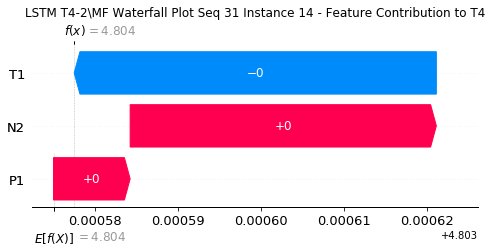

None

Contribution: [ 8.19844817e-06 -4.59968119e-05  3.54943668e-05]


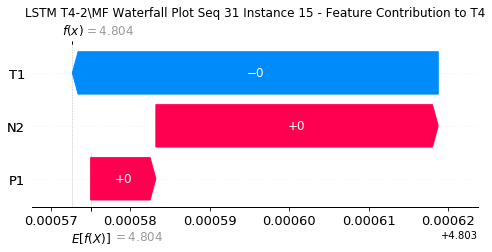

None

Contribution: [ 1.11402958e-05 -4.52471220e-05  3.44212177e-05]


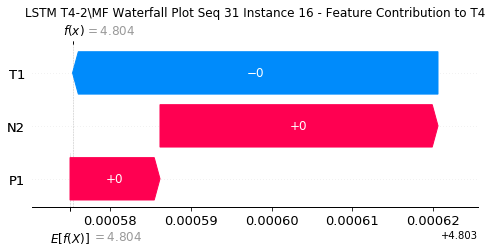

None

Contribution: [ 7.09558395e-06 -4.72989124e-05  3.40388471e-05]


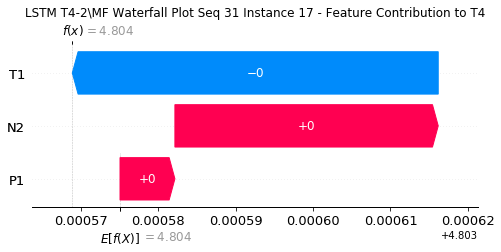

None

Contribution: [ 1.54465638e-05 -3.85593507e-05  3.54480238e-05]


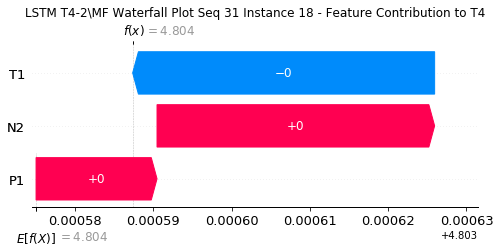

None

Contribution: [ 9.24153267e-06 -4.90048156e-05  3.35568641e-05]


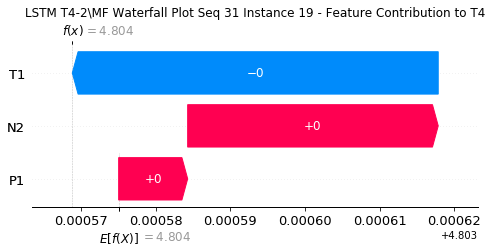

None

Contribution: [ 8.10428865e-06 -4.88526621e-05  3.40615222e-05]


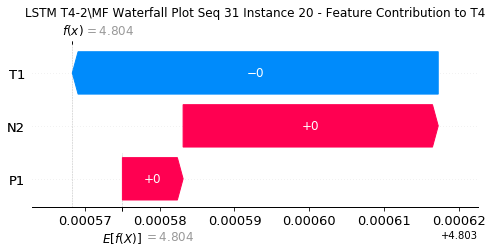

None

Contribution: [ 5.51057531e-06 -5.48328847e-05  3.66015632e-05]


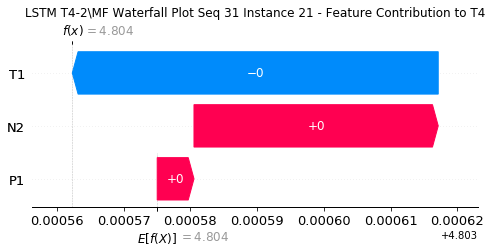

None

Contribution: [ 1.09826579e-05 -8.34806495e-05  4.51862513e-05]


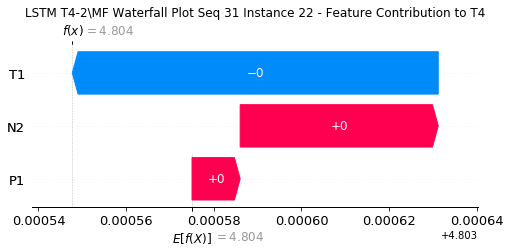

None

Contribution: [ 2.33486745e-05 -2.16712366e-04  1.24161599e-04]


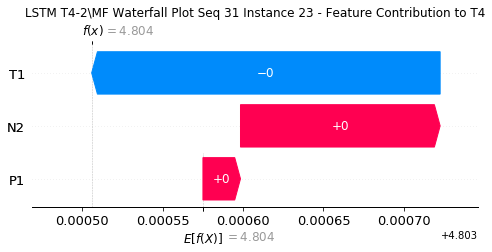

None

Contribution: [ 0.00040231 -0.00142114  0.00160832]


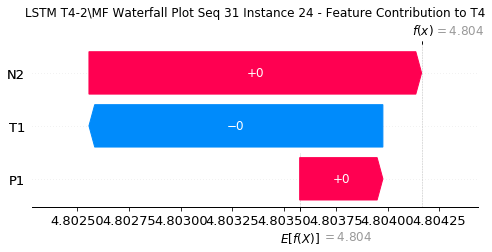

None

Contribution: [ 0.00141679 -0.00321688  0.00340131]


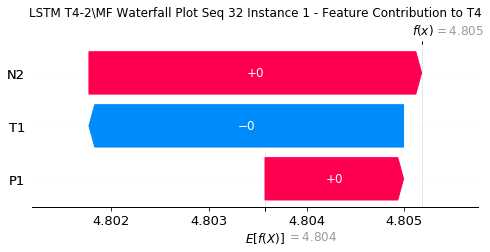

None

Contribution: [ 0.00068644 -0.00114669  0.00164908]


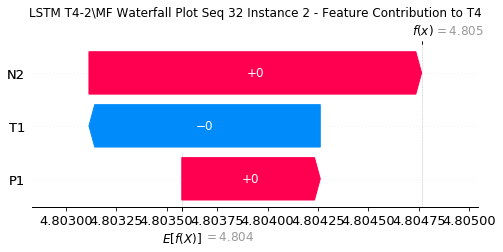

None

Contribution: [ 0.0001117  -0.00021114  0.00028308]


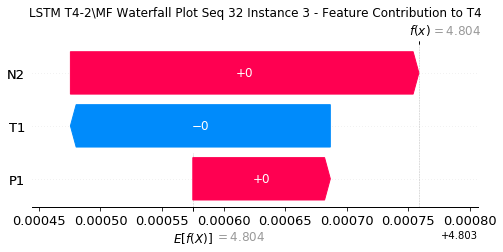

None

Contribution: [ 1.45362087e-05 -4.73841848e-05  5.20976572e-05]


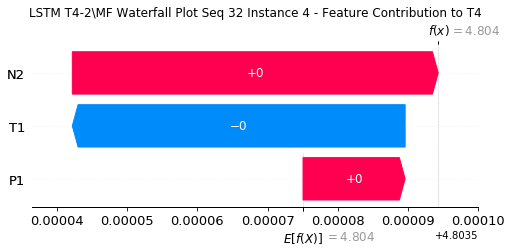

None

Contribution: [ 1.18126138e-05 -4.30323029e-05  4.31832669e-05]


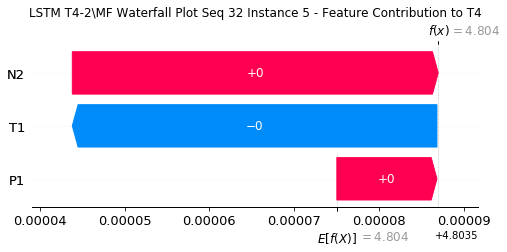

None

Contribution: [ 3.90530209e-06 -3.90689070e-05  3.43544395e-05]


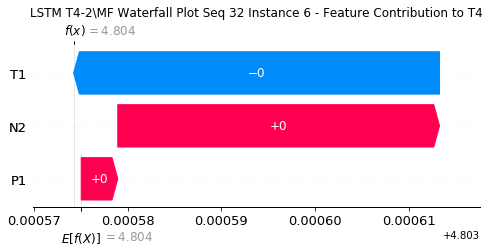

None

Contribution: [ 6.86400468e-06 -4.05407646e-05  4.07769843e-05]


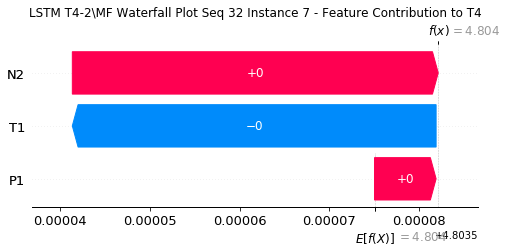

None

Contribution: [ 9.89265434e-06 -3.93655359e-05  4.20437413e-05]


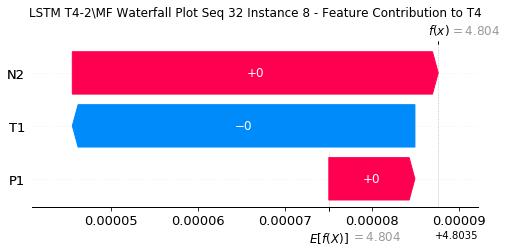

None

Contribution: [ 1.19465969e-05 -3.35810705e-05  4.25226222e-05]


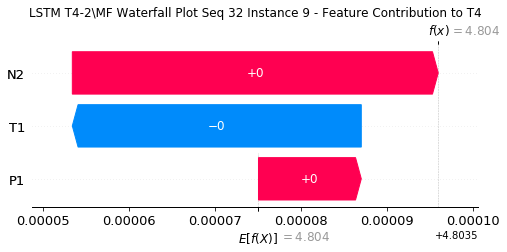

None

Contribution: [ 9.20402812e-06 -3.54825626e-05  4.20394835e-05]


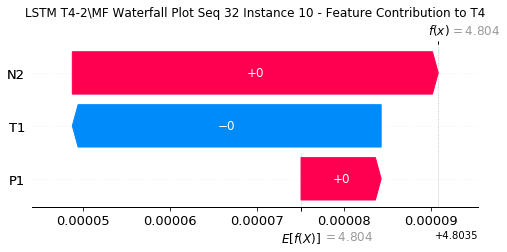

None

Contribution: [ 1.02808900e-05 -4.49237418e-05  3.89287186e-05]


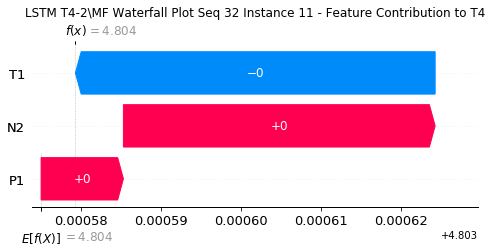

None

Contribution: [ 1.00285242e-05 -4.85418519e-05  3.95549042e-05]


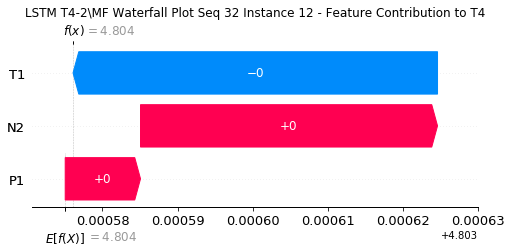

None

Contribution: [ 7.32881933e-06 -5.03146383e-05  3.74745997e-05]


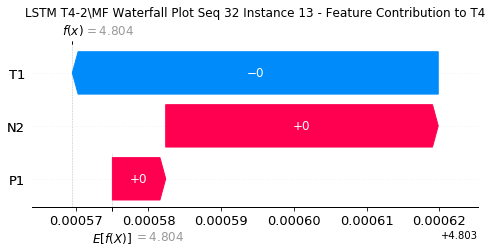

None

Contribution: [ 7.08541934e-06 -4.93625069e-05  4.03041212e-05]


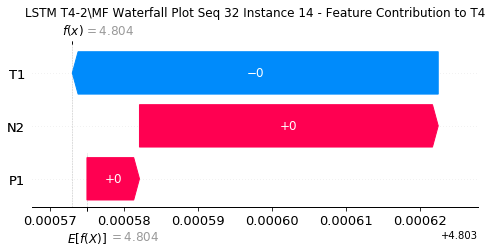

None

Contribution: [-6.47788173e-08 -6.45036712e-05  3.42170561e-05]


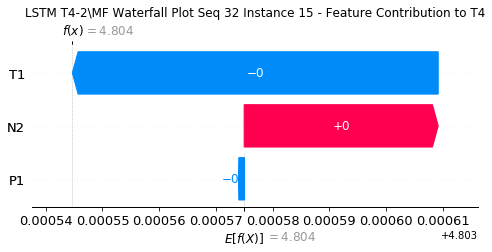

None

Contribution: [ 9.88785150e-06 -5.16319422e-05  3.87755416e-05]


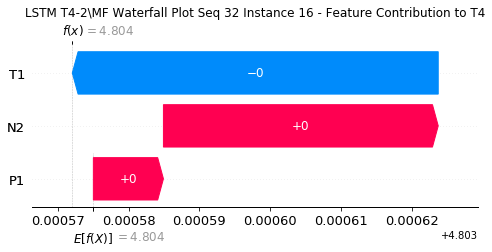

None

Contribution: [ 6.22947568e-06 -5.45577428e-05  3.88489004e-05]


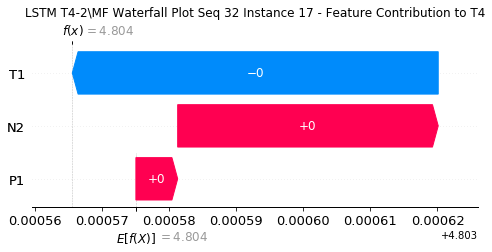

None

Contribution: [ 9.49868255e-06 -5.72423051e-05  3.99821526e-05]


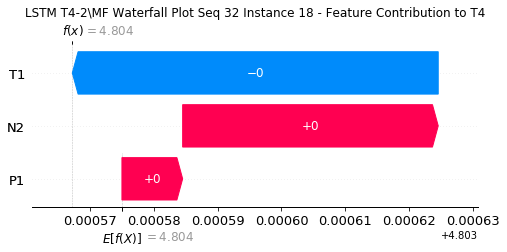

None

Contribution: [ 9.71543564e-06 -5.78513754e-05  3.91737864e-05]


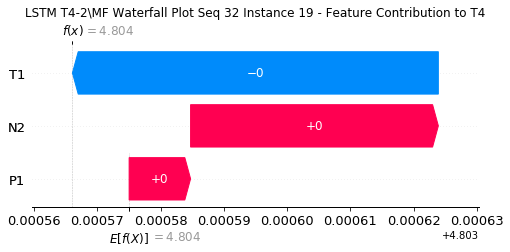

None

Contribution: [ 8.75792719e-06 -5.78311416e-05  3.99386068e-05]


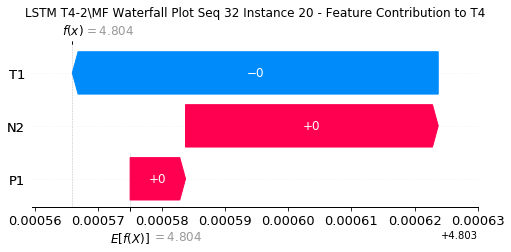

None

Contribution: [ 6.66387007e-06 -6.39032778e-05  4.31297212e-05]


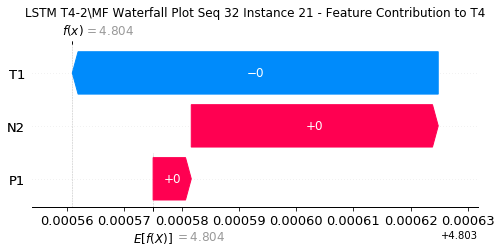

None

Contribution: [ 1.22143368e-05 -9.56670217e-05  5.47502674e-05]


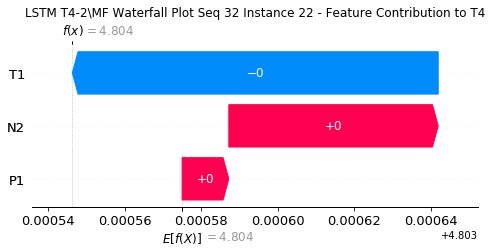

None

Contribution: [ 3.59611781e-05 -2.42534670e-04  1.52665483e-04]


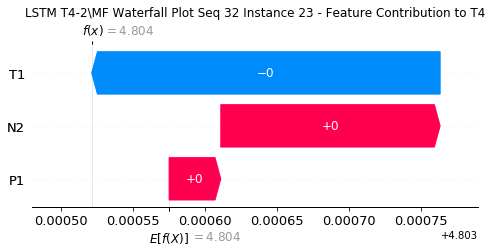

None

Contribution: [ 0.00039323 -0.00132072  0.00160151]


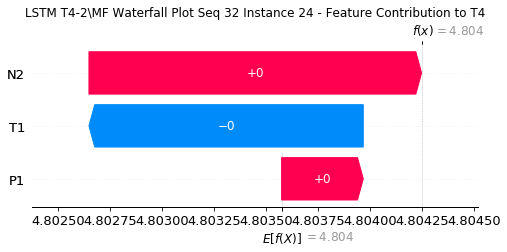

None

Contribution: [ 0.00087802 -0.00364558  0.00322867]


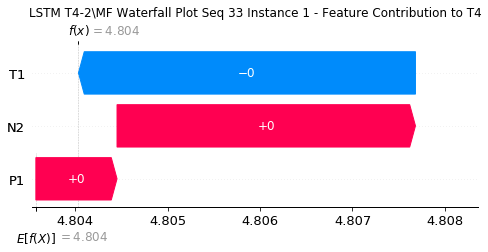

None

Contribution: [ 0.00049351 -0.00119001  0.00158742]


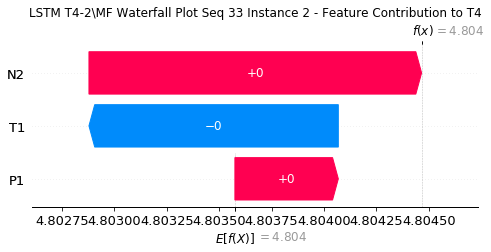

None

Contribution: [ 7.98558761e-05 -1.93849532e-04  2.69672989e-04]


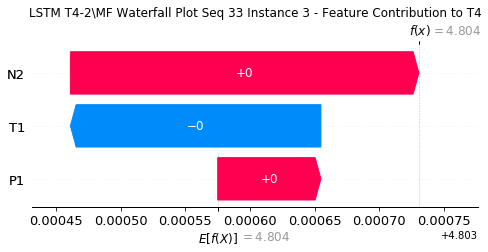

None

Contribution: [ 6.92069027e-06 -6.14195148e-05  5.03355250e-05]


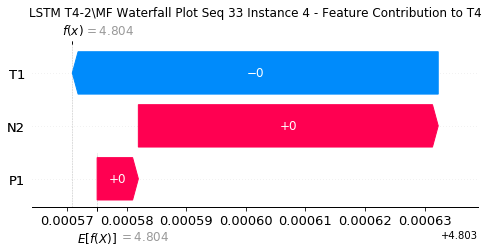

None

Contribution: [ 4.94450741e-06 -5.69405286e-05  4.06833705e-05]


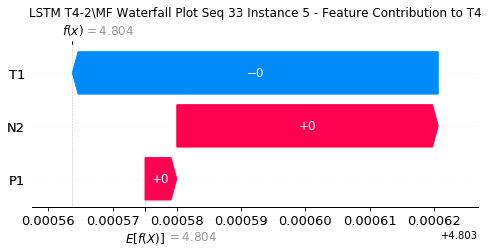

None

Contribution: [ 4.9740484e-06 -4.6376814e-05  3.4939523e-05]


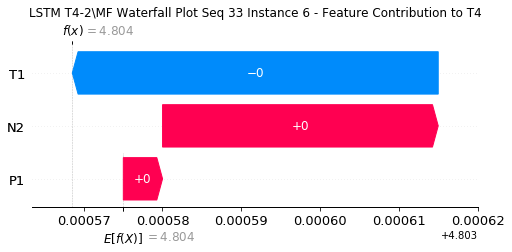

None

Contribution: [ 1.20057644e-06 -5.44247206e-05  3.77372204e-05]


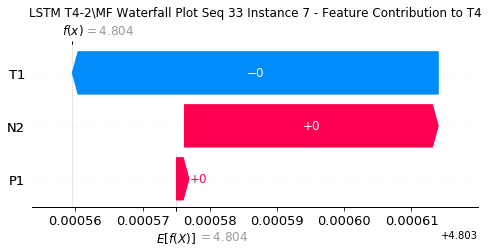

None

Contribution: [ 7.43371762e-06 -6.22891955e-05  3.62897777e-05]


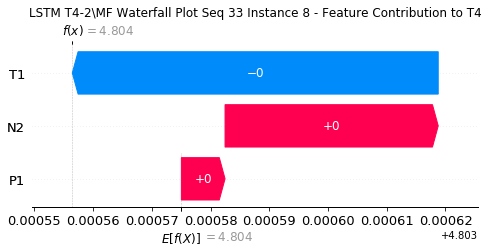

None

Contribution: [ 7.40278609e-06 -4.81744213e-05  3.53693289e-05]


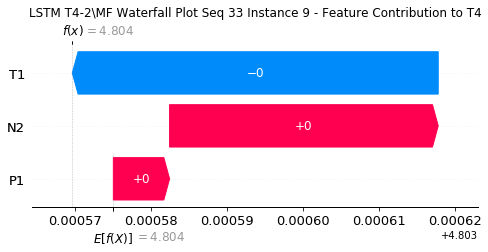

None

Contribution: [ 6.50548449e-06 -6.42052011e-05  3.55460265e-05]


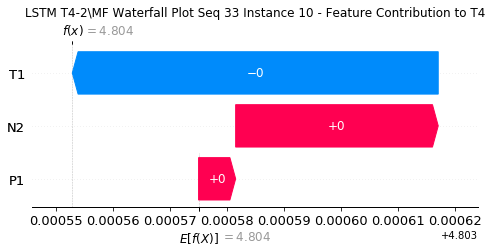

None

Contribution: [ 5.15144591e-06 -5.99776544e-05  3.40001328e-05]


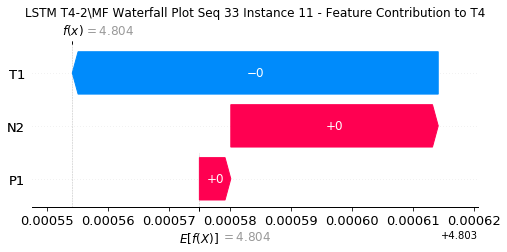

None

Contribution: [ 4.72400227e-06 -6.24969162e-05  3.45017834e-05]


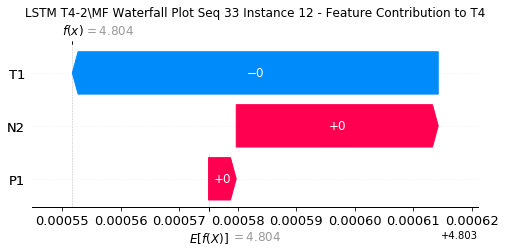

None

Contribution: [ 1.12897878e-05 -6.00258931e-05  3.36426809e-05]


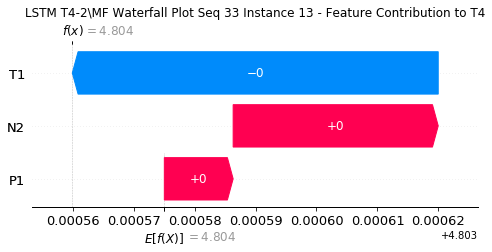

None

Contribution: [ 2.97601630e-06 -6.40133015e-05  3.46129328e-05]


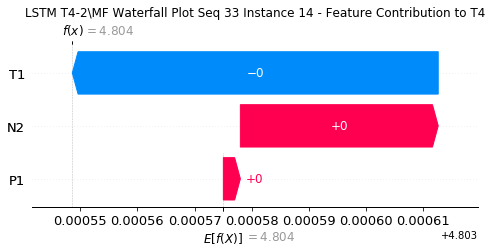

None

Contribution: [ 2.02628913e-06 -6.76154625e-05  3.03420568e-05]


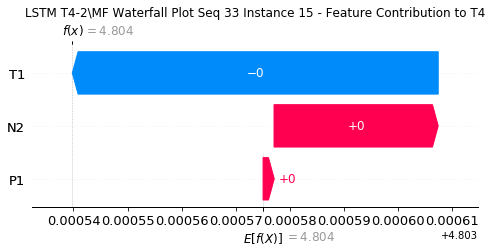

None

Contribution: [ 4.99122304e-06 -6.60588997e-05  3.20843674e-05]


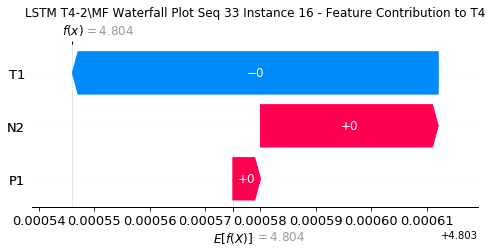

None

Contribution: [ 1.63994602e-08 -6.93906960e-05  3.17988857e-05]


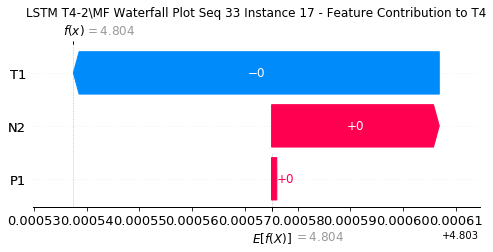

None

Contribution: [ 1.06820864e-05 -7.08966781e-05  3.33858896e-05]


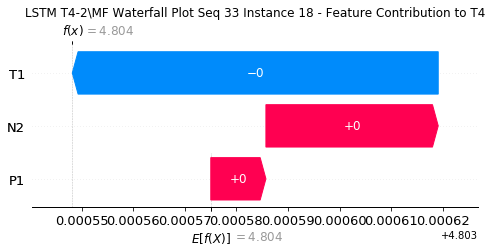

None

Contribution: [ 3.98127463e-06 -7.14093112e-05  3.20386248e-05]


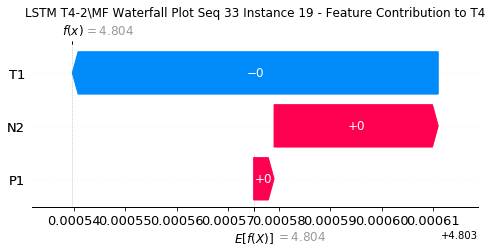

None

Contribution: [ 2.41765228e-06 -7.22248576e-05  3.24633781e-05]


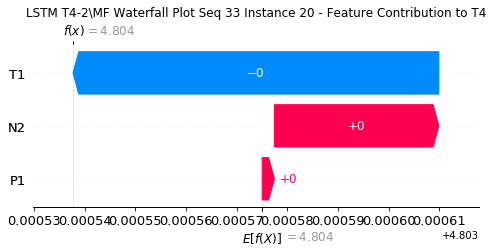

None

Contribution: [ 1.15889101e-06 -8.01851983e-05  3.49893492e-05]


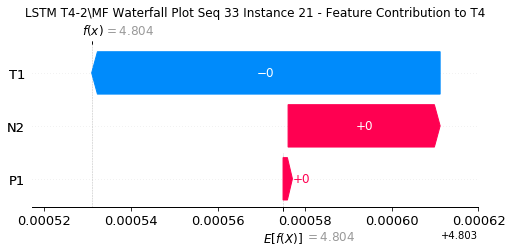

None

Contribution: [ 3.82418620e-06 -1.22148278e-04  4.22250888e-05]


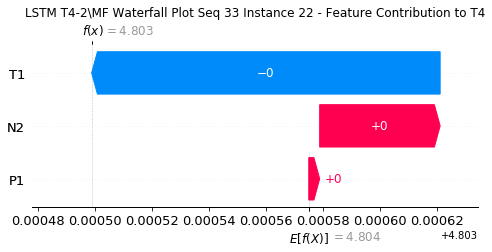

None

Contribution: [ 1.57641468e-05 -3.31572691e-04  1.20062758e-04]


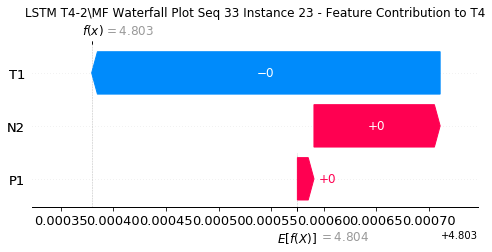

None

Contribution: [ 0.00013269 -0.00264012  0.0013028 ]


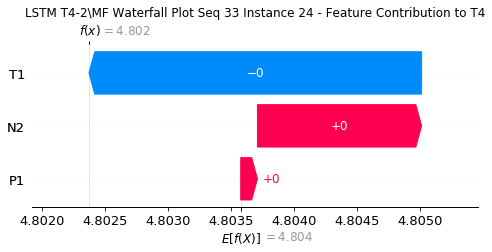

None

Contribution: [ 9.33674148e-05 -5.30892794e-03  2.49855551e-03]


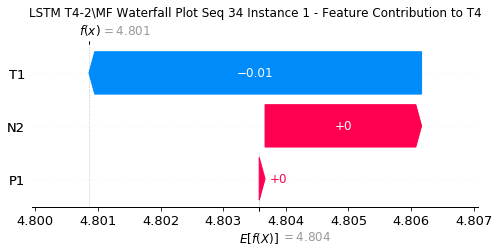

None

Contribution: [ 0.00033686 -0.00179544  0.00133678]


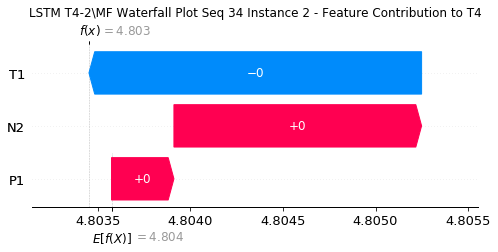

None

Contribution: [ 4.31493522e-05 -2.98625863e-04  2.21975852e-04]


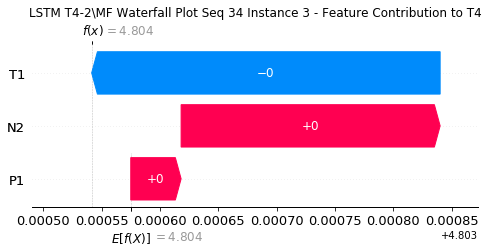

None

Contribution: [ 4.57383674e-06 -7.75925202e-05  4.76956672e-05]


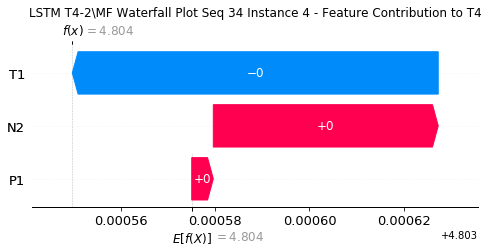

None

Contribution: [ 2.22788790e-06 -7.06434632e-05  3.90084897e-05]


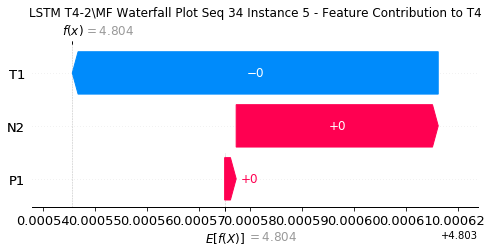

None

Contribution: [-4.65181186e-06 -7.04909464e-05  3.61810009e-05]


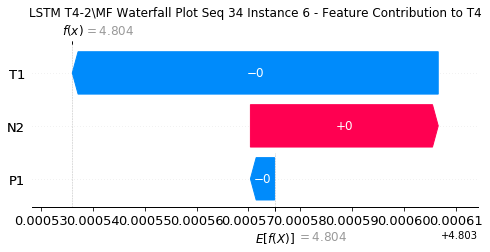

None

Contribution: [-3.04137775e-06 -6.58273057e-05  3.66904801e-05]


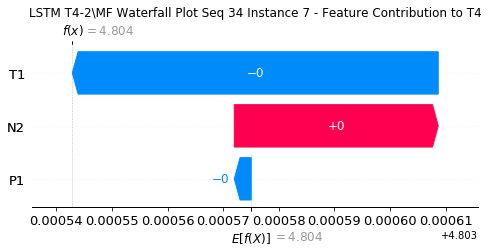

None

Contribution: [-6.59364436e-06 -6.48260455e-05  3.70947237e-05]


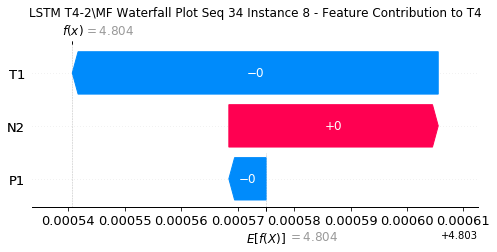

None

Contribution: [-1.55357542e-05 -6.73296168e-05  3.51486298e-05]


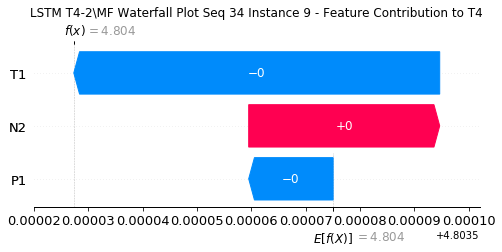

None

Contribution: [-1.13492542e-05 -6.75049174e-05  3.52908063e-05]


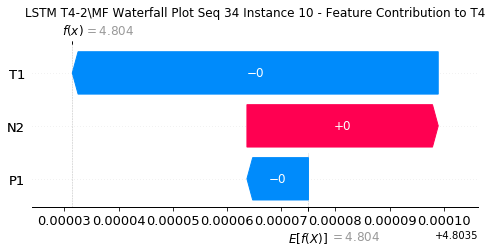

None

Contribution: [ 8.26825925e-08 -7.03824473e-05  3.41839149e-05]


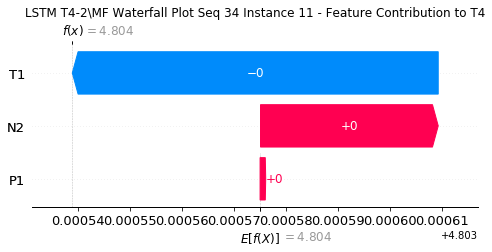

None

Contribution: [ 7.03487710e-07 -7.22493416e-05  3.48777361e-05]


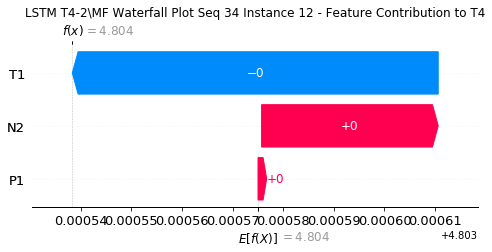

None

Contribution: [-1.73143331e-06 -6.52069674e-05  3.40360786e-05]


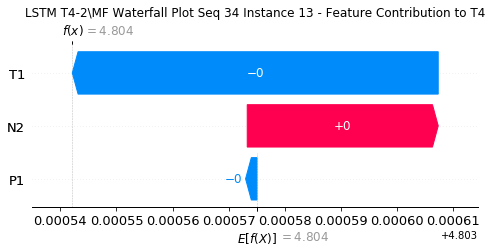

None

Contribution: [-2.10441898e-06 -7.19508784e-05  3.51334486e-05]


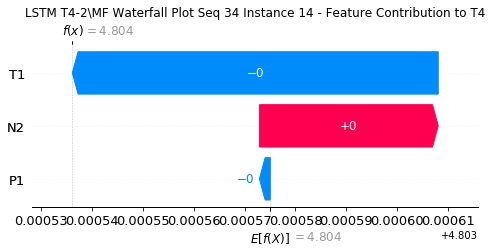

None

Contribution: [-4.92139113e-06 -7.86310675e-05  3.19572267e-05]


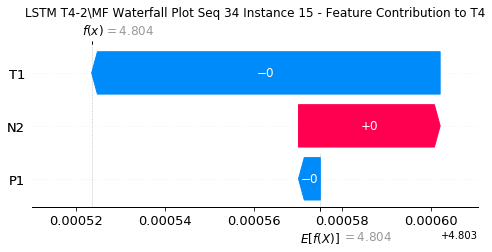

None

Contribution: [ 1.09767014e-06 -7.37604449e-05  3.34917405e-05]


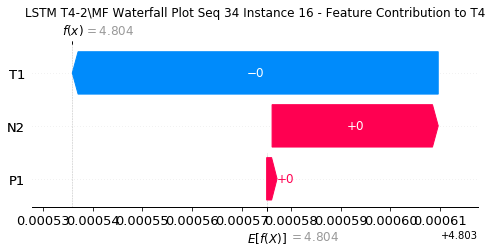

None

Contribution: [-2.74777453e-06 -7.71925153e-05  3.31580032e-05]


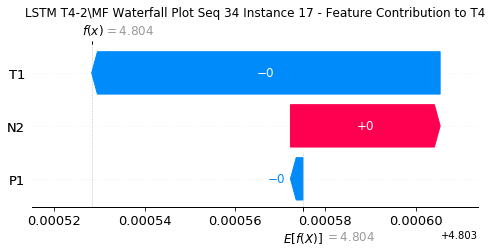

None

Contribution: [ 3.96303521e-06 -6.94059942e-05  3.36689663e-05]


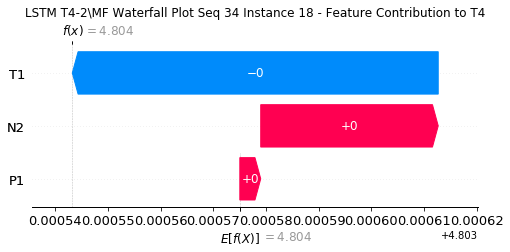

None

Contribution: [ 3.00273264e-06 -7.61022361e-05  3.29761760e-05]


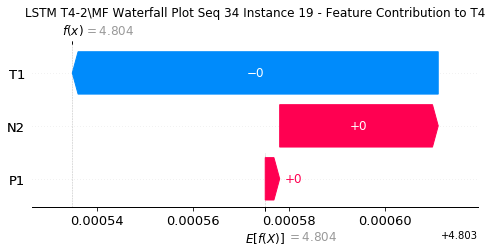

None

Contribution: [ 1.57756190e-06 -7.69095521e-05  3.32848900e-05]


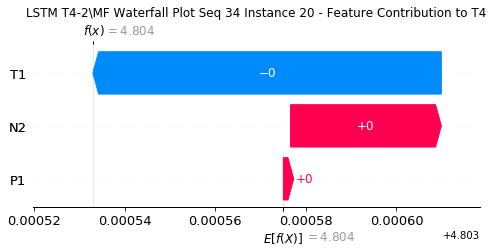

None

Contribution: [-7.65996516e-07 -8.26861174e-05  3.52065987e-05]


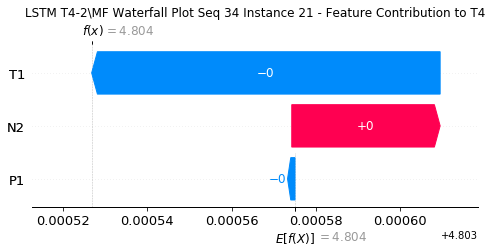

None

Contribution: [-6.85261925e-07 -1.26868789e-04  4.31489321e-05]


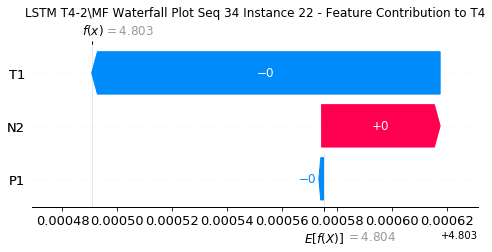

None

Contribution: [ 4.00345692e-06 -3.39471732e-04  1.20972916e-04]


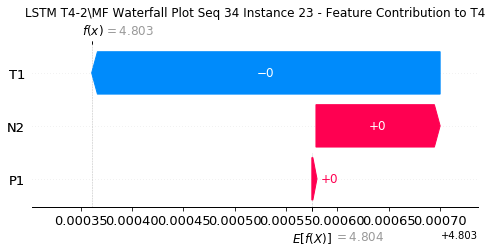

None

Contribution: [ 0.00010435 -0.00282058  0.00133861]


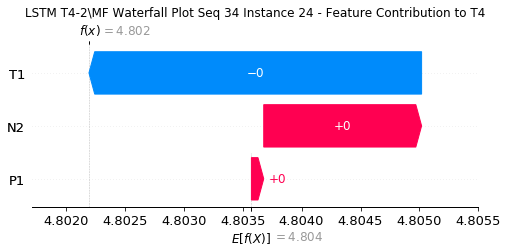

None

In [49]:
#Waterfall Plot for Consistency metric

instance = xtrain
instance2 = xtest
explainer = shap.DeepExplainer(model3,instance)
    
for s in range(0,34):
    instance=xtest[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    for j in range(24):
        print("Contribution:",shap_values[0][0][j])
        plt.title("LSTM T4-2\MF Waterfall Plot Seq %s " %(s+1)+"Instance %i - Feature Contribution to T4" %(j+1),fontsize=12)
        waterfall_display = shap.plots._waterfall.waterfall_legacy(e[0],shap_values[0][0][j],feature_names=features,show=True)
        display(waterfall_display)

In [1]:
#Consistency

T4_tot1' = 5.022 - 4.803
T4_tot1'

0.2190000000000003

In [ ]:
#MF contribution instance 1

MF_T4_1' = 0.0018752